In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import gridspec
from matplotlib import patches
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D

import os
import math
import random

import keras
from keras.models import Sequential
from keras.layers import Input, Dense, Conv2D, Flatten, MaxPooling2D, AveragePooling2D
from keras.layers import Dropout
from keras.callbacks import EarlyStopping

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from sklearn import preprocessing
from sklearn.metrics import roc_curve, roc_auc_score, auc

import scipy.stats as st
from scipy.stats import poisson
from scipy.interpolate import interp1d
from scipy.stats import norm

In [2]:
from sklearn.neighbors import KernelDensity # paquete necesario
from sklearn.model_selection import GridSearchCV

import scipy.integrate as integrate

In [3]:
import xgboost
from xgboost import XGBRegressor, XGBClassifier

In [4]:
import glob
import numpy as np
import os.path as path
import imageio
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Activation, Dropout, Flatten, Dense, Conv2D, MaxPooling2D
from keras.callbacks import EarlyStopping, TensorBoard
from datetime import datetime
import keras
from keras import regularizers
from sklearn.model_selection import train_test_split
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score, average_precision_score, precision_recall_curve, auc,recall_score
#from keras.optimizers import Adam
from keras.optimizer_v2.adam import Adam
from keras.regularizers import l2
import h5py
from sklearn.model_selection import GridSearchCV
from keras.backend import cast, greater, clip, floatx,epsilon
from keras.wrappers.scikit_learn import KerasClassifier
from keras import backend as K
from sklearn.model_selection import StratifiedKFold

### Load images

In [ ]:
filefolder = '../../data2024/processed/00-images/'

###################
# BACKGROUND FILE #
###################

filename_B = filefolder + 'ER-img/out-img75/'


###############
# SIGNAL FILE #
###############

# select the DM mass
mDM = 500

filename_S = filefolder + 'mDM' + str(mDM) + 'GeV-img/out-img75/'

In [6]:
from keras import backend as K
np.random.seed(0)

# Define recall, precision and f1 functions
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

##### TEST-VAL SET

In [7]:
# test
from PIL import Image

for i in range(2):
    img = Image.open( filename_S+'WP' + str(i) + '.png' )
    data = np.asarray( img, dtype="int32" )
    print(data.shape)
    
for i in range(2):
    img = Image.open( filename_B+'ER' + str(i) + '.png' )
    data = np.asarray( img, dtype="int32" )
    print(data.shape)

(75, 75, 4)
(75, 75, 4)
(75, 75, 4)
(75, 75, 4)


In [8]:
##########
# SIGNAL #
##########
num_signal = 15000

file_pathsWP = glob.glob(path.join(filename_S, 'WP*.png'))

# Load the images into a single variable and convert to a numpy array
imagesWP = [imageio.imread(file_pathsWP[jj]) for jj in range(num_signal)]
imagesWP = np.asarray(imagesWP)

labelsWP = np.ones(num_signal)


##############
# BACKGROUND #
##############
num_back = 15000

file_pathsER = glob.glob(path.join(filename_B, 'ER*.png'))

# Load the images into a single variable and convert to a numpy array
imagesER = [imageio.imread(file_pathsER[jj]) for jj in range(num_back)]
imagesER = np.asarray(imagesER)

labelsER = np.zeros(num_back)



images = np.concatenate([imagesWP,imagesER])
del imagesWP
del imagesER

labels = np.concatenate([labelsWP,labelsER])
del labelsWP
del labelsER



print('images.shape: ', images.shape)
print('labels.shape: ', labels.shape)

# Get image size
image_size = np.asarray([images.shape[1], images.shape[2], images.shape[3]])
print(image_size)

# Scale images so values are between 0 and 1
images = images / 255

n_images = images.shape[0]

images.shape:  (30000, 75, 75, 4)
labels.shape:  (30000,)
[75 75  4]


In [9]:
labels.shape

(30000,)

In [10]:
# Split into test and training sets

TRAIN_TEST_SPLIT = 0.8            

# Split at the given index
split_index = int(TRAIN_TEST_SPLIT * n_images)
shuffled_indices = np.random.permutation(n_images)
train_indices = shuffled_indices[0:split_index]
test_indices = shuffled_indices[split_index:]

# Split the images and the labels
x_train = images[train_indices, :, :, :]
y_train = labels[train_indices]
x_val = images[test_indices, :, :, :]
y_val = labels[test_indices]

#x_train = images
#y_train = labels

print(x_train.shape)
print(y_train.shape)
print(x_val.shape)

(24000, 75, 75, 4)
(24000,)
(6000, 75, 75, 4)


In [11]:
del images
del labels

##### TESTSET

In [12]:
##########
# SIGNAL #
##########
num_signal_test = 5000

file_pathsWP = glob.glob(path.join(filename_S, 'WP*.png'))

# Load the images into a single variable and convert to a numpy array
imagesWP = [imageio.imread(file_pathsWP[jj]) for jj in range(num_signal,num_signal+num_signal_test)]
imagesWP = np.asarray(imagesWP)

labelsWP = np.ones(num_signal_test)


##############
# BACKGROUND #
##############
num_back_test = 5000

file_pathsER = glob.glob(path.join(filename_B, 'ER*.png'))

# Load the images into a single variable and convert to a numpy array
imagesER = [imageio.imread(file_pathsER[jj]) for jj in range(num_back,num_back+num_back_test)]
imagesER = np.asarray(imagesER)

labelsER = np.zeros(num_back_test)



images_test = np.concatenate([imagesWP,imagesER])
del imagesWP
del imagesER

labels_test = np.concatenate([labelsWP,labelsER])
del labelsWP
del labelsER


print('images_test.shape: ', images_test.shape)
print('labels_test.shape: ', labels_test.shape)

# Get image size
image_size_test = np.asarray([images_test.shape[1], images_test.shape[2], images_test.shape[3]])
print(image_size_test)

# Scale images so values are between 0 and 1
images_test = images_test / 255

n_images_test = images_test.shape[0]



x_test = images_test
del images_test

y_test = labels_test
del labels_test

images_test.shape:  (10000, 75, 75, 4)
labels_test.shape:  (10000,)
[75 75  4]


### GRID: TRAIN THE MODEL

In [28]:
def create_model(conv_layers, conv_filters, learning_rate, alpha_value):
    shape = (image_size[0], image_size[1], image_size[2])
    model = Sequential()
    
    # conv layer
    model.add(Conv2D(conv_filters, (3,3), strides = (1,1), input_shape=shape,kernel_regularizer=l2(0.005)))
    model.add(keras.layers.LeakyReLU(alpha=alpha_value))
    model.add(MaxPooling2D(pool_size=(2, 2), strides = (1,1)))

    for i in range(1,conv_layers):
        # conv layers
        model.add(Conv2D(conv_filters,(3,3),kernel_regularizer=l2(0.005)))
        model.add(keras.layers.LeakyReLU(alpha=alpha_value))
        model.add(MaxPooling2D(pool_size=(2, 2)))

    
    model.add(Dropout(0.25)) 
    model.add(Flatten())

    model.add(Dense(32, bias_regularizer=regularizers.l2(0.001),kernel_regularizer=regularizers.l2(0.001)))
    model.add(keras.layers.LeakyReLU(alpha=alpha_value))    
    model.add(Dropout(0.25)) 
    
    model.add(Dense(8, bias_regularizer=regularizers.l2(0.001),kernel_regularizer=regularizers.l2(0.001)))
    model.add(keras.layers.LeakyReLU(alpha=alpha_value))    
    model.add(Dropout(0.25)) 

    # Output layer
    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    # Compile the model
    model.compile(loss='binary_crossentropy',
                    optimizer='adam',
                    metrics=['acc', f1_m, precision_m, recall_m])
    return model


def run_model(conv_layers, conv_filters, learning_rate, alpha_value, batch_size, tot_epochs):
    
    model = create_model(conv_layers, conv_filters, learning_rate, alpha_value)
    
    history = model.fit(x_train, y_train, 
                          epochs=tot_epochs, 
                          batch_size=batch_size, 
                          verbose=1, 
                          validation_data=(x_val, y_val), 
                          shuffle = True)
    #model.save(model_name)
    #model.save_weights('final_weights.h5')

    
    # Plot de la cost function para la train y validation data
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.legend(['train', 'val'], loc='upper left')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.show()

    # Plot de la accuracy function para la train y validation data
    plt.figure()
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()




    #model.save(root_dir + 'CNN-histo-mix-v2/saved-models/' + 'conv-' + nameMIX_linear +'.h5') # Guardar el modelo.  # Predicción de la red entrenada
    y_pred = model.predict(x_test)

    # Compute ROC curve and ROC area for each class
    fpr_model = dict()
    tpr_model = dict()
    roc_auc_model = dict()
    fpr_model, tpr_model, _ = roc_curve(y_test, y_pred)
    roc_auc_model = auc(fpr_model, tpr_model)


    plt.figure()
    plt.plot(tpr_model,1-fpr_model,label="$f_{1}$, AUC = %0.2f" % roc_auc_model,color="orange",ls=":",lw=4)
    plt.plot([1,0],[0,1],ls=":",color="grey")
    plt.xlabel("True Positive Rate",fontsize=16)
    plt.ylabel("1 $-$ False Positive Rate",fontsize=16)
    plt.legend()
    plt.xlim([0,1])
    plt.ylim([0,1])
    plt.yticks([0.2,0.4,0.6,0.8,1.])
    plt.legend(frameon=False,fontsize=16)
    plt.show()
                                
                                
    score = model.evaluate(x_test, y_test, verbose=1)
    
    print('Test ROC-AUC:', roc_auc_model)
    print('Test loss:', score[0])
    print('Test accuracy:', score[1])
    print('Test f1:', score[2])
    print('Test precision:', score[3])
    print('Test recall:', score[4])
    
    return roc_auc_model, score

In [15]:
#conv_layers = [1,2,3]
conv_layers = [1]
conv_filters = [8,16,24]

learning_rate = [0.005,0.001,0.01] # actually, I dont change the learning rate, forgot to include this variable above in 'def create_model', I include it in the second grid
alpha_value = [0.001, 0.05, 0.01, 0.1]

batch_size = [64,128,256]



tot_epochs = 500
patience_epochs = 50

# to stop the training if validation loss does not improve after patience number of epochs
stop_training = EarlyStopping(monitor='val_loss', mode='min', verbose=0, patience=patience_epochs, restore_best_weights=True)

num_its = len(conv_layers)*len(conv_filters)*len(learning_rate)*len(alpha_value)*len(batch_size)
print('# classifiers: ', num_its)

# classifiers:  108


###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 15s 37ms/step - loss: 0.7271 - acc: 0.6035 - f1_m: 0.6222 - precision_m: 0.6046 - recall_m: 0.6720 - val_loss: 0.5199 - val_acc: 0.7962 - val_f1_m: 0.7820 - val_precision_m: 0.8286 - val_recall_m: 0.7454
Epoch 2/500
375/375 [==============================] - 13s 35ms/step - loss: 0.5461 - acc: 0.7849 - f1_m: 0.7859 - precision_m: 0.7839 - recall_m: 0.7990 - val_loss: 0.5207 - val_acc: 0.7925 - val_f1_m: 0.8135 - val_precision_m: 0.7303 - val_recall_m: 0.9239
Epoch 3/500
375/375 [==============================] - 13s 36ms/step - loss: 0.5245 - acc: 0.7976 - f1_m: 0.8001 - precision_m: 0.7958 - recall_m: 0.8158 - val_loss: 0.4726 - val_acc: 0.8098 - val_f1_m: 0.8159 - val_precision_m: 0.7799 - val_recall_m: 0.8609
Epoch 4/500
375/375 [==============================] - 13s 35ms/step - loss: 0.500

375/375 [==============================] - 14s 37ms/step - loss: 0.4423 - acc: 0.8431 - f1_m: 0.8425 - precision_m: 0.8295 - recall_m: 0.8626 - val_loss: 0.4408 - val_acc: 0.8422 - val_f1_m: 0.8420 - val_precision_m: 0.8305 - val_recall_m: 0.8577
Epoch 33/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4486 - acc: 0.8438 - f1_m: 0.8449 - precision_m: 0.8295 - recall_m: 0.8686 - val_loss: 0.4561 - val_acc: 0.8370 - val_f1_m: 0.8458 - val_precision_m: 0.7903 - val_recall_m: 0.9146
Epoch 34/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4531 - acc: 0.8368 - f1_m: 0.8383 - precision_m: 0.8271 - recall_m: 0.8567 - val_loss: 0.4384 - val_acc: 0.8288 - val_f1_m: 0.8155 - val_precision_m: 0.8709 - val_recall_m: 0.7713
Epoch 35/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4468 - acc: 0.8369 - f1_m: 0.8391 - precision_m: 0.8286 - recall_m: 0.8581 - val_loss: 0.4277 - val_acc: 0.8435 - val_f1_m: 0.8414 - val_precision_m: 0.8

375/375 [==============================] - 14s 37ms/step - loss: 0.4146 - acc: 0.8542 - f1_m: 0.8563 - precision_m: 0.8405 - recall_m: 0.8776 - val_loss: 0.4530 - val_acc: 0.8362 - val_f1_m: 0.8329 - val_precision_m: 0.8381 - val_recall_m: 0.8321
Epoch 95/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4401 - acc: 0.8422 - f1_m: 0.8442 - precision_m: 0.8302 - recall_m: 0.8649 - val_loss: 0.4412 - val_acc: 0.8422 - val_f1_m: 0.8416 - val_precision_m: 0.8308 - val_recall_m: 0.8574
Epoch 96/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4276 - acc: 0.8482 - f1_m: 0.8497 - precision_m: 0.8388 - recall_m: 0.8662 - val_loss: 0.4487 - val_acc: 0.8385 - val_f1_m: 0.8351 - val_precision_m: 0.8414 - val_recall_m: 0.8337
Epoch 97/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4370 - acc: 0.8464 - f1_m: 0.8463 - precision_m: 0.8344 - recall_m: 0.8645 - val_loss: 0.4645 - val_acc: 0.8202 - val_f1_m: 0.8156 - val_precision_m: 0.8

375/375 [==============================] - 14s 36ms/step - loss: 0.4446 - acc: 0.8446 - f1_m: 0.8421 - precision_m: 0.8361 - recall_m: 0.8554 - val_loss: 0.5235 - val_acc: 0.8272 - val_f1_m: 0.8275 - val_precision_m: 0.8164 - val_recall_m: 0.8439
Epoch 157/500
375/375 [==============================] - 14s 36ms/step - loss: 0.5049 - acc: 0.8245 - f1_m: 0.8238 - precision_m: 0.8147 - recall_m: 0.8400 - val_loss: 0.4771 - val_acc: 0.8240 - val_f1_m: 0.8289 - val_precision_m: 0.7970 - val_recall_m: 0.8686
Epoch 158/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4855 - acc: 0.8246 - f1_m: 0.8237 - precision_m: 0.8150 - recall_m: 0.8402 - val_loss: 0.4758 - val_acc: 0.8222 - val_f1_m: 0.8313 - val_precision_m: 0.7788 - val_recall_m: 0.8964
Epoch 159/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4631 - acc: 0.8305 - f1_m: 0.8304 - precision_m: 0.8192 - recall_m: 0.8483 - val_loss: 0.4632 - val_acc: 0.8272 - val_f1_m: 0.8254 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4463 - acc: 0.8425 - f1_m: 0.8423 - precision_m: 0.8294 - recall_m: 0.8619 - val_loss: 0.4688 - val_acc: 0.8218 - val_f1_m: 0.8156 - val_precision_m: 0.8326 - val_recall_m: 0.8044
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4406 - acc: 0.8414 - f1_m: 0.8420 - precision_m: 0.8345 - recall_m: 0.8556 - val_loss: 0.4679 - val_acc: 0.8220 - val_f1_m: 0.8162 - val_precision_m: 0.8312 - val_recall_m: 0.8070
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4396 - acc: 0.8395 - f1_m: 0.8414 - precision_m: 0.8355 - recall_m: 0.8529 - val_loss: 0.4516 - val_acc: 0.8360 - val_f1_m: 0.8340 - val_precision_m: 0.8295 - val_recall_m: 0.8443
Epoch 221/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4360 - acc: 0.8430 - f1_m: 0.8405 - precision_m: 0.8316 - recall_m: 0.8558 - val_loss: 0.4537 - val_acc: 0.8308 - val_f1_m: 0.8262 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4245 - acc: 0.8532 - f1_m: 0.8535 - precision_m: 0.8391 - recall_m: 0.8742 - val_loss: 0.4500 - val_acc: 0.8355 - val_f1_m: 0.8389 - val_precision_m: 0.8107 - val_recall_m: 0.8735
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4123 - acc: 0.8557 - f1_m: 0.8544 - precision_m: 0.8434 - recall_m: 0.8700 - val_loss: 0.4586 - val_acc: 0.8358 - val_f1_m: 0.8415 - val_precision_m: 0.8019 - val_recall_m: 0.8900
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4259 - acc: 0.8484 - f1_m: 0.8502 - precision_m: 0.8394 - recall_m: 0.8665 - val_loss: 0.4515 - val_acc: 0.8350 - val_f1_m: 0.8344 - val_precision_m: 0.8259 - val_recall_m: 0.8476
Epoch 283/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4216 - acc: 0.8569 - f1_m: 0.8569 - precision_m: 0.8510 - recall_m: 0.8680 - val_loss: 0.4601 - val_acc: 0.8318 - val_f1_m: 0.8294 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4138 - acc: 0.8610 - f1_m: 0.8613 - precision_m: 0.8514 - recall_m: 0.8767 - val_loss: 0.4474 - val_acc: 0.8338 - val_f1_m: 0.8272 - val_precision_m: 0.8483 - val_recall_m: 0.8121
Epoch 343/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4239 - acc: 0.8519 - f1_m: 0.8534 - precision_m: 0.8411 - recall_m: 0.8716 - val_loss: 0.4535 - val_acc: 0.8385 - val_f1_m: 0.8423 - val_precision_m: 0.8061 - val_recall_m: 0.8864
Epoch 344/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4147 - acc: 0.8600 - f1_m: 0.8612 - precision_m: 0.8486 - recall_m: 0.8791 - val_loss: 0.4708 - val_acc: 0.8283 - val_f1_m: 0.8321 - val_precision_m: 0.8026 - val_recall_m: 0.8690
Epoch 345/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4292 - acc: 0.8508 - f1_m: 0.8508 - precision_m: 0.8383 - recall_m: 0.8693 - val_loss: 0.4750 - val_acc: 0.8315 - val_f1_m: 0.8237 - val_precision_m: 

375/375 [==============================] - 13s 35ms/step - loss: 0.4362 - acc: 0.8460 - f1_m: 0.8485 - precision_m: 0.8374 - recall_m: 0.8661 - val_loss: 0.4652 - val_acc: 0.8347 - val_f1_m: 0.8294 - val_precision_m: 0.8412 - val_recall_m: 0.8225
Epoch 405/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4301 - acc: 0.8498 - f1_m: 0.8518 - precision_m: 0.8389 - recall_m: 0.8708 - val_loss: 0.4558 - val_acc: 0.8343 - val_f1_m: 0.8354 - val_precision_m: 0.8194 - val_recall_m: 0.8575
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4229 - acc: 0.8510 - f1_m: 0.8502 - precision_m: 0.8426 - recall_m: 0.8622 - val_loss: 0.4528 - val_acc: 0.8367 - val_f1_m: 0.8336 - val_precision_m: 0.8383 - val_recall_m: 0.8341
Epoch 407/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4311 - acc: 0.8487 - f1_m: 0.8474 - precision_m: 0.8382 - recall_m: 0.8638 - val_loss: 0.4473 - val_acc: 0.8375 - val_f1_m: 0.8373 - val_precision_m: 

375/375 [==============================] - 13s 35ms/step - loss: 0.4327 - acc: 0.8493 - f1_m: 0.8480 - precision_m: 0.8389 - recall_m: 0.8624 - val_loss: 0.4578 - val_acc: 0.8342 - val_f1_m: 0.8375 - val_precision_m: 0.8085 - val_recall_m: 0.8727
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4281 - acc: 0.8547 - f1_m: 0.8567 - precision_m: 0.8461 - recall_m: 0.8725 - val_loss: 0.4546 - val_acc: 0.8298 - val_f1_m: 0.8295 - val_precision_m: 0.8205 - val_recall_m: 0.8427
Epoch 468/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4197 - acc: 0.8532 - f1_m: 0.8535 - precision_m: 0.8449 - recall_m: 0.8674 - val_loss: 0.4729 - val_acc: 0.8237 - val_f1_m: 0.8128 - val_precision_m: 0.8562 - val_recall_m: 0.7777
Epoch 469/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4218 - acc: 0.8513 - f1_m: 0.8502 - precision_m: 0.8440 - recall_m: 0.8629 - val_loss: 0.4564 - val_acc: 0.8373 - val_f1_m: 0.8347 - val_precision_m: 

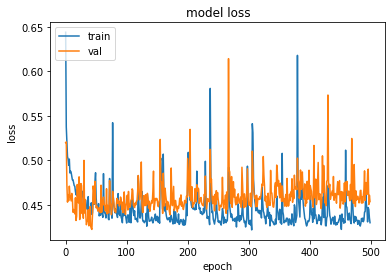

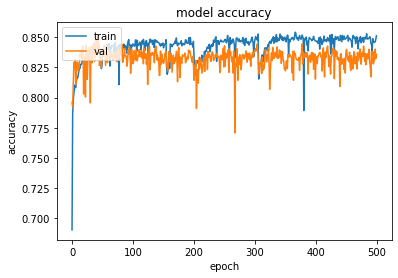

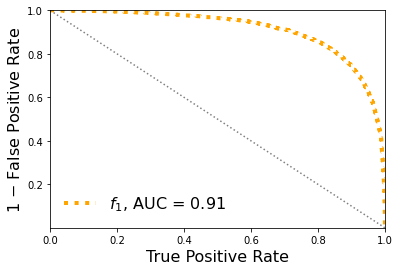

313/313 [==============================] - 1s 4ms/step - loss: 0.4608 - acc: 0.8313 - f1_m: 0.4516 - precision_m: 0.4999 - recall_m: 0.4132
Test ROC-AUC: 0.91067228
Test loss: 0.4607871174812317
Test accuracy: 0.8313000202178955
Test f1: 0.4516056478023529
Test precision: 0.49985477328300476
Test recall: 0.4132388234138489
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 71ms/step - loss: 1.4442 - acc: 0.5251 - f1_m: 0.4411 - precision_m: 0.5214 - recall_m: 0.4090 - val_loss: 0.6520 - val_acc: 0.7460 - val_f1_m: 0.7238 - val_precision_m: 0.7843 - val_recall_m: 0.6752
Epoch 2/500
188/188 [==============================] - 13s 67ms/step - loss: 0.6792 - acc: 0.5996 - f1_m: 0.6324 - precision_m: 0.5825 - recall_m: 0.6967 - val_loss: 0.6227 - val_acc: 0.7623 - val_f1_m: 0.7792 - val_precision_m: 0.7216 - 

Epoch 31/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4483 - acc: 0.8290 - f1_m: 0.8327 - precision_m: 0.8108 - recall_m: 0.8599 - val_loss: 0.4218 - val_acc: 0.8377 - val_f1_m: 0.8370 - val_precision_m: 0.8340 - val_recall_m: 0.8428
Epoch 32/500
188/188 [==============================] - 14s 73ms/step - loss: 0.4473 - acc: 0.8313 - f1_m: 0.8373 - precision_m: 0.8098 - recall_m: 0.8701 - val_loss: 0.4310 - val_acc: 0.8275 - val_f1_m: 0.8199 - val_precision_m: 0.8514 - val_recall_m: 0.7932
Epoch 33/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4526 - acc: 0.8270 - f1_m: 0.8304 - precision_m: 0.8065 - recall_m: 0.8610 - val_loss: 0.4209 - val_acc: 0.8402 - val_f1_m: 0.8408 - val_precision_m: 0.8302 - val_recall_m: 0.8544
Epoch 34/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4474 - acc: 0.8306 - f1_m: 0.8362 - precision_m: 0.8136 - recall_m: 0.8634 - val_loss: 0.4234 - val_acc: 0.8288 - val_f1_m: 0.8177 - val_pre

188/188 [==============================] - 13s 67ms/step - loss: 0.3998 - acc: 0.8580 - f1_m: 0.8617 - precision_m: 0.8345 - recall_m: 0.8948 - val_loss: 0.4133 - val_acc: 0.8493 - val_f1_m: 0.8547 - val_precision_m: 0.8189 - val_recall_m: 0.8964
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4041 - acc: 0.8570 - f1_m: 0.8621 - precision_m: 0.8350 - recall_m: 0.8947 - val_loss: 0.4264 - val_acc: 0.8353 - val_f1_m: 0.8462 - val_precision_m: 0.7877 - val_recall_m: 0.9171
Epoch 95/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4075 - acc: 0.8551 - f1_m: 0.8575 - precision_m: 0.8362 - recall_m: 0.8848 - val_loss: 0.4144 - val_acc: 0.8468 - val_f1_m: 0.8450 - val_precision_m: 0.8503 - val_recall_m: 0.8429
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4098 - acc: 0.8504 - f1_m: 0.8533 - precision_m: 0.8346 - recall_m: 0.8782 - val_loss: 0.4114 - val_acc: 0.8487 - val_f1_m: 0.8484 - val_precision_m: 0.8

188/188 [==============================] - 12s 66ms/step - loss: 0.4106 - acc: 0.8526 - f1_m: 0.8521 - precision_m: 0.8395 - recall_m: 0.8689 - val_loss: 0.4372 - val_acc: 0.8350 - val_f1_m: 0.8370 - val_precision_m: 0.8203 - val_recall_m: 0.8571
Epoch 156/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4023 - acc: 0.8602 - f1_m: 0.8635 - precision_m: 0.8449 - recall_m: 0.8859 - val_loss: 0.4374 - val_acc: 0.8348 - val_f1_m: 0.8354 - val_precision_m: 0.8276 - val_recall_m: 0.8463
Epoch 157/500
188/188 [==============================] - 12s 67ms/step - loss: 0.4050 - acc: 0.8576 - f1_m: 0.8587 - precision_m: 0.8405 - recall_m: 0.8799 - val_loss: 0.4360 - val_acc: 0.8323 - val_f1_m: 0.8314 - val_precision_m: 0.8320 - val_recall_m: 0.8343
Epoch 158/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3989 - acc: 0.8617 - f1_m: 0.8635 - precision_m: 0.8498 - recall_m: 0.8807 - val_loss: 0.4450 - val_acc: 0.8327 - val_f1_m: 0.8284 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3958 - acc: 0.8615 - f1_m: 0.8636 - precision_m: 0.8464 - recall_m: 0.8863 - val_loss: 0.4310 - val_acc: 0.8420 - val_f1_m: 0.8456 - val_precision_m: 0.8195 - val_recall_m: 0.8760
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3928 - acc: 0.8645 - f1_m: 0.8673 - precision_m: 0.8477 - recall_m: 0.8900 - val_loss: 0.4384 - val_acc: 0.8375 - val_f1_m: 0.8332 - val_precision_m: 0.8512 - val_recall_m: 0.8188
Epoch 219/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3907 - acc: 0.8663 - f1_m: 0.8674 - precision_m: 0.8525 - recall_m: 0.8863 - val_loss: 0.4335 - val_acc: 0.8348 - val_f1_m: 0.8377 - val_precision_m: 0.8184 - val_recall_m: 0.8612
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3961 - acc: 0.8619 - f1_m: 0.8654 - precision_m: 0.8444 - recall_m: 0.8900 - val_loss: 0.4380 - val_acc: 0.8308 - val_f1_m: 0.8258 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3940 - acc: 0.8672 - f1_m: 0.8673 - precision_m: 0.8548 - recall_m: 0.8839 - val_loss: 0.4465 - val_acc: 0.8400 - val_f1_m: 0.8473 - val_precision_m: 0.8051 - val_recall_m: 0.8967
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4007 - acc: 0.8604 - f1_m: 0.8624 - precision_m: 0.8522 - recall_m: 0.8768 - val_loss: 0.4320 - val_acc: 0.8422 - val_f1_m: 0.8491 - val_precision_m: 0.8069 - val_recall_m: 0.8979
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3948 - acc: 0.8654 - f1_m: 0.8662 - precision_m: 0.8541 - recall_m: 0.8827 - val_loss: 0.4521 - val_acc: 0.8382 - val_f1_m: 0.8326 - val_precision_m: 0.8556 - val_recall_m: 0.8130
Epoch 282/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4065 - acc: 0.8638 - f1_m: 0.8663 - precision_m: 0.8590 - recall_m: 0.8767 - val_loss: 0.4589 - val_acc: 0.8307 - val_f1_m: 0.8418 - val_precision_m: 

Epoch 341/500
188/188 [==============================] - 12s 66ms/step - loss: 0.6967 - acc: 0.4982 - f1_m: 0.5605 - precision_m: 0.4293 - recall_m: 0.8375 - val_loss: 0.6966 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 342/500
188/188 [==============================] - 12s 66ms/step - loss: 0.6966 - acc: 0.5024 - f1_m: 0.6674 - precision_m: 0.5029 - recall_m: 0.9972 - val_loss: 0.6965 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.6965 - acc: 0.5006 - f1_m: 0.4690 - precision_m: 0.3801 - recall_m: 0.6698 - val_loss: 0.6964 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 344/500
188/188 [==============================] - 12s 66ms/step - loss: 0.6963 - acc: 0.5035 - f1_m: 0.0069 - precision_m: 0.0054 - recall_m: 0.0100 - val_loss: 0.6963 - val_acc: 0.4972 - val_f1_m: 

188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.4927 - f1_m: 0.5176 - precision_m: 0.4113 - recall_m: 0.7607 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 404/500
188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.5044 - f1_m: 0.1429 - precision_m: 0.1152 - recall_m: 0.2105 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 405/500
188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.5014 - f1_m: 0.6412 - precision_m: 0.4843 - recall_m: 0.9599 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 406/500
188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.4971 - f1_m: 0.2417 - precision_m: 0.1843 - recall_m: 0.3627 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_p

188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.4944 - f1_m: 0.2896 - precision_m: 0.2182 - recall_m: 0.4385 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 466/500
188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.4966 - f1_m: 0.4400 - precision_m: 0.3362 - recall_m: 0.6588 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 467/500
188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.5027 - f1_m: 0.6572 - precision_m: 0.4951 - recall_m: 0.9835 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 468/500
188/188 [==============================] - 12s 65ms/step - loss: 0.6932 - acc: 0.5000 - f1_m: 0.4451 - precision_m: 0.3458 - recall_m: 0.6600 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_p

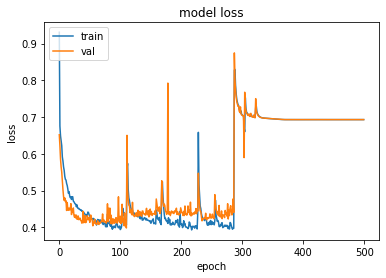

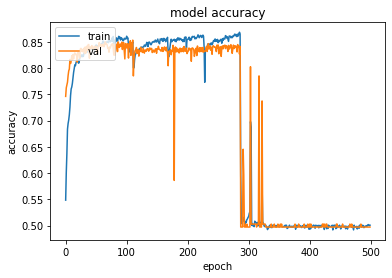

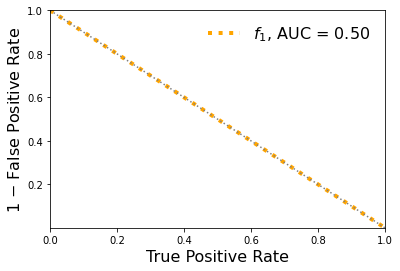

313/313 [==============================] - 1s 4ms/step - loss: 0.6932 - acc: 0.5000 - f1_m: 0.4997 - precision_m: 0.4992 - recall_m: 0.5016
Test ROC-AUC: 0.5
Test loss: 0.693154513835907
Test accuracy: 0.5
Test f1: 0.4996804893016815
Test precision: 0.4992012679576874
Test recall: 0.5015974640846252
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 142ms/step - loss: 1.1374 - acc: 0.5049 - f1_m: 0.4745 - precision_m: 0.4998 - recall_m: 0.4951 - val_loss: 0.7518 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 2/500
94/94 [==============================] - 12s 133ms/step - loss: 0.7476 - acc: 0.5105 - f1_m: 0.5165 - precision_m: 0.5035 - recall_m: 0.5631 - val_loss: 0.7373 - val_acc: 0.4975 - val_f1_m: 0.6626 - val_precision_m: 0.4962 - val_recall_m: 1.0000
Epoch

Epoch 31/500
94/94 [==============================] - 12s 133ms/step - loss: 0.4532 - acc: 0.8234 - f1_m: 0.8284 - precision_m: 0.8053 - recall_m: 0.8579 - val_loss: 0.4144 - val_acc: 0.8388 - val_f1_m: 0.8376 - val_precision_m: 0.8336 - val_recall_m: 0.8430
Epoch 32/500
94/94 [==============================] - 12s 133ms/step - loss: 0.4471 - acc: 0.8273 - f1_m: 0.8329 - precision_m: 0.8092 - recall_m: 0.8619 - val_loss: 0.4161 - val_acc: 0.8348 - val_f1_m: 0.8378 - val_precision_m: 0.8120 - val_recall_m: 0.8670
Epoch 33/500
94/94 [==============================] - 12s 132ms/step - loss: 0.4490 - acc: 0.8284 - f1_m: 0.8337 - precision_m: 0.8141 - recall_m: 0.8570 - val_loss: 0.4198 - val_acc: 0.8342 - val_f1_m: 0.8324 - val_precision_m: 0.8290 - val_recall_m: 0.8376
Epoch 34/500
94/94 [==============================] - 12s 132ms/step - loss: 0.4439 - acc: 0.8290 - f1_m: 0.8329 - precision_m: 0.8120 - recall_m: 0.8578 - val_loss: 0.4114 - val_acc: 0.8410 - val_f1_m: 0.8411 - val_precisi

Epoch 63/500
94/94 [==============================] - 12s 133ms/step - loss: 0.4967 - acc: 0.8169 - f1_m: 0.8248 - precision_m: 0.7927 - recall_m: 0.8630 - val_loss: 0.4575 - val_acc: 0.8320 - val_f1_m: 0.8304 - val_precision_m: 0.8265 - val_recall_m: 0.8363
Epoch 64/500
94/94 [==============================] - 13s 133ms/step - loss: 0.4756 - acc: 0.8244 - f1_m: 0.8301 - precision_m: 0.7990 - recall_m: 0.8669 - val_loss: 0.4615 - val_acc: 0.8267 - val_f1_m: 0.8383 - val_precision_m: 0.7805 - val_recall_m: 0.9075
Epoch 65/500
94/94 [==============================] - 13s 133ms/step - loss: 0.4612 - acc: 0.8271 - f1_m: 0.8335 - precision_m: 0.8019 - recall_m: 0.8717 - val_loss: 0.4402 - val_acc: 0.8300 - val_f1_m: 0.8287 - val_precision_m: 0.8238 - val_recall_m: 0.8355
Epoch 66/500
94/94 [==============================] - 12s 131ms/step - loss: 0.4567 - acc: 0.8305 - f1_m: 0.8362 - precision_m: 0.8072 - recall_m: 0.8696 - val_loss: 0.4511 - val_acc: 0.8242 - val_f1_m: 0.8136 - val_precisi

Epoch 95/500
94/94 [==============================] - 12s 132ms/step - loss: 0.4043 - acc: 0.8496 - f1_m: 0.8523 - precision_m: 0.8297 - recall_m: 0.8785 - val_loss: 0.4086 - val_acc: 0.8448 - val_f1_m: 0.8431 - val_precision_m: 0.8403 - val_recall_m: 0.8480
Epoch 96/500
94/94 [==============================] - 12s 132ms/step - loss: 0.4078 - acc: 0.8493 - f1_m: 0.8537 - precision_m: 0.8341 - recall_m: 0.8775 - val_loss: 0.4144 - val_acc: 0.8362 - val_f1_m: 0.8283 - val_precision_m: 0.8577 - val_recall_m: 0.8031
Epoch 97/500
94/94 [==============================] - 12s 132ms/step - loss: 0.4050 - acc: 0.8471 - f1_m: 0.8503 - precision_m: 0.8284 - recall_m: 0.8752 - val_loss: 0.4085 - val_acc: 0.8442 - val_f1_m: 0.8413 - val_precision_m: 0.8471 - val_recall_m: 0.8380
Epoch 98/500
94/94 [==============================] - 12s 132ms/step - loss: 0.4098 - acc: 0.8480 - f1_m: 0.8530 - precision_m: 0.8325 - recall_m: 0.8771 - val_loss: 0.4044 - val_acc: 0.8452 - val_f1_m: 0.8443 - val_precisi

94/94 [==============================] - 12s 133ms/step - loss: 0.3738 - acc: 0.8698 - f1_m: 0.8745 - precision_m: 0.8520 - recall_m: 0.9003 - val_loss: 0.4314 - val_acc: 0.8430 - val_f1_m: 0.8493 - val_precision_m: 0.8066 - val_recall_m: 0.8987
Epoch 158/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3687 - acc: 0.8730 - f1_m: 0.8770 - precision_m: 0.8537 - recall_m: 0.9040 - val_loss: 0.4269 - val_acc: 0.8382 - val_f1_m: 0.8396 - val_precision_m: 0.8211 - val_recall_m: 0.8612
Epoch 159/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3698 - acc: 0.8709 - f1_m: 0.8731 - precision_m: 0.8532 - recall_m: 0.8964 - val_loss: 0.4507 - val_acc: 0.8307 - val_f1_m: 0.8421 - val_precision_m: 0.7800 - val_recall_m: 0.9163
Epoch 160/500
94/94 [==============================] - 12s 133ms/step - loss: 0.3929 - acc: 0.8620 - f1_m: 0.8680 - precision_m: 0.8434 - recall_m: 0.8982 - val_loss: 0.4585 - val_acc: 0.8282 - val_f1_m: 0.8173 - val_precision_m: 0.86

94/94 [==============================] - 12s 132ms/step - loss: 0.3565 - acc: 0.8857 - f1_m: 0.8889 - precision_m: 0.8686 - recall_m: 0.9124 - val_loss: 0.4558 - val_acc: 0.8413 - val_f1_m: 0.8400 - val_precision_m: 0.8376 - val_recall_m: 0.8447
Epoch 220/500
94/94 [==============================] - 12s 131ms/step - loss: 0.3539 - acc: 0.8871 - f1_m: 0.8896 - precision_m: 0.8637 - recall_m: 0.9182 - val_loss: 0.4410 - val_acc: 0.8453 - val_f1_m: 0.8458 - val_precision_m: 0.8293 - val_recall_m: 0.8648
Epoch 221/500
94/94 [==============================] - 12s 133ms/step - loss: 0.3496 - acc: 0.8867 - f1_m: 0.8889 - precision_m: 0.8679 - recall_m: 0.9128 - val_loss: 0.4438 - val_acc: 0.8435 - val_f1_m: 0.8463 - val_precision_m: 0.8206 - val_recall_m: 0.8758
Epoch 222/500
94/94 [==============================] - 12s 133ms/step - loss: 0.3703 - acc: 0.8782 - f1_m: 0.8808 - precision_m: 0.8556 - recall_m: 0.9112 - val_loss: 0.4526 - val_acc: 0.8412 - val_f1_m: 0.8384 - val_precision_m: 0.84

94/94 [==============================] - 12s 132ms/step - loss: 0.3932 - acc: 0.8717 - f1_m: 0.8761 - precision_m: 0.8420 - recall_m: 0.9171 - val_loss: 0.4844 - val_acc: 0.8167 - val_f1_m: 0.8321 - val_precision_m: 0.7597 - val_recall_m: 0.9215
Epoch 282/500
94/94 [==============================] - 12s 133ms/step - loss: 0.3986 - acc: 0.8686 - f1_m: 0.8733 - precision_m: 0.8406 - recall_m: 0.9110 - val_loss: 0.4830 - val_acc: 0.8313 - val_f1_m: 0.8217 - val_precision_m: 0.8598 - val_recall_m: 0.7884
Epoch 283/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3913 - acc: 0.8716 - f1_m: 0.8761 - precision_m: 0.8518 - recall_m: 0.9050 - val_loss: 0.4514 - val_acc: 0.8345 - val_f1_m: 0.8448 - val_precision_m: 0.7875 - val_recall_m: 0.9128
Epoch 284/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3866 - acc: 0.8725 - f1_m: 0.8777 - precision_m: 0.8461 - recall_m: 0.9141 - val_loss: 0.4557 - val_acc: 0.8357 - val_f1_m: 0.8333 - val_precision_m: 0.83

94/94 [==============================] - 12s 132ms/step - loss: 0.3815 - acc: 0.8558 - f1_m: 0.8580 - precision_m: 0.8447 - recall_m: 0.8738 - val_loss: 0.4385 - val_acc: 0.8298 - val_f1_m: 0.8219 - val_precision_m: 0.8482 - val_recall_m: 0.7989
Epoch 344/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3858 - acc: 0.8571 - f1_m: 0.8587 - precision_m: 0.8507 - recall_m: 0.8697 - val_loss: 0.4447 - val_acc: 0.8350 - val_f1_m: 0.8344 - val_precision_m: 0.8248 - val_recall_m: 0.8463
Epoch 345/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3950 - acc: 0.8520 - f1_m: 0.8573 - precision_m: 0.8401 - recall_m: 0.8769 - val_loss: 0.4336 - val_acc: 0.8360 - val_f1_m: 0.8370 - val_precision_m: 0.8199 - val_recall_m: 0.8562
Epoch 346/500
94/94 [==============================] - 12s 131ms/step - loss: 0.3878 - acc: 0.8533 - f1_m: 0.8546 - precision_m: 0.8418 - recall_m: 0.8692 - val_loss: 0.4380 - val_acc: 0.8312 - val_f1_m: 0.8349 - val_precision_m: 0.80

94/94 [==============================] - 13s 134ms/step - loss: 0.3659 - acc: 0.8652 - f1_m: 0.8658 - precision_m: 0.8567 - recall_m: 0.8770 - val_loss: 0.4627 - val_acc: 0.8330 - val_f1_m: 0.8396 - val_precision_m: 0.7991 - val_recall_m: 0.8859
Epoch 406/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3793 - acc: 0.8609 - f1_m: 0.8622 - precision_m: 0.8498 - recall_m: 0.8772 - val_loss: 0.4673 - val_acc: 0.8348 - val_f1_m: 0.8365 - val_precision_m: 0.8189 - val_recall_m: 0.8567
Epoch 407/500
94/94 [==============================] - 12s 133ms/step - loss: 0.3617 - acc: 0.8682 - f1_m: 0.8707 - precision_m: 0.8556 - recall_m: 0.8878 - val_loss: 0.4787 - val_acc: 0.8320 - val_f1_m: 0.8302 - val_precision_m: 0.8314 - val_recall_m: 0.8311
Epoch 408/500
94/94 [==============================] - 13s 133ms/step - loss: 0.3592 - acc: 0.8692 - f1_m: 0.8706 - precision_m: 0.8630 - recall_m: 0.8797 - val_loss: 0.4676 - val_acc: 0.8333 - val_f1_m: 0.8374 - val_precision_m: 0.80

94/94 [==============================] - 12s 131ms/step - loss: 0.3762 - acc: 0.8610 - f1_m: 0.8646 - precision_m: 0.8538 - recall_m: 0.8779 - val_loss: 0.4550 - val_acc: 0.8345 - val_f1_m: 0.8376 - val_precision_m: 0.8121 - val_recall_m: 0.8668
Epoch 468/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3753 - acc: 0.8610 - f1_m: 0.8633 - precision_m: 0.8560 - recall_m: 0.8720 - val_loss: 0.4738 - val_acc: 0.8232 - val_f1_m: 0.8118 - val_precision_m: 0.8606 - val_recall_m: 0.7702
Epoch 469/500
94/94 [==============================] - 12s 133ms/step - loss: 0.3741 - acc: 0.8609 - f1_m: 0.8626 - precision_m: 0.8594 - recall_m: 0.8676 - val_loss: 0.4641 - val_acc: 0.8262 - val_f1_m: 0.8229 - val_precision_m: 0.8304 - val_recall_m: 0.8174
Epoch 470/500
94/94 [==============================] - 12s 132ms/step - loss: 0.3720 - acc: 0.8651 - f1_m: 0.8655 - precision_m: 0.8578 - recall_m: 0.8750 - val_loss: 0.4698 - val_acc: 0.8392 - val_f1_m: 0.8387 - val_precision_m: 0.82

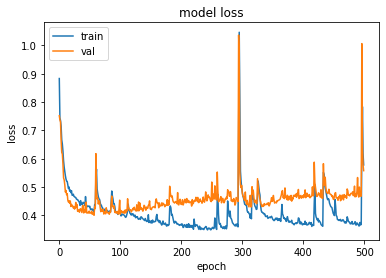

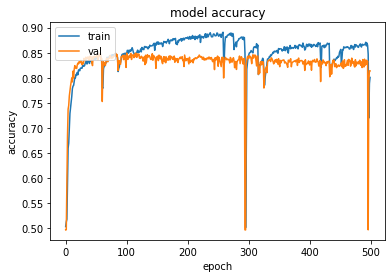

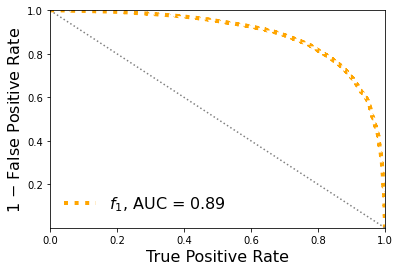

313/313 [==============================] - 1s 4ms/step - loss: 0.5638 - acc: 0.8090 - f1_m: 0.4578 - precision_m: 0.4997 - recall_m: 0.4234
Test ROC-AUC: 0.8915816599999999
Test loss: 0.5638185739517212
Test accuracy: 0.8090000152587891
Test f1: 0.4577629268169403
Test precision: 0.4996804893016815
Test recall: 0.42342251539230347
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 0.8487 - acc: 0.5708 - f1_m: 0.4873 - precision_m: 0.5678 - recall_m: 0.4873 - val_loss: 0.5663 - val_acc: 0.7690 - val_f1_m: 0.7791 - val_precision_m: 0.7342 - val_recall_m: 0.8344
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5962 - acc: 0.7555 - f1_m: 0.7607 - precision_m: 0.7398 - recall_m: 0.7935 - val_loss: 0.5287 - val_acc: 0.7945 - val_f1_m: 0.7741 - val_precision_m: 0.8

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4588 - acc: 0.8316 - f1_m: 0.8306 - precision_m: 0.8255 - recall_m: 0.8447 - val_loss: 0.4504 - val_acc: 0.8385 - val_f1_m: 0.8449 - val_precision_m: 0.8006 - val_recall_m: 0.8994
Epoch 32/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4752 - acc: 0.8257 - f1_m: 0.8258 - precision_m: 0.8177 - recall_m: 0.8428 - val_loss: 0.4375 - val_acc: 0.8420 - val_f1_m: 0.8375 - val_precision_m: 0.8510 - val_recall_m: 0.8291
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4561 - acc: 0.8374 - f1_m: 0.8336 - precision_m: 0.8296 - recall_m: 0.8449 - val_loss: 0.4484 - val_acc: 0.8430 - val_f1_m: 0.8470 - val_precision_m: 0.8137 - val_recall_m: 0.8880
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4617 - acc: 0.8340 - f1_m: 0.8358 - precision_m: 0.8234 - recall_m: 0.8557 - val_loss: 0.4504 - val_acc: 0.8353 - val_f1_m: 0.8363 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4627 - acc: 0.8354 - f1_m: 0.8358 - precision_m: 0.8318 - recall_m: 0.8469 - val_loss: 0.4720 - val_acc: 0.8288 - val_f1_m: 0.8391 - val_precision_m: 0.7811 - val_recall_m: 0.9118
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4516 - acc: 0.8438 - f1_m: 0.8435 - precision_m: 0.8429 - recall_m: 0.8511 - val_loss: 0.4458 - val_acc: 0.8375 - val_f1_m: 0.8421 - val_precision_m: 0.8066 - val_recall_m: 0.8855
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4586 - acc: 0.8375 - f1_m: 0.8356 - precision_m: 0.8332 - recall_m: 0.8463 - val_loss: 0.4327 - val_acc: 0.8405 - val_f1_m: 0.8372 - val_precision_m: 0.8455 - val_recall_m: 0.8340
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4522 - acc: 0.8379 - f1_m: 0.8348 - precision_m: 0.8387 - recall_m: 0.8381 - val_loss: 0.4403 - val_acc: 0.8412 - val_f1_m: 0.8366 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4796 - acc: 0.8263 - f1_m: 0.8253 - precision_m: 0.8191 - recall_m: 0.8417 - val_loss: 0.4344 - val_acc: 0.8360 - val_f1_m: 0.8349 - val_precision_m: 0.8280 - val_recall_m: 0.8471
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4456 - acc: 0.8437 - f1_m: 0.8405 - precision_m: 0.8423 - recall_m: 0.8460 - val_loss: 0.5001 - val_acc: 0.8183 - val_f1_m: 0.8335 - val_precision_m: 0.7590 - val_recall_m: 0.9295
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5132 - acc: 0.8138 - f1_m: 0.8099 - precision_m: 0.8155 - recall_m: 0.8175 - val_loss: 0.4428 - val_acc: 0.8387 - val_f1_m: 0.8410 - val_precision_m: 0.8174 - val_recall_m: 0.8712
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4607 - acc: 0.8341 - f1_m: 0.8336 - precision_m: 0.8268 - recall_m: 0.8481 - val_loss: 0.4299 - val_acc: 0.8328 - val_f1_m: 0.8255 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4537 - acc: 0.8417 - f1_m: 0.8418 - precision_m: 0.8390 - recall_m: 0.8520 - val_loss: 0.4393 - val_acc: 0.8327 - val_f1_m: 0.8243 - val_precision_m: 0.8525 - val_recall_m: 0.8019
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4491 - acc: 0.8376 - f1_m: 0.8383 - precision_m: 0.8373 - recall_m: 0.8460 - val_loss: 0.4526 - val_acc: 0.8207 - val_f1_m: 0.8011 - val_precision_m: 0.8829 - val_recall_m: 0.7376
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4533 - acc: 0.8358 - f1_m: 0.8345 - precision_m: 0.8380 - recall_m: 0.8393 - val_loss: 0.4366 - val_acc: 0.8418 - val_f1_m: 0.8412 - val_precision_m: 0.8324 - val_recall_m: 0.8544
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4406 - acc: 0.8472 - f1_m: 0.8447 - precision_m: 0.8426 - recall_m: 0.8522 - val_loss: 0.4409 - val_acc: 0.8368 - val_f1_m: 0.8379 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4544 - acc: 0.8371 - f1_m: 0.8368 - precision_m: 0.8374 - recall_m: 0.8438 - val_loss: 0.4650 - val_acc: 0.8252 - val_f1_m: 0.8109 - val_precision_m: 0.8697 - val_recall_m: 0.7634
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4689 - acc: 0.8319 - f1_m: 0.8289 - precision_m: 0.8308 - recall_m: 0.8379 - val_loss: 0.4666 - val_acc: 0.8330 - val_f1_m: 0.8412 - val_precision_m: 0.7910 - val_recall_m: 0.9031
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4737 - acc: 0.8279 - f1_m: 0.8285 - precision_m: 0.8210 - recall_m: 0.8441 - val_loss: 0.4364 - val_acc: 0.8383 - val_f1_m: 0.8383 - val_precision_m: 0.8275 - val_recall_m: 0.8548
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4507 - acc: 0.8402 - f1_m: 0.8408 - precision_m: 0.8323 - recall_m: 0.8578 - val_loss: 0.4597 - val_acc: 0.8330 - val_f1_m: 0.8238 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4390 - acc: 0.8463 - f1_m: 0.8472 - precision_m: 0.8386 - recall_m: 0.8613 - val_loss: 0.5002 - val_acc: 0.8303 - val_f1_m: 0.8270 - val_precision_m: 0.8287 - val_recall_m: 0.8294
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5108 - acc: 0.8130 - f1_m: 0.8101 - precision_m: 0.8116 - recall_m: 0.8278 - val_loss: 0.4413 - val_acc: 0.8357 - val_f1_m: 0.8271 - val_precision_m: 0.8559 - val_recall_m: 0.8047
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4495 - acc: 0.8363 - f1_m: 0.8330 - precision_m: 0.8350 - recall_m: 0.8382 - val_loss: 0.4665 - val_acc: 0.8243 - val_f1_m: 0.8135 - val_precision_m: 0.8561 - val_recall_m: 0.7788
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4661 - acc: 0.8351 - f1_m: 0.8349 - precision_m: 0.8317 - recall_m: 0.8464 - val_loss: 0.4420 - val_acc: 0.8348 - val_f1_m: 0.8317 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4614 - acc: 0.8334 - f1_m: 0.8312 - precision_m: 0.8308 - recall_m: 0.8403 - val_loss: 0.4350 - val_acc: 0.8423 - val_f1_m: 0.8432 - val_precision_m: 0.8295 - val_recall_m: 0.8621
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4639 - acc: 0.8331 - f1_m: 0.8301 - precision_m: 0.8267 - recall_m: 0.8437 - val_loss: 0.4312 - val_acc: 0.8352 - val_f1_m: 0.8314 - val_precision_m: 0.8407 - val_recall_m: 0.8271
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4365 - acc: 0.8448 - f1_m: 0.8454 - precision_m: 0.8419 - recall_m: 0.8551 - val_loss: 0.4581 - val_acc: 0.8202 - val_f1_m: 0.8048 - val_precision_m: 0.8682 - val_recall_m: 0.7547
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4513 - acc: 0.8360 - f1_m: 0.8342 - precision_m: 0.8273 - recall_m: 0.8476 - val_loss: 0.4384 - val_acc: 0.8423 - val_f1_m: 0.8451 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4435 - acc: 0.8389 - f1_m: 0.8398 - precision_m: 0.8340 - recall_m: 0.8527 - val_loss: 0.4375 - val_acc: 0.8365 - val_f1_m: 0.8313 - val_precision_m: 0.8446 - val_recall_m: 0.8229
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4458 - acc: 0.8368 - f1_m: 0.8370 - precision_m: 0.8330 - recall_m: 0.8470 - val_loss: 0.4434 - val_acc: 0.8425 - val_f1_m: 0.8467 - val_precision_m: 0.8113 - val_recall_m: 0.8895
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4567 - acc: 0.8359 - f1_m: 0.8372 - precision_m: 0.8303 - recall_m: 0.8537 - val_loss: 0.4954 - val_acc: 0.8238 - val_f1_m: 0.8117 - val_precision_m: 0.8631 - val_recall_m: 0.7709
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4912 - acc: 0.8272 - f1_m: 0.8274 - precision_m: 0.8252 - recall_m: 0.8411 - val_loss: 0.4378 - val_acc: 0.8377 - val_f1_m: 0.8324 - val_precision_m: 

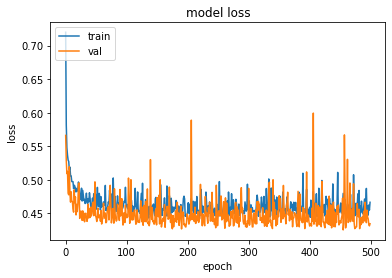

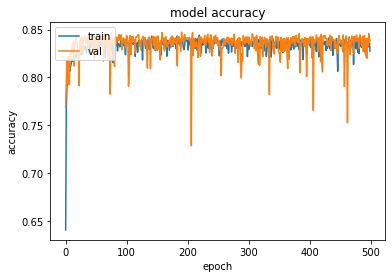

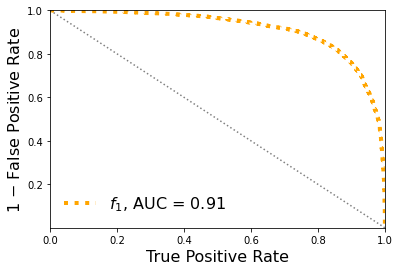

313/313 [==============================] - 1s 4ms/step - loss: 0.4495 - acc: 0.8362 - f1_m: 0.4485 - precision_m: 0.5000 - recall_m: 0.4079
Test ROC-AUC: 0.9135091599999999
Test loss: 0.44953012466430664
Test accuracy: 0.8361999988555908
Test f1: 0.44849660992622375
Test precision: 0.5
Test recall: 0.40794727206230164
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 69ms/step - loss: 1.1111 - acc: 0.5333 - f1_m: 0.4996 - precision_m: 0.5461 - recall_m: 0.4938 - val_loss: 0.5915 - val_acc: 0.7588 - val_f1_m: 0.7621 - val_precision_m: 0.7445 - val_recall_m: 0.7832
Epoch 2/500
188/188 [==============================] - 12s 66ms/step - loss: 0.6217 - acc: 0.7418 - f1_m: 0.7480 - precision_m: 0.7254 - recall_m: 0.7812 - val_loss: 0.5368 - val_acc: 0.7888 - val_f1_m: 0.7787 - val_precision_m: 0.8104 - val_re

Epoch 31/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4450 - acc: 0.8412 - f1_m: 0.8429 - precision_m: 0.8301 - recall_m: 0.8606 - val_loss: 0.4303 - val_acc: 0.8423 - val_f1_m: 0.8412 - val_precision_m: 0.8384 - val_recall_m: 0.8469
Epoch 32/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4458 - acc: 0.8409 - f1_m: 0.8417 - precision_m: 0.8334 - recall_m: 0.8552 - val_loss: 0.4401 - val_acc: 0.8357 - val_f1_m: 0.8320 - val_precision_m: 0.8421 - val_recall_m: 0.8246
Epoch 33/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4436 - acc: 0.8414 - f1_m: 0.8404 - precision_m: 0.8317 - recall_m: 0.8532 - val_loss: 0.4333 - val_acc: 0.8428 - val_f1_m: 0.8437 - val_precision_m: 0.8308 - val_recall_m: 0.8596
Epoch 34/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4486 - acc: 0.8395 - f1_m: 0.8417 - precision_m: 0.8340 - recall_m: 0.8541 - val_loss: 0.4340 - val_acc: 0.8443 - val_f1_m: 0.8462 - val_pre

188/188 [==============================] - 12s 66ms/step - loss: 0.4167 - acc: 0.8597 - f1_m: 0.8612 - precision_m: 0.8520 - recall_m: 0.8745 - val_loss: 0.4282 - val_acc: 0.8475 - val_f1_m: 0.8456 - val_precision_m: 0.8504 - val_recall_m: 0.8434
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4128 - acc: 0.8601 - f1_m: 0.8614 - precision_m: 0.8502 - recall_m: 0.8763 - val_loss: 0.4387 - val_acc: 0.8468 - val_f1_m: 0.8505 - val_precision_m: 0.8249 - val_recall_m: 0.8808
Epoch 95/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4494 - acc: 0.8438 - f1_m: 0.8440 - precision_m: 0.8376 - recall_m: 0.8581 - val_loss: 0.4500 - val_acc: 0.8493 - val_f1_m: 0.8543 - val_precision_m: 0.8216 - val_recall_m: 0.8921
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4268 - acc: 0.8534 - f1_m: 0.8538 - precision_m: 0.8441 - recall_m: 0.8680 - val_loss: 0.4390 - val_acc: 0.8365 - val_f1_m: 0.8316 - val_precision_m: 0.8

188/188 [==============================] - 12s 66ms/step - loss: 0.4234 - acc: 0.8559 - f1_m: 0.8541 - precision_m: 0.8458 - recall_m: 0.8675 - val_loss: 0.4534 - val_acc: 0.8332 - val_f1_m: 0.8355 - val_precision_m: 0.8170 - val_recall_m: 0.8579
Epoch 156/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4272 - acc: 0.8583 - f1_m: 0.8585 - precision_m: 0.8560 - recall_m: 0.8656 - val_loss: 0.4627 - val_acc: 0.8457 - val_f1_m: 0.8532 - val_precision_m: 0.8088 - val_recall_m: 0.9062
Epoch 157/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4279 - acc: 0.8577 - f1_m: 0.8597 - precision_m: 0.8519 - recall_m: 0.8733 - val_loss: 0.4357 - val_acc: 0.8408 - val_f1_m: 0.8342 - val_precision_m: 0.8631 - val_recall_m: 0.8102
Epoch 158/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3989 - acc: 0.8623 - f1_m: 0.8613 - precision_m: 0.8625 - recall_m: 0.8648 - val_loss: 0.4335 - val_acc: 0.8447 - val_f1_m: 0.8433 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4057 - acc: 0.8621 - f1_m: 0.8636 - precision_m: 0.8584 - recall_m: 0.8728 - val_loss: 0.4268 - val_acc: 0.8468 - val_f1_m: 0.8501 - val_precision_m: 0.8260 - val_recall_m: 0.8785
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4065 - acc: 0.8605 - f1_m: 0.8603 - precision_m: 0.8575 - recall_m: 0.8674 - val_loss: 0.4236 - val_acc: 0.8425 - val_f1_m: 0.8340 - val_precision_m: 0.8729 - val_recall_m: 0.8014
Epoch 219/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3921 - acc: 0.8639 - f1_m: 0.8636 - precision_m: 0.8670 - recall_m: 0.8625 - val_loss: 0.4250 - val_acc: 0.8435 - val_f1_m: 0.8403 - val_precision_m: 0.8510 - val_recall_m: 0.8324
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4177 - acc: 0.8549 - f1_m: 0.8533 - precision_m: 0.8538 - recall_m: 0.8568 - val_loss: 0.4272 - val_acc: 0.8453 - val_f1_m: 0.8433 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3929 - acc: 0.8698 - f1_m: 0.8687 - precision_m: 0.8724 - recall_m: 0.8679 - val_loss: 0.4185 - val_acc: 0.8450 - val_f1_m: 0.8404 - val_precision_m: 0.8567 - val_recall_m: 0.8271
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4111 - acc: 0.8596 - f1_m: 0.8567 - precision_m: 0.8631 - recall_m: 0.8552 - val_loss: 0.4455 - val_acc: 0.8248 - val_f1_m: 0.8067 - val_precision_m: 0.8914 - val_recall_m: 0.7389
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4062 - acc: 0.8606 - f1_m: 0.8580 - precision_m: 0.8696 - recall_m: 0.8513 - val_loss: 0.4342 - val_acc: 0.8483 - val_f1_m: 0.8515 - val_precision_m: 0.8287 - val_recall_m: 0.8786
Epoch 282/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4622 - acc: 0.8342 - f1_m: 0.8301 - precision_m: 0.8492 - recall_m: 0.8236 - val_loss: 0.4335 - val_acc: 0.8435 - val_f1_m: 0.8358 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4022 - acc: 0.8604 - f1_m: 0.8610 - precision_m: 0.8551 - recall_m: 0.8711 - val_loss: 0.4182 - val_acc: 0.8465 - val_f1_m: 0.8452 - val_precision_m: 0.8464 - val_recall_m: 0.8470
Epoch 342/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4040 - acc: 0.8637 - f1_m: 0.8636 - precision_m: 0.8588 - recall_m: 0.8711 - val_loss: 0.4035 - val_acc: 0.8520 - val_f1_m: 0.8506 - val_precision_m: 0.8513 - val_recall_m: 0.8527
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3966 - acc: 0.8653 - f1_m: 0.8655 - precision_m: 0.8672 - recall_m: 0.8676 - val_loss: 0.4248 - val_acc: 0.8355 - val_f1_m: 0.8247 - val_precision_m: 0.8752 - val_recall_m: 0.7817
Epoch 344/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3988 - acc: 0.8680 - f1_m: 0.8668 - precision_m: 0.8696 - recall_m: 0.8676 - val_loss: 0.4272 - val_acc: 0.8517 - val_f1_m: 0.8536 - val_precision_m: 

188/188 [==============================] - 13s 71ms/step - loss: 0.3960 - acc: 0.8662 - f1_m: 0.8646 - precision_m: 0.8702 - recall_m: 0.8621 - val_loss: 0.4518 - val_acc: 0.8487 - val_f1_m: 0.8560 - val_precision_m: 0.8110 - val_recall_m: 0.9088
Epoch 404/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3948 - acc: 0.8662 - f1_m: 0.8657 - precision_m: 0.8669 - recall_m: 0.8682 - val_loss: 0.4171 - val_acc: 0.8528 - val_f1_m: 0.8528 - val_precision_m: 0.8463 - val_recall_m: 0.8619
Epoch 405/500
188/188 [==============================] - 13s 72ms/step - loss: 0.3977 - acc: 0.8695 - f1_m: 0.8677 - precision_m: 0.8736 - recall_m: 0.8656 - val_loss: 0.4205 - val_acc: 0.8482 - val_f1_m: 0.8420 - val_precision_m: 0.8710 - val_recall_m: 0.8178
Epoch 406/500
188/188 [==============================] - 13s 71ms/step - loss: 0.3991 - acc: 0.8671 - f1_m: 0.8652 - precision_m: 0.8659 - recall_m: 0.8679 - val_loss: 0.4253 - val_acc: 0.8508 - val_f1_m: 0.8519 - val_precision_m: 

188/188 [==============================] - 14s 72ms/step - loss: 0.4081 - acc: 0.8607 - f1_m: 0.8595 - precision_m: 0.8649 - recall_m: 0.8586 - val_loss: 0.4367 - val_acc: 0.8500 - val_f1_m: 0.8512 - val_precision_m: 0.8373 - val_recall_m: 0.8680
Epoch 466/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4080 - acc: 0.8631 - f1_m: 0.8622 - precision_m: 0.8623 - recall_m: 0.8665 - val_loss: 0.4205 - val_acc: 0.8512 - val_f1_m: 0.8534 - val_precision_m: 0.8344 - val_recall_m: 0.8759
Epoch 467/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4459 - acc: 0.8476 - f1_m: 0.8470 - precision_m: 0.8496 - recall_m: 0.8545 - val_loss: 0.4168 - val_acc: 0.8475 - val_f1_m: 0.8437 - val_precision_m: 0.8583 - val_recall_m: 0.8323
Epoch 468/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4173 - acc: 0.8603 - f1_m: 0.8613 - precision_m: 0.8539 - recall_m: 0.8724 - val_loss: 0.4216 - val_acc: 0.8510 - val_f1_m: 0.8528 - val_precision_m: 

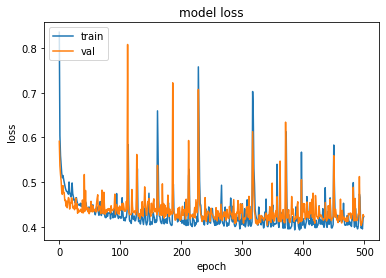

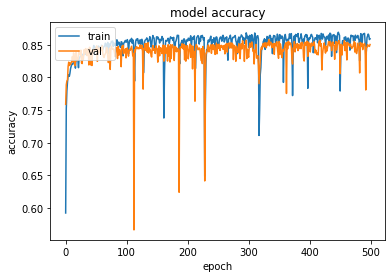

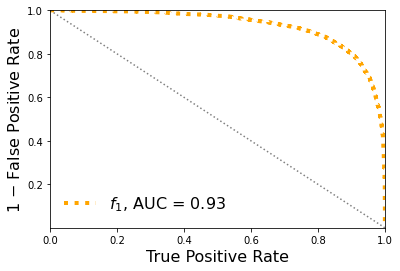

313/313 [==============================] - 1s 5ms/step - loss: 0.4261 - acc: 0.8532 - f1_m: 0.4634 - precision_m: 0.5001 - recall_m: 0.4328
Test ROC-AUC: 0.9295180599999999
Test loss: 0.42611756920814514
Test accuracy: 0.8532000184059143
Test f1: 0.46340659260749817
Test precision: 0.5001451969146729
Test recall: 0.4328075051307678
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 16s 155ms/step - loss: 0.8159 - acc: 0.5782 - f1_m: 0.5967 - precision_m: 0.5714 - recall_m: 0.6705 - val_loss: 0.5653 - val_acc: 0.7685 - val_f1_m: 0.7703 - val_precision_m: 0.7580 - val_recall_m: 0.7850
Epoch 2/500
94/94 [==============================] - 14s 148ms/step - loss: 0.5979 - acc: 0.7514 - f1_m: 0.7610 - precision_m: 0.7384 - recall_m: 0.7943 - val_loss: 0.5201 - val_acc: 0.7942 - val_f1_m: 0.7973 - val_precision_m: 0.7

Epoch 31/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4454 - acc: 0.8449 - f1_m: 0.8484 - precision_m: 0.8366 - recall_m: 0.8667 - val_loss: 0.4460 - val_acc: 0.8338 - val_f1_m: 0.8292 - val_precision_m: 0.8413 - val_recall_m: 0.8186
Epoch 32/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4390 - acc: 0.8490 - f1_m: 0.8486 - precision_m: 0.8391 - recall_m: 0.8628 - val_loss: 0.4357 - val_acc: 0.8398 - val_f1_m: 0.8332 - val_precision_m: 0.8564 - val_recall_m: 0.8126
Epoch 33/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4247 - acc: 0.8571 - f1_m: 0.8604 - precision_m: 0.8486 - recall_m: 0.8743 - val_loss: 0.4473 - val_acc: 0.8350 - val_f1_m: 0.8247 - val_precision_m: 0.8656 - val_recall_m: 0.7890
Epoch 34/500
94/94 [==============================] - 14s 150ms/step - loss: 0.4443 - acc: 0.8459 - f1_m: 0.8490 - precision_m: 0.8369 - recall_m: 0.8681 - val_loss: 0.4402 - val_acc: 0.8435 - val_f1_m: 0.8499 - val_precisi

Epoch 63/500
94/94 [==============================] - 14s 148ms/step - loss: 0.5056 - acc: 0.8148 - f1_m: 0.8176 - precision_m: 0.8090 - recall_m: 0.8506 - val_loss: 0.5832 - val_acc: 0.7862 - val_f1_m: 0.7782 - val_precision_m: 0.7981 - val_recall_m: 0.7607
Epoch 64/500
94/94 [==============================] - 14s 149ms/step - loss: 0.5734 - acc: 0.7930 - f1_m: 0.8045 - precision_m: 0.7698 - recall_m: 0.8474 - val_loss: 0.4811 - val_acc: 0.8307 - val_f1_m: 0.8315 - val_precision_m: 0.8207 - val_recall_m: 0.8444
Epoch 65/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4879 - acc: 0.8342 - f1_m: 0.8370 - precision_m: 0.8150 - recall_m: 0.8634 - val_loss: 0.4599 - val_acc: 0.8375 - val_f1_m: 0.8443 - val_precision_m: 0.8006 - val_recall_m: 0.8951
Epoch 66/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4346 - acc: 0.8524 - f1_m: 0.8578 - precision_m: 0.8355 - recall_m: 0.8841 - val_loss: 0.4428 - val_acc: 0.8458 - val_f1_m: 0.8505 - val_precisi

Epoch 95/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3912 - acc: 0.8766 - f1_m: 0.8804 - precision_m: 0.8607 - recall_m: 0.9032 - val_loss: 0.4499 - val_acc: 0.8472 - val_f1_m: 0.8516 - val_precision_m: 0.8207 - val_recall_m: 0.8862
Epoch 96/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4026 - acc: 0.8716 - f1_m: 0.8735 - precision_m: 0.8526 - recall_m: 0.8975 - val_loss: 0.5016 - val_acc: 0.8110 - val_f1_m: 0.7902 - val_precision_m: 0.8781 - val_recall_m: 0.7201
Epoch 97/500
94/94 [==============================] - 14s 148ms/step - loss: 0.5545 - acc: 0.7905 - f1_m: 0.8010 - precision_m: 0.7709 - recall_m: 0.8569 - val_loss: 0.5664 - val_acc: 0.7952 - val_f1_m: 0.8206 - val_precision_m: 0.7243 - val_recall_m: 0.9482
Epoch 98/500
94/94 [==============================] - 14s 148ms/step - loss: 0.5925 - acc: 0.7846 - f1_m: 0.8011 - precision_m: 0.7499 - recall_m: 0.8691 - val_loss: 0.5873 - val_acc: 0.7818 - val_f1_m: 0.8132 - val_precisi

94/94 [==============================] - 14s 149ms/step - loss: 0.7424 - acc: 0.5116 - f1_m: 0.4685 - precision_m: 0.5034 - recall_m: 0.4751 - val_loss: 0.7431 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 158/500
94/94 [==============================] - 14s 149ms/step - loss: 0.7376 - acc: 0.5084 - f1_m: 0.5287 - precision_m: 0.5101 - recall_m: 0.5564 - val_loss: 0.7255 - val_acc: 0.6613 - val_f1_m: 0.7381 - val_precision_m: 0.5966 - val_recall_m: 0.9699
Epoch 159/500
94/94 [==============================] - 14s 148ms/step - loss: 0.7265 - acc: 0.4949 - f1_m: 0.4434 - precision_m: 0.5014 - recall_m: 0.4288 - val_loss: 0.7204 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 160/500
94/94 [==============================] - 14s 149ms/step - loss: 0.7194 - acc: 0.4947 - f1_m: 0.5070 - precision_m: 0.4956 - recall_m: 0.5238 - val_loss: 0.7153 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_preci

94/94 [==============================] - 14s 150ms/step - loss: 0.4283 - acc: 0.8433 - f1_m: 0.8464 - precision_m: 0.8329 - recall_m: 0.8639 - val_loss: 0.4286 - val_acc: 0.8350 - val_f1_m: 0.8262 - val_precision_m: 0.8610 - val_recall_m: 0.7956
Epoch 220/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4254 - acc: 0.8456 - f1_m: 0.8478 - precision_m: 0.8395 - recall_m: 0.8612 - val_loss: 0.4317 - val_acc: 0.8420 - val_f1_m: 0.8414 - val_precision_m: 0.8364 - val_recall_m: 0.8480
Epoch 221/500
94/94 [==============================] - 14s 146ms/step - loss: 0.4617 - acc: 0.8289 - f1_m: 0.8304 - precision_m: 0.8270 - recall_m: 0.8407 - val_loss: 0.4281 - val_acc: 0.8475 - val_f1_m: 0.8496 - val_precision_m: 0.8296 - val_recall_m: 0.8724
Epoch 222/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4193 - acc: 0.8464 - f1_m: 0.8469 - precision_m: 0.8395 - recall_m: 0.8581 - val_loss: 0.4409 - val_acc: 0.8320 - val_f1_m: 0.8468 - val_precision_m: 0.77

94/94 [==============================] - 14s 147ms/step - loss: 0.5779 - acc: 0.7689 - f1_m: 0.7851 - precision_m: 0.7389 - recall_m: 0.8447 - val_loss: 0.5191 - val_acc: 0.8065 - val_f1_m: 0.8148 - val_precision_m: 0.7727 - val_recall_m: 0.8636
Epoch 282/500
94/94 [==============================] - 14s 147ms/step - loss: 0.5642 - acc: 0.7702 - f1_m: 0.7791 - precision_m: 0.7454 - recall_m: 0.8223 - val_loss: 0.4765 - val_acc: 0.8225 - val_f1_m: 0.8279 - val_precision_m: 0.7950 - val_recall_m: 0.8652
Epoch 283/500
94/94 [==============================] - 14s 148ms/step - loss: 0.5079 - acc: 0.8032 - f1_m: 0.8093 - precision_m: 0.7765 - recall_m: 0.8484 - val_loss: 0.4537 - val_acc: 0.8297 - val_f1_m: 0.8423 - val_precision_m: 0.7767 - val_recall_m: 0.9218
Epoch 284/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4791 - acc: 0.8179 - f1_m: 0.8265 - precision_m: 0.7936 - recall_m: 0.8663 - val_loss: 0.4436 - val_acc: 0.8350 - val_f1_m: 0.8336 - val_precision_m: 0.82

94/94 [==============================] - 14s 147ms/step - loss: 0.6325 - acc: 0.7668 - f1_m: 0.7842 - precision_m: 0.7272 - recall_m: 0.8579 - val_loss: 0.5103 - val_acc: 0.8275 - val_f1_m: 0.8412 - val_precision_m: 0.7708 - val_recall_m: 0.9275
Epoch 344/500
94/94 [==============================] - 14s 149ms/step - loss: 0.5642 - acc: 0.8032 - f1_m: 0.8137 - precision_m: 0.7749 - recall_m: 0.8643 - val_loss: 0.5487 - val_acc: 0.8278 - val_f1_m: 0.8287 - val_precision_m: 0.8178 - val_recall_m: 0.8415
Epoch 345/500
94/94 [==============================] - 14s 146ms/step - loss: 0.5557 - acc: 0.7967 - f1_m: 0.8082 - precision_m: 0.7672 - recall_m: 0.8600 - val_loss: 0.5239 - val_acc: 0.8075 - val_f1_m: 0.8269 - val_precision_m: 0.7435 - val_recall_m: 0.9335
Epoch 346/500
94/94 [==============================] - 14s 150ms/step - loss: 0.5331 - acc: 0.8057 - f1_m: 0.8157 - precision_m: 0.7835 - recall_m: 0.8577 - val_loss: 0.4651 - val_acc: 0.8313 - val_f1_m: 0.8363 - val_precision_m: 0.80

94/94 [==============================] - 14s 148ms/step - loss: 0.3890 - acc: 0.8614 - f1_m: 0.8654 - precision_m: 0.8411 - recall_m: 0.8929 - val_loss: 0.4186 - val_acc: 0.8440 - val_f1_m: 0.8487 - val_precision_m: 0.8091 - val_recall_m: 0.8940
Epoch 406/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4024 - acc: 0.8559 - f1_m: 0.8580 - precision_m: 0.8377 - recall_m: 0.8819 - val_loss: 0.4115 - val_acc: 0.8513 - val_f1_m: 0.8564 - val_precision_m: 0.8155 - val_recall_m: 0.9033
Epoch 407/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3891 - acc: 0.8658 - f1_m: 0.8703 - precision_m: 0.8489 - recall_m: 0.8945 - val_loss: 0.4112 - val_acc: 0.8472 - val_f1_m: 0.8458 - val_precision_m: 0.8399 - val_recall_m: 0.8534
Epoch 408/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3939 - acc: 0.8656 - f1_m: 0.8672 - precision_m: 0.8489 - recall_m: 0.8890 - val_loss: 0.4107 - val_acc: 0.8520 - val_f1_m: 0.8562 - val_precision_m: 0.81

94/94 [==============================] - 14s 149ms/step - loss: 0.4101 - acc: 0.8522 - f1_m: 0.8568 - precision_m: 0.8327 - recall_m: 0.8870 - val_loss: 0.4245 - val_acc: 0.8435 - val_f1_m: 0.8481 - val_precision_m: 0.8122 - val_recall_m: 0.8883
Epoch 468/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3982 - acc: 0.8536 - f1_m: 0.8586 - precision_m: 0.8331 - recall_m: 0.8878 - val_loss: 0.4304 - val_acc: 0.8470 - val_f1_m: 0.8529 - val_precision_m: 0.8109 - val_recall_m: 0.9008
Epoch 469/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3945 - acc: 0.8567 - f1_m: 0.8601 - precision_m: 0.8359 - recall_m: 0.8897 - val_loss: 0.4293 - val_acc: 0.8473 - val_f1_m: 0.8457 - val_precision_m: 0.8400 - val_recall_m: 0.8533
Epoch 470/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3913 - acc: 0.8626 - f1_m: 0.8659 - precision_m: 0.8449 - recall_m: 0.8910 - val_loss: 0.4332 - val_acc: 0.8397 - val_f1_m: 0.8438 - val_precision_m: 0.80

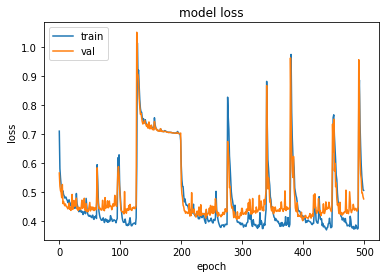

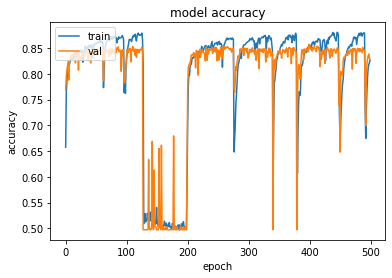

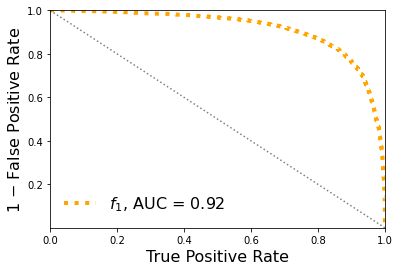

313/313 [==============================] - 1s 5ms/step - loss: 0.4852 - acc: 0.8347 - f1_m: 0.4433 - precision_m: 0.5003 - recall_m: 0.3995
Test ROC-AUC: 0.9153537600000001
Test loss: 0.4851524531841278
Test accuracy: 0.8346999883651733
Test f1: 0.4433196485042572
Test precision: 0.5003194808959961
Test recall: 0.3994608521461487
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 15s 38ms/step - loss: 0.9134 - acc: 0.5070 - f1_m: 0.4151 - precision_m: 0.5200 - recall_m: 0.3921 - val_loss: 0.7306 - val_acc: 0.6865 - val_f1_m: 0.6039 - val_precision_m: 0.7988 - val_recall_m: 0.4909
Epoch 2/500
375/375 [==============================] - 14s 37ms/step - loss: 0.6892 - acc: 0.6409 - f1_m: 0.6726 - precision_m: 0.6251 - recall_m: 0.7560 - val_loss: 0.5766 - val_acc: 0.7645 - val_f1_m: 0.7835 - val_precision_m: 0.71

Epoch 31/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4650 - acc: 0.8270 - f1_m: 0.8253 - precision_m: 0.8226 - recall_m: 0.8375 - val_loss: 0.4238 - val_acc: 0.8382 - val_f1_m: 0.8305 - val_precision_m: 0.8594 - val_recall_m: 0.8080
Epoch 32/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4457 - acc: 0.8338 - f1_m: 0.8308 - precision_m: 0.8304 - recall_m: 0.8397 - val_loss: 0.4449 - val_acc: 0.8400 - val_f1_m: 0.8466 - val_precision_m: 0.8028 - val_recall_m: 0.9002
Epoch 33/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4433 - acc: 0.8380 - f1_m: 0.8414 - precision_m: 0.8345 - recall_m: 0.8549 - val_loss: 0.4410 - val_acc: 0.8328 - val_f1_m: 0.8216 - val_precision_m: 0.8660 - val_recall_m: 0.7865
Epoch 34/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4621 - acc: 0.8294 - f1_m: 0.8306 - precision_m: 0.8213 - recall_m: 0.8479 - val_loss: 0.4368 - val_acc: 0.8480 - val_f1_m: 0.8519 - val_pre

375/375 [==============================] - 14s 37ms/step - loss: 0.4238 - acc: 0.8487 - f1_m: 0.8464 - precision_m: 0.8405 - recall_m: 0.8585 - val_loss: 0.4474 - val_acc: 0.8450 - val_f1_m: 0.8451 - val_precision_m: 0.8365 - val_recall_m: 0.8582
Epoch 94/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4391 - acc: 0.8478 - f1_m: 0.8486 - precision_m: 0.8402 - recall_m: 0.8638 - val_loss: 0.4186 - val_acc: 0.8448 - val_f1_m: 0.8431 - val_precision_m: 0.8427 - val_recall_m: 0.8484
Epoch 95/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4233 - acc: 0.8448 - f1_m: 0.8450 - precision_m: 0.8455 - recall_m: 0.8513 - val_loss: 0.4192 - val_acc: 0.8437 - val_f1_m: 0.8372 - val_precision_m: 0.8643 - val_recall_m: 0.8165
Epoch 96/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4191 - acc: 0.8536 - f1_m: 0.8522 - precision_m: 0.8538 - recall_m: 0.8572 - val_loss: 0.4316 - val_acc: 0.8240 - val_f1_m: 0.8075 - val_precision_m: 0.8

375/375 [==============================] - 14s 36ms/step - loss: 0.4500 - acc: 0.8472 - f1_m: 0.8429 - precision_m: 0.8485 - recall_m: 0.8511 - val_loss: 0.4174 - val_acc: 0.8478 - val_f1_m: 0.8485 - val_precision_m: 0.8347 - val_recall_m: 0.8673
Epoch 156/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4245 - acc: 0.8468 - f1_m: 0.8455 - precision_m: 0.8452 - recall_m: 0.8526 - val_loss: 0.4212 - val_acc: 0.8475 - val_f1_m: 0.8441 - val_precision_m: 0.8536 - val_recall_m: 0.8392
Epoch 157/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4325 - acc: 0.8474 - f1_m: 0.8440 - precision_m: 0.8440 - recall_m: 0.8502 - val_loss: 0.4528 - val_acc: 0.8395 - val_f1_m: 0.8505 - val_precision_m: 0.7850 - val_recall_m: 0.9328
Epoch 158/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4200 - acc: 0.8476 - f1_m: 0.8475 - precision_m: 0.8476 - recall_m: 0.8546 - val_loss: 0.4254 - val_acc: 0.8458 - val_f1_m: 0.8443 - val_precision_m: 

375/375 [==============================] - 14s 37ms/step - loss: 0.4324 - acc: 0.8488 - f1_m: 0.8475 - precision_m: 0.8483 - recall_m: 0.8529 - val_loss: 0.4084 - val_acc: 0.8525 - val_f1_m: 0.8521 - val_precision_m: 0.8466 - val_recall_m: 0.8633
Epoch 218/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4269 - acc: 0.8490 - f1_m: 0.8469 - precision_m: 0.8478 - recall_m: 0.8546 - val_loss: 0.4642 - val_acc: 0.8480 - val_f1_m: 0.8451 - val_precision_m: 0.8488 - val_recall_m: 0.8459
Epoch 219/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4691 - acc: 0.8428 - f1_m: 0.8409 - precision_m: 0.8394 - recall_m: 0.8489 - val_loss: 0.4138 - val_acc: 0.8432 - val_f1_m: 0.8353 - val_precision_m: 0.8679 - val_recall_m: 0.8098
Epoch 220/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4288 - acc: 0.8491 - f1_m: 0.8455 - precision_m: 0.8478 - recall_m: 0.8502 - val_loss: 0.4318 - val_acc: 0.8422 - val_f1_m: 0.8390 - val_precision_m: 

375/375 [==============================] - 14s 37ms/step - loss: 0.4175 - acc: 0.8510 - f1_m: 0.8482 - precision_m: 0.8520 - recall_m: 0.8508 - val_loss: 0.4010 - val_acc: 0.8543 - val_f1_m: 0.8529 - val_precision_m: 0.8519 - val_recall_m: 0.8581
Epoch 280/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4098 - acc: 0.8550 - f1_m: 0.8519 - precision_m: 0.8607 - recall_m: 0.8495 - val_loss: 0.4178 - val_acc: 0.8487 - val_f1_m: 0.8559 - val_precision_m: 0.8064 - val_recall_m: 0.9163
Epoch 281/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4182 - acc: 0.8476 - f1_m: 0.8466 - precision_m: 0.8420 - recall_m: 0.8580 - val_loss: 0.4500 - val_acc: 0.8365 - val_f1_m: 0.8382 - val_precision_m: 0.8186 - val_recall_m: 0.8627
Epoch 282/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4289 - acc: 0.8489 - f1_m: 0.8462 - precision_m: 0.8526 - recall_m: 0.8451 - val_loss: 0.4091 - val_acc: 0.8442 - val_f1_m: 0.8373 - val_precision_m: 

375/375 [==============================] - 14s 36ms/step - loss: 0.4368 - acc: 0.8425 - f1_m: 0.8379 - precision_m: 0.8515 - recall_m: 0.8330 - val_loss: 0.4367 - val_acc: 0.8432 - val_f1_m: 0.8386 - val_precision_m: 0.8555 - val_recall_m: 0.8275
Epoch 342/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4306 - acc: 0.8533 - f1_m: 0.8496 - precision_m: 0.8534 - recall_m: 0.8509 - val_loss: 0.4131 - val_acc: 0.8522 - val_f1_m: 0.8541 - val_precision_m: 0.8320 - val_recall_m: 0.8822
Epoch 343/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4225 - acc: 0.8521 - f1_m: 0.8497 - precision_m: 0.8554 - recall_m: 0.8508 - val_loss: 0.4240 - val_acc: 0.8407 - val_f1_m: 0.8394 - val_precision_m: 0.8334 - val_recall_m: 0.8505
Epoch 344/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4219 - acc: 0.8498 - f1_m: 0.8462 - precision_m: 0.8536 - recall_m: 0.8458 - val_loss: 0.4112 - val_acc: 0.8493 - val_f1_m: 0.8449 - val_precision_m: 

375/375 [==============================] - 14s 36ms/step - loss: 0.4325 - acc: 0.8462 - f1_m: 0.8418 - precision_m: 0.8532 - recall_m: 0.8384 - val_loss: 0.4062 - val_acc: 0.8520 - val_f1_m: 0.8489 - val_precision_m: 0.8562 - val_recall_m: 0.8457
Epoch 404/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4295 - acc: 0.8468 - f1_m: 0.8451 - precision_m: 0.8489 - recall_m: 0.8484 - val_loss: 0.4114 - val_acc: 0.8510 - val_f1_m: 0.8518 - val_precision_m: 0.8372 - val_recall_m: 0.8714
Epoch 405/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4210 - acc: 0.8461 - f1_m: 0.8428 - precision_m: 0.8487 - recall_m: 0.8425 - val_loss: 0.4078 - val_acc: 0.8477 - val_f1_m: 0.8437 - val_precision_m: 0.8580 - val_recall_m: 0.8338
Epoch 406/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4318 - acc: 0.8448 - f1_m: 0.8431 - precision_m: 0.8479 - recall_m: 0.8455 - val_loss: 0.4199 - val_acc: 0.8437 - val_f1_m: 0.8376 - val_precision_m: 

375/375 [==============================] - 14s 36ms/step - loss: 0.4240 - acc: 0.8513 - f1_m: 0.8512 - precision_m: 0.8568 - recall_m: 0.8526 - val_loss: 0.5076 - val_acc: 0.7945 - val_f1_m: 0.7604 - val_precision_m: 0.8997 - val_recall_m: 0.6634
Epoch 466/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4614 - acc: 0.8419 - f1_m: 0.8405 - precision_m: 0.8499 - recall_m: 0.8418 - val_loss: 0.4400 - val_acc: 0.8445 - val_f1_m: 0.8406 - val_precision_m: 0.8511 - val_recall_m: 0.8344
Epoch 467/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4343 - acc: 0.8514 - f1_m: 0.8476 - precision_m: 0.8558 - recall_m: 0.8466 - val_loss: 0.4275 - val_acc: 0.8448 - val_f1_m: 0.8444 - val_precision_m: 0.8375 - val_recall_m: 0.8563
Epoch 468/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4349 - acc: 0.8479 - f1_m: 0.8453 - precision_m: 0.8498 - recall_m: 0.8479 - val_loss: 0.4130 - val_acc: 0.8513 - val_f1_m: 0.8524 - val_precision_m: 

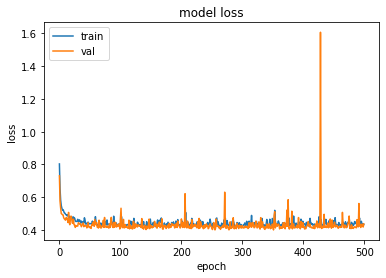

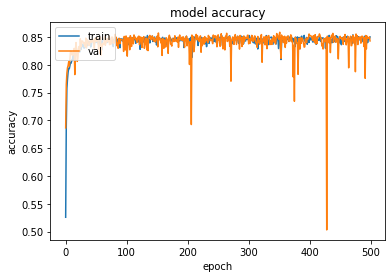

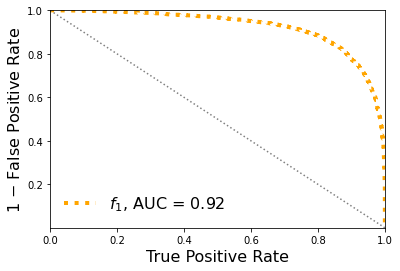

313/313 [==============================] - 2s 5ms/step - loss: 0.4401 - acc: 0.8464 - f1_m: 0.4598 - precision_m: 0.5000 - recall_m: 0.4268
Test ROC-AUC: 0.9229947599999999
Test loss: 0.4400657117366791
Test accuracy: 0.8464000225067139
Test f1: 0.4597983956336975
Test precision: 0.5
Test recall: 0.4268170893192291
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 15s 75ms/step - loss: 0.7869 - acc: 0.5989 - f1_m: 0.5804 - precision_m: 0.5966 - recall_m: 0.5812 - val_loss: 0.5313 - val_acc: 0.7877 - val_f1_m: 0.7910 - val_precision_m: 0.7716 - val_recall_m: 0.8142
Epoch 2/500
188/188 [==============================] - 13s 72ms/step - loss: 0.5649 - acc: 0.7638 - f1_m: 0.7689 - precision_m: 0.7594 - recall_m: 0.7867 - val_loss: 0.4976 - val_acc: 0.8080 - val_f1_m: 0.8169 - val_precision_m: 0.7742 - val_recal

Epoch 31/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4370 - acc: 0.8411 - f1_m: 0.8433 - precision_m: 0.8296 - recall_m: 0.8618 - val_loss: 0.4281 - val_acc: 0.8408 - val_f1_m: 0.8482 - val_precision_m: 0.8057 - val_recall_m: 0.8988
Epoch 32/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4409 - acc: 0.8378 - f1_m: 0.8387 - precision_m: 0.8327 - recall_m: 0.8501 - val_loss: 0.4314 - val_acc: 0.8325 - val_f1_m: 0.8238 - val_precision_m: 0.8600 - val_recall_m: 0.7939
Epoch 33/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4355 - acc: 0.8415 - f1_m: 0.8411 - precision_m: 0.8372 - recall_m: 0.8512 - val_loss: 0.4540 - val_acc: 0.8280 - val_f1_m: 0.8432 - val_precision_m: 0.7693 - val_recall_m: 0.9359
Epoch 34/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4360 - acc: 0.8439 - f1_m: 0.8466 - precision_m: 0.8330 - recall_m: 0.8659 - val_loss: 0.4772 - val_acc: 0.8248 - val_f1_m: 0.8419 - val_pre

188/188 [==============================] - 14s 72ms/step - loss: 0.4061 - acc: 0.8600 - f1_m: 0.8598 - precision_m: 0.8511 - recall_m: 0.8727 - val_loss: 0.4201 - val_acc: 0.8457 - val_f1_m: 0.8493 - val_precision_m: 0.8240 - val_recall_m: 0.8791
Epoch 94/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4087 - acc: 0.8597 - f1_m: 0.8616 - precision_m: 0.8499 - recall_m: 0.8781 - val_loss: 0.4211 - val_acc: 0.8460 - val_f1_m: 0.8513 - val_precision_m: 0.8163 - val_recall_m: 0.8924
Epoch 95/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4151 - acc: 0.8570 - f1_m: 0.8585 - precision_m: 0.8424 - recall_m: 0.8810 - val_loss: 0.4316 - val_acc: 0.8422 - val_f1_m: 0.8449 - val_precision_m: 0.8268 - val_recall_m: 0.8668
Epoch 96/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4169 - acc: 0.8527 - f1_m: 0.8553 - precision_m: 0.8415 - recall_m: 0.8751 - val_loss: 0.4447 - val_acc: 0.8358 - val_f1_m: 0.8266 - val_precision_m: 0.8

188/188 [==============================] - 13s 72ms/step - loss: 0.4161 - acc: 0.8530 - f1_m: 0.8563 - precision_m: 0.8387 - recall_m: 0.8785 - val_loss: 0.4270 - val_acc: 0.8483 - val_f1_m: 0.8515 - val_precision_m: 0.8278 - val_recall_m: 0.8796
Epoch 156/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4054 - acc: 0.8588 - f1_m: 0.8614 - precision_m: 0.8452 - recall_m: 0.8814 - val_loss: 0.4815 - val_acc: 0.8352 - val_f1_m: 0.8476 - val_precision_m: 0.7820 - val_recall_m: 0.9285
Epoch 157/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4074 - acc: 0.8577 - f1_m: 0.8619 - precision_m: 0.8336 - recall_m: 0.8957 - val_loss: 0.4744 - val_acc: 0.8280 - val_f1_m: 0.8428 - val_precision_m: 0.7695 - val_recall_m: 0.9346
Epoch 158/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4129 - acc: 0.8529 - f1_m: 0.8569 - precision_m: 0.8340 - recall_m: 0.8866 - val_loss: 0.4435 - val_acc: 0.8278 - val_f1_m: 0.8162 - val_precision_m: 

188/188 [==============================] - 14s 72ms/step - loss: 0.4100 - acc: 0.8599 - f1_m: 0.8611 - precision_m: 0.8547 - recall_m: 0.8713 - val_loss: 0.4574 - val_acc: 0.8420 - val_f1_m: 0.8497 - val_precision_m: 0.8054 - val_recall_m: 0.9024
Epoch 218/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4042 - acc: 0.8679 - f1_m: 0.8675 - precision_m: 0.8633 - recall_m: 0.8749 - val_loss: 0.4610 - val_acc: 0.8335 - val_f1_m: 0.8487 - val_precision_m: 0.7734 - val_recall_m: 0.9436
Epoch 219/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4143 - acc: 0.8569 - f1_m: 0.8571 - precision_m: 0.8471 - recall_m: 0.8712 - val_loss: 0.4300 - val_acc: 0.8455 - val_f1_m: 0.8491 - val_precision_m: 0.8207 - val_recall_m: 0.8818
Epoch 220/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4020 - acc: 0.8613 - f1_m: 0.8615 - precision_m: 0.8534 - recall_m: 0.8739 - val_loss: 0.4404 - val_acc: 0.8313 - val_f1_m: 0.8191 - val_precision_m: 

188/188 [==============================] - 14s 72ms/step - loss: 0.4171 - acc: 0.8564 - f1_m: 0.8572 - precision_m: 0.8543 - recall_m: 0.8634 - val_loss: 0.4683 - val_acc: 0.8287 - val_f1_m: 0.8354 - val_precision_m: 0.7984 - val_recall_m: 0.8793
Epoch 280/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4240 - acc: 0.8551 - f1_m: 0.8554 - precision_m: 0.8496 - recall_m: 0.8649 - val_loss: 0.4555 - val_acc: 0.8335 - val_f1_m: 0.8278 - val_precision_m: 0.8504 - val_recall_m: 0.8087
Epoch 281/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4410 - acc: 0.8497 - f1_m: 0.8513 - precision_m: 0.8438 - recall_m: 0.8643 - val_loss: 0.4899 - val_acc: 0.8343 - val_f1_m: 0.8424 - val_precision_m: 0.7982 - val_recall_m: 0.8951
Epoch 282/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4720 - acc: 0.8345 - f1_m: 0.8350 - precision_m: 0.8180 - recall_m: 0.8573 - val_loss: 0.4591 - val_acc: 0.8320 - val_f1_m: 0.8276 - val_precision_m: 

188/188 [==============================] - 13s 72ms/step - loss: 0.4064 - acc: 0.8680 - f1_m: 0.8694 - precision_m: 0.8619 - recall_m: 0.8802 - val_loss: 0.4424 - val_acc: 0.8425 - val_f1_m: 0.8384 - val_precision_m: 0.8544 - val_recall_m: 0.8255
Epoch 342/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4033 - acc: 0.8678 - f1_m: 0.8678 - precision_m: 0.8651 - recall_m: 0.8745 - val_loss: 0.5143 - val_acc: 0.8085 - val_f1_m: 0.8080 - val_precision_m: 0.8046 - val_recall_m: 0.8153
Epoch 343/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4694 - acc: 0.8387 - f1_m: 0.8374 - precision_m: 0.8431 - recall_m: 0.8388 - val_loss: 0.4732 - val_acc: 0.8238 - val_f1_m: 0.8125 - val_precision_m: 0.8608 - val_recall_m: 0.7724
Epoch 344/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4365 - acc: 0.8525 - f1_m: 0.8511 - precision_m: 0.8471 - recall_m: 0.8588 - val_loss: 0.4876 - val_acc: 0.8170 - val_f1_m: 0.8089 - val_precision_m: 

188/188 [==============================] - 13s 72ms/step - loss: 0.3988 - acc: 0.8719 - f1_m: 0.8743 - precision_m: 0.8685 - recall_m: 0.8833 - val_loss: 0.4381 - val_acc: 0.8492 - val_f1_m: 0.8552 - val_precision_m: 0.8163 - val_recall_m: 0.9007
Epoch 404/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4120 - acc: 0.8649 - f1_m: 0.8649 - precision_m: 0.8624 - recall_m: 0.8726 - val_loss: 0.4499 - val_acc: 0.8435 - val_f1_m: 0.8451 - val_precision_m: 0.8280 - val_recall_m: 0.8656
Epoch 405/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3873 - acc: 0.8760 - f1_m: 0.8751 - precision_m: 0.8729 - recall_m: 0.8808 - val_loss: 0.4501 - val_acc: 0.8382 - val_f1_m: 0.8318 - val_precision_m: 0.8564 - val_recall_m: 0.8110
Epoch 406/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3863 - acc: 0.8770 - f1_m: 0.8769 - precision_m: 0.8821 - recall_m: 0.8746 - val_loss: 0.4488 - val_acc: 0.8452 - val_f1_m: 0.8471 - val_precision_m: 

188/188 [==============================] - 14s 72ms/step - loss: 0.3964 - acc: 0.8763 - f1_m: 0.8765 - precision_m: 0.8728 - recall_m: 0.8827 - val_loss: 0.4802 - val_acc: 0.8237 - val_f1_m: 0.8098 - val_precision_m: 0.8717 - val_recall_m: 0.7594
Epoch 466/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3982 - acc: 0.8759 - f1_m: 0.8749 - precision_m: 0.8748 - recall_m: 0.8775 - val_loss: 0.4688 - val_acc: 0.8453 - val_f1_m: 0.8452 - val_precision_m: 0.8393 - val_recall_m: 0.8537
Epoch 467/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3968 - acc: 0.8762 - f1_m: 0.8761 - precision_m: 0.8730 - recall_m: 0.8818 - val_loss: 0.4738 - val_acc: 0.8425 - val_f1_m: 0.8411 - val_precision_m: 0.8419 - val_recall_m: 0.8429
Epoch 468/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3891 - acc: 0.8824 - f1_m: 0.8820 - precision_m: 0.8786 - recall_m: 0.8882 - val_loss: 0.4621 - val_acc: 0.8475 - val_f1_m: 0.8510 - val_precision_m: 

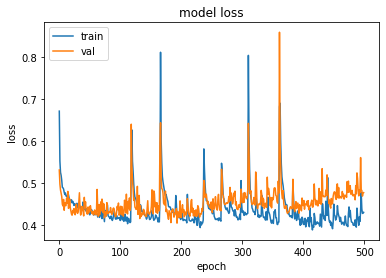

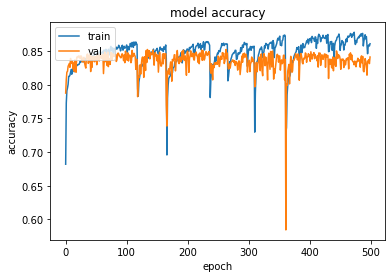

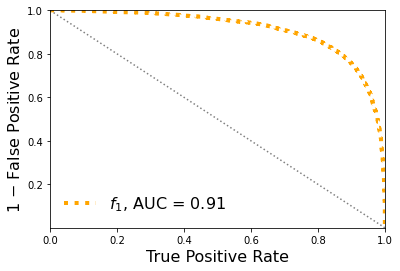

313/313 [==============================] - 2s 5ms/step - loss: 0.4878 - acc: 0.8344 - f1_m: 0.4562 - precision_m: 0.4999 - recall_m: 0.4207
Test ROC-AUC: 0.91117098
Test loss: 0.48780205845832825
Test accuracy: 0.8343999981880188
Test f1: 0.4561862051486969
Test precision: 0.49985477328300476
Test recall: 0.42072683572769165
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 16s 156ms/step - loss: 0.9698 - acc: 0.5064 - f1_m: 0.3668 - precision_m: 0.5196 - recall_m: 0.3155 - val_loss: 0.7588 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
94/94 [==============================] - 14s 149ms/step - loss: 0.7524 - acc: 0.5116 - f1_m: 0.4426 - precision_m: 0.5183 - recall_m: 0.3937 - val_loss: 0.7404 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precisi

Epoch 31/500
94/94 [==============================] - 14s 147ms/step - loss: 0.4314 - acc: 0.8350 - f1_m: 0.8358 - precision_m: 0.8302 - recall_m: 0.8444 - val_loss: 0.4110 - val_acc: 0.8427 - val_f1_m: 0.8431 - val_precision_m: 0.8306 - val_recall_m: 0.8575
Epoch 32/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4224 - acc: 0.8428 - f1_m: 0.8424 - precision_m: 0.8367 - recall_m: 0.8523 - val_loss: 0.4162 - val_acc: 0.8435 - val_f1_m: 0.8428 - val_precision_m: 0.8354 - val_recall_m: 0.8521
Epoch 33/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4277 - acc: 0.8418 - f1_m: 0.8433 - precision_m: 0.8394 - recall_m: 0.8497 - val_loss: 0.4113 - val_acc: 0.8493 - val_f1_m: 0.8496 - val_precision_m: 0.8326 - val_recall_m: 0.8687
Epoch 34/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4400 - acc: 0.8315 - f1_m: 0.8310 - precision_m: 0.8305 - recall_m: 0.8355 - val_loss: 0.4260 - val_acc: 0.8432 - val_f1_m: 0.8491 - val_precisi

Epoch 63/500
94/94 [==============================] - 14s 147ms/step - loss: 0.4129 - acc: 0.8537 - f1_m: 0.8562 - precision_m: 0.8424 - recall_m: 0.8752 - val_loss: 0.4179 - val_acc: 0.8485 - val_f1_m: 0.8526 - val_precision_m: 0.8241 - val_recall_m: 0.8843
Epoch 64/500
94/94 [==============================] - 14s 147ms/step - loss: 0.4032 - acc: 0.8577 - f1_m: 0.8606 - precision_m: 0.8405 - recall_m: 0.8850 - val_loss: 0.4516 - val_acc: 0.8227 - val_f1_m: 0.8415 - val_precision_m: 0.7511 - val_recall_m: 0.9579
Epoch 65/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4066 - acc: 0.8538 - f1_m: 0.8566 - precision_m: 0.8374 - recall_m: 0.8840 - val_loss: 0.4133 - val_acc: 0.8470 - val_f1_m: 0.8475 - val_precision_m: 0.8330 - val_recall_m: 0.8639
Epoch 66/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3959 - acc: 0.8599 - f1_m: 0.8623 - precision_m: 0.8483 - recall_m: 0.8797 - val_loss: 0.4075 - val_acc: 0.8483 - val_f1_m: 0.8507 - val_precisi

Epoch 95/500
94/94 [==============================] - 14s 149ms/step - loss: 0.3946 - acc: 0.8632 - f1_m: 0.8653 - precision_m: 0.8504 - recall_m: 0.8846 - val_loss: 0.4297 - val_acc: 0.8398 - val_f1_m: 0.8523 - val_precision_m: 0.7844 - val_recall_m: 0.9341
Epoch 96/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4093 - acc: 0.8528 - f1_m: 0.8576 - precision_m: 0.8342 - recall_m: 0.8879 - val_loss: 0.4262 - val_acc: 0.8457 - val_f1_m: 0.8446 - val_precision_m: 0.8440 - val_recall_m: 0.8468
Epoch 97/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4007 - acc: 0.8618 - f1_m: 0.8636 - precision_m: 0.8473 - recall_m: 0.8832 - val_loss: 0.4187 - val_acc: 0.8507 - val_f1_m: 0.8496 - val_precision_m: 0.8506 - val_recall_m: 0.8502
Epoch 98/500
94/94 [==============================] - 14s 149ms/step - loss: 0.3939 - acc: 0.8639 - f1_m: 0.8645 - precision_m: 0.8523 - recall_m: 0.8808 - val_loss: 0.4147 - val_acc: 0.8517 - val_f1_m: 0.8543 - val_precisi

94/94 [==============================] - 14s 147ms/step - loss: 0.3803 - acc: 0.8719 - f1_m: 0.8751 - precision_m: 0.8552 - recall_m: 0.8991 - val_loss: 0.4255 - val_acc: 0.8450 - val_f1_m: 0.8515 - val_precision_m: 0.8060 - val_recall_m: 0.9041
Epoch 158/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3810 - acc: 0.8750 - f1_m: 0.8779 - precision_m: 0.8585 - recall_m: 0.9011 - val_loss: 0.4292 - val_acc: 0.8400 - val_f1_m: 0.8344 - val_precision_m: 0.8537 - val_recall_m: 0.8177
Epoch 159/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3738 - acc: 0.8756 - f1_m: 0.8773 - precision_m: 0.8608 - recall_m: 0.8964 - val_loss: 0.4239 - val_acc: 0.8502 - val_f1_m: 0.8523 - val_precision_m: 0.8290 - val_recall_m: 0.8788
Epoch 160/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3845 - acc: 0.8729 - f1_m: 0.8761 - precision_m: 0.8566 - recall_m: 0.8989 - val_loss: 0.4186 - val_acc: 0.8493 - val_f1_m: 0.8517 - val_precision_m: 0.83

94/94 [==============================] - 14s 148ms/step - loss: 0.3735 - acc: 0.8716 - f1_m: 0.8751 - precision_m: 0.8570 - recall_m: 0.8967 - val_loss: 0.4340 - val_acc: 0.8420 - val_f1_m: 0.8371 - val_precision_m: 0.8464 - val_recall_m: 0.8301
Epoch 220/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3770 - acc: 0.8736 - f1_m: 0.8740 - precision_m: 0.8624 - recall_m: 0.8886 - val_loss: 0.4311 - val_acc: 0.8410 - val_f1_m: 0.8479 - val_precision_m: 0.8041 - val_recall_m: 0.8986
Epoch 221/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3701 - acc: 0.8789 - f1_m: 0.8811 - precision_m: 0.8658 - recall_m: 0.8991 - val_loss: 0.4336 - val_acc: 0.8467 - val_f1_m: 0.8460 - val_precision_m: 0.8370 - val_recall_m: 0.8571
Epoch 222/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3772 - acc: 0.8751 - f1_m: 0.8774 - precision_m: 0.8594 - recall_m: 0.8985 - val_loss: 0.4406 - val_acc: 0.8455 - val_f1_m: 0.8472 - val_precision_m: 0.82

94/94 [==============================] - 14s 148ms/step - loss: 0.3840 - acc: 0.8709 - f1_m: 0.8733 - precision_m: 0.8553 - recall_m: 0.8943 - val_loss: 0.4513 - val_acc: 0.8363 - val_f1_m: 0.8364 - val_precision_m: 0.8259 - val_recall_m: 0.8487
Epoch 282/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3924 - acc: 0.8660 - f1_m: 0.8691 - precision_m: 0.8479 - recall_m: 0.8934 - val_loss: 0.4641 - val_acc: 0.8263 - val_f1_m: 0.8345 - val_precision_m: 0.7916 - val_recall_m: 0.8836
Epoch 283/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4009 - acc: 0.8625 - f1_m: 0.8663 - precision_m: 0.8451 - recall_m: 0.8911 - val_loss: 0.4469 - val_acc: 0.8360 - val_f1_m: 0.8354 - val_precision_m: 0.8263 - val_recall_m: 0.8464
Epoch 284/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3922 - acc: 0.8671 - f1_m: 0.8712 - precision_m: 0.8509 - recall_m: 0.8947 - val_loss: 0.4910 - val_acc: 0.8238 - val_f1_m: 0.8134 - val_precision_m: 0.85

94/94 [==============================] - 14s 146ms/step - loss: 0.3665 - acc: 0.8808 - f1_m: 0.8836 - precision_m: 0.8731 - recall_m: 0.8964 - val_loss: 0.4578 - val_acc: 0.8400 - val_f1_m: 0.8431 - val_precision_m: 0.8186 - val_recall_m: 0.8704
Epoch 344/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3639 - acc: 0.8857 - f1_m: 0.8879 - precision_m: 0.8695 - recall_m: 0.9098 - val_loss: 0.4668 - val_acc: 0.8388 - val_f1_m: 0.8434 - val_precision_m: 0.8100 - val_recall_m: 0.8809
Epoch 345/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3500 - acc: 0.8894 - f1_m: 0.8907 - precision_m: 0.8749 - recall_m: 0.9084 - val_loss: 0.4832 - val_acc: 0.8298 - val_f1_m: 0.8433 - val_precision_m: 0.7739 - val_recall_m: 0.9276
Epoch 346/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3660 - acc: 0.8856 - f1_m: 0.8896 - precision_m: 0.8696 - recall_m: 0.9131 - val_loss: 0.4649 - val_acc: 0.8363 - val_f1_m: 0.8286 - val_precision_m: 0.85

94/94 [==============================] - 14s 145ms/step - loss: 0.4440 - acc: 0.8539 - f1_m: 0.8577 - precision_m: 0.8414 - recall_m: 0.8812 - val_loss: 0.4958 - val_acc: 0.8300 - val_f1_m: 0.8363 - val_precision_m: 0.8008 - val_recall_m: 0.8767
Epoch 406/500
94/94 [==============================] - 14s 146ms/step - loss: 0.3900 - acc: 0.8803 - f1_m: 0.8823 - precision_m: 0.8679 - recall_m: 0.8998 - val_loss: 0.4784 - val_acc: 0.8325 - val_f1_m: 0.8300 - val_precision_m: 0.8343 - val_recall_m: 0.8274
Epoch 407/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3849 - acc: 0.8791 - f1_m: 0.8808 - precision_m: 0.8648 - recall_m: 0.8996 - val_loss: 0.4982 - val_acc: 0.8237 - val_f1_m: 0.8373 - val_precision_m: 0.7754 - val_recall_m: 0.9113
Epoch 408/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3744 - acc: 0.8836 - f1_m: 0.8865 - precision_m: 0.8669 - recall_m: 0.9097 - val_loss: 0.4743 - val_acc: 0.8363 - val_f1_m: 0.8331 - val_precision_m: 0.84

94/94 [==============================] - 14s 147ms/step - loss: 0.4222 - acc: 0.8568 - f1_m: 0.8568 - precision_m: 0.8578 - recall_m: 0.8593 - val_loss: 0.4200 - val_acc: 0.8473 - val_f1_m: 0.8516 - val_precision_m: 0.8162 - val_recall_m: 0.8920
Epoch 468/500
94/94 [==============================] - 14s 145ms/step - loss: 0.4180 - acc: 0.8529 - f1_m: 0.8532 - precision_m: 0.8502 - recall_m: 0.8591 - val_loss: 0.4229 - val_acc: 0.8518 - val_f1_m: 0.8544 - val_precision_m: 0.8293 - val_recall_m: 0.8825
Epoch 469/500
94/94 [==============================] - 14s 146ms/step - loss: 0.4007 - acc: 0.8646 - f1_m: 0.8634 - precision_m: 0.8613 - recall_m: 0.8682 - val_loss: 0.4131 - val_acc: 0.8532 - val_f1_m: 0.8492 - val_precision_m: 0.8584 - val_recall_m: 0.8420
Epoch 470/500
94/94 [==============================] - 14s 146ms/step - loss: 0.3908 - acc: 0.8694 - f1_m: 0.8684 - precision_m: 0.8672 - recall_m: 0.8718 - val_loss: 0.4230 - val_acc: 0.8487 - val_f1_m: 0.8543 - val_precision_m: 0.81

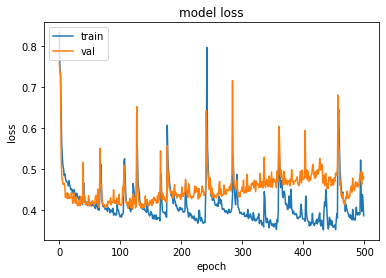

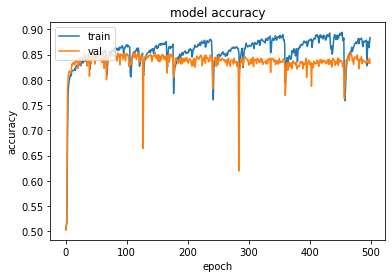

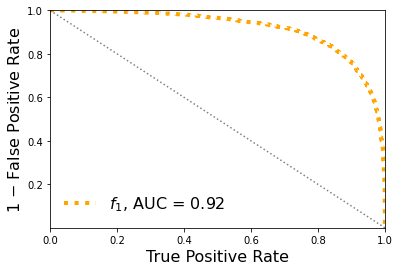

313/313 [==============================] - 2s 5ms/step - loss: 0.4781 - acc: 0.8353 - f1_m: 0.4619 - precision_m: 0.5003 - recall_m: 0.4299
Test ROC-AUC: 0.91628008
Test loss: 0.4780741333961487
Test accuracy: 0.8353000283241272
Test f1: 0.4619106352329254
Test precision: 0.5003194808959961
Test recall: 0.42991214990615845
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 15s 38ms/step - loss: 0.7348 - acc: 0.6824 - f1_m: 0.6890 - precision_m: 0.6789 - recall_m: 0.7214 - val_loss: 0.5375 - val_acc: 0.7870 - val_f1_m: 0.8012 - val_precision_m: 0.7410 - val_recall_m: 0.8775
Epoch 2/500
375/375 [==============================] - 14s 37ms/step - loss: 0.5570 - acc: 0.7776 - f1_m: 0.7799 - precision_m: 0.7734 - recall_m: 0.7960 - val_loss: 0.5088 - val_acc: 0.8127 - val_f1_m: 0.8069 - val_precision_m: 0.8183 - val

Epoch 31/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4684 - acc: 0.8306 - f1_m: 0.8295 - precision_m: 0.8157 - recall_m: 0.8513 - val_loss: 0.4410 - val_acc: 0.8410 - val_f1_m: 0.8407 - val_precision_m: 0.8298 - val_recall_m: 0.8567
Epoch 32/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4599 - acc: 0.8347 - f1_m: 0.8336 - precision_m: 0.8225 - recall_m: 0.8525 - val_loss: 0.4471 - val_acc: 0.8433 - val_f1_m: 0.8447 - val_precision_m: 0.8237 - val_recall_m: 0.8711
Epoch 33/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4867 - acc: 0.8242 - f1_m: 0.8266 - precision_m: 0.8130 - recall_m: 0.8495 - val_loss: 0.4725 - val_acc: 0.8168 - val_f1_m: 0.7997 - val_precision_m: 0.8732 - val_recall_m: 0.7424
Epoch 34/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4695 - acc: 0.8309 - f1_m: 0.8338 - precision_m: 0.8185 - recall_m: 0.8589 - val_loss: 0.4467 - val_acc: 0.8445 - val_f1_m: 0.8476 - val_pre

375/375 [==============================] - 14s 37ms/step - loss: 0.4478 - acc: 0.8407 - f1_m: 0.8421 - precision_m: 0.8290 - recall_m: 0.8630 - val_loss: 0.4331 - val_acc: 0.8432 - val_f1_m: 0.8489 - val_precision_m: 0.8061 - val_recall_m: 0.9008
Epoch 94/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4488 - acc: 0.8361 - f1_m: 0.8377 - precision_m: 0.8246 - recall_m: 0.8608 - val_loss: 0.4409 - val_acc: 0.8323 - val_f1_m: 0.8230 - val_precision_m: 0.8594 - val_recall_m: 0.7944
Epoch 95/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4490 - acc: 0.8397 - f1_m: 0.8380 - precision_m: 0.8311 - recall_m: 0.8524 - val_loss: 0.4269 - val_acc: 0.8452 - val_f1_m: 0.8438 - val_precision_m: 0.8385 - val_recall_m: 0.8541
Epoch 96/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4485 - acc: 0.8402 - f1_m: 0.8422 - precision_m: 0.8266 - recall_m: 0.8645 - val_loss: 0.4250 - val_acc: 0.8415 - val_f1_m: 0.8379 - val_precision_m: 0.8

375/375 [==============================] - 14s 37ms/step - loss: 0.4526 - acc: 0.8402 - f1_m: 0.8413 - precision_m: 0.8253 - recall_m: 0.8658 - val_loss: 0.4338 - val_acc: 0.8285 - val_f1_m: 0.8144 - val_precision_m: 0.8780 - val_recall_m: 0.7638
Epoch 156/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4430 - acc: 0.8399 - f1_m: 0.8410 - precision_m: 0.8312 - recall_m: 0.8596 - val_loss: 0.4687 - val_acc: 0.8228 - val_f1_m: 0.8038 - val_precision_m: 0.8863 - val_recall_m: 0.7398
Epoch 157/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4425 - acc: 0.8428 - f1_m: 0.8456 - precision_m: 0.8318 - recall_m: 0.8682 - val_loss: 0.4210 - val_acc: 0.8430 - val_f1_m: 0.8383 - val_precision_m: 0.8523 - val_recall_m: 0.8293
Epoch 158/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4500 - acc: 0.8371 - f1_m: 0.8360 - precision_m: 0.8261 - recall_m: 0.8570 - val_loss: 0.4710 - val_acc: 0.8440 - val_f1_m: 0.8484 - val_precision_m: 

375/375 [==============================] - 14s 37ms/step - loss: 0.4376 - acc: 0.8394 - f1_m: 0.8382 - precision_m: 0.8255 - recall_m: 0.8601 - val_loss: 0.4259 - val_acc: 0.8463 - val_f1_m: 0.8563 - val_precision_m: 0.7934 - val_recall_m: 0.9348
Epoch 218/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4275 - acc: 0.8468 - f1_m: 0.8481 - precision_m: 0.8284 - recall_m: 0.8766 - val_loss: 0.4270 - val_acc: 0.8472 - val_f1_m: 0.8564 - val_precision_m: 0.7969 - val_recall_m: 0.9296
Epoch 219/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4278 - acc: 0.8418 - f1_m: 0.8426 - precision_m: 0.8260 - recall_m: 0.8683 - val_loss: 0.4208 - val_acc: 0.8468 - val_f1_m: 0.8460 - val_precision_m: 0.8385 - val_recall_m: 0.8580
Epoch 220/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4456 - acc: 0.8400 - f1_m: 0.8404 - precision_m: 0.8263 - recall_m: 0.8648 - val_loss: 0.4300 - val_acc: 0.8420 - val_f1_m: 0.8496 - val_precision_m: 

375/375 [==============================] - 14s 37ms/step - loss: 0.4182 - acc: 0.8496 - f1_m: 0.8508 - precision_m: 0.8382 - recall_m: 0.8707 - val_loss: 0.4406 - val_acc: 0.8340 - val_f1_m: 0.8213 - val_precision_m: 0.8781 - val_recall_m: 0.7750
Epoch 280/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4410 - acc: 0.8425 - f1_m: 0.8437 - precision_m: 0.8302 - recall_m: 0.8672 - val_loss: 0.4467 - val_acc: 0.8253 - val_f1_m: 0.8059 - val_precision_m: 0.8933 - val_recall_m: 0.7392
Epoch 281/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4376 - acc: 0.8412 - f1_m: 0.8439 - precision_m: 0.8331 - recall_m: 0.8651 - val_loss: 0.4465 - val_acc: 0.8435 - val_f1_m: 0.8420 - val_precision_m: 0.8398 - val_recall_m: 0.8489
Epoch 282/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4643 - acc: 0.8352 - f1_m: 0.8364 - precision_m: 0.8171 - recall_m: 0.8652 - val_loss: 0.4346 - val_acc: 0.8405 - val_f1_m: 0.8362 - val_precision_m: 

375/375 [==============================] - 14s 37ms/step - loss: 0.4331 - acc: 0.8460 - f1_m: 0.8472 - precision_m: 0.8388 - recall_m: 0.8641 - val_loss: 0.4340 - val_acc: 0.8488 - val_f1_m: 0.8559 - val_precision_m: 0.8098 - val_recall_m: 0.9129
Epoch 342/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4371 - acc: 0.8436 - f1_m: 0.8451 - precision_m: 0.8290 - recall_m: 0.8702 - val_loss: 0.4278 - val_acc: 0.8458 - val_f1_m: 0.8567 - val_precision_m: 0.7912 - val_recall_m: 0.9393
Epoch 343/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4488 - acc: 0.8387 - f1_m: 0.8399 - precision_m: 0.8221 - recall_m: 0.8682 - val_loss: 0.4198 - val_acc: 0.8545 - val_f1_m: 0.8578 - val_precision_m: 0.8282 - val_recall_m: 0.8941
Epoch 344/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4341 - acc: 0.8464 - f1_m: 0.8494 - precision_m: 0.8259 - recall_m: 0.8801 - val_loss: 0.4562 - val_acc: 0.8382 - val_f1_m: 0.8482 - val_precision_m: 

375/375 [==============================] - 14s 37ms/step - loss: 0.5096 - acc: 0.8142 - f1_m: 0.8140 - precision_m: 0.8037 - recall_m: 0.8451 - val_loss: 0.4057 - val_acc: 0.8488 - val_f1_m: 0.8444 - val_precision_m: 0.8584 - val_recall_m: 0.8351
Epoch 404/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4184 - acc: 0.8528 - f1_m: 0.8543 - precision_m: 0.8377 - recall_m: 0.8778 - val_loss: 0.4201 - val_acc: 0.8393 - val_f1_m: 0.8294 - val_precision_m: 0.8702 - val_recall_m: 0.7969
Epoch 405/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4311 - acc: 0.8459 - f1_m: 0.8461 - precision_m: 0.8321 - recall_m: 0.8672 - val_loss: 0.4113 - val_acc: 0.8415 - val_f1_m: 0.8328 - val_precision_m: 0.8717 - val_recall_m: 0.8017
Epoch 406/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4393 - acc: 0.8416 - f1_m: 0.8422 - precision_m: 0.8285 - recall_m: 0.8641 - val_loss: 0.4128 - val_acc: 0.8530 - val_f1_m: 0.8557 - val_precision_m: 

375/375 [==============================] - 14s 36ms/step - loss: 0.4546 - acc: 0.8414 - f1_m: 0.8439 - precision_m: 0.8270 - recall_m: 0.8689 - val_loss: 0.4175 - val_acc: 0.8507 - val_f1_m: 0.8491 - val_precision_m: 0.8464 - val_recall_m: 0.8568
Epoch 466/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4215 - acc: 0.8477 - f1_m: 0.8496 - precision_m: 0.8379 - recall_m: 0.8690 - val_loss: 0.4413 - val_acc: 0.8457 - val_f1_m: 0.8562 - val_precision_m: 0.7899 - val_recall_m: 0.9386
Epoch 467/500
375/375 [==============================] - 14s 37ms/step - loss: 0.4392 - acc: 0.8444 - f1_m: 0.8459 - precision_m: 0.8327 - recall_m: 0.8668 - val_loss: 0.4058 - val_acc: 0.8520 - val_f1_m: 0.8521 - val_precision_m: 0.8392 - val_recall_m: 0.8697
Epoch 468/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4272 - acc: 0.8481 - f1_m: 0.8472 - precision_m: 0.8339 - recall_m: 0.8676 - val_loss: 0.4037 - val_acc: 0.8543 - val_f1_m: 0.8563 - val_precision_m: 

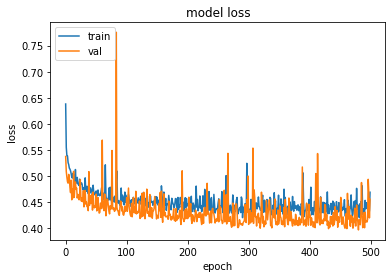

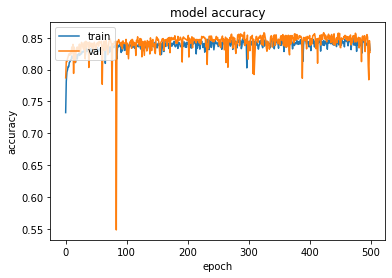

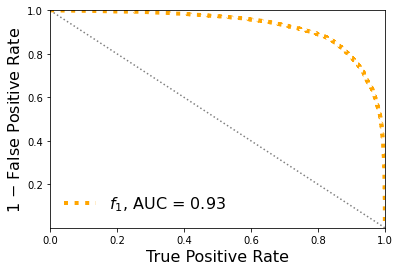

313/313 [==============================] - 2s 5ms/step - loss: 0.4751 - acc: 0.8298 - f1_m: 0.4253 - precision_m: 0.5002 - recall_m: 0.3717
Test ROC-AUC: 0.92691868
Test loss: 0.4751342833042145
Test accuracy: 0.829800009727478
Test f1: 0.42532381415367126
Test precision: 0.500228226184845
Test recall: 0.3717052638530731
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 15s 75ms/step - loss: 1.3713 - acc: 0.5389 - f1_m: 0.5176 - precision_m: 0.5403 - recall_m: 0.5327 - val_loss: 0.5806 - val_acc: 0.7750 - val_f1_m: 0.7758 - val_precision_m: 0.7668 - val_recall_m: 0.7877
Epoch 2/500
188/188 [==============================] - 13s 72ms/step - loss: 0.5925 - acc: 0.7670 - f1_m: 0.7716 - precision_m: 0.7498 - recall_m: 0.8002 - val_loss: 0.5338 - val_acc: 0.8013 - val_f1_m: 0.8180 - val_precision_m: 0.7489 - val_

Epoch 31/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4504 - acc: 0.8465 - f1_m: 0.8477 - precision_m: 0.8396 - recall_m: 0.8612 - val_loss: 0.4889 - val_acc: 0.8280 - val_f1_m: 0.8415 - val_precision_m: 0.7744 - val_recall_m: 0.9244
Epoch 32/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4744 - acc: 0.8368 - f1_m: 0.8392 - precision_m: 0.8318 - recall_m: 0.8551 - val_loss: 0.4416 - val_acc: 0.8453 - val_f1_m: 0.8445 - val_precision_m: 0.8425 - val_recall_m: 0.8491
Epoch 33/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4538 - acc: 0.8455 - f1_m: 0.8472 - precision_m: 0.8403 - recall_m: 0.8591 - val_loss: 0.4373 - val_acc: 0.8432 - val_f1_m: 0.8406 - val_precision_m: 0.8471 - val_recall_m: 0.8365
Epoch 34/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4435 - acc: 0.8496 - f1_m: 0.8490 - precision_m: 0.8454 - recall_m: 0.8572 - val_loss: 0.4472 - val_acc: 0.8440 - val_f1_m: 0.8531 - val_pre

188/188 [==============================] - 14s 73ms/step - loss: 0.4307 - acc: 0.8547 - f1_m: 0.8539 - precision_m: 0.8568 - recall_m: 0.8561 - val_loss: 0.4234 - val_acc: 0.8457 - val_f1_m: 0.8418 - val_precision_m: 0.8554 - val_recall_m: 0.8311
Epoch 94/500
188/188 [==============================] - 14s 75ms/step - loss: 0.4052 - acc: 0.8655 - f1_m: 0.8641 - precision_m: 0.8645 - recall_m: 0.8672 - val_loss: 0.4221 - val_acc: 0.8498 - val_f1_m: 0.8503 - val_precision_m: 0.8410 - val_recall_m: 0.8628
Epoch 95/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4153 - acc: 0.8566 - f1_m: 0.8541 - precision_m: 0.8549 - recall_m: 0.8590 - val_loss: 0.4172 - val_acc: 0.8517 - val_f1_m: 0.8486 - val_precision_m: 0.8591 - val_recall_m: 0.8407
Epoch 96/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4211 - acc: 0.8589 - f1_m: 0.8569 - precision_m: 0.8640 - recall_m: 0.8552 - val_loss: 0.4347 - val_acc: 0.8337 - val_f1_m: 0.8244 - val_precision_m: 0.8

188/188 [==============================] - 14s 72ms/step - loss: 0.4243 - acc: 0.8563 - f1_m: 0.8557 - precision_m: 0.8573 - recall_m: 0.8595 - val_loss: 0.4331 - val_acc: 0.8380 - val_f1_m: 0.8290 - val_precision_m: 0.8683 - val_recall_m: 0.7956
Epoch 156/500
188/188 [==============================] - 14s 72ms/step - loss: 0.7374 - acc: 0.7107 - f1_m: 0.6912 - precision_m: 0.7468 - recall_m: 0.6979 - val_loss: 0.4964 - val_acc: 0.8215 - val_f1_m: 0.8129 - val_precision_m: 0.8469 - val_recall_m: 0.7846
Epoch 157/500
188/188 [==============================] - 14s 72ms/step - loss: 0.5112 - acc: 0.8206 - f1_m: 0.8225 - precision_m: 0.8200 - recall_m: 0.8347 - val_loss: 0.4508 - val_acc: 0.8395 - val_f1_m: 0.8512 - val_precision_m: 0.7885 - val_recall_m: 0.9276
Epoch 158/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4781 - acc: 0.8215 - f1_m: 0.8232 - precision_m: 0.8171 - recall_m: 0.8398 - val_loss: 0.4527 - val_acc: 0.8277 - val_f1_m: 0.8135 - val_precision_m: 

188/188 [==============================] - 14s 74ms/step - loss: 0.4100 - acc: 0.8566 - f1_m: 0.8555 - precision_m: 0.8519 - recall_m: 0.8648 - val_loss: 0.4144 - val_acc: 0.8512 - val_f1_m: 0.8471 - val_precision_m: 0.8636 - val_recall_m: 0.8331
Epoch 218/500
188/188 [==============================] - 14s 74ms/step - loss: 0.4009 - acc: 0.8657 - f1_m: 0.8673 - precision_m: 0.8657 - recall_m: 0.8733 - val_loss: 0.4511 - val_acc: 0.8242 - val_f1_m: 0.8063 - val_precision_m: 0.8870 - val_recall_m: 0.7415
Epoch 219/500
188/188 [==============================] - 14s 73ms/step - loss: 0.4386 - acc: 0.8483 - f1_m: 0.8460 - precision_m: 0.8536 - recall_m: 0.8501 - val_loss: 0.4185 - val_acc: 0.8515 - val_f1_m: 0.8507 - val_precision_m: 0.8478 - val_recall_m: 0.8561
Epoch 220/500
188/188 [==============================] - 14s 74ms/step - loss: 0.4124 - acc: 0.8608 - f1_m: 0.8603 - precision_m: 0.8615 - recall_m: 0.8627 - val_loss: 0.4163 - val_acc: 0.8543 - val_f1_m: 0.8599 - val_precision_m: 

188/188 [==============================] - 14s 72ms/step - loss: 0.4211 - acc: 0.8552 - f1_m: 0.8546 - precision_m: 0.8556 - recall_m: 0.8589 - val_loss: 0.4111 - val_acc: 0.8555 - val_f1_m: 0.8573 - val_precision_m: 0.8379 - val_recall_m: 0.8799
Epoch 280/500
188/188 [==============================] - 14s 74ms/step - loss: 0.4058 - acc: 0.8631 - f1_m: 0.8641 - precision_m: 0.8597 - recall_m: 0.8723 - val_loss: 0.4148 - val_acc: 0.8433 - val_f1_m: 0.8376 - val_precision_m: 0.8620 - val_recall_m: 0.8172
Epoch 281/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4109 - acc: 0.8627 - f1_m: 0.8630 - precision_m: 0.8640 - recall_m: 0.8653 - val_loss: 0.4146 - val_acc: 0.8475 - val_f1_m: 0.8413 - val_precision_m: 0.8675 - val_recall_m: 0.8186
Epoch 282/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4092 - acc: 0.8617 - f1_m: 0.8637 - precision_m: 0.8588 - recall_m: 0.8731 - val_loss: 0.4103 - val_acc: 0.8522 - val_f1_m: 0.8493 - val_precision_m: 

188/188 [==============================] - 14s 72ms/step - loss: 0.4108 - acc: 0.8621 - f1_m: 0.8622 - precision_m: 0.8619 - recall_m: 0.8681 - val_loss: 0.4131 - val_acc: 0.8505 - val_f1_m: 0.8492 - val_precision_m: 0.8488 - val_recall_m: 0.8521
Epoch 342/500
188/188 [==============================] - 14s 73ms/step - loss: 0.3954 - acc: 0.8709 - f1_m: 0.8698 - precision_m: 0.8687 - recall_m: 0.8760 - val_loss: 0.4130 - val_acc: 0.8507 - val_f1_m: 0.8474 - val_precision_m: 0.8577 - val_recall_m: 0.8394
Epoch 343/500
188/188 [==============================] - 14s 73ms/step - loss: 0.4272 - acc: 0.8564 - f1_m: 0.8552 - precision_m: 0.8585 - recall_m: 0.8625 - val_loss: 0.4415 - val_acc: 0.8462 - val_f1_m: 0.8449 - val_precision_m: 0.8439 - val_recall_m: 0.8488
Epoch 344/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4416 - acc: 0.8514 - f1_m: 0.8513 - precision_m: 0.8434 - recall_m: 0.8651 - val_loss: 0.4100 - val_acc: 0.8527 - val_f1_m: 0.8487 - val_precision_m: 

188/188 [==============================] - 13s 72ms/step - loss: 0.4122 - acc: 0.8628 - f1_m: 0.8624 - precision_m: 0.8597 - recall_m: 0.8704 - val_loss: 0.4058 - val_acc: 0.8565 - val_f1_m: 0.8580 - val_precision_m: 0.8436 - val_recall_m: 0.8758
Epoch 404/500
188/188 [==============================] - 13s 72ms/step - loss: 0.3972 - acc: 0.8663 - f1_m: 0.8663 - precision_m: 0.8615 - recall_m: 0.8742 - val_loss: 0.4081 - val_acc: 0.8533 - val_f1_m: 0.8503 - val_precision_m: 0.8581 - val_recall_m: 0.8453
Epoch 405/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4006 - acc: 0.8634 - f1_m: 0.8651 - precision_m: 0.8635 - recall_m: 0.8715 - val_loss: 0.4203 - val_acc: 0.8455 - val_f1_m: 0.8400 - val_precision_m: 0.8656 - val_recall_m: 0.8181
Epoch 406/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3955 - acc: 0.8699 - f1_m: 0.8695 - precision_m: 0.8694 - recall_m: 0.8747 - val_loss: 0.4571 - val_acc: 0.8455 - val_f1_m: 0.8530 - val_precision_m: 

188/188 [==============================] - 13s 72ms/step - loss: 0.3997 - acc: 0.8678 - f1_m: 0.8688 - precision_m: 0.8606 - recall_m: 0.8809 - val_loss: 0.4197 - val_acc: 0.8480 - val_f1_m: 0.8469 - val_precision_m: 0.8479 - val_recall_m: 0.8482
Epoch 466/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4130 - acc: 0.8601 - f1_m: 0.8617 - precision_m: 0.8510 - recall_m: 0.8786 - val_loss: 0.4365 - val_acc: 0.8458 - val_f1_m: 0.8572 - val_precision_m: 0.7930 - val_recall_m: 0.9356
Epoch 467/500
188/188 [==============================] - 14s 72ms/step - loss: 0.3987 - acc: 0.8630 - f1_m: 0.8652 - precision_m: 0.8555 - recall_m: 0.8798 - val_loss: 0.4124 - val_acc: 0.8540 - val_f1_m: 0.8571 - val_precision_m: 0.8322 - val_recall_m: 0.8859
Epoch 468/500
188/188 [==============================] - 13s 72ms/step - loss: 0.4034 - acc: 0.8624 - f1_m: 0.8626 - precision_m: 0.8556 - recall_m: 0.8737 - val_loss: 0.4193 - val_acc: 0.8442 - val_f1_m: 0.8387 - val_precision_m: 

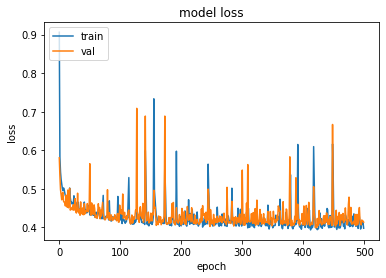

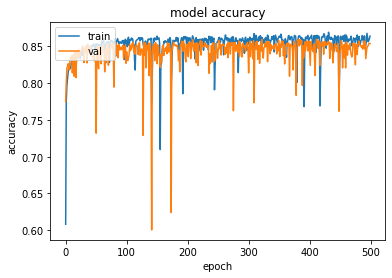

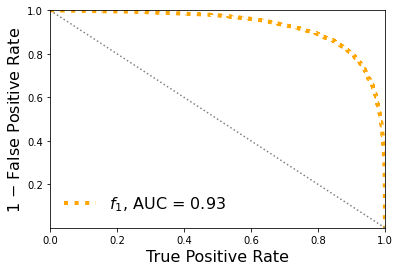

313/313 [==============================] - 1s 5ms/step - loss: 0.4169 - acc: 0.8516 - f1_m: 0.4712 - precision_m: 0.4997 - recall_m: 0.4467
Test ROC-AUC: 0.930112
Test loss: 0.4169326722621918
Test accuracy: 0.8515999913215637
Test f1: 0.4711909592151642
Test precision: 0.4997337758541107
Test recall: 0.4466853141784668
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 16s 155ms/step - loss: 0.9278 - acc: 0.5319 - f1_m: 0.4991 - precision_m: 0.5378 - recall_m: 0.4970 - val_loss: 0.6356 - val_acc: 0.7558 - val_f1_m: 0.7568 - val_precision_m: 0.7458 - val_recall_m: 0.7699
Epoch 2/500
94/94 [==============================] - 14s 147ms/step - loss: 0.6160 - acc: 0.7488 - f1_m: 0.7521 - precision_m: 0.7409 - recall_m: 0.7710 - val_loss: 0.5482 - val_acc: 0.7877 - val_f1_m: 0.7690 - val_precision_m: 0.8318 - val_rec

Epoch 31/500
94/94 [==============================] - 14s 147ms/step - loss: 0.4219 - acc: 0.8549 - f1_m: 0.8567 - precision_m: 0.8490 - recall_m: 0.8674 - val_loss: 0.4693 - val_acc: 0.8278 - val_f1_m: 0.8423 - val_precision_m: 0.7668 - val_recall_m: 0.9357
Epoch 32/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4455 - acc: 0.8436 - f1_m: 0.8451 - precision_m: 0.8306 - recall_m: 0.8662 - val_loss: 0.4340 - val_acc: 0.8455 - val_f1_m: 0.8446 - val_precision_m: 0.8342 - val_recall_m: 0.8568
Epoch 33/500
94/94 [==============================] - 15s 154ms/step - loss: 0.4296 - acc: 0.8522 - f1_m: 0.8556 - precision_m: 0.8466 - recall_m: 0.8675 - val_loss: 0.4564 - val_acc: 0.8295 - val_f1_m: 0.8177 - val_precision_m: 0.8701 - val_recall_m: 0.7730
Epoch 34/500
94/94 [==============================] - 14s 151ms/step - loss: 0.4316 - acc: 0.8512 - f1_m: 0.8537 - precision_m: 0.8472 - recall_m: 0.8654 - val_loss: 0.4412 - val_acc: 0.8392 - val_f1_m: 0.8307 - val_precisi

Epoch 63/500
94/94 [==============================] - 14s 147ms/step - loss: 0.4035 - acc: 0.8662 - f1_m: 0.8685 - precision_m: 0.8563 - recall_m: 0.8840 - val_loss: 0.4293 - val_acc: 0.8458 - val_f1_m: 0.8444 - val_precision_m: 0.8410 - val_recall_m: 0.8490
Epoch 64/500
94/94 [==============================] - 14s 146ms/step - loss: 0.3995 - acc: 0.8664 - f1_m: 0.8685 - precision_m: 0.8562 - recall_m: 0.8843 - val_loss: 0.4396 - val_acc: 0.8347 - val_f1_m: 0.8271 - val_precision_m: 0.8592 - val_recall_m: 0.7985
Epoch 65/500
94/94 [==============================] - 14s 146ms/step - loss: 0.4113 - acc: 0.8617 - f1_m: 0.8625 - precision_m: 0.8548 - recall_m: 0.8739 - val_loss: 0.4363 - val_acc: 0.8480 - val_f1_m: 0.8426 - val_precision_m: 0.8613 - val_recall_m: 0.8258
Epoch 66/500
94/94 [==============================] - 14s 147ms/step - loss: 0.4086 - acc: 0.8640 - f1_m: 0.8663 - precision_m: 0.8540 - recall_m: 0.8822 - val_loss: 0.4338 - val_acc: 0.8480 - val_f1_m: 0.8449 - val_precisi

Epoch 95/500
94/94 [==============================] - 14s 148ms/step - loss: 0.3963 - acc: 0.8662 - f1_m: 0.8693 - precision_m: 0.8496 - recall_m: 0.8921 - val_loss: 0.4275 - val_acc: 0.8472 - val_f1_m: 0.8420 - val_precision_m: 0.8583 - val_recall_m: 0.8281
Epoch 96/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4145 - acc: 0.8573 - f1_m: 0.8597 - precision_m: 0.8478 - recall_m: 0.8757 - val_loss: 0.4539 - val_acc: 0.8333 - val_f1_m: 0.8217 - val_precision_m: 0.8681 - val_recall_m: 0.7814
Epoch 97/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4059 - acc: 0.8646 - f1_m: 0.8664 - precision_m: 0.8536 - recall_m: 0.8829 - val_loss: 0.4386 - val_acc: 0.8467 - val_f1_m: 0.8553 - val_precision_m: 0.7983 - val_recall_m: 0.9221
Epoch 98/500
94/94 [==============================] - 14s 149ms/step - loss: 0.4152 - acc: 0.8552 - f1_m: 0.8588 - precision_m: 0.8429 - recall_m: 0.8797 - val_loss: 0.4440 - val_acc: 0.8402 - val_f1_m: 0.8525 - val_precisi

94/94 [==============================] - 14s 148ms/step - loss: 0.3829 - acc: 0.8755 - f1_m: 0.8768 - precision_m: 0.8640 - recall_m: 0.8922 - val_loss: 0.4313 - val_acc: 0.8517 - val_f1_m: 0.8531 - val_precision_m: 0.8323 - val_recall_m: 0.8764
Epoch 158/500
94/94 [==============================] - 14s 148ms/step - loss: 0.4272 - acc: 0.8516 - f1_m: 0.8520 - precision_m: 0.8441 - recall_m: 0.8709 - val_loss: 0.7962 - val_acc: 0.6545 - val_f1_m: 0.7394 - val_precision_m: 0.5890 - val_recall_m: 0.9953
Epoch 159/500
94/94 [==============================] - 14s 149ms/step - loss: 0.6891 - acc: 0.7261 - f1_m: 0.7320 - precision_m: 0.7300 - recall_m: 0.7588 - val_loss: 0.5417 - val_acc: 0.8137 - val_f1_m: 0.8320 - val_precision_m: 0.7489 - val_recall_m: 0.9376
Epoch 160/500
94/94 [==============================] - 14s 148ms/step - loss: 0.5371 - acc: 0.8070 - f1_m: 0.8142 - precision_m: 0.7965 - recall_m: 0.8487 - val_loss: 0.4496 - val_acc: 0.8475 - val_f1_m: 0.8491 - val_precision_m: 0.82

94/94 [==============================] - 14s 147ms/step - loss: 0.3724 - acc: 0.8804 - f1_m: 0.8822 - precision_m: 0.8696 - recall_m: 0.8974 - val_loss: 0.4241 - val_acc: 0.8512 - val_f1_m: 0.8492 - val_precision_m: 0.8409 - val_recall_m: 0.8588
Epoch 220/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3714 - acc: 0.8829 - f1_m: 0.8839 - precision_m: 0.8671 - recall_m: 0.9030 - val_loss: 0.4394 - val_acc: 0.8485 - val_f1_m: 0.8440 - val_precision_m: 0.8525 - val_recall_m: 0.8369
Epoch 221/500
94/94 [==============================] - 14s 149ms/step - loss: 0.5767 - acc: 0.7813 - f1_m: 0.7778 - precision_m: 0.7839 - recall_m: 0.8000 - val_loss: 0.5603 - val_acc: 0.7837 - val_f1_m: 0.8130 - val_precision_m: 0.7095 - val_recall_m: 0.9536
Epoch 222/500
94/94 [==============================] - 14s 149ms/step - loss: 0.5693 - acc: 0.8020 - f1_m: 0.8122 - precision_m: 0.7805 - recall_m: 0.8565 - val_loss: 0.5355 - val_acc: 0.8090 - val_f1_m: 0.7951 - val_precision_m: 0.84

94/94 [==============================] - 14s 149ms/step - loss: 0.3813 - acc: 0.8796 - f1_m: 0.8814 - precision_m: 0.8653 - recall_m: 0.9005 - val_loss: 0.5317 - val_acc: 0.8117 - val_f1_m: 0.7868 - val_precision_m: 0.8929 - val_recall_m: 0.7041
Epoch 282/500
94/94 [==============================] - 14s 148ms/step - loss: 0.7308 - acc: 0.7361 - f1_m: 0.7344 - precision_m: 0.7415 - recall_m: 0.7621 - val_loss: 0.9264 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 283/500
94/94 [==============================] - 14s 147ms/step - loss: 0.9543 - acc: 0.5218 - f1_m: 0.5156 - precision_m: 0.5276 - recall_m: 0.5395 - val_loss: 0.8303 - val_acc: 0.5208 - val_f1_m: 0.0700 - val_precision_m: 0.9861 - val_recall_m: 0.0365
Epoch 284/500
94/94 [==============================] - 14s 149ms/step - loss: 0.8673 - acc: 0.5559 - f1_m: 0.5712 - precision_m: 0.5610 - recall_m: 0.5975 - val_loss: 0.7604 - val_acc: 0.7210 - val_f1_m: 0.6487 - val_precision_m: 0.86

94/94 [==============================] - 13s 137ms/step - loss: 0.3767 - acc: 0.8697 - f1_m: 0.8705 - precision_m: 0.8632 - recall_m: 0.8801 - val_loss: 0.3938 - val_acc: 0.8582 - val_f1_m: 0.8610 - val_precision_m: 0.8350 - val_recall_m: 0.8899
Epoch 344/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3933 - acc: 0.8625 - f1_m: 0.8664 - precision_m: 0.8513 - recall_m: 0.8869 - val_loss: 0.4070 - val_acc: 0.8483 - val_f1_m: 0.8546 - val_precision_m: 0.8072 - val_recall_m: 0.9092
Epoch 345/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3950 - acc: 0.8635 - f1_m: 0.8649 - precision_m: 0.8507 - recall_m: 0.8836 - val_loss: 0.4081 - val_acc: 0.8492 - val_f1_m: 0.8415 - val_precision_m: 0.8737 - val_recall_m: 0.8129
Epoch 346/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3702 - acc: 0.8769 - f1_m: 0.8768 - precision_m: 0.8680 - recall_m: 0.8882 - val_loss: 0.4387 - val_acc: 0.8405 - val_f1_m: 0.8540 - val_precision_m: 0.77

94/94 [==============================] - 13s 139ms/step - loss: 0.3883 - acc: 0.8723 - f1_m: 0.8749 - precision_m: 0.8629 - recall_m: 0.8909 - val_loss: 0.4317 - val_acc: 0.8458 - val_f1_m: 0.8408 - val_precision_m: 0.8599 - val_recall_m: 0.8239
Epoch 406/500
94/94 [==============================] - 13s 142ms/step - loss: 0.3751 - acc: 0.8794 - f1_m: 0.8800 - precision_m: 0.8729 - recall_m: 0.8892 - val_loss: 0.4232 - val_acc: 0.8520 - val_f1_m: 0.8505 - val_precision_m: 0.8498 - val_recall_m: 0.8526
Epoch 407/500
94/94 [==============================] - 13s 141ms/step - loss: 0.3688 - acc: 0.8828 - f1_m: 0.8829 - precision_m: 0.8740 - recall_m: 0.8937 - val_loss: 0.4333 - val_acc: 0.8420 - val_f1_m: 0.8373 - val_precision_m: 0.8533 - val_recall_m: 0.8230
Epoch 408/500
94/94 [==============================] - 13s 142ms/step - loss: 0.7507 - acc: 0.6840 - f1_m: 0.6639 - precision_m: 0.7082 - recall_m: 0.6887 - val_loss: 0.9285 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

94/94 [==============================] - 14s 145ms/step - loss: 0.3899 - acc: 0.8679 - f1_m: 0.8686 - precision_m: 0.8634 - recall_m: 0.8770 - val_loss: 0.4158 - val_acc: 0.8507 - val_f1_m: 0.8455 - val_precision_m: 0.8578 - val_recall_m: 0.8351
Epoch 468/500
94/94 [==============================] - 14s 145ms/step - loss: 0.3825 - acc: 0.8735 - f1_m: 0.8741 - precision_m: 0.8671 - recall_m: 0.8833 - val_loss: 0.4129 - val_acc: 0.8530 - val_f1_m: 0.8538 - val_precision_m: 0.8422 - val_recall_m: 0.8674
Epoch 469/500
94/94 [==============================] - 13s 141ms/step - loss: 0.3828 - acc: 0.8730 - f1_m: 0.8721 - precision_m: 0.8644 - recall_m: 0.8824 - val_loss: 0.4146 - val_acc: 0.8453 - val_f1_m: 0.8418 - val_precision_m: 0.8538 - val_recall_m: 0.8314
Epoch 470/500
94/94 [==============================] - 13s 143ms/step - loss: 0.3794 - acc: 0.8757 - f1_m: 0.8763 - precision_m: 0.8720 - recall_m: 0.8831 - val_loss: 0.4142 - val_acc: 0.8518 - val_f1_m: 0.8460 - val_precision_m: 0.85

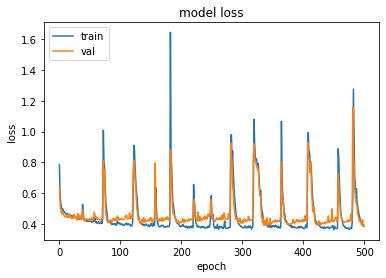

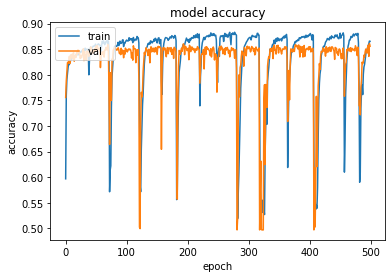

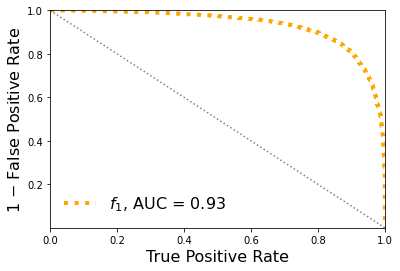

313/313 [==============================] - 1s 4ms/step - loss: 0.3978 - acc: 0.8564 - f1_m: 0.4599 - precision_m: 0.5002 - recall_m: 0.4265
Test ROC-AUC: 0.9313334600000001
Test loss: 0.3977702558040619
Test accuracy: 0.8564000129699707
Test f1: 0.4598681628704071
Test precision: 0.5001775026321411
Test recall: 0.4265175759792328
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 15s 37ms/step - loss: 1.1393 - acc: 0.5107 - f1_m: 0.3232 - precision_m: 0.5211 - recall_m: 0.2653 - val_loss: 0.7166 - val_acc: 0.6915 - val_f1_m: 0.5885 - val_precision_m: 0.8591 - val_recall_m: 0.4524
Epoch 2/500
375/375 [==============================] - 14s 36ms/step - loss: 0.6876 - acc: 0.6842 - f1_m: 0.6647 - precision_m: 0.7026 - recall_m: 0.6517 - val_loss: 0.5888 - val_acc: 0.7770 - val_f1_m: 0.7629 - val_precision_m: 0.8

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5096 - acc: 0.8234 - f1_m: 0.8255 - precision_m: 0.8174 - recall_m: 0.8449 - val_loss: 0.4419 - val_acc: 0.8453 - val_f1_m: 0.8474 - val_precision_m: 0.8257 - val_recall_m: 0.8748
Epoch 32/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4567 - acc: 0.8383 - f1_m: 0.8390 - precision_m: 0.8312 - recall_m: 0.8544 - val_loss: 0.4274 - val_acc: 0.8480 - val_f1_m: 0.8448 - val_precision_m: 0.8516 - val_recall_m: 0.8433
Epoch 33/500
375/375 [==============================] - 13s 36ms/step - loss: 0.4475 - acc: 0.8379 - f1_m: 0.8376 - precision_m: 0.8298 - recall_m: 0.8518 - val_loss: 0.4161 - val_acc: 0.8500 - val_f1_m: 0.8523 - val_precision_m: 0.8300 - val_recall_m: 0.8812
Epoch 34/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4405 - acc: 0.8393 - f1_m: 0.8379 - precision_m: 0.8343 - recall_m: 0.8490 - val_loss: 0.4176 - val_acc: 0.8510 - val_f1_m: 0.8532 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4244 - acc: 0.8500 - f1_m: 0.8489 - precision_m: 0.8458 - recall_m: 0.8583 - val_loss: 0.4139 - val_acc: 0.8450 - val_f1_m: 0.8420 - val_precision_m: 0.8486 - val_recall_m: 0.8402
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4138 - acc: 0.8514 - f1_m: 0.8484 - precision_m: 0.8503 - recall_m: 0.8524 - val_loss: 0.4134 - val_acc: 0.8515 - val_f1_m: 0.8564 - val_precision_m: 0.8202 - val_recall_m: 0.9007
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4164 - acc: 0.8548 - f1_m: 0.8530 - precision_m: 0.8497 - recall_m: 0.8625 - val_loss: 0.4461 - val_acc: 0.8098 - val_f1_m: 0.7826 - val_precision_m: 0.8993 - val_recall_m: 0.6986
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4237 - acc: 0.8451 - f1_m: 0.8424 - precision_m: 0.8531 - recall_m: 0.8385 - val_loss: 0.5098 - val_acc: 0.7975 - val_f1_m: 0.8246 - val_precision_m: 0.7

375/375 [==============================] - 13s 34ms/step - loss: 0.4578 - acc: 0.8443 - f1_m: 0.8409 - precision_m: 0.8512 - recall_m: 0.8388 - val_loss: 0.4331 - val_acc: 0.8457 - val_f1_m: 0.8409 - val_precision_m: 0.8598 - val_recall_m: 0.8276
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4582 - acc: 0.8412 - f1_m: 0.8376 - precision_m: 0.8438 - recall_m: 0.8406 - val_loss: 0.4136 - val_acc: 0.8483 - val_f1_m: 0.8464 - val_precision_m: 0.8490 - val_recall_m: 0.8484
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4186 - acc: 0.8562 - f1_m: 0.8543 - precision_m: 0.8603 - recall_m: 0.8548 - val_loss: 0.4111 - val_acc: 0.8488 - val_f1_m: 0.8466 - val_precision_m: 0.8515 - val_recall_m: 0.8462
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4082 - acc: 0.8580 - f1_m: 0.8568 - precision_m: 0.8578 - recall_m: 0.8606 - val_loss: 0.4389 - val_acc: 0.8475 - val_f1_m: 0.8526 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4156 - acc: 0.8558 - f1_m: 0.8545 - precision_m: 0.8563 - recall_m: 0.8578 - val_loss: 0.4189 - val_acc: 0.8485 - val_f1_m: 0.8450 - val_precision_m: 0.8533 - val_recall_m: 0.8415
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4066 - acc: 0.8593 - f1_m: 0.8578 - precision_m: 0.8585 - recall_m: 0.8627 - val_loss: 0.4239 - val_acc: 0.8380 - val_f1_m: 0.8324 - val_precision_m: 0.8510 - val_recall_m: 0.8192
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4116 - acc: 0.8567 - f1_m: 0.8536 - precision_m: 0.8589 - recall_m: 0.8543 - val_loss: 0.4156 - val_acc: 0.8435 - val_f1_m: 0.8375 - val_precision_m: 0.8629 - val_recall_m: 0.8187
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4307 - acc: 0.8474 - f1_m: 0.8453 - precision_m: 0.8547 - recall_m: 0.8454 - val_loss: 0.4265 - val_acc: 0.8403 - val_f1_m: 0.8454 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4686 - acc: 0.8481 - f1_m: 0.8459 - precision_m: 0.8528 - recall_m: 0.8458 - val_loss: 0.4283 - val_acc: 0.8478 - val_f1_m: 0.8503 - val_precision_m: 0.8275 - val_recall_m: 0.8792
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4227 - acc: 0.8554 - f1_m: 0.8530 - precision_m: 0.8569 - recall_m: 0.8550 - val_loss: 0.4249 - val_acc: 0.8465 - val_f1_m: 0.8438 - val_precision_m: 0.8497 - val_recall_m: 0.8426
Epoch 281/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4242 - acc: 0.8554 - f1_m: 0.8535 - precision_m: 0.8560 - recall_m: 0.8563 - val_loss: 0.4209 - val_acc: 0.8512 - val_f1_m: 0.8556 - val_precision_m: 0.8211 - val_recall_m: 0.8977
Epoch 282/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4188 - acc: 0.8542 - f1_m: 0.8534 - precision_m: 0.8486 - recall_m: 0.8645 - val_loss: 0.4185 - val_acc: 0.8498 - val_f1_m: 0.8525 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4588 - acc: 0.8421 - f1_m: 0.8398 - precision_m: 0.8458 - recall_m: 0.8410 - val_loss: 0.4668 - val_acc: 0.8250 - val_f1_m: 0.8248 - val_precision_m: 0.8172 - val_recall_m: 0.8380
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4415 - acc: 0.8395 - f1_m: 0.8377 - precision_m: 0.8409 - recall_m: 0.8417 - val_loss: 0.4636 - val_acc: 0.8232 - val_f1_m: 0.8241 - val_precision_m: 0.8070 - val_recall_m: 0.8466
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4365 - acc: 0.8413 - f1_m: 0.8385 - precision_m: 0.8432 - recall_m: 0.8409 - val_loss: 0.4615 - val_acc: 0.8248 - val_f1_m: 0.8153 - val_precision_m: 0.8503 - val_recall_m: 0.7877
Epoch 344/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4320 - acc: 0.8447 - f1_m: 0.8425 - precision_m: 0.8488 - recall_m: 0.8430 - val_loss: 0.4606 - val_acc: 0.8295 - val_f1_m: 0.8311 - val_precision_m: 

375/375 [==============================] - 13s 35ms/step - loss: 0.4301 - acc: 0.8542 - f1_m: 0.8527 - precision_m: 0.8569 - recall_m: 0.8553 - val_loss: 0.4763 - val_acc: 0.8238 - val_f1_m: 0.8237 - val_precision_m: 0.8133 - val_recall_m: 0.8398
Epoch 404/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4392 - acc: 0.8511 - f1_m: 0.8484 - precision_m: 0.8546 - recall_m: 0.8475 - val_loss: 0.5065 - val_acc: 0.7857 - val_f1_m: 0.7528 - val_precision_m: 0.8668 - val_recall_m: 0.6714
Epoch 405/500
375/375 [==============================] - 14s 36ms/step - loss: 0.4648 - acc: 0.8369 - f1_m: 0.8307 - precision_m: 0.8426 - recall_m: 0.8267 - val_loss: 0.4609 - val_acc: 0.8243 - val_f1_m: 0.8252 - val_precision_m: 0.8130 - val_recall_m: 0.8429
Epoch 406/500
375/375 [==============================] - 14s 38ms/step - loss: 0.4287 - acc: 0.8465 - f1_m: 0.8438 - precision_m: 0.8533 - recall_m: 0.8398 - val_loss: 0.4572 - val_acc: 0.8257 - val_f1_m: 0.8207 - val_precision_m: 

375/375 [==============================] - 13s 35ms/step - loss: 0.4421 - acc: 0.8517 - f1_m: 0.8480 - precision_m: 0.8591 - recall_m: 0.8440 - val_loss: 0.4921 - val_acc: 0.8315 - val_f1_m: 0.8331 - val_precision_m: 0.8154 - val_recall_m: 0.8567
Epoch 466/500
375/375 [==============================] - 13s 36ms/step - loss: 0.4307 - acc: 0.8549 - f1_m: 0.8501 - precision_m: 0.8652 - recall_m: 0.8422 - val_loss: 0.4778 - val_acc: 0.8303 - val_f1_m: 0.8339 - val_precision_m: 0.8064 - val_recall_m: 0.8690
Epoch 467/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4546 - acc: 0.8501 - f1_m: 0.8483 - precision_m: 0.8573 - recall_m: 0.8454 - val_loss: 0.4887 - val_acc: 0.8335 - val_f1_m: 0.8313 - val_precision_m: 0.8323 - val_recall_m: 0.8368
Epoch 468/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4489 - acc: 0.8495 - f1_m: 0.8463 - precision_m: 0.8536 - recall_m: 0.8448 - val_loss: 0.4845 - val_acc: 0.8180 - val_f1_m: 0.8047 - val_precision_m: 

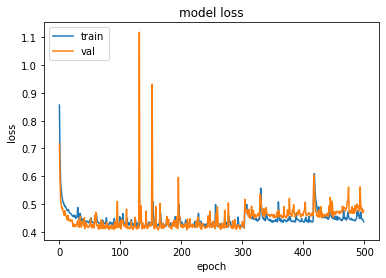

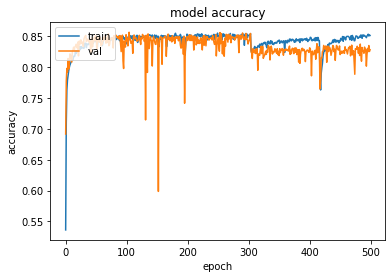

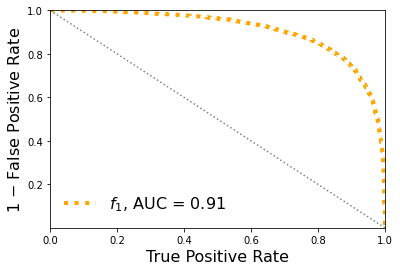

313/313 [==============================] - 1s 5ms/step - loss: 0.4796 - acc: 0.8266 - f1_m: 0.4472 - precision_m: 0.5001 - recall_m: 0.4059
Test ROC-AUC: 0.9082720999999998
Test loss: 0.4796092212200165
Test accuracy: 0.8266000151634216
Test f1: 0.44720688462257385
Test precision: 0.5001451969146729
Test recall: 0.4058506488800049
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 15s 76ms/step - loss: 0.7950 - acc: 0.4974 - f1_m: 0.5564 - precision_m: 0.4969 - recall_m: 0.7441 - val_loss: 0.7122 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 2/500
188/188 [==============================] - 14s 72ms/step - loss: 0.7098 - acc: 0.5001 - f1_m: 0.6052 - precision_m: 0.5011 - recall_m: 0.8382 - val_loss: 0.7051 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0

Epoch 31/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4634 - acc: 0.7969 - f1_m: 0.8019 - precision_m: 0.7756 - recall_m: 0.8336 - val_loss: 0.4798 - val_acc: 0.7970 - val_f1_m: 0.8246 - val_precision_m: 0.7213 - val_recall_m: 0.9657
Epoch 32/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4686 - acc: 0.7942 - f1_m: 0.8035 - precision_m: 0.7682 - recall_m: 0.8470 - val_loss: 0.4775 - val_acc: 0.8275 - val_f1_m: 0.8401 - val_precision_m: 0.7788 - val_recall_m: 0.9149
Epoch 33/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4795 - acc: 0.7986 - f1_m: 0.8083 - precision_m: 0.7742 - recall_m: 0.8484 - val_loss: 0.4180 - val_acc: 0.8345 - val_f1_m: 0.8346 - val_precision_m: 0.8268 - val_recall_m: 0.8453
Epoch 34/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4620 - acc: 0.7994 - f1_m: 0.8055 - precision_m: 0.7780 - recall_m: 0.8395 - val_loss: 0.4131 - val_acc: 0.8353 - val_f1_m: 0.8449 - val_pre

188/188 [==============================] - 13s 71ms/step - loss: 0.4300 - acc: 0.8266 - f1_m: 0.8292 - precision_m: 0.8243 - recall_m: 0.8383 - val_loss: 0.4085 - val_acc: 0.8435 - val_f1_m: 0.8518 - val_precision_m: 0.8023 - val_recall_m: 0.9104
Epoch 94/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4279 - acc: 0.8258 - f1_m: 0.8260 - precision_m: 0.8244 - recall_m: 0.8317 - val_loss: 0.4122 - val_acc: 0.8443 - val_f1_m: 0.8537 - val_precision_m: 0.7980 - val_recall_m: 0.9201
Epoch 95/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4283 - acc: 0.8291 - f1_m: 0.8289 - precision_m: 0.8222 - recall_m: 0.8402 - val_loss: 0.4197 - val_acc: 0.8428 - val_f1_m: 0.8506 - val_precision_m: 0.8045 - val_recall_m: 0.9048
Epoch 96/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4255 - acc: 0.8289 - f1_m: 0.8286 - precision_m: 0.8220 - recall_m: 0.8378 - val_loss: 0.4198 - val_acc: 0.8413 - val_f1_m: 0.8366 - val_precision_m: 0.8

188/188 [==============================] - 13s 71ms/step - loss: 0.4254 - acc: 0.8354 - f1_m: 0.8332 - precision_m: 0.8363 - recall_m: 0.8333 - val_loss: 0.3914 - val_acc: 0.8497 - val_f1_m: 0.8519 - val_precision_m: 0.8331 - val_recall_m: 0.8736
Epoch 156/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4252 - acc: 0.8332 - f1_m: 0.8282 - precision_m: 0.8337 - recall_m: 0.8262 - val_loss: 0.3908 - val_acc: 0.8438 - val_f1_m: 0.8381 - val_precision_m: 0.8642 - val_recall_m: 0.8164
Epoch 157/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4482 - acc: 0.8257 - f1_m: 0.8284 - precision_m: 0.8287 - recall_m: 0.8367 - val_loss: 0.4094 - val_acc: 0.8390 - val_f1_m: 0.8322 - val_precision_m: 0.8608 - val_recall_m: 0.8080
Epoch 158/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4366 - acc: 0.8318 - f1_m: 0.8307 - precision_m: 0.8286 - recall_m: 0.8366 - val_loss: 0.3948 - val_acc: 0.8462 - val_f1_m: 0.8440 - val_precision_m: 

188/188 [==============================] - 13s 70ms/step - loss: 0.4126 - acc: 0.8391 - f1_m: 0.8411 - precision_m: 0.8278 - recall_m: 0.8610 - val_loss: 0.3945 - val_acc: 0.8480 - val_f1_m: 0.8541 - val_precision_m: 0.8140 - val_recall_m: 0.9007
Epoch 218/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4108 - acc: 0.8386 - f1_m: 0.8386 - precision_m: 0.8344 - recall_m: 0.8471 - val_loss: 0.3912 - val_acc: 0.8358 - val_f1_m: 0.8254 - val_precision_m: 0.8724 - val_recall_m: 0.7855
Epoch 219/500
188/188 [==============================] - 13s 70ms/step - loss: 0.4060 - acc: 0.8451 - f1_m: 0.8479 - precision_m: 0.8383 - recall_m: 0.8628 - val_loss: 0.3977 - val_acc: 0.8390 - val_f1_m: 0.8288 - val_precision_m: 0.8782 - val_recall_m: 0.7873
Epoch 220/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4176 - acc: 0.8398 - f1_m: 0.8418 - precision_m: 0.8352 - recall_m: 0.8516 - val_loss: 0.3971 - val_acc: 0.8473 - val_f1_m: 0.8559 - val_precision_m: 

188/188 [==============================] - 13s 71ms/step - loss: 0.4017 - acc: 0.8403 - f1_m: 0.8434 - precision_m: 0.8300 - recall_m: 0.8620 - val_loss: 0.3911 - val_acc: 0.8410 - val_f1_m: 0.8346 - val_precision_m: 0.8606 - val_recall_m: 0.8124
Epoch 280/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4172 - acc: 0.8378 - f1_m: 0.8406 - precision_m: 0.8235 - recall_m: 0.8649 - val_loss: 0.3914 - val_acc: 0.8448 - val_f1_m: 0.8465 - val_precision_m: 0.8291 - val_recall_m: 0.8671
Epoch 281/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4068 - acc: 0.8411 - f1_m: 0.8427 - precision_m: 0.8283 - recall_m: 0.8610 - val_loss: 0.3853 - val_acc: 0.8438 - val_f1_m: 0.8404 - val_precision_m: 0.8512 - val_recall_m: 0.8318
Epoch 282/500
188/188 [==============================] - 13s 71ms/step - loss: 0.3992 - acc: 0.8445 - f1_m: 0.8474 - precision_m: 0.8333 - recall_m: 0.8655 - val_loss: 0.3916 - val_acc: 0.8410 - val_f1_m: 0.8451 - val_precision_m: 

188/188 [==============================] - 13s 71ms/step - loss: 0.4139 - acc: 0.8386 - f1_m: 0.8401 - precision_m: 0.8255 - recall_m: 0.8588 - val_loss: 0.3941 - val_acc: 0.8507 - val_f1_m: 0.8584 - val_precision_m: 0.8109 - val_recall_m: 0.9142
Epoch 342/500
188/188 [==============================] - 13s 70ms/step - loss: 0.4094 - acc: 0.8409 - f1_m: 0.8451 - precision_m: 0.8234 - recall_m: 0.8716 - val_loss: 0.3812 - val_acc: 0.8512 - val_f1_m: 0.8508 - val_precision_m: 0.8452 - val_recall_m: 0.8585
Epoch 343/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4080 - acc: 0.8439 - f1_m: 0.8476 - precision_m: 0.8277 - recall_m: 0.8716 - val_loss: 0.3887 - val_acc: 0.8500 - val_f1_m: 0.8569 - val_precision_m: 0.8122 - val_recall_m: 0.9093
Epoch 344/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4131 - acc: 0.8397 - f1_m: 0.8449 - precision_m: 0.8204 - recall_m: 0.8752 - val_loss: 0.3874 - val_acc: 0.8522 - val_f1_m: 0.8506 - val_precision_m: 

188/188 [==============================] - 13s 71ms/step - loss: 0.4124 - acc: 0.8427 - f1_m: 0.8432 - precision_m: 0.8266 - recall_m: 0.8651 - val_loss: 0.4193 - val_acc: 0.8487 - val_f1_m: 0.8456 - val_precision_m: 0.8559 - val_recall_m: 0.8386
Epoch 404/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4248 - acc: 0.8456 - f1_m: 0.8467 - precision_m: 0.8321 - recall_m: 0.8650 - val_loss: 0.3935 - val_acc: 0.8458 - val_f1_m: 0.8414 - val_precision_m: 0.8590 - val_recall_m: 0.8272
Epoch 405/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4150 - acc: 0.8443 - f1_m: 0.8461 - precision_m: 0.8325 - recall_m: 0.8629 - val_loss: 0.3878 - val_acc: 0.8448 - val_f1_m: 0.8390 - val_precision_m: 0.8664 - val_recall_m: 0.8159
Epoch 406/500
188/188 [==============================] - 13s 71ms/step - loss: 0.4048 - acc: 0.8468 - f1_m: 0.8488 - precision_m: 0.8376 - recall_m: 0.8633 - val_loss: 0.3837 - val_acc: 0.8473 - val_f1_m: 0.8450 - val_precision_m: 

188/188 [==============================] - 13s 72ms/step - loss: 0.3994 - acc: 0.8471 - f1_m: 0.8483 - precision_m: 0.8391 - recall_m: 0.8624 - val_loss: 0.3857 - val_acc: 0.8463 - val_f1_m: 0.8451 - val_precision_m: 0.8454 - val_recall_m: 0.8472
Epoch 466/500
188/188 [==============================] - 14s 72ms/step - loss: 0.4089 - acc: 0.8405 - f1_m: 0.8406 - precision_m: 0.8322 - recall_m: 0.8527 - val_loss: 0.3798 - val_acc: 0.8477 - val_f1_m: 0.8458 - val_precision_m: 0.8498 - val_recall_m: 0.8447
Epoch 467/500
188/188 [==============================] - 14s 73ms/step - loss: 0.3983 - acc: 0.8453 - f1_m: 0.8472 - precision_m: 0.8379 - recall_m: 0.8592 - val_loss: 0.3870 - val_acc: 0.8417 - val_f1_m: 0.8328 - val_precision_m: 0.8735 - val_recall_m: 0.7988
Epoch 468/500
188/188 [==============================] - 13s 70ms/step - loss: 0.4028 - acc: 0.8442 - f1_m: 0.8446 - precision_m: 0.8402 - recall_m: 0.8530 - val_loss: 0.3910 - val_acc: 0.8508 - val_f1_m: 0.8552 - val_precision_m: 

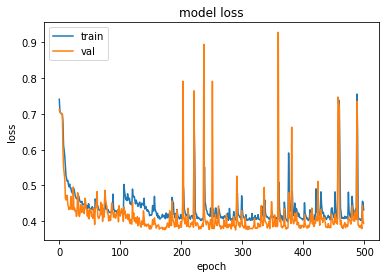

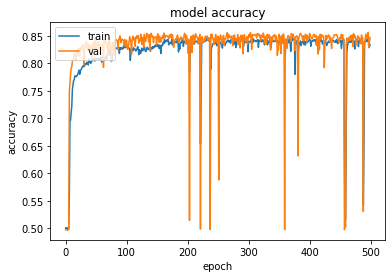

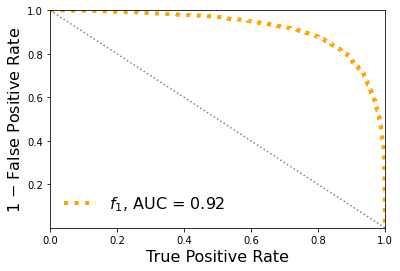

313/313 [==============================] - 1s 5ms/step - loss: 0.4070 - acc: 0.8416 - f1_m: 0.4510 - precision_m: 0.5000 - recall_m: 0.4121
Test ROC-AUC: 0.92064952
Test loss: 0.40702053904533386
Test accuracy: 0.8416000008583069
Test f1: 0.45097658038139343
Test precision: 0.5
Test recall: 0.4121405780315399
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 16s 159ms/step - loss: 0.8649 - acc: 0.5126 - f1_m: 0.5128 - precision_m: 0.5086 - recall_m: 0.5666 - val_loss: 0.7607 - val_acc: 0.6262 - val_f1_m: 0.7225 - val_precision_m: 0.5704 - val_recall_m: 0.9873
Epoch 2/500
94/94 [==============================] - 14s 150ms/step - loss: 0.7169 - acc: 0.6203 - f1_m: 0.6381 - precision_m: 0.6066 - recall_m: 0.6875 - val_loss: 0.6006 - val_acc: 0.7553 - val_f1_m: 0.7800 - val_precision_m: 0.7004 - val_recall_m: 0.

Epoch 31/500
94/94 [==============================] - 13s 140ms/step - loss: 0.4402 - acc: 0.8437 - f1_m: 0.8461 - precision_m: 0.8262 - recall_m: 0.8716 - val_loss: 0.4488 - val_acc: 0.8372 - val_f1_m: 0.8306 - val_precision_m: 0.8535 - val_recall_m: 0.8108
Epoch 32/500
94/94 [==============================] - 13s 138ms/step - loss: 0.4363 - acc: 0.8438 - f1_m: 0.8471 - precision_m: 0.8302 - recall_m: 0.8678 - val_loss: 0.4582 - val_acc: 0.8210 - val_f1_m: 0.8039 - val_precision_m: 0.8742 - val_recall_m: 0.7452
Epoch 33/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4327 - acc: 0.8461 - f1_m: 0.8495 - precision_m: 0.8281 - recall_m: 0.8755 - val_loss: 0.4171 - val_acc: 0.8478 - val_f1_m: 0.8469 - val_precision_m: 0.8406 - val_recall_m: 0.8547
Epoch 34/500
94/94 [==============================] - 13s 138ms/step - loss: 0.4218 - acc: 0.8531 - f1_m: 0.8564 - precision_m: 0.8365 - recall_m: 0.8798 - val_loss: 0.4398 - val_acc: 0.8380 - val_f1_m: 0.8511 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4022 - acc: 0.8624 - f1_m: 0.8653 - precision_m: 0.8447 - recall_m: 0.8896 - val_loss: 0.4172 - val_acc: 0.8460 - val_f1_m: 0.8445 - val_precision_m: 0.8432 - val_recall_m: 0.8476
Epoch 64/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3894 - acc: 0.8697 - f1_m: 0.8732 - precision_m: 0.8505 - recall_m: 0.8994 - val_loss: 0.4317 - val_acc: 0.8407 - val_f1_m: 0.8345 - val_precision_m: 0.8562 - val_recall_m: 0.8161
Epoch 65/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3925 - acc: 0.8664 - f1_m: 0.8702 - precision_m: 0.8449 - recall_m: 0.8993 - val_loss: 0.4253 - val_acc: 0.8438 - val_f1_m: 0.8527 - val_precision_m: 0.7987 - val_recall_m: 0.9162
Epoch 66/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3902 - acc: 0.8669 - f1_m: 0.8695 - precision_m: 0.8449 - recall_m: 0.8971 - val_loss: 0.4125 - val_acc: 0.8507 - val_f1_m: 0.8541 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3820 - acc: 0.8735 - f1_m: 0.8762 - precision_m: 0.8531 - recall_m: 0.9032 - val_loss: 0.4218 - val_acc: 0.8497 - val_f1_m: 0.8495 - val_precision_m: 0.8422 - val_recall_m: 0.8591
Epoch 96/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3806 - acc: 0.8754 - f1_m: 0.8781 - precision_m: 0.8550 - recall_m: 0.9044 - val_loss: 0.4234 - val_acc: 0.8477 - val_f1_m: 0.8493 - val_precision_m: 0.8308 - val_recall_m: 0.8706
Epoch 97/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3678 - acc: 0.8797 - f1_m: 0.8817 - precision_m: 0.8629 - recall_m: 0.9030 - val_loss: 0.4252 - val_acc: 0.8460 - val_f1_m: 0.8493 - val_precision_m: 0.8204 - val_recall_m: 0.8823
Epoch 98/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3758 - acc: 0.8767 - f1_m: 0.8792 - precision_m: 0.8545 - recall_m: 0.9075 - val_loss: 0.4543 - val_acc: 0.8377 - val_f1_m: 0.8294 - val_precisi

94/94 [==============================] - 13s 141ms/step - loss: 0.4722 - acc: 0.8399 - f1_m: 0.8426 - precision_m: 0.8301 - recall_m: 0.8682 - val_loss: 0.4821 - val_acc: 0.8365 - val_f1_m: 0.8319 - val_precision_m: 0.8511 - val_recall_m: 0.8156
Epoch 158/500
94/94 [==============================] - 13s 142ms/step - loss: 0.3801 - acc: 0.8831 - f1_m: 0.8868 - precision_m: 0.8616 - recall_m: 0.9153 - val_loss: 0.4558 - val_acc: 0.8420 - val_f1_m: 0.8403 - val_precision_m: 0.8426 - val_recall_m: 0.8391
Epoch 159/500
94/94 [==============================] - 14s 147ms/step - loss: 0.3654 - acc: 0.8850 - f1_m: 0.8884 - precision_m: 0.8609 - recall_m: 0.9187 - val_loss: 0.4565 - val_acc: 0.8395 - val_f1_m: 0.8457 - val_precision_m: 0.8053 - val_recall_m: 0.8919
Epoch 160/500
94/94 [==============================] - 13s 141ms/step - loss: 0.3622 - acc: 0.8864 - f1_m: 0.8893 - precision_m: 0.8633 - recall_m: 0.9186 - val_loss: 0.4508 - val_acc: 0.8407 - val_f1_m: 0.8394 - val_precision_m: 0.83

94/94 [==============================] - 13s 137ms/step - loss: 0.3428 - acc: 0.8955 - f1_m: 0.8989 - precision_m: 0.8729 - recall_m: 0.9275 - val_loss: 0.4676 - val_acc: 0.8397 - val_f1_m: 0.8401 - val_precision_m: 0.8263 - val_recall_m: 0.8564
Epoch 220/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3355 - acc: 0.9005 - f1_m: 0.9039 - precision_m: 0.8786 - recall_m: 0.9317 - val_loss: 0.4624 - val_acc: 0.8442 - val_f1_m: 0.8430 - val_precision_m: 0.8401 - val_recall_m: 0.8479
Epoch 221/500
94/94 [==============================] - 13s 140ms/step - loss: 0.3375 - acc: 0.8964 - f1_m: 0.8992 - precision_m: 0.8755 - recall_m: 0.9256 - val_loss: 0.4598 - val_acc: 0.8465 - val_f1_m: 0.8517 - val_precision_m: 0.8153 - val_recall_m: 0.8930
Epoch 222/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3415 - acc: 0.8951 - f1_m: 0.8983 - precision_m: 0.8734 - recall_m: 0.9261 - val_loss: 0.4690 - val_acc: 0.8405 - val_f1_m: 0.8476 - val_precision_m: 0.80

94/94 [==============================] - 13s 137ms/step - loss: 0.3723 - acc: 0.8755 - f1_m: 0.8791 - precision_m: 0.8552 - recall_m: 0.9062 - val_loss: 0.5103 - val_acc: 0.8250 - val_f1_m: 0.8287 - val_precision_m: 0.8031 - val_recall_m: 0.8578
Epoch 282/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3761 - acc: 0.8765 - f1_m: 0.8809 - precision_m: 0.8522 - recall_m: 0.9129 - val_loss: 0.4998 - val_acc: 0.8212 - val_f1_m: 0.8221 - val_precision_m: 0.8126 - val_recall_m: 0.8337
Epoch 283/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3738 - acc: 0.8790 - f1_m: 0.8840 - precision_m: 0.8615 - recall_m: 0.9098 - val_loss: 0.5037 - val_acc: 0.8225 - val_f1_m: 0.8288 - val_precision_m: 0.7928 - val_recall_m: 0.8699
Epoch 284/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3956 - acc: 0.8681 - f1_m: 0.8724 - precision_m: 0.8455 - recall_m: 0.9029 - val_loss: 0.5061 - val_acc: 0.8208 - val_f1_m: 0.8191 - val_precision_m: 0.82

94/94 [==============================] - 13s 136ms/step - loss: 0.4305 - acc: 0.8483 - f1_m: 0.8510 - precision_m: 0.8305 - recall_m: 0.8753 - val_loss: 0.4840 - val_acc: 0.8277 - val_f1_m: 0.8315 - val_precision_m: 0.8012 - val_recall_m: 0.8657
Epoch 344/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4182 - acc: 0.8583 - f1_m: 0.8598 - precision_m: 0.8403 - recall_m: 0.8822 - val_loss: 0.4873 - val_acc: 0.8197 - val_f1_m: 0.8109 - val_precision_m: 0.8396 - val_recall_m: 0.7855
Epoch 345/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4105 - acc: 0.8650 - f1_m: 0.8687 - precision_m: 0.8530 - recall_m: 0.8867 - val_loss: 0.4838 - val_acc: 0.8178 - val_f1_m: 0.8203 - val_precision_m: 0.7957 - val_recall_m: 0.8478
Epoch 346/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4147 - acc: 0.8608 - f1_m: 0.8630 - precision_m: 0.8450 - recall_m: 0.8840 - val_loss: 0.4957 - val_acc: 0.8227 - val_f1_m: 0.8265 - val_precision_m: 0.80

94/94 [==============================] - 13s 136ms/step - loss: 0.3659 - acc: 0.8956 - f1_m: 0.8986 - precision_m: 0.8780 - recall_m: 0.9223 - val_loss: 0.5563 - val_acc: 0.8187 - val_f1_m: 0.8209 - val_precision_m: 0.8009 - val_recall_m: 0.8429
Epoch 406/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3616 - acc: 0.9007 - f1_m: 0.9031 - precision_m: 0.8797 - recall_m: 0.9296 - val_loss: 0.5455 - val_acc: 0.8160 - val_f1_m: 0.8131 - val_precision_m: 0.8207 - val_recall_m: 0.8070
Epoch 407/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3567 - acc: 0.8980 - f1_m: 0.8992 - precision_m: 0.8809 - recall_m: 0.9195 - val_loss: 0.5684 - val_acc: 0.8080 - val_f1_m: 0.8261 - val_precision_m: 0.7490 - val_recall_m: 0.9220
Epoch 408/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3615 - acc: 0.9007 - f1_m: 0.9025 - precision_m: 0.8830 - recall_m: 0.9252 - val_loss: 0.5471 - val_acc: 0.8157 - val_f1_m: 0.8206 - val_precision_m: 0.79

94/94 [==============================] - 13s 136ms/step - loss: 0.3461 - acc: 0.9127 - f1_m: 0.9135 - precision_m: 0.8989 - recall_m: 0.9298 - val_loss: 0.5670 - val_acc: 0.8120 - val_f1_m: 0.8090 - val_precision_m: 0.8128 - val_recall_m: 0.8071
Epoch 468/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3429 - acc: 0.9147 - f1_m: 0.9157 - precision_m: 0.8985 - recall_m: 0.9346 - val_loss: 0.5733 - val_acc: 0.8125 - val_f1_m: 0.8154 - val_precision_m: 0.7932 - val_recall_m: 0.8399
Epoch 469/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3485 - acc: 0.9072 - f1_m: 0.9097 - precision_m: 0.8896 - recall_m: 0.9320 - val_loss: 0.5664 - val_acc: 0.8157 - val_f1_m: 0.8185 - val_precision_m: 0.7950 - val_recall_m: 0.8451
Epoch 470/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3445 - acc: 0.9114 - f1_m: 0.9140 - precision_m: 0.8945 - recall_m: 0.9353 - val_loss: 0.5904 - val_acc: 0.8078 - val_f1_m: 0.8009 - val_precision_m: 0.81

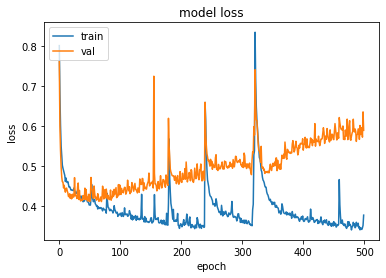

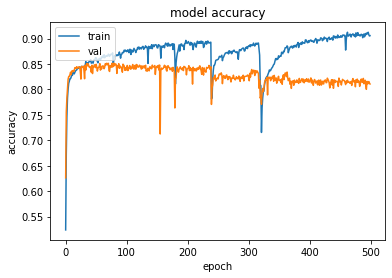

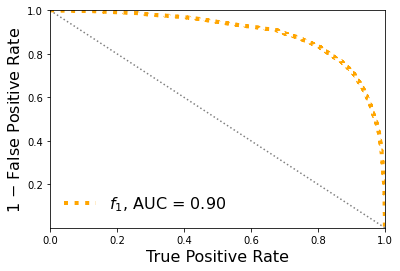

313/313 [==============================] - 1s 4ms/step - loss: 0.5923 - acc: 0.8188 - f1_m: 0.4462 - precision_m: 0.4999 - recall_m: 0.4045
Test ROC-AUC: 0.8967696799999999
Test loss: 0.5922966599464417
Test accuracy: 0.8187999725341797
Test f1: 0.4461967349052429
Test precision: 0.49985477328300476
Test recall: 0.4044528901576996
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 1.0379 - acc: 0.5023 - f1_m: 0.4899 - precision_m: 0.5018 - recall_m: 0.5043 - val_loss: 0.7466 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.7426 - acc: 0.5269 - f1_m: 0.5211 - precision_m: 0.5307 - recall_m: 0.5430 - val_loss: 0.6345 - val_acc: 0.7375 - val_f1_m: 0.7083 - val_prec

375/375 [==============================] - 13s 34ms/step - loss: 0.4588 - acc: 0.8318 - f1_m: 0.8276 - precision_m: 0.8244 - recall_m: 0.8375 - val_loss: 0.4403 - val_acc: 0.8383 - val_f1_m: 0.8330 - val_precision_m: 0.8490 - val_recall_m: 0.8225
Epoch 62/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4616 - acc: 0.8297 - f1_m: 0.8290 - precision_m: 0.8283 - recall_m: 0.8373 - val_loss: 0.4419 - val_acc: 0.8283 - val_f1_m: 0.8151 - val_precision_m: 0.8675 - val_recall_m: 0.7733
Epoch 63/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4572 - acc: 0.8308 - f1_m: 0.8303 - precision_m: 0.8288 - recall_m: 0.8399 - val_loss: 0.4405 - val_acc: 0.8367 - val_f1_m: 0.8360 - val_precision_m: 0.8250 - val_recall_m: 0.8522
Epoch 64/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4593 - acc: 0.8302 - f1_m: 0.8282 - precision_m: 0.8286 - recall_m: 0.8364 - val_loss: 0.4374 - val_acc: 0.8468 - val_f1_m: 0.8504 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4612 - acc: 0.8346 - f1_m: 0.8321 - precision_m: 0.8340 - recall_m: 0.8391 - val_loss: 0.4311 - val_acc: 0.8350 - val_f1_m: 0.8264 - val_precision_m: 0.8589 - val_recall_m: 0.8009
Epoch 124/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4432 - acc: 0.8374 - f1_m: 0.8370 - precision_m: 0.8337 - recall_m: 0.8484 - val_loss: 0.4385 - val_acc: 0.8390 - val_f1_m: 0.8462 - val_precision_m: 0.7961 - val_recall_m: 0.9075
Epoch 125/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4410 - acc: 0.8402 - f1_m: 0.8395 - precision_m: 0.8383 - recall_m: 0.8471 - val_loss: 0.4180 - val_acc: 0.8372 - val_f1_m: 0.8290 - val_precision_m: 0.8589 - val_recall_m: 0.8057
Epoch 126/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4636 - acc: 0.8321 - f1_m: 0.8289 - precision_m: 0.8382 - recall_m: 0.8311 - val_loss: 0.4241 - val_acc: 0.8475 - val_f1_m: 0.8517 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4384 - acc: 0.8406 - f1_m: 0.8405 - precision_m: 0.8357 - recall_m: 0.8524 - val_loss: 0.4583 - val_acc: 0.8287 - val_f1_m: 0.8130 - val_precision_m: 0.8843 - val_recall_m: 0.7569
Epoch 186/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4445 - acc: 0.8413 - f1_m: 0.8418 - precision_m: 0.8366 - recall_m: 0.8543 - val_loss: 0.4171 - val_acc: 0.8482 - val_f1_m: 0.8459 - val_precision_m: 0.8467 - val_recall_m: 0.8500
Epoch 187/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4305 - acc: 0.8440 - f1_m: 0.8439 - precision_m: 0.8384 - recall_m: 0.8570 - val_loss: 0.4594 - val_acc: 0.8133 - val_f1_m: 0.7891 - val_precision_m: 0.8907 - val_recall_m: 0.7136
Epoch 188/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4506 - acc: 0.8322 - f1_m: 0.8316 - precision_m: 0.8271 - recall_m: 0.8462 - val_loss: 0.4231 - val_acc: 0.8338 - val_f1_m: 0.8233 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4473 - acc: 0.8356 - f1_m: 0.8334 - precision_m: 0.8275 - recall_m: 0.8480 - val_loss: 0.4054 - val_acc: 0.8510 - val_f1_m: 0.8493 - val_precision_m: 0.8478 - val_recall_m: 0.8556
Epoch 248/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4334 - acc: 0.8418 - f1_m: 0.8407 - precision_m: 0.8344 - recall_m: 0.8551 - val_loss: 0.4138 - val_acc: 0.8485 - val_f1_m: 0.8519 - val_precision_m: 0.8257 - val_recall_m: 0.8850
Epoch 249/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4256 - acc: 0.8477 - f1_m: 0.8506 - precision_m: 0.8367 - recall_m: 0.8709 - val_loss: 0.4133 - val_acc: 0.8503 - val_f1_m: 0.8522 - val_precision_m: 0.8311 - val_recall_m: 0.8789
Epoch 250/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4581 - acc: 0.8299 - f1_m: 0.8291 - precision_m: 0.8240 - recall_m: 0.8458 - val_loss: 0.4290 - val_acc: 0.8430 - val_f1_m: 0.8530 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4390 - acc: 0.8386 - f1_m: 0.8403 - precision_m: 0.8311 - recall_m: 0.8572 - val_loss: 0.4322 - val_acc: 0.8327 - val_f1_m: 0.8195 - val_precision_m: 0.8774 - val_recall_m: 0.7739
Epoch 310/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4223 - acc: 0.8465 - f1_m: 0.8466 - precision_m: 0.8383 - recall_m: 0.8613 - val_loss: 0.4083 - val_acc: 0.8513 - val_f1_m: 0.8542 - val_precision_m: 0.8285 - val_recall_m: 0.8862
Epoch 311/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4261 - acc: 0.8506 - f1_m: 0.8504 - precision_m: 0.8384 - recall_m: 0.8691 - val_loss: 0.4289 - val_acc: 0.8412 - val_f1_m: 0.8354 - val_precision_m: 0.8551 - val_recall_m: 0.8217
Epoch 312/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4264 - acc: 0.8480 - f1_m: 0.8489 - precision_m: 0.8405 - recall_m: 0.8627 - val_loss: 0.4120 - val_acc: 0.8497 - val_f1_m: 0.8506 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4594 - acc: 0.8322 - f1_m: 0.8308 - precision_m: 0.8228 - recall_m: 0.8516 - val_loss: 0.4189 - val_acc: 0.8465 - val_f1_m: 0.8481 - val_precision_m: 0.8277 - val_recall_m: 0.8741
Epoch 372/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4438 - acc: 0.8400 - f1_m: 0.8400 - precision_m: 0.8288 - recall_m: 0.8606 - val_loss: 0.4075 - val_acc: 0.8548 - val_f1_m: 0.8562 - val_precision_m: 0.8384 - val_recall_m: 0.8795
Epoch 373/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4349 - acc: 0.8458 - f1_m: 0.8475 - precision_m: 0.8368 - recall_m: 0.8654 - val_loss: 0.4224 - val_acc: 0.8392 - val_f1_m: 0.8290 - val_precision_m: 0.8711 - val_recall_m: 0.7953
Epoch 374/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4475 - acc: 0.8341 - f1_m: 0.8345 - precision_m: 0.8287 - recall_m: 0.8504 - val_loss: 0.4284 - val_acc: 0.8435 - val_f1_m: 0.8360 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4487 - acc: 0.8382 - f1_m: 0.8365 - precision_m: 0.8340 - recall_m: 0.8500 - val_loss: 0.4909 - val_acc: 0.8167 - val_f1_m: 0.7939 - val_precision_m: 0.8894 - val_recall_m: 0.7231
Epoch 434/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4569 - acc: 0.8360 - f1_m: 0.8349 - precision_m: 0.8281 - recall_m: 0.8517 - val_loss: 0.4230 - val_acc: 0.8418 - val_f1_m: 0.8341 - val_precision_m: 0.8637 - val_recall_m: 0.8105
Epoch 435/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4386 - acc: 0.8410 - f1_m: 0.8398 - precision_m: 0.8285 - recall_m: 0.8585 - val_loss: 0.4033 - val_acc: 0.8565 - val_f1_m: 0.8573 - val_precision_m: 0.8422 - val_recall_m: 0.8775
Epoch 436/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4464 - acc: 0.8376 - f1_m: 0.8363 - precision_m: 0.8227 - recall_m: 0.8581 - val_loss: 0.4154 - val_acc: 0.8488 - val_f1_m: 0.8533 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4633 - acc: 0.8276 - f1_m: 0.8250 - precision_m: 0.8181 - recall_m: 0.8448 - val_loss: 0.4164 - val_acc: 0.8523 - val_f1_m: 0.8584 - val_precision_m: 0.8143 - val_recall_m: 0.9126
Epoch 496/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4335 - acc: 0.8450 - f1_m: 0.8454 - precision_m: 0.8352 - recall_m: 0.8641 - val_loss: 0.4081 - val_acc: 0.8520 - val_f1_m: 0.8545 - val_precision_m: 0.8287 - val_recall_m: 0.8867
Epoch 497/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4242 - acc: 0.8445 - f1_m: 0.8445 - precision_m: 0.8342 - recall_m: 0.8611 - val_loss: 0.4250 - val_acc: 0.8477 - val_f1_m: 0.8442 - val_precision_m: 0.8532 - val_recall_m: 0.8408
Epoch 498/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4527 - acc: 0.8375 - f1_m: 0.8401 - precision_m: 0.8231 - recall_m: 0.8652 - val_loss: 0.4331 - val_acc: 0.8342 - val_f1_m: 0.8235 - val_precision_m: 

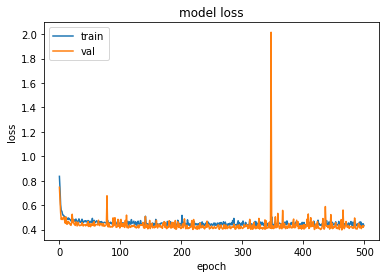

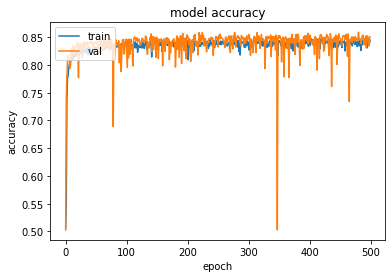

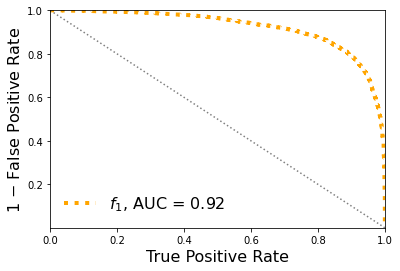

313/313 [==============================] - 1s 4ms/step - loss: 0.4411 - acc: 0.8463 - f1_m: 0.4705 - precision_m: 0.5003 - recall_m: 0.4451
Test ROC-AUC: 0.9212340000000001
Test loss: 0.44113975763320923
Test accuracy: 0.8463000059127808
Test f1: 0.4704674184322357
Test precision: 0.5002662539482117
Test recall: 0.44508785009384155
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 70ms/step - loss: 1.1558 - acc: 0.5357 - f1_m: 0.5416 - precision_m: 0.5437 - recall_m: 0.5826 - val_loss: 0.6230 - val_acc: 0.7397 - val_f1_m: 0.7564 - val_precision_m: 0.7051 - val_recall_m: 0.8183
Epoch 2/500
188/188 [==============================] - 12s 67ms/step - loss: 0.6409 - acc: 0.7186 - f1_m: 0.7355 - precision_m: 0.6989 - recall_m: 0.7869 - val_loss: 0.5351 - val_acc: 0.7863 - val_f1_m: 0.7944 - val_precision_m: 0

Epoch 31/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4769 - acc: 0.8272 - f1_m: 0.8290 - precision_m: 0.8162 - recall_m: 0.8511 - val_loss: 0.4403 - val_acc: 0.8425 - val_f1_m: 0.8422 - val_precision_m: 0.8370 - val_recall_m: 0.8506
Epoch 32/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4580 - acc: 0.8379 - f1_m: 0.8421 - precision_m: 0.8278 - recall_m: 0.8627 - val_loss: 0.4329 - val_acc: 0.8442 - val_f1_m: 0.8441 - val_precision_m: 0.8370 - val_recall_m: 0.8545
Epoch 33/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4473 - acc: 0.8416 - f1_m: 0.8449 - precision_m: 0.8294 - recall_m: 0.8641 - val_loss: 0.4356 - val_acc: 0.8457 - val_f1_m: 0.8486 - val_precision_m: 0.8252 - val_recall_m: 0.8766
Epoch 34/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4410 - acc: 0.8428 - f1_m: 0.8460 - precision_m: 0.8293 - recall_m: 0.8686 - val_loss: 0.4315 - val_acc: 0.8447 - val_f1_m: 0.8476 - val_pre

188/188 [==============================] - 13s 67ms/step - loss: 0.4235 - acc: 0.8535 - f1_m: 0.8574 - precision_m: 0.8407 - recall_m: 0.8789 - val_loss: 0.4520 - val_acc: 0.8413 - val_f1_m: 0.8478 - val_precision_m: 0.8080 - val_recall_m: 0.8951
Epoch 94/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4225 - acc: 0.8570 - f1_m: 0.8591 - precision_m: 0.8449 - recall_m: 0.8777 - val_loss: 0.4378 - val_acc: 0.8440 - val_f1_m: 0.8416 - val_precision_m: 0.8478 - val_recall_m: 0.8378
Epoch 95/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4147 - acc: 0.8567 - f1_m: 0.8580 - precision_m: 0.8465 - recall_m: 0.8746 - val_loss: 0.4604 - val_acc: 0.8278 - val_f1_m: 0.8124 - val_precision_m: 0.8814 - val_recall_m: 0.7561
Epoch 96/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4230 - acc: 0.8531 - f1_m: 0.8532 - precision_m: 0.8421 - recall_m: 0.8686 - val_loss: 0.4629 - val_acc: 0.8317 - val_f1_m: 0.8229 - val_precision_m: 0.8

188/188 [==============================] - 13s 67ms/step - loss: 0.4024 - acc: 0.8587 - f1_m: 0.8596 - precision_m: 0.8458 - recall_m: 0.8773 - val_loss: 0.5565 - val_acc: 0.8018 - val_f1_m: 0.8272 - val_precision_m: 0.7278 - val_recall_m: 0.9603
Epoch 156/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4059 - acc: 0.8614 - f1_m: 0.8632 - precision_m: 0.8548 - recall_m: 0.8770 - val_loss: 0.4413 - val_acc: 0.8443 - val_f1_m: 0.8534 - val_precision_m: 0.7994 - val_recall_m: 0.9176
Epoch 157/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4177 - acc: 0.8555 - f1_m: 0.8571 - precision_m: 0.8445 - recall_m: 0.8745 - val_loss: 0.4311 - val_acc: 0.8407 - val_f1_m: 0.8383 - val_precision_m: 0.8437 - val_recall_m: 0.8358
Epoch 158/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4171 - acc: 0.8549 - f1_m: 0.8562 - precision_m: 0.8458 - recall_m: 0.8716 - val_loss: 0.4240 - val_acc: 0.8450 - val_f1_m: 0.8436 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4005 - acc: 0.8611 - f1_m: 0.8633 - precision_m: 0.8458 - recall_m: 0.8846 - val_loss: 0.4142 - val_acc: 0.8430 - val_f1_m: 0.8456 - val_precision_m: 0.8251 - val_recall_m: 0.8700
Epoch 218/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3901 - acc: 0.8614 - f1_m: 0.8627 - precision_m: 0.8488 - recall_m: 0.8798 - val_loss: 0.4098 - val_acc: 0.8538 - val_f1_m: 0.8581 - val_precision_m: 0.8279 - val_recall_m: 0.8929
Epoch 219/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3930 - acc: 0.8665 - f1_m: 0.8676 - precision_m: 0.8564 - recall_m: 0.8823 - val_loss: 0.4170 - val_acc: 0.8508 - val_f1_m: 0.8526 - val_precision_m: 0.8361 - val_recall_m: 0.8723
Epoch 220/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3913 - acc: 0.8621 - f1_m: 0.8648 - precision_m: 0.8512 - recall_m: 0.8814 - val_loss: 0.4240 - val_acc: 0.8517 - val_f1_m: 0.8542 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4055 - acc: 0.8582 - f1_m: 0.8600 - precision_m: 0.8445 - recall_m: 0.8801 - val_loss: 0.4198 - val_acc: 0.8503 - val_f1_m: 0.8506 - val_precision_m: 0.8438 - val_recall_m: 0.8599
Epoch 280/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4491 - acc: 0.8405 - f1_m: 0.8429 - precision_m: 0.8240 - recall_m: 0.8705 - val_loss: 0.4252 - val_acc: 0.8515 - val_f1_m: 0.8509 - val_precision_m: 0.8467 - val_recall_m: 0.8581
Epoch 281/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4208 - acc: 0.8558 - f1_m: 0.8604 - precision_m: 0.8424 - recall_m: 0.8825 - val_loss: 0.4132 - val_acc: 0.8513 - val_f1_m: 0.8558 - val_precision_m: 0.8245 - val_recall_m: 0.8925
Epoch 282/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3983 - acc: 0.8648 - f1_m: 0.8669 - precision_m: 0.8533 - recall_m: 0.8849 - val_loss: 0.4119 - val_acc: 0.8543 - val_f1_m: 0.8547 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4007 - acc: 0.8636 - f1_m: 0.8668 - precision_m: 0.8468 - recall_m: 0.8902 - val_loss: 0.4032 - val_acc: 0.8557 - val_f1_m: 0.8548 - val_precision_m: 0.8527 - val_recall_m: 0.8596
Epoch 342/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3935 - acc: 0.8628 - f1_m: 0.8651 - precision_m: 0.8487 - recall_m: 0.8854 - val_loss: 0.4118 - val_acc: 0.8550 - val_f1_m: 0.8548 - val_precision_m: 0.8490 - val_recall_m: 0.8634
Epoch 343/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4007 - acc: 0.8625 - f1_m: 0.8641 - precision_m: 0.8505 - recall_m: 0.8829 - val_loss: 0.4132 - val_acc: 0.8492 - val_f1_m: 0.8428 - val_precision_m: 0.8719 - val_recall_m: 0.8179
Epoch 344/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4108 - acc: 0.8558 - f1_m: 0.8585 - precision_m: 0.8471 - recall_m: 0.8752 - val_loss: 0.4083 - val_acc: 0.8555 - val_f1_m: 0.8561 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4348 - acc: 0.8480 - f1_m: 0.8530 - precision_m: 0.8288 - recall_m: 0.8840 - val_loss: 0.4232 - val_acc: 0.8525 - val_f1_m: 0.8567 - val_precision_m: 0.8259 - val_recall_m: 0.8930
Epoch 404/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4345 - acc: 0.8449 - f1_m: 0.8485 - precision_m: 0.8247 - recall_m: 0.8801 - val_loss: 0.4296 - val_acc: 0.8435 - val_f1_m: 0.8368 - val_precision_m: 0.8661 - val_recall_m: 0.8118
Epoch 405/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4189 - acc: 0.8475 - f1_m: 0.8516 - precision_m: 0.8280 - recall_m: 0.8819 - val_loss: 0.4197 - val_acc: 0.8498 - val_f1_m: 0.8477 - val_precision_m: 0.8525 - val_recall_m: 0.8461
Epoch 406/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4234 - acc: 0.8515 - f1_m: 0.8546 - precision_m: 0.8338 - recall_m: 0.8802 - val_loss: 0.4419 - val_acc: 0.8417 - val_f1_m: 0.8549 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4088 - acc: 0.8585 - f1_m: 0.8601 - precision_m: 0.8450 - recall_m: 0.8800 - val_loss: 0.5046 - val_acc: 0.8037 - val_f1_m: 0.8310 - val_precision_m: 0.7238 - val_recall_m: 0.9778
Epoch 466/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4280 - acc: 0.8482 - f1_m: 0.8511 - precision_m: 0.8288 - recall_m: 0.8815 - val_loss: 0.4065 - val_acc: 0.8552 - val_f1_m: 0.8548 - val_precision_m: 0.8499 - val_recall_m: 0.8625
Epoch 467/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4173 - acc: 0.8552 - f1_m: 0.8568 - precision_m: 0.8427 - recall_m: 0.8756 - val_loss: 0.4028 - val_acc: 0.8552 - val_f1_m: 0.8560 - val_precision_m: 0.8445 - val_recall_m: 0.8703
Epoch 468/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3978 - acc: 0.8627 - f1_m: 0.8639 - precision_m: 0.8494 - recall_m: 0.8813 - val_loss: 0.4057 - val_acc: 0.8533 - val_f1_m: 0.8561 - val_precision_m: 

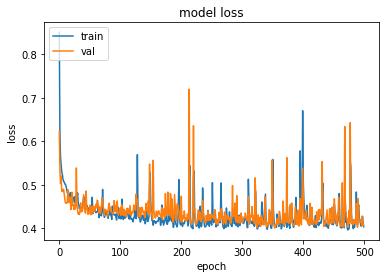

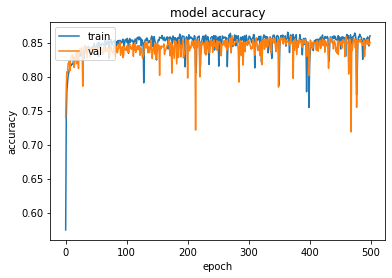

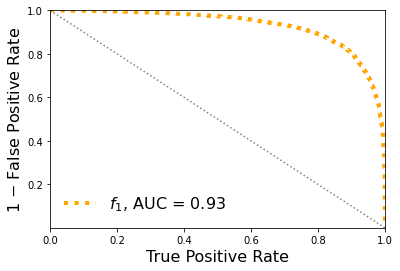

313/313 [==============================] - 1s 4ms/step - loss: 0.4142 - acc: 0.8514 - f1_m: 0.4583 - precision_m: 0.5001 - recall_m: 0.4241
Test ROC-AUC: 0.9294002
Test loss: 0.41424351930618286
Test accuracy: 0.8514000177383423
Test f1: 0.45827487111091614
Test precision: 0.5001451969146729
Test recall: 0.4241214096546173
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 144ms/step - loss: 1.4167 - acc: 0.4945 - f1_m: 0.4496 - precision_m: 0.4979 - recall_m: 0.4458 - val_loss: 0.7913 - val_acc: 0.5580 - val_f1_m: 0.2192 - val_precision_m: 0.8875 - val_recall_m: 0.1260
Epoch 2/500
94/94 [==============================] - 13s 136ms/step - loss: 0.7811 - acc: 0.5531 - f1_m: 0.5091 - precision_m: 0.5675 - recall_m: 0.4965 - val_loss: 0.7198 - val_acc: 0.7625 - val_f1_m: 0.7873 - val_precision_m: 0.7070 - val

Epoch 31/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4523 - acc: 0.8407 - f1_m: 0.8448 - precision_m: 0.8279 - recall_m: 0.8689 - val_loss: 0.4275 - val_acc: 0.8440 - val_f1_m: 0.8429 - val_precision_m: 0.8357 - val_recall_m: 0.8519
Epoch 32/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4451 - acc: 0.8443 - f1_m: 0.8445 - precision_m: 0.8391 - recall_m: 0.8546 - val_loss: 0.4291 - val_acc: 0.8428 - val_f1_m: 0.8392 - val_precision_m: 0.8531 - val_recall_m: 0.8274
Epoch 33/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4384 - acc: 0.8459 - f1_m: 0.8449 - precision_m: 0.8403 - recall_m: 0.8529 - val_loss: 0.4488 - val_acc: 0.8387 - val_f1_m: 0.8500 - val_precision_m: 0.7841 - val_recall_m: 0.9294
Epoch 34/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4487 - acc: 0.8467 - f1_m: 0.8467 - precision_m: 0.8366 - recall_m: 0.8638 - val_loss: 0.4438 - val_acc: 0.8432 - val_f1_m: 0.8495 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4163 - acc: 0.8634 - f1_m: 0.8655 - precision_m: 0.8560 - recall_m: 0.8783 - val_loss: 0.4298 - val_acc: 0.8507 - val_f1_m: 0.8518 - val_precision_m: 0.8327 - val_recall_m: 0.8731
Epoch 64/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4164 - acc: 0.8569 - f1_m: 0.8583 - precision_m: 0.8459 - recall_m: 0.8741 - val_loss: 0.4869 - val_acc: 0.8433 - val_f1_m: 0.8541 - val_precision_m: 0.7921 - val_recall_m: 0.9283
Epoch 65/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4299 - acc: 0.8582 - f1_m: 0.8609 - precision_m: 0.8453 - recall_m: 0.8825 - val_loss: 0.4319 - val_acc: 0.8497 - val_f1_m: 0.8461 - val_precision_m: 0.8585 - val_recall_m: 0.8353
Epoch 66/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4130 - acc: 0.8633 - f1_m: 0.8658 - precision_m: 0.8540 - recall_m: 0.8820 - val_loss: 0.4344 - val_acc: 0.8495 - val_f1_m: 0.8512 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3852 - acc: 0.8755 - f1_m: 0.8771 - precision_m: 0.8597 - recall_m: 0.8971 - val_loss: 0.4358 - val_acc: 0.8468 - val_f1_m: 0.8450 - val_precision_m: 0.8452 - val_recall_m: 0.8459
Epoch 96/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3913 - acc: 0.8761 - f1_m: 0.8779 - precision_m: 0.8615 - recall_m: 0.8970 - val_loss: 0.4363 - val_acc: 0.8493 - val_f1_m: 0.8511 - val_precision_m: 0.8265 - val_recall_m: 0.8784
Epoch 97/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3884 - acc: 0.8745 - f1_m: 0.8752 - precision_m: 0.8610 - recall_m: 0.8915 - val_loss: 0.4568 - val_acc: 0.8430 - val_f1_m: 0.8348 - val_precision_m: 0.8750 - val_recall_m: 0.7998
Epoch 98/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3999 - acc: 0.8725 - f1_m: 0.8732 - precision_m: 0.8639 - recall_m: 0.8878 - val_loss: 0.4323 - val_acc: 0.8562 - val_f1_m: 0.8578 - val_precisi

94/94 [==============================] - 13s 136ms/step - loss: 0.3847 - acc: 0.8799 - f1_m: 0.8813 - precision_m: 0.8705 - recall_m: 0.8947 - val_loss: 0.4318 - val_acc: 0.8487 - val_f1_m: 0.8524 - val_precision_m: 0.8235 - val_recall_m: 0.8848
Epoch 158/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3772 - acc: 0.8854 - f1_m: 0.8839 - precision_m: 0.8807 - recall_m: 0.8888 - val_loss: 0.4350 - val_acc: 0.8527 - val_f1_m: 0.8541 - val_precision_m: 0.8363 - val_recall_m: 0.8743
Epoch 159/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3797 - acc: 0.8810 - f1_m: 0.8820 - precision_m: 0.8724 - recall_m: 0.8938 - val_loss: 0.4402 - val_acc: 0.8438 - val_f1_m: 0.8471 - val_precision_m: 0.8231 - val_recall_m: 0.8744
Epoch 160/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3809 - acc: 0.8821 - f1_m: 0.8836 - precision_m: 0.8716 - recall_m: 0.8979 - val_loss: 0.4401 - val_acc: 0.8492 - val_f1_m: 0.8511 - val_precision_m: 0.82

94/94 [==============================] - 13s 136ms/step - loss: 0.3664 - acc: 0.8950 - f1_m: 0.8968 - precision_m: 0.8865 - recall_m: 0.9085 - val_loss: 0.4473 - val_acc: 0.8452 - val_f1_m: 0.8483 - val_precision_m: 0.8225 - val_recall_m: 0.8770
Epoch 220/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3657 - acc: 0.8944 - f1_m: 0.8965 - precision_m: 0.8836 - recall_m: 0.9114 - val_loss: 0.4523 - val_acc: 0.8452 - val_f1_m: 0.8421 - val_precision_m: 0.8517 - val_recall_m: 0.8337
Epoch 221/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3694 - acc: 0.8879 - f1_m: 0.8880 - precision_m: 0.8786 - recall_m: 0.8996 - val_loss: 0.4633 - val_acc: 0.8440 - val_f1_m: 0.8404 - val_precision_m: 0.8531 - val_recall_m: 0.8301
Epoch 222/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3806 - acc: 0.8852 - f1_m: 0.8869 - precision_m: 0.8758 - recall_m: 0.9015 - val_loss: 0.4586 - val_acc: 0.8452 - val_f1_m: 0.8425 - val_precision_m: 0.84

94/94 [==============================] - 13s 135ms/step - loss: 0.3921 - acc: 0.8650 - f1_m: 0.8662 - precision_m: 0.8584 - recall_m: 0.8760 - val_loss: 0.4369 - val_acc: 0.8318 - val_f1_m: 0.8210 - val_precision_m: 0.8682 - val_recall_m: 0.7800
Epoch 282/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3903 - acc: 0.8675 - f1_m: 0.8689 - precision_m: 0.8591 - recall_m: 0.8802 - val_loss: 0.4168 - val_acc: 0.8482 - val_f1_m: 0.8453 - val_precision_m: 0.8449 - val_recall_m: 0.8469
Epoch 283/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4013 - acc: 0.8615 - f1_m: 0.8613 - precision_m: 0.8522 - recall_m: 0.8732 - val_loss: 0.4281 - val_acc: 0.8350 - val_f1_m: 0.8252 - val_precision_m: 0.8699 - val_recall_m: 0.7867
Epoch 284/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4004 - acc: 0.8651 - f1_m: 0.8652 - precision_m: 0.8612 - recall_m: 0.8730 - val_loss: 0.4342 - val_acc: 0.8525 - val_f1_m: 0.8521 - val_precision_m: 0.84

94/94 [==============================] - 13s 135ms/step - loss: 0.3847 - acc: 0.8773 - f1_m: 0.8778 - precision_m: 0.8753 - recall_m: 0.8844 - val_loss: 0.4571 - val_acc: 0.8428 - val_f1_m: 0.8476 - val_precision_m: 0.8098 - val_recall_m: 0.8907
Epoch 344/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3711 - acc: 0.8838 - f1_m: 0.8847 - precision_m: 0.8741 - recall_m: 0.8976 - val_loss: 0.4394 - val_acc: 0.8508 - val_f1_m: 0.8529 - val_precision_m: 0.8317 - val_recall_m: 0.8769
Epoch 345/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3634 - acc: 0.8907 - f1_m: 0.8927 - precision_m: 0.8826 - recall_m: 0.9043 - val_loss: 0.4366 - val_acc: 0.8477 - val_f1_m: 0.8460 - val_precision_m: 0.8464 - val_recall_m: 0.8471
Epoch 346/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3698 - acc: 0.8886 - f1_m: 0.8885 - precision_m: 0.8788 - recall_m: 0.9016 - val_loss: 0.4464 - val_acc: 0.8460 - val_f1_m: 0.8417 - val_precision_m: 0.85

94/94 [==============================] - 13s 136ms/step - loss: 0.3653 - acc: 0.8852 - f1_m: 0.8858 - precision_m: 0.8855 - recall_m: 0.8879 - val_loss: 0.4325 - val_acc: 0.8462 - val_f1_m: 0.8531 - val_precision_m: 0.8085 - val_recall_m: 0.9047
Epoch 406/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3819 - acc: 0.8799 - f1_m: 0.8794 - precision_m: 0.8800 - recall_m: 0.8820 - val_loss: 0.4349 - val_acc: 0.8503 - val_f1_m: 0.8532 - val_precision_m: 0.8285 - val_recall_m: 0.8813
Epoch 407/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3781 - acc: 0.8768 - f1_m: 0.8753 - precision_m: 0.8753 - recall_m: 0.8772 - val_loss: 0.4394 - val_acc: 0.8278 - val_f1_m: 0.8152 - val_precision_m: 0.8734 - val_recall_m: 0.7656
Epoch 408/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3666 - acc: 0.8814 - f1_m: 0.8781 - precision_m: 0.8850 - recall_m: 0.8735 - val_loss: 0.4273 - val_acc: 0.8410 - val_f1_m: 0.8365 - val_precision_m: 0.85

94/94 [==============================] - 13s 136ms/step - loss: 0.3698 - acc: 0.8772 - f1_m: 0.8763 - precision_m: 0.8802 - recall_m: 0.8750 - val_loss: 0.4237 - val_acc: 0.8457 - val_f1_m: 0.8406 - val_precision_m: 0.8587 - val_recall_m: 0.8251
Epoch 468/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3663 - acc: 0.8823 - f1_m: 0.8825 - precision_m: 0.8816 - recall_m: 0.8846 - val_loss: 0.4226 - val_acc: 0.8488 - val_f1_m: 0.8447 - val_precision_m: 0.8526 - val_recall_m: 0.8382
Epoch 469/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3685 - acc: 0.8839 - f1_m: 0.8840 - precision_m: 0.8883 - recall_m: 0.8813 - val_loss: 0.4266 - val_acc: 0.8465 - val_f1_m: 0.8400 - val_precision_m: 0.8634 - val_recall_m: 0.8194
Epoch 470/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3729 - acc: 0.8824 - f1_m: 0.8822 - precision_m: 0.8875 - recall_m: 0.8789 - val_loss: 0.4380 - val_acc: 0.8437 - val_f1_m: 0.8352 - val_precision_m: 0.86

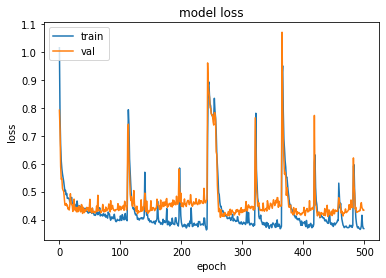

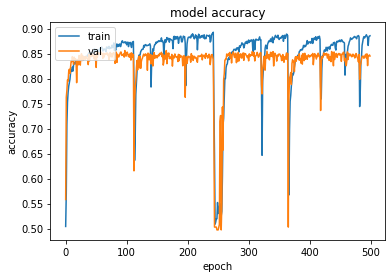

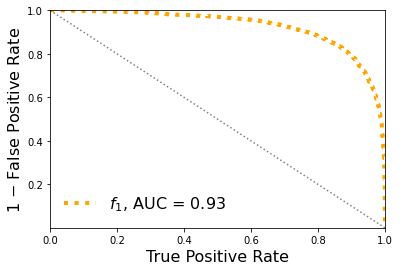

313/313 [==============================] - 1s 4ms/step - loss: 0.4373 - acc: 0.8493 - f1_m: 0.4608 - precision_m: 0.5001 - recall_m: 0.4284
Test ROC-AUC: 0.92539484
Test loss: 0.4372828006744385
Test accuracy: 0.8493000268936157
Test f1: 0.46083545684814453
Test precision: 0.5001451969146729
Test recall: 0.428414523601532
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 0.7270 - acc: 0.5981 - f1_m: 0.5736 - precision_m: 0.5958 - recall_m: 0.5819 - val_loss: 0.5162 - val_acc: 0.7930 - val_f1_m: 0.7972 - val_precision_m: 0.7707 - val_recall_m: 0.8315
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5522 - acc: 0.7728 - f1_m: 0.7739 - precision_m: 0.7689 - recall_m: 0.7904 - val_loss: 0.5035 - val_acc: 0.7882 - val_f1_m: 0.7576 - val_precision_m: 0.8705 - val

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4535 - acc: 0.8287 - f1_m: 0.8293 - precision_m: 0.8232 - recall_m: 0.8428 - val_loss: 0.4325 - val_acc: 0.8458 - val_f1_m: 0.8512 - val_precision_m: 0.8141 - val_recall_m: 0.8982
Epoch 32/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4712 - acc: 0.8252 - f1_m: 0.8261 - precision_m: 0.8218 - recall_m: 0.8406 - val_loss: 0.4296 - val_acc: 0.8338 - val_f1_m: 0.8279 - val_precision_m: 0.8492 - val_recall_m: 0.8128
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4511 - acc: 0.8372 - f1_m: 0.8373 - precision_m: 0.8296 - recall_m: 0.8528 - val_loss: 0.4517 - val_acc: 0.8437 - val_f1_m: 0.8500 - val_precision_m: 0.8051 - val_recall_m: 0.9051
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4575 - acc: 0.8337 - f1_m: 0.8313 - precision_m: 0.8274 - recall_m: 0.8441 - val_loss: 0.4322 - val_acc: 0.8413 - val_f1_m: 0.8429 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4301 - acc: 0.8456 - f1_m: 0.8467 - precision_m: 0.8372 - recall_m: 0.8636 - val_loss: 0.4393 - val_acc: 0.8393 - val_f1_m: 0.8334 - val_precision_m: 0.8556 - val_recall_m: 0.8185
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4321 - acc: 0.8505 - f1_m: 0.8523 - precision_m: 0.8467 - recall_m: 0.8648 - val_loss: 0.4106 - val_acc: 0.8547 - val_f1_m: 0.8572 - val_precision_m: 0.8318 - val_recall_m: 0.8894
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4466 - acc: 0.8340 - f1_m: 0.8340 - precision_m: 0.8270 - recall_m: 0.8504 - val_loss: 0.4065 - val_acc: 0.8467 - val_f1_m: 0.8422 - val_precision_m: 0.8591 - val_recall_m: 0.8319
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4234 - acc: 0.8526 - f1_m: 0.8518 - precision_m: 0.8471 - recall_m: 0.8638 - val_loss: 0.5386 - val_acc: 0.8120 - val_f1_m: 0.7907 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4392 - acc: 0.8507 - f1_m: 0.8510 - precision_m: 0.8438 - recall_m: 0.8647 - val_loss: 0.4137 - val_acc: 0.8427 - val_f1_m: 0.8350 - val_precision_m: 0.8655 - val_recall_m: 0.8128
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4195 - acc: 0.8497 - f1_m: 0.8498 - precision_m: 0.8413 - recall_m: 0.8659 - val_loss: 0.4206 - val_acc: 0.8398 - val_f1_m: 0.8298 - val_precision_m: 0.8729 - val_recall_m: 0.7964
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4168 - acc: 0.8539 - f1_m: 0.8545 - precision_m: 0.8520 - recall_m: 0.8635 - val_loss: 0.4068 - val_acc: 0.8532 - val_f1_m: 0.8525 - val_precision_m: 0.8451 - val_recall_m: 0.8650
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4182 - acc: 0.8508 - f1_m: 0.8503 - precision_m: 0.8461 - recall_m: 0.8605 - val_loss: 0.4028 - val_acc: 0.8450 - val_f1_m: 0.8399 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4297 - acc: 0.8478 - f1_m: 0.8473 - precision_m: 0.8462 - recall_m: 0.8544 - val_loss: 0.4235 - val_acc: 0.8393 - val_f1_m: 0.8322 - val_precision_m: 0.8589 - val_recall_m: 0.8119
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4431 - acc: 0.8495 - f1_m: 0.8477 - precision_m: 0.8440 - recall_m: 0.8596 - val_loss: 0.4299 - val_acc: 0.8402 - val_f1_m: 0.8333 - val_precision_m: 0.8607 - val_recall_m: 0.8120
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4306 - acc: 0.8481 - f1_m: 0.8474 - precision_m: 0.8461 - recall_m: 0.8565 - val_loss: 0.4114 - val_acc: 0.8515 - val_f1_m: 0.8500 - val_precision_m: 0.8486 - val_recall_m: 0.8572
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4276 - acc: 0.8498 - f1_m: 0.8486 - precision_m: 0.8472 - recall_m: 0.8561 - val_loss: 0.4202 - val_acc: 0.8358 - val_f1_m: 0.8243 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4261 - acc: 0.8451 - f1_m: 0.8473 - precision_m: 0.8397 - recall_m: 0.8604 - val_loss: 0.4313 - val_acc: 0.8403 - val_f1_m: 0.8313 - val_precision_m: 0.8692 - val_recall_m: 0.8004
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4252 - acc: 0.8505 - f1_m: 0.8489 - precision_m: 0.8446 - recall_m: 0.8599 - val_loss: 0.4399 - val_acc: 0.8332 - val_f1_m: 0.8235 - val_precision_m: 0.8649 - val_recall_m: 0.7906
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4630 - acc: 0.8390 - f1_m: 0.8383 - precision_m: 0.8315 - recall_m: 0.8552 - val_loss: 0.4431 - val_acc: 0.8367 - val_f1_m: 0.8285 - val_precision_m: 0.8612 - val_recall_m: 0.8029
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4411 - acc: 0.8494 - f1_m: 0.8501 - precision_m: 0.8386 - recall_m: 0.8681 - val_loss: 0.4281 - val_acc: 0.8417 - val_f1_m: 0.8467 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4401 - acc: 0.8455 - f1_m: 0.8482 - precision_m: 0.8303 - recall_m: 0.8727 - val_loss: 0.4605 - val_acc: 0.8492 - val_f1_m: 0.8588 - val_precision_m: 0.7974 - val_recall_m: 0.9351
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4500 - acc: 0.8440 - f1_m: 0.8449 - precision_m: 0.8288 - recall_m: 0.8684 - val_loss: 0.4113 - val_acc: 0.8500 - val_f1_m: 0.8480 - val_precision_m: 0.8505 - val_recall_m: 0.8510
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4219 - acc: 0.8518 - f1_m: 0.8503 - precision_m: 0.8486 - recall_m: 0.8585 - val_loss: 0.4116 - val_acc: 0.8548 - val_f1_m: 0.8561 - val_precision_m: 0.8375 - val_recall_m: 0.8804
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4244 - acc: 0.8528 - f1_m: 0.8528 - precision_m: 0.8429 - recall_m: 0.8688 - val_loss: 0.4245 - val_acc: 0.8440 - val_f1_m: 0.8445 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4172 - acc: 0.8559 - f1_m: 0.8551 - precision_m: 0.8559 - recall_m: 0.8590 - val_loss: 0.4100 - val_acc: 0.8493 - val_f1_m: 0.8483 - val_precision_m: 0.8452 - val_recall_m: 0.8559
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4296 - acc: 0.8481 - f1_m: 0.8494 - precision_m: 0.8435 - recall_m: 0.8618 - val_loss: 0.4211 - val_acc: 0.8403 - val_f1_m: 0.8294 - val_precision_m: 0.8811 - val_recall_m: 0.7888
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4700 - acc: 0.8349 - f1_m: 0.8341 - precision_m: 0.8278 - recall_m: 0.8530 - val_loss: 0.4334 - val_acc: 0.8465 - val_f1_m: 0.8526 - val_precision_m: 0.8098 - val_recall_m: 0.9058
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4541 - acc: 0.8361 - f1_m: 0.8384 - precision_m: 0.8265 - recall_m: 0.8593 - val_loss: 0.4144 - val_acc: 0.8483 - val_f1_m: 0.8467 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4294 - acc: 0.8429 - f1_m: 0.8424 - precision_m: 0.8381 - recall_m: 0.8552 - val_loss: 0.4120 - val_acc: 0.8517 - val_f1_m: 0.8518 - val_precision_m: 0.8402 - val_recall_m: 0.8685
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4272 - acc: 0.8491 - f1_m: 0.8477 - precision_m: 0.8468 - recall_m: 0.8544 - val_loss: 0.4648 - val_acc: 0.8373 - val_f1_m: 0.8283 - val_precision_m: 0.8678 - val_recall_m: 0.7970
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4807 - acc: 0.8332 - f1_m: 0.8349 - precision_m: 0.8213 - recall_m: 0.8587 - val_loss: 0.4220 - val_acc: 0.8458 - val_f1_m: 0.8465 - val_precision_m: 0.8352 - val_recall_m: 0.8628
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4302 - acc: 0.8488 - f1_m: 0.8519 - precision_m: 0.8353 - recall_m: 0.8746 - val_loss: 0.4162 - val_acc: 0.8468 - val_f1_m: 0.8495 - val_precision_m: 

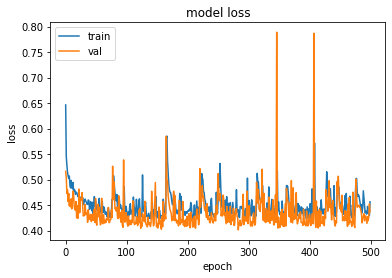

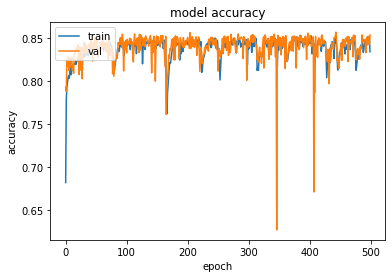

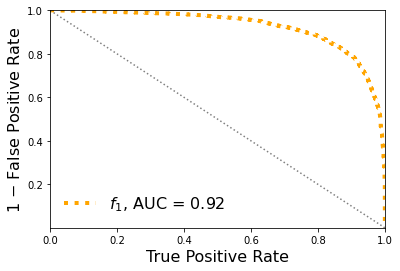

313/313 [==============================] - 1s 4ms/step - loss: 0.4403 - acc: 0.8471 - f1_m: 0.4660 - precision_m: 0.5003 - recall_m: 0.4371
Test ROC-AUC: 0.9242277800000002
Test loss: 0.4403400421142578
Test accuracy: 0.847100019454956
Test f1: 0.465965211391449
Test precision: 0.5003194808959961
Test recall: 0.4371006488800049
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 70ms/step - loss: 0.7408 - acc: 0.5604 - f1_m: 0.6270 - precision_m: 0.5603 - recall_m: 0.7623 - val_loss: 0.5273 - val_acc: 0.7757 - val_f1_m: 0.7798 - val_precision_m: 0.7584 - val_recall_m: 0.8054
Epoch 2/500
188/188 [==============================] - 13s 67ms/step - loss: 0.5609 - acc: 0.7656 - f1_m: 0.7703 - precision_m: 0.7516 - recall_m: 0.7976 - val_loss: 0.5095 - val_acc: 0.8003 - val_f1_m: 0.8168 - val_precision_m: 0.749

Epoch 31/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4503 - acc: 0.8332 - f1_m: 0.8378 - precision_m: 0.8204 - recall_m: 0.8641 - val_loss: 0.4209 - val_acc: 0.8445 - val_f1_m: 0.8475 - val_precision_m: 0.8243 - val_recall_m: 0.8748
Epoch 32/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4338 - acc: 0.8445 - f1_m: 0.8444 - precision_m: 0.8324 - recall_m: 0.8630 - val_loss: 0.4600 - val_acc: 0.8203 - val_f1_m: 0.8026 - val_precision_m: 0.8825 - val_recall_m: 0.7394
Epoch 33/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4371 - acc: 0.8426 - f1_m: 0.8458 - precision_m: 0.8295 - recall_m: 0.8668 - val_loss: 0.4183 - val_acc: 0.8493 - val_f1_m: 0.8540 - val_precision_m: 0.8206 - val_recall_m: 0.8930
Epoch 34/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4341 - acc: 0.8488 - f1_m: 0.8506 - precision_m: 0.8364 - recall_m: 0.8697 - val_loss: 0.4413 - val_acc: 0.8290 - val_f1_m: 0.8146 - val_pre

188/188 [==============================] - 13s 67ms/step - loss: 0.3957 - acc: 0.8622 - f1_m: 0.8654 - precision_m: 0.8433 - recall_m: 0.8919 - val_loss: 0.4254 - val_acc: 0.8470 - val_f1_m: 0.8447 - val_precision_m: 0.8509 - val_recall_m: 0.8405
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4310 - acc: 0.8498 - f1_m: 0.8539 - precision_m: 0.8317 - recall_m: 0.8840 - val_loss: 0.4200 - val_acc: 0.8435 - val_f1_m: 0.8414 - val_precision_m: 0.8467 - val_recall_m: 0.8388
Epoch 95/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4363 - acc: 0.8438 - f1_m: 0.8485 - precision_m: 0.8267 - recall_m: 0.8770 - val_loss: 0.4565 - val_acc: 0.8407 - val_f1_m: 0.8533 - val_precision_m: 0.7845 - val_recall_m: 0.9382
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4101 - acc: 0.8569 - f1_m: 0.8590 - precision_m: 0.8363 - recall_m: 0.8878 - val_loss: 0.4200 - val_acc: 0.8448 - val_f1_m: 0.8422 - val_precision_m: 0.8

188/188 [==============================] - 13s 67ms/step - loss: 0.4098 - acc: 0.8594 - f1_m: 0.8609 - precision_m: 0.8417 - recall_m: 0.8857 - val_loss: 0.4440 - val_acc: 0.8358 - val_f1_m: 0.8434 - val_precision_m: 0.8013 - val_recall_m: 0.8929
Epoch 156/500
188/188 [==============================] - 12s 67ms/step - loss: 0.4004 - acc: 0.8621 - f1_m: 0.8634 - precision_m: 0.8455 - recall_m: 0.8850 - val_loss: 0.4594 - val_acc: 0.8285 - val_f1_m: 0.8167 - val_precision_m: 0.8665 - val_recall_m: 0.7751
Epoch 157/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4277 - acc: 0.8557 - f1_m: 0.8595 - precision_m: 0.8384 - recall_m: 0.8866 - val_loss: 0.4371 - val_acc: 0.8435 - val_f1_m: 0.8463 - val_precision_m: 0.8263 - val_recall_m: 0.8697
Epoch 158/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3942 - acc: 0.8692 - f1_m: 0.8725 - precision_m: 0.8507 - recall_m: 0.8983 - val_loss: 0.4457 - val_acc: 0.8395 - val_f1_m: 0.8347 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4918 - acc: 0.8328 - f1_m: 0.8332 - precision_m: 0.8167 - recall_m: 0.8646 - val_loss: 0.4678 - val_acc: 0.8408 - val_f1_m: 0.8410 - val_precision_m: 0.8332 - val_recall_m: 0.8520
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4553 - acc: 0.8491 - f1_m: 0.8513 - precision_m: 0.8255 - recall_m: 0.8826 - val_loss: 0.4521 - val_acc: 0.8427 - val_f1_m: 0.8518 - val_precision_m: 0.7994 - val_recall_m: 0.9139
Epoch 219/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4164 - acc: 0.8665 - f1_m: 0.8692 - precision_m: 0.8512 - recall_m: 0.8920 - val_loss: 0.4479 - val_acc: 0.8378 - val_f1_m: 0.8315 - val_precision_m: 0.8603 - val_recall_m: 0.8072
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4477 - acc: 0.8408 - f1_m: 0.8441 - precision_m: 0.8273 - recall_m: 0.8686 - val_loss: 0.4642 - val_acc: 0.8322 - val_f1_m: 0.8337 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.3849 - acc: 0.8748 - f1_m: 0.8766 - precision_m: 0.8638 - recall_m: 0.8928 - val_loss: 0.4689 - val_acc: 0.8340 - val_f1_m: 0.8317 - val_precision_m: 0.8393 - val_recall_m: 0.8277
Epoch 280/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3903 - acc: 0.8774 - f1_m: 0.8783 - precision_m: 0.8645 - recall_m: 0.8964 - val_loss: 0.4516 - val_acc: 0.8442 - val_f1_m: 0.8432 - val_precision_m: 0.8420 - val_recall_m: 0.8470
Epoch 281/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3945 - acc: 0.8729 - f1_m: 0.8754 - precision_m: 0.8600 - recall_m: 0.8947 - val_loss: 0.4742 - val_acc: 0.8303 - val_f1_m: 0.8428 - val_precision_m: 0.7795 - val_recall_m: 0.9199
Epoch 282/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4002 - acc: 0.8685 - f1_m: 0.8697 - precision_m: 0.8532 - recall_m: 0.8913 - val_loss: 0.5616 - val_acc: 0.7795 - val_f1_m: 0.8062 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4400 - acc: 0.8374 - f1_m: 0.8424 - precision_m: 0.8212 - recall_m: 0.8689 - val_loss: 0.4605 - val_acc: 0.8295 - val_f1_m: 0.8319 - val_precision_m: 0.8125 - val_recall_m: 0.8544
Epoch 342/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4412 - acc: 0.8396 - f1_m: 0.8434 - precision_m: 0.8193 - recall_m: 0.8721 - val_loss: 0.4462 - val_acc: 0.8362 - val_f1_m: 0.8329 - val_precision_m: 0.8427 - val_recall_m: 0.8263
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4730 - acc: 0.8323 - f1_m: 0.8351 - precision_m: 0.8199 - recall_m: 0.8617 - val_loss: 0.4664 - val_acc: 0.8308 - val_f1_m: 0.8316 - val_precision_m: 0.8207 - val_recall_m: 0.8456
Epoch 344/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4488 - acc: 0.8423 - f1_m: 0.8457 - precision_m: 0.8253 - recall_m: 0.8715 - val_loss: 0.4571 - val_acc: 0.8367 - val_f1_m: 0.8411 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.3881 - acc: 0.8766 - f1_m: 0.8802 - precision_m: 0.8585 - recall_m: 0.9071 - val_loss: 0.4763 - val_acc: 0.8378 - val_f1_m: 0.8285 - val_precision_m: 0.8711 - val_recall_m: 0.7929
Epoch 404/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4129 - acc: 0.8661 - f1_m: 0.8675 - precision_m: 0.8548 - recall_m: 0.8859 - val_loss: 0.4591 - val_acc: 0.8388 - val_f1_m: 0.8341 - val_precision_m: 0.8510 - val_recall_m: 0.8214
Epoch 405/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3987 - acc: 0.8756 - f1_m: 0.8779 - precision_m: 0.8619 - recall_m: 0.8991 - val_loss: 0.4664 - val_acc: 0.8423 - val_f1_m: 0.8504 - val_precision_m: 0.8019 - val_recall_m: 0.9075
Epoch 406/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3978 - acc: 0.8745 - f1_m: 0.8777 - precision_m: 0.8581 - recall_m: 0.9016 - val_loss: 0.4566 - val_acc: 0.8452 - val_f1_m: 0.8417 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4052 - acc: 0.8728 - f1_m: 0.8750 - precision_m: 0.8570 - recall_m: 0.8969 - val_loss: 0.4885 - val_acc: 0.8227 - val_f1_m: 0.8124 - val_precision_m: 0.8552 - val_recall_m: 0.7768
Epoch 466/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4223 - acc: 0.8628 - f1_m: 0.8651 - precision_m: 0.8520 - recall_m: 0.8853 - val_loss: 0.5444 - val_acc: 0.8038 - val_f1_m: 0.8264 - val_precision_m: 0.7364 - val_recall_m: 0.9445
Epoch 467/500
188/188 [==============================] - 12s 66ms/step - loss: 0.5262 - acc: 0.8112 - f1_m: 0.8205 - precision_m: 0.7856 - recall_m: 0.8672 - val_loss: 0.4918 - val_acc: 0.8238 - val_f1_m: 0.8189 - val_precision_m: 0.8349 - val_recall_m: 0.8069
Epoch 468/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4519 - acc: 0.8490 - f1_m: 0.8543 - precision_m: 0.8301 - recall_m: 0.8840 - val_loss: 0.4643 - val_acc: 0.8328 - val_f1_m: 0.8376 - val_precision_m: 

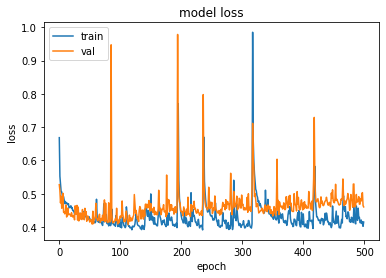

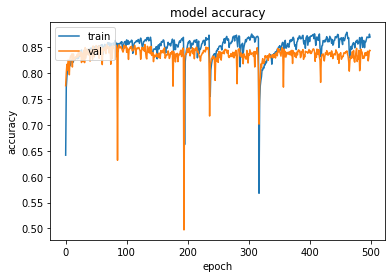

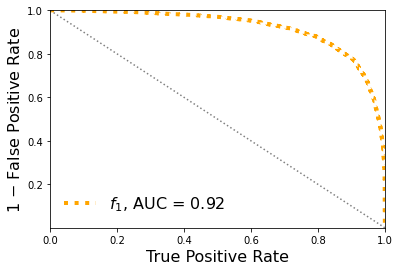

313/313 [==============================] - 1s 4ms/step - loss: 0.4723 - acc: 0.8401 - f1_m: 0.4603 - precision_m: 0.5000 - recall_m: 0.4277
Test ROC-AUC: 0.9200642800000001
Test loss: 0.4723432660102844
Test accuracy: 0.8400999903678894
Test f1: 0.4603494703769684
Test precision: 0.5
Test recall: 0.4277156591415405
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 143ms/step - loss: 0.7769 - acc: 0.5598 - f1_m: 0.6334 - precision_m: 0.5629 - recall_m: 0.7552 - val_loss: 0.5486 - val_acc: 0.7622 - val_f1_m: 0.7445 - val_precision_m: 0.7964 - val_recall_m: 0.7006
Epoch 2/500
94/94 [==============================] - 13s 137ms/step - loss: 0.5616 - acc: 0.7625 - f1_m: 0.7688 - precision_m: 0.7533 - recall_m: 0.7911 - val_loss: 0.5099 - val_acc: 0.7903 - val_f1_m: 0.8067 - val_precision_m: 0.7391 - val_recall_

Epoch 31/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4296 - acc: 0.8467 - f1_m: 0.8499 - precision_m: 0.8353 - recall_m: 0.8676 - val_loss: 0.4397 - val_acc: 0.8375 - val_f1_m: 0.8481 - val_precision_m: 0.7885 - val_recall_m: 0.9188
Epoch 32/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4262 - acc: 0.8458 - f1_m: 0.8483 - precision_m: 0.8303 - recall_m: 0.8709 - val_loss: 0.4408 - val_acc: 0.8338 - val_f1_m: 0.8237 - val_precision_m: 0.8632 - val_recall_m: 0.7897
Epoch 33/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4266 - acc: 0.8513 - f1_m: 0.8519 - precision_m: 0.8461 - recall_m: 0.8627 - val_loss: 0.4333 - val_acc: 0.8432 - val_f1_m: 0.8450 - val_precision_m: 0.8250 - val_recall_m: 0.8675
Epoch 34/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4249 - acc: 0.8490 - f1_m: 0.8520 - precision_m: 0.8353 - recall_m: 0.8717 - val_loss: 0.4335 - val_acc: 0.8413 - val_f1_m: 0.8403 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4101 - acc: 0.8596 - f1_m: 0.8632 - precision_m: 0.8467 - recall_m: 0.8852 - val_loss: 0.4443 - val_acc: 0.8353 - val_f1_m: 0.8445 - val_precision_m: 0.7956 - val_recall_m: 0.9013
Epoch 64/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3963 - acc: 0.8637 - f1_m: 0.8674 - precision_m: 0.8452 - recall_m: 0.8936 - val_loss: 0.4446 - val_acc: 0.8392 - val_f1_m: 0.8341 - val_precision_m: 0.8532 - val_recall_m: 0.8170
Epoch 65/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3974 - acc: 0.8649 - f1_m: 0.8684 - precision_m: 0.8487 - recall_m: 0.8920 - val_loss: 0.4353 - val_acc: 0.8455 - val_f1_m: 0.8469 - val_precision_m: 0.8289 - val_recall_m: 0.8666
Epoch 66/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3983 - acc: 0.8672 - f1_m: 0.8704 - precision_m: 0.8506 - recall_m: 0.8937 - val_loss: 0.4433 - val_acc: 0.8392 - val_f1_m: 0.8362 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3996 - acc: 0.8668 - f1_m: 0.8708 - precision_m: 0.8490 - recall_m: 0.8971 - val_loss: 0.4547 - val_acc: 0.8438 - val_f1_m: 0.8487 - val_precision_m: 0.8155 - val_recall_m: 0.8865
Epoch 96/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3892 - acc: 0.8661 - f1_m: 0.8686 - precision_m: 0.8489 - recall_m: 0.8922 - val_loss: 0.4449 - val_acc: 0.8495 - val_f1_m: 0.8543 - val_precision_m: 0.8201 - val_recall_m: 0.8933
Epoch 97/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3854 - acc: 0.8747 - f1_m: 0.8780 - precision_m: 0.8563 - recall_m: 0.9035 - val_loss: 0.4545 - val_acc: 0.8380 - val_f1_m: 0.8358 - val_precision_m: 0.8383 - val_recall_m: 0.8347
Epoch 98/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4054 - acc: 0.8619 - f1_m: 0.8640 - precision_m: 0.8440 - recall_m: 0.8875 - val_loss: 0.4598 - val_acc: 0.8455 - val_f1_m: 0.8494 - val_precisi

94/94 [==============================] - 13s 137ms/step - loss: 0.4040 - acc: 0.8679 - f1_m: 0.8709 - precision_m: 0.8526 - recall_m: 0.8940 - val_loss: 0.4780 - val_acc: 0.8410 - val_f1_m: 0.8351 - val_precision_m: 0.8508 - val_recall_m: 0.8217
Epoch 158/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3824 - acc: 0.8753 - f1_m: 0.8786 - precision_m: 0.8605 - recall_m: 0.8993 - val_loss: 0.4544 - val_acc: 0.8427 - val_f1_m: 0.8441 - val_precision_m: 0.8239 - val_recall_m: 0.8670
Epoch 159/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3937 - acc: 0.8708 - f1_m: 0.8740 - precision_m: 0.8490 - recall_m: 0.9044 - val_loss: 0.4715 - val_acc: 0.8380 - val_f1_m: 0.8346 - val_precision_m: 0.8493 - val_recall_m: 0.8225
Epoch 160/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3785 - acc: 0.8795 - f1_m: 0.8815 - precision_m: 0.8637 - recall_m: 0.9025 - val_loss: 0.4746 - val_acc: 0.8343 - val_f1_m: 0.8291 - val_precision_m: 0.84

94/94 [==============================] - 13s 136ms/step - loss: 0.3702 - acc: 0.8825 - f1_m: 0.8860 - precision_m: 0.8598 - recall_m: 0.9153 - val_loss: 0.4942 - val_acc: 0.8353 - val_f1_m: 0.8387 - val_precision_m: 0.8101 - val_recall_m: 0.8719
Epoch 220/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3762 - acc: 0.8802 - f1_m: 0.8835 - precision_m: 0.8547 - recall_m: 0.9160 - val_loss: 0.5015 - val_acc: 0.8273 - val_f1_m: 0.8374 - val_precision_m: 0.7840 - val_recall_m: 0.8999
Epoch 221/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3832 - acc: 0.8743 - f1_m: 0.8792 - precision_m: 0.8457 - recall_m: 0.9170 - val_loss: 0.4850 - val_acc: 0.8393 - val_f1_m: 0.8412 - val_precision_m: 0.8198 - val_recall_m: 0.8651
Epoch 222/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3710 - acc: 0.8822 - f1_m: 0.8857 - precision_m: 0.8599 - recall_m: 0.9146 - val_loss: 0.5006 - val_acc: 0.8285 - val_f1_m: 0.8220 - val_precision_m: 0.84

94/94 [==============================] - 13s 136ms/step - loss: 0.3621 - acc: 0.8926 - f1_m: 0.8956 - precision_m: 0.8695 - recall_m: 0.9244 - val_loss: 0.5030 - val_acc: 0.8392 - val_f1_m: 0.8430 - val_precision_m: 0.8157 - val_recall_m: 0.8735
Epoch 282/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3494 - acc: 0.8958 - f1_m: 0.8982 - precision_m: 0.8721 - recall_m: 0.9271 - val_loss: 0.5023 - val_acc: 0.8343 - val_f1_m: 0.8406 - val_precision_m: 0.8020 - val_recall_m: 0.8847
Epoch 283/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3660 - acc: 0.8858 - f1_m: 0.8898 - precision_m: 0.8612 - recall_m: 0.9224 - val_loss: 0.5219 - val_acc: 0.8247 - val_f1_m: 0.8376 - val_precision_m: 0.7722 - val_recall_m: 0.9170
Epoch 284/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4120 - acc: 0.8637 - f1_m: 0.8704 - precision_m: 0.8296 - recall_m: 0.9187 - val_loss: 0.5415 - val_acc: 0.8278 - val_f1_m: 0.8177 - val_precision_m: 0.85

94/94 [==============================] - 13s 136ms/step - loss: 0.3770 - acc: 0.8745 - f1_m: 0.8786 - precision_m: 0.8437 - recall_m: 0.9184 - val_loss: 0.5052 - val_acc: 0.8313 - val_f1_m: 0.8281 - val_precision_m: 0.8381 - val_recall_m: 0.8202
Epoch 344/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3714 - acc: 0.8830 - f1_m: 0.8864 - precision_m: 0.8608 - recall_m: 0.9152 - val_loss: 0.5061 - val_acc: 0.8273 - val_f1_m: 0.8241 - val_precision_m: 0.8343 - val_recall_m: 0.8160
Epoch 345/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3712 - acc: 0.8813 - f1_m: 0.8849 - precision_m: 0.8583 - recall_m: 0.9150 - val_loss: 0.4990 - val_acc: 0.8330 - val_f1_m: 0.8343 - val_precision_m: 0.8227 - val_recall_m: 0.8483
Epoch 346/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3539 - acc: 0.8865 - f1_m: 0.8897 - precision_m: 0.8642 - recall_m: 0.9178 - val_loss: 0.4956 - val_acc: 0.8348 - val_f1_m: 0.8315 - val_precision_m: 0.84

94/94 [==============================] - 13s 136ms/step - loss: 0.3503 - acc: 0.8922 - f1_m: 0.8947 - precision_m: 0.8686 - recall_m: 0.9236 - val_loss: 0.5053 - val_acc: 0.8357 - val_f1_m: 0.8302 - val_precision_m: 0.8494 - val_recall_m: 0.8143
Epoch 406/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3506 - acc: 0.8962 - f1_m: 0.8996 - precision_m: 0.8748 - recall_m: 0.9273 - val_loss: 0.5179 - val_acc: 0.8308 - val_f1_m: 0.8284 - val_precision_m: 0.8299 - val_recall_m: 0.8284
Epoch 407/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3520 - acc: 0.8966 - f1_m: 0.8986 - precision_m: 0.8721 - recall_m: 0.9282 - val_loss: 0.5044 - val_acc: 0.8372 - val_f1_m: 0.8388 - val_precision_m: 0.8251 - val_recall_m: 0.8551
Epoch 408/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3568 - acc: 0.8928 - f1_m: 0.8949 - precision_m: 0.8679 - recall_m: 0.9263 - val_loss: 0.5178 - val_acc: 0.8320 - val_f1_m: 0.8329 - val_precision_m: 0.81

94/94 [==============================] - 13s 135ms/step - loss: 0.4828 - acc: 0.8417 - f1_m: 0.8517 - precision_m: 0.8028 - recall_m: 0.9097 - val_loss: 0.5376 - val_acc: 0.8337 - val_f1_m: 0.8390 - val_precision_m: 0.8064 - val_recall_m: 0.8762
Epoch 468/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4493 - acc: 0.8533 - f1_m: 0.8551 - precision_m: 0.8399 - recall_m: 0.8736 - val_loss: 0.5111 - val_acc: 0.8403 - val_f1_m: 0.8363 - val_precision_m: 0.8450 - val_recall_m: 0.8298
Epoch 469/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4181 - acc: 0.8672 - f1_m: 0.8718 - precision_m: 0.8393 - recall_m: 0.9097 - val_loss: 0.5004 - val_acc: 0.8412 - val_f1_m: 0.8395 - val_precision_m: 0.8434 - val_recall_m: 0.8377
Epoch 470/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3968 - acc: 0.8749 - f1_m: 0.8797 - precision_m: 0.8471 - recall_m: 0.9168 - val_loss: 0.5297 - val_acc: 0.8268 - val_f1_m: 0.8180 - val_precision_m: 0.85

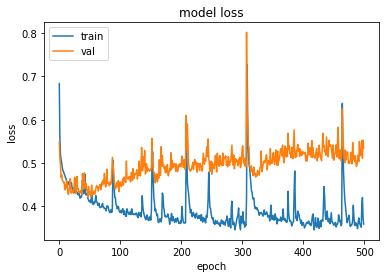

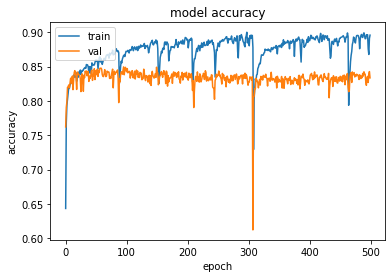

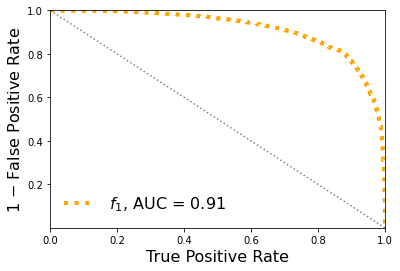

313/313 [==============================] - 1s 4ms/step - loss: 0.5354 - acc: 0.8302 - f1_m: 0.4751 - precision_m: 0.4998 - recall_m: 0.4533
Test ROC-AUC: 0.9145196800000002
Test loss: 0.5354071855545044
Test accuracy: 0.8302000164985657
Test f1: 0.47505342960357666
Test precision: 0.4998224973678589
Test recall: 0.45327475666999817
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 1.0817 - acc: 0.5551 - f1_m: 0.5686 - precision_m: 0.5488 - recall_m: 0.6133 - val_loss: 0.5583 - val_acc: 0.7702 - val_f1_m: 0.7793 - val_precision_m: 0.7392 - val_recall_m: 0.8298
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5909 - acc: 0.7590 - f1_m: 0.7617 - precision_m: 0.7408 - recall_m: 0.7938 - val_loss: 0.4988 - val_acc: 0.8055 - val_f1_m: 0.8118 - val_precision_m: 0.7

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4622 - acc: 0.8325 - f1_m: 0.8366 - precision_m: 0.8190 - recall_m: 0.8630 - val_loss: 0.4382 - val_acc: 0.8395 - val_f1_m: 0.8377 - val_precision_m: 0.8347 - val_recall_m: 0.8450
Epoch 32/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4700 - acc: 0.8256 - f1_m: 0.8260 - precision_m: 0.8140 - recall_m: 0.8476 - val_loss: 0.4459 - val_acc: 0.8347 - val_f1_m: 0.8429 - val_precision_m: 0.7913 - val_recall_m: 0.9062
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4692 - acc: 0.8247 - f1_m: 0.8280 - precision_m: 0.8152 - recall_m: 0.8526 - val_loss: 0.4382 - val_acc: 0.8368 - val_f1_m: 0.8320 - val_precision_m: 0.8427 - val_recall_m: 0.8268
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4626 - acc: 0.8306 - f1_m: 0.8325 - precision_m: 0.8187 - recall_m: 0.8535 - val_loss: 0.4618 - val_acc: 0.8383 - val_f1_m: 0.8338 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4362 - acc: 0.8404 - f1_m: 0.8396 - precision_m: 0.8288 - recall_m: 0.8577 - val_loss: 0.4480 - val_acc: 0.8398 - val_f1_m: 0.8311 - val_precision_m: 0.8668 - val_recall_m: 0.8027
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4367 - acc: 0.8388 - f1_m: 0.8403 - precision_m: 0.8304 - recall_m: 0.8602 - val_loss: 0.4561 - val_acc: 0.8340 - val_f1_m: 0.8253 - val_precision_m: 0.8556 - val_recall_m: 0.8013
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4470 - acc: 0.8402 - f1_m: 0.8416 - precision_m: 0.8252 - recall_m: 0.8660 - val_loss: 0.4204 - val_acc: 0.8495 - val_f1_m: 0.8536 - val_precision_m: 0.8208 - val_recall_m: 0.8940
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4464 - acc: 0.8370 - f1_m: 0.8404 - precision_m: 0.8241 - recall_m: 0.8672 - val_loss: 0.4171 - val_acc: 0.8480 - val_f1_m: 0.8505 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4369 - acc: 0.8408 - f1_m: 0.8423 - precision_m: 0.8248 - recall_m: 0.8692 - val_loss: 0.4366 - val_acc: 0.8207 - val_f1_m: 0.8396 - val_precision_m: 0.7501 - val_recall_m: 0.9590
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4453 - acc: 0.8377 - f1_m: 0.8412 - precision_m: 0.8215 - recall_m: 0.8700 - val_loss: 0.4141 - val_acc: 0.8493 - val_f1_m: 0.8524 - val_precision_m: 0.8250 - val_recall_m: 0.8863
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4689 - acc: 0.8233 - f1_m: 0.8296 - precision_m: 0.8083 - recall_m: 0.8638 - val_loss: 0.4117 - val_acc: 0.8537 - val_f1_m: 0.8540 - val_precision_m: 0.8418 - val_recall_m: 0.8715
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4319 - acc: 0.8457 - f1_m: 0.8469 - precision_m: 0.8321 - recall_m: 0.8701 - val_loss: 0.4070 - val_acc: 0.8542 - val_f1_m: 0.8570 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4327 - acc: 0.8419 - f1_m: 0.8426 - precision_m: 0.8290 - recall_m: 0.8644 - val_loss: 0.4116 - val_acc: 0.8520 - val_f1_m: 0.8499 - val_precision_m: 0.8501 - val_recall_m: 0.8541
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4557 - acc: 0.8332 - f1_m: 0.8352 - precision_m: 0.8229 - recall_m: 0.8585 - val_loss: 0.4107 - val_acc: 0.8523 - val_f1_m: 0.8503 - val_precision_m: 0.8494 - val_recall_m: 0.8563
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4368 - acc: 0.8430 - f1_m: 0.8463 - precision_m: 0.8308 - recall_m: 0.8717 - val_loss: 0.4026 - val_acc: 0.8495 - val_f1_m: 0.8524 - val_precision_m: 0.8258 - val_recall_m: 0.8858
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4272 - acc: 0.8430 - f1_m: 0.8456 - precision_m: 0.8300 - recall_m: 0.8708 - val_loss: 0.4468 - val_acc: 0.8420 - val_f1_m: 0.8355 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4431 - acc: 0.8365 - f1_m: 0.8403 - precision_m: 0.8198 - recall_m: 0.8724 - val_loss: 0.4398 - val_acc: 0.8348 - val_f1_m: 0.8227 - val_precision_m: 0.8765 - val_recall_m: 0.7798
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4384 - acc: 0.8434 - f1_m: 0.8441 - precision_m: 0.8290 - recall_m: 0.8677 - val_loss: 0.4351 - val_acc: 0.8463 - val_f1_m: 0.8441 - val_precision_m: 0.8423 - val_recall_m: 0.8514
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4383 - acc: 0.8415 - f1_m: 0.8458 - precision_m: 0.8267 - recall_m: 0.8740 - val_loss: 0.3959 - val_acc: 0.8567 - val_f1_m: 0.8606 - val_precision_m: 0.8273 - val_recall_m: 0.9015
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4326 - acc: 0.8400 - f1_m: 0.8426 - precision_m: 0.8245 - recall_m: 0.8710 - val_loss: 0.4472 - val_acc: 0.8273 - val_f1_m: 0.8104 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4428 - acc: 0.8390 - f1_m: 0.8412 - precision_m: 0.8201 - recall_m: 0.8717 - val_loss: 0.4040 - val_acc: 0.8515 - val_f1_m: 0.8582 - val_precision_m: 0.8099 - val_recall_m: 0.9173
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4258 - acc: 0.8463 - f1_m: 0.8488 - precision_m: 0.8307 - recall_m: 0.8743 - val_loss: 0.4227 - val_acc: 0.8515 - val_f1_m: 0.8515 - val_precision_m: 0.8405 - val_recall_m: 0.8676
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4309 - acc: 0.8469 - f1_m: 0.8467 - precision_m: 0.8298 - recall_m: 0.8701 - val_loss: 0.4192 - val_acc: 0.8525 - val_f1_m: 0.8520 - val_precision_m: 0.8449 - val_recall_m: 0.8641
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4299 - acc: 0.8465 - f1_m: 0.8506 - precision_m: 0.8316 - recall_m: 0.8775 - val_loss: 0.4097 - val_acc: 0.8462 - val_f1_m: 0.8555 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4315 - acc: 0.8438 - f1_m: 0.8474 - precision_m: 0.8260 - recall_m: 0.8778 - val_loss: 0.4296 - val_acc: 0.8443 - val_f1_m: 0.8357 - val_precision_m: 0.8711 - val_recall_m: 0.8078
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4363 - acc: 0.8391 - f1_m: 0.8416 - precision_m: 0.8238 - recall_m: 0.8684 - val_loss: 0.4119 - val_acc: 0.8493 - val_f1_m: 0.8472 - val_precision_m: 0.8483 - val_recall_m: 0.8509
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4853 - acc: 0.8164 - f1_m: 0.8224 - precision_m: 0.7941 - recall_m: 0.8685 - val_loss: 0.4141 - val_acc: 0.8372 - val_f1_m: 0.8502 - val_precision_m: 0.7765 - val_recall_m: 0.9445
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4265 - acc: 0.8447 - f1_m: 0.8476 - precision_m: 0.8252 - recall_m: 0.8784 - val_loss: 0.4082 - val_acc: 0.8507 - val_f1_m: 0.8553 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4228 - acc: 0.8464 - f1_m: 0.8499 - precision_m: 0.8313 - recall_m: 0.8756 - val_loss: 0.3993 - val_acc: 0.8520 - val_f1_m: 0.8591 - val_precision_m: 0.8112 - val_recall_m: 0.9182
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4267 - acc: 0.8450 - f1_m: 0.8475 - precision_m: 0.8291 - recall_m: 0.8749 - val_loss: 0.4268 - val_acc: 0.8425 - val_f1_m: 0.8360 - val_precision_m: 0.8610 - val_recall_m: 0.8172
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4393 - acc: 0.8430 - f1_m: 0.8425 - precision_m: 0.8272 - recall_m: 0.8680 - val_loss: 0.4012 - val_acc: 0.8543 - val_f1_m: 0.8547 - val_precision_m: 0.8412 - val_recall_m: 0.8731
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4249 - acc: 0.8471 - f1_m: 0.8501 - precision_m: 0.8324 - recall_m: 0.8749 - val_loss: 0.4354 - val_acc: 0.8310 - val_f1_m: 0.8470 - val_precision_m: 

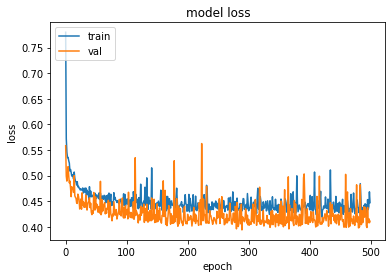

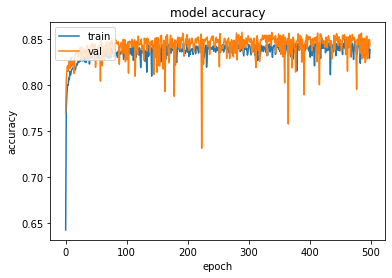

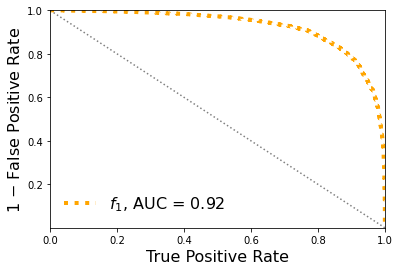

313/313 [==============================] - 1s 4ms/step - loss: 0.4214 - acc: 0.8404 - f1_m: 0.4770 - precision_m: 0.5003 - recall_m: 0.4569
Test ROC-AUC: 0.92493008
Test loss: 0.4213613271713257
Test accuracy: 0.840399980545044
Test f1: 0.4770415723323822
Test precision: 0.5002662539482117
Test recall: 0.4568690061569214
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 69ms/step - loss: 1.0416 - acc: 0.5838 - f1_m: 0.5136 - precision_m: 0.5758 - recall_m: 0.4996 - val_loss: 0.5677 - val_acc: 0.7763 - val_f1_m: 0.7815 - val_precision_m: 0.7572 - val_recall_m: 0.8109
Epoch 2/500
188/188 [==============================] - 12s 66ms/step - loss: 0.5904 - acc: 0.7685 - f1_m: 0.7665 - precision_m: 0.7694 - recall_m: 0.7704 - val_loss: 0.5137 - val_acc: 0.8053 - val_f1_m: 0.7977 - val_precision_m: 0.8230 - val_

Epoch 31/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4437 - acc: 0.8458 - f1_m: 0.8450 - precision_m: 0.8509 - recall_m: 0.8443 - val_loss: 0.4337 - val_acc: 0.8418 - val_f1_m: 0.8383 - val_precision_m: 0.8483 - val_recall_m: 0.8314
Epoch 32/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4456 - acc: 0.8455 - f1_m: 0.8429 - precision_m: 0.8487 - recall_m: 0.8428 - val_loss: 0.4669 - val_acc: 0.8083 - val_f1_m: 0.7837 - val_precision_m: 0.8885 - val_recall_m: 0.7049
Epoch 33/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4438 - acc: 0.8473 - f1_m: 0.8448 - precision_m: 0.8545 - recall_m: 0.8416 - val_loss: 0.4399 - val_acc: 0.8383 - val_f1_m: 0.8319 - val_precision_m: 0.8590 - val_recall_m: 0.8095
Epoch 34/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4398 - acc: 0.8462 - f1_m: 0.8458 - precision_m: 0.8493 - recall_m: 0.8465 - val_loss: 0.4354 - val_acc: 0.8463 - val_f1_m: 0.8460 - val_pre

188/188 [==============================] - 13s 67ms/step - loss: 0.4123 - acc: 0.8596 - f1_m: 0.8595 - precision_m: 0.8613 - recall_m: 0.8607 - val_loss: 0.4113 - val_acc: 0.8458 - val_f1_m: 0.8433 - val_precision_m: 0.8495 - val_recall_m: 0.8397
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4329 - acc: 0.8460 - f1_m: 0.8444 - precision_m: 0.8550 - recall_m: 0.8426 - val_loss: 0.4337 - val_acc: 0.8308 - val_f1_m: 0.8161 - val_precision_m: 0.8858 - val_recall_m: 0.7592
Epoch 95/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4227 - acc: 0.8530 - f1_m: 0.8523 - precision_m: 0.8613 - recall_m: 0.8506 - val_loss: 0.4295 - val_acc: 0.8285 - val_f1_m: 0.8160 - val_precision_m: 0.8708 - val_recall_m: 0.7710
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4172 - acc: 0.8556 - f1_m: 0.8536 - precision_m: 0.8633 - recall_m: 0.8490 - val_loss: 0.4340 - val_acc: 0.8327 - val_f1_m: 0.8236 - val_precision_m: 0.8

188/188 [==============================] - 12s 66ms/step - loss: 0.3990 - acc: 0.8656 - f1_m: 0.8630 - precision_m: 0.8657 - recall_m: 0.8646 - val_loss: 0.4212 - val_acc: 0.8408 - val_f1_m: 0.8345 - val_precision_m: 0.8604 - val_recall_m: 0.8129
Epoch 156/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4112 - acc: 0.8585 - f1_m: 0.8562 - precision_m: 0.8622 - recall_m: 0.8549 - val_loss: 0.4272 - val_acc: 0.8335 - val_f1_m: 0.8225 - val_precision_m: 0.8722 - val_recall_m: 0.7806
Epoch 157/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4276 - acc: 0.8482 - f1_m: 0.8484 - precision_m: 0.8509 - recall_m: 0.8529 - val_loss: 0.4075 - val_acc: 0.8530 - val_f1_m: 0.8513 - val_precision_m: 0.8547 - val_recall_m: 0.8506
Epoch 158/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4003 - acc: 0.8621 - f1_m: 0.8591 - precision_m: 0.8687 - recall_m: 0.8541 - val_loss: 0.4458 - val_acc: 0.8190 - val_f1_m: 0.7982 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4076 - acc: 0.8579 - f1_m: 0.8590 - precision_m: 0.8593 - recall_m: 0.8651 - val_loss: 0.4193 - val_acc: 0.8367 - val_f1_m: 0.8265 - val_precision_m: 0.8750 - val_recall_m: 0.7856
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4005 - acc: 0.8623 - f1_m: 0.8614 - precision_m: 0.8639 - recall_m: 0.8623 - val_loss: 0.4575 - val_acc: 0.8357 - val_f1_m: 0.8492 - val_precision_m: 0.7784 - val_recall_m: 0.9366
Epoch 219/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4535 - acc: 0.8293 - f1_m: 0.8209 - precision_m: 0.8451 - recall_m: 0.8140 - val_loss: 0.4198 - val_acc: 0.8442 - val_f1_m: 0.8405 - val_precision_m: 0.8529 - val_recall_m: 0.8312
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3996 - acc: 0.8672 - f1_m: 0.8669 - precision_m: 0.8676 - recall_m: 0.8697 - val_loss: 0.4551 - val_acc: 0.8347 - val_f1_m: 0.8489 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4182 - acc: 0.8511 - f1_m: 0.8479 - precision_m: 0.8651 - recall_m: 0.8390 - val_loss: 0.4729 - val_acc: 0.7942 - val_f1_m: 0.7569 - val_precision_m: 0.9123 - val_recall_m: 0.6501
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4347 - acc: 0.8461 - f1_m: 0.8427 - precision_m: 0.8580 - recall_m: 0.8347 - val_loss: 0.4136 - val_acc: 0.8525 - val_f1_m: 0.8526 - val_precision_m: 0.8467 - val_recall_m: 0.8613
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4190 - acc: 0.8571 - f1_m: 0.8535 - precision_m: 0.8593 - recall_m: 0.8527 - val_loss: 0.4077 - val_acc: 0.8447 - val_f1_m: 0.8396 - val_precision_m: 0.8611 - val_recall_m: 0.8219
Epoch 282/500
188/188 [==============================] - 12s 67ms/step - loss: 0.4011 - acc: 0.8634 - f1_m: 0.8622 - precision_m: 0.8684 - recall_m: 0.8594 - val_loss: 0.4163 - val_acc: 0.8380 - val_f1_m: 0.8297 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4045 - acc: 0.8628 - f1_m: 0.8630 - precision_m: 0.8651 - recall_m: 0.8651 - val_loss: 0.4273 - val_acc: 0.8440 - val_f1_m: 0.8430 - val_precision_m: 0.8416 - val_recall_m: 0.8469
Epoch 342/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4096 - acc: 0.8597 - f1_m: 0.8582 - precision_m: 0.8546 - recall_m: 0.8655 - val_loss: 0.4109 - val_acc: 0.8540 - val_f1_m: 0.8595 - val_precision_m: 0.8227 - val_recall_m: 0.9025
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3939 - acc: 0.8687 - f1_m: 0.8692 - precision_m: 0.8681 - recall_m: 0.8744 - val_loss: 0.4188 - val_acc: 0.8477 - val_f1_m: 0.8462 - val_precision_m: 0.8490 - val_recall_m: 0.8464
Epoch 344/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4122 - acc: 0.8567 - f1_m: 0.8540 - precision_m: 0.8621 - recall_m: 0.8521 - val_loss: 0.4237 - val_acc: 0.8327 - val_f1_m: 0.8199 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4108 - acc: 0.8613 - f1_m: 0.8606 - precision_m: 0.8583 - recall_m: 0.8696 - val_loss: 0.4288 - val_acc: 0.8250 - val_f1_m: 0.8082 - val_precision_m: 0.8881 - val_recall_m: 0.7442
Epoch 404/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3986 - acc: 0.8637 - f1_m: 0.8617 - precision_m: 0.8662 - recall_m: 0.8618 - val_loss: 0.3988 - val_acc: 0.8518 - val_f1_m: 0.8502 - val_precision_m: 0.8512 - val_recall_m: 0.8517
Epoch 405/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4031 - acc: 0.8566 - f1_m: 0.8546 - precision_m: 0.8580 - recall_m: 0.8564 - val_loss: 0.4008 - val_acc: 0.8457 - val_f1_m: 0.8414 - val_precision_m: 0.8592 - val_recall_m: 0.8270
Epoch 406/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4155 - acc: 0.8549 - f1_m: 0.8535 - precision_m: 0.8542 - recall_m: 0.8580 - val_loss: 0.4237 - val_acc: 0.8498 - val_f1_m: 0.8588 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4059 - acc: 0.8591 - f1_m: 0.8562 - precision_m: 0.8665 - recall_m: 0.8519 - val_loss: 0.4077 - val_acc: 0.8457 - val_f1_m: 0.8413 - val_precision_m: 0.8594 - val_recall_m: 0.8267
Epoch 466/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4026 - acc: 0.8590 - f1_m: 0.8579 - precision_m: 0.8610 - recall_m: 0.8581 - val_loss: 0.4185 - val_acc: 0.8345 - val_f1_m: 0.8247 - val_precision_m: 0.8704 - val_recall_m: 0.7865
Epoch 467/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3991 - acc: 0.8630 - f1_m: 0.8634 - precision_m: 0.8685 - recall_m: 0.8622 - val_loss: 0.4242 - val_acc: 0.8445 - val_f1_m: 0.8495 - val_precision_m: 0.8168 - val_recall_m: 0.8876
Epoch 468/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4638 - acc: 0.8350 - f1_m: 0.8297 - precision_m: 0.8435 - recall_m: 0.8258 - val_loss: 0.4114 - val_acc: 0.8482 - val_f1_m: 0.8474 - val_precision_m: 

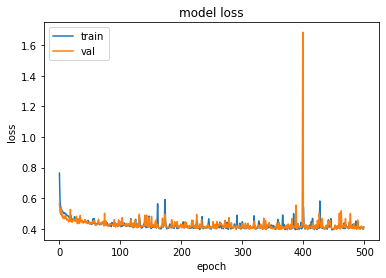

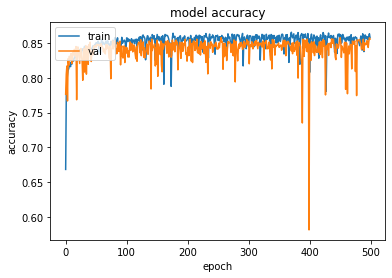

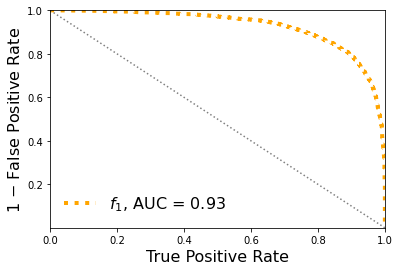

313/313 [==============================] - 1s 4ms/step - loss: 0.4223 - acc: 0.8477 - f1_m: 0.4670 - precision_m: 0.5003 - recall_m: 0.4390
Test ROC-AUC: 0.92630536
Test loss: 0.42227959632873535
Test accuracy: 0.8476999998092651
Test f1: 0.46696963906288147
Test precision: 0.5002662539482117
Test recall: 0.4389975965023041
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.001
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 142ms/step - loss: 1.1895 - acc: 0.5338 - f1_m: 0.5123 - precision_m: 0.5415 - recall_m: 0.5185 - val_loss: 0.6801 - val_acc: 0.7227 - val_f1_m: 0.6691 - val_precision_m: 0.8165 - val_recall_m: 0.5687
Epoch 2/500
94/94 [==============================] - 13s 135ms/step - loss: 0.6686 - acc: 0.7084 - f1_m: 0.7016 - precision_m: 0.7112 - recall_m: 0.6998 - val_loss: 0.5615 - val_acc: 0.7823 - val_f1_m: 0.7885 - val_precision_m: 0.7604 - val

Epoch 31/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4537 - acc: 0.8434 - f1_m: 0.8410 - precision_m: 0.8560 - recall_m: 0.8311 - val_loss: 0.4457 - val_acc: 0.8357 - val_f1_m: 0.8290 - val_precision_m: 0.8501 - val_recall_m: 0.8106
Epoch 32/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4488 - acc: 0.8472 - f1_m: 0.8425 - precision_m: 0.8612 - recall_m: 0.8290 - val_loss: 0.4502 - val_acc: 0.8435 - val_f1_m: 0.8436 - val_precision_m: 0.8322 - val_recall_m: 0.8566
Epoch 33/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4498 - acc: 0.8479 - f1_m: 0.8437 - precision_m: 0.8551 - recall_m: 0.8357 - val_loss: 0.4465 - val_acc: 0.8432 - val_f1_m: 0.8390 - val_precision_m: 0.8505 - val_recall_m: 0.8289
Epoch 34/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4458 - acc: 0.8486 - f1_m: 0.8453 - precision_m: 0.8602 - recall_m: 0.8354 - val_loss: 0.4470 - val_acc: 0.8333 - val_f1_m: 0.8227 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4275 - acc: 0.8588 - f1_m: 0.8570 - precision_m: 0.8719 - recall_m: 0.8469 - val_loss: 0.4384 - val_acc: 0.8430 - val_f1_m: 0.8368 - val_precision_m: 0.8610 - val_recall_m: 0.8154
Epoch 64/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4059 - acc: 0.8693 - f1_m: 0.8672 - precision_m: 0.8801 - recall_m: 0.8565 - val_loss: 0.4390 - val_acc: 0.8383 - val_f1_m: 0.8270 - val_precision_m: 0.8758 - val_recall_m: 0.7848
Epoch 65/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4105 - acc: 0.8677 - f1_m: 0.8650 - precision_m: 0.8781 - recall_m: 0.8553 - val_loss: 0.4371 - val_acc: 0.8475 - val_f1_m: 0.8458 - val_precision_m: 0.8470 - val_recall_m: 0.8461
Epoch 66/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4045 - acc: 0.8720 - f1_m: 0.8727 - precision_m: 0.8790 - recall_m: 0.8685 - val_loss: 0.5198 - val_acc: 0.7810 - val_f1_m: 0.7343 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3864 - acc: 0.8825 - f1_m: 0.8831 - precision_m: 0.8919 - recall_m: 0.8761 - val_loss: 0.4389 - val_acc: 0.8523 - val_f1_m: 0.8506 - val_precision_m: 0.8503 - val_recall_m: 0.8520
Epoch 96/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3797 - acc: 0.8868 - f1_m: 0.8850 - precision_m: 0.8936 - recall_m: 0.8787 - val_loss: 0.4518 - val_acc: 0.8495 - val_f1_m: 0.8567 - val_precision_m: 0.8073 - val_recall_m: 0.9144
Epoch 97/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3895 - acc: 0.8806 - f1_m: 0.8814 - precision_m: 0.8849 - recall_m: 0.8803 - val_loss: 0.4561 - val_acc: 0.8498 - val_f1_m: 0.8540 - val_precision_m: 0.8151 - val_recall_m: 0.8983
Epoch 98/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4021 - acc: 0.8747 - f1_m: 0.8742 - precision_m: 0.8835 - recall_m: 0.8692 - val_loss: 0.4487 - val_acc: 0.8473 - val_f1_m: 0.8523 - val_precisi

94/94 [==============================] - 13s 136ms/step - loss: 0.3901 - acc: 0.8671 - f1_m: 0.8628 - precision_m: 0.8743 - recall_m: 0.8534 - val_loss: 0.4088 - val_acc: 0.8470 - val_f1_m: 0.8410 - val_precision_m: 0.8604 - val_recall_m: 0.8237
Epoch 158/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3785 - acc: 0.8782 - f1_m: 0.8757 - precision_m: 0.8865 - recall_m: 0.8676 - val_loss: 0.4266 - val_acc: 0.8573 - val_f1_m: 0.8641 - val_precision_m: 0.8192 - val_recall_m: 0.9154
Epoch 159/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3769 - acc: 0.8744 - f1_m: 0.8727 - precision_m: 0.8833 - recall_m: 0.8663 - val_loss: 0.4135 - val_acc: 0.8545 - val_f1_m: 0.8543 - val_precision_m: 0.8459 - val_recall_m: 0.8646
Epoch 160/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3782 - acc: 0.8781 - f1_m: 0.8773 - precision_m: 0.8840 - recall_m: 0.8736 - val_loss: 0.4172 - val_acc: 0.8428 - val_f1_m: 0.8323 - val_precision_m: 0.87

94/94 [==============================] - 13s 135ms/step - loss: 0.3694 - acc: 0.8902 - f1_m: 0.8884 - precision_m: 0.8960 - recall_m: 0.8827 - val_loss: 0.4329 - val_acc: 0.8492 - val_f1_m: 0.8474 - val_precision_m: 0.8453 - val_recall_m: 0.8509
Epoch 220/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3822 - acc: 0.8818 - f1_m: 0.8809 - precision_m: 0.8904 - recall_m: 0.8745 - val_loss: 0.4383 - val_acc: 0.8383 - val_f1_m: 0.8272 - val_precision_m: 0.8790 - val_recall_m: 0.7824
Epoch 221/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3898 - acc: 0.8821 - f1_m: 0.8804 - precision_m: 0.8899 - recall_m: 0.8745 - val_loss: 0.4327 - val_acc: 0.8543 - val_f1_m: 0.8508 - val_precision_m: 0.8538 - val_recall_m: 0.8488
Epoch 222/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3596 - acc: 0.8952 - f1_m: 0.8934 - precision_m: 0.9010 - recall_m: 0.8871 - val_loss: 0.4264 - val_acc: 0.8478 - val_f1_m: 0.8423 - val_precision_m: 0.86

94/94 [==============================] - 13s 136ms/step - loss: 0.3609 - acc: 0.8879 - f1_m: 0.8875 - precision_m: 0.8967 - recall_m: 0.8802 - val_loss: 0.4184 - val_acc: 0.8538 - val_f1_m: 0.8528 - val_precision_m: 0.8485 - val_recall_m: 0.8585
Epoch 282/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3515 - acc: 0.8912 - f1_m: 0.8896 - precision_m: 0.8969 - recall_m: 0.8836 - val_loss: 0.4188 - val_acc: 0.8393 - val_f1_m: 0.8276 - val_precision_m: 0.8771 - val_recall_m: 0.7848
Epoch 283/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3536 - acc: 0.8920 - f1_m: 0.8891 - precision_m: 0.9004 - recall_m: 0.8805 - val_loss: 0.4155 - val_acc: 0.8477 - val_f1_m: 0.8420 - val_precision_m: 0.8637 - val_recall_m: 0.8228
Epoch 284/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3605 - acc: 0.8871 - f1_m: 0.8846 - precision_m: 0.8984 - recall_m: 0.8730 - val_loss: 0.4248 - val_acc: 0.8545 - val_f1_m: 0.8556 - val_precision_m: 0.83

94/94 [==============================] - 13s 134ms/step - loss: 0.3488 - acc: 0.8972 - f1_m: 0.8959 - precision_m: 0.9069 - recall_m: 0.8870 - val_loss: 0.4279 - val_acc: 0.8527 - val_f1_m: 0.8514 - val_precision_m: 0.8472 - val_recall_m: 0.8569
Epoch 344/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3676 - acc: 0.8882 - f1_m: 0.8871 - precision_m: 0.8979 - recall_m: 0.8782 - val_loss: 0.4197 - val_acc: 0.8500 - val_f1_m: 0.8468 - val_precision_m: 0.8508 - val_recall_m: 0.8443
Epoch 345/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3640 - acc: 0.8909 - f1_m: 0.8893 - precision_m: 0.8987 - recall_m: 0.8819 - val_loss: 0.4383 - val_acc: 0.8312 - val_f1_m: 0.8154 - val_precision_m: 0.8901 - val_recall_m: 0.7538
Epoch 346/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3615 - acc: 0.8892 - f1_m: 0.8887 - precision_m: 0.9012 - recall_m: 0.8782 - val_loss: 0.4313 - val_acc: 0.8382 - val_f1_m: 0.8284 - val_precision_m: 0.86

94/94 [==============================] - 13s 137ms/step - loss: 0.3680 - acc: 0.8856 - f1_m: 0.8829 - precision_m: 0.8950 - recall_m: 0.8726 - val_loss: 0.4110 - val_acc: 0.8538 - val_f1_m: 0.8532 - val_precision_m: 0.8481 - val_recall_m: 0.8599
Epoch 406/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3627 - acc: 0.8877 - f1_m: 0.8858 - precision_m: 0.8974 - recall_m: 0.8770 - val_loss: 0.4121 - val_acc: 0.8463 - val_f1_m: 0.8403 - val_precision_m: 0.8597 - val_recall_m: 0.8227
Epoch 407/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3656 - acc: 0.8841 - f1_m: 0.8809 - precision_m: 0.8955 - recall_m: 0.8683 - val_loss: 0.4188 - val_acc: 0.8407 - val_f1_m: 0.8310 - val_precision_m: 0.8742 - val_recall_m: 0.7936
Epoch 408/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3570 - acc: 0.8871 - f1_m: 0.8846 - precision_m: 0.8931 - recall_m: 0.8776 - val_loss: 0.4136 - val_acc: 0.8550 - val_f1_m: 0.8539 - val_precision_m: 0.84

94/94 [==============================] - 13s 136ms/step - loss: 0.3608 - acc: 0.8904 - f1_m: 0.8896 - precision_m: 0.8984 - recall_m: 0.8834 - val_loss: 0.4240 - val_acc: 0.8518 - val_f1_m: 0.8490 - val_precision_m: 0.8558 - val_recall_m: 0.8438
Epoch 468/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3576 - acc: 0.8879 - f1_m: 0.8850 - precision_m: 0.9007 - recall_m: 0.8716 - val_loss: 0.4356 - val_acc: 0.8468 - val_f1_m: 0.8500 - val_precision_m: 0.8240 - val_recall_m: 0.8789
Epoch 469/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3716 - acc: 0.8861 - f1_m: 0.8828 - precision_m: 0.9001 - recall_m: 0.8698 - val_loss: 0.4292 - val_acc: 0.8470 - val_f1_m: 0.8419 - val_precision_m: 0.8589 - val_recall_m: 0.8267
Epoch 470/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3559 - acc: 0.8907 - f1_m: 0.8899 - precision_m: 0.9009 - recall_m: 0.8808 - val_loss: 0.4198 - val_acc: 0.8482 - val_f1_m: 0.8447 - val_precision_m: 0.85

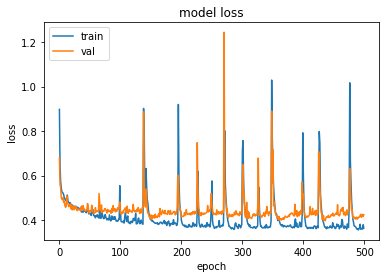

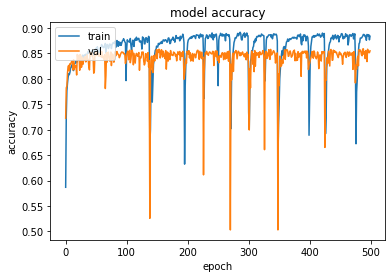

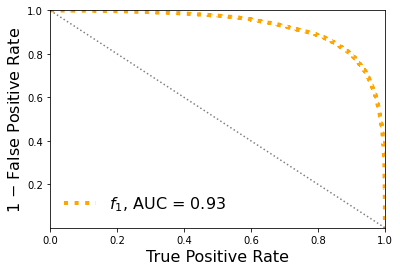

313/313 [==============================] - 1s 4ms/step - loss: 0.4320 - acc: 0.8506 - f1_m: 0.4662 - precision_m: 0.5003 - recall_m: 0.4377
Test ROC-AUC: 0.92817134
Test loss: 0.4319694936275482
Test accuracy: 0.850600004196167
Test f1: 0.4661790132522583
Test precision: 0.5002662539482117
Test recall: 0.43769967555999756
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 1.0061 - acc: 0.5203 - f1_m: 0.4899 - precision_m: 0.5289 - recall_m: 0.5684 - val_loss: 0.5904 - val_acc: 0.7617 - val_f1_m: 0.7667 - val_precision_m: 0.7408 - val_recall_m: 0.8008
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.6162 - acc: 0.6944 - f1_m: 0.6634 - precision_m: 0.7378 - recall_m: 0.6158 - val_loss: 0.5141 - val_acc: 0.7938 - val_f1_m: 0.8010 - val_precision_m: 0.7642 - val

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4433 - acc: 0.8402 - f1_m: 0.8444 - precision_m: 0.8291 - recall_m: 0.8673 - val_loss: 0.4323 - val_acc: 0.8390 - val_f1_m: 0.8429 - val_precision_m: 0.8110 - val_recall_m: 0.8824
Epoch 32/500
375/375 [==============================] - 13s 35ms/step - loss: 0.4307 - acc: 0.8451 - f1_m: 0.8464 - precision_m: 0.8333 - recall_m: 0.8649 - val_loss: 0.4210 - val_acc: 0.8442 - val_f1_m: 0.8416 - val_precision_m: 0.8444 - val_recall_m: 0.8442
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4382 - acc: 0.8410 - f1_m: 0.8418 - precision_m: 0.8295 - recall_m: 0.8617 - val_loss: 0.4308 - val_acc: 0.8437 - val_f1_m: 0.8411 - val_precision_m: 0.8425 - val_recall_m: 0.8449
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4367 - acc: 0.8397 - f1_m: 0.8425 - precision_m: 0.8254 - recall_m: 0.8660 - val_loss: 0.4337 - val_acc: 0.8377 - val_f1_m: 0.8425 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4168 - acc: 0.8465 - f1_m: 0.8482 - precision_m: 0.8307 - recall_m: 0.8718 - val_loss: 0.4189 - val_acc: 0.8430 - val_f1_m: 0.8470 - val_precision_m: 0.8158 - val_recall_m: 0.8853
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4224 - acc: 0.8464 - f1_m: 0.8482 - precision_m: 0.8302 - recall_m: 0.8728 - val_loss: 0.4101 - val_acc: 0.8437 - val_f1_m: 0.8427 - val_precision_m: 0.8399 - val_recall_m: 0.8510
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4211 - acc: 0.8454 - f1_m: 0.8455 - precision_m: 0.8302 - recall_m: 0.8677 - val_loss: 0.4190 - val_acc: 0.8490 - val_f1_m: 0.8531 - val_precision_m: 0.8216 - val_recall_m: 0.8918
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4199 - acc: 0.8442 - f1_m: 0.8448 - precision_m: 0.8297 - recall_m: 0.8679 - val_loss: 0.4141 - val_acc: 0.8415 - val_f1_m: 0.8354 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4590 - acc: 0.8404 - f1_m: 0.8370 - precision_m: 0.8314 - recall_m: 0.8520 - val_loss: 0.4442 - val_acc: 0.8222 - val_f1_m: 0.8069 - val_precision_m: 0.8715 - val_recall_m: 0.7565
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4285 - acc: 0.8454 - f1_m: 0.8466 - precision_m: 0.8410 - recall_m: 0.8586 - val_loss: 0.4204 - val_acc: 0.8482 - val_f1_m: 0.8475 - val_precision_m: 0.8394 - val_recall_m: 0.8597
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4263 - acc: 0.8442 - f1_m: 0.8443 - precision_m: 0.8343 - recall_m: 0.8617 - val_loss: 0.4191 - val_acc: 0.8325 - val_f1_m: 0.8178 - val_precision_m: 0.8819 - val_recall_m: 0.7669
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4167 - acc: 0.8535 - f1_m: 0.8527 - precision_m: 0.8426 - recall_m: 0.8689 - val_loss: 0.4113 - val_acc: 0.8428 - val_f1_m: 0.8419 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4479 - acc: 0.8239 - f1_m: 0.8266 - precision_m: 0.8096 - recall_m: 0.8534 - val_loss: 0.4409 - val_acc: 0.8202 - val_f1_m: 0.8088 - val_precision_m: 0.8481 - val_recall_m: 0.7780
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4483 - acc: 0.8248 - f1_m: 0.8266 - precision_m: 0.8132 - recall_m: 0.8485 - val_loss: 0.4586 - val_acc: 0.8275 - val_f1_m: 0.8339 - val_precision_m: 0.7929 - val_recall_m: 0.8846
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4468 - acc: 0.8290 - f1_m: 0.8310 - precision_m: 0.8201 - recall_m: 0.8488 - val_loss: 0.4472 - val_acc: 0.8288 - val_f1_m: 0.8273 - val_precision_m: 0.8237 - val_recall_m: 0.8356
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4480 - acc: 0.8271 - f1_m: 0.8295 - precision_m: 0.8136 - recall_m: 0.8520 - val_loss: 0.4399 - val_acc: 0.8222 - val_f1_m: 0.8120 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4315 - acc: 0.8316 - f1_m: 0.8323 - precision_m: 0.8135 - recall_m: 0.8583 - val_loss: 0.4427 - val_acc: 0.8302 - val_f1_m: 0.8336 - val_precision_m: 0.8048 - val_recall_m: 0.8694
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4375 - acc: 0.8320 - f1_m: 0.8334 - precision_m: 0.8205 - recall_m: 0.8523 - val_loss: 0.4406 - val_acc: 0.8288 - val_f1_m: 0.8310 - val_precision_m: 0.8091 - val_recall_m: 0.8590
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4298 - acc: 0.8367 - f1_m: 0.8389 - precision_m: 0.8227 - recall_m: 0.8612 - val_loss: 0.4391 - val_acc: 0.8270 - val_f1_m: 0.8249 - val_precision_m: 0.8245 - val_recall_m: 0.8297
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5508 - acc: 0.8056 - f1_m: 0.8117 - precision_m: 0.7937 - recall_m: 0.8498 - val_loss: 0.4947 - val_acc: 0.8258 - val_f1_m: 0.8328 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4461 - acc: 0.8272 - f1_m: 0.8277 - precision_m: 0.8144 - recall_m: 0.8500 - val_loss: 0.4480 - val_acc: 0.8267 - val_f1_m: 0.8310 - val_precision_m: 0.8013 - val_recall_m: 0.8677
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4324 - acc: 0.8342 - f1_m: 0.8360 - precision_m: 0.8222 - recall_m: 0.8582 - val_loss: 0.4430 - val_acc: 0.8298 - val_f1_m: 0.8264 - val_precision_m: 0.8284 - val_recall_m: 0.8286
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4311 - acc: 0.8370 - f1_m: 0.8395 - precision_m: 0.8238 - recall_m: 0.8612 - val_loss: 0.4401 - val_acc: 0.8275 - val_f1_m: 0.8280 - val_precision_m: 0.8140 - val_recall_m: 0.8473
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4282 - acc: 0.8376 - f1_m: 0.8391 - precision_m: 0.8257 - recall_m: 0.8595 - val_loss: 0.4446 - val_acc: 0.8282 - val_f1_m: 0.8296 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4414 - acc: 0.8393 - f1_m: 0.8413 - precision_m: 0.8328 - recall_m: 0.8554 - val_loss: 0.4546 - val_acc: 0.8333 - val_f1_m: 0.8347 - val_precision_m: 0.8161 - val_recall_m: 0.8591
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4352 - acc: 0.8401 - f1_m: 0.8414 - precision_m: 0.8281 - recall_m: 0.8612 - val_loss: 0.4536 - val_acc: 0.8257 - val_f1_m: 0.8239 - val_precision_m: 0.8228 - val_recall_m: 0.8299
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4445 - acc: 0.8374 - f1_m: 0.8374 - precision_m: 0.8276 - recall_m: 0.8547 - val_loss: 0.4690 - val_acc: 0.8203 - val_f1_m: 0.8093 - val_precision_m: 0.8506 - val_recall_m: 0.7766
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4436 - acc: 0.8351 - f1_m: 0.8342 - precision_m: 0.8321 - recall_m: 0.8427 - val_loss: 0.4460 - val_acc: 0.8277 - val_f1_m: 0.8316 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4233 - acc: 0.8443 - f1_m: 0.8445 - precision_m: 0.8387 - recall_m: 0.8557 - val_loss: 0.4521 - val_acc: 0.8258 - val_f1_m: 0.8251 - val_precision_m: 0.8199 - val_recall_m: 0.8353
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4288 - acc: 0.8434 - f1_m: 0.8448 - precision_m: 0.8298 - recall_m: 0.8657 - val_loss: 0.4483 - val_acc: 0.8253 - val_f1_m: 0.8215 - val_precision_m: 0.8309 - val_recall_m: 0.8171
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4292 - acc: 0.8409 - f1_m: 0.8412 - precision_m: 0.8309 - recall_m: 0.8573 - val_loss: 0.4627 - val_acc: 0.8190 - val_f1_m: 0.8083 - val_precision_m: 0.8491 - val_recall_m: 0.7754
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4534 - acc: 0.8334 - f1_m: 0.8354 - precision_m: 0.8232 - recall_m: 0.8550 - val_loss: 0.5041 - val_acc: 0.8258 - val_f1_m: 0.8290 - val_precision_m: 

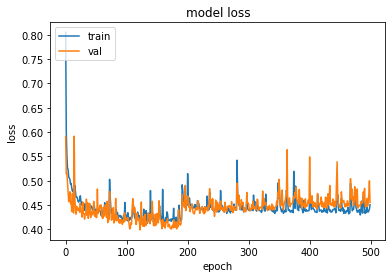

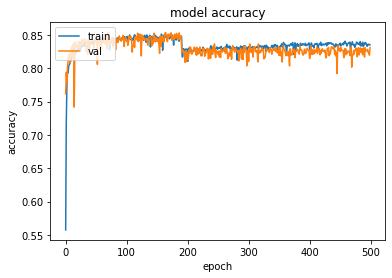

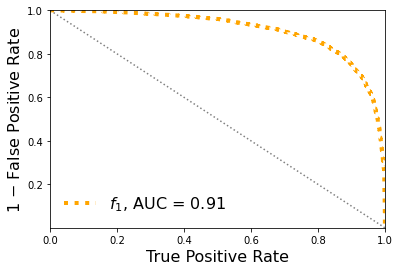

313/313 [==============================] - 1s 4ms/step - loss: 0.4527 - acc: 0.8334 - f1_m: 0.4630 - precision_m: 0.4998 - recall_m: 0.4327
Test ROC-AUC: 0.908612
Test loss: 0.4526596665382385
Test accuracy: 0.8334000110626221
Test f1: 0.4629823863506317
Test precision: 0.4997718036174774
Test recall: 0.43270766735076904
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 69ms/step - loss: 0.7327 - acc: 0.5947 - f1_m: 0.6017 - precision_m: 0.5973 - recall_m: 0.6401 - val_loss: 0.5279 - val_acc: 0.7802 - val_f1_m: 0.8015 - val_precision_m: 0.7259 - val_recall_m: 0.8981
Epoch 2/500
188/188 [==============================] - 13s 67ms/step - loss: 0.5559 - acc: 0.7681 - f1_m: 0.7694 - precision_m: 0.7649 - recall_m: 0.7798 - val_loss: 0.4894 - val_acc: 0.8090 - val_f1_m: 0.8084 - val_precision_m: 0.8044 - val

Epoch 31/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4307 - acc: 0.8426 - f1_m: 0.8455 - precision_m: 0.8295 - recall_m: 0.8663 - val_loss: 0.4497 - val_acc: 0.8248 - val_f1_m: 0.8059 - val_precision_m: 0.8901 - val_recall_m: 0.7401
Epoch 32/500
188/188 [==============================] - 13s 68ms/step - loss: 0.4333 - acc: 0.8357 - f1_m: 0.8391 - precision_m: 0.8219 - recall_m: 0.8631 - val_loss: 0.4097 - val_acc: 0.8478 - val_f1_m: 0.8506 - val_precision_m: 0.8270 - val_recall_m: 0.8783
Epoch 33/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4258 - acc: 0.8467 - f1_m: 0.8480 - precision_m: 0.8318 - recall_m: 0.8703 - val_loss: 0.4369 - val_acc: 0.8373 - val_f1_m: 0.8496 - val_precision_m: 0.7843 - val_recall_m: 0.9298
Epoch 34/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4376 - acc: 0.8381 - f1_m: 0.8427 - precision_m: 0.8259 - recall_m: 0.8676 - val_loss: 0.4229 - val_acc: 0.8405 - val_f1_m: 0.8367 - val_pre

188/188 [==============================] - 12s 66ms/step - loss: 0.4435 - acc: 0.8275 - f1_m: 0.8312 - precision_m: 0.8169 - recall_m: 0.8487 - val_loss: 0.4501 - val_acc: 0.8225 - val_f1_m: 0.8209 - val_precision_m: 0.8232 - val_recall_m: 0.8217
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4663 - acc: 0.8272 - f1_m: 0.8302 - precision_m: 0.8124 - recall_m: 0.8535 - val_loss: 0.4484 - val_acc: 0.8283 - val_f1_m: 0.8258 - val_precision_m: 0.8300 - val_recall_m: 0.8241
Epoch 95/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4424 - acc: 0.8321 - f1_m: 0.8349 - precision_m: 0.8284 - recall_m: 0.8458 - val_loss: 0.4513 - val_acc: 0.8228 - val_f1_m: 0.8332 - val_precision_m: 0.7816 - val_recall_m: 0.8950
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4418 - acc: 0.8332 - f1_m: 0.8360 - precision_m: 0.8198 - recall_m: 0.8565 - val_loss: 0.4438 - val_acc: 0.8272 - val_f1_m: 0.8250 - val_precision_m: 0.8

188/188 [==============================] - 12s 66ms/step - loss: 0.4205 - acc: 0.8542 - f1_m: 0.8550 - precision_m: 0.8446 - recall_m: 0.8704 - val_loss: 0.4724 - val_acc: 0.8257 - val_f1_m: 0.8197 - val_precision_m: 0.8410 - val_recall_m: 0.8027
Epoch 156/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4171 - acc: 0.8553 - f1_m: 0.8554 - precision_m: 0.8415 - recall_m: 0.8731 - val_loss: 0.4687 - val_acc: 0.8260 - val_f1_m: 0.8214 - val_precision_m: 0.8371 - val_recall_m: 0.8095
Epoch 157/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4080 - acc: 0.8612 - f1_m: 0.8621 - precision_m: 0.8529 - recall_m: 0.8741 - val_loss: 0.4645 - val_acc: 0.8285 - val_f1_m: 0.8331 - val_precision_m: 0.8070 - val_recall_m: 0.8642
Epoch 158/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4108 - acc: 0.8578 - f1_m: 0.8595 - precision_m: 0.8432 - recall_m: 0.8797 - val_loss: 0.4671 - val_acc: 0.8233 - val_f1_m: 0.8275 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4185 - acc: 0.8538 - f1_m: 0.8572 - precision_m: 0.8369 - recall_m: 0.8821 - val_loss: 0.4841 - val_acc: 0.8197 - val_f1_m: 0.8240 - val_precision_m: 0.8000 - val_recall_m: 0.8525
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4118 - acc: 0.8534 - f1_m: 0.8572 - precision_m: 0.8359 - recall_m: 0.8826 - val_loss: 0.4836 - val_acc: 0.8208 - val_f1_m: 0.8308 - val_precision_m: 0.7808 - val_recall_m: 0.8907
Epoch 219/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4057 - acc: 0.8596 - f1_m: 0.8631 - precision_m: 0.8415 - recall_m: 0.8894 - val_loss: 0.4781 - val_acc: 0.8198 - val_f1_m: 0.8140 - val_precision_m: 0.8334 - val_recall_m: 0.7985
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4049 - acc: 0.8563 - f1_m: 0.8588 - precision_m: 0.8418 - recall_m: 0.8797 - val_loss: 0.4923 - val_acc: 0.8117 - val_f1_m: 0.8018 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4175 - acc: 0.8585 - f1_m: 0.8590 - precision_m: 0.8438 - recall_m: 0.8782 - val_loss: 0.4848 - val_acc: 0.8212 - val_f1_m: 0.8145 - val_precision_m: 0.8389 - val_recall_m: 0.7948
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4217 - acc: 0.8544 - f1_m: 0.8578 - precision_m: 0.8397 - recall_m: 0.8811 - val_loss: 0.4746 - val_acc: 0.8165 - val_f1_m: 0.8182 - val_precision_m: 0.8040 - val_recall_m: 0.8358
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4195 - acc: 0.8559 - f1_m: 0.8575 - precision_m: 0.8354 - recall_m: 0.8842 - val_loss: 0.4752 - val_acc: 0.8207 - val_f1_m: 0.8256 - val_precision_m: 0.7953 - val_recall_m: 0.8608
Epoch 282/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4179 - acc: 0.8495 - f1_m: 0.8523 - precision_m: 0.8323 - recall_m: 0.8776 - val_loss: 0.4735 - val_acc: 0.8180 - val_f1_m: 0.8218 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3940 - acc: 0.8605 - f1_m: 0.8609 - precision_m: 0.8554 - recall_m: 0.8694 - val_loss: 0.4690 - val_acc: 0.8232 - val_f1_m: 0.8272 - val_precision_m: 0.8016 - val_recall_m: 0.8582
Epoch 342/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4025 - acc: 0.8561 - f1_m: 0.8598 - precision_m: 0.8447 - recall_m: 0.8781 - val_loss: 0.4714 - val_acc: 0.8167 - val_f1_m: 0.8089 - val_precision_m: 0.8366 - val_recall_m: 0.7864
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4099 - acc: 0.8529 - f1_m: 0.8567 - precision_m: 0.8391 - recall_m: 0.8788 - val_loss: 0.4803 - val_acc: 0.8258 - val_f1_m: 0.8276 - val_precision_m: 0.8110 - val_recall_m: 0.8477
Epoch 344/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4146 - acc: 0.8573 - f1_m: 0.8585 - precision_m: 0.8416 - recall_m: 0.8790 - val_loss: 0.4678 - val_acc: 0.8272 - val_f1_m: 0.8222 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4072 - acc: 0.8673 - f1_m: 0.8694 - precision_m: 0.8546 - recall_m: 0.8872 - val_loss: 0.5117 - val_acc: 0.8190 - val_f1_m: 0.8275 - val_precision_m: 0.7833 - val_recall_m: 0.8797
Epoch 404/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4020 - acc: 0.8669 - f1_m: 0.8678 - precision_m: 0.8485 - recall_m: 0.8913 - val_loss: 0.4942 - val_acc: 0.8227 - val_f1_m: 0.8203 - val_precision_m: 0.8235 - val_recall_m: 0.8204
Epoch 405/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3944 - acc: 0.8694 - f1_m: 0.8710 - precision_m: 0.8565 - recall_m: 0.8885 - val_loss: 0.4819 - val_acc: 0.8228 - val_f1_m: 0.8193 - val_precision_m: 0.8278 - val_recall_m: 0.8139
Epoch 406/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4092 - acc: 0.8596 - f1_m: 0.8635 - precision_m: 0.8446 - recall_m: 0.8881 - val_loss: 0.5059 - val_acc: 0.8138 - val_f1_m: 0.8021 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4053 - acc: 0.8583 - f1_m: 0.8594 - precision_m: 0.8452 - recall_m: 0.8772 - val_loss: 0.4792 - val_acc: 0.8220 - val_f1_m: 0.8191 - val_precision_m: 0.8264 - val_recall_m: 0.8147
Epoch 466/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3972 - acc: 0.8646 - f1_m: 0.8680 - precision_m: 0.8520 - recall_m: 0.8872 - val_loss: 0.4728 - val_acc: 0.8262 - val_f1_m: 0.8231 - val_precision_m: 0.8305 - val_recall_m: 0.8185
Epoch 467/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4001 - acc: 0.8618 - f1_m: 0.8635 - precision_m: 0.8501 - recall_m: 0.8810 - val_loss: 0.4837 - val_acc: 0.8172 - val_f1_m: 0.8208 - val_precision_m: 0.7962 - val_recall_m: 0.8504
Epoch 468/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3940 - acc: 0.8632 - f1_m: 0.8646 - precision_m: 0.8444 - recall_m: 0.8884 - val_loss: 0.4807 - val_acc: 0.8143 - val_f1_m: 0.8094 - val_precision_m: 

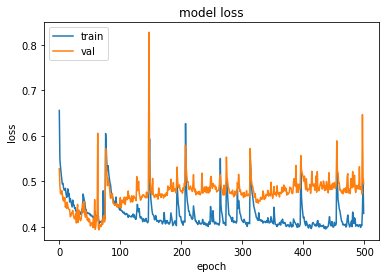

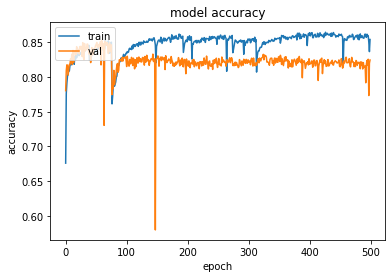

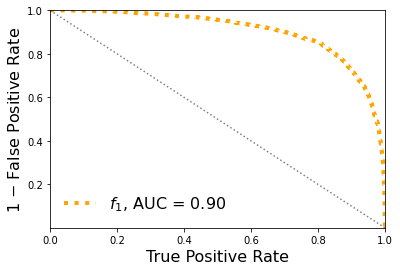

313/313 [==============================] - 1s 4ms/step - loss: 0.4959 - acc: 0.8253 - f1_m: 0.4603 - precision_m: 0.5002 - recall_m: 0.4274
Test ROC-AUC: 0.90354448
Test loss: 0.49592649936676025
Test accuracy: 0.8252999782562256
Test f1: 0.4603351950645447
Test precision: 0.5001775026321411
Test recall: 0.4274161458015442
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 145ms/step - loss: 1.3302 - acc: 0.5015 - f1_m: 0.5427 - precision_m: 0.4980 - recall_m: 0.6204 - val_loss: 0.7644 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 2/500
94/94 [==============================] - 13s 138ms/step - loss: 0.7545 - acc: 0.5217 - f1_m: 0.6124 - precision_m: 0.5177 - recall_m: 0.7583 - val_loss: 0.7187 - val_acc: 0.7327 - val_f1_m: 0.7629 - val_precision_m: 0.6780 - val

Epoch 31/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4465 - acc: 0.8352 - f1_m: 0.8410 - precision_m: 0.8166 - recall_m: 0.8710 - val_loss: 0.4459 - val_acc: 0.8243 - val_f1_m: 0.8199 - val_precision_m: 0.8353 - val_recall_m: 0.8068
Epoch 32/500
94/94 [==============================] - 13s 140ms/step - loss: 0.4482 - acc: 0.8328 - f1_m: 0.8377 - precision_m: 0.8150 - recall_m: 0.8643 - val_loss: 0.4281 - val_acc: 0.8405 - val_f1_m: 0.8429 - val_precision_m: 0.8194 - val_recall_m: 0.8693
Epoch 33/500
94/94 [==============================] - 13s 140ms/step - loss: 0.4589 - acc: 0.8273 - f1_m: 0.8328 - precision_m: 0.8067 - recall_m: 0.8649 - val_loss: 0.4540 - val_acc: 0.8203 - val_f1_m: 0.8034 - val_precision_m: 0.8796 - val_recall_m: 0.7408
Epoch 34/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4335 - acc: 0.8401 - f1_m: 0.8443 - precision_m: 0.8238 - recall_m: 0.8683 - val_loss: 0.4228 - val_acc: 0.8415 - val_f1_m: 0.8491 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3974 - acc: 0.8595 - f1_m: 0.8621 - precision_m: 0.8397 - recall_m: 0.8894 - val_loss: 0.4204 - val_acc: 0.8460 - val_f1_m: 0.8429 - val_precision_m: 0.8486 - val_recall_m: 0.8387
Epoch 64/500
94/94 [==============================] - 13s 139ms/step - loss: 0.4002 - acc: 0.8573 - f1_m: 0.8620 - precision_m: 0.8358 - recall_m: 0.8926 - val_loss: 0.4248 - val_acc: 0.8432 - val_f1_m: 0.8524 - val_precision_m: 0.7911 - val_recall_m: 0.9251
Epoch 65/500
94/94 [==============================] - 13s 138ms/step - loss: 0.4004 - acc: 0.8598 - f1_m: 0.8640 - precision_m: 0.8399 - recall_m: 0.8920 - val_loss: 0.4100 - val_acc: 0.8498 - val_f1_m: 0.8549 - val_precision_m: 0.8175 - val_recall_m: 0.8971
Epoch 66/500
94/94 [==============================] - 13s 139ms/step - loss: 0.4021 - acc: 0.8599 - f1_m: 0.8653 - precision_m: 0.8389 - recall_m: 0.8968 - val_loss: 0.4100 - val_acc: 0.8500 - val_f1_m: 0.8505 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3952 - acc: 0.8625 - f1_m: 0.8673 - precision_m: 0.8416 - recall_m: 0.8965 - val_loss: 0.4436 - val_acc: 0.8362 - val_f1_m: 0.8404 - val_precision_m: 0.8081 - val_recall_m: 0.8773
Epoch 96/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3878 - acc: 0.8662 - f1_m: 0.8696 - precision_m: 0.8428 - recall_m: 0.9000 - val_loss: 0.4396 - val_acc: 0.8390 - val_f1_m: 0.8433 - val_precision_m: 0.8082 - val_recall_m: 0.8831
Epoch 97/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3854 - acc: 0.8686 - f1_m: 0.8720 - precision_m: 0.8478 - recall_m: 0.8998 - val_loss: 0.4490 - val_acc: 0.8298 - val_f1_m: 0.8270 - val_precision_m: 0.8303 - val_recall_m: 0.8255
Epoch 98/500
94/94 [==============================] - 13s 141ms/step - loss: 0.3971 - acc: 0.8613 - f1_m: 0.8651 - precision_m: 0.8441 - recall_m: 0.8893 - val_loss: 0.4378 - val_acc: 0.8393 - val_f1_m: 0.8408 - val_precisi

94/94 [==============================] - 13s 135ms/step - loss: 0.3681 - acc: 0.8754 - f1_m: 0.8785 - precision_m: 0.8515 - recall_m: 0.9095 - val_loss: 0.4747 - val_acc: 0.8283 - val_f1_m: 0.8272 - val_precision_m: 0.8208 - val_recall_m: 0.8352
Epoch 158/500
94/94 [==============================] - 13s 134ms/step - loss: 0.3712 - acc: 0.8697 - f1_m: 0.8730 - precision_m: 0.8454 - recall_m: 0.9042 - val_loss: 0.4560 - val_acc: 0.8270 - val_f1_m: 0.8268 - val_precision_m: 0.8146 - val_recall_m: 0.8413
Epoch 159/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3721 - acc: 0.8693 - f1_m: 0.8733 - precision_m: 0.8480 - recall_m: 0.9021 - val_loss: 0.4757 - val_acc: 0.8333 - val_f1_m: 0.8337 - val_precision_m: 0.8204 - val_recall_m: 0.8496
Epoch 160/500
94/94 [==============================] - 13s 134ms/step - loss: 0.3717 - acc: 0.8716 - f1_m: 0.8747 - precision_m: 0.8523 - recall_m: 0.9001 - val_loss: 0.4671 - val_acc: 0.8368 - val_f1_m: 0.8367 - val_precision_m: 0.82

94/94 [==============================] - 13s 137ms/step - loss: 0.3956 - acc: 0.8634 - f1_m: 0.8700 - precision_m: 0.8364 - recall_m: 0.9112 - val_loss: 0.6371 - val_acc: 0.7873 - val_f1_m: 0.7892 - val_precision_m: 0.7708 - val_recall_m: 0.8109
Epoch 220/500
94/94 [==============================] - 13s 140ms/step - loss: 0.6952 - acc: 0.7469 - f1_m: 0.7791 - precision_m: 0.6944 - recall_m: 0.8960 - val_loss: 0.5643 - val_acc: 0.8115 - val_f1_m: 0.8073 - val_precision_m: 0.8134 - val_recall_m: 0.8026
Epoch 221/500
94/94 [==============================] - 13s 139ms/step - loss: 0.5692 - acc: 0.8053 - f1_m: 0.8194 - precision_m: 0.7717 - recall_m: 0.8783 - val_loss: 0.5263 - val_acc: 0.8255 - val_f1_m: 0.8330 - val_precision_m: 0.7872 - val_recall_m: 0.8865
Epoch 222/500
94/94 [==============================] - 13s 139ms/step - loss: 0.5294 - acc: 0.8158 - f1_m: 0.8243 - precision_m: 0.7866 - recall_m: 0.8700 - val_loss: 0.5002 - val_acc: 0.8320 - val_f1_m: 0.8362 - val_precision_m: 0.80

94/94 [==============================] - 13s 135ms/step - loss: 0.3623 - acc: 0.8799 - f1_m: 0.8827 - precision_m: 0.8628 - recall_m: 0.9054 - val_loss: 0.4748 - val_acc: 0.8328 - val_f1_m: 0.8338 - val_precision_m: 0.8175 - val_recall_m: 0.8521
Epoch 282/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3679 - acc: 0.8777 - f1_m: 0.8797 - precision_m: 0.8638 - recall_m: 0.8984 - val_loss: 0.4830 - val_acc: 0.8333 - val_f1_m: 0.8314 - val_precision_m: 0.8288 - val_recall_m: 0.8355
Epoch 283/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3625 - acc: 0.8809 - f1_m: 0.8827 - precision_m: 0.8668 - recall_m: 0.9008 - val_loss: 0.4908 - val_acc: 0.8275 - val_f1_m: 0.8285 - val_precision_m: 0.8138 - val_recall_m: 0.8452
Epoch 284/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3688 - acc: 0.8787 - f1_m: 0.8820 - precision_m: 0.8626 - recall_m: 0.9039 - val_loss: 0.4870 - val_acc: 0.8283 - val_f1_m: 0.8270 - val_precision_m: 0.81

94/94 [==============================] - 13s 135ms/step - loss: 0.3651 - acc: 0.8822 - f1_m: 0.8871 - precision_m: 0.8600 - recall_m: 0.9172 - val_loss: 0.4814 - val_acc: 0.8297 - val_f1_m: 0.8319 - val_precision_m: 0.8079 - val_recall_m: 0.8590
Epoch 344/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3526 - acc: 0.8864 - f1_m: 0.8897 - precision_m: 0.8621 - recall_m: 0.9203 - val_loss: 0.5275 - val_acc: 0.8225 - val_f1_m: 0.8354 - val_precision_m: 0.7699 - val_recall_m: 0.9143
Epoch 345/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3590 - acc: 0.8847 - f1_m: 0.8883 - precision_m: 0.8593 - recall_m: 0.9216 - val_loss: 0.5012 - val_acc: 0.8252 - val_f1_m: 0.8177 - val_precision_m: 0.8405 - val_recall_m: 0.7972
Epoch 346/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3762 - acc: 0.8751 - f1_m: 0.8766 - precision_m: 0.8573 - recall_m: 0.8990 - val_loss: 0.4941 - val_acc: 0.8297 - val_f1_m: 0.8331 - val_precision_m: 0.80

94/94 [==============================] - 13s 138ms/step - loss: 0.3937 - acc: 0.8681 - f1_m: 0.8713 - precision_m: 0.8605 - recall_m: 0.8838 - val_loss: 0.4722 - val_acc: 0.8363 - val_f1_m: 0.8395 - val_precision_m: 0.8100 - val_recall_m: 0.8726
Epoch 406/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3781 - acc: 0.8767 - f1_m: 0.8791 - precision_m: 0.8710 - recall_m: 0.8889 - val_loss: 0.4811 - val_acc: 0.8340 - val_f1_m: 0.8318 - val_precision_m: 0.8306 - val_recall_m: 0.8341
Epoch 407/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3836 - acc: 0.8700 - f1_m: 0.8728 - precision_m: 0.8577 - recall_m: 0.8902 - val_loss: 0.4883 - val_acc: 0.8313 - val_f1_m: 0.8408 - val_precision_m: 0.7874 - val_recall_m: 0.9036
Epoch 408/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3828 - acc: 0.8670 - f1_m: 0.8694 - precision_m: 0.8506 - recall_m: 0.8910 - val_loss: 0.4819 - val_acc: 0.8310 - val_f1_m: 0.8291 - val_precision_m: 0.82

94/94 [==============================] - 13s 139ms/step - loss: 0.3593 - acc: 0.8916 - f1_m: 0.8910 - precision_m: 0.8879 - recall_m: 0.8960 - val_loss: 0.5245 - val_acc: 0.8293 - val_f1_m: 0.8275 - val_precision_m: 0.8255 - val_recall_m: 0.8312
Epoch 468/500
94/94 [==============================] - 13s 139ms/step - loss: 0.3502 - acc: 0.8955 - f1_m: 0.8973 - precision_m: 0.8915 - recall_m: 0.9044 - val_loss: 0.5311 - val_acc: 0.8293 - val_f1_m: 0.8306 - val_precision_m: 0.8201 - val_recall_m: 0.8429
Epoch 469/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3491 - acc: 0.8957 - f1_m: 0.8964 - precision_m: 0.8906 - recall_m: 0.9039 - val_loss: 0.5402 - val_acc: 0.8230 - val_f1_m: 0.8198 - val_precision_m: 0.8239 - val_recall_m: 0.8175
Epoch 470/500
94/94 [==============================] - 13s 139ms/step - loss: 0.3506 - acc: 0.8949 - f1_m: 0.8951 - precision_m: 0.8856 - recall_m: 0.9063 - val_loss: 0.5384 - val_acc: 0.8333 - val_f1_m: 0.8347 - val_precision_m: 0.81

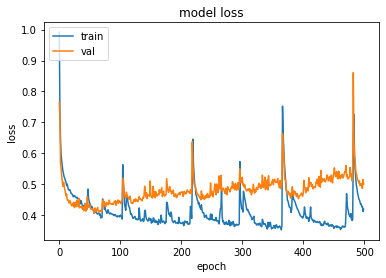

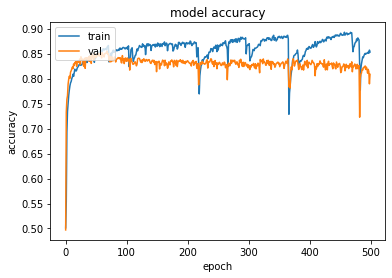

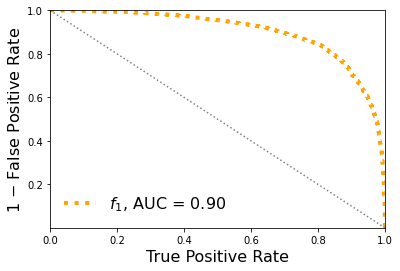

313/313 [==============================] - 1s 4ms/step - loss: 0.5036 - acc: 0.8082 - f1_m: 0.4237 - precision_m: 0.5000 - recall_m: 0.3691
Test ROC-AUC: 0.90056598
Test loss: 0.5036367774009705
Test accuracy: 0.8082000017166138
Test f1: 0.423679381608963
Test precision: 0.5
Test recall: 0.3691094219684601
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 0.7621 - acc: 0.6196 - f1_m: 0.6451 - precision_m: 0.6190 - recall_m: 0.7134 - val_loss: 0.5507 - val_acc: 0.7907 - val_f1_m: 0.7940 - val_precision_m: 0.7695 - val_recall_m: 0.8253
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5725 - acc: 0.7815 - f1_m: 0.7882 - precision_m: 0.7630 - recall_m: 0.8239 - val_loss: 0.5081 - val_acc: 0.8115 - val_f1_m: 0.8035 - val_precision_m: 0.8276 - val_recall_m: 0.7863

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4584 - acc: 0.8364 - f1_m: 0.8384 - precision_m: 0.8150 - recall_m: 0.8704 - val_loss: 0.4460 - val_acc: 0.8450 - val_f1_m: 0.8472 - val_precision_m: 0.8230 - val_recall_m: 0.8783
Epoch 32/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4689 - acc: 0.8339 - f1_m: 0.8377 - precision_m: 0.8185 - recall_m: 0.8667 - val_loss: 0.4567 - val_acc: 0.8317 - val_f1_m: 0.8411 - val_precision_m: 0.7883 - val_recall_m: 0.9066
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4627 - acc: 0.8325 - f1_m: 0.8373 - precision_m: 0.8159 - recall_m: 0.8672 - val_loss: 0.4653 - val_acc: 0.8300 - val_f1_m: 0.8432 - val_precision_m: 0.7701 - val_recall_m: 0.9367
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4624 - acc: 0.8334 - f1_m: 0.8376 - precision_m: 0.8184 - recall_m: 0.8643 - val_loss: 0.4411 - val_acc: 0.8385 - val_f1_m: 0.8441 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4429 - acc: 0.8454 - f1_m: 0.8498 - precision_m: 0.8323 - recall_m: 0.8751 - val_loss: 0.4388 - val_acc: 0.8473 - val_f1_m: 0.8476 - val_precision_m: 0.8363 - val_recall_m: 0.8641
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4577 - acc: 0.8351 - f1_m: 0.8378 - precision_m: 0.8191 - recall_m: 0.8652 - val_loss: 0.4873 - val_acc: 0.8068 - val_f1_m: 0.7826 - val_precision_m: 0.8835 - val_recall_m: 0.7073
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4682 - acc: 0.8324 - f1_m: 0.8365 - precision_m: 0.8170 - recall_m: 0.8659 - val_loss: 0.4416 - val_acc: 0.8377 - val_f1_m: 0.8498 - val_precision_m: 0.7822 - val_recall_m: 0.9349
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4678 - acc: 0.8309 - f1_m: 0.8339 - precision_m: 0.8095 - recall_m: 0.8692 - val_loss: 0.4920 - val_acc: 0.8118 - val_f1_m: 0.7881 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4684 - acc: 0.8355 - f1_m: 0.8388 - precision_m: 0.8150 - recall_m: 0.8726 - val_loss: 0.4221 - val_acc: 0.8503 - val_f1_m: 0.8524 - val_precision_m: 0.8332 - val_recall_m: 0.8773
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4386 - acc: 0.8408 - f1_m: 0.8435 - precision_m: 0.8141 - recall_m: 0.8825 - val_loss: 0.4414 - val_acc: 0.8427 - val_f1_m: 0.8503 - val_precision_m: 0.8007 - val_recall_m: 0.9113
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4360 - acc: 0.8441 - f1_m: 0.8482 - precision_m: 0.8213 - recall_m: 0.8836 - val_loss: 0.4610 - val_acc: 0.8285 - val_f1_m: 0.8119 - val_precision_m: 0.8863 - val_recall_m: 0.7543
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4500 - acc: 0.8386 - f1_m: 0.8423 - precision_m: 0.8201 - recall_m: 0.8746 - val_loss: 0.4466 - val_acc: 0.8358 - val_f1_m: 0.8495 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4439 - acc: 0.8382 - f1_m: 0.8429 - precision_m: 0.8139 - recall_m: 0.8807 - val_loss: 0.4204 - val_acc: 0.8548 - val_f1_m: 0.8562 - val_precision_m: 0.8365 - val_recall_m: 0.8816
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4335 - acc: 0.8453 - f1_m: 0.8505 - precision_m: 0.8271 - recall_m: 0.8819 - val_loss: 0.5034 - val_acc: 0.8132 - val_f1_m: 0.8349 - val_precision_m: 0.7390 - val_recall_m: 0.9653
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4445 - acc: 0.8431 - f1_m: 0.8492 - precision_m: 0.8201 - recall_m: 0.8871 - val_loss: 0.4251 - val_acc: 0.8415 - val_f1_m: 0.8442 - val_precision_m: 0.8190 - val_recall_m: 0.8752
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4684 - acc: 0.8365 - f1_m: 0.8395 - precision_m: 0.8182 - recall_m: 0.8733 - val_loss: 0.4452 - val_acc: 0.8352 - val_f1_m: 0.8259 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4221 - acc: 0.8483 - f1_m: 0.8521 - precision_m: 0.8278 - recall_m: 0.8844 - val_loss: 0.4799 - val_acc: 0.8217 - val_f1_m: 0.8041 - val_precision_m: 0.8763 - val_recall_m: 0.7474
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4615 - acc: 0.8324 - f1_m: 0.8364 - precision_m: 0.8124 - recall_m: 0.8699 - val_loss: 0.4471 - val_acc: 0.8278 - val_f1_m: 0.8145 - val_precision_m: 0.8675 - val_recall_m: 0.7721
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4376 - acc: 0.8510 - f1_m: 0.8520 - precision_m: 0.8308 - recall_m: 0.8814 - val_loss: 0.4669 - val_acc: 0.8383 - val_f1_m: 0.8522 - val_precision_m: 0.7761 - val_recall_m: 0.9496
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4537 - acc: 0.8395 - f1_m: 0.8425 - precision_m: 0.8192 - recall_m: 0.8755 - val_loss: 0.4287 - val_acc: 0.8477 - val_f1_m: 0.8529 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4800 - acc: 0.8277 - f1_m: 0.8349 - precision_m: 0.8090 - recall_m: 0.8722 - val_loss: 0.4215 - val_acc: 0.8520 - val_f1_m: 0.8525 - val_precision_m: 0.8397 - val_recall_m: 0.8700
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4271 - acc: 0.8467 - f1_m: 0.8517 - precision_m: 0.8242 - recall_m: 0.8866 - val_loss: 0.4132 - val_acc: 0.8542 - val_f1_m: 0.8583 - val_precision_m: 0.8226 - val_recall_m: 0.9018
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4442 - acc: 0.8448 - f1_m: 0.8485 - precision_m: 0.8253 - recall_m: 0.8796 - val_loss: 0.4150 - val_acc: 0.8550 - val_f1_m: 0.8519 - val_precision_m: 0.8577 - val_recall_m: 0.8516
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4950 - acc: 0.8194 - f1_m: 0.8174 - precision_m: 0.8121 - recall_m: 0.8405 - val_loss: 0.4206 - val_acc: 0.8538 - val_f1_m: 0.8523 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4399 - acc: 0.8431 - f1_m: 0.8458 - precision_m: 0.8233 - recall_m: 0.8782 - val_loss: 0.4317 - val_acc: 0.8418 - val_f1_m: 0.8502 - val_precision_m: 0.7954 - val_recall_m: 0.9181
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4374 - acc: 0.8460 - f1_m: 0.8466 - precision_m: 0.8232 - recall_m: 0.8778 - val_loss: 0.4158 - val_acc: 0.8562 - val_f1_m: 0.8586 - val_precision_m: 0.8355 - val_recall_m: 0.8884
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4399 - acc: 0.8441 - f1_m: 0.8487 - precision_m: 0.8252 - recall_m: 0.8813 - val_loss: 0.4720 - val_acc: 0.8358 - val_f1_m: 0.8319 - val_precision_m: 0.8410 - val_recall_m: 0.8279
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4711 - acc: 0.8323 - f1_m: 0.8364 - precision_m: 0.8184 - recall_m: 0.8648 - val_loss: 0.4440 - val_acc: 0.8453 - val_f1_m: 0.8540 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4547 - acc: 0.8395 - f1_m: 0.8442 - precision_m: 0.8266 - recall_m: 0.8703 - val_loss: 0.4366 - val_acc: 0.8513 - val_f1_m: 0.8501 - val_precision_m: 0.8463 - val_recall_m: 0.8587
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4374 - acc: 0.8495 - f1_m: 0.8504 - precision_m: 0.8318 - recall_m: 0.8767 - val_loss: 0.4323 - val_acc: 0.8330 - val_f1_m: 0.8174 - val_precision_m: 0.8896 - val_recall_m: 0.7610
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4297 - acc: 0.8464 - f1_m: 0.8480 - precision_m: 0.8282 - recall_m: 0.8746 - val_loss: 0.4108 - val_acc: 0.8573 - val_f1_m: 0.8611 - val_precision_m: 0.8267 - val_recall_m: 0.9031
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4387 - acc: 0.8455 - f1_m: 0.8467 - precision_m: 0.8255 - recall_m: 0.8761 - val_loss: 0.4214 - val_acc: 0.8510 - val_f1_m: 0.8488 - val_precision_m: 

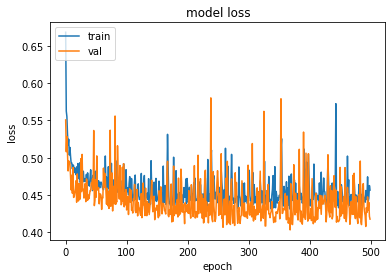

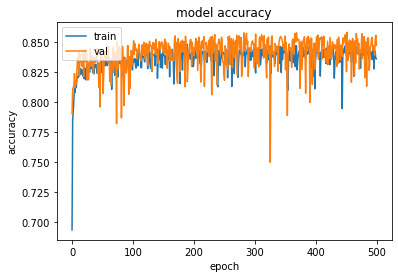

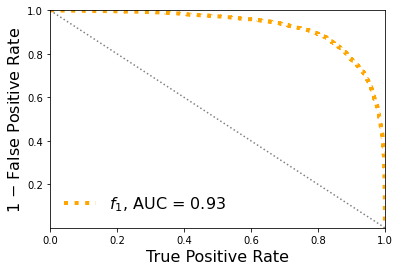

313/313 [==============================] - 1s 4ms/step - loss: 0.4269 - acc: 0.8421 - f1_m: 0.4708 - precision_m: 0.5001 - recall_m: 0.4460
Test ROC-AUC: 0.9264332000000001
Test loss: 0.4268883168697357
Test accuracy: 0.8421000242233276
Test f1: 0.470821738243103
Test precision: 0.5001229047775269
Test recall: 0.44598641991615295
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 69ms/step - loss: 0.8549 - acc: 0.5787 - f1_m: 0.5392 - precision_m: 0.5721 - recall_m: 0.5440 - val_loss: 0.6062 - val_acc: 0.7605 - val_f1_m: 0.7811 - val_precision_m: 0.7138 - val_recall_m: 0.8654
Epoch 2/500
188/188 [==============================] - 13s 67ms/step - loss: 0.6190 - acc: 0.7361 - f1_m: 0.7435 - precision_m: 0.7136 - recall_m: 0.7848 - val_loss: 0.5450 - val_acc: 0.7832 - val_f1_m: 0.7730 - val_precision_m: 0.80

Epoch 31/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4347 - acc: 0.8444 - f1_m: 0.8453 - precision_m: 0.8402 - recall_m: 0.8539 - val_loss: 0.4300 - val_acc: 0.8445 - val_f1_m: 0.8525 - val_precision_m: 0.8053 - val_recall_m: 0.9086
Epoch 32/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4495 - acc: 0.8377 - f1_m: 0.8380 - precision_m: 0.8256 - recall_m: 0.8575 - val_loss: 0.4259 - val_acc: 0.8462 - val_f1_m: 0.8450 - val_precision_m: 0.8440 - val_recall_m: 0.8479
Epoch 33/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4516 - acc: 0.8369 - f1_m: 0.8374 - precision_m: 0.8246 - recall_m: 0.8555 - val_loss: 0.4295 - val_acc: 0.8477 - val_f1_m: 0.8492 - val_precision_m: 0.8331 - val_recall_m: 0.8686
Epoch 34/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4365 - acc: 0.8484 - f1_m: 0.8506 - precision_m: 0.8384 - recall_m: 0.8678 - val_loss: 0.4572 - val_acc: 0.8225 - val_f1_m: 0.8075 - val_pre

188/188 [==============================] - 12s 66ms/step - loss: 0.6152 - acc: 0.7787 - f1_m: 0.7866 - precision_m: 0.7597 - recall_m: 0.8412 - val_loss: 0.5002 - val_acc: 0.8338 - val_f1_m: 0.8279 - val_precision_m: 0.8526 - val_recall_m: 0.8076
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.5067 - acc: 0.8227 - f1_m: 0.8242 - precision_m: 0.8052 - recall_m: 0.8523 - val_loss: 0.4579 - val_acc: 0.8215 - val_f1_m: 0.8082 - val_precision_m: 0.8652 - val_recall_m: 0.7609
Epoch 95/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4771 - acc: 0.8278 - f1_m: 0.8285 - precision_m: 0.8186 - recall_m: 0.8444 - val_loss: 0.4239 - val_acc: 0.8458 - val_f1_m: 0.8504 - val_precision_m: 0.8199 - val_recall_m: 0.8862
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4293 - acc: 0.8508 - f1_m: 0.8558 - precision_m: 0.8396 - recall_m: 0.8771 - val_loss: 0.4300 - val_acc: 0.8395 - val_f1_m: 0.8297 - val_precision_m: 0.8

188/188 [==============================] - 12s 66ms/step - loss: 0.3892 - acc: 0.8686 - f1_m: 0.8689 - precision_m: 0.8660 - recall_m: 0.8753 - val_loss: 0.4156 - val_acc: 0.8545 - val_f1_m: 0.8576 - val_precision_m: 0.8332 - val_recall_m: 0.8863
Epoch 156/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3997 - acc: 0.8665 - f1_m: 0.8676 - precision_m: 0.8598 - recall_m: 0.8781 - val_loss: 0.4231 - val_acc: 0.8513 - val_f1_m: 0.8538 - val_precision_m: 0.8338 - val_recall_m: 0.8777
Epoch 157/500
188/188 [==============================] - 13s 68ms/step - loss: 0.3983 - acc: 0.8709 - f1_m: 0.8712 - precision_m: 0.8687 - recall_m: 0.8773 - val_loss: 0.4521 - val_acc: 0.8277 - val_f1_m: 0.8126 - val_precision_m: 0.8829 - val_recall_m: 0.7553
Epoch 158/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4220 - acc: 0.8588 - f1_m: 0.8593 - precision_m: 0.8572 - recall_m: 0.8659 - val_loss: 0.4594 - val_acc: 0.8393 - val_f1_m: 0.8502 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4019 - acc: 0.8624 - f1_m: 0.8645 - precision_m: 0.8573 - recall_m: 0.8769 - val_loss: 0.4518 - val_acc: 0.8403 - val_f1_m: 0.8360 - val_precision_m: 0.8533 - val_recall_m: 0.8223
Epoch 218/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4236 - acc: 0.8554 - f1_m: 0.8564 - precision_m: 0.8440 - recall_m: 0.8725 - val_loss: 0.4258 - val_acc: 0.8520 - val_f1_m: 0.8540 - val_precision_m: 0.8361 - val_recall_m: 0.8752
Epoch 219/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4006 - acc: 0.8649 - f1_m: 0.8647 - precision_m: 0.8571 - recall_m: 0.8755 - val_loss: 0.4207 - val_acc: 0.8455 - val_f1_m: 0.8450 - val_precision_m: 0.8427 - val_recall_m: 0.8500
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4087 - acc: 0.8639 - f1_m: 0.8630 - precision_m: 0.8619 - recall_m: 0.8688 - val_loss: 0.5697 - val_acc: 0.8003 - val_f1_m: 0.7810 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4100 - acc: 0.8624 - f1_m: 0.8614 - precision_m: 0.8615 - recall_m: 0.8675 - val_loss: 0.4224 - val_acc: 0.8510 - val_f1_m: 0.8491 - val_precision_m: 0.8527 - val_recall_m: 0.8486
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4553 - acc: 0.8442 - f1_m: 0.8450 - precision_m: 0.8358 - recall_m: 0.8648 - val_loss: 0.4216 - val_acc: 0.8570 - val_f1_m: 0.8626 - val_precision_m: 0.8235 - val_recall_m: 0.9084
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4069 - acc: 0.8627 - f1_m: 0.8640 - precision_m: 0.8549 - recall_m: 0.8774 - val_loss: 0.4247 - val_acc: 0.8493 - val_f1_m: 0.8448 - val_precision_m: 0.8613 - val_recall_m: 0.8314
Epoch 282/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4163 - acc: 0.8599 - f1_m: 0.8619 - precision_m: 0.8507 - recall_m: 0.8773 - val_loss: 0.4346 - val_acc: 0.8458 - val_f1_m: 0.8537 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4069 - acc: 0.8636 - f1_m: 0.8658 - precision_m: 0.8565 - recall_m: 0.8790 - val_loss: 0.4109 - val_acc: 0.8537 - val_f1_m: 0.8514 - val_precision_m: 0.8575 - val_recall_m: 0.8481
Epoch 342/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3994 - acc: 0.8673 - f1_m: 0.8656 - precision_m: 0.8634 - recall_m: 0.8715 - val_loss: 0.4186 - val_acc: 0.8487 - val_f1_m: 0.8498 - val_precision_m: 0.8378 - val_recall_m: 0.8653
Epoch 343/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3997 - acc: 0.8642 - f1_m: 0.8634 - precision_m: 0.8590 - recall_m: 0.8728 - val_loss: 0.4279 - val_acc: 0.8455 - val_f1_m: 0.8431 - val_precision_m: 0.8500 - val_recall_m: 0.8393
Epoch 344/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4711 - acc: 0.8347 - f1_m: 0.8347 - precision_m: 0.8307 - recall_m: 0.8484 - val_loss: 0.4724 - val_acc: 0.8363 - val_f1_m: 0.8322 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4483 - acc: 0.8468 - f1_m: 0.8496 - precision_m: 0.8393 - recall_m: 0.8665 - val_loss: 0.4202 - val_acc: 0.8483 - val_f1_m: 0.8487 - val_precision_m: 0.8394 - val_recall_m: 0.8610
Epoch 404/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4239 - acc: 0.8568 - f1_m: 0.8611 - precision_m: 0.8419 - recall_m: 0.8857 - val_loss: 0.5651 - val_acc: 0.7978 - val_f1_m: 0.8264 - val_precision_m: 0.7201 - val_recall_m: 0.9721
Epoch 405/500
188/188 [==============================] - 12s 67ms/step - loss: 0.4432 - acc: 0.8480 - f1_m: 0.8499 - precision_m: 0.8324 - recall_m: 0.8755 - val_loss: 0.4389 - val_acc: 0.8367 - val_f1_m: 0.8284 - val_precision_m: 0.8634 - val_recall_m: 0.7983
Epoch 406/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4105 - acc: 0.8595 - f1_m: 0.8614 - precision_m: 0.8539 - recall_m: 0.8737 - val_loss: 0.4191 - val_acc: 0.8498 - val_f1_m: 0.8569 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4069 - acc: 0.8637 - f1_m: 0.8656 - precision_m: 0.8522 - recall_m: 0.8836 - val_loss: 0.4078 - val_acc: 0.8527 - val_f1_m: 0.8497 - val_precision_m: 0.8580 - val_recall_m: 0.8441
Epoch 466/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3866 - acc: 0.8651 - f1_m: 0.8658 - precision_m: 0.8608 - recall_m: 0.8739 - val_loss: 0.4055 - val_acc: 0.8510 - val_f1_m: 0.8500 - val_precision_m: 0.8495 - val_recall_m: 0.8528
Epoch 467/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3972 - acc: 0.8627 - f1_m: 0.8650 - precision_m: 0.8559 - recall_m: 0.8777 - val_loss: 0.4075 - val_acc: 0.8567 - val_f1_m: 0.8624 - val_precision_m: 0.8236 - val_recall_m: 0.9075
Epoch 468/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4166 - acc: 0.8556 - f1_m: 0.8535 - precision_m: 0.8494 - recall_m: 0.8673 - val_loss: 0.4374 - val_acc: 0.8557 - val_f1_m: 0.8595 - val_precision_m: 

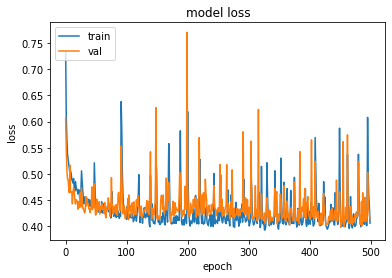

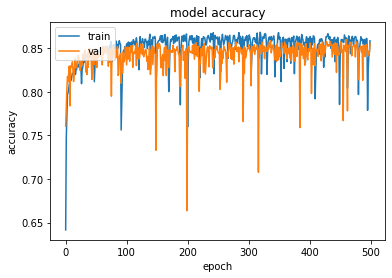

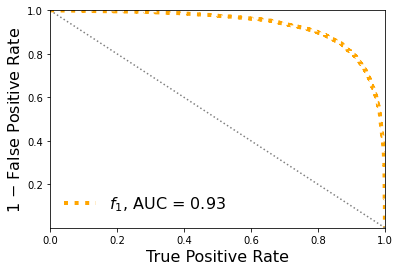

313/313 [==============================] - 1s 4ms/step - loss: 0.4141 - acc: 0.8495 - f1_m: 0.4782 - precision_m: 0.5003 - recall_m: 0.4590
Test ROC-AUC: 0.9321802000000001
Test loss: 0.4141043424606323
Test accuracy: 0.8495000004768372
Test f1: 0.47822317481040955
Test precision: 0.5002662539482117
Test recall: 0.4589656591415405
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 142ms/step - loss: 0.7894 - acc: 0.5989 - f1_m: 0.5661 - precision_m: 0.6013 - recall_m: 0.5513 - val_loss: 0.5698 - val_acc: 0.7705 - val_f1_m: 0.7652 - val_precision_m: 0.7742 - val_recall_m: 0.7584
Epoch 2/500
94/94 [==============================] - 13s 137ms/step - loss: 0.5977 - acc: 0.7584 - f1_m: 0.7675 - precision_m: 0.7370 - recall_m: 0.8107 - val_loss: 0.5004 - val_acc: 0.8000 - val_f1_m: 0.7996 - val_precision_m: 0.796

Epoch 31/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4463 - acc: 0.8409 - f1_m: 0.8432 - precision_m: 0.8306 - recall_m: 0.8587 - val_loss: 0.4247 - val_acc: 0.8462 - val_f1_m: 0.8444 - val_precision_m: 0.8402 - val_recall_m: 0.8503
Epoch 32/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4322 - acc: 0.8462 - f1_m: 0.8479 - precision_m: 0.8347 - recall_m: 0.8654 - val_loss: 0.4340 - val_acc: 0.8367 - val_f1_m: 0.8299 - val_precision_m: 0.8546 - val_recall_m: 0.8082
Epoch 33/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4366 - acc: 0.8470 - f1_m: 0.8468 - precision_m: 0.8388 - recall_m: 0.8584 - val_loss: 0.4189 - val_acc: 0.8463 - val_f1_m: 0.8480 - val_precision_m: 0.8317 - val_recall_m: 0.8665
Epoch 34/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4296 - acc: 0.8513 - f1_m: 0.8524 - precision_m: 0.8421 - recall_m: 0.8670 - val_loss: 0.4293 - val_acc: 0.8410 - val_f1_m: 0.8349 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4328 - acc: 0.8463 - f1_m: 0.8505 - precision_m: 0.8375 - recall_m: 0.8685 - val_loss: 0.4240 - val_acc: 0.8457 - val_f1_m: 0.8421 - val_precision_m: 0.8518 - val_recall_m: 0.8343
Epoch 64/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4128 - acc: 0.8591 - f1_m: 0.8620 - precision_m: 0.8463 - recall_m: 0.8807 - val_loss: 0.4164 - val_acc: 0.8462 - val_f1_m: 0.8418 - val_precision_m: 0.8558 - val_recall_m: 0.8299
Epoch 65/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3908 - acc: 0.8643 - f1_m: 0.8657 - precision_m: 0.8492 - recall_m: 0.8851 - val_loss: 0.4120 - val_acc: 0.8532 - val_f1_m: 0.8516 - val_precision_m: 0.8519 - val_recall_m: 0.8529
Epoch 66/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3979 - acc: 0.8644 - f1_m: 0.8690 - precision_m: 0.8527 - recall_m: 0.8883 - val_loss: 0.4228 - val_acc: 0.8472 - val_f1_m: 0.8535 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3907 - acc: 0.8723 - f1_m: 0.8740 - precision_m: 0.8561 - recall_m: 0.8961 - val_loss: 0.4287 - val_acc: 0.8542 - val_f1_m: 0.8589 - val_precision_m: 0.8197 - val_recall_m: 0.9034
Epoch 96/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3787 - acc: 0.8756 - f1_m: 0.8781 - precision_m: 0.8602 - recall_m: 0.8979 - val_loss: 0.4324 - val_acc: 0.8410 - val_f1_m: 0.8327 - val_precision_m: 0.8664 - val_recall_m: 0.8028
Epoch 97/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3951 - acc: 0.8667 - f1_m: 0.8692 - precision_m: 0.8490 - recall_m: 0.8933 - val_loss: 0.4282 - val_acc: 0.8478 - val_f1_m: 0.8499 - val_precision_m: 0.8328 - val_recall_m: 0.8692
Epoch 98/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3807 - acc: 0.8726 - f1_m: 0.8750 - precision_m: 0.8608 - recall_m: 0.8916 - val_loss: 0.4290 - val_acc: 0.8453 - val_f1_m: 0.8527 - val_precisi

94/94 [==============================] - 13s 135ms/step - loss: 0.3830 - acc: 0.8749 - f1_m: 0.8759 - precision_m: 0.8640 - recall_m: 0.8901 - val_loss: 0.4304 - val_acc: 0.8465 - val_f1_m: 0.8464 - val_precision_m: 0.8350 - val_recall_m: 0.8600
Epoch 158/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3710 - acc: 0.8808 - f1_m: 0.8824 - precision_m: 0.8678 - recall_m: 0.8991 - val_loss: 0.4239 - val_acc: 0.8515 - val_f1_m: 0.8515 - val_precision_m: 0.8381 - val_recall_m: 0.8671
Epoch 159/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3827 - acc: 0.8711 - f1_m: 0.8728 - precision_m: 0.8577 - recall_m: 0.8914 - val_loss: 0.4872 - val_acc: 0.8207 - val_f1_m: 0.8355 - val_precision_m: 0.7607 - val_recall_m: 0.9283
Epoch 160/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4125 - acc: 0.8605 - f1_m: 0.8664 - precision_m: 0.8423 - recall_m: 0.8969 - val_loss: 0.4264 - val_acc: 0.8472 - val_f1_m: 0.8503 - val_precision_m: 0.82

94/94 [==============================] - 13s 135ms/step - loss: 0.3749 - acc: 0.8801 - f1_m: 0.8806 - precision_m: 0.8729 - recall_m: 0.8920 - val_loss: 0.4363 - val_acc: 0.8487 - val_f1_m: 0.8459 - val_precision_m: 0.8454 - val_recall_m: 0.8480
Epoch 220/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3864 - acc: 0.8783 - f1_m: 0.8799 - precision_m: 0.8637 - recall_m: 0.8999 - val_loss: 0.4391 - val_acc: 0.8482 - val_f1_m: 0.8497 - val_precision_m: 0.8327 - val_recall_m: 0.8692
Epoch 221/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3684 - acc: 0.8842 - f1_m: 0.8861 - precision_m: 0.8725 - recall_m: 0.9019 - val_loss: 0.4470 - val_acc: 0.8385 - val_f1_m: 0.8441 - val_precision_m: 0.8067 - val_recall_m: 0.8869
Epoch 222/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3914 - acc: 0.8736 - f1_m: 0.8772 - precision_m: 0.8620 - recall_m: 0.8970 - val_loss: 0.4512 - val_acc: 0.8455 - val_f1_m: 0.8482 - val_precision_m: 0.82

94/94 [==============================] - 13s 135ms/step - loss: 0.5267 - acc: 0.7951 - f1_m: 0.8103 - precision_m: 0.7572 - recall_m: 0.8783 - val_loss: 0.4336 - val_acc: 0.8505 - val_f1_m: 0.8534 - val_precision_m: 0.8263 - val_recall_m: 0.8837
Epoch 282/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4780 - acc: 0.8258 - f1_m: 0.8341 - precision_m: 0.7935 - recall_m: 0.8828 - val_loss: 0.4528 - val_acc: 0.8447 - val_f1_m: 0.8378 - val_precision_m: 0.8658 - val_recall_m: 0.8132
Epoch 283/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4901 - acc: 0.8134 - f1_m: 0.8213 - precision_m: 0.7872 - recall_m: 0.8641 - val_loss: 0.4387 - val_acc: 0.8372 - val_f1_m: 0.8499 - val_precision_m: 0.7795 - val_recall_m: 0.9364
Epoch 284/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4898 - acc: 0.8135 - f1_m: 0.8233 - precision_m: 0.7863 - recall_m: 0.8710 - val_loss: 0.4676 - val_acc: 0.8295 - val_f1_m: 0.8438 - val_precision_m: 0.76

94/94 [==============================] - 13s 136ms/step - loss: 0.3836 - acc: 0.8738 - f1_m: 0.8761 - precision_m: 0.8606 - recall_m: 0.8945 - val_loss: 0.4222 - val_acc: 0.8483 - val_f1_m: 0.8484 - val_precision_m: 0.8395 - val_recall_m: 0.8592
Epoch 344/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3769 - acc: 0.8760 - f1_m: 0.8780 - precision_m: 0.8618 - recall_m: 0.8974 - val_loss: 0.4315 - val_acc: 0.8462 - val_f1_m: 0.8512 - val_precision_m: 0.8142 - val_recall_m: 0.8935
Epoch 345/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3632 - acc: 0.8837 - f1_m: 0.8847 - precision_m: 0.8715 - recall_m: 0.8996 - val_loss: 0.4461 - val_acc: 0.8452 - val_f1_m: 0.8547 - val_precision_m: 0.7950 - val_recall_m: 0.9256
Epoch 346/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3773 - acc: 0.8746 - f1_m: 0.8751 - precision_m: 0.8634 - recall_m: 0.8892 - val_loss: 0.4204 - val_acc: 0.8502 - val_f1_m: 0.8521 - val_precision_m: 0.82

94/94 [==============================] - 13s 135ms/step - loss: 0.4327 - acc: 0.8504 - f1_m: 0.8544 - precision_m: 0.8334 - recall_m: 0.8801 - val_loss: 0.4235 - val_acc: 0.8497 - val_f1_m: 0.8568 - val_precision_m: 0.8068 - val_recall_m: 0.9149
Epoch 406/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4057 - acc: 0.8588 - f1_m: 0.8622 - precision_m: 0.8413 - recall_m: 0.8871 - val_loss: 0.4221 - val_acc: 0.8497 - val_f1_m: 0.8563 - val_precision_m: 0.8079 - val_recall_m: 0.9122
Epoch 407/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3984 - acc: 0.8574 - f1_m: 0.8594 - precision_m: 0.8409 - recall_m: 0.8816 - val_loss: 0.4144 - val_acc: 0.8523 - val_f1_m: 0.8589 - val_precision_m: 0.8112 - val_recall_m: 0.9142
Epoch 408/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3904 - acc: 0.8644 - f1_m: 0.8684 - precision_m: 0.8482 - recall_m: 0.8926 - val_loss: 0.4102 - val_acc: 0.8478 - val_f1_m: 0.8452 - val_precision_m: 0.84

94/94 [==============================] - 13s 135ms/step - loss: 0.3785 - acc: 0.8780 - f1_m: 0.8796 - precision_m: 0.8654 - recall_m: 0.8966 - val_loss: 0.4233 - val_acc: 0.8475 - val_f1_m: 0.8430 - val_precision_m: 0.8530 - val_recall_m: 0.8351
Epoch 468/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3860 - acc: 0.8764 - f1_m: 0.8764 - precision_m: 0.8707 - recall_m: 0.8845 - val_loss: 0.4279 - val_acc: 0.8477 - val_f1_m: 0.8410 - val_precision_m: 0.8637 - val_recall_m: 0.8206
Epoch 469/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3850 - acc: 0.8738 - f1_m: 0.8732 - precision_m: 0.8704 - recall_m: 0.8783 - val_loss: 0.4633 - val_acc: 0.8280 - val_f1_m: 0.8143 - val_precision_m: 0.8700 - val_recall_m: 0.7667
Epoch 470/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4699 - acc: 0.8350 - f1_m: 0.8386 - precision_m: 0.8278 - recall_m: 0.8637 - val_loss: 0.4290 - val_acc: 0.8558 - val_f1_m: 0.8554 - val_precision_m: 0.84

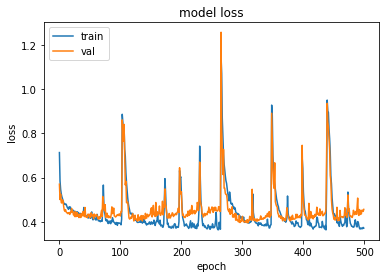

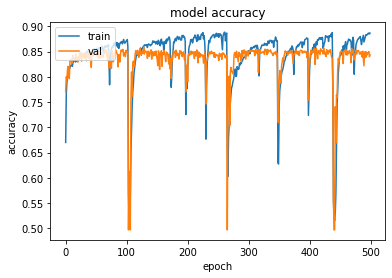

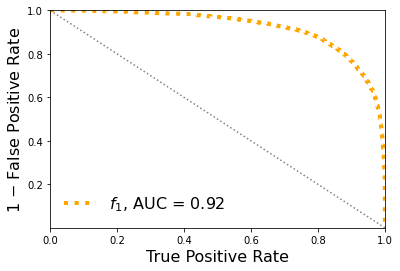

313/313 [==============================] - 1s 4ms/step - loss: 0.4565 - acc: 0.8385 - f1_m: 0.4659 - precision_m: 0.4999 - recall_m: 0.4376
Test ROC-AUC: 0.9213736800000001
Test loss: 0.4564570188522339
Test accuracy: 0.8385000228881836
Test f1: 0.4659328758716583
Test precision: 0.49987709522247314
Test recall: 0.4375998377799988
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 0.9276 - acc: 0.4983 - f1_m: 0.3723 - precision_m: 0.4920 - recall_m: 0.3431 - val_loss: 0.7394 - val_acc: 0.5002 - val_f1_m: 0.6632 - val_precision_m: 0.4988 - val_recall_m: 1.0000
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.7348 - acc: 0.5130 - f1_m: 0.5120 - precision_m: 0.5141 - recall_m: 0.5469 - val_loss: 0.7222 - val_acc: 0.6052 - val_f1_m: 0.3760 - val_precision_m: 0.86

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4784 - acc: 0.8237 - f1_m: 0.8230 - precision_m: 0.8195 - recall_m: 0.8387 - val_loss: 0.4444 - val_acc: 0.8332 - val_f1_m: 0.8264 - val_precision_m: 0.8496 - val_recall_m: 0.8091
Epoch 32/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4565 - acc: 0.8316 - f1_m: 0.8326 - precision_m: 0.8235 - recall_m: 0.8498 - val_loss: 0.4255 - val_acc: 0.8340 - val_f1_m: 0.8250 - val_precision_m: 0.8576 - val_recall_m: 0.7993
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4473 - acc: 0.8355 - f1_m: 0.8341 - precision_m: 0.8307 - recall_m: 0.8456 - val_loss: 0.4343 - val_acc: 0.8337 - val_f1_m: 0.8354 - val_precision_m: 0.8183 - val_recall_m: 0.8584
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4604 - acc: 0.8297 - f1_m: 0.8297 - precision_m: 0.8223 - recall_m: 0.8453 - val_loss: 0.4478 - val_acc: 0.8267 - val_f1_m: 0.8134 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4303 - acc: 0.8484 - f1_m: 0.8464 - precision_m: 0.8455 - recall_m: 0.8545 - val_loss: 0.4312 - val_acc: 0.8383 - val_f1_m: 0.8317 - val_precision_m: 0.8553 - val_recall_m: 0.8136
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4335 - acc: 0.8467 - f1_m: 0.8441 - precision_m: 0.8488 - recall_m: 0.8470 - val_loss: 0.4634 - val_acc: 0.8305 - val_f1_m: 0.8180 - val_precision_m: 0.8695 - val_recall_m: 0.7773
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4571 - acc: 0.8426 - f1_m: 0.8422 - precision_m: 0.8362 - recall_m: 0.8560 - val_loss: 0.4139 - val_acc: 0.8463 - val_f1_m: 0.8456 - val_precision_m: 0.8377 - val_recall_m: 0.8580
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4484 - acc: 0.8389 - f1_m: 0.8375 - precision_m: 0.8334 - recall_m: 0.8497 - val_loss: 0.4171 - val_acc: 0.8480 - val_f1_m: 0.8497 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4331 - acc: 0.8471 - f1_m: 0.8478 - precision_m: 0.8459 - recall_m: 0.8577 - val_loss: 0.4131 - val_acc: 0.8462 - val_f1_m: 0.8410 - val_precision_m: 0.8606 - val_recall_m: 0.8261
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4156 - acc: 0.8521 - f1_m: 0.8522 - precision_m: 0.8492 - recall_m: 0.8609 - val_loss: 0.5170 - val_acc: 0.7818 - val_f1_m: 0.7336 - val_precision_m: 0.9214 - val_recall_m: 0.6151
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4473 - acc: 0.8429 - f1_m: 0.8417 - precision_m: 0.8403 - recall_m: 0.8528 - val_loss: 0.4143 - val_acc: 0.8508 - val_f1_m: 0.8548 - val_precision_m: 0.8248 - val_recall_m: 0.8923
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4162 - acc: 0.8528 - f1_m: 0.8520 - precision_m: 0.8490 - recall_m: 0.8613 - val_loss: 0.4160 - val_acc: 0.8393 - val_f1_m: 0.8293 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4255 - acc: 0.8462 - f1_m: 0.8449 - precision_m: 0.8445 - recall_m: 0.8534 - val_loss: 0.4118 - val_acc: 0.8465 - val_f1_m: 0.8460 - val_precision_m: 0.8372 - val_recall_m: 0.8593
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4234 - acc: 0.8485 - f1_m: 0.8477 - precision_m: 0.8493 - recall_m: 0.8516 - val_loss: 0.4215 - val_acc: 0.8523 - val_f1_m: 0.8580 - val_precision_m: 0.8165 - val_recall_m: 0.9088
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4226 - acc: 0.8505 - f1_m: 0.8502 - precision_m: 0.8451 - recall_m: 0.8614 - val_loss: 0.4082 - val_acc: 0.8440 - val_f1_m: 0.8370 - val_precision_m: 0.8673 - val_recall_m: 0.8135
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4205 - acc: 0.8539 - f1_m: 0.8506 - precision_m: 0.8504 - recall_m: 0.8561 - val_loss: 0.4097 - val_acc: 0.8522 - val_f1_m: 0.8501 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4331 - acc: 0.8471 - f1_m: 0.8468 - precision_m: 0.8455 - recall_m: 0.8552 - val_loss: 0.4356 - val_acc: 0.8443 - val_f1_m: 0.8522 - val_precision_m: 0.8008 - val_recall_m: 0.9150
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4221 - acc: 0.8520 - f1_m: 0.8533 - precision_m: 0.8463 - recall_m: 0.8664 - val_loss: 0.4182 - val_acc: 0.8385 - val_f1_m: 0.8274 - val_precision_m: 0.8769 - val_recall_m: 0.7877
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4333 - acc: 0.8432 - f1_m: 0.8427 - precision_m: 0.8421 - recall_m: 0.8524 - val_loss: 0.4282 - val_acc: 0.8450 - val_f1_m: 0.8419 - val_precision_m: 0.8469 - val_recall_m: 0.8413
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4285 - acc: 0.8484 - f1_m: 0.8487 - precision_m: 0.8425 - recall_m: 0.8615 - val_loss: 0.4070 - val_acc: 0.8523 - val_f1_m: 0.8501 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4235 - acc: 0.8467 - f1_m: 0.8476 - precision_m: 0.8416 - recall_m: 0.8606 - val_loss: 0.4061 - val_acc: 0.8447 - val_f1_m: 0.8411 - val_precision_m: 0.8513 - val_recall_m: 0.8359
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4334 - acc: 0.8435 - f1_m: 0.8442 - precision_m: 0.8357 - recall_m: 0.8614 - val_loss: 0.4187 - val_acc: 0.8503 - val_f1_m: 0.8565 - val_precision_m: 0.8125 - val_recall_m: 0.9095
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4142 - acc: 0.8534 - f1_m: 0.8525 - precision_m: 0.8436 - recall_m: 0.8663 - val_loss: 0.4065 - val_acc: 0.8537 - val_f1_m: 0.8524 - val_precision_m: 0.8489 - val_recall_m: 0.8609
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4186 - acc: 0.8495 - f1_m: 0.8487 - precision_m: 0.8470 - recall_m: 0.8563 - val_loss: 0.4102 - val_acc: 0.8487 - val_f1_m: 0.8475 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.7168 - acc: 0.6843 - f1_m: 0.6782 - precision_m: 0.6762 - recall_m: 0.7093 - val_loss: 0.5219 - val_acc: 0.8100 - val_f1_m: 0.8219 - val_precision_m: 0.7624 - val_recall_m: 0.8972
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5196 - acc: 0.8051 - f1_m: 0.8071 - precision_m: 0.7880 - recall_m: 0.8351 - val_loss: 0.4891 - val_acc: 0.8327 - val_f1_m: 0.8329 - val_precision_m: 0.8191 - val_recall_m: 0.8517
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5156 - acc: 0.8044 - f1_m: 0.8072 - precision_m: 0.7932 - recall_m: 0.8332 - val_loss: 0.4661 - val_acc: 0.8277 - val_f1_m: 0.8342 - val_precision_m: 0.7924 - val_recall_m: 0.8858
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4903 - acc: 0.8163 - f1_m: 0.8189 - precision_m: 0.8006 - recall_m: 0.8456 - val_loss: 0.4748 - val_acc: 0.8098 - val_f1_m: 0.7901 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4272 - acc: 0.8447 - f1_m: 0.8437 - precision_m: 0.8385 - recall_m: 0.8549 - val_loss: 0.4207 - val_acc: 0.8515 - val_f1_m: 0.8569 - val_precision_m: 0.8147 - val_recall_m: 0.9083
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4195 - acc: 0.8525 - f1_m: 0.8520 - precision_m: 0.8493 - recall_m: 0.8616 - val_loss: 0.4141 - val_acc: 0.8415 - val_f1_m: 0.8311 - val_precision_m: 0.8764 - val_recall_m: 0.7948
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4226 - acc: 0.8494 - f1_m: 0.8484 - precision_m: 0.8436 - recall_m: 0.8590 - val_loss: 0.4258 - val_acc: 0.8322 - val_f1_m: 0.8190 - val_precision_m: 0.8787 - val_recall_m: 0.7717
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4239 - acc: 0.8411 - f1_m: 0.8405 - precision_m: 0.8419 - recall_m: 0.8456 - val_loss: 0.4494 - val_acc: 0.8328 - val_f1_m: 0.8220 - val_precision_m: 

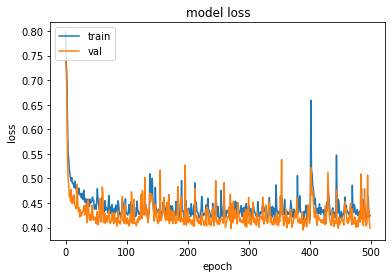

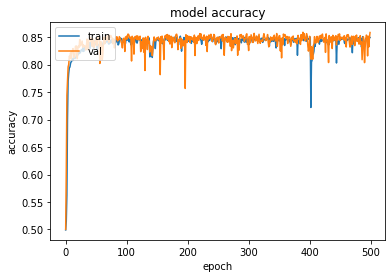

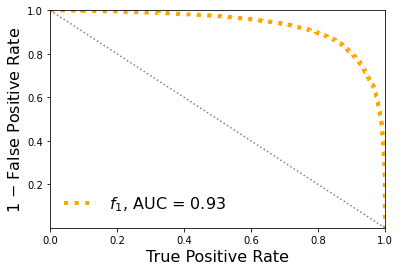

313/313 [==============================] - 1s 4ms/step - loss: 0.4022 - acc: 0.8576 - f1_m: 0.4651 - precision_m: 0.5003 - recall_m: 0.4357
Test ROC-AUC: 0.93072124
Test loss: 0.40224549174308777
Test accuracy: 0.8575999736785889
Test f1: 0.46506088972091675
Test precision: 0.5003194808959961
Test recall: 0.4357028901576996
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 69ms/step - loss: 0.7217 - acc: 0.5817 - f1_m: 0.4728 - precision_m: 0.5840 - recall_m: 0.4506 - val_loss: 0.5253 - val_acc: 0.7862 - val_f1_m: 0.8004 - val_precision_m: 0.7444 - val_recall_m: 0.8687
Epoch 2/500
188/188 [==============================] - 12s 66ms/step - loss: 0.5463 - acc: 0.7736 - f1_m: 0.7767 - precision_m: 0.7708 - recall_m: 0.7906 - val_loss: 0.4990 - val_acc: 0.7950 - val_f1_m: 0.7712 - val_precision_m: 0.8615 - v

Epoch 31/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4418 - acc: 0.8432 - f1_m: 0.8457 - precision_m: 0.8313 - recall_m: 0.8652 - val_loss: 0.4435 - val_acc: 0.8373 - val_f1_m: 0.8429 - val_precision_m: 0.8087 - val_recall_m: 0.8832
Epoch 32/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4511 - acc: 0.8391 - f1_m: 0.8393 - precision_m: 0.8336 - recall_m: 0.8530 - val_loss: 0.4417 - val_acc: 0.8307 - val_f1_m: 0.8193 - val_precision_m: 0.8681 - val_recall_m: 0.7785
Epoch 33/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4335 - acc: 0.8450 - f1_m: 0.8460 - precision_m: 0.8354 - recall_m: 0.8616 - val_loss: 0.4328 - val_acc: 0.8437 - val_f1_m: 0.8473 - val_precision_m: 0.8200 - val_recall_m: 0.8788
Epoch 34/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4402 - acc: 0.8442 - f1_m: 0.8468 - precision_m: 0.8353 - recall_m: 0.8658 - val_loss: 0.4399 - val_acc: 0.8330 - val_f1_m: 0.8241 - val_pre

188/188 [==============================] - 12s 66ms/step - loss: 0.4081 - acc: 0.8598 - f1_m: 0.8627 - precision_m: 0.8521 - recall_m: 0.8783 - val_loss: 0.4296 - val_acc: 0.8497 - val_f1_m: 0.8500 - val_precision_m: 0.8411 - val_recall_m: 0.8621
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4184 - acc: 0.8595 - f1_m: 0.8620 - precision_m: 0.8515 - recall_m: 0.8786 - val_loss: 0.4654 - val_acc: 0.8483 - val_f1_m: 0.8547 - val_precision_m: 0.8138 - val_recall_m: 0.9023
Epoch 95/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4522 - acc: 0.8488 - f1_m: 0.8512 - precision_m: 0.8370 - recall_m: 0.8713 - val_loss: 0.4382 - val_acc: 0.8377 - val_f1_m: 0.8292 - val_precision_m: 0.8663 - val_recall_m: 0.7970
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4140 - acc: 0.8630 - f1_m: 0.8661 - precision_m: 0.8544 - recall_m: 0.8819 - val_loss: 0.4276 - val_acc: 0.8497 - val_f1_m: 0.8574 - val_precision_m: 0.8

188/188 [==============================] - 12s 66ms/step - loss: 0.4083 - acc: 0.8602 - f1_m: 0.8620 - precision_m: 0.8513 - recall_m: 0.8777 - val_loss: 0.4349 - val_acc: 0.8422 - val_f1_m: 0.8385 - val_precision_m: 0.8521 - val_recall_m: 0.8278
Epoch 156/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4000 - acc: 0.8641 - f1_m: 0.8645 - precision_m: 0.8545 - recall_m: 0.8793 - val_loss: 0.4288 - val_acc: 0.8458 - val_f1_m: 0.8434 - val_precision_m: 0.8484 - val_recall_m: 0.8406
Epoch 157/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3978 - acc: 0.8655 - f1_m: 0.8657 - precision_m: 0.8547 - recall_m: 0.8810 - val_loss: 0.4330 - val_acc: 0.8432 - val_f1_m: 0.8405 - val_precision_m: 0.8481 - val_recall_m: 0.8357
Epoch 158/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4191 - acc: 0.8553 - f1_m: 0.8581 - precision_m: 0.8522 - recall_m: 0.8696 - val_loss: 0.4300 - val_acc: 0.8432 - val_f1_m: 0.8417 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4544 - acc: 0.8455 - f1_m: 0.8486 - precision_m: 0.8299 - recall_m: 0.8721 - val_loss: 0.4649 - val_acc: 0.8290 - val_f1_m: 0.8316 - val_precision_m: 0.8138 - val_recall_m: 0.8534
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4478 - acc: 0.8440 - f1_m: 0.8470 - precision_m: 0.8302 - recall_m: 0.8680 - val_loss: 0.4705 - val_acc: 0.8325 - val_f1_m: 0.8349 - val_precision_m: 0.8185 - val_recall_m: 0.8549
Epoch 219/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4461 - acc: 0.8475 - f1_m: 0.8505 - precision_m: 0.8344 - recall_m: 0.8699 - val_loss: 0.4555 - val_acc: 0.8330 - val_f1_m: 0.8350 - val_precision_m: 0.8205 - val_recall_m: 0.8536
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4399 - acc: 0.8454 - f1_m: 0.8468 - precision_m: 0.8347 - recall_m: 0.8632 - val_loss: 0.4672 - val_acc: 0.8150 - val_f1_m: 0.8025 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3944 - acc: 0.8651 - f1_m: 0.8664 - precision_m: 0.8655 - recall_m: 0.8714 - val_loss: 0.4402 - val_acc: 0.8282 - val_f1_m: 0.8141 - val_precision_m: 0.8777 - val_recall_m: 0.7622
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3967 - acc: 0.8641 - f1_m: 0.8653 - precision_m: 0.8598 - recall_m: 0.8744 - val_loss: 0.4560 - val_acc: 0.8350 - val_f1_m: 0.8438 - val_precision_m: 0.7948 - val_recall_m: 0.9019
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4088 - acc: 0.8646 - f1_m: 0.8653 - precision_m: 0.8586 - recall_m: 0.8767 - val_loss: 0.4269 - val_acc: 0.8453 - val_f1_m: 0.8386 - val_precision_m: 0.8655 - val_recall_m: 0.8164
Epoch 282/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3968 - acc: 0.8659 - f1_m: 0.8666 - precision_m: 0.8589 - recall_m: 0.8792 - val_loss: 0.4316 - val_acc: 0.8437 - val_f1_m: 0.8425 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3925 - acc: 0.8694 - f1_m: 0.8709 - precision_m: 0.8676 - recall_m: 0.8780 - val_loss: 0.4588 - val_acc: 0.8387 - val_f1_m: 0.8476 - val_precision_m: 0.7977 - val_recall_m: 0.9074
Epoch 342/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4076 - acc: 0.8649 - f1_m: 0.8656 - precision_m: 0.8568 - recall_m: 0.8790 - val_loss: 0.4324 - val_acc: 0.8407 - val_f1_m: 0.8394 - val_precision_m: 0.8387 - val_recall_m: 0.8430
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4034 - acc: 0.8697 - f1_m: 0.8686 - precision_m: 0.8614 - recall_m: 0.8797 - val_loss: 0.4539 - val_acc: 0.8352 - val_f1_m: 0.8305 - val_precision_m: 0.8485 - val_recall_m: 0.8166
Epoch 344/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4033 - acc: 0.8642 - f1_m: 0.8634 - precision_m: 0.8633 - recall_m: 0.8678 - val_loss: 0.4389 - val_acc: 0.8445 - val_f1_m: 0.8473 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4123 - acc: 0.8534 - f1_m: 0.8542 - precision_m: 0.8450 - recall_m: 0.8675 - val_loss: 0.4193 - val_acc: 0.8513 - val_f1_m: 0.8528 - val_precision_m: 0.8380 - val_recall_m: 0.8707
Epoch 404/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4187 - acc: 0.8524 - f1_m: 0.8556 - precision_m: 0.8421 - recall_m: 0.8726 - val_loss: 0.4286 - val_acc: 0.8345 - val_f1_m: 0.8282 - val_precision_m: 0.8551 - val_recall_m: 0.8058
Epoch 405/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4094 - acc: 0.8581 - f1_m: 0.8589 - precision_m: 0.8462 - recall_m: 0.8759 - val_loss: 0.4149 - val_acc: 0.8463 - val_f1_m: 0.8422 - val_precision_m: 0.8568 - val_recall_m: 0.8303
Epoch 406/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4055 - acc: 0.8597 - f1_m: 0.8629 - precision_m: 0.8519 - recall_m: 0.8781 - val_loss: 0.4151 - val_acc: 0.8402 - val_f1_m: 0.8302 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4308 - acc: 0.8428 - f1_m: 0.8431 - precision_m: 0.8337 - recall_m: 0.8569 - val_loss: 0.4292 - val_acc: 0.8365 - val_f1_m: 0.8332 - val_precision_m: 0.8440 - val_recall_m: 0.8257
Epoch 466/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4105 - acc: 0.8565 - f1_m: 0.8564 - precision_m: 0.8535 - recall_m: 0.8647 - val_loss: 0.4191 - val_acc: 0.8487 - val_f1_m: 0.8496 - val_precision_m: 0.8375 - val_recall_m: 0.8652
Epoch 467/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4044 - acc: 0.8614 - f1_m: 0.8623 - precision_m: 0.8575 - recall_m: 0.8700 - val_loss: 0.4182 - val_acc: 0.8485 - val_f1_m: 0.8488 - val_precision_m: 0.8383 - val_recall_m: 0.8618
Epoch 468/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4064 - acc: 0.8612 - f1_m: 0.8620 - precision_m: 0.8516 - recall_m: 0.8767 - val_loss: 0.4370 - val_acc: 0.8403 - val_f1_m: 0.8338 - val_precision_m: 

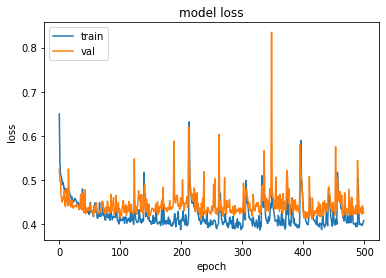

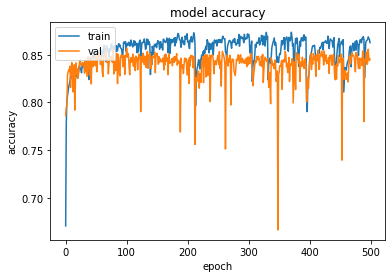

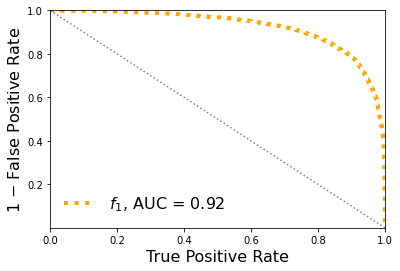

313/313 [==============================] - 1s 4ms/step - loss: 0.4313 - acc: 0.8443 - f1_m: 0.4556 - precision_m: 0.5000 - recall_m: 0.4196
Test ROC-AUC: 0.9228447200000001
Test loss: 0.43134814500808716
Test accuracy: 0.8442999720573425
Test f1: 0.45557790994644165
Test precision: 0.5
Test recall: 0.4196285903453827
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 144ms/step - loss: 1.0175 - acc: 0.5143 - f1_m: 0.4253 - precision_m: 0.5264 - recall_m: 0.3853 - val_loss: 0.7321 - val_acc: 0.6923 - val_f1_m: 0.7548 - val_precision_m: 0.6222 - val_recall_m: 0.9613
Epoch 2/500
94/94 [==============================] - 13s 136ms/step - loss: 0.7188 - acc: 0.6137 - f1_m: 0.6076 - precision_m: 0.6158 - recall_m: 0.6112 - val_loss: 0.6206 - val_acc: 0.7675 - val_f1_m: 0.7745 - val_precision_m: 0.7447 - val_recall

Epoch 31/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4762 - acc: 0.8184 - f1_m: 0.8235 - precision_m: 0.8074 - recall_m: 0.8453 - val_loss: 0.4443 - val_acc: 0.8402 - val_f1_m: 0.8465 - val_precision_m: 0.8068 - val_recall_m: 0.8917
Epoch 32/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4542 - acc: 0.8345 - f1_m: 0.8358 - precision_m: 0.8216 - recall_m: 0.8529 - val_loss: 0.4282 - val_acc: 0.8408 - val_f1_m: 0.8402 - val_precision_m: 0.8289 - val_recall_m: 0.8532
Epoch 33/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4430 - acc: 0.8359 - f1_m: 0.8405 - precision_m: 0.8178 - recall_m: 0.8667 - val_loss: 0.4319 - val_acc: 0.8368 - val_f1_m: 0.8316 - val_precision_m: 0.8487 - val_recall_m: 0.8167
Epoch 34/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4528 - acc: 0.8345 - f1_m: 0.8360 - precision_m: 0.8240 - recall_m: 0.8536 - val_loss: 0.4409 - val_acc: 0.8332 - val_f1_m: 0.8301 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4253 - acc: 0.8462 - f1_m: 0.8504 - precision_m: 0.8272 - recall_m: 0.8784 - val_loss: 0.4363 - val_acc: 0.8357 - val_f1_m: 0.8291 - val_precision_m: 0.8524 - val_recall_m: 0.8085
Epoch 64/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4073 - acc: 0.8555 - f1_m: 0.8596 - precision_m: 0.8399 - recall_m: 0.8817 - val_loss: 0.4170 - val_acc: 0.8458 - val_f1_m: 0.8431 - val_precision_m: 0.8450 - val_recall_m: 0.8431
Epoch 65/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4053 - acc: 0.8551 - f1_m: 0.8581 - precision_m: 0.8369 - recall_m: 0.8828 - val_loss: 0.4264 - val_acc: 0.8440 - val_f1_m: 0.8464 - val_precision_m: 0.8209 - val_recall_m: 0.8748
Epoch 66/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4132 - acc: 0.8512 - f1_m: 0.8556 - precision_m: 0.8317 - recall_m: 0.8829 - val_loss: 0.4177 - val_acc: 0.8500 - val_f1_m: 0.8541 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3936 - acc: 0.8620 - f1_m: 0.8668 - precision_m: 0.8385 - recall_m: 0.9004 - val_loss: 0.4148 - val_acc: 0.8527 - val_f1_m: 0.8555 - val_precision_m: 0.8284 - val_recall_m: 0.8858
Epoch 96/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3870 - acc: 0.8636 - f1_m: 0.8677 - precision_m: 0.8400 - recall_m: 0.8998 - val_loss: 0.4328 - val_acc: 0.8387 - val_f1_m: 0.8315 - val_precision_m: 0.8587 - val_recall_m: 0.8071
Epoch 97/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3894 - acc: 0.8675 - f1_m: 0.8702 - precision_m: 0.8484 - recall_m: 0.8954 - val_loss: 0.4203 - val_acc: 0.8458 - val_f1_m: 0.8421 - val_precision_m: 0.8481 - val_recall_m: 0.8376
Epoch 98/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3905 - acc: 0.8616 - f1_m: 0.8651 - precision_m: 0.8406 - recall_m: 0.8949 - val_loss: 0.4884 - val_acc: 0.8375 - val_f1_m: 0.8495 - val_precisi

94/94 [==============================] - 13s 138ms/step - loss: 0.4375 - acc: 0.8438 - f1_m: 0.8464 - precision_m: 0.8286 - recall_m: 0.8697 - val_loss: 0.4233 - val_acc: 0.8470 - val_f1_m: 0.8535 - val_precision_m: 0.8143 - val_recall_m: 0.8981
Epoch 158/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4365 - acc: 0.8449 - f1_m: 0.8495 - precision_m: 0.8239 - recall_m: 0.8799 - val_loss: 0.4424 - val_acc: 0.8392 - val_f1_m: 0.8272 - val_precision_m: 0.8825 - val_recall_m: 0.7803
Epoch 159/500
94/94 [==============================] - 13s 138ms/step - loss: 0.4484 - acc: 0.8380 - f1_m: 0.8409 - precision_m: 0.8191 - recall_m: 0.8683 - val_loss: 0.4124 - val_acc: 0.8453 - val_f1_m: 0.8520 - val_precision_m: 0.8085 - val_recall_m: 0.9021
Epoch 160/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4278 - acc: 0.8461 - f1_m: 0.8515 - precision_m: 0.8218 - recall_m: 0.8862 - val_loss: 0.4097 - val_acc: 0.8492 - val_f1_m: 0.8513 - val_precision_m: 0.83

94/94 [==============================] - 13s 137ms/step - loss: 0.3753 - acc: 0.8718 - f1_m: 0.8757 - precision_m: 0.8478 - recall_m: 0.9085 - val_loss: 0.4431 - val_acc: 0.8435 - val_f1_m: 0.8351 - val_precision_m: 0.8716 - val_recall_m: 0.8034
Epoch 220/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3799 - acc: 0.8688 - f1_m: 0.8719 - precision_m: 0.8515 - recall_m: 0.8962 - val_loss: 0.4298 - val_acc: 0.8525 - val_f1_m: 0.8568 - val_precision_m: 0.8253 - val_recall_m: 0.8926
Epoch 221/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3673 - acc: 0.8788 - f1_m: 0.8818 - precision_m: 0.8602 - recall_m: 0.9060 - val_loss: 0.4272 - val_acc: 0.8483 - val_f1_m: 0.8451 - val_precision_m: 0.8585 - val_recall_m: 0.8339
Epoch 222/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3564 - acc: 0.8829 - f1_m: 0.8855 - precision_m: 0.8650 - recall_m: 0.9089 - val_loss: 0.4378 - val_acc: 0.8428 - val_f1_m: 0.8505 - val_precision_m: 0.80

94/94 [==============================] - 13s 137ms/step - loss: 0.3860 - acc: 0.8698 - f1_m: 0.8733 - precision_m: 0.8492 - recall_m: 0.9012 - val_loss: 0.4385 - val_acc: 0.8392 - val_f1_m: 0.8298 - val_precision_m: 0.8669 - val_recall_m: 0.7976
Epoch 282/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3854 - acc: 0.8702 - f1_m: 0.8728 - precision_m: 0.8511 - recall_m: 0.8992 - val_loss: 0.4520 - val_acc: 0.8430 - val_f1_m: 0.8409 - val_precision_m: 0.8402 - val_recall_m: 0.8435
Epoch 283/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3682 - acc: 0.8770 - f1_m: 0.8803 - precision_m: 0.8587 - recall_m: 0.9047 - val_loss: 0.4343 - val_acc: 0.8455 - val_f1_m: 0.8446 - val_precision_m: 0.8372 - val_recall_m: 0.8539
Epoch 284/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3699 - acc: 0.8774 - f1_m: 0.8804 - precision_m: 0.8601 - recall_m: 0.9043 - val_loss: 0.4516 - val_acc: 0.8373 - val_f1_m: 0.8464 - val_precision_m: 0.79

94/94 [==============================] - 13s 137ms/step - loss: 1.2628 - acc: 0.5024 - f1_m: 0.4817 - precision_m: 0.4977 - recall_m: 0.4694 - val_loss: 0.9822 - val_acc: 0.7685 - val_f1_m: 0.7997 - val_precision_m: 0.6990 - val_recall_m: 0.9360
Epoch 344/500
94/94 [==============================] - 13s 137ms/step - loss: 0.9940 - acc: 0.5050 - f1_m: 0.5187 - precision_m: 0.5030 - recall_m: 0.5383 - val_loss: 0.9107 - val_acc: 0.7067 - val_f1_m: 0.7681 - val_precision_m: 0.6313 - val_recall_m: 0.9826
Epoch 345/500
94/94 [==============================] - 13s 138ms/step - loss: 0.9152 - acc: 0.5130 - f1_m: 0.5394 - precision_m: 0.5185 - recall_m: 0.5642 - val_loss: 0.8717 - val_acc: 0.5518 - val_f1_m: 0.6876 - val_precision_m: 0.5246 - val_recall_m: 1.0000
Epoch 346/500
94/94 [==============================] - 13s 137ms/step - loss: 0.8748 - acc: 0.5137 - f1_m: 0.5328 - precision_m: 0.5119 - recall_m: 0.5584 - val_loss: 0.8461 - val_acc: 0.5143 - val_f1_m: 0.6701 - val_precision_m: 0.50

94/94 [==============================] - 13s 139ms/step - loss: 0.3637 - acc: 0.8820 - f1_m: 0.8850 - precision_m: 0.8709 - recall_m: 0.9010 - val_loss: 0.4190 - val_acc: 0.8525 - val_f1_m: 0.8589 - val_precision_m: 0.8192 - val_recall_m: 0.9043
Epoch 406/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3827 - acc: 0.8697 - f1_m: 0.8727 - precision_m: 0.8563 - recall_m: 0.8927 - val_loss: 0.4079 - val_acc: 0.8575 - val_f1_m: 0.8598 - val_precision_m: 0.8378 - val_recall_m: 0.8847
Epoch 407/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3698 - acc: 0.8746 - f1_m: 0.8768 - precision_m: 0.8653 - recall_m: 0.8909 - val_loss: 0.4171 - val_acc: 0.8530 - val_f1_m: 0.8522 - val_precision_m: 0.8502 - val_recall_m: 0.8557
Epoch 408/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3725 - acc: 0.8796 - f1_m: 0.8796 - precision_m: 0.8678 - recall_m: 0.8930 - val_loss: 0.4112 - val_acc: 0.8445 - val_f1_m: 0.8383 - val_precision_m: 0.86

94/94 [==============================] - 13s 137ms/step - loss: 0.3492 - acc: 0.8904 - f1_m: 0.8918 - precision_m: 0.8839 - recall_m: 0.9014 - val_loss: 0.4535 - val_acc: 0.8478 - val_f1_m: 0.8528 - val_precision_m: 0.8241 - val_recall_m: 0.8853
Epoch 468/500
94/94 [==============================] - 13s 138ms/step - loss: 0.3683 - acc: 0.8850 - f1_m: 0.8857 - precision_m: 0.8752 - recall_m: 0.8977 - val_loss: 0.4449 - val_acc: 0.8487 - val_f1_m: 0.8467 - val_precision_m: 0.8485 - val_recall_m: 0.8467
Epoch 469/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3519 - acc: 0.8920 - f1_m: 0.8931 - precision_m: 0.8851 - recall_m: 0.9033 - val_loss: 0.4925 - val_acc: 0.8407 - val_f1_m: 0.8329 - val_precision_m: 0.8622 - val_recall_m: 0.8071
Epoch 470/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3822 - acc: 0.8819 - f1_m: 0.8815 - precision_m: 0.8731 - recall_m: 0.8924 - val_loss: 0.4553 - val_acc: 0.8510 - val_f1_m: 0.8519 - val_precision_m: 0.83

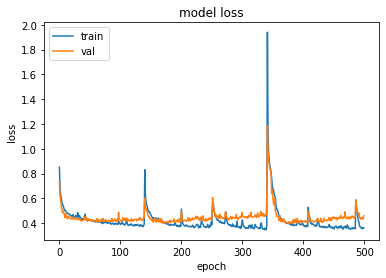

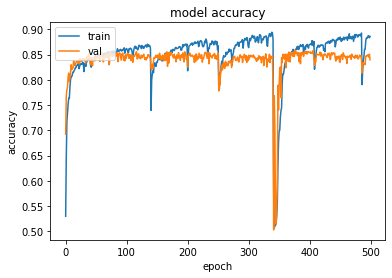

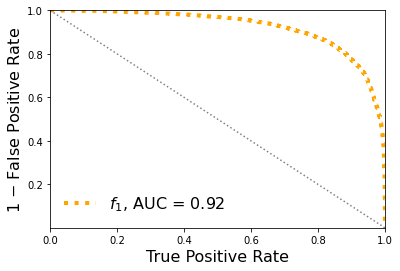

313/313 [==============================] - 1s 4ms/step - loss: 0.4589 - acc: 0.8422 - f1_m: 0.4516 - precision_m: 0.5002 - recall_m: 0.4128
Test ROC-AUC: 0.92189626
Test loss: 0.45886680483818054
Test accuracy: 0.842199981212616
Test f1: 0.45155709981918335
Test precision: 0.5001775026321411
Test recall: 0.41283944249153137
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 14s 35ms/step - loss: 0.7818 - acc: 0.6611 - f1_m: 0.6445 - precision_m: 0.6720 - recall_m: 0.6540 - val_loss: 0.5208 - val_acc: 0.7953 - val_f1_m: 0.7875 - val_precision_m: 0.8090 - val_recall_m: 0.7728
Epoch 2/500
375/375 [==============================] - 13s 34ms/step - loss: 0.5634 - acc: 0.7775 - f1_m: 0.7741 - precision_m: 0.7787 - recall_m: 0.7842 - val_loss: 0.5169 - val_acc: 0.7995 - val_f1_m: 0.7802 - val_precision_m: 0.8508 - val

Epoch 31/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4556 - acc: 0.8372 - f1_m: 0.8358 - precision_m: 0.8306 - recall_m: 0.8478 - val_loss: 0.4357 - val_acc: 0.8380 - val_f1_m: 0.8334 - val_precision_m: 0.8455 - val_recall_m: 0.8266
Epoch 32/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4646 - acc: 0.8347 - f1_m: 0.8335 - precision_m: 0.8324 - recall_m: 0.8426 - val_loss: 0.4441 - val_acc: 0.8342 - val_f1_m: 0.8260 - val_precision_m: 0.8554 - val_recall_m: 0.8033
Epoch 33/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4600 - acc: 0.8378 - f1_m: 0.8363 - precision_m: 0.8323 - recall_m: 0.8490 - val_loss: 0.4431 - val_acc: 0.8348 - val_f1_m: 0.8270 - val_precision_m: 0.8549 - val_recall_m: 0.8051
Epoch 34/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4600 - acc: 0.8343 - f1_m: 0.8337 - precision_m: 0.8354 - recall_m: 0.8402 - val_loss: 0.4541 - val_acc: 0.8397 - val_f1_m: 0.8427 - val_pre

375/375 [==============================] - 13s 34ms/step - loss: 0.4512 - acc: 0.8433 - f1_m: 0.8427 - precision_m: 0.8388 - recall_m: 0.8543 - val_loss: 0.4268 - val_acc: 0.8452 - val_f1_m: 0.8426 - val_precision_m: 0.8468 - val_recall_m: 0.8428
Epoch 94/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4404 - acc: 0.8447 - f1_m: 0.8455 - precision_m: 0.8387 - recall_m: 0.8586 - val_loss: 0.4227 - val_acc: 0.8488 - val_f1_m: 0.8500 - val_precision_m: 0.8324 - val_recall_m: 0.8730
Epoch 95/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4549 - acc: 0.8353 - f1_m: 0.8352 - precision_m: 0.8364 - recall_m: 0.8443 - val_loss: 0.4410 - val_acc: 0.8263 - val_f1_m: 0.8081 - val_precision_m: 0.8909 - val_recall_m: 0.7435
Epoch 96/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4428 - acc: 0.8377 - f1_m: 0.8355 - precision_m: 0.8367 - recall_m: 0.8434 - val_loss: 0.4223 - val_acc: 0.8485 - val_f1_m: 0.8434 - val_precision_m: 0.8

375/375 [==============================] - 13s 34ms/step - loss: 0.4557 - acc: 0.8352 - f1_m: 0.8361 - precision_m: 0.8286 - recall_m: 0.8555 - val_loss: 0.4212 - val_acc: 0.8503 - val_f1_m: 0.8563 - val_precision_m: 0.8141 - val_recall_m: 0.9083
Epoch 156/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4297 - acc: 0.8503 - f1_m: 0.8533 - precision_m: 0.8377 - recall_m: 0.8765 - val_loss: 0.4089 - val_acc: 0.8515 - val_f1_m: 0.8497 - val_precision_m: 0.8492 - val_recall_m: 0.8548
Epoch 157/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4351 - acc: 0.8498 - f1_m: 0.8485 - precision_m: 0.8456 - recall_m: 0.8605 - val_loss: 0.4122 - val_acc: 0.8518 - val_f1_m: 0.8520 - val_precision_m: 0.8395 - val_recall_m: 0.8697
Epoch 158/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4401 - acc: 0.8441 - f1_m: 0.8446 - precision_m: 0.8343 - recall_m: 0.8629 - val_loss: 0.4309 - val_acc: 0.8517 - val_f1_m: 0.8518 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4444 - acc: 0.8426 - f1_m: 0.8429 - precision_m: 0.8354 - recall_m: 0.8597 - val_loss: 0.4329 - val_acc: 0.8443 - val_f1_m: 0.8396 - val_precision_m: 0.8555 - val_recall_m: 0.8295
Epoch 218/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4551 - acc: 0.8413 - f1_m: 0.8404 - precision_m: 0.8298 - recall_m: 0.8619 - val_loss: 0.4060 - val_acc: 0.8518 - val_f1_m: 0.8512 - val_precision_m: 0.8426 - val_recall_m: 0.8647
Epoch 219/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4260 - acc: 0.8516 - f1_m: 0.8514 - precision_m: 0.8457 - recall_m: 0.8642 - val_loss: 0.4085 - val_acc: 0.8535 - val_f1_m: 0.8585 - val_precision_m: 0.8193 - val_recall_m: 0.9066
Epoch 220/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4399 - acc: 0.8458 - f1_m: 0.8476 - precision_m: 0.8339 - recall_m: 0.8679 - val_loss: 0.4880 - val_acc: 0.8138 - val_f1_m: 0.7902 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4482 - acc: 0.8392 - f1_m: 0.8387 - precision_m: 0.8302 - recall_m: 0.8573 - val_loss: 0.4097 - val_acc: 0.8490 - val_f1_m: 0.8462 - val_precision_m: 0.8473 - val_recall_m: 0.8495
Epoch 280/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4214 - acc: 0.8519 - f1_m: 0.8520 - precision_m: 0.8409 - recall_m: 0.8690 - val_loss: 0.4746 - val_acc: 0.8230 - val_f1_m: 0.8416 - val_precision_m: 0.7507 - val_recall_m: 0.9621
Epoch 281/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4602 - acc: 0.8341 - f1_m: 0.8342 - precision_m: 0.8253 - recall_m: 0.8563 - val_loss: 0.4372 - val_acc: 0.8452 - val_f1_m: 0.8558 - val_precision_m: 0.7907 - val_recall_m: 0.9374
Epoch 282/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4287 - acc: 0.8517 - f1_m: 0.8501 - precision_m: 0.8397 - recall_m: 0.8679 - val_loss: 0.4113 - val_acc: 0.8435 - val_f1_m: 0.8378 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4360 - acc: 0.8480 - f1_m: 0.8485 - precision_m: 0.8320 - recall_m: 0.8746 - val_loss: 0.4210 - val_acc: 0.8403 - val_f1_m: 0.8308 - val_precision_m: 0.8741 - val_recall_m: 0.7960
Epoch 342/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4298 - acc: 0.8456 - f1_m: 0.8454 - precision_m: 0.8361 - recall_m: 0.8620 - val_loss: 0.4122 - val_acc: 0.8505 - val_f1_m: 0.8530 - val_precision_m: 0.8260 - val_recall_m: 0.8866
Epoch 343/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4691 - acc: 0.8309 - f1_m: 0.8306 - precision_m: 0.8275 - recall_m: 0.8490 - val_loss: 0.4132 - val_acc: 0.8533 - val_f1_m: 0.8566 - val_precision_m: 0.8267 - val_recall_m: 0.8932
Epoch 344/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4254 - acc: 0.8496 - f1_m: 0.8506 - precision_m: 0.8414 - recall_m: 0.8669 - val_loss: 0.4071 - val_acc: 0.8542 - val_f1_m: 0.8584 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4345 - acc: 0.8472 - f1_m: 0.8483 - precision_m: 0.8353 - recall_m: 0.8691 - val_loss: 0.4174 - val_acc: 0.8455 - val_f1_m: 0.8391 - val_precision_m: 0.8639 - val_recall_m: 0.8200
Epoch 404/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4294 - acc: 0.8437 - f1_m: 0.8448 - precision_m: 0.8382 - recall_m: 0.8607 - val_loss: 0.4086 - val_acc: 0.8480 - val_f1_m: 0.8483 - val_precision_m: 0.8363 - val_recall_m: 0.8659
Epoch 405/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4507 - acc: 0.8390 - f1_m: 0.8375 - precision_m: 0.8344 - recall_m: 0.8518 - val_loss: 0.4174 - val_acc: 0.8503 - val_f1_m: 0.8474 - val_precision_m: 0.8515 - val_recall_m: 0.8475
Epoch 406/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4383 - acc: 0.8455 - f1_m: 0.8482 - precision_m: 0.8366 - recall_m: 0.8672 - val_loss: 0.4021 - val_acc: 0.8548 - val_f1_m: 0.8552 - val_precision_m: 

375/375 [==============================] - 13s 34ms/step - loss: 0.4325 - acc: 0.8475 - f1_m: 0.8481 - precision_m: 0.8362 - recall_m: 0.8678 - val_loss: 0.4173 - val_acc: 0.8408 - val_f1_m: 0.8308 - val_precision_m: 0.8744 - val_recall_m: 0.7965
Epoch 466/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4318 - acc: 0.8458 - f1_m: 0.8468 - precision_m: 0.8369 - recall_m: 0.8638 - val_loss: 0.4411 - val_acc: 0.8395 - val_f1_m: 0.8530 - val_precision_m: 0.7753 - val_recall_m: 0.9525
Epoch 467/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4209 - acc: 0.8488 - f1_m: 0.8491 - precision_m: 0.8381 - recall_m: 0.8680 - val_loss: 0.4116 - val_acc: 0.8517 - val_f1_m: 0.8468 - val_precision_m: 0.8658 - val_recall_m: 0.8335
Epoch 468/500
375/375 [==============================] - 13s 34ms/step - loss: 0.4513 - acc: 0.8372 - f1_m: 0.8389 - precision_m: 0.8302 - recall_m: 0.8594 - val_loss: 0.5267 - val_acc: 0.8362 - val_f1_m: 0.8325 - val_precision_m: 

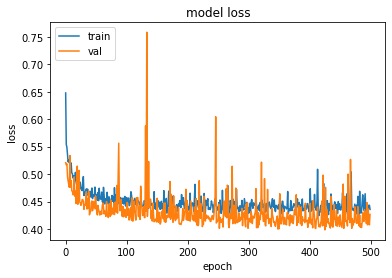

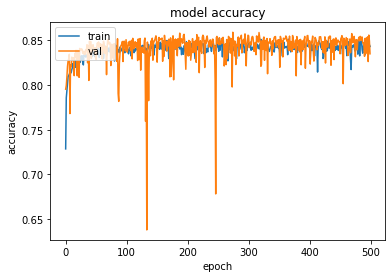

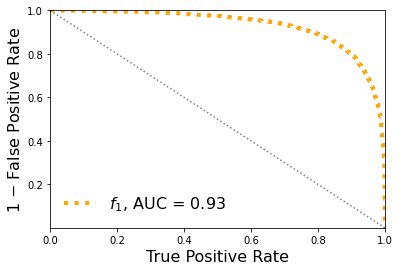

313/313 [==============================] - 1s 4ms/step - loss: 0.4408 - acc: 0.8423 - f1_m: 0.4404 - precision_m: 0.5005 - recall_m: 0.3947
Test ROC-AUC: 0.92892888
Test loss: 0.4408479630947113
Test accuracy: 0.8422999978065491
Test f1: 0.44039493799209595
Test precision: 0.5005325078964233
Test recall: 0.3946685194969177
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 14s 69ms/step - loss: 1.2958 - acc: 0.5176 - f1_m: 0.5098 - precision_m: 0.5228 - recall_m: 0.5355 - val_loss: 0.6031 - val_acc: 0.7572 - val_f1_m: 0.7808 - val_precision_m: 0.7064 - val_recall_m: 0.8754
Epoch 2/500
188/188 [==============================] - 12s 66ms/step - loss: 0.6458 - acc: 0.7355 - f1_m: 0.7256 - precision_m: 0.7453 - recall_m: 0.7207 - val_loss: 0.5468 - val_acc: 0.7837 - val_f1_m: 0.7673 - val_precision_m: 0.8209 - val

Epoch 31/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4493 - acc: 0.8435 - f1_m: 0.8430 - precision_m: 0.8317 - recall_m: 0.8617 - val_loss: 0.4286 - val_acc: 0.8448 - val_f1_m: 0.8413 - val_precision_m: 0.8542 - val_recall_m: 0.8315
Epoch 32/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4387 - acc: 0.8467 - f1_m: 0.8452 - precision_m: 0.8356 - recall_m: 0.8607 - val_loss: 0.4420 - val_acc: 0.8413 - val_f1_m: 0.8475 - val_precision_m: 0.8096 - val_recall_m: 0.8922
Epoch 33/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4492 - acc: 0.8410 - f1_m: 0.8434 - precision_m: 0.8297 - recall_m: 0.8638 - val_loss: 0.4371 - val_acc: 0.8462 - val_f1_m: 0.8462 - val_precision_m: 0.8387 - val_recall_m: 0.8570
Epoch 34/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4521 - acc: 0.8432 - f1_m: 0.8448 - precision_m: 0.8338 - recall_m: 0.8632 - val_loss: 0.4360 - val_acc: 0.8400 - val_f1_m: 0.8347 - val_pre

188/188 [==============================] - 12s 66ms/step - loss: 0.4056 - acc: 0.8614 - f1_m: 0.8622 - precision_m: 0.8524 - recall_m: 0.8753 - val_loss: 0.4222 - val_acc: 0.8412 - val_f1_m: 0.8365 - val_precision_m: 0.8539 - val_recall_m: 0.8222
Epoch 94/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4113 - acc: 0.8550 - f1_m: 0.8586 - precision_m: 0.8454 - recall_m: 0.8767 - val_loss: 0.4183 - val_acc: 0.8465 - val_f1_m: 0.8433 - val_precision_m: 0.8542 - val_recall_m: 0.8352
Epoch 95/500
188/188 [==============================] - 13s 67ms/step - loss: 0.4154 - acc: 0.8540 - f1_m: 0.8560 - precision_m: 0.8439 - recall_m: 0.8733 - val_loss: 0.4415 - val_acc: 0.8402 - val_f1_m: 0.8509 - val_precision_m: 0.7914 - val_recall_m: 0.9230
Epoch 96/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4929 - acc: 0.8181 - f1_m: 0.8228 - precision_m: 0.8091 - recall_m: 0.8519 - val_loss: 0.4744 - val_acc: 0.8140 - val_f1_m: 0.8325 - val_precision_m: 0.7

188/188 [==============================] - 12s 66ms/step - loss: 0.4175 - acc: 0.8516 - f1_m: 0.8540 - precision_m: 0.8455 - recall_m: 0.8667 - val_loss: 0.4286 - val_acc: 0.8315 - val_f1_m: 0.8203 - val_precision_m: 0.8690 - val_recall_m: 0.7786
Epoch 156/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4056 - acc: 0.8571 - f1_m: 0.8561 - precision_m: 0.8525 - recall_m: 0.8642 - val_loss: 0.4149 - val_acc: 0.8513 - val_f1_m: 0.8544 - val_precision_m: 0.8310 - val_recall_m: 0.8819
Epoch 157/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4058 - acc: 0.8582 - f1_m: 0.8609 - precision_m: 0.8462 - recall_m: 0.8803 - val_loss: 0.4417 - val_acc: 0.8218 - val_f1_m: 0.8032 - val_precision_m: 0.8863 - val_recall_m: 0.7365
Epoch 158/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4112 - acc: 0.8567 - f1_m: 0.8576 - precision_m: 0.8538 - recall_m: 0.8658 - val_loss: 0.4165 - val_acc: 0.8518 - val_f1_m: 0.8534 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4187 - acc: 0.8490 - f1_m: 0.8495 - precision_m: 0.8428 - recall_m: 0.8615 - val_loss: 0.4065 - val_acc: 0.8535 - val_f1_m: 0.8583 - val_precision_m: 0.8233 - val_recall_m: 0.8979
Epoch 218/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3943 - acc: 0.8660 - f1_m: 0.8690 - precision_m: 0.8558 - recall_m: 0.8869 - val_loss: 0.4066 - val_acc: 0.8517 - val_f1_m: 0.8490 - val_precision_m: 0.8583 - val_recall_m: 0.8426
Epoch 219/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3998 - acc: 0.8607 - f1_m: 0.8625 - precision_m: 0.8497 - recall_m: 0.8797 - val_loss: 0.4240 - val_acc: 0.8527 - val_f1_m: 0.8565 - val_precision_m: 0.8291 - val_recall_m: 0.8888
Epoch 220/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4154 - acc: 0.8491 - f1_m: 0.8518 - precision_m: 0.8399 - recall_m: 0.8703 - val_loss: 0.4285 - val_acc: 0.8483 - val_f1_m: 0.8456 - val_precision_m: 

188/188 [==============================] - 13s 67ms/step - loss: 0.4057 - acc: 0.8597 - f1_m: 0.8615 - precision_m: 0.8467 - recall_m: 0.8805 - val_loss: 0.4006 - val_acc: 0.8540 - val_f1_m: 0.8525 - val_precision_m: 0.8541 - val_recall_m: 0.8530
Epoch 280/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3994 - acc: 0.8594 - f1_m: 0.8608 - precision_m: 0.8506 - recall_m: 0.8752 - val_loss: 0.4262 - val_acc: 0.8378 - val_f1_m: 0.8253 - val_precision_m: 0.8848 - val_recall_m: 0.7754
Epoch 281/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4037 - acc: 0.8597 - f1_m: 0.8624 - precision_m: 0.8521 - recall_m: 0.8785 - val_loss: 0.4017 - val_acc: 0.8597 - val_f1_m: 0.8605 - val_precision_m: 0.8492 - val_recall_m: 0.8747
Epoch 282/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3977 - acc: 0.8613 - f1_m: 0.8638 - precision_m: 0.8507 - recall_m: 0.8805 - val_loss: 0.4159 - val_acc: 0.8477 - val_f1_m: 0.8450 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4701 - acc: 0.8260 - f1_m: 0.8323 - precision_m: 0.8064 - recall_m: 0.8672 - val_loss: 0.4204 - val_acc: 0.8490 - val_f1_m: 0.8541 - val_precision_m: 0.8190 - val_recall_m: 0.8952
Epoch 342/500
188/188 [==============================] - 12s 67ms/step - loss: 0.4395 - acc: 0.8417 - f1_m: 0.8433 - precision_m: 0.8251 - recall_m: 0.8678 - val_loss: 0.4186 - val_acc: 0.8455 - val_f1_m: 0.8395 - val_precision_m: 0.8659 - val_recall_m: 0.8170
Epoch 343/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4124 - acc: 0.8579 - f1_m: 0.8608 - precision_m: 0.8458 - recall_m: 0.8802 - val_loss: 0.4068 - val_acc: 0.8427 - val_f1_m: 0.8367 - val_precision_m: 0.8608 - val_recall_m: 0.8162
Epoch 344/500
188/188 [==============================] - 12s 66ms/step - loss: 0.3966 - acc: 0.8599 - f1_m: 0.8622 - precision_m: 0.8507 - recall_m: 0.8772 - val_loss: 0.4112 - val_acc: 0.8513 - val_f1_m: 0.8606 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.3994 - acc: 0.8611 - f1_m: 0.8628 - precision_m: 0.8478 - recall_m: 0.8823 - val_loss: 0.4099 - val_acc: 0.8440 - val_f1_m: 0.8396 - val_precision_m: 0.8581 - val_recall_m: 0.8245
Epoch 404/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4070 - acc: 0.8554 - f1_m: 0.8574 - precision_m: 0.8495 - recall_m: 0.8714 - val_loss: 0.4105 - val_acc: 0.8435 - val_f1_m: 0.8343 - val_precision_m: 0.8779 - val_recall_m: 0.7969
Epoch 405/500
188/188 [==============================] - 13s 67ms/step - loss: 0.3958 - acc: 0.8633 - f1_m: 0.8649 - precision_m: 0.8539 - recall_m: 0.8804 - val_loss: 0.4022 - val_acc: 0.8515 - val_f1_m: 0.8494 - val_precision_m: 0.8554 - val_recall_m: 0.8458
Epoch 406/500
188/188 [==============================] - 12s 67ms/step - loss: 0.3920 - acc: 0.8605 - f1_m: 0.8605 - precision_m: 0.8538 - recall_m: 0.8712 - val_loss: 0.4424 - val_acc: 0.8480 - val_f1_m: 0.8428 - val_precision_m: 

188/188 [==============================] - 12s 66ms/step - loss: 0.4003 - acc: 0.8598 - f1_m: 0.8623 - precision_m: 0.8517 - recall_m: 0.8767 - val_loss: 0.4088 - val_acc: 0.8535 - val_f1_m: 0.8582 - val_precision_m: 0.8282 - val_recall_m: 0.8930
Epoch 466/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4182 - acc: 0.8471 - f1_m: 0.8504 - precision_m: 0.8361 - recall_m: 0.8705 - val_loss: 0.4134 - val_acc: 0.8457 - val_f1_m: 0.8381 - val_precision_m: 0.8750 - val_recall_m: 0.8066
Epoch 467/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4483 - acc: 0.8404 - f1_m: 0.8421 - precision_m: 0.8380 - recall_m: 0.8567 - val_loss: 0.4213 - val_acc: 0.8525 - val_f1_m: 0.8548 - val_precision_m: 0.8367 - val_recall_m: 0.8768
Epoch 468/500
188/188 [==============================] - 12s 66ms/step - loss: 0.4358 - acc: 0.8489 - f1_m: 0.8512 - precision_m: 0.8362 - recall_m: 0.8728 - val_loss: 0.4034 - val_acc: 0.8552 - val_f1_m: 0.8541 - val_precision_m: 

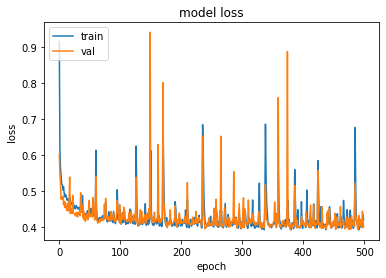

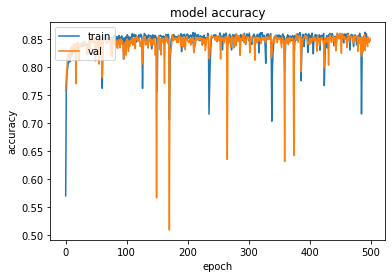

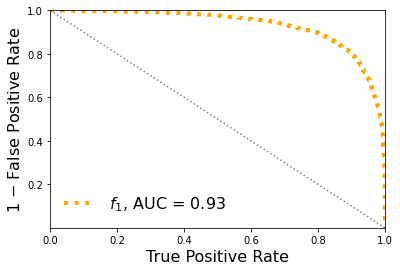

313/313 [==============================] - 1s 4ms/step - loss: 0.4117 - acc: 0.8534 - f1_m: 0.4587 - precision_m: 0.5003 - recall_m: 0.4246
Test ROC-AUC: 0.9301675600000001
Test loss: 0.41172918677330017
Test accuracy: 0.8533999919891357
Test f1: 0.4587338864803314
Test precision: 0.5003194808959961
Test recall: 0.4246205985546112
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  8
learning_rate :  0.01
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 15s 143ms/step - loss: 1.1798 - acc: 0.5444 - f1_m: 0.4710 - precision_m: 0.5576 - recall_m: 0.4469 - val_loss: 0.6016 - val_acc: 0.7577 - val_f1_m: 0.7684 - val_precision_m: 0.7263 - val_recall_m: 0.8180
Epoch 2/500
94/94 [==============================] - 13s 137ms/step - loss: 0.6063 - acc: 0.7628 - f1_m: 0.7666 - precision_m: 0.7528 - recall_m: 0.7852 - val_loss: 0.5257 - val_acc: 0.7975 - val_f1_m: 0.7873 - val_precision_m: 0.8192

Epoch 31/500
94/94 [==============================] - 13s 138ms/step - loss: 0.4249 - acc: 0.8586 - f1_m: 0.8608 - precision_m: 0.8577 - recall_m: 0.8681 - val_loss: 0.4712 - val_acc: 0.8355 - val_f1_m: 0.8497 - val_precision_m: 0.7729 - val_recall_m: 0.9447
Epoch 32/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4261 - acc: 0.8569 - f1_m: 0.8594 - precision_m: 0.8488 - recall_m: 0.8741 - val_loss: 0.4546 - val_acc: 0.8378 - val_f1_m: 0.8468 - val_precision_m: 0.7941 - val_recall_m: 0.9085
Epoch 33/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4260 - acc: 0.8556 - f1_m: 0.8565 - precision_m: 0.8518 - recall_m: 0.8670 - val_loss: 0.4360 - val_acc: 0.8523 - val_f1_m: 0.8574 - val_precision_m: 0.8213 - val_recall_m: 0.8982
Epoch 34/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4272 - acc: 0.8562 - f1_m: 0.8560 - precision_m: 0.8525 - recall_m: 0.8652 - val_loss: 0.4682 - val_acc: 0.8220 - val_f1_m: 0.8060 - val_precisi

Epoch 63/500
94/94 [==============================] - 13s 136ms/step - loss: 0.4077 - acc: 0.8632 - f1_m: 0.8654 - precision_m: 0.8599 - recall_m: 0.8759 - val_loss: 0.4199 - val_acc: 0.8527 - val_f1_m: 0.8519 - val_precision_m: 0.8440 - val_recall_m: 0.8616
Epoch 64/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4029 - acc: 0.8678 - f1_m: 0.8671 - precision_m: 0.8608 - recall_m: 0.8768 - val_loss: 0.4401 - val_acc: 0.8428 - val_f1_m: 0.8534 - val_precision_m: 0.7915 - val_recall_m: 0.9274
Epoch 65/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4141 - acc: 0.8627 - f1_m: 0.8647 - precision_m: 0.8553 - recall_m: 0.8787 - val_loss: 0.4300 - val_acc: 0.8485 - val_f1_m: 0.8498 - val_precision_m: 0.8345 - val_recall_m: 0.8671
Epoch 66/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4049 - acc: 0.8664 - f1_m: 0.8671 - precision_m: 0.8616 - recall_m: 0.8754 - val_loss: 0.4381 - val_acc: 0.8500 - val_f1_m: 0.8578 - val_precisi

Epoch 95/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3943 - acc: 0.8721 - f1_m: 0.8719 - precision_m: 0.8638 - recall_m: 0.8832 - val_loss: 0.4248 - val_acc: 0.8488 - val_f1_m: 0.8421 - val_precision_m: 0.8676 - val_recall_m: 0.8192
Epoch 96/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3819 - acc: 0.8776 - f1_m: 0.8797 - precision_m: 0.8766 - recall_m: 0.8855 - val_loss: 0.4189 - val_acc: 0.8525 - val_f1_m: 0.8537 - val_precision_m: 0.8402 - val_recall_m: 0.8692
Epoch 97/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3958 - acc: 0.8686 - f1_m: 0.8702 - precision_m: 0.8625 - recall_m: 0.8815 - val_loss: 0.4333 - val_acc: 0.8500 - val_f1_m: 0.8472 - val_precision_m: 0.8527 - val_recall_m: 0.8438
Epoch 98/500
94/94 [==============================] - 13s 138ms/step - loss: 0.4134 - acc: 0.8628 - f1_m: 0.8631 - precision_m: 0.8576 - recall_m: 0.8716 - val_loss: 0.4673 - val_acc: 0.8225 - val_f1_m: 0.8021 - val_precisi

94/94 [==============================] - 13s 136ms/step - loss: 0.3939 - acc: 0.8661 - f1_m: 0.8675 - precision_m: 0.8559 - recall_m: 0.8813 - val_loss: 0.4038 - val_acc: 0.8547 - val_f1_m: 0.8588 - val_precision_m: 0.8238 - val_recall_m: 0.8984
Epoch 158/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4001 - acc: 0.8607 - f1_m: 0.8617 - precision_m: 0.8501 - recall_m: 0.8767 - val_loss: 0.4197 - val_acc: 0.8323 - val_f1_m: 0.8204 - val_precision_m: 0.8748 - val_recall_m: 0.7746
Epoch 159/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3926 - acc: 0.8652 - f1_m: 0.8649 - precision_m: 0.8558 - recall_m: 0.8775 - val_loss: 0.4011 - val_acc: 0.8497 - val_f1_m: 0.8524 - val_precision_m: 0.8302 - val_recall_m: 0.8771
Epoch 160/500
94/94 [==============================] - 13s 137ms/step - loss: 0.3971 - acc: 0.8599 - f1_m: 0.8603 - precision_m: 0.8513 - recall_m: 0.8738 - val_loss: 0.4000 - val_acc: 0.8522 - val_f1_m: 0.8500 - val_precision_m: 0.85

94/94 [==============================] - 13s 134ms/step - loss: 0.3860 - acc: 0.8765 - f1_m: 0.8784 - precision_m: 0.8671 - recall_m: 0.8927 - val_loss: 0.4750 - val_acc: 0.8407 - val_f1_m: 0.8518 - val_precision_m: 0.7913 - val_recall_m: 0.9239
Epoch 220/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3952 - acc: 0.8731 - f1_m: 0.8746 - precision_m: 0.8670 - recall_m: 0.8845 - val_loss: 0.4334 - val_acc: 0.8525 - val_f1_m: 0.8495 - val_precision_m: 0.8583 - val_recall_m: 0.8429
Epoch 221/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3808 - acc: 0.8804 - f1_m: 0.8815 - precision_m: 0.8792 - recall_m: 0.8856 - val_loss: 0.4360 - val_acc: 0.8490 - val_f1_m: 0.8524 - val_precision_m: 0.8247 - val_recall_m: 0.8831
Epoch 222/500
94/94 [==============================] - 13s 137ms/step - loss: 0.4010 - acc: 0.8679 - f1_m: 0.8690 - precision_m: 0.8659 - recall_m: 0.8758 - val_loss: 0.4473 - val_acc: 0.8493 - val_f1_m: 0.8575 - val_precision_m: 0.80

94/94 [==============================] - 13s 135ms/step - loss: 0.3801 - acc: 0.8722 - f1_m: 0.8724 - precision_m: 0.8724 - recall_m: 0.8747 - val_loss: 0.4235 - val_acc: 0.8392 - val_f1_m: 0.8320 - val_precision_m: 0.8646 - val_recall_m: 0.8037
Epoch 282/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3851 - acc: 0.8737 - f1_m: 0.8751 - precision_m: 0.8739 - recall_m: 0.8782 - val_loss: 0.4202 - val_acc: 0.8450 - val_f1_m: 0.8389 - val_precision_m: 0.8609 - val_recall_m: 0.8192
Epoch 283/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3710 - acc: 0.8797 - f1_m: 0.8788 - precision_m: 0.8800 - recall_m: 0.8791 - val_loss: 0.4210 - val_acc: 0.8392 - val_f1_m: 0.8284 - val_precision_m: 0.8724 - val_recall_m: 0.7898
Epoch 284/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3829 - acc: 0.8745 - f1_m: 0.8754 - precision_m: 0.8729 - recall_m: 0.8807 - val_loss: 0.4225 - val_acc: 0.8443 - val_f1_m: 0.8424 - val_precision_m: 0.84

94/94 [==============================] - 13s 134ms/step - loss: 0.4216 - acc: 0.8569 - f1_m: 0.8545 - precision_m: 0.8670 - recall_m: 0.8495 - val_loss: 0.4687 - val_acc: 0.8472 - val_f1_m: 0.8423 - val_precision_m: 0.8564 - val_recall_m: 0.8305
Epoch 344/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4103 - acc: 0.8701 - f1_m: 0.8701 - precision_m: 0.8657 - recall_m: 0.8781 - val_loss: 0.4332 - val_acc: 0.8422 - val_f1_m: 0.8380 - val_precision_m: 0.8552 - val_recall_m: 0.8233
Epoch 345/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3742 - acc: 0.8797 - f1_m: 0.8793 - precision_m: 0.8803 - recall_m: 0.8796 - val_loss: 0.4274 - val_acc: 0.8497 - val_f1_m: 0.8471 - val_precision_m: 0.8482 - val_recall_m: 0.8475
Epoch 346/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3864 - acc: 0.8773 - f1_m: 0.8768 - precision_m: 0.8761 - recall_m: 0.8814 - val_loss: 0.4332 - val_acc: 0.8487 - val_f1_m: 0.8462 - val_precision_m: 0.85

94/94 [==============================] - 13s 135ms/step - loss: 0.3691 - acc: 0.8861 - f1_m: 0.8857 - precision_m: 0.8841 - recall_m: 0.8886 - val_loss: 0.4478 - val_acc: 0.8485 - val_f1_m: 0.8519 - val_precision_m: 0.8236 - val_recall_m: 0.8838
Epoch 406/500
94/94 [==============================] - 13s 136ms/step - loss: 0.3873 - acc: 0.8801 - f1_m: 0.8802 - precision_m: 0.8764 - recall_m: 0.8884 - val_loss: 0.4817 - val_acc: 0.8047 - val_f1_m: 0.7819 - val_precision_m: 0.8832 - val_recall_m: 0.7036
Epoch 407/500
94/94 [==============================] - 13s 135ms/step - loss: 0.4152 - acc: 0.8624 - f1_m: 0.8609 - precision_m: 0.8660 - recall_m: 0.8608 - val_loss: 0.4223 - val_acc: 0.8492 - val_f1_m: 0.8463 - val_precision_m: 0.8529 - val_recall_m: 0.8415
Epoch 408/500
94/94 [==============================] - 13s 135ms/step - loss: 0.3687 - acc: 0.8846 - f1_m: 0.8842 - precision_m: 0.8824 - recall_m: 0.8873 - val_loss: 0.4513 - val_acc: 0.8402 - val_f1_m: 0.8293 - val_precision_m: 0.87

94/94 [==============================] - 13s 135ms/step - loss: 1.0696 - acc: 0.5704 - f1_m: 0.5158 - precision_m: 0.5865 - recall_m: 0.4926 - val_loss: 0.8325 - val_acc: 0.5767 - val_f1_m: 0.2732 - val_precision_m: 0.9238 - val_recall_m: 0.1614
Epoch 468/500
94/94 [==============================] - 13s 135ms/step - loss: 0.8317 - acc: 0.6680 - f1_m: 0.6488 - precision_m: 0.6819 - recall_m: 0.6555 - val_loss: 0.7359 - val_acc: 0.7582 - val_f1_m: 0.7917 - val_precision_m: 0.6882 - val_recall_m: 0.9337
Epoch 469/500
94/94 [==============================] - 13s 136ms/step - loss: 0.7255 - acc: 0.7343 - f1_m: 0.7304 - precision_m: 0.7373 - recall_m: 0.7384 - val_loss: 0.6513 - val_acc: 0.7892 - val_f1_m: 0.7760 - val_precision_m: 0.8192 - val_recall_m: 0.7389
Epoch 470/500
94/94 [==============================] - 13s 136ms/step - loss: 0.6972 - acc: 0.7384 - f1_m: 0.7292 - precision_m: 0.7559 - recall_m: 0.7264 - val_loss: 0.6018 - val_acc: 0.7823 - val_f1_m: 0.7548 - val_precision_m: 0.85

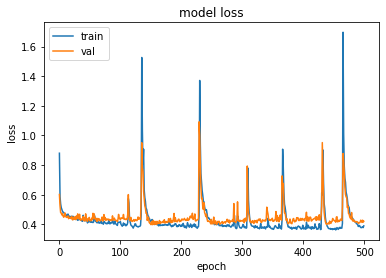

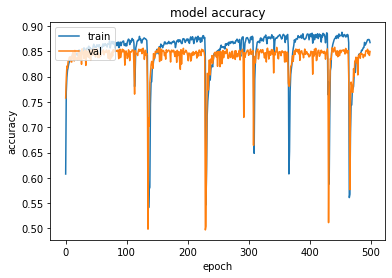

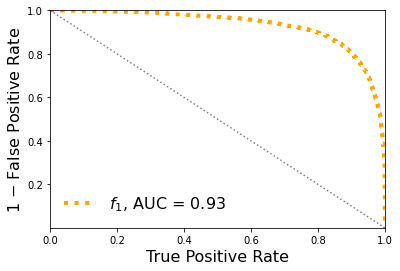

313/313 [==============================] - 1s 4ms/step - loss: 0.4210 - acc: 0.8524 - f1_m: 0.4730 - precision_m: 0.5001 - recall_m: 0.4496
Test ROC-AUC: 0.9292396599999999
Test loss: 0.42096060514450073
Test accuracy: 0.852400004863739
Test f1: 0.4729759991168976
Test precision: 0.5001451969146729
Test recall: 0.44958066940307617
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 1.0340 - acc: 0.5165 - f1_m: 0.5801 - precision_m: 0.5170 - recall_m: 0.7147 - val_loss: 0.6186 - val_acc: 0.7432 - val_f1_m: 0.7642 - val_precision_m: 0.6984 - val_recall_m: 0.8499
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.6170 - acc: 0.7253 - f1_m: 0.7151 - precision_m: 0.7314 - recall_m: 0.7137 - val_loss: 0.5280 - val_acc: 0.7930 - val_f1_m: 0.7940 - val_precision_m: 0

Epoch 31/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4451 - acc: 0.8341 - f1_m: 0.8351 - precision_m: 0.8256 - recall_m: 0.8540 - val_loss: 0.4335 - val_acc: 0.8378 - val_f1_m: 0.8364 - val_precision_m: 0.8320 - val_recall_m: 0.8462
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4906 - acc: 0.8268 - f1_m: 0.8319 - precision_m: 0.8142 - recall_m: 0.8604 - val_loss: 0.4672 - val_acc: 0.8243 - val_f1_m: 0.8236 - val_precision_m: 0.8144 - val_recall_m: 0.8381
Epoch 33/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4710 - acc: 0.8289 - f1_m: 0.8302 - precision_m: 0.8200 - recall_m: 0.8495 - val_loss: 0.4438 - val_acc: 0.8425 - val_f1_m: 0.8506 - val_precision_m: 0.7978 - val_recall_m: 0.9151
Epoch 34/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4297 - acc: 0.8445 - f1_m: 0.8445 - precision_m: 0.8323 - recall_m: 0.8649 - val_loss: 0.4627 - val_acc: 0.8232 - val_f1_m: 0.8386 - val_pre

375/375 [==============================] - 22s 60ms/step - loss: 0.4372 - acc: 0.8394 - f1_m: 0.8397 - precision_m: 0.8259 - recall_m: 0.8604 - val_loss: 0.4533 - val_acc: 0.8305 - val_f1_m: 0.8327 - val_precision_m: 0.8118 - val_recall_m: 0.8606
Epoch 94/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4975 - acc: 0.8368 - f1_m: 0.8353 - precision_m: 0.8236 - recall_m: 0.8558 - val_loss: 0.5750 - val_acc: 0.7925 - val_f1_m: 0.7906 - val_precision_m: 0.7861 - val_recall_m: 0.8007
Epoch 95/500
375/375 [==============================] - 22s 60ms/step - loss: 0.5768 - acc: 0.7862 - f1_m: 0.7890 - precision_m: 0.7768 - recall_m: 0.8098 - val_loss: 0.5382 - val_acc: 0.7858 - val_f1_m: 0.7622 - val_precision_m: 0.8404 - val_recall_m: 0.7031
Epoch 96/500
375/375 [==============================] - 22s 60ms/step - loss: 0.5199 - acc: 0.8078 - f1_m: 0.8111 - precision_m: 0.7979 - recall_m: 0.8335 - val_loss: 0.4677 - val_acc: 0.8298 - val_f1_m: 0.8358 - val_precision_m: 0.7

375/375 [==============================] - 22s 60ms/step - loss: 0.4366 - acc: 0.8461 - f1_m: 0.8479 - precision_m: 0.8388 - recall_m: 0.8640 - val_loss: 0.4565 - val_acc: 0.8320 - val_f1_m: 0.8276 - val_precision_m: 0.8373 - val_recall_m: 0.8233
Epoch 156/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4578 - acc: 0.8453 - f1_m: 0.8451 - precision_m: 0.8367 - recall_m: 0.8603 - val_loss: 0.4697 - val_acc: 0.8220 - val_f1_m: 0.8131 - val_precision_m: 0.8434 - val_recall_m: 0.7906
Epoch 157/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4369 - acc: 0.8491 - f1_m: 0.8482 - precision_m: 0.8443 - recall_m: 0.8578 - val_loss: 0.4481 - val_acc: 0.8333 - val_f1_m: 0.8307 - val_precision_m: 0.8342 - val_recall_m: 0.8327
Epoch 158/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4518 - acc: 0.8442 - f1_m: 0.8452 - precision_m: 0.8365 - recall_m: 0.8627 - val_loss: 0.4696 - val_acc: 0.8272 - val_f1_m: 0.8179 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4297 - acc: 0.8505 - f1_m: 0.8503 - precision_m: 0.8460 - recall_m: 0.8617 - val_loss: 0.4650 - val_acc: 0.8288 - val_f1_m: 0.8186 - val_precision_m: 0.8596 - val_recall_m: 0.7861
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4660 - acc: 0.8398 - f1_m: 0.8376 - precision_m: 0.8307 - recall_m: 0.8519 - val_loss: 0.4614 - val_acc: 0.8367 - val_f1_m: 0.8330 - val_precision_m: 0.8431 - val_recall_m: 0.8291
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4506 - acc: 0.8500 - f1_m: 0.8511 - precision_m: 0.8378 - recall_m: 0.8703 - val_loss: 0.4505 - val_acc: 0.8347 - val_f1_m: 0.8314 - val_precision_m: 0.8377 - val_recall_m: 0.8303
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4492 - acc: 0.8421 - f1_m: 0.8411 - precision_m: 0.8371 - recall_m: 0.8524 - val_loss: 0.5686 - val_acc: 0.8318 - val_f1_m: 0.8344 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4225 - acc: 0.8524 - f1_m: 0.8513 - precision_m: 0.8462 - recall_m: 0.8624 - val_loss: 0.4806 - val_acc: 0.8460 - val_f1_m: 0.8423 - val_precision_m: 0.8520 - val_recall_m: 0.8381
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4682 - acc: 0.8457 - f1_m: 0.8471 - precision_m: 0.8382 - recall_m: 0.8617 - val_loss: 0.4340 - val_acc: 0.8460 - val_f1_m: 0.8455 - val_precision_m: 0.8360 - val_recall_m: 0.8602
Epoch 281/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4334 - acc: 0.8541 - f1_m: 0.8560 - precision_m: 0.8450 - recall_m: 0.8735 - val_loss: 0.4336 - val_acc: 0.8385 - val_f1_m: 0.8304 - val_precision_m: 0.8635 - val_recall_m: 0.8054
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4307 - acc: 0.8499 - f1_m: 0.8491 - precision_m: 0.8442 - recall_m: 0.8600 - val_loss: 0.4531 - val_acc: 0.8467 - val_f1_m: 0.8439 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4407 - acc: 0.8409 - f1_m: 0.8409 - precision_m: 0.8334 - recall_m: 0.8564 - val_loss: 0.4513 - val_acc: 0.8157 - val_f1_m: 0.8040 - val_precision_m: 0.8442 - val_recall_m: 0.7729
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4370 - acc: 0.8335 - f1_m: 0.8349 - precision_m: 0.8281 - recall_m: 0.8488 - val_loss: 0.4422 - val_acc: 0.8328 - val_f1_m: 0.8356 - val_precision_m: 0.8129 - val_recall_m: 0.8657
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4329 - acc: 0.8401 - f1_m: 0.8385 - precision_m: 0.8291 - recall_m: 0.8556 - val_loss: 0.4553 - val_acc: 0.8255 - val_f1_m: 0.8364 - val_precision_m: 0.7762 - val_recall_m: 0.9114
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4281 - acc: 0.8396 - f1_m: 0.8424 - precision_m: 0.8288 - recall_m: 0.8625 - val_loss: 0.4506 - val_acc: 0.8192 - val_f1_m: 0.8148 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4300 - acc: 0.8436 - f1_m: 0.8446 - precision_m: 0.8323 - recall_m: 0.8628 - val_loss: 0.4577 - val_acc: 0.8262 - val_f1_m: 0.8267 - val_precision_m: 0.8128 - val_recall_m: 0.8468
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4376 - acc: 0.8447 - f1_m: 0.8454 - precision_m: 0.8362 - recall_m: 0.8613 - val_loss: 0.4620 - val_acc: 0.8258 - val_f1_m: 0.8329 - val_precision_m: 0.7879 - val_recall_m: 0.8876
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4337 - acc: 0.8441 - f1_m: 0.8472 - precision_m: 0.8331 - recall_m: 0.8697 - val_loss: 0.4599 - val_acc: 0.8300 - val_f1_m: 0.8333 - val_precision_m: 0.8021 - val_recall_m: 0.8719
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4245 - acc: 0.8452 - f1_m: 0.8455 - precision_m: 0.8318 - recall_m: 0.8660 - val_loss: 0.4507 - val_acc: 0.8298 - val_f1_m: 0.8291 - val_precision_m: 

375/375 [==============================] - 22s 59ms/step - loss: 0.4333 - acc: 0.8450 - f1_m: 0.8458 - precision_m: 0.8384 - recall_m: 0.8608 - val_loss: 0.4990 - val_acc: 0.8157 - val_f1_m: 0.8294 - val_precision_m: 0.7608 - val_recall_m: 0.9163
Epoch 466/500
375/375 [==============================] - 22s 59ms/step - loss: 0.4399 - acc: 0.8470 - f1_m: 0.8474 - precision_m: 0.8410 - recall_m: 0.8612 - val_loss: 0.4803 - val_acc: 0.8297 - val_f1_m: 0.8253 - val_precision_m: 0.8347 - val_recall_m: 0.8211
Epoch 467/500
375/375 [==============================] - 22s 59ms/step - loss: 0.4403 - acc: 0.8428 - f1_m: 0.8427 - precision_m: 0.8324 - recall_m: 0.8602 - val_loss: 0.4549 - val_acc: 0.8263 - val_f1_m: 0.8244 - val_precision_m: 0.8209 - val_recall_m: 0.8337
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4314 - acc: 0.8424 - f1_m: 0.8435 - precision_m: 0.8353 - recall_m: 0.8571 - val_loss: 0.4666 - val_acc: 0.8198 - val_f1_m: 0.8185 - val_precision_m: 

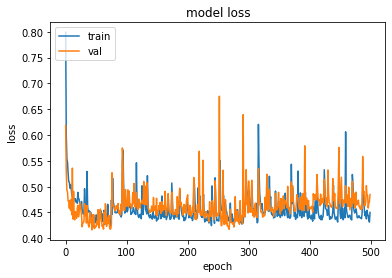

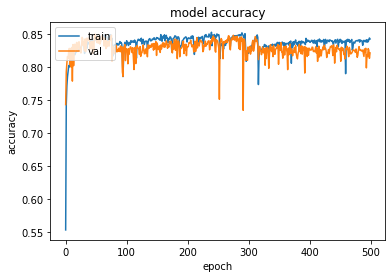

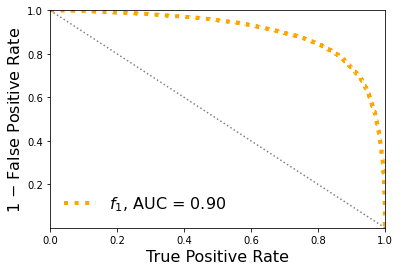

313/313 [==============================] - 2s 6ms/step - loss: 0.4881 - acc: 0.8245 - f1_m: 0.4671 - precision_m: 0.4998 - recall_m: 0.4397
Test ROC-AUC: 0.90277852
Test loss: 0.4880923330783844
Test accuracy: 0.8245000243186951
Test f1: 0.46711015701293945
Test precision: 0.4997718036174774
Test recall: 0.4396964907646179
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 117ms/step - loss: 1.1043 - acc: 0.5611 - f1_m: 0.5565 - precision_m: 0.5575 - recall_m: 0.5874 - val_loss: 0.5801 - val_acc: 0.7685 - val_f1_m: 0.7594 - val_precision_m: 0.7819 - val_recall_m: 0.7411
Epoch 2/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6202 - acc: 0.7160 - f1_m: 0.7058 - precision_m: 0.7253 - recall_m: 0.6922 - val_loss: 0.5613 - val_acc: 0.8008 - val_f1_m: 0.8049 - val_precision_m: 0.7831

188/188 [==============================] - 21s 114ms/step - loss: 0.4483 - acc: 0.8480 - f1_m: 0.8514 - precision_m: 0.8315 - recall_m: 0.8757 - val_loss: 0.4598 - val_acc: 0.8358 - val_f1_m: 0.8441 - val_precision_m: 0.7970 - val_recall_m: 0.8996
Epoch 62/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4451 - acc: 0.8463 - f1_m: 0.8501 - precision_m: 0.8245 - recall_m: 0.8812 - val_loss: 0.4510 - val_acc: 0.8370 - val_f1_m: 0.8384 - val_precision_m: 0.8233 - val_recall_m: 0.8569
Epoch 63/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4276 - acc: 0.8482 - f1_m: 0.8511 - precision_m: 0.8272 - recall_m: 0.8796 - val_loss: 0.4466 - val_acc: 0.8375 - val_f1_m: 0.8368 - val_precision_m: 0.8309 - val_recall_m: 0.8452
Epoch 64/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4278 - acc: 0.8506 - f1_m: 0.8547 - precision_m: 0.8311 - recall_m: 0.8819 - val_loss: 0.4363 - val_acc: 0.8405 - val_f1_m: 0.8439 - val_precision_m:

188/188 [==============================] - 21s 114ms/step - loss: 0.4593 - acc: 0.8300 - f1_m: 0.8298 - precision_m: 0.8245 - recall_m: 0.8399 - val_loss: 0.4448 - val_acc: 0.8325 - val_f1_m: 0.8387 - val_precision_m: 0.8021 - val_recall_m: 0.8812
Epoch 124/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4360 - acc: 0.8446 - f1_m: 0.8479 - precision_m: 0.8360 - recall_m: 0.8645 - val_loss: 0.4441 - val_acc: 0.8307 - val_f1_m: 0.8236 - val_precision_m: 0.8527 - val_recall_m: 0.7998
Epoch 125/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4386 - acc: 0.8424 - f1_m: 0.8406 - precision_m: 0.8347 - recall_m: 0.8521 - val_loss: 0.4553 - val_acc: 0.8303 - val_f1_m: 0.8338 - val_precision_m: 0.8101 - val_recall_m: 0.8614
Epoch 126/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4537 - acc: 0.8395 - f1_m: 0.8414 - precision_m: 0.8310 - recall_m: 0.8561 - val_loss: 0.4439 - val_acc: 0.8347 - val_f1_m: 0.8313 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4100 - acc: 0.8627 - f1_m: 0.8656 - precision_m: 0.8570 - recall_m: 0.8781 - val_loss: 0.5010 - val_acc: 0.8207 - val_f1_m: 0.8053 - val_precision_m: 0.8702 - val_recall_m: 0.7518
Epoch 186/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4080 - acc: 0.8649 - f1_m: 0.8651 - precision_m: 0.8594 - recall_m: 0.8744 - val_loss: 0.4720 - val_acc: 0.8307 - val_f1_m: 0.8308 - val_precision_m: 0.8225 - val_recall_m: 0.8419
Epoch 187/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4097 - acc: 0.8678 - f1_m: 0.8695 - precision_m: 0.8606 - recall_m: 0.8813 - val_loss: 0.4953 - val_acc: 0.8307 - val_f1_m: 0.8196 - val_precision_m: 0.8676 - val_recall_m: 0.7798
Epoch 188/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4202 - acc: 0.8598 - f1_m: 0.8601 - precision_m: 0.8501 - recall_m: 0.8747 - val_loss: 0.4810 - val_acc: 0.8325 - val_f1_m: 0.8375 - val_precision

188/188 [==============================] - 21s 113ms/step - loss: 0.3929 - acc: 0.8798 - f1_m: 0.8813 - precision_m: 0.8672 - recall_m: 0.8983 - val_loss: 0.4974 - val_acc: 0.8243 - val_f1_m: 0.8319 - val_precision_m: 0.7908 - val_recall_m: 0.8806
Epoch 248/500
188/188 [==============================] - 21s 114ms/step - loss: 0.3961 - acc: 0.8764 - f1_m: 0.8763 - precision_m: 0.8632 - recall_m: 0.8935 - val_loss: 0.4924 - val_acc: 0.8247 - val_f1_m: 0.8288 - val_precision_m: 0.8037 - val_recall_m: 0.8582
Epoch 249/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4003 - acc: 0.8726 - f1_m: 0.8726 - precision_m: 0.8565 - recall_m: 0.8926 - val_loss: 0.5151 - val_acc: 0.8300 - val_f1_m: 0.8370 - val_precision_m: 0.7978 - val_recall_m: 0.8834
Epoch 250/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4011 - acc: 0.8736 - f1_m: 0.8744 - precision_m: 0.8636 - recall_m: 0.8892 - val_loss: 0.5009 - val_acc: 0.8303 - val_f1_m: 0.8316 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4233 - acc: 0.8641 - f1_m: 0.8640 - precision_m: 0.8599 - recall_m: 0.8721 - val_loss: 0.4842 - val_acc: 0.8325 - val_f1_m: 0.8423 - val_precision_m: 0.7901 - val_recall_m: 0.9049
Epoch 310/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4117 - acc: 0.8675 - f1_m: 0.8675 - precision_m: 0.8608 - recall_m: 0.8788 - val_loss: 0.4795 - val_acc: 0.8290 - val_f1_m: 0.8245 - val_precision_m: 0.8371 - val_recall_m: 0.8146
Epoch 311/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4124 - acc: 0.8666 - f1_m: 0.8660 - precision_m: 0.8589 - recall_m: 0.8770 - val_loss: 0.4834 - val_acc: 0.8377 - val_f1_m: 0.8397 - val_precision_m: 0.8220 - val_recall_m: 0.8609
Epoch 312/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4258 - acc: 0.8717 - f1_m: 0.8705 - precision_m: 0.8660 - recall_m: 0.8808 - val_loss: 0.5641 - val_acc: 0.8217 - val_f1_m: 0.8318 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.5495 - acc: 0.8498 - f1_m: 0.8456 - precision_m: 0.8447 - recall_m: 0.8530 - val_loss: 0.5467 - val_acc: 0.8273 - val_f1_m: 0.8229 - val_precision_m: 0.8368 - val_recall_m: 0.8120
Epoch 372/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4726 - acc: 0.8646 - f1_m: 0.8656 - precision_m: 0.8532 - recall_m: 0.8814 - val_loss: 0.5250 - val_acc: 0.8268 - val_f1_m: 0.8324 - val_precision_m: 0.8005 - val_recall_m: 0.8701
Epoch 373/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4456 - acc: 0.8687 - f1_m: 0.8687 - precision_m: 0.8617 - recall_m: 0.8794 - val_loss: 0.5092 - val_acc: 0.8278 - val_f1_m: 0.8320 - val_precision_m: 0.8075 - val_recall_m: 0.8613
Epoch 374/500
188/188 [==============================] - 21s 113ms/step - loss: 0.4247 - acc: 0.8718 - f1_m: 0.8701 - precision_m: 0.8656 - recall_m: 0.8781 - val_loss: 0.5178 - val_acc: 0.8157 - val_f1_m: 0.8076 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4016 - acc: 0.8696 - f1_m: 0.8709 - precision_m: 0.8550 - recall_m: 0.8899 - val_loss: 0.5075 - val_acc: 0.8342 - val_f1_m: 0.8410 - val_precision_m: 0.8020 - val_recall_m: 0.8870
Epoch 434/500
188/188 [==============================] - 22s 115ms/step - loss: 0.5305 - acc: 0.8372 - f1_m: 0.8253 - precision_m: 0.8340 - recall_m: 0.8372 - val_loss: 0.6669 - val_acc: 0.7815 - val_f1_m: 0.7780 - val_precision_m: 0.7839 - val_recall_m: 0.7755
Epoch 435/500
188/188 [==============================] - 22s 116ms/step - loss: 0.6462 - acc: 0.7818 - f1_m: 0.7823 - precision_m: 0.7783 - recall_m: 0.7911 - val_loss: 0.5494 - val_acc: 0.8230 - val_f1_m: 0.8285 - val_precision_m: 0.7956 - val_recall_m: 0.8668
Epoch 436/500
188/188 [==============================] - 22s 114ms/step - loss: 0.5572 - acc: 0.8175 - f1_m: 0.8149 - precision_m: 0.8098 - recall_m: 0.8274 - val_loss: 0.5285 - val_acc: 0.8238 - val_f1_m: 0.8166 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4554 - acc: 0.8610 - f1_m: 0.8619 - precision_m: 0.8545 - recall_m: 0.8725 - val_loss: 0.4925 - val_acc: 0.8325 - val_f1_m: 0.8358 - val_precision_m: 0.8127 - val_recall_m: 0.8626
Epoch 496/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4244 - acc: 0.8653 - f1_m: 0.8663 - precision_m: 0.8615 - recall_m: 0.8752 - val_loss: 0.4921 - val_acc: 0.8248 - val_f1_m: 0.8203 - val_precision_m: 0.8347 - val_recall_m: 0.8091
Epoch 497/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4180 - acc: 0.8647 - f1_m: 0.8663 - precision_m: 0.8577 - recall_m: 0.8780 - val_loss: 0.4778 - val_acc: 0.8375 - val_f1_m: 0.8375 - val_precision_m: 0.8298 - val_recall_m: 0.8481
Epoch 498/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4088 - acc: 0.8670 - f1_m: 0.8688 - precision_m: 0.8628 - recall_m: 0.8776 - val_loss: 0.4807 - val_acc: 0.8312 - val_f1_m: 0.8390 - val_precision

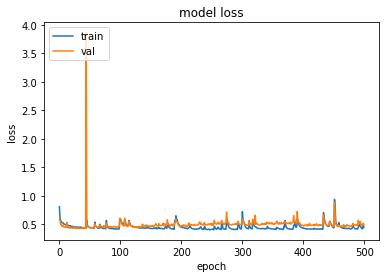

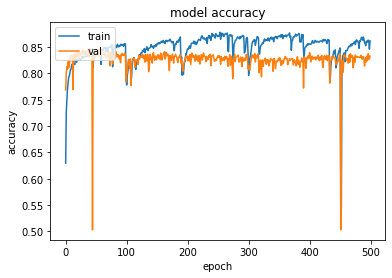

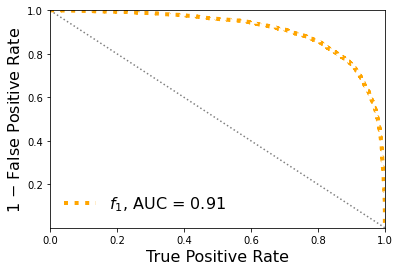

313/313 [==============================] - 2s 6ms/step - loss: 0.4887 - acc: 0.8290 - f1_m: 0.4440 - precision_m: 0.5000 - recall_m: 0.4007
Test ROC-AUC: 0.9101350199999999
Test loss: 0.48866939544677734
Test accuracy: 0.8289999961853027
Test f1: 0.4439890682697296
Test precision: 0.5
Test recall: 0.4006589353084564
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 250ms/step - loss: 0.8644 - acc: 0.4984 - f1_m: 0.1926 - precision_m: 0.4625 - recall_m: 0.2263 - val_loss: 0.7765 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 2/500
94/94 [==============================] - 22s 235ms/step - loss: 0.7594 - acc: 0.5289 - f1_m: 0.6600 - precision_m: 0.5302 - recall_m: 0.9230 - val_loss: 0.6795 - val_acc: 0.7633 - val_f1_m: 0.7676 - val_precision_m: 0.7499 - val_reca

Epoch 31/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4408 - acc: 0.8414 - f1_m: 0.8411 - precision_m: 0.8419 - recall_m: 0.8443 - val_loss: 0.4319 - val_acc: 0.8388 - val_f1_m: 0.8362 - val_precision_m: 0.8348 - val_recall_m: 0.8391
Epoch 32/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4588 - acc: 0.8336 - f1_m: 0.8331 - precision_m: 0.8387 - recall_m: 0.8323 - val_loss: 0.4339 - val_acc: 0.8383 - val_f1_m: 0.8348 - val_precision_m: 0.8406 - val_recall_m: 0.8305
Epoch 33/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4445 - acc: 0.8378 - f1_m: 0.8359 - precision_m: 0.8392 - recall_m: 0.8363 - val_loss: 0.4422 - val_acc: 0.8242 - val_f1_m: 0.8090 - val_precision_m: 0.8684 - val_recall_m: 0.7592
Epoch 34/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4463 - acc: 0.8376 - f1_m: 0.8397 - precision_m: 0.8432 - recall_m: 0.8396 - val_loss: 0.4555 - val_acc: 0.8213 - val_f1_m: 0.7992 - val_precisi

Epoch 63/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4432 - acc: 0.8458 - f1_m: 0.8460 - precision_m: 0.8454 - recall_m: 0.8499 - val_loss: 0.4483 - val_acc: 0.8417 - val_f1_m: 0.8457 - val_precision_m: 0.8151 - val_recall_m: 0.8803
Epoch 64/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4190 - acc: 0.8558 - f1_m: 0.8546 - precision_m: 0.8565 - recall_m: 0.8558 - val_loss: 0.4517 - val_acc: 0.8388 - val_f1_m: 0.8462 - val_precision_m: 0.7978 - val_recall_m: 0.9025
Epoch 65/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4172 - acc: 0.8553 - f1_m: 0.8568 - precision_m: 0.8550 - recall_m: 0.8632 - val_loss: 0.4434 - val_acc: 0.8387 - val_f1_m: 0.8398 - val_precision_m: 0.8259 - val_recall_m: 0.8558
Epoch 66/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4154 - acc: 0.8584 - f1_m: 0.8582 - precision_m: 0.8553 - recall_m: 0.8633 - val_loss: 0.4459 - val_acc: 0.8403 - val_f1_m: 0.8439 - val_precisi

Epoch 95/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4003 - acc: 0.8705 - f1_m: 0.8704 - precision_m: 0.8741 - recall_m: 0.8693 - val_loss: 0.4635 - val_acc: 0.8383 - val_f1_m: 0.8389 - val_precision_m: 0.8217 - val_recall_m: 0.8583
Epoch 96/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4062 - acc: 0.8689 - f1_m: 0.8670 - precision_m: 0.8690 - recall_m: 0.8673 - val_loss: 0.4736 - val_acc: 0.8392 - val_f1_m: 0.8409 - val_precision_m: 0.8207 - val_recall_m: 0.8635
Epoch 97/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4072 - acc: 0.8661 - f1_m: 0.8642 - precision_m: 0.8667 - recall_m: 0.8649 - val_loss: 0.4626 - val_acc: 0.8402 - val_f1_m: 0.8405 - val_precision_m: 0.8261 - val_recall_m: 0.8570
Epoch 98/500
94/94 [==============================] - 22s 235ms/step - loss: 0.3936 - acc: 0.8751 - f1_m: 0.8733 - precision_m: 0.8734 - recall_m: 0.8755 - val_loss: 0.4720 - val_acc: 0.8390 - val_f1_m: 0.8388 - val_precisi

94/94 [==============================] - 22s 234ms/step - loss: 0.4690 - acc: 0.8257 - f1_m: 0.8286 - precision_m: 0.8109 - recall_m: 0.8511 - val_loss: 0.4288 - val_acc: 0.8377 - val_f1_m: 0.8463 - val_precision_m: 0.7943 - val_recall_m: 0.9068
Epoch 158/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4533 - acc: 0.8348 - f1_m: 0.8367 - precision_m: 0.8237 - recall_m: 0.8537 - val_loss: 0.4513 - val_acc: 0.8268 - val_f1_m: 0.8135 - val_precision_m: 0.8687 - val_recall_m: 0.7669
Epoch 159/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4553 - acc: 0.8296 - f1_m: 0.8305 - precision_m: 0.8210 - recall_m: 0.8447 - val_loss: 0.4340 - val_acc: 0.8378 - val_f1_m: 0.8434 - val_precision_m: 0.8043 - val_recall_m: 0.8881
Epoch 160/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4401 - acc: 0.8412 - f1_m: 0.8435 - precision_m: 0.8314 - recall_m: 0.8575 - val_loss: 0.4211 - val_acc: 0.8485 - val_f1_m: 0.8522 - val_precision_m: 0.81

94/94 [==============================] - 22s 235ms/step - loss: 0.3857 - acc: 0.8677 - f1_m: 0.8668 - precision_m: 0.8699 - recall_m: 0.8653 - val_loss: 0.4478 - val_acc: 0.8337 - val_f1_m: 0.8247 - val_precision_m: 0.8628 - val_recall_m: 0.7918
Epoch 220/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3984 - acc: 0.8625 - f1_m: 0.8612 - precision_m: 0.8634 - recall_m: 0.8626 - val_loss: 0.4312 - val_acc: 0.8470 - val_f1_m: 0.8494 - val_precision_m: 0.8282 - val_recall_m: 0.8733
Epoch 221/500
94/94 [==============================] - 22s 234ms/step - loss: 0.3841 - acc: 0.8678 - f1_m: 0.8686 - precision_m: 0.8686 - recall_m: 0.8708 - val_loss: 0.4496 - val_acc: 0.8440 - val_f1_m: 0.8409 - val_precision_m: 0.8463 - val_recall_m: 0.8374
Epoch 222/500
94/94 [==============================] - 22s 235ms/step - loss: 0.3745 - acc: 0.8748 - f1_m: 0.8742 - precision_m: 0.8784 - recall_m: 0.8718 - val_loss: 0.4448 - val_acc: 0.8435 - val_f1_m: 0.8434 - val_precision_m: 0.83

Epoch 250/500
94/94 [==============================] - 22s 235ms/step - loss: 0.7746 - acc: 0.5019 - f1_m: 0.4502 - precision_m: 0.5101 - recall_m: 0.4088 - val_loss: 0.7552 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 251/500
94/94 [==============================] - 22s 235ms/step - loss: 0.7588 - acc: 0.5132 - f1_m: 0.1962 - precision_m: 0.5745 - recall_m: 0.1324 - val_loss: 0.7446 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 252/500
94/94 [==============================] - 22s 235ms/step - loss: 0.7464 - acc: 0.5107 - f1_m: 0.4670 - precision_m: 0.5149 - recall_m: 0.4299 - val_loss: 0.7388 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 253/500
94/94 [==============================] - 22s 235ms/step - loss: 0.7424 - acc: 0.5267 - f1_m: 0.3340 - precision_m: 0.5864 - recall_m: 0.2561 - val_loss: 0.7345 - val_acc:

94/94 [==============================] - 22s 235ms/step - loss: 0.6997 - acc: 0.5008 - f1_m: 0.6239 - precision_m: 0.4729 - recall_m: 0.9334 - val_loss: 0.6988 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 312/500
94/94 [==============================] - 22s 235ms/step - loss: 0.6985 - acc: 0.5022 - f1_m: 0.6680 - precision_m: 0.5022 - recall_m: 1.0000 - val_loss: 0.6978 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 313/500
94/94 [==============================] - 22s 236ms/step - loss: 0.6976 - acc: 0.4998 - f1_m: 0.6447 - precision_m: 0.4988 - recall_m: 0.9624 - val_loss: 0.6971 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 314/500
94/94 [==============================] - 22s 234ms/step - loss: 0.6969 - acc: 0.4959 - f1_m: 0.4689 - precision_m: 0.3759 - recall_m: 0.6978 - val_loss: 0.6965 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

94/94 [==============================] - 22s 231ms/step - loss: 0.6932 - acc: 0.5055 - f1_m: 0.6711 - precision_m: 0.5055 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 374/500
94/94 [==============================] - 22s 231ms/step - loss: 0.6932 - acc: 0.5039 - f1_m: 0.6697 - precision_m: 0.5039 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 375/500
94/94 [==============================] - 22s 231ms/step - loss: 0.6932 - acc: 0.4885 - f1_m: 0.5836 - precision_m: 0.4610 - recall_m: 0.8643 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 376/500
94/94 [==============================] - 22s 232ms/step - loss: 0.6932 - acc: 0.5044 - f1_m: 0.6700 - precision_m: 0.5044 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

94/94 [==============================] - 22s 230ms/step - loss: 0.6932 - acc: 0.4975 - f1_m: 0.4645 - precision_m: 0.3565 - recall_m: 0.6898 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 436/500
94/94 [==============================] - 21s 228ms/step - loss: 0.6932 - acc: 0.4983 - f1_m: 0.6378 - precision_m: 0.4805 - recall_m: 0.9565 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 437/500
94/94 [==============================] - 21s 228ms/step - loss: 0.6932 - acc: 0.4956 - f1_m: 0.4700 - precision_m: 0.3569 - recall_m: 0.7064 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 438/500
94/94 [==============================] - 21s 228ms/step - loss: 0.6931 - acc: 0.5013 - f1_m: 0.6674 - precision_m: 0.5013 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

94/94 [==============================] - 22s 229ms/step - loss: 0.6932 - acc: 0.4934 - f1_m: 0.3899 - precision_m: 0.3002 - recall_m: 0.5909 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 498/500
94/94 [==============================] - 21s 228ms/step - loss: 0.6932 - acc: 0.4970 - f1_m: 0.6368 - precision_m: 0.4872 - recall_m: 0.9448 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 499/500
94/94 [==============================] - 21s 229ms/step - loss: 0.6932 - acc: 0.5003 - f1_m: 0.6664 - precision_m: 0.5003 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 500/500
94/94 [==============================] - 21s 228ms/step - loss: 0.6931 - acc: 0.5035 - f1_m: 0.6690 - precision_m: 0.5035 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

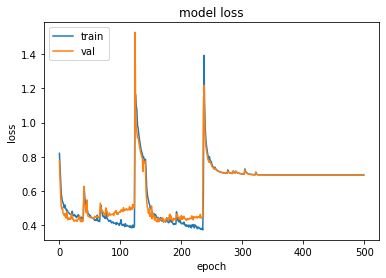

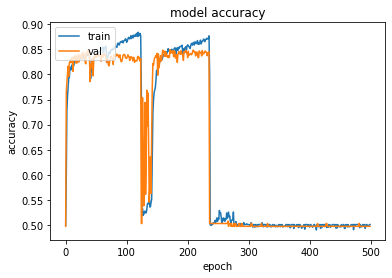

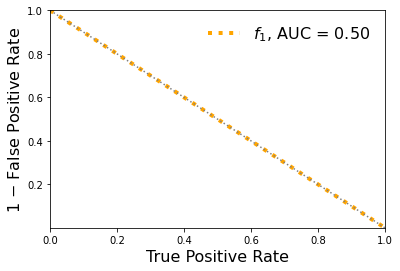

313/313 [==============================] - 2s 6ms/step - loss: 0.6932 - acc: 0.5000 - f1_m: 0.4997 - precision_m: 0.4992 - recall_m: 0.5016
Test ROC-AUC: 0.5
Test loss: 0.6931529641151428
Test accuracy: 0.5
Test f1: 0.4996804893016815
Test precision: 0.4992012679576874
Test recall: 0.5015974640846252
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.9162 - acc: 0.6081 - f1_m: 0.5361 - precision_m: 0.6150 - recall_m: 0.5253 - val_loss: 0.5684 - val_acc: 0.7842 - val_f1_m: 0.7812 - val_precision_m: 0.7815 - val_recall_m: 0.7865
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.6050 - acc: 0.7559 - f1_m: 0.7603 - precision_m: 0.7514 - recall_m: 0.7843 - val_loss: 0.5235 - val_acc: 0.8038 - val_f1_m: 0.8144 - val_precision_m: 0.7634 - val_recall_m: 0.8781
Epo

Epoch 31/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4829 - acc: 0.8284 - f1_m: 0.8270 - precision_m: 0.8216 - recall_m: 0.8427 - val_loss: 0.4565 - val_acc: 0.8417 - val_f1_m: 0.8470 - val_precision_m: 0.8083 - val_recall_m: 0.8943
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4665 - acc: 0.8341 - f1_m: 0.8337 - precision_m: 0.8270 - recall_m: 0.8493 - val_loss: 0.4434 - val_acc: 0.8390 - val_f1_m: 0.8428 - val_precision_m: 0.8122 - val_recall_m: 0.8810
Epoch 33/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4828 - acc: 0.8266 - f1_m: 0.8254 - precision_m: 0.8230 - recall_m: 0.8368 - val_loss: 0.4607 - val_acc: 0.8430 - val_f1_m: 0.8479 - val_precision_m: 0.8114 - val_recall_m: 0.8930
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.5019 - acc: 0.8166 - f1_m: 0.8140 - precision_m: 0.8162 - recall_m: 0.8255 - val_loss: 0.4855 - val_acc: 0.8078 - val_f1_m: 0.7819 - val_pre

375/375 [==============================] - 23s 60ms/step - loss: 0.4657 - acc: 0.8311 - f1_m: 0.8302 - precision_m: 0.8266 - recall_m: 0.8410 - val_loss: 0.4514 - val_acc: 0.8250 - val_f1_m: 0.8115 - val_precision_m: 0.8667 - val_recall_m: 0.7686
Epoch 94/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4684 - acc: 0.8280 - f1_m: 0.8254 - precision_m: 0.8236 - recall_m: 0.8365 - val_loss: 0.4275 - val_acc: 0.8473 - val_f1_m: 0.8476 - val_precision_m: 0.8363 - val_recall_m: 0.8644
Epoch 95/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4601 - acc: 0.8352 - f1_m: 0.8363 - precision_m: 0.8289 - recall_m: 0.8518 - val_loss: 0.4276 - val_acc: 0.8460 - val_f1_m: 0.8498 - val_precision_m: 0.8174 - val_recall_m: 0.8898
Epoch 96/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4731 - acc: 0.8285 - f1_m: 0.8287 - precision_m: 0.8254 - recall_m: 0.8425 - val_loss: 0.4642 - val_acc: 0.8363 - val_f1_m: 0.8442 - val_precision_m: 0.7

375/375 [==============================] - 23s 60ms/step - loss: 0.4505 - acc: 0.8336 - f1_m: 0.8344 - precision_m: 0.8245 - recall_m: 0.8512 - val_loss: 0.4175 - val_acc: 0.8527 - val_f1_m: 0.8565 - val_precision_m: 0.8217 - val_recall_m: 0.8987
Epoch 156/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4592 - acc: 0.8302 - f1_m: 0.8315 - precision_m: 0.8239 - recall_m: 0.8486 - val_loss: 0.4372 - val_acc: 0.8502 - val_f1_m: 0.8500 - val_precision_m: 0.8404 - val_recall_m: 0.8649
Epoch 157/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4570 - acc: 0.8353 - f1_m: 0.8375 - precision_m: 0.8230 - recall_m: 0.8589 - val_loss: 0.4357 - val_acc: 0.8333 - val_f1_m: 0.8214 - val_precision_m: 0.8701 - val_recall_m: 0.7820
Epoch 158/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4492 - acc: 0.8338 - f1_m: 0.8343 - precision_m: 0.8298 - recall_m: 0.8473 - val_loss: 0.4245 - val_acc: 0.8488 - val_f1_m: 0.8541 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4634 - acc: 0.8350 - f1_m: 0.8370 - precision_m: 0.8256 - recall_m: 0.8574 - val_loss: 0.4338 - val_acc: 0.8300 - val_f1_m: 0.8161 - val_precision_m: 0.8763 - val_recall_m: 0.7682
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4743 - acc: 0.8282 - f1_m: 0.8290 - precision_m: 0.8230 - recall_m: 0.8474 - val_loss: 0.4621 - val_acc: 0.8418 - val_f1_m: 0.8511 - val_precision_m: 0.7934 - val_recall_m: 0.9224
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4836 - acc: 0.8276 - f1_m: 0.8289 - precision_m: 0.8182 - recall_m: 0.8503 - val_loss: 0.4365 - val_acc: 0.8467 - val_f1_m: 0.8498 - val_precision_m: 0.8195 - val_recall_m: 0.8866
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4584 - acc: 0.8371 - f1_m: 0.8379 - precision_m: 0.8273 - recall_m: 0.8570 - val_loss: 0.5249 - val_acc: 0.8128 - val_f1_m: 0.8348 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4462 - acc: 0.8427 - f1_m: 0.8443 - precision_m: 0.8326 - recall_m: 0.8635 - val_loss: 0.4196 - val_acc: 0.8522 - val_f1_m: 0.8569 - val_precision_m: 0.8196 - val_recall_m: 0.9025
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4415 - acc: 0.8403 - f1_m: 0.8407 - precision_m: 0.8284 - recall_m: 0.8617 - val_loss: 0.4379 - val_acc: 0.8437 - val_f1_m: 0.8381 - val_precision_m: 0.8549 - val_recall_m: 0.8266
Epoch 281/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4620 - acc: 0.8356 - f1_m: 0.8377 - precision_m: 0.8287 - recall_m: 0.8559 - val_loss: 0.4260 - val_acc: 0.8470 - val_f1_m: 0.8500 - val_precision_m: 0.8240 - val_recall_m: 0.8827
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4580 - acc: 0.8394 - f1_m: 0.8409 - precision_m: 0.8272 - recall_m: 0.8644 - val_loss: 0.4369 - val_acc: 0.8448 - val_f1_m: 0.8521 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4511 - acc: 0.8388 - f1_m: 0.8391 - precision_m: 0.8244 - recall_m: 0.8628 - val_loss: 0.4717 - val_acc: 0.8445 - val_f1_m: 0.8463 - val_precision_m: 0.8287 - val_recall_m: 0.8694
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4916 - acc: 0.8265 - f1_m: 0.8280 - precision_m: 0.8134 - recall_m: 0.8533 - val_loss: 0.4475 - val_acc: 0.8432 - val_f1_m: 0.8356 - val_precision_m: 0.8655 - val_recall_m: 0.8126
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4600 - acc: 0.8313 - f1_m: 0.8312 - precision_m: 0.8166 - recall_m: 0.8565 - val_loss: 0.4440 - val_acc: 0.8388 - val_f1_m: 0.8338 - val_precision_m: 0.8510 - val_recall_m: 0.8217
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4750 - acc: 0.8289 - f1_m: 0.8312 - precision_m: 0.8191 - recall_m: 0.8545 - val_loss: 0.4257 - val_acc: 0.8463 - val_f1_m: 0.8563 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4426 - acc: 0.8414 - f1_m: 0.8427 - precision_m: 0.8301 - recall_m: 0.8634 - val_loss: 0.4085 - val_acc: 0.8572 - val_f1_m: 0.8599 - val_precision_m: 0.8317 - val_recall_m: 0.8952
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4621 - acc: 0.8337 - f1_m: 0.8364 - precision_m: 0.8226 - recall_m: 0.8633 - val_loss: 0.4395 - val_acc: 0.8457 - val_f1_m: 0.8470 - val_precision_m: 0.8314 - val_recall_m: 0.8681
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4430 - acc: 0.8406 - f1_m: 0.8440 - precision_m: 0.8240 - recall_m: 0.8723 - val_loss: 0.4169 - val_acc: 0.8528 - val_f1_m: 0.8538 - val_precision_m: 0.8382 - val_recall_m: 0.8747
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4462 - acc: 0.8451 - f1_m: 0.8472 - precision_m: 0.8329 - recall_m: 0.8710 - val_loss: 0.4281 - val_acc: 0.8525 - val_f1_m: 0.8584 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4577 - acc: 0.8367 - f1_m: 0.8382 - precision_m: 0.8222 - recall_m: 0.8637 - val_loss: 0.4285 - val_acc: 0.8457 - val_f1_m: 0.8517 - val_precision_m: 0.8108 - val_recall_m: 0.9020
Epoch 466/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4813 - acc: 0.8237 - f1_m: 0.8259 - precision_m: 0.8101 - recall_m: 0.8542 - val_loss: 0.4584 - val_acc: 0.8412 - val_f1_m: 0.8514 - val_precision_m: 0.7887 - val_recall_m: 0.9292
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4478 - acc: 0.8436 - f1_m: 0.8457 - precision_m: 0.8248 - recall_m: 0.8741 - val_loss: 0.4205 - val_acc: 0.8548 - val_f1_m: 0.8574 - val_precision_m: 0.8332 - val_recall_m: 0.8883
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4661 - acc: 0.8355 - f1_m: 0.8357 - precision_m: 0.8255 - recall_m: 0.8547 - val_loss: 0.4289 - val_acc: 0.8530 - val_f1_m: 0.8522 - val_precision_m: 

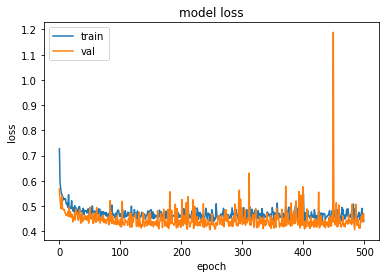

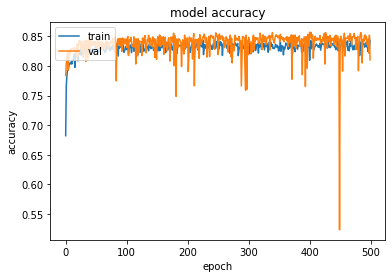

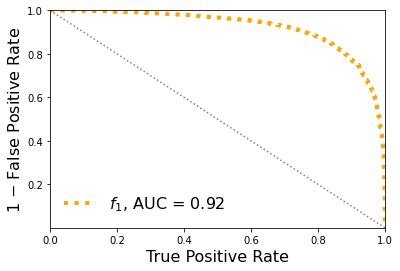

313/313 [==============================] - 2s 6ms/step - loss: 0.4829 - acc: 0.8141 - f1_m: 0.4114 - precision_m: 0.5002 - recall_m: 0.3514
Test ROC-AUC: 0.9214044600000001
Test loss: 0.48294317722320557
Test accuracy: 0.8141000270843506
Test f1: 0.4113632142543793
Test precision: 0.5001775026321411
Test recall: 0.35143768787384033
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 116ms/step - loss: 0.9330 - acc: 0.5412 - f1_m: 0.4804 - precision_m: 0.5447 - recall_m: 0.4761 - val_loss: 0.6842 - val_acc: 0.7495 - val_f1_m: 0.7161 - val_precision_m: 0.8159 - val_recall_m: 0.6416
Epoch 2/500
188/188 [==============================] - 21s 112ms/step - loss: 0.6793 - acc: 0.6931 - f1_m: 0.6565 - precision_m: 0.7487 - recall_m: 0.5944 - val_loss: 0.5492 - val_acc: 0.7845 - val_f1_m: 0.7730 - val_precision_m

188/188 [==============================] - 22s 115ms/step - loss: 0.4457 - acc: 0.8404 - f1_m: 0.8410 - precision_m: 0.8346 - recall_m: 0.8524 - val_loss: 0.4580 - val_acc: 0.8358 - val_f1_m: 0.8385 - val_precision_m: 0.8179 - val_recall_m: 0.8630
Epoch 62/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4764 - acc: 0.8277 - f1_m: 0.8298 - precision_m: 0.8205 - recall_m: 0.8452 - val_loss: 0.4953 - val_acc: 0.8022 - val_f1_m: 0.8279 - val_precision_m: 0.7277 - val_recall_m: 0.9627
Epoch 63/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4598 - acc: 0.8355 - f1_m: 0.8348 - precision_m: 0.8281 - recall_m: 0.8494 - val_loss: 0.4388 - val_acc: 0.8450 - val_f1_m: 0.8419 - val_precision_m: 0.8526 - val_recall_m: 0.8338
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4573 - acc: 0.8387 - f1_m: 0.8401 - precision_m: 0.8359 - recall_m: 0.8510 - val_loss: 0.4780 - val_acc: 0.8265 - val_f1_m: 0.8291 - val_precision_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4414 - acc: 0.8461 - f1_m: 0.8456 - precision_m: 0.8479 - recall_m: 0.8477 - val_loss: 0.4290 - val_acc: 0.8343 - val_f1_m: 0.8249 - val_precision_m: 0.8683 - val_recall_m: 0.7889
Epoch 124/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4651 - acc: 0.8336 - f1_m: 0.8313 - precision_m: 0.8370 - recall_m: 0.8357 - val_loss: 0.4343 - val_acc: 0.8458 - val_f1_m: 0.8539 - val_precision_m: 0.8055 - val_recall_m: 0.9113
Epoch 125/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4348 - acc: 0.8445 - f1_m: 0.8434 - precision_m: 0.8468 - recall_m: 0.8447 - val_loss: 0.4426 - val_acc: 0.8393 - val_f1_m: 0.8362 - val_precision_m: 0.8437 - val_recall_m: 0.8319
Epoch 126/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4299 - acc: 0.8497 - f1_m: 0.8509 - precision_m: 0.8485 - recall_m: 0.8570 - val_loss: 0.4297 - val_acc: 0.8373 - val_f1_m: 0.8309 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4712 - acc: 0.8364 - f1_m: 0.8328 - precision_m: 0.8505 - recall_m: 0.8237 - val_loss: 0.4285 - val_acc: 0.8405 - val_f1_m: 0.8378 - val_precision_m: 0.8451 - val_recall_m: 0.8335
Epoch 186/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4436 - acc: 0.8451 - f1_m: 0.8435 - precision_m: 0.8430 - recall_m: 0.8488 - val_loss: 0.4146 - val_acc: 0.8493 - val_f1_m: 0.8467 - val_precision_m: 0.8557 - val_recall_m: 0.8406
Epoch 187/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4398 - acc: 0.8464 - f1_m: 0.8443 - precision_m: 0.8560 - recall_m: 0.8403 - val_loss: 0.5345 - val_acc: 0.7595 - val_f1_m: 0.6997 - val_precision_m: 0.9199 - val_recall_m: 0.5669
Epoch 188/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4679 - acc: 0.8346 - f1_m: 0.8307 - precision_m: 0.8480 - recall_m: 0.8261 - val_loss: 0.4272 - val_acc: 0.8485 - val_f1_m: 0.8537 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4934 - acc: 0.8237 - f1_m: 0.8193 - precision_m: 0.8242 - recall_m: 0.8273 - val_loss: 0.4537 - val_acc: 0.8223 - val_f1_m: 0.8047 - val_precision_m: 0.8833 - val_recall_m: 0.7419
Epoch 248/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4306 - acc: 0.8515 - f1_m: 0.8503 - precision_m: 0.8489 - recall_m: 0.8560 - val_loss: 0.5550 - val_acc: 0.7295 - val_f1_m: 0.6417 - val_precision_m: 0.9385 - val_recall_m: 0.4898
Epoch 249/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4442 - acc: 0.8409 - f1_m: 0.8377 - precision_m: 0.8505 - recall_m: 0.8356 - val_loss: 0.4097 - val_acc: 0.8520 - val_f1_m: 0.8544 - val_precision_m: 0.8341 - val_recall_m: 0.8786
Epoch 250/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4243 - acc: 0.8558 - f1_m: 0.8558 - precision_m: 0.8524 - recall_m: 0.8647 - val_loss: 0.4060 - val_acc: 0.8540 - val_f1_m: 0.8513 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4356 - acc: 0.8458 - f1_m: 0.8441 - precision_m: 0.8527 - recall_m: 0.8446 - val_loss: 0.4609 - val_acc: 0.8470 - val_f1_m: 0.8565 - val_precision_m: 0.8004 - val_recall_m: 0.9236
Epoch 310/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4621 - acc: 0.8386 - f1_m: 0.8318 - precision_m: 0.8444 - recall_m: 0.8311 - val_loss: 0.4521 - val_acc: 0.8278 - val_f1_m: 0.8118 - val_precision_m: 0.8873 - val_recall_m: 0.7507
Epoch 311/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4327 - acc: 0.8515 - f1_m: 0.8499 - precision_m: 0.8457 - recall_m: 0.8592 - val_loss: 0.4140 - val_acc: 0.8482 - val_f1_m: 0.8450 - val_precision_m: 0.8539 - val_recall_m: 0.8388
Epoch 312/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4325 - acc: 0.8487 - f1_m: 0.8490 - precision_m: 0.8453 - recall_m: 0.8574 - val_loss: 0.4156 - val_acc: 0.8455 - val_f1_m: 0.8440 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4246 - acc: 0.8483 - f1_m: 0.8475 - precision_m: 0.8499 - recall_m: 0.8512 - val_loss: 0.4006 - val_acc: 0.8523 - val_f1_m: 0.8504 - val_precision_m: 0.8573 - val_recall_m: 0.8463
Epoch 372/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4107 - acc: 0.8599 - f1_m: 0.8589 - precision_m: 0.8561 - recall_m: 0.8653 - val_loss: 0.4004 - val_acc: 0.8513 - val_f1_m: 0.8492 - val_precision_m: 0.8543 - val_recall_m: 0.8469
Epoch 373/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4137 - acc: 0.8546 - f1_m: 0.8559 - precision_m: 0.8496 - recall_m: 0.8659 - val_loss: 0.4166 - val_acc: 0.8518 - val_f1_m: 0.8593 - val_precision_m: 0.8115 - val_recall_m: 0.9156
Epoch 374/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4706 - acc: 0.8300 - f1_m: 0.8266 - precision_m: 0.8373 - recall_m: 0.8303 - val_loss: 0.4358 - val_acc: 0.8288 - val_f1_m: 0.8146 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4099 - acc: 0.8596 - f1_m: 0.8601 - precision_m: 0.8563 - recall_m: 0.8674 - val_loss: 0.4044 - val_acc: 0.8528 - val_f1_m: 0.8561 - val_precision_m: 0.8322 - val_recall_m: 0.8837
Epoch 434/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4290 - acc: 0.8462 - f1_m: 0.8467 - precision_m: 0.8441 - recall_m: 0.8549 - val_loss: 0.4164 - val_acc: 0.8488 - val_f1_m: 0.8451 - val_precision_m: 0.8590 - val_recall_m: 0.8343
Epoch 435/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4223 - acc: 0.8543 - f1_m: 0.8554 - precision_m: 0.8503 - recall_m: 0.8654 - val_loss: 0.4106 - val_acc: 0.8515 - val_f1_m: 0.8512 - val_precision_m: 0.8455 - val_recall_m: 0.8593
Epoch 436/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4144 - acc: 0.8560 - f1_m: 0.8569 - precision_m: 0.8499 - recall_m: 0.8672 - val_loss: 0.4426 - val_acc: 0.8235 - val_f1_m: 0.8062 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4302 - acc: 0.8459 - f1_m: 0.8456 - precision_m: 0.8434 - recall_m: 0.8538 - val_loss: 0.4052 - val_acc: 0.8513 - val_f1_m: 0.8474 - val_precision_m: 0.8635 - val_recall_m: 0.8344
Epoch 496/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4177 - acc: 0.8525 - f1_m: 0.8518 - precision_m: 0.8485 - recall_m: 0.8587 - val_loss: 0.4460 - val_acc: 0.8490 - val_f1_m: 0.8582 - val_precision_m: 0.8027 - val_recall_m: 0.9246
Epoch 497/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4415 - acc: 0.8408 - f1_m: 0.8377 - precision_m: 0.8383 - recall_m: 0.8453 - val_loss: 0.4179 - val_acc: 0.8545 - val_f1_m: 0.8578 - val_precision_m: 0.8316 - val_recall_m: 0.8879
Epoch 498/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4817 - acc: 0.8258 - f1_m: 0.8174 - precision_m: 0.8344 - recall_m: 0.8194 - val_loss: 0.4202 - val_acc: 0.8392 - val_f1_m: 0.8302 - val_precision

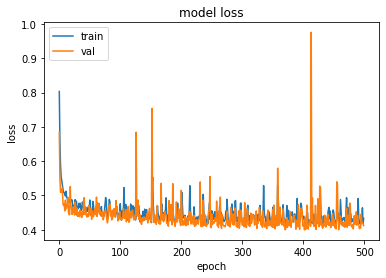

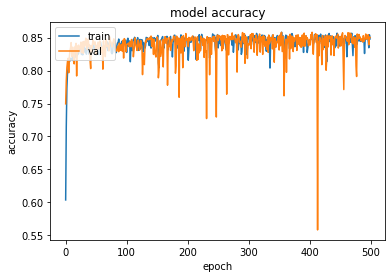

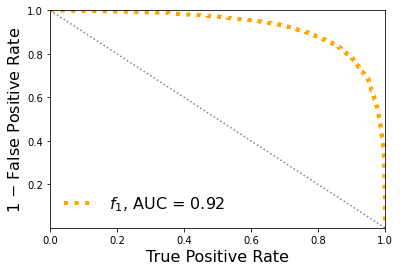

313/313 [==============================] - 2s 6ms/step - loss: 0.4280 - acc: 0.8467 - f1_m: 0.4640 - precision_m: 0.4999 - recall_m: 0.4341
Test ROC-AUC: 0.92363518
Test loss: 0.42802947759628296
Test accuracy: 0.8467000126838684
Test f1: 0.46401217579841614
Test precision: 0.49985477328300476
Test recall: 0.43410542607307434
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 252ms/step - loss: 1.1760 - acc: 0.5189 - f1_m: 0.4835 - precision_m: 0.5271 - recall_m: 0.4884 - val_loss: 0.6990 - val_acc: 0.7365 - val_f1_m: 0.7624 - val_precision_m: 0.6866 - val_recall_m: 0.8588
Epoch 2/500
94/94 [==============================] - 22s 238ms/step - loss: 0.6790 - acc: 0.6940 - f1_m: 0.7041 - precision_m: 0.6807 - recall_m: 0.7387 - val_loss: 0.5735 - val_acc: 0.7697 - val_f1_m: 0.7875 - val_precision_m: 0.7226 -

Epoch 31/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4497 - acc: 0.8479 - f1_m: 0.8501 - precision_m: 0.8427 - recall_m: 0.8627 - val_loss: 0.4551 - val_acc: 0.8338 - val_f1_m: 0.8250 - val_precision_m: 0.8572 - val_recall_m: 0.7963
Epoch 32/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4422 - acc: 0.8505 - f1_m: 0.8508 - precision_m: 0.8450 - recall_m: 0.8593 - val_loss: 0.4451 - val_acc: 0.8445 - val_f1_m: 0.8486 - val_precision_m: 0.8144 - val_recall_m: 0.8874
Epoch 33/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4432 - acc: 0.8474 - f1_m: 0.8485 - precision_m: 0.8360 - recall_m: 0.8647 - val_loss: 0.4512 - val_acc: 0.8477 - val_f1_m: 0.8525 - val_precision_m: 0.8152 - val_recall_m: 0.8951
Epoch 34/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4392 - acc: 0.8533 - f1_m: 0.8548 - precision_m: 0.8440 - recall_m: 0.8699 - val_loss: 0.4561 - val_acc: 0.8335 - val_f1_m: 0.8225 - val_precisi

Epoch 63/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4261 - acc: 0.8528 - f1_m: 0.8576 - precision_m: 0.8405 - recall_m: 0.8790 - val_loss: 0.4397 - val_acc: 0.8422 - val_f1_m: 0.8457 - val_precision_m: 0.8166 - val_recall_m: 0.8785
Epoch 64/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4275 - acc: 0.8514 - f1_m: 0.8534 - precision_m: 0.8372 - recall_m: 0.8733 - val_loss: 0.4354 - val_acc: 0.8452 - val_f1_m: 0.8431 - val_precision_m: 0.8414 - val_recall_m: 0.8458
Epoch 65/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4214 - acc: 0.8500 - f1_m: 0.8549 - precision_m: 0.8383 - recall_m: 0.8780 - val_loss: 0.4360 - val_acc: 0.8452 - val_f1_m: 0.8422 - val_precision_m: 0.8471 - val_recall_m: 0.8389
Epoch 66/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4145 - acc: 0.8626 - f1_m: 0.8650 - precision_m: 0.8508 - recall_m: 0.8823 - val_loss: 0.4342 - val_acc: 0.8430 - val_f1_m: 0.8398 - val_precisi

Epoch 95/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4235 - acc: 0.8551 - f1_m: 0.8587 - precision_m: 0.8375 - recall_m: 0.8835 - val_loss: 0.4248 - val_acc: 0.8413 - val_f1_m: 0.8372 - val_precision_m: 0.8436 - val_recall_m: 0.8325
Epoch 96/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4297 - acc: 0.8507 - f1_m: 0.8541 - precision_m: 0.8366 - recall_m: 0.8776 - val_loss: 0.4368 - val_acc: 0.8442 - val_f1_m: 0.8522 - val_precision_m: 0.7976 - val_recall_m: 0.9161
Epoch 97/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4146 - acc: 0.8548 - f1_m: 0.8590 - precision_m: 0.8398 - recall_m: 0.8830 - val_loss: 0.4230 - val_acc: 0.8460 - val_f1_m: 0.8488 - val_precision_m: 0.8231 - val_recall_m: 0.8776
Epoch 98/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4205 - acc: 0.8504 - f1_m: 0.8557 - precision_m: 0.8335 - recall_m: 0.8818 - val_loss: 0.4276 - val_acc: 0.8453 - val_f1_m: 0.8528 - val_precisi

94/94 [==============================] - 23s 240ms/step - loss: 0.8101 - acc: 0.5495 - f1_m: 0.4635 - precision_m: 0.5672 - recall_m: 0.4600 - val_loss: 0.7985 - val_acc: 0.7480 - val_f1_m: 0.7097 - val_precision_m: 0.8267 - val_recall_m: 0.6233
Epoch 158/500
94/94 [==============================] - 22s 239ms/step - loss: 0.8127 - acc: 0.5483 - f1_m: 0.4889 - precision_m: 0.5579 - recall_m: 0.4719 - val_loss: 0.7753 - val_acc: 0.7740 - val_f1_m: 0.8013 - val_precision_m: 0.7088 - val_recall_m: 0.9235
Epoch 159/500
94/94 [==============================] - 22s 239ms/step - loss: 0.7739 - acc: 0.5370 - f1_m: 0.5351 - precision_m: 0.5340 - recall_m: 0.5401 - val_loss: 0.7475 - val_acc: 0.6120 - val_f1_m: 0.3916 - val_precision_m: 0.8656 - val_recall_m: 0.2545
Epoch 160/500
94/94 [==============================] - 22s 239ms/step - loss: 0.8028 - acc: 0.5609 - f1_m: 0.4950 - precision_m: 0.5791 - recall_m: 0.5164 - val_loss: 0.7742 - val_acc: 0.5552 - val_f1_m: 0.6892 - val_precision_m: 0.52

94/94 [==============================] - 22s 239ms/step - loss: 0.4030 - acc: 0.8643 - f1_m: 0.8653 - precision_m: 0.8536 - recall_m: 0.8815 - val_loss: 0.4200 - val_acc: 0.8498 - val_f1_m: 0.8526 - val_precision_m: 0.8309 - val_recall_m: 0.8773
Epoch 220/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3947 - acc: 0.8678 - f1_m: 0.8687 - precision_m: 0.8621 - recall_m: 0.8773 - val_loss: 0.4265 - val_acc: 0.8523 - val_f1_m: 0.8591 - val_precision_m: 0.8134 - val_recall_m: 0.9118
Epoch 221/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4077 - acc: 0.8629 - f1_m: 0.8651 - precision_m: 0.8470 - recall_m: 0.8864 - val_loss: 0.4409 - val_acc: 0.8428 - val_f1_m: 0.8545 - val_precision_m: 0.7869 - val_recall_m: 0.9362
Epoch 222/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4076 - acc: 0.8590 - f1_m: 0.8619 - precision_m: 0.8430 - recall_m: 0.8859 - val_loss: 0.4312 - val_acc: 0.8498 - val_f1_m: 0.8484 - val_precision_m: 0.84

94/94 [==============================] - 23s 240ms/step - loss: 0.4008 - acc: 0.8677 - f1_m: 0.8683 - precision_m: 0.8619 - recall_m: 0.8766 - val_loss: 0.4725 - val_acc: 0.8292 - val_f1_m: 0.8184 - val_precision_m: 0.8625 - val_recall_m: 0.7800
Epoch 282/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4260 - acc: 0.8573 - f1_m: 0.8593 - precision_m: 0.8518 - recall_m: 0.8699 - val_loss: 0.4497 - val_acc: 0.8435 - val_f1_m: 0.8454 - val_precision_m: 0.8241 - val_recall_m: 0.8695
Epoch 283/500
94/94 [==============================] - 23s 239ms/step - loss: 0.4043 - acc: 0.8662 - f1_m: 0.8679 - precision_m: 0.8580 - recall_m: 0.8800 - val_loss: 0.4599 - val_acc: 0.8278 - val_f1_m: 0.8184 - val_precision_m: 0.8554 - val_recall_m: 0.7861
Epoch 284/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4112 - acc: 0.8659 - f1_m: 0.8677 - precision_m: 0.8620 - recall_m: 0.8771 - val_loss: 0.4504 - val_acc: 0.8552 - val_f1_m: 0.8602 - val_precision_m: 0.82

94/94 [==============================] - 22s 239ms/step - loss: 0.4041 - acc: 0.8602 - f1_m: 0.8637 - precision_m: 0.8455 - recall_m: 0.8866 - val_loss: 0.4202 - val_acc: 0.8510 - val_f1_m: 0.8528 - val_precision_m: 0.8333 - val_recall_m: 0.8750
Epoch 344/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4063 - acc: 0.8592 - f1_m: 0.8620 - precision_m: 0.8459 - recall_m: 0.8836 - val_loss: 0.4517 - val_acc: 0.8360 - val_f1_m: 0.8497 - val_precision_m: 0.7775 - val_recall_m: 0.9386
Epoch 345/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4212 - acc: 0.8537 - f1_m: 0.8596 - precision_m: 0.8338 - recall_m: 0.8928 - val_loss: 0.4114 - val_acc: 0.8543 - val_f1_m: 0.8557 - val_precision_m: 0.8358 - val_recall_m: 0.8783
Epoch 346/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3865 - acc: 0.8697 - f1_m: 0.8731 - precision_m: 0.8555 - recall_m: 0.8938 - val_loss: 0.4206 - val_acc: 0.8503 - val_f1_m: 0.8463 - val_precision_m: 0.86

94/94 [==============================] - 22s 238ms/step - loss: 0.5486 - acc: 0.7957 - f1_m: 0.8085 - precision_m: 0.7646 - recall_m: 0.8678 - val_loss: 0.4534 - val_acc: 0.8440 - val_f1_m: 0.8447 - val_precision_m: 0.8318 - val_recall_m: 0.8595
Epoch 406/500
94/94 [==============================] - 22s 239ms/step - loss: 0.5042 - acc: 0.8245 - f1_m: 0.8323 - precision_m: 0.7933 - recall_m: 0.8814 - val_loss: 0.4503 - val_acc: 0.8453 - val_f1_m: 0.8416 - val_precision_m: 0.8550 - val_recall_m: 0.8305
Epoch 407/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4856 - acc: 0.8325 - f1_m: 0.8397 - precision_m: 0.8032 - recall_m: 0.8827 - val_loss: 0.4456 - val_acc: 0.8377 - val_f1_m: 0.8501 - val_precision_m: 0.7847 - val_recall_m: 0.9292
Epoch 408/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4574 - acc: 0.8356 - f1_m: 0.8430 - precision_m: 0.8123 - recall_m: 0.8825 - val_loss: 0.4318 - val_acc: 0.8472 - val_f1_m: 0.8541 - val_precision_m: 0.80

94/94 [==============================] - 22s 238ms/step - loss: 0.3879 - acc: 0.8719 - f1_m: 0.8721 - precision_m: 0.8749 - recall_m: 0.8717 - val_loss: 0.4338 - val_acc: 0.8533 - val_f1_m: 0.8499 - val_precision_m: 0.8586 - val_recall_m: 0.8429
Epoch 468/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4212 - acc: 0.8622 - f1_m: 0.8649 - precision_m: 0.8567 - recall_m: 0.8786 - val_loss: 0.4439 - val_acc: 0.8402 - val_f1_m: 0.8318 - val_precision_m: 0.8655 - val_recall_m: 0.8020
Epoch 469/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4105 - acc: 0.8662 - f1_m: 0.8673 - precision_m: 0.8584 - recall_m: 0.8788 - val_loss: 0.4319 - val_acc: 0.8478 - val_f1_m: 0.8518 - val_precision_m: 0.8198 - val_recall_m: 0.8879
Epoch 470/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4276 - acc: 0.8539 - f1_m: 0.8552 - precision_m: 0.8489 - recall_m: 0.8675 - val_loss: 0.8060 - val_acc: 0.4978 - val_f1_m: 0.6627 - val_precision_m: 0.49

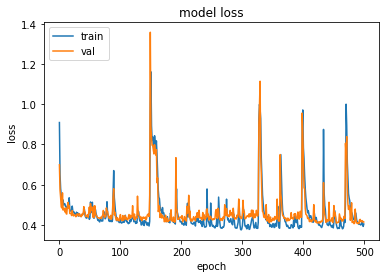

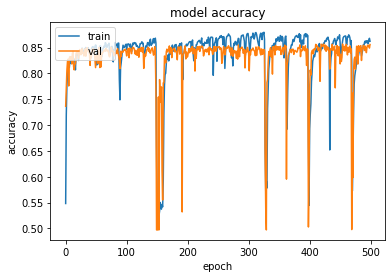

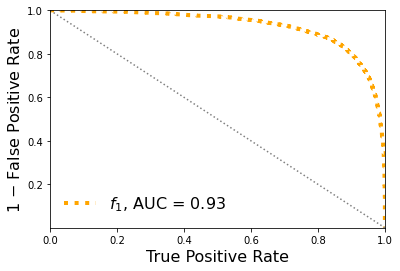

313/313 [==============================] - 2s 6ms/step - loss: 0.4237 - acc: 0.8502 - f1_m: 0.4725 - precision_m: 0.5003 - recall_m: 0.4488
Test ROC-AUC: 0.9271937400000001
Test loss: 0.42371708154678345
Test accuracy: 0.8501999974250793
Test f1: 0.47250843048095703
Test precision: 0.5002662539482117
Test recall: 0.44878193736076355
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8716 - acc: 0.5394 - f1_m: 0.5578 - precision_m: 0.5408 - recall_m: 0.6053 - val_loss: 0.5921 - val_acc: 0.7583 - val_f1_m: 0.7596 - val_precision_m: 0.7436 - val_recall_m: 0.7821
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.6080 - acc: 0.7443 - f1_m: 0.7490 - precision_m: 0.7281 - recall_m: 0.7822 - val_loss: 0.5664 - val_acc: 0.7720 - val_f1_m: 0.7937 - val_precision_m: 

Epoch 31/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4541 - acc: 0.8316 - f1_m: 0.8343 - precision_m: 0.8230 - recall_m: 0.8515 - val_loss: 0.4186 - val_acc: 0.8348 - val_f1_m: 0.8297 - val_precision_m: 0.8440 - val_recall_m: 0.8207
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4577 - acc: 0.8322 - f1_m: 0.8309 - precision_m: 0.8220 - recall_m: 0.8491 - val_loss: 0.4230 - val_acc: 0.8443 - val_f1_m: 0.8503 - val_precision_m: 0.8113 - val_recall_m: 0.8979
Epoch 33/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4591 - acc: 0.8327 - f1_m: 0.8318 - precision_m: 0.8215 - recall_m: 0.8506 - val_loss: 0.4353 - val_acc: 0.8428 - val_f1_m: 0.8462 - val_precision_m: 0.8178 - val_recall_m: 0.8811
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4599 - acc: 0.8319 - f1_m: 0.8312 - precision_m: 0.8274 - recall_m: 0.8433 - val_loss: 0.4361 - val_acc: 0.8280 - val_f1_m: 0.8150 - val_pre

375/375 [==============================] - 22s 60ms/step - loss: 0.4291 - acc: 0.8467 - f1_m: 0.8466 - precision_m: 0.8466 - recall_m: 0.8551 - val_loss: 0.4257 - val_acc: 0.8332 - val_f1_m: 0.8205 - val_precision_m: 0.8777 - val_recall_m: 0.7746
Epoch 94/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4378 - acc: 0.8479 - f1_m: 0.8490 - precision_m: 0.8488 - recall_m: 0.8563 - val_loss: 0.4332 - val_acc: 0.8532 - val_f1_m: 0.8547 - val_precision_m: 0.8359 - val_recall_m: 0.8792
Epoch 95/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4482 - acc: 0.8390 - f1_m: 0.8376 - precision_m: 0.8345 - recall_m: 0.8484 - val_loss: 0.4141 - val_acc: 0.8438 - val_f1_m: 0.8354 - val_precision_m: 0.8721 - val_recall_m: 0.8061
Epoch 96/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4476 - acc: 0.8430 - f1_m: 0.8426 - precision_m: 0.8452 - recall_m: 0.8510 - val_loss: 0.4477 - val_acc: 0.8432 - val_f1_m: 0.8377 - val_precision_m: 0.8

375/375 [==============================] - 23s 60ms/step - loss: 0.4590 - acc: 0.8360 - f1_m: 0.8348 - precision_m: 0.8365 - recall_m: 0.8433 - val_loss: 0.4202 - val_acc: 0.8397 - val_f1_m: 0.8311 - val_precision_m: 0.8654 - val_recall_m: 0.8038
Epoch 156/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4293 - acc: 0.8453 - f1_m: 0.8450 - precision_m: 0.8533 - recall_m: 0.8456 - val_loss: 0.4016 - val_acc: 0.8568 - val_f1_m: 0.8561 - val_precision_m: 0.8500 - val_recall_m: 0.8666
Epoch 157/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4459 - acc: 0.8424 - f1_m: 0.8392 - precision_m: 0.8395 - recall_m: 0.8474 - val_loss: 0.4187 - val_acc: 0.8478 - val_f1_m: 0.8443 - val_precision_m: 0.8538 - val_recall_m: 0.8393
Epoch 158/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4337 - acc: 0.8431 - f1_m: 0.8399 - precision_m: 0.8486 - recall_m: 0.8384 - val_loss: 0.4315 - val_acc: 0.8548 - val_f1_m: 0.8604 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4434 - acc: 0.8448 - f1_m: 0.8427 - precision_m: 0.8439 - recall_m: 0.8484 - val_loss: 0.4146 - val_acc: 0.8533 - val_f1_m: 0.8568 - val_precision_m: 0.8246 - val_recall_m: 0.8959
Epoch 218/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4284 - acc: 0.8530 - f1_m: 0.8511 - precision_m: 0.8567 - recall_m: 0.8519 - val_loss: 0.4520 - val_acc: 0.8325 - val_f1_m: 0.8180 - val_precision_m: 0.8819 - val_recall_m: 0.7672
Epoch 219/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4423 - acc: 0.8450 - f1_m: 0.8409 - precision_m: 0.8444 - recall_m: 0.8461 - val_loss: 0.4741 - val_acc: 0.8385 - val_f1_m: 0.8431 - val_precision_m: 0.8079 - val_recall_m: 0.8860
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4846 - acc: 0.8360 - f1_m: 0.8308 - precision_m: 0.8435 - recall_m: 0.8333 - val_loss: 0.4057 - val_acc: 0.8552 - val_f1_m: 0.8568 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4391 - acc: 0.8445 - f1_m: 0.8402 - precision_m: 0.8437 - recall_m: 0.8445 - val_loss: 0.4488 - val_acc: 0.8368 - val_f1_m: 0.8307 - val_precision_m: 0.8509 - val_recall_m: 0.8160
Epoch 280/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4414 - acc: 0.8451 - f1_m: 0.8421 - precision_m: 0.8486 - recall_m: 0.8424 - val_loss: 0.4151 - val_acc: 0.8443 - val_f1_m: 0.8384 - val_precision_m: 0.8623 - val_recall_m: 0.8204
Epoch 281/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4334 - acc: 0.8496 - f1_m: 0.8467 - precision_m: 0.8520 - recall_m: 0.8494 - val_loss: 0.4356 - val_acc: 0.8403 - val_f1_m: 0.8314 - val_precision_m: 0.8687 - val_recall_m: 0.8018
Epoch 282/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4407 - acc: 0.8419 - f1_m: 0.8381 - precision_m: 0.8439 - recall_m: 0.8396 - val_loss: 0.4098 - val_acc: 0.8510 - val_f1_m: 0.8481 - val_precision_m: 

375/375 [==============================] - 23s 60ms/step - loss: 0.4426 - acc: 0.8457 - f1_m: 0.8423 - precision_m: 0.8429 - recall_m: 0.8505 - val_loss: 0.4055 - val_acc: 0.8558 - val_f1_m: 0.8595 - val_precision_m: 0.8271 - val_recall_m: 0.8993
Epoch 342/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4915 - acc: 0.8359 - f1_m: 0.8319 - precision_m: 0.8366 - recall_m: 0.8385 - val_loss: 0.4234 - val_acc: 0.8515 - val_f1_m: 0.8550 - val_precision_m: 0.8261 - val_recall_m: 0.8909
Epoch 343/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4441 - acc: 0.8440 - f1_m: 0.8419 - precision_m: 0.8443 - recall_m: 0.8480 - val_loss: 0.4374 - val_acc: 0.8500 - val_f1_m: 0.8479 - val_precision_m: 0.8501 - val_recall_m: 0.8503
Epoch 344/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4605 - acc: 0.8436 - f1_m: 0.8398 - precision_m: 0.8452 - recall_m: 0.8425 - val_loss: 0.4170 - val_acc: 0.8553 - val_f1_m: 0.8616 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4310 - acc: 0.8514 - f1_m: 0.8500 - precision_m: 0.8500 - recall_m: 0.8579 - val_loss: 0.4123 - val_acc: 0.8553 - val_f1_m: 0.8540 - val_precision_m: 0.8523 - val_recall_m: 0.8594
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4402 - acc: 0.8418 - f1_m: 0.8388 - precision_m: 0.8405 - recall_m: 0.8443 - val_loss: 0.4205 - val_acc: 0.8458 - val_f1_m: 0.8389 - val_precision_m: 0.8702 - val_recall_m: 0.8140
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4368 - acc: 0.8473 - f1_m: 0.8448 - precision_m: 0.8468 - recall_m: 0.8498 - val_loss: 0.4765 - val_acc: 0.8157 - val_f1_m: 0.7911 - val_precision_m: 0.8961 - val_recall_m: 0.7132
Epoch 406/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4500 - acc: 0.8462 - f1_m: 0.8447 - precision_m: 0.8469 - recall_m: 0.8502 - val_loss: 0.4122 - val_acc: 0.8517 - val_f1_m: 0.8532 - val_precision_m: 

375/375 [==============================] - 23s 60ms/step - loss: 0.4305 - acc: 0.8521 - f1_m: 0.8509 - precision_m: 0.8511 - recall_m: 0.8571 - val_loss: 0.4160 - val_acc: 0.8395 - val_f1_m: 0.8279 - val_precision_m: 0.8784 - val_recall_m: 0.7871
Epoch 466/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4447 - acc: 0.8444 - f1_m: 0.8403 - precision_m: 0.8488 - recall_m: 0.8424 - val_loss: 0.4121 - val_acc: 0.8537 - val_f1_m: 0.8548 - val_precision_m: 0.8414 - val_recall_m: 0.8735
Epoch 467/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4336 - acc: 0.8449 - f1_m: 0.8394 - precision_m: 0.8450 - recall_m: 0.8405 - val_loss: 0.4128 - val_acc: 0.8550 - val_f1_m: 0.8548 - val_precision_m: 0.8481 - val_recall_m: 0.8670
Epoch 468/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4675 - acc: 0.8360 - f1_m: 0.8265 - precision_m: 0.8385 - recall_m: 0.8294 - val_loss: 0.4240 - val_acc: 0.8522 - val_f1_m: 0.8533 - val_precision_m: 

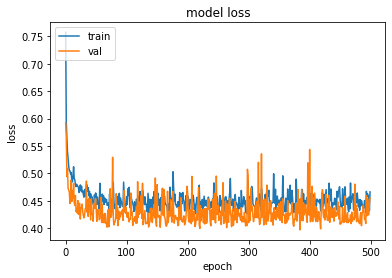

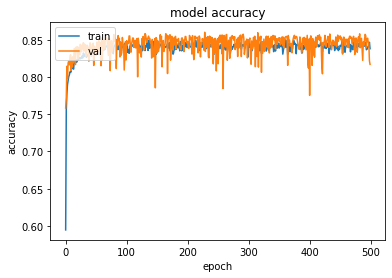

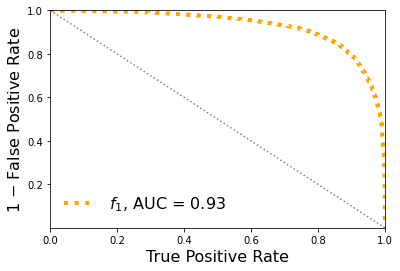

313/313 [==============================] - 2s 6ms/step - loss: 0.4681 - acc: 0.8205 - f1_m: 0.4163 - precision_m: 0.5007 - recall_m: 0.3582
Test ROC-AUC: 0.92651448
Test loss: 0.4681408107280731
Test accuracy: 0.8205000162124634
Test f1: 0.41633307933807373
Test precision: 0.5006846189498901
Test recall: 0.35822683572769165
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 117ms/step - loss: 0.9399 - acc: 0.5447 - f1_m: 0.5705 - precision_m: 0.5516 - recall_m: 0.6288 - val_loss: 0.5936 - val_acc: 0.7685 - val_f1_m: 0.7543 - val_precision_m: 0.7934 - val_recall_m: 0.7217
Epoch 2/500
188/188 [==============================] - 21s 113ms/step - loss: 0.6252 - acc: 0.7405 - f1_m: 0.7498 - precision_m: 0.7239 - recall_m: 0.7865 - val_loss: 0.5269 - val_acc: 0.8045 - val_f1_m: 0.8154 - val_precision_m: 0.7671

188/188 [==============================] - 22s 115ms/step - loss: 0.4401 - acc: 0.8376 - f1_m: 0.8418 - precision_m: 0.8207 - recall_m: 0.8716 - val_loss: 0.4523 - val_acc: 0.8290 - val_f1_m: 0.8207 - val_precision_m: 0.8543 - val_recall_m: 0.7924
Epoch 62/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4311 - acc: 0.8494 - f1_m: 0.8509 - precision_m: 0.8332 - recall_m: 0.8734 - val_loss: 0.4326 - val_acc: 0.8430 - val_f1_m: 0.8431 - val_precision_m: 0.8363 - val_recall_m: 0.8532
Epoch 63/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4282 - acc: 0.8416 - f1_m: 0.8454 - precision_m: 0.8269 - recall_m: 0.8693 - val_loss: 0.5174 - val_acc: 0.7947 - val_f1_m: 0.8239 - val_precision_m: 0.7161 - val_recall_m: 0.9727
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4539 - acc: 0.8383 - f1_m: 0.8410 - precision_m: 0.8200 - recall_m: 0.8720 - val_loss: 0.4337 - val_acc: 0.8410 - val_f1_m: 0.8511 - val_precision_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4320 - acc: 0.8440 - f1_m: 0.8443 - precision_m: 0.8380 - recall_m: 0.8578 - val_loss: 0.4229 - val_acc: 0.8440 - val_f1_m: 0.8442 - val_precision_m: 0.8350 - val_recall_m: 0.8564
Epoch 124/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4230 - acc: 0.8508 - f1_m: 0.8534 - precision_m: 0.8395 - recall_m: 0.8710 - val_loss: 0.4171 - val_acc: 0.8468 - val_f1_m: 0.8535 - val_precision_m: 0.8118 - val_recall_m: 0.9022
Epoch 125/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4246 - acc: 0.8481 - f1_m: 0.8521 - precision_m: 0.8363 - recall_m: 0.8744 - val_loss: 0.4289 - val_acc: 0.8482 - val_f1_m: 0.8541 - val_precision_m: 0.8151 - val_recall_m: 0.9000
Epoch 126/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4252 - acc: 0.8510 - f1_m: 0.8524 - precision_m: 0.8355 - recall_m: 0.8743 - val_loss: 0.4065 - val_acc: 0.8517 - val_f1_m: 0.8532 - val_precision

188/188 [==============================] - 22s 114ms/step - loss: 0.4345 - acc: 0.8477 - f1_m: 0.8508 - precision_m: 0.8373 - recall_m: 0.8698 - val_loss: 0.4178 - val_acc: 0.8487 - val_f1_m: 0.8503 - val_precision_m: 0.8326 - val_recall_m: 0.8719
Epoch 186/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4040 - acc: 0.8571 - f1_m: 0.8570 - precision_m: 0.8484 - recall_m: 0.8699 - val_loss: 0.4340 - val_acc: 0.8350 - val_f1_m: 0.8249 - val_precision_m: 0.8693 - val_recall_m: 0.7873
Epoch 187/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4063 - acc: 0.8579 - f1_m: 0.8581 - precision_m: 0.8459 - recall_m: 0.8745 - val_loss: 0.4034 - val_acc: 0.8510 - val_f1_m: 0.8471 - val_precision_m: 0.8606 - val_recall_m: 0.8361
Epoch 188/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4048 - acc: 0.8602 - f1_m: 0.8627 - precision_m: 0.8530 - recall_m: 0.8762 - val_loss: 0.4313 - val_acc: 0.8323 - val_f1_m: 0.8165 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4002 - acc: 0.8624 - f1_m: 0.8622 - precision_m: 0.8542 - recall_m: 0.8744 - val_loss: 0.4267 - val_acc: 0.8498 - val_f1_m: 0.8508 - val_precision_m: 0.8400 - val_recall_m: 0.8644
Epoch 248/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4185 - acc: 0.8569 - f1_m: 0.8588 - precision_m: 0.8477 - recall_m: 0.8747 - val_loss: 0.4167 - val_acc: 0.8413 - val_f1_m: 0.8347 - val_precision_m: 0.8628 - val_recall_m: 0.8107
Epoch 249/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4019 - acc: 0.8573 - f1_m: 0.8572 - precision_m: 0.8499 - recall_m: 0.8680 - val_loss: 0.4177 - val_acc: 0.8558 - val_f1_m: 0.8601 - val_precision_m: 0.8282 - val_recall_m: 0.8971
Epoch 250/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4221 - acc: 0.8536 - f1_m: 0.8556 - precision_m: 0.8445 - recall_m: 0.8719 - val_loss: 0.4341 - val_acc: 0.8472 - val_f1_m: 0.8522 - val_precision

188/188 [==============================] - 22s 114ms/step - loss: 0.4260 - acc: 0.8442 - f1_m: 0.8443 - precision_m: 0.8377 - recall_m: 0.8539 - val_loss: 0.4332 - val_acc: 0.8442 - val_f1_m: 0.8453 - val_precision_m: 0.8314 - val_recall_m: 0.8624
Epoch 310/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4206 - acc: 0.8496 - f1_m: 0.8498 - precision_m: 0.8364 - recall_m: 0.8670 - val_loss: 0.4307 - val_acc: 0.8460 - val_f1_m: 0.8452 - val_precision_m: 0.8412 - val_recall_m: 0.8522
Epoch 311/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4289 - acc: 0.8470 - f1_m: 0.8498 - precision_m: 0.8382 - recall_m: 0.8662 - val_loss: 0.4460 - val_acc: 0.8352 - val_f1_m: 0.8273 - val_precision_m: 0.8600 - val_recall_m: 0.7994
Epoch 312/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4839 - acc: 0.8288 - f1_m: 0.8241 - precision_m: 0.8223 - recall_m: 0.8393 - val_loss: 0.4478 - val_acc: 0.8485 - val_f1_m: 0.8508 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4237 - acc: 0.8513 - f1_m: 0.8547 - precision_m: 0.8360 - recall_m: 0.8798 - val_loss: 0.4406 - val_acc: 0.8402 - val_f1_m: 0.8333 - val_precision_m: 0.8606 - val_recall_m: 0.8101
Epoch 372/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4067 - acc: 0.8611 - f1_m: 0.8639 - precision_m: 0.8450 - recall_m: 0.8875 - val_loss: 0.5016 - val_acc: 0.8148 - val_f1_m: 0.8355 - val_precision_m: 0.7463 - val_recall_m: 0.9518
Epoch 373/500
188/188 [==============================] - 21s 114ms/step - loss: 0.3972 - acc: 0.8602 - f1_m: 0.8624 - precision_m: 0.8497 - recall_m: 0.8796 - val_loss: 0.4145 - val_acc: 0.8513 - val_f1_m: 0.8565 - val_precision_m: 0.8223 - val_recall_m: 0.8964
Epoch 374/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4057 - acc: 0.8582 - f1_m: 0.8605 - precision_m: 0.8457 - recall_m: 0.8800 - val_loss: 0.4151 - val_acc: 0.8487 - val_f1_m: 0.8458 - val_precision

188/188 [==============================] - 22s 116ms/step - loss: 0.3998 - acc: 0.8608 - f1_m: 0.8634 - precision_m: 0.8538 - recall_m: 0.8764 - val_loss: 0.4198 - val_acc: 0.8485 - val_f1_m: 0.8452 - val_precision_m: 0.8579 - val_recall_m: 0.8360
Epoch 434/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4419 - acc: 0.8489 - f1_m: 0.8481 - precision_m: 0.8390 - recall_m: 0.8646 - val_loss: 0.4894 - val_acc: 0.8332 - val_f1_m: 0.8224 - val_precision_m: 0.8712 - val_recall_m: 0.7810
Epoch 435/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4695 - acc: 0.8394 - f1_m: 0.8428 - precision_m: 0.8229 - recall_m: 0.8692 - val_loss: 0.4448 - val_acc: 0.8357 - val_f1_m: 0.8273 - val_precision_m: 0.8631 - val_recall_m: 0.7968
Epoch 436/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4729 - acc: 0.8401 - f1_m: 0.8402 - precision_m: 0.8247 - recall_m: 0.8645 - val_loss: 0.5045 - val_acc: 0.8263 - val_f1_m: 0.8452 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4174 - acc: 0.8574 - f1_m: 0.8581 - precision_m: 0.8429 - recall_m: 0.8798 - val_loss: 0.4109 - val_acc: 0.8508 - val_f1_m: 0.8524 - val_precision_m: 0.8373 - val_recall_m: 0.8707
Epoch 496/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4047 - acc: 0.8534 - f1_m: 0.8557 - precision_m: 0.8402 - recall_m: 0.8775 - val_loss: 0.4229 - val_acc: 0.8435 - val_f1_m: 0.8350 - val_precision_m: 0.8731 - val_recall_m: 0.8021
Epoch 497/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4078 - acc: 0.8586 - f1_m: 0.8621 - precision_m: 0.8478 - recall_m: 0.8814 - val_loss: 0.4103 - val_acc: 0.8505 - val_f1_m: 0.8485 - val_precision_m: 0.8525 - val_recall_m: 0.8469
Epoch 498/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4127 - acc: 0.8558 - f1_m: 0.8567 - precision_m: 0.8451 - recall_m: 0.8752 - val_loss: 0.4506 - val_acc: 0.8263 - val_f1_m: 0.8080 - val_precision

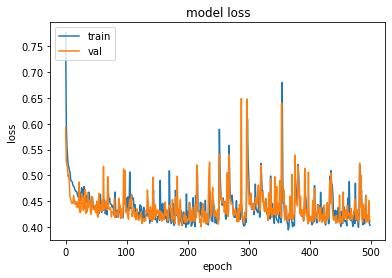

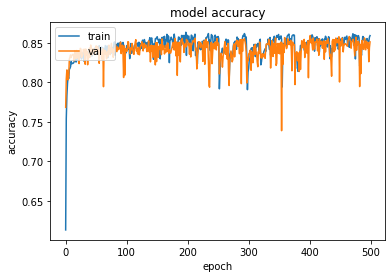

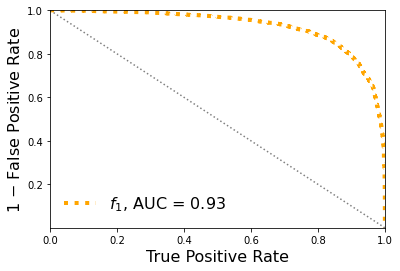

313/313 [==============================] - 2s 6ms/step - loss: 0.4153 - acc: 0.8508 - f1_m: 0.4607 - precision_m: 0.5001 - recall_m: 0.4282
Test ROC-AUC: 0.9263640200000001
Test loss: 0.41533559560775757
Test accuracy: 0.8507999777793884
Test f1: 0.460667222738266
Test precision: 0.5001451969146729
Test recall: 0.4282148480415344
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 251ms/step - loss: 1.3107 - acc: 0.4976 - f1_m: 0.4545 - precision_m: 0.5030 - recall_m: 0.4410 - val_loss: 0.7922 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
94/94 [==============================] - 23s 242ms/step - loss: 0.7980 - acc: 0.5107 - f1_m: 0.4231 - precision_m: 0.5140 - recall_m: 0.3824 - val_loss: 0.7731 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_p

Epoch 31/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4615 - acc: 0.8331 - f1_m: 0.8363 - precision_m: 0.8259 - recall_m: 0.8532 - val_loss: 0.4307 - val_acc: 0.8447 - val_f1_m: 0.8465 - val_precision_m: 0.8239 - val_recall_m: 0.8719
Epoch 32/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4412 - acc: 0.8415 - f1_m: 0.8436 - precision_m: 0.8338 - recall_m: 0.8563 - val_loss: 0.4345 - val_acc: 0.8367 - val_f1_m: 0.8316 - val_precision_m: 0.8474 - val_recall_m: 0.8179
Epoch 33/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4490 - acc: 0.8350 - f1_m: 0.8366 - precision_m: 0.8272 - recall_m: 0.8512 - val_loss: 0.4351 - val_acc: 0.8427 - val_f1_m: 0.8475 - val_precision_m: 0.8144 - val_recall_m: 0.8848
Epoch 34/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4421 - acc: 0.8383 - f1_m: 0.8399 - precision_m: 0.8279 - recall_m: 0.8545 - val_loss: 0.4485 - val_acc: 0.8288 - val_f1_m: 0.8160 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4118 - acc: 0.8506 - f1_m: 0.8554 - precision_m: 0.8373 - recall_m: 0.8764 - val_loss: 0.4363 - val_acc: 0.8392 - val_f1_m: 0.8319 - val_precision_m: 0.8598 - val_recall_m: 0.8070
Epoch 64/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4153 - acc: 0.8515 - f1_m: 0.8557 - precision_m: 0.8378 - recall_m: 0.8778 - val_loss: 0.4277 - val_acc: 0.8458 - val_f1_m: 0.8489 - val_precision_m: 0.8184 - val_recall_m: 0.8833
Epoch 65/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4167 - acc: 0.8541 - f1_m: 0.8571 - precision_m: 0.8436 - recall_m: 0.8735 - val_loss: 0.4417 - val_acc: 0.8370 - val_f1_m: 0.8507 - val_precision_m: 0.7777 - val_recall_m: 0.9405
Epoch 66/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4169 - acc: 0.8534 - f1_m: 0.8556 - precision_m: 0.8414 - recall_m: 0.8743 - val_loss: 0.4753 - val_acc: 0.8132 - val_f1_m: 0.7874 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3981 - acc: 0.8659 - f1_m: 0.8660 - precision_m: 0.8605 - recall_m: 0.8762 - val_loss: 0.4272 - val_acc: 0.8453 - val_f1_m: 0.8509 - val_precision_m: 0.8110 - val_recall_m: 0.8965
Epoch 96/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4091 - acc: 0.8526 - f1_m: 0.8560 - precision_m: 0.8347 - recall_m: 0.8822 - val_loss: 0.4744 - val_acc: 0.8398 - val_f1_m: 0.8412 - val_precision_m: 0.8242 - val_recall_m: 0.8603
Epoch 97/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4562 - acc: 0.8462 - f1_m: 0.8530 - precision_m: 0.8231 - recall_m: 0.8881 - val_loss: 0.4571 - val_acc: 0.8315 - val_f1_m: 0.8455 - val_precision_m: 0.7735 - val_recall_m: 0.9343
Epoch 98/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4148 - acc: 0.8511 - f1_m: 0.8555 - precision_m: 0.8255 - recall_m: 0.8899 - val_loss: 0.4339 - val_acc: 0.8443 - val_f1_m: 0.8475 - val_precisi

94/94 [==============================] - 22s 239ms/step - loss: 0.4116 - acc: 0.8543 - f1_m: 0.8592 - precision_m: 0.8292 - recall_m: 0.8940 - val_loss: 0.4342 - val_acc: 0.8435 - val_f1_m: 0.8490 - val_precision_m: 0.8106 - val_recall_m: 0.8931
Epoch 158/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3957 - acc: 0.8623 - f1_m: 0.8661 - precision_m: 0.8360 - recall_m: 0.8998 - val_loss: 0.4253 - val_acc: 0.8408 - val_f1_m: 0.8449 - val_precision_m: 0.8176 - val_recall_m: 0.8758
Epoch 159/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4034 - acc: 0.8573 - f1_m: 0.8632 - precision_m: 0.8386 - recall_m: 0.8924 - val_loss: 0.4405 - val_acc: 0.8333 - val_f1_m: 0.8287 - val_precision_m: 0.8417 - val_recall_m: 0.8176
Epoch 160/500
94/94 [==============================] - 23s 241ms/step - loss: 0.3981 - acc: 0.8620 - f1_m: 0.8675 - precision_m: 0.8413 - recall_m: 0.8970 - val_loss: 0.4332 - val_acc: 0.8425 - val_f1_m: 0.8427 - val_precision_m: 0.83

94/94 [==============================] - 23s 241ms/step - loss: 0.3780 - acc: 0.8770 - f1_m: 0.8803 - precision_m: 0.8682 - recall_m: 0.8947 - val_loss: 0.4410 - val_acc: 0.8450 - val_f1_m: 0.8413 - val_precision_m: 0.8510 - val_recall_m: 0.8336
Epoch 220/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3832 - acc: 0.8721 - f1_m: 0.8752 - precision_m: 0.8583 - recall_m: 0.8957 - val_loss: 0.4504 - val_acc: 0.8343 - val_f1_m: 0.8415 - val_precision_m: 0.7982 - val_recall_m: 0.8914
Epoch 221/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3866 - acc: 0.8738 - f1_m: 0.8755 - precision_m: 0.8570 - recall_m: 0.8977 - val_loss: 0.4473 - val_acc: 0.8325 - val_f1_m: 0.8272 - val_precision_m: 0.8423 - val_recall_m: 0.8142
Epoch 222/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3879 - acc: 0.8706 - f1_m: 0.8743 - precision_m: 0.8556 - recall_m: 0.8967 - val_loss: 0.4385 - val_acc: 0.8412 - val_f1_m: 0.8365 - val_precision_m: 0.84

94/94 [==============================] - 22s 238ms/step - loss: 0.3806 - acc: 0.8760 - f1_m: 0.8777 - precision_m: 0.8616 - recall_m: 0.8966 - val_loss: 0.4552 - val_acc: 0.8342 - val_f1_m: 0.8339 - val_precision_m: 0.8248 - val_recall_m: 0.8445
Epoch 282/500
94/94 [==============================] - 22s 238ms/step - loss: 0.3825 - acc: 0.8780 - f1_m: 0.8789 - precision_m: 0.8615 - recall_m: 0.8986 - val_loss: 0.4599 - val_acc: 0.8423 - val_f1_m: 0.8404 - val_precision_m: 0.8393 - val_recall_m: 0.8431
Epoch 283/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3904 - acc: 0.8759 - f1_m: 0.8788 - precision_m: 0.8584 - recall_m: 0.9025 - val_loss: 0.4557 - val_acc: 0.8397 - val_f1_m: 0.8388 - val_precision_m: 0.8388 - val_recall_m: 0.8403
Epoch 284/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3753 - acc: 0.8823 - f1_m: 0.8839 - precision_m: 0.8710 - recall_m: 0.8986 - val_loss: 0.4694 - val_acc: 0.8347 - val_f1_m: 0.8262 - val_precision_m: 0.86

94/94 [==============================] - 22s 238ms/step - loss: 0.3769 - acc: 0.8859 - f1_m: 0.8872 - precision_m: 0.8734 - recall_m: 0.9046 - val_loss: 0.4628 - val_acc: 0.8392 - val_f1_m: 0.8378 - val_precision_m: 0.8345 - val_recall_m: 0.8427
Epoch 344/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3657 - acc: 0.8859 - f1_m: 0.8874 - precision_m: 0.8677 - recall_m: 0.9096 - val_loss: 0.4647 - val_acc: 0.8285 - val_f1_m: 0.8326 - val_precision_m: 0.8056 - val_recall_m: 0.8632
Epoch 345/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3776 - acc: 0.8782 - f1_m: 0.8801 - precision_m: 0.8657 - recall_m: 0.8963 - val_loss: 0.4508 - val_acc: 0.8453 - val_f1_m: 0.8423 - val_precision_m: 0.8497 - val_recall_m: 0.8370
Epoch 346/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3712 - acc: 0.8810 - f1_m: 0.8823 - precision_m: 0.8698 - recall_m: 0.8972 - val_loss: 0.4541 - val_acc: 0.8373 - val_f1_m: 0.8402 - val_precision_m: 0.81

94/94 [==============================] - 22s 239ms/step - loss: 0.4026 - acc: 0.8695 - f1_m: 0.8717 - precision_m: 0.8588 - recall_m: 0.8865 - val_loss: 0.4662 - val_acc: 0.8350 - val_f1_m: 0.8400 - val_precision_m: 0.8072 - val_recall_m: 0.8773
Epoch 406/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4038 - acc: 0.8697 - f1_m: 0.8701 - precision_m: 0.8593 - recall_m: 0.8848 - val_loss: 0.4629 - val_acc: 0.8352 - val_f1_m: 0.8315 - val_precision_m: 0.8390 - val_recall_m: 0.8259
Epoch 407/500
94/94 [==============================] - 22s 238ms/step - loss: 0.3897 - acc: 0.8769 - f1_m: 0.8795 - precision_m: 0.8661 - recall_m: 0.8952 - val_loss: 0.4596 - val_acc: 0.8390 - val_f1_m: 0.8385 - val_precision_m: 0.8299 - val_recall_m: 0.8485
Epoch 408/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3870 - acc: 0.8727 - f1_m: 0.8751 - precision_m: 0.8591 - recall_m: 0.8934 - val_loss: 0.4654 - val_acc: 0.8320 - val_f1_m: 0.8235 - val_precision_m: 0.85

94/94 [==============================] - 22s 238ms/step - loss: 0.3986 - acc: 0.8788 - f1_m: 0.8783 - precision_m: 0.8752 - recall_m: 0.8836 - val_loss: 0.4849 - val_acc: 0.8382 - val_f1_m: 0.8382 - val_precision_m: 0.8269 - val_recall_m: 0.8515
Epoch 468/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3845 - acc: 0.8846 - f1_m: 0.8859 - precision_m: 0.8725 - recall_m: 0.9023 - val_loss: 0.5209 - val_acc: 0.8358 - val_f1_m: 0.8331 - val_precision_m: 0.8367 - val_recall_m: 0.8311
Epoch 469/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3935 - acc: 0.8842 - f1_m: 0.8833 - precision_m: 0.8746 - recall_m: 0.8937 - val_loss: 0.4887 - val_acc: 0.8370 - val_f1_m: 0.8398 - val_precision_m: 0.8192 - val_recall_m: 0.8629
Epoch 470/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3672 - acc: 0.8859 - f1_m: 0.8884 - precision_m: 0.8766 - recall_m: 0.9020 - val_loss: 0.4857 - val_acc: 0.8290 - val_f1_m: 0.8369 - val_precision_m: 0.79

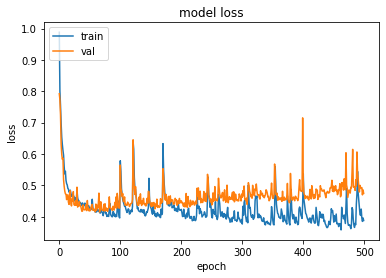

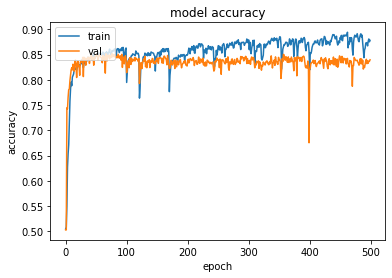

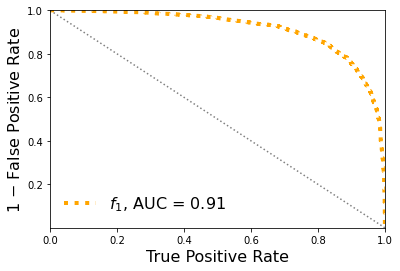

313/313 [==============================] - 2s 6ms/step - loss: 0.4808 - acc: 0.8360 - f1_m: 0.4563 - precision_m: 0.5002 - recall_m: 0.4205
Test ROC-AUC: 0.9142265600000001
Test loss: 0.4808388650417328
Test accuracy: 0.8360000252723694
Test f1: 0.4562510550022125
Test precision: 0.5001775026321411
Test recall: 0.4205271601676941
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.9291 - acc: 0.6488 - f1_m: 0.6447 - precision_m: 0.6592 - recall_m: 0.6730 - val_loss: 0.5804 - val_acc: 0.7645 - val_f1_m: 0.7890 - val_precision_m: 0.7066 - val_recall_m: 0.8991
Epoch 2/500
375/375 [==============================] - 23s 61ms/step - loss: 0.5916 - acc: 0.7775 - f1_m: 0.7805 - precision_m: 0.7707 - recall_m: 0.8018 - val_loss: 0.5393 - val_acc: 0.7967 - val_f1_m: 0.7763 - val_precision_m: 0.84

Epoch 31/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4886 - acc: 0.8218 - f1_m: 0.8214 - precision_m: 0.8218 - recall_m: 0.8308 - val_loss: 0.4730 - val_acc: 0.8070 - val_f1_m: 0.7839 - val_precision_m: 0.8765 - val_recall_m: 0.7135
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4969 - acc: 0.8198 - f1_m: 0.8161 - precision_m: 0.8272 - recall_m: 0.8175 - val_loss: 0.4562 - val_acc: 0.8347 - val_f1_m: 0.8348 - val_precision_m: 0.8232 - val_recall_m: 0.8519
Epoch 33/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4760 - acc: 0.8303 - f1_m: 0.8263 - precision_m: 0.8278 - recall_m: 0.8340 - val_loss: 0.4480 - val_acc: 0.8363 - val_f1_m: 0.8392 - val_precision_m: 0.8116 - val_recall_m: 0.8733
Epoch 34/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4774 - acc: 0.8272 - f1_m: 0.8260 - precision_m: 0.8244 - recall_m: 0.8383 - val_loss: 0.4904 - val_acc: 0.8068 - val_f1_m: 0.7819 - val_pre

375/375 [==============================] - 23s 60ms/step - loss: 0.4547 - acc: 0.8325 - f1_m: 0.8297 - precision_m: 0.8302 - recall_m: 0.8384 - val_loss: 0.4523 - val_acc: 0.8240 - val_f1_m: 0.8059 - val_precision_m: 0.8864 - val_recall_m: 0.7440
Epoch 94/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4680 - acc: 0.8298 - f1_m: 0.8300 - precision_m: 0.8234 - recall_m: 0.8483 - val_loss: 0.4349 - val_acc: 0.8368 - val_f1_m: 0.8277 - val_precision_m: 0.8626 - val_recall_m: 0.8005
Epoch 95/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4572 - acc: 0.8333 - f1_m: 0.8331 - precision_m: 0.8245 - recall_m: 0.8510 - val_loss: 0.4255 - val_acc: 0.8432 - val_f1_m: 0.8414 - val_precision_m: 0.8391 - val_recall_m: 0.8486
Epoch 96/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4661 - acc: 0.8300 - f1_m: 0.8287 - precision_m: 0.8181 - recall_m: 0.8476 - val_loss: 0.4367 - val_acc: 0.8287 - val_f1_m: 0.8166 - val_precision_m: 0.8

375/375 [==============================] - 23s 60ms/step - loss: 0.4569 - acc: 0.8383 - f1_m: 0.8385 - precision_m: 0.8259 - recall_m: 0.8593 - val_loss: 0.4176 - val_acc: 0.8507 - val_f1_m: 0.8535 - val_precision_m: 0.8258 - val_recall_m: 0.8876
Epoch 156/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4775 - acc: 0.8241 - f1_m: 0.8205 - precision_m: 0.8205 - recall_m: 0.8380 - val_loss: 0.4211 - val_acc: 0.8458 - val_f1_m: 0.8522 - val_precision_m: 0.8072 - val_recall_m: 0.9069
Epoch 157/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4414 - acc: 0.8401 - f1_m: 0.8406 - precision_m: 0.8270 - recall_m: 0.8628 - val_loss: 0.4209 - val_acc: 0.8362 - val_f1_m: 0.8274 - val_precision_m: 0.8611 - val_recall_m: 0.8016
Epoch 158/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4888 - acc: 0.8172 - f1_m: 0.8139 - precision_m: 0.8185 - recall_m: 0.8264 - val_loss: 0.4167 - val_acc: 0.8418 - val_f1_m: 0.8381 - val_precision_m: 

375/375 [==============================] - 23s 60ms/step - loss: 0.4405 - acc: 0.8387 - f1_m: 0.8392 - precision_m: 0.8271 - recall_m: 0.8599 - val_loss: 0.4317 - val_acc: 0.8332 - val_f1_m: 0.8220 - val_precision_m: 0.8671 - val_recall_m: 0.7858
Epoch 218/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4347 - acc: 0.8443 - f1_m: 0.8445 - precision_m: 0.8377 - recall_m: 0.8601 - val_loss: 0.4233 - val_acc: 0.8417 - val_f1_m: 0.8345 - val_precision_m: 0.8608 - val_recall_m: 0.8145
Epoch 219/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4672 - acc: 0.8288 - f1_m: 0.8282 - precision_m: 0.8256 - recall_m: 0.8425 - val_loss: 0.4403 - val_acc: 0.8083 - val_f1_m: 0.7830 - val_precision_m: 0.8903 - val_recall_m: 0.7037
Epoch 220/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4385 - acc: 0.8439 - f1_m: 0.8446 - precision_m: 0.8381 - recall_m: 0.8600 - val_loss: 0.4042 - val_acc: 0.8512 - val_f1_m: 0.8529 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4445 - acc: 0.8361 - f1_m: 0.8358 - precision_m: 0.8255 - recall_m: 0.8573 - val_loss: 0.4097 - val_acc: 0.8532 - val_f1_m: 0.8527 - val_precision_m: 0.8415 - val_recall_m: 0.8691
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4588 - acc: 0.8337 - f1_m: 0.8333 - precision_m: 0.8267 - recall_m: 0.8519 - val_loss: 0.4070 - val_acc: 0.8528 - val_f1_m: 0.8525 - val_precision_m: 0.8428 - val_recall_m: 0.8671
Epoch 281/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4543 - acc: 0.8373 - f1_m: 0.8360 - precision_m: 0.8342 - recall_m: 0.8486 - val_loss: 0.4143 - val_acc: 0.8515 - val_f1_m: 0.8550 - val_precision_m: 0.8274 - val_recall_m: 0.8891
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4394 - acc: 0.8414 - f1_m: 0.8418 - precision_m: 0.8324 - recall_m: 0.8592 - val_loss: 0.4304 - val_acc: 0.8330 - val_f1_m: 0.8212 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4442 - acc: 0.8387 - f1_m: 0.8405 - precision_m: 0.8271 - recall_m: 0.8622 - val_loss: 0.4248 - val_acc: 0.8523 - val_f1_m: 0.8587 - val_precision_m: 0.8139 - val_recall_m: 0.9133
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4579 - acc: 0.8351 - f1_m: 0.8333 - precision_m: 0.8242 - recall_m: 0.8537 - val_loss: 0.4198 - val_acc: 0.8493 - val_f1_m: 0.8523 - val_precision_m: 0.8245 - val_recall_m: 0.8868
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4768 - acc: 0.8232 - f1_m: 0.8203 - precision_m: 0.8228 - recall_m: 0.8373 - val_loss: 0.4186 - val_acc: 0.8470 - val_f1_m: 0.8448 - val_precision_m: 0.8451 - val_recall_m: 0.8489
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4338 - acc: 0.8487 - f1_m: 0.8502 - precision_m: 0.8379 - recall_m: 0.8686 - val_loss: 0.4509 - val_acc: 0.8243 - val_f1_m: 0.8039 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4625 - acc: 0.8349 - f1_m: 0.8327 - precision_m: 0.8253 - recall_m: 0.8501 - val_loss: 0.4362 - val_acc: 0.8433 - val_f1_m: 0.8383 - val_precision_m: 0.8548 - val_recall_m: 0.8271
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4419 - acc: 0.8358 - f1_m: 0.8347 - precision_m: 0.8239 - recall_m: 0.8549 - val_loss: 0.4408 - val_acc: 0.8443 - val_f1_m: 0.8439 - val_precision_m: 0.8328 - val_recall_m: 0.8602
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4798 - acc: 0.8241 - f1_m: 0.8179 - precision_m: 0.8159 - recall_m: 0.8376 - val_loss: 0.4224 - val_acc: 0.8512 - val_f1_m: 0.8520 - val_precision_m: 0.8343 - val_recall_m: 0.8749
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4417 - acc: 0.8391 - f1_m: 0.8415 - precision_m: 0.8280 - recall_m: 0.8634 - val_loss: 0.4174 - val_acc: 0.8440 - val_f1_m: 0.8377 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4467 - acc: 0.8376 - f1_m: 0.8367 - precision_m: 0.8313 - recall_m: 0.8509 - val_loss: 0.4234 - val_acc: 0.8483 - val_f1_m: 0.8560 - val_precision_m: 0.8045 - val_recall_m: 0.9187
Epoch 466/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4448 - acc: 0.8377 - f1_m: 0.8397 - precision_m: 0.8278 - recall_m: 0.8612 - val_loss: 0.4136 - val_acc: 0.8380 - val_f1_m: 0.8284 - val_precision_m: 0.8681 - val_recall_m: 0.7967
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4425 - acc: 0.8398 - f1_m: 0.8399 - precision_m: 0.8276 - recall_m: 0.8613 - val_loss: 0.4438 - val_acc: 0.8450 - val_f1_m: 0.8501 - val_precision_m: 0.8153 - val_recall_m: 0.8924
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4725 - acc: 0.8324 - f1_m: 0.8337 - precision_m: 0.8223 - recall_m: 0.8562 - val_loss: 0.4277 - val_acc: 0.8470 - val_f1_m: 0.8544 - val_precision_m: 

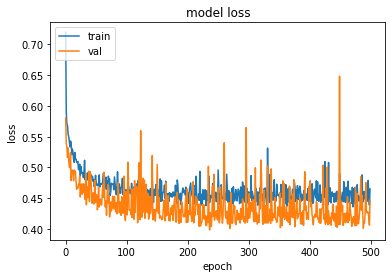

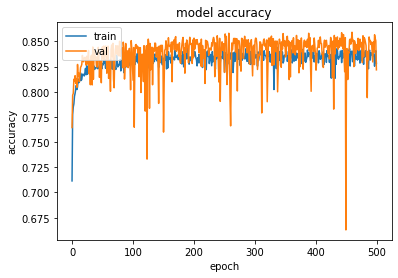

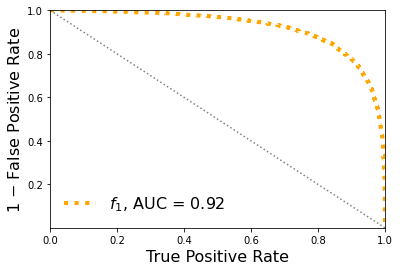

313/313 [==============================] - 2s 6ms/step - loss: 0.4653 - acc: 0.8242 - f1_m: 0.4259 - precision_m: 0.5000 - recall_m: 0.3727
Test ROC-AUC: 0.92146584
Test loss: 0.46532192826271057
Test accuracy: 0.8241999745368958
Test f1: 0.42594295740127563
Test precision: 0.5
Test recall: 0.3727036714553833
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 117ms/step - loss: 0.7525 - acc: 0.6373 - f1_m: 0.6103 - precision_m: 0.6443 - recall_m: 0.6021 - val_loss: 0.5722 - val_acc: 0.7690 - val_f1_m: 0.7940 - val_precision_m: 0.7109 - val_recall_m: 0.9021
Epoch 2/500
188/188 [==============================] - 21s 113ms/step - loss: 0.5743 - acc: 0.7815 - f1_m: 0.7881 - precision_m: 0.7742 - recall_m: 0.8091 - val_loss: 0.5102 - val_acc: 0.8088 - val_f1_m: 0.8180 - val_precision_m: 0.7732 - val_recall_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4305 - acc: 0.8519 - f1_m: 0.8516 - precision_m: 0.8436 - recall_m: 0.8644 - val_loss: 0.5451 - val_acc: 0.7778 - val_f1_m: 0.7301 - val_precision_m: 0.9182 - val_recall_m: 0.6098
Epoch 62/500
188/188 [==============================] - 22s 117ms/step - loss: 0.5046 - acc: 0.8206 - f1_m: 0.8185 - precision_m: 0.8160 - recall_m: 0.8362 - val_loss: 0.4386 - val_acc: 0.8435 - val_f1_m: 0.8457 - val_precision_m: 0.8259 - val_recall_m: 0.8689
Epoch 63/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4425 - acc: 0.8450 - f1_m: 0.8443 - precision_m: 0.8351 - recall_m: 0.8576 - val_loss: 0.4263 - val_acc: 0.8485 - val_f1_m: 0.8508 - val_precision_m: 0.8324 - val_recall_m: 0.8728
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4295 - acc: 0.8479 - f1_m: 0.8497 - precision_m: 0.8405 - recall_m: 0.8636 - val_loss: 0.4220 - val_acc: 0.8468 - val_f1_m: 0.8460 - val_precision_m:

188/188 [==============================] - 22s 117ms/step - loss: 0.4440 - acc: 0.8457 - f1_m: 0.8470 - precision_m: 0.8394 - recall_m: 0.8615 - val_loss: 0.4494 - val_acc: 0.8205 - val_f1_m: 0.8030 - val_precision_m: 0.8803 - val_recall_m: 0.7416
Epoch 124/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4263 - acc: 0.8511 - f1_m: 0.8515 - precision_m: 0.8429 - recall_m: 0.8664 - val_loss: 0.4175 - val_acc: 0.8458 - val_f1_m: 0.8407 - val_precision_m: 0.8620 - val_recall_m: 0.8232
Epoch 125/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4240 - acc: 0.8516 - f1_m: 0.8520 - precision_m: 0.8507 - recall_m: 0.8587 - val_loss: 0.4266 - val_acc: 0.8362 - val_f1_m: 0.8278 - val_precision_m: 0.8640 - val_recall_m: 0.7971
Epoch 126/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4116 - acc: 0.8539 - f1_m: 0.8562 - precision_m: 0.8508 - recall_m: 0.8657 - val_loss: 0.4205 - val_acc: 0.8375 - val_f1_m: 0.8283 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4118 - acc: 0.8553 - f1_m: 0.8537 - precision_m: 0.8444 - recall_m: 0.8673 - val_loss: 0.4334 - val_acc: 0.8403 - val_f1_m: 0.8336 - val_precision_m: 0.8609 - val_recall_m: 0.8104
Epoch 186/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4306 - acc: 0.8458 - f1_m: 0.8468 - precision_m: 0.8357 - recall_m: 0.8632 - val_loss: 0.4235 - val_acc: 0.8473 - val_f1_m: 0.8457 - val_precision_m: 0.8498 - val_recall_m: 0.8440
Epoch 187/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4694 - acc: 0.8310 - f1_m: 0.8317 - precision_m: 0.8265 - recall_m: 0.8476 - val_loss: 0.4288 - val_acc: 0.8507 - val_f1_m: 0.8528 - val_precision_m: 0.8348 - val_recall_m: 0.8743
Epoch 188/500
188/188 [==============================] - 22s 120ms/step - loss: 0.4454 - acc: 0.8448 - f1_m: 0.8499 - precision_m: 0.8351 - recall_m: 0.8709 - val_loss: 0.4285 - val_acc: 0.8430 - val_f1_m: 0.8409 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.5147 - acc: 0.8099 - f1_m: 0.8103 - precision_m: 0.8084 - recall_m: 0.8363 - val_loss: 0.4272 - val_acc: 0.8433 - val_f1_m: 0.8481 - val_precision_m: 0.8180 - val_recall_m: 0.8835
Epoch 248/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4182 - acc: 0.8554 - f1_m: 0.8581 - precision_m: 0.8429 - recall_m: 0.8787 - val_loss: 0.4107 - val_acc: 0.8528 - val_f1_m: 0.8509 - val_precision_m: 0.8547 - val_recall_m: 0.8499
Epoch 249/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4102 - acc: 0.8567 - f1_m: 0.8572 - precision_m: 0.8490 - recall_m: 0.8696 - val_loss: 0.4087 - val_acc: 0.8553 - val_f1_m: 0.8571 - val_precision_m: 0.8425 - val_recall_m: 0.8754
Epoch 250/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4361 - acc: 0.8425 - f1_m: 0.8448 - precision_m: 0.8344 - recall_m: 0.8622 - val_loss: 0.4278 - val_acc: 0.8443 - val_f1_m: 0.8387 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4211 - acc: 0.8506 - f1_m: 0.8524 - precision_m: 0.8363 - recall_m: 0.8752 - val_loss: 0.4140 - val_acc: 0.8452 - val_f1_m: 0.8390 - val_precision_m: 0.8672 - val_recall_m: 0.8152
Epoch 310/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4264 - acc: 0.8466 - f1_m: 0.8482 - precision_m: 0.8391 - recall_m: 0.8637 - val_loss: 0.4254 - val_acc: 0.8402 - val_f1_m: 0.8316 - val_precision_m: 0.8690 - val_recall_m: 0.7998
Epoch 311/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4645 - acc: 0.8276 - f1_m: 0.8279 - precision_m: 0.8191 - recall_m: 0.8503 - val_loss: 0.4145 - val_acc: 0.8520 - val_f1_m: 0.8553 - val_precision_m: 0.8301 - val_recall_m: 0.8847
Epoch 312/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4256 - acc: 0.8500 - f1_m: 0.8523 - precision_m: 0.8392 - recall_m: 0.8695 - val_loss: 0.4192 - val_acc: 0.8522 - val_f1_m: 0.8575 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4491 - acc: 0.8355 - f1_m: 0.8393 - precision_m: 0.8139 - recall_m: 0.8729 - val_loss: 0.4014 - val_acc: 0.8507 - val_f1_m: 0.8504 - val_precision_m: 0.8453 - val_recall_m: 0.8587
Epoch 372/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4160 - acc: 0.8527 - f1_m: 0.8560 - precision_m: 0.8344 - recall_m: 0.8842 - val_loss: 0.4006 - val_acc: 0.8452 - val_f1_m: 0.8453 - val_precision_m: 0.8380 - val_recall_m: 0.8553
Epoch 373/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4254 - acc: 0.8456 - f1_m: 0.8490 - precision_m: 0.8342 - recall_m: 0.8732 - val_loss: 0.4265 - val_acc: 0.8408 - val_f1_m: 0.8357 - val_precision_m: 0.8567 - val_recall_m: 0.8184
Epoch 374/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4522 - acc: 0.8379 - f1_m: 0.8390 - precision_m: 0.8257 - recall_m: 0.8598 - val_loss: 0.4420 - val_acc: 0.8307 - val_f1_m: 0.8162 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4276 - acc: 0.8481 - f1_m: 0.8505 - precision_m: 0.8294 - recall_m: 0.8759 - val_loss: 0.3991 - val_acc: 0.8558 - val_f1_m: 0.8596 - val_precision_m: 0.8323 - val_recall_m: 0.8912
Epoch 434/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4091 - acc: 0.8564 - f1_m: 0.8597 - precision_m: 0.8432 - recall_m: 0.8804 - val_loss: 0.4074 - val_acc: 0.8500 - val_f1_m: 0.8568 - val_precision_m: 0.8144 - val_recall_m: 0.9069
Epoch 435/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4179 - acc: 0.8450 - f1_m: 0.8483 - precision_m: 0.8307 - recall_m: 0.8709 - val_loss: 0.4279 - val_acc: 0.8258 - val_f1_m: 0.8087 - val_precision_m: 0.8884 - val_recall_m: 0.7447
Epoch 436/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4245 - acc: 0.8472 - f1_m: 0.8470 - precision_m: 0.8405 - recall_m: 0.8596 - val_loss: 0.4275 - val_acc: 0.8468 - val_f1_m: 0.8560 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4271 - acc: 0.8449 - f1_m: 0.8456 - precision_m: 0.8358 - recall_m: 0.8634 - val_loss: 0.4119 - val_acc: 0.8448 - val_f1_m: 0.8367 - val_precision_m: 0.8762 - val_recall_m: 0.8032
Epoch 496/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4162 - acc: 0.8484 - f1_m: 0.8500 - precision_m: 0.8336 - recall_m: 0.8711 - val_loss: 0.4030 - val_acc: 0.8535 - val_f1_m: 0.8607 - val_precision_m: 0.8146 - val_recall_m: 0.9150
Epoch 497/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4147 - acc: 0.8528 - f1_m: 0.8572 - precision_m: 0.8403 - recall_m: 0.8787 - val_loss: 0.4090 - val_acc: 0.8540 - val_f1_m: 0.8610 - val_precision_m: 0.8161 - val_recall_m: 0.9137
Epoch 498/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4333 - acc: 0.8393 - f1_m: 0.8415 - precision_m: 0.8297 - recall_m: 0.8622 - val_loss: 0.4214 - val_acc: 0.8440 - val_f1_m: 0.8377 - val_precision

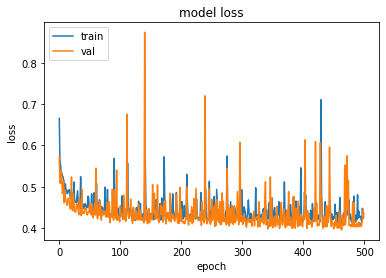

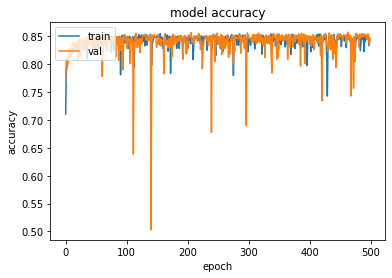

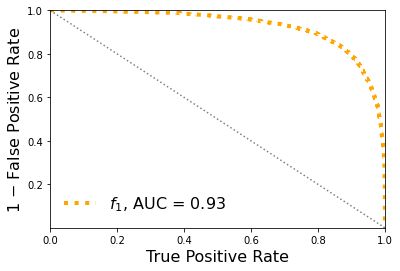

313/313 [==============================] - 2s 6ms/step - loss: 0.4317 - acc: 0.8472 - f1_m: 0.4463 - precision_m: 0.5004 - recall_m: 0.4042
Test ROC-AUC: 0.92740892
Test loss: 0.4317256808280945
Test accuracy: 0.8471999764442444
Test f1: 0.44633185863494873
Test precision: 0.5003993511199951
Test recall: 0.40415334701538086
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.005
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 252ms/step - loss: 1.8619 - acc: 0.5634 - f1_m: 0.5536 - precision_m: 0.5693 - recall_m: 0.5716 - val_loss: 0.6377 - val_acc: 0.7577 - val_f1_m: 0.7446 - val_precision_m: 0.7779 - val_recall_m: 0.7157
Epoch 2/500
94/94 [==============================] - 23s 242ms/step - loss: 0.6397 - acc: 0.7477 - f1_m: 0.7511 - precision_m: 0.7450 - recall_m: 0.7609 - val_loss: 0.5722 - val_acc: 0.7872 - val_f1_m: 0.7781 - val_precision_m: 0.8062 - va

Epoch 31/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4674 - acc: 0.8407 - f1_m: 0.8436 - precision_m: 0.8341 - recall_m: 0.8594 - val_loss: 0.4564 - val_acc: 0.8373 - val_f1_m: 0.8299 - val_precision_m: 0.8619 - val_recall_m: 0.8019
Epoch 32/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4588 - acc: 0.8454 - f1_m: 0.8460 - precision_m: 0.8390 - recall_m: 0.8592 - val_loss: 0.4516 - val_acc: 0.8463 - val_f1_m: 0.8534 - val_precision_m: 0.8049 - val_recall_m: 0.9099
Epoch 33/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4520 - acc: 0.8496 - f1_m: 0.8526 - precision_m: 0.8448 - recall_m: 0.8665 - val_loss: 0.5071 - val_acc: 0.8210 - val_f1_m: 0.8408 - val_precision_m: 0.7466 - val_recall_m: 0.9637
Epoch 34/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4865 - acc: 0.8299 - f1_m: 0.8297 - precision_m: 0.8220 - recall_m: 0.8511 - val_loss: 0.4454 - val_acc: 0.8452 - val_f1_m: 0.8411 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4257 - acc: 0.8543 - f1_m: 0.8555 - precision_m: 0.8403 - recall_m: 0.8770 - val_loss: 0.4296 - val_acc: 0.8423 - val_f1_m: 0.8332 - val_precision_m: 0.8708 - val_recall_m: 0.8001
Epoch 64/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4232 - acc: 0.8554 - f1_m: 0.8578 - precision_m: 0.8453 - recall_m: 0.8750 - val_loss: 0.4653 - val_acc: 0.8135 - val_f1_m: 0.7926 - val_precision_m: 0.8837 - val_recall_m: 0.7207
Epoch 65/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4539 - acc: 0.8366 - f1_m: 0.8385 - precision_m: 0.8311 - recall_m: 0.8543 - val_loss: 0.4280 - val_acc: 0.8368 - val_f1_m: 0.8254 - val_precision_m: 0.8735 - val_recall_m: 0.7836
Epoch 66/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4268 - acc: 0.8536 - f1_m: 0.8544 - precision_m: 0.8455 - recall_m: 0.8669 - val_loss: 0.4513 - val_acc: 0.8222 - val_f1_m: 0.8021 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4384 - acc: 0.8467 - f1_m: 0.8525 - precision_m: 0.8304 - recall_m: 0.8835 - val_loss: 0.4209 - val_acc: 0.8500 - val_f1_m: 0.8518 - val_precision_m: 0.8310 - val_recall_m: 0.8752
Epoch 96/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4159 - acc: 0.8561 - f1_m: 0.8575 - precision_m: 0.8454 - recall_m: 0.8724 - val_loss: 0.4207 - val_acc: 0.8558 - val_f1_m: 0.8619 - val_precision_m: 0.8173 - val_recall_m: 0.9131
Epoch 97/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4104 - acc: 0.8627 - f1_m: 0.8646 - precision_m: 0.8521 - recall_m: 0.8815 - val_loss: 0.4129 - val_acc: 0.8550 - val_f1_m: 0.8555 - val_precision_m: 0.8386 - val_recall_m: 0.8745
Epoch 98/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4139 - acc: 0.8567 - f1_m: 0.8577 - precision_m: 0.8490 - recall_m: 0.8712 - val_loss: 0.4131 - val_acc: 0.8488 - val_f1_m: 0.8461 - val_precisi

94/94 [==============================] - 23s 240ms/step - loss: 0.4059 - acc: 0.8628 - f1_m: 0.8653 - precision_m: 0.8533 - recall_m: 0.8816 - val_loss: 0.4363 - val_acc: 0.8402 - val_f1_m: 0.8297 - val_precision_m: 0.8688 - val_recall_m: 0.7958
Epoch 158/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4245 - acc: 0.8554 - f1_m: 0.8583 - precision_m: 0.8492 - recall_m: 0.8719 - val_loss: 0.4407 - val_acc: 0.8503 - val_f1_m: 0.8576 - val_precision_m: 0.8089 - val_recall_m: 0.9139
Epoch 159/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4270 - acc: 0.8596 - f1_m: 0.8624 - precision_m: 0.8470 - recall_m: 0.8828 - val_loss: 0.4269 - val_acc: 0.8470 - val_f1_m: 0.8404 - val_precision_m: 0.8610 - val_recall_m: 0.8224
Epoch 160/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4495 - acc: 0.8446 - f1_m: 0.8469 - precision_m: 0.8384 - recall_m: 0.8631 - val_loss: 0.4209 - val_acc: 0.8490 - val_f1_m: 0.8456 - val_precision_m: 0.85

94/94 [==============================] - 23s 240ms/step - loss: 0.4156 - acc: 0.8621 - f1_m: 0.8630 - precision_m: 0.8526 - recall_m: 0.8783 - val_loss: 0.4904 - val_acc: 0.8387 - val_f1_m: 0.8506 - val_precision_m: 0.7789 - val_recall_m: 0.9385
Epoch 220/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4023 - acc: 0.8604 - f1_m: 0.8617 - precision_m: 0.8522 - recall_m: 0.8759 - val_loss: 0.4111 - val_acc: 0.8568 - val_f1_m: 0.8574 - val_precision_m: 0.8402 - val_recall_m: 0.8767
Epoch 221/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3930 - acc: 0.8746 - f1_m: 0.8749 - precision_m: 0.8712 - recall_m: 0.8811 - val_loss: 0.4161 - val_acc: 0.8622 - val_f1_m: 0.8656 - val_precision_m: 0.8324 - val_recall_m: 0.9029
Epoch 222/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3840 - acc: 0.8742 - f1_m: 0.8760 - precision_m: 0.8703 - recall_m: 0.8850 - val_loss: 0.4279 - val_acc: 0.8445 - val_f1_m: 0.8362 - val_precision_m: 0.87

94/94 [==============================] - 23s 240ms/step - loss: 0.3785 - acc: 0.8767 - f1_m: 0.8775 - precision_m: 0.8723 - recall_m: 0.8845 - val_loss: 0.4144 - val_acc: 0.8475 - val_f1_m: 0.8447 - val_precision_m: 0.8455 - val_recall_m: 0.8454
Epoch 282/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3861 - acc: 0.8747 - f1_m: 0.8733 - precision_m: 0.8733 - recall_m: 0.8762 - val_loss: 0.4166 - val_acc: 0.8540 - val_f1_m: 0.8525 - val_precision_m: 0.8433 - val_recall_m: 0.8635
Epoch 283/500
94/94 [==============================] - 23s 241ms/step - loss: 0.3890 - acc: 0.8722 - f1_m: 0.8729 - precision_m: 0.8673 - recall_m: 0.8816 - val_loss: 0.4331 - val_acc: 0.8497 - val_f1_m: 0.8580 - val_precision_m: 0.8023 - val_recall_m: 0.9235
Epoch 284/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4003 - acc: 0.8669 - f1_m: 0.8692 - precision_m: 0.8626 - recall_m: 0.8806 - val_loss: 0.4170 - val_acc: 0.8505 - val_f1_m: 0.8539 - val_precision_m: 0.82

94/94 [==============================] - 23s 240ms/step - loss: 0.3999 - acc: 0.8648 - f1_m: 0.8651 - precision_m: 0.8565 - recall_m: 0.8773 - val_loss: 0.4114 - val_acc: 0.8492 - val_f1_m: 0.8432 - val_precision_m: 0.8636 - val_recall_m: 0.8252
Epoch 344/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4035 - acc: 0.8593 - f1_m: 0.8603 - precision_m: 0.8554 - recall_m: 0.8711 - val_loss: 0.4084 - val_acc: 0.8492 - val_f1_m: 0.8421 - val_precision_m: 0.8707 - val_recall_m: 0.8168
Epoch 345/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3910 - acc: 0.8675 - f1_m: 0.8690 - precision_m: 0.8652 - recall_m: 0.8766 - val_loss: 0.4044 - val_acc: 0.8543 - val_f1_m: 0.8513 - val_precision_m: 0.8571 - val_recall_m: 0.8469
Epoch 346/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3839 - acc: 0.8710 - f1_m: 0.8721 - precision_m: 0.8644 - recall_m: 0.8826 - val_loss: 0.4083 - val_acc: 0.8500 - val_f1_m: 0.8438 - val_precision_m: 0.86

94/94 [==============================] - 23s 240ms/step - loss: 0.4531 - acc: 0.8378 - f1_m: 0.8374 - precision_m: 0.8397 - recall_m: 0.8486 - val_loss: 0.4427 - val_acc: 0.8480 - val_f1_m: 0.8511 - val_precision_m: 0.8254 - val_recall_m: 0.8803
Epoch 406/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4217 - acc: 0.8570 - f1_m: 0.8604 - precision_m: 0.8426 - recall_m: 0.8817 - val_loss: 0.4129 - val_acc: 0.8553 - val_f1_m: 0.8549 - val_precision_m: 0.8458 - val_recall_m: 0.8658
Epoch 407/500
94/94 [==============================] - 23s 241ms/step - loss: 0.3931 - acc: 0.8676 - f1_m: 0.8674 - precision_m: 0.8626 - recall_m: 0.8757 - val_loss: 0.4226 - val_acc: 0.8415 - val_f1_m: 0.8326 - val_precision_m: 0.8691 - val_recall_m: 0.8006
Epoch 408/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4084 - acc: 0.8656 - f1_m: 0.8650 - precision_m: 0.8619 - recall_m: 0.8753 - val_loss: 0.4526 - val_acc: 0.8410 - val_f1_m: 0.8297 - val_precision_m: 0.87

94/94 [==============================] - 22s 239ms/step - loss: 0.4082 - acc: 0.8592 - f1_m: 0.8595 - precision_m: 0.8536 - recall_m: 0.8693 - val_loss: 0.4033 - val_acc: 0.8600 - val_f1_m: 0.8623 - val_precision_m: 0.8337 - val_recall_m: 0.8946
Epoch 468/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3920 - acc: 0.8619 - f1_m: 0.8635 - precision_m: 0.8551 - recall_m: 0.8749 - val_loss: 0.4062 - val_acc: 0.8522 - val_f1_m: 0.8518 - val_precision_m: 0.8395 - val_recall_m: 0.8662
Epoch 469/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4022 - acc: 0.8605 - f1_m: 0.8604 - precision_m: 0.8599 - recall_m: 0.8653 - val_loss: 0.4122 - val_acc: 0.8503 - val_f1_m: 0.8448 - val_precision_m: 0.8673 - val_recall_m: 0.8248
Epoch 470/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3865 - acc: 0.8689 - f1_m: 0.8689 - precision_m: 0.8646 - recall_m: 0.8751 - val_loss: 0.4209 - val_acc: 0.8482 - val_f1_m: 0.8507 - val_precision_m: 0.82

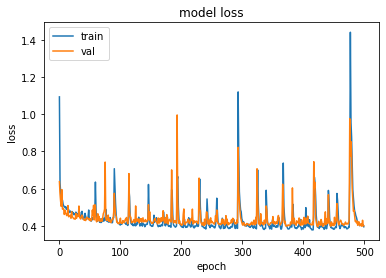

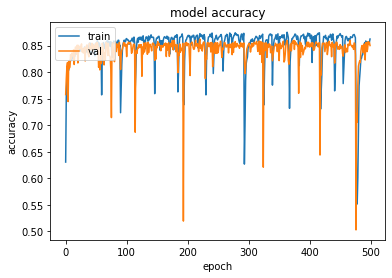

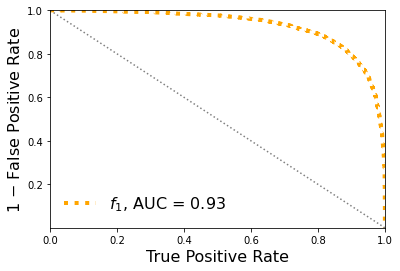

313/313 [==============================] - 2s 6ms/step - loss: 0.4071 - acc: 0.8499 - f1_m: 0.4538 - precision_m: 0.5003 - recall_m: 0.4163
Test ROC-AUC: 0.9291499
Test loss: 0.4070819318294525
Test accuracy: 0.8499000072479248
Test f1: 0.45376139879226685
Test precision: 0.5003194808959961
Test recall: 0.4163338541984558
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8140 - acc: 0.5004 - f1_m: 0.3777 - precision_m: 0.5011 - recall_m: 0.3672 - val_loss: 0.7210 - val_acc: 0.4972 - val_f1_m: 0.6619 - val_precision_m: 0.4972 - val_recall_m: 1.0000
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.6517 - acc: 0.6498 - f1_m: 0.6696 - precision_m: 0.6542 - recall_m: 0.7228 - val_loss: 0.5277 - val_acc: 0.7705 - val_f1_m: 0.7909 - val_precision_m: 0.7186 - v

Epoch 31/500
375/375 [==============================] - 22s 60ms/step - loss: 0.5381 - acc: 0.8004 - f1_m: 0.8001 - precision_m: 0.7846 - recall_m: 0.8237 - val_loss: 0.4763 - val_acc: 0.8190 - val_f1_m: 0.8279 - val_precision_m: 0.7796 - val_recall_m: 0.8885
Epoch 32/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4935 - acc: 0.8116 - f1_m: 0.8150 - precision_m: 0.7963 - recall_m: 0.8435 - val_loss: 0.4572 - val_acc: 0.8282 - val_f1_m: 0.8335 - val_precision_m: 0.7973 - val_recall_m: 0.8786
Epoch 33/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4811 - acc: 0.8165 - f1_m: 0.8190 - precision_m: 0.8002 - recall_m: 0.8471 - val_loss: 0.4483 - val_acc: 0.8305 - val_f1_m: 0.8344 - val_precision_m: 0.8059 - val_recall_m: 0.8710
Epoch 34/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4757 - acc: 0.8203 - f1_m: 0.8204 - precision_m: 0.7991 - recall_m: 0.8505 - val_loss: 0.4516 - val_acc: 0.8223 - val_f1_m: 0.8192 - val_pre

375/375 [==============================] - 22s 60ms/step - loss: 0.4366 - acc: 0.8534 - f1_m: 0.8558 - precision_m: 0.8482 - recall_m: 0.8696 - val_loss: 0.4352 - val_acc: 0.8438 - val_f1_m: 0.8452 - val_precision_m: 0.8309 - val_recall_m: 0.8656
Epoch 94/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4415 - acc: 0.8461 - f1_m: 0.8465 - precision_m: 0.8391 - recall_m: 0.8616 - val_loss: 0.4331 - val_acc: 0.8423 - val_f1_m: 0.8377 - val_precision_m: 0.8515 - val_recall_m: 0.8286
Epoch 95/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4355 - acc: 0.8511 - f1_m: 0.8495 - precision_m: 0.8378 - recall_m: 0.8693 - val_loss: 0.4380 - val_acc: 0.8407 - val_f1_m: 0.8478 - val_precision_m: 0.7993 - val_recall_m: 0.9072
Epoch 96/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4291 - acc: 0.8456 - f1_m: 0.8469 - precision_m: 0.8361 - recall_m: 0.8660 - val_loss: 0.4286 - val_acc: 0.8393 - val_f1_m: 0.8356 - val_precision_m: 0.8

375/375 [==============================] - 22s 60ms/step - loss: 0.4240 - acc: 0.8528 - f1_m: 0.8529 - precision_m: 0.8470 - recall_m: 0.8643 - val_loss: 0.4489 - val_acc: 0.8420 - val_f1_m: 0.8506 - val_precision_m: 0.7971 - val_recall_m: 0.9161
Epoch 156/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4290 - acc: 0.8521 - f1_m: 0.8517 - precision_m: 0.8494 - recall_m: 0.8634 - val_loss: 0.5022 - val_acc: 0.8397 - val_f1_m: 0.8455 - val_precision_m: 0.8068 - val_recall_m: 0.8925
Epoch 157/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4620 - acc: 0.8532 - f1_m: 0.8498 - precision_m: 0.8552 - recall_m: 0.8506 - val_loss: 0.4462 - val_acc: 0.8492 - val_f1_m: 0.8551 - val_precision_m: 0.8157 - val_recall_m: 0.9035
Epoch 158/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4337 - acc: 0.8564 - f1_m: 0.8534 - precision_m: 0.8552 - recall_m: 0.8574 - val_loss: 0.4391 - val_acc: 0.8455 - val_f1_m: 0.8488 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4404 - acc: 0.8404 - f1_m: 0.8406 - precision_m: 0.8410 - recall_m: 0.8473 - val_loss: 0.4588 - val_acc: 0.8305 - val_f1_m: 0.8274 - val_precision_m: 0.8311 - val_recall_m: 0.8298
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4364 - acc: 0.8461 - f1_m: 0.8452 - precision_m: 0.8423 - recall_m: 0.8548 - val_loss: 0.4544 - val_acc: 0.8302 - val_f1_m: 0.8285 - val_precision_m: 0.8265 - val_recall_m: 0.8360
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4327 - acc: 0.8428 - f1_m: 0.8410 - precision_m: 0.8412 - recall_m: 0.8463 - val_loss: 0.4768 - val_acc: 0.8140 - val_f1_m: 0.7976 - val_precision_m: 0.8576 - val_recall_m: 0.7500
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4483 - acc: 0.8420 - f1_m: 0.8394 - precision_m: 0.8384 - recall_m: 0.8469 - val_loss: 0.4580 - val_acc: 0.8288 - val_f1_m: 0.8310 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.5405 - acc: 0.8372 - f1_m: 0.8319 - precision_m: 0.8426 - recall_m: 0.8318 - val_loss: 0.4797 - val_acc: 0.8260 - val_f1_m: 0.8222 - val_precision_m: 0.8312 - val_recall_m: 0.8192
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4471 - acc: 0.8472 - f1_m: 0.8453 - precision_m: 0.8419 - recall_m: 0.8543 - val_loss: 0.4751 - val_acc: 0.8228 - val_f1_m: 0.8153 - val_precision_m: 0.8408 - val_recall_m: 0.7976
Epoch 281/500
375/375 [==============================] - 22s 59ms/step - loss: 0.4367 - acc: 0.8465 - f1_m: 0.8469 - precision_m: 0.8407 - recall_m: 0.8583 - val_loss: 0.4797 - val_acc: 0.8205 - val_f1_m: 0.8196 - val_precision_m: 0.8141 - val_recall_m: 0.8304
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4524 - acc: 0.8411 - f1_m: 0.8403 - precision_m: 0.8428 - recall_m: 0.8447 - val_loss: 0.4779 - val_acc: 0.8255 - val_f1_m: 0.8236 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4333 - acc: 0.8452 - f1_m: 0.8451 - precision_m: 0.8405 - recall_m: 0.8555 - val_loss: 0.4510 - val_acc: 0.8285 - val_f1_m: 0.8251 - val_precision_m: 0.8292 - val_recall_m: 0.8264
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4339 - acc: 0.8409 - f1_m: 0.8403 - precision_m: 0.8396 - recall_m: 0.8479 - val_loss: 0.4633 - val_acc: 0.8258 - val_f1_m: 0.8255 - val_precision_m: 0.8172 - val_recall_m: 0.8398
Epoch 343/500
375/375 [==============================] - 22s 59ms/step - loss: 0.4374 - acc: 0.8434 - f1_m: 0.8447 - precision_m: 0.8377 - recall_m: 0.8574 - val_loss: 0.4607 - val_acc: 0.8223 - val_f1_m: 0.8122 - val_precision_m: 0.8468 - val_recall_m: 0.7864
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4456 - acc: 0.8429 - f1_m: 0.8428 - precision_m: 0.8398 - recall_m: 0.8518 - val_loss: 0.4582 - val_acc: 0.8235 - val_f1_m: 0.8164 - val_precision_m: 

375/375 [==============================] - 22s 59ms/step - loss: 0.4284 - acc: 0.8561 - f1_m: 0.8547 - precision_m: 0.8528 - recall_m: 0.8609 - val_loss: 0.4646 - val_acc: 0.8277 - val_f1_m: 0.8221 - val_precision_m: 0.8406 - val_recall_m: 0.8095
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4474 - acc: 0.8496 - f1_m: 0.8455 - precision_m: 0.8468 - recall_m: 0.8492 - val_loss: 0.5211 - val_acc: 0.8328 - val_f1_m: 0.8376 - val_precision_m: 0.7994 - val_recall_m: 0.8844
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4620 - acc: 0.8517 - f1_m: 0.8507 - precision_m: 0.8534 - recall_m: 0.8547 - val_loss: 0.4574 - val_acc: 0.8343 - val_f1_m: 0.8320 - val_precision_m: 0.8333 - val_recall_m: 0.8358
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4282 - acc: 0.8520 - f1_m: 0.8501 - precision_m: 0.8574 - recall_m: 0.8494 - val_loss: 0.4667 - val_acc: 0.8375 - val_f1_m: 0.8385 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4504 - acc: 0.8565 - f1_m: 0.8545 - precision_m: 0.8591 - recall_m: 0.8554 - val_loss: 0.4797 - val_acc: 0.8263 - val_f1_m: 0.8293 - val_precision_m: 0.8053 - val_recall_m: 0.8603
Epoch 466/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4396 - acc: 0.8519 - f1_m: 0.8496 - precision_m: 0.8525 - recall_m: 0.8518 - val_loss: 0.4830 - val_acc: 0.8228 - val_f1_m: 0.8317 - val_precision_m: 0.7816 - val_recall_m: 0.8944
Epoch 467/500
375/375 [==============================] - 22s 59ms/step - loss: 0.4354 - acc: 0.8586 - f1_m: 0.8574 - precision_m: 0.8621 - recall_m: 0.8586 - val_loss: 0.4729 - val_acc: 0.8240 - val_f1_m: 0.8149 - val_precision_m: 0.8461 - val_recall_m: 0.7915
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4302 - acc: 0.8556 - f1_m: 0.8533 - precision_m: 0.8580 - recall_m: 0.8554 - val_loss: 0.4736 - val_acc: 0.8193 - val_f1_m: 0.8009 - val_precision_m: 

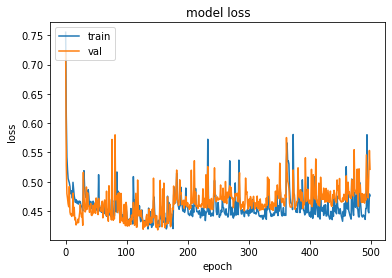

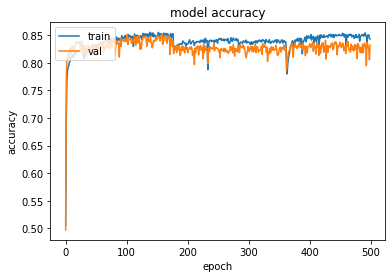

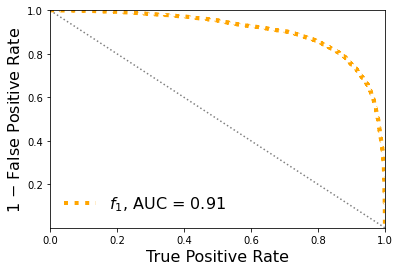

313/313 [==============================] - 2s 6ms/step - loss: 0.5203 - acc: 0.8275 - f1_m: 0.4724 - precision_m: 0.4998 - recall_m: 0.4491
Test ROC-AUC: 0.90781366
Test loss: 0.5203219056129456
Test accuracy: 0.8274999856948853
Test f1: 0.47243350744247437
Test precision: 0.4997718036174774
Test recall: 0.4490814805030823
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 116ms/step - loss: 1.3119 - acc: 0.4969 - f1_m: 0.5483 - precision_m: 0.5036 - recall_m: 0.6885 - val_loss: 0.7338 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 2/500
188/188 [==============================] - 21s 112ms/step - loss: 0.7300 - acc: 0.4890 - f1_m: 0.3995 - precision_m: 0.4999 - recall_m: 0.5580 - val_loss: 0.7220 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970

188/188 [==============================] - 21s 111ms/step - loss: 0.6932 - acc: 0.4972 - f1_m: 0.4203 - precision_m: 0.3161 - recall_m: 0.6307 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 62/500
188/188 [==============================] - 21s 111ms/step - loss: 0.6932 - acc: 0.4978 - f1_m: 0.2926 - precision_m: 0.2201 - recall_m: 0.4383 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 63/500
188/188 [==============================] - 21s 112ms/step - loss: 0.6932 - acc: 0.4921 - f1_m: 0.1252 - precision_m: 0.0931 - recall_m: 0.1924 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 64/500
188/188 [==============================] - 21s 113ms/step - loss: 0.6932 - acc: 0.4992 - f1_m: 0.5961 - precision_m: 0.4481 - recall_m: 0.8952 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0

188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4984 - f1_m: 0.1105 - precision_m: 0.0821 - recall_m: 0.1694 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 124/500
188/188 [==============================] - 21s 113ms/step - loss: 0.6932 - acc: 0.4996 - f1_m: 0.6651 - precision_m: 0.4996 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 125/500
188/188 [==============================] - 21s 113ms/step - loss: 0.6932 - acc: 0.4953 - f1_m: 0.3994 - precision_m: 0.2998 - recall_m: 0.6029 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 126/500
188/188 [==============================] - 21s 113ms/step - loss: 0.6932 - acc: 0.4961 - f1_m: 0.5312 - precision_m: 0.3979 - recall_m: 0.8029 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4991 - f1_m: 0.5066 - precision_m: 0.3805 - recall_m: 0.7615 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 186/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.5011 - f1_m: 0.6666 - precision_m: 0.5011 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 187/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4936 - f1_m: 0.3941 - precision_m: 0.2949 - recall_m: 0.5969 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 188/500
188/188 [==============================] - 21s 113ms/step - loss: 0.6932 - acc: 0.5019 - f1_m: 0.6494 - precision_m: 0.4886 - recall_m: 0.9726 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4980 - f1_m: 0.6272 - precision_m: 0.4708 - recall_m: 0.9436 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 217/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4924 - f1_m: 0.3012 - precision_m: 0.2244 - recall_m: 0.4597 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 218/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4928 - f1_m: 0.5172 - precision_m: 0.3873 - recall_m: 0.7824 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 219/500
188/188 [==============================] - 22s 114ms/step - loss: 0.6932 - acc: 0.4938 - f1_m: 0.2841 - precision_m: 0.2119 - recall_m: 0.4328 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4949 - f1_m: 0.3186 - precision_m: 0.2386 - recall_m: 0.4820 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 248/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.5004 - f1_m: 0.6659 - precision_m: 0.5004 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 249/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6932 - acc: 0.4973 - f1_m: 0.4548 - precision_m: 0.3411 - recall_m: 0.6866 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 250/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6931 - acc: 0.5036 - f1_m: 0.6687 - precision_m: 0.5036 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.6931 - acc: 0.5062 - f1_m: 0.6674 - precision_m: 0.5043 - recall_m: 0.9941 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 279/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.4949 - f1_m: 0.1682 - precision_m: 0.1406 - recall_m: 0.2421 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 280/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.4956 - f1_m: 0.3962 - precision_m: 0.3293 - recall_m: 0.5619 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 281/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.4915 - f1_m: 0.3025 - precision_m: 0.2255 - recall_m: 0.4647 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m

188/188 [==============================] - 22s 115ms/step - loss: 0.6931 - acc: 0.5030 - f1_m: 0.6648 - precision_m: 0.5003 - recall_m: 0.9945 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 341/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.5036 - f1_m: 0.2097 - precision_m: 0.1579 - recall_m: 0.3140 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 342/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6931 - acc: 0.5038 - f1_m: 0.6690 - precision_m: 0.5038 - recall_m: 1.0000 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 343/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.5022 - f1_m: 0.6552 - precision_m: 0.4933 - recall_m: 0.9810 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6630 - v

188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.4967 - f1_m: 0.6335 - precision_m: 0.4748 - recall_m: 0.9560 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 372/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.5022 - f1_m: 0.6673 - precision_m: 0.5022 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 373/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6931 - acc: 0.5064 - f1_m: 0.6711 - precision_m: 0.5064 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 374/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6931 - acc: 0.5017 - f1_m: 0.6121 - precision_m: 0.4607 - recall_m: 0.9163 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.5001 - f1_m: 0.6223 - precision_m: 0.4676 - recall_m: 0.9332 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 434/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.5052 - f1_m: 0.0878 - precision_m: 0.0659 - recall_m: 0.1320 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 435/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6931 - acc: 0.5048 - f1_m: 0.6493 - precision_m: 0.5060 - recall_m: 0.9534 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 436/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6932 - acc: 0.5052 - f1_m: 0.6658 - precision_m: 0.5023 - recall_m: 0.9934 - val_loss: 0.6931 - val_acc: 0.5028 - val_f1_m: 0.0000e+00

Epoch 464/500
188/188 [==============================] - 22s 116ms/step - loss: 0.6932 - acc: 0.4970 - f1_m: 0.6496 - precision_m: 0.4872 - recall_m: 0.9802 - val_loss: 0.6931 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 465/500
188/188 [==============================] - 22s 116ms/step - loss: 0.6932 - acc: 0.5018 - f1_m: 0.6430 - precision_m: 0.4837 - recall_m: 0.9632 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 466/500
188/188 [==============================] - 22s 116ms/step - loss: 0.6932 - acc: 0.4939 - f1_m: 0.5130 - precision_m: 0.3841 - recall_m: 0.7762 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 467/500
188/188 [==============================] - 22s 116ms/step - loss: 0.6931 - acc: 0.5023 - f1_m: 0.6676 - precision_m: 0.5023 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6630 -

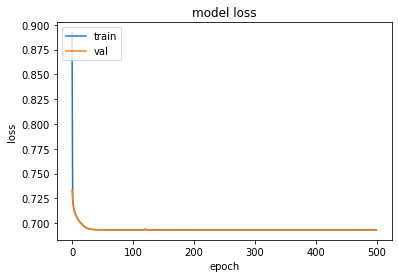

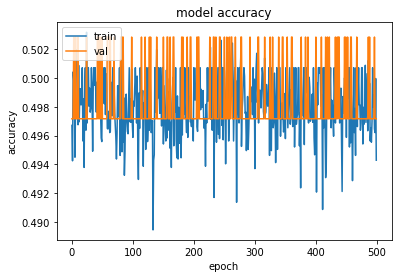

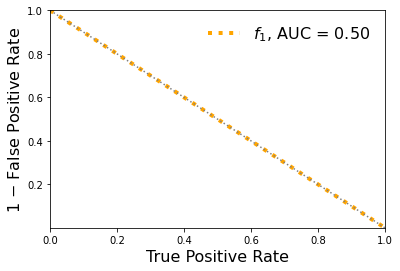

313/313 [==============================] - 2s 6ms/step - loss: 0.6932 - acc: 0.5000 - f1_m: 0.4997 - precision_m: 0.4992 - recall_m: 0.5016
Test ROC-AUC: 0.5
Test loss: 0.6931515336036682
Test accuracy: 0.5
Test f1: 0.4996804893016815
Test precision: 0.4992012679576874
Test recall: 0.5015974640846252
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 251ms/step - loss: 1.2958 - acc: 0.4912 - f1_m: 0.5487 - precision_m: 0.4924 - recall_m: 0.6477 - val_loss: 0.7480 - val_acc: 0.5415 - val_f1_m: 0.6824 - val_precision_m: 0.5190 - val_recall_m: 0.9987
Epoch 2/500
94/94 [==============================] - 23s 244ms/step - loss: 0.7274 - acc: 0.6008 - f1_m: 0.6157 - precision_m: 0.5995 - recall_m: 0.6471 - val_loss: 0.6685 - val_acc: 0.7500 - val_f1_m: 0.7733 - val_precision_m: 0.7028 - val_recall_m: 0.8613
Epo

Epoch 31/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4691 - acc: 0.8194 - f1_m: 0.8207 - precision_m: 0.8208 - recall_m: 0.8244 - val_loss: 0.4407 - val_acc: 0.8288 - val_f1_m: 0.8207 - val_precision_m: 0.8572 - val_recall_m: 0.7888
Epoch 32/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4603 - acc: 0.8247 - f1_m: 0.8227 - precision_m: 0.8300 - recall_m: 0.8187 - val_loss: 0.4285 - val_acc: 0.8355 - val_f1_m: 0.8325 - val_precision_m: 0.8399 - val_recall_m: 0.8269
Epoch 33/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4673 - acc: 0.8210 - f1_m: 0.8208 - precision_m: 0.8294 - recall_m: 0.8155 - val_loss: 0.4297 - val_acc: 0.8377 - val_f1_m: 0.8382 - val_precision_m: 0.8285 - val_recall_m: 0.8498
Epoch 34/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4512 - acc: 0.8278 - f1_m: 0.8267 - precision_m: 0.8325 - recall_m: 0.8229 - val_loss: 0.4293 - val_acc: 0.8388 - val_f1_m: 0.8383 - val_precisi

Epoch 63/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4337 - acc: 0.8362 - f1_m: 0.8351 - precision_m: 0.8493 - recall_m: 0.8235 - val_loss: 0.3986 - val_acc: 0.8445 - val_f1_m: 0.8434 - val_precision_m: 0.8405 - val_recall_m: 0.8481
Epoch 64/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4411 - acc: 0.8336 - f1_m: 0.8311 - precision_m: 0.8457 - recall_m: 0.8232 - val_loss: 0.4172 - val_acc: 0.8340 - val_f1_m: 0.8237 - val_precision_m: 0.8698 - val_recall_m: 0.7846
Epoch 65/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4240 - acc: 0.8394 - f1_m: 0.8374 - precision_m: 0.8497 - recall_m: 0.8278 - val_loss: 0.4229 - val_acc: 0.8312 - val_f1_m: 0.8190 - val_precision_m: 0.8752 - val_recall_m: 0.7715
Epoch 66/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4202 - acc: 0.8432 - f1_m: 0.8409 - precision_m: 0.8612 - recall_m: 0.8244 - val_loss: 0.4065 - val_acc: 0.8418 - val_f1_m: 0.8376 - val_precisi

Epoch 95/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4469 - acc: 0.8290 - f1_m: 0.8252 - precision_m: 0.8402 - recall_m: 0.8133 - val_loss: 0.4197 - val_acc: 0.8378 - val_f1_m: 0.8460 - val_precision_m: 0.8000 - val_recall_m: 0.8992
Epoch 96/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4463 - acc: 0.8313 - f1_m: 0.8270 - precision_m: 0.8449 - recall_m: 0.8169 - val_loss: 0.4217 - val_acc: 0.8423 - val_f1_m: 0.8425 - val_precision_m: 0.8325 - val_recall_m: 0.8544
Epoch 97/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4451 - acc: 0.8336 - f1_m: 0.8287 - precision_m: 0.8431 - recall_m: 0.8187 - val_loss: 0.4359 - val_acc: 0.8320 - val_f1_m: 0.8198 - val_precision_m: 0.8707 - val_recall_m: 0.7764
Epoch 98/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4405 - acc: 0.8353 - f1_m: 0.8321 - precision_m: 0.8502 - recall_m: 0.8172 - val_loss: 0.4252 - val_acc: 0.8378 - val_f1_m: 0.8402 - val_precisi

94/94 [==============================] - 22s 237ms/step - loss: 0.4663 - acc: 0.8280 - f1_m: 0.8316 - precision_m: 0.8186 - recall_m: 0.8489 - val_loss: 0.4452 - val_acc: 0.8342 - val_f1_m: 0.8392 - val_precision_m: 0.8039 - val_recall_m: 0.8796
Epoch 158/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4412 - acc: 0.8388 - f1_m: 0.8421 - precision_m: 0.8279 - recall_m: 0.8589 - val_loss: 0.4350 - val_acc: 0.8387 - val_f1_m: 0.8452 - val_precision_m: 0.8021 - val_recall_m: 0.8948
Epoch 159/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4459 - acc: 0.8319 - f1_m: 0.8350 - precision_m: 0.8224 - recall_m: 0.8523 - val_loss: 0.4349 - val_acc: 0.8367 - val_f1_m: 0.8405 - val_precision_m: 0.8089 - val_recall_m: 0.8763
Epoch 160/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4388 - acc: 0.8389 - f1_m: 0.8407 - precision_m: 0.8254 - recall_m: 0.8582 - val_loss: 0.4486 - val_acc: 0.8348 - val_f1_m: 0.8462 - val_precision_m: 0.78

94/94 [==============================] - 22s 236ms/step - loss: 0.9579 - acc: 0.5037 - f1_m: 0.4286 - precision_m: 0.5135 - recall_m: 0.3826 - val_loss: 0.8899 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 220/500
94/94 [==============================] - 22s 236ms/step - loss: 0.8819 - acc: 0.5623 - f1_m: 0.4859 - precision_m: 0.5798 - recall_m: 0.4487 - val_loss: 0.8327 - val_acc: 0.6342 - val_f1_m: 0.4446 - val_precision_m: 0.8943 - val_recall_m: 0.2968
Epoch 221/500
94/94 [==============================] - 22s 237ms/step - loss: 0.8119 - acc: 0.6399 - f1_m: 0.5763 - precision_m: 0.7005 - recall_m: 0.4981 - val_loss: 0.7526 - val_acc: 0.7050 - val_f1_m: 0.6174 - val_precision_m: 0.8677 - val_recall_m: 0.4812
Epoch 222/500
94/94 [==============================] - 22s 236ms/step - loss: 0.7718 - acc: 0.6610 - f1_m: 0.5987 - precision_m: 0.7275 - recall_m: 0.5134 - val_loss: 0.7084 - val_acc: 0.7380 - val_f1_m: 0.6794 - val_preci

94/94 [==============================] - 22s 236ms/step - loss: 0.4519 - acc: 0.8237 - f1_m: 0.8196 - precision_m: 0.8323 - recall_m: 0.8107 - val_loss: 0.4485 - val_acc: 0.8235 - val_f1_m: 0.8073 - val_precision_m: 0.8802 - val_recall_m: 0.7470
Epoch 282/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4520 - acc: 0.8280 - f1_m: 0.8269 - precision_m: 0.8304 - recall_m: 0.8267 - val_loss: 0.4269 - val_acc: 0.8277 - val_f1_m: 0.8148 - val_precision_m: 0.8707 - val_recall_m: 0.7669
Epoch 283/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4555 - acc: 0.8218 - f1_m: 0.8207 - precision_m: 0.8340 - recall_m: 0.8102 - val_loss: 0.4516 - val_acc: 0.8077 - val_f1_m: 0.7816 - val_precision_m: 0.8976 - val_recall_m: 0.6941
Epoch 284/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4543 - acc: 0.8261 - f1_m: 0.8225 - precision_m: 0.8362 - recall_m: 0.8125 - val_loss: 0.4524 - val_acc: 0.8078 - val_f1_m: 0.7823 - val_precision_m: 0.89

94/94 [==============================] - 22s 234ms/step - loss: 0.4114 - acc: 0.8491 - f1_m: 0.8487 - precision_m: 0.8551 - recall_m: 0.8450 - val_loss: 0.4439 - val_acc: 0.8192 - val_f1_m: 0.8025 - val_precision_m: 0.8757 - val_recall_m: 0.7422
Epoch 344/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4106 - acc: 0.8519 - f1_m: 0.8504 - precision_m: 0.8543 - recall_m: 0.8492 - val_loss: 0.4208 - val_acc: 0.8412 - val_f1_m: 0.8356 - val_precision_m: 0.8569 - val_recall_m: 0.8167
Epoch 345/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4024 - acc: 0.8523 - f1_m: 0.8528 - precision_m: 0.8531 - recall_m: 0.8546 - val_loss: 0.4246 - val_acc: 0.8340 - val_f1_m: 0.8250 - val_precision_m: 0.8609 - val_recall_m: 0.7932
Epoch 346/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4062 - acc: 0.8492 - f1_m: 0.8497 - precision_m: 0.8553 - recall_m: 0.8478 - val_loss: 0.4411 - val_acc: 0.8157 - val_f1_m: 0.7970 - val_precision_m: 0.87

94/94 [==============================] - 22s 234ms/step - loss: 0.4094 - acc: 0.8600 - f1_m: 0.8602 - precision_m: 0.8605 - recall_m: 0.8627 - val_loss: 0.4332 - val_acc: 0.8383 - val_f1_m: 0.8349 - val_precision_m: 0.8469 - val_recall_m: 0.8247
Epoch 406/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4074 - acc: 0.8639 - f1_m: 0.8626 - precision_m: 0.8689 - recall_m: 0.8601 - val_loss: 0.4508 - val_acc: 0.8352 - val_f1_m: 0.8278 - val_precision_m: 0.8566 - val_recall_m: 0.8022
Epoch 407/500
94/94 [==============================] - 22s 233ms/step - loss: 0.4096 - acc: 0.8604 - f1_m: 0.8599 - precision_m: 0.8648 - recall_m: 0.8565 - val_loss: 0.4348 - val_acc: 0.8360 - val_f1_m: 0.8355 - val_precision_m: 0.8321 - val_recall_m: 0.8402
Epoch 408/500
94/94 [==============================] - 22s 233ms/step - loss: 0.3932 - acc: 0.8684 - f1_m: 0.8683 - precision_m: 0.8694 - recall_m: 0.8686 - val_loss: 0.4478 - val_acc: 0.8398 - val_f1_m: 0.8452 - val_precision_m: 0.81

94/94 [==============================] - 22s 232ms/step - loss: 0.4257 - acc: 0.8598 - f1_m: 0.8573 - precision_m: 0.8709 - recall_m: 0.8472 - val_loss: 0.4496 - val_acc: 0.8360 - val_f1_m: 0.8285 - val_precision_m: 0.8613 - val_recall_m: 0.8000
Epoch 468/500
94/94 [==============================] - 22s 231ms/step - loss: 0.4243 - acc: 0.8568 - f1_m: 0.8530 - precision_m: 0.8689 - recall_m: 0.8403 - val_loss: 0.4405 - val_acc: 0.8430 - val_f1_m: 0.8447 - val_precision_m: 0.8263 - val_recall_m: 0.8658
Epoch 469/500
94/94 [==============================] - 22s 232ms/step - loss: 0.4155 - acc: 0.8639 - f1_m: 0.8616 - precision_m: 0.8694 - recall_m: 0.8565 - val_loss: 0.4435 - val_acc: 0.8378 - val_f1_m: 0.8354 - val_precision_m: 0.8422 - val_recall_m: 0.8305
Epoch 470/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4228 - acc: 0.8592 - f1_m: 0.8571 - precision_m: 0.8648 - recall_m: 0.8520 - val_loss: 0.4407 - val_acc: 0.8325 - val_f1_m: 0.8246 - val_precision_m: 0.85

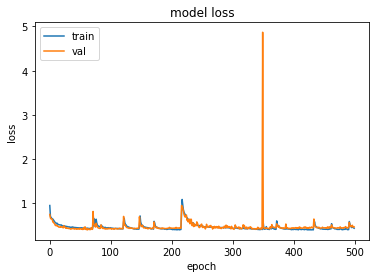

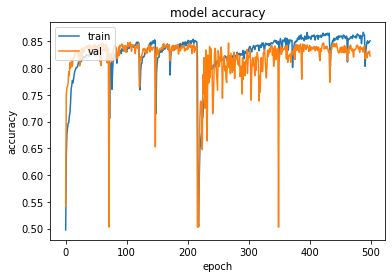

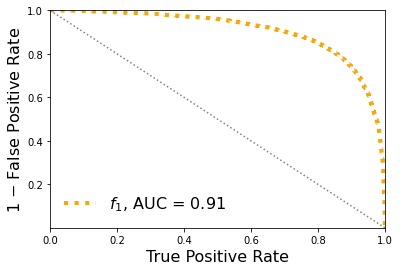

313/313 [==============================] - 2s 6ms/step - loss: 0.4647 - acc: 0.8279 - f1_m: 0.4618 - precision_m: 0.5005 - recall_m: 0.4296
Test ROC-AUC: 0.90504952
Test loss: 0.4647310674190521
Test accuracy: 0.8278999924659729
Test f1: 0.4617742598056793
Test precision: 0.5005325078964233
Test recall: 0.4296126067638397
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8333 - acc: 0.6175 - f1_m: 0.6328 - precision_m: 0.6210 - recall_m: 0.6726 - val_loss: 0.5412 - val_acc: 0.7938 - val_f1_m: 0.8006 - val_precision_m: 0.7647 - val_recall_m: 0.8456
Epoch 2/500
375/375 [==============================] - 23s 61ms/step - loss: 0.5853 - acc: 0.7711 - f1_m: 0.7725 - precision_m: 0.7665 - recall_m: 0.7909 - val_loss: 0.5289 - val_acc: 0.8055 - val_f1_m: 0.7993 - val_precision_m: 0.8140 - va

Epoch 31/500
375/375 [==============================] - 23s 60ms/step - loss: 0.5076 - acc: 0.8169 - f1_m: 0.8191 - precision_m: 0.8175 - recall_m: 0.8300 - val_loss: 0.4503 - val_acc: 0.8357 - val_f1_m: 0.8324 - val_precision_m: 0.8388 - val_recall_m: 0.8307
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4838 - acc: 0.8258 - f1_m: 0.8249 - precision_m: 0.8247 - recall_m: 0.8329 - val_loss: 0.4684 - val_acc: 0.8152 - val_f1_m: 0.8006 - val_precision_m: 0.8567 - val_recall_m: 0.7562
Epoch 33/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4872 - acc: 0.8233 - f1_m: 0.8238 - precision_m: 0.8177 - recall_m: 0.8395 - val_loss: 0.4732 - val_acc: 0.8255 - val_f1_m: 0.8150 - val_precision_m: 0.8534 - val_recall_m: 0.7843
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4791 - acc: 0.8293 - f1_m: 0.8308 - precision_m: 0.8223 - recall_m: 0.8466 - val_loss: 0.4656 - val_acc: 0.8378 - val_f1_m: 0.8401 - val_pre

375/375 [==============================] - 23s 61ms/step - loss: 0.4502 - acc: 0.8366 - f1_m: 0.8356 - precision_m: 0.8374 - recall_m: 0.8399 - val_loss: 0.4400 - val_acc: 0.8372 - val_f1_m: 0.8340 - val_precision_m: 0.8412 - val_recall_m: 0.8321
Epoch 94/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4931 - acc: 0.8224 - f1_m: 0.8176 - precision_m: 0.8305 - recall_m: 0.8201 - val_loss: 0.4701 - val_acc: 0.8117 - val_f1_m: 0.7889 - val_precision_m: 0.8823 - val_recall_m: 0.7178
Epoch 95/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4583 - acc: 0.8321 - f1_m: 0.8257 - precision_m: 0.8389 - recall_m: 0.8213 - val_loss: 0.4495 - val_acc: 0.8337 - val_f1_m: 0.8312 - val_precision_m: 0.8314 - val_recall_m: 0.8358
Epoch 96/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4639 - acc: 0.8359 - f1_m: 0.8333 - precision_m: 0.8401 - recall_m: 0.8354 - val_loss: 0.4397 - val_acc: 0.8450 - val_f1_m: 0.8426 - val_precision_m: 0.8

375/375 [==============================] - 22s 60ms/step - loss: 0.4645 - acc: 0.8305 - f1_m: 0.8276 - precision_m: 0.8260 - recall_m: 0.8385 - val_loss: 0.4239 - val_acc: 0.8363 - val_f1_m: 0.8291 - val_precision_m: 0.8540 - val_recall_m: 0.8100
Epoch 156/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4555 - acc: 0.8354 - f1_m: 0.8341 - precision_m: 0.8349 - recall_m: 0.8413 - val_loss: 0.4862 - val_acc: 0.8350 - val_f1_m: 0.8456 - val_precision_m: 0.7823 - val_recall_m: 0.9243
Epoch 157/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4587 - acc: 0.8336 - f1_m: 0.8342 - precision_m: 0.8333 - recall_m: 0.8431 - val_loss: 0.4377 - val_acc: 0.8267 - val_f1_m: 0.8151 - val_precision_m: 0.8621 - val_recall_m: 0.7777
Epoch 158/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4457 - acc: 0.8390 - f1_m: 0.8390 - precision_m: 0.8351 - recall_m: 0.8502 - val_loss: 0.4489 - val_acc: 0.8405 - val_f1_m: 0.8448 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4515 - acc: 0.8417 - f1_m: 0.8419 - precision_m: 0.8335 - recall_m: 0.8580 - val_loss: 0.4383 - val_acc: 0.8453 - val_f1_m: 0.8472 - val_precision_m: 0.8253 - val_recall_m: 0.8748
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4729 - acc: 0.8264 - f1_m: 0.8229 - precision_m: 0.8219 - recall_m: 0.8381 - val_loss: 0.4234 - val_acc: 0.8467 - val_f1_m: 0.8479 - val_precision_m: 0.8285 - val_recall_m: 0.8728
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4422 - acc: 0.8460 - f1_m: 0.8450 - precision_m: 0.8371 - recall_m: 0.8610 - val_loss: 0.4298 - val_acc: 0.8388 - val_f1_m: 0.8347 - val_precision_m: 0.8439 - val_recall_m: 0.8299
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4639 - acc: 0.8333 - f1_m: 0.8299 - precision_m: 0.8396 - recall_m: 0.8310 - val_loss: 0.4348 - val_acc: 0.8457 - val_f1_m: 0.8527 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4588 - acc: 0.8391 - f1_m: 0.8376 - precision_m: 0.8355 - recall_m: 0.8496 - val_loss: 0.4263 - val_acc: 0.8477 - val_f1_m: 0.8483 - val_precision_m: 0.8328 - val_recall_m: 0.8691
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4525 - acc: 0.8379 - f1_m: 0.8409 - precision_m: 0.8239 - recall_m: 0.8661 - val_loss: 0.4878 - val_acc: 0.8452 - val_f1_m: 0.8531 - val_precision_m: 0.8003 - val_recall_m: 0.9175
Epoch 281/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4587 - acc: 0.8350 - f1_m: 0.8376 - precision_m: 0.8286 - recall_m: 0.8567 - val_loss: 0.4378 - val_acc: 0.8422 - val_f1_m: 0.8355 - val_precision_m: 0.8606 - val_recall_m: 0.8157
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4765 - acc: 0.8259 - f1_m: 0.8190 - precision_m: 0.8198 - recall_m: 0.8310 - val_loss: 0.5298 - val_acc: 0.7433 - val_f1_m: 0.6678 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4344 - acc: 0.8431 - f1_m: 0.8435 - precision_m: 0.8337 - recall_m: 0.8601 - val_loss: 0.4683 - val_acc: 0.8267 - val_f1_m: 0.8440 - val_precision_m: 0.7583 - val_recall_m: 0.9570
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4575 - acc: 0.8314 - f1_m: 0.8291 - precision_m: 0.8253 - recall_m: 0.8449 - val_loss: 0.4707 - val_acc: 0.8372 - val_f1_m: 0.8471 - val_precision_m: 0.7892 - val_recall_m: 0.9184
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4764 - acc: 0.8288 - f1_m: 0.8324 - precision_m: 0.8180 - recall_m: 0.8569 - val_loss: 0.4207 - val_acc: 0.8513 - val_f1_m: 0.8557 - val_precision_m: 0.8193 - val_recall_m: 0.8996
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4428 - acc: 0.8405 - f1_m: 0.8380 - precision_m: 0.8312 - recall_m: 0.8537 - val_loss: 0.5702 - val_acc: 0.7867 - val_f1_m: 0.8171 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4505 - acc: 0.8323 - f1_m: 0.8340 - precision_m: 0.8273 - recall_m: 0.8487 - val_loss: 0.4167 - val_acc: 0.8497 - val_f1_m: 0.8485 - val_precision_m: 0.8435 - val_recall_m: 0.8580
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4494 - acc: 0.8401 - f1_m: 0.8402 - precision_m: 0.8329 - recall_m: 0.8558 - val_loss: 0.4276 - val_acc: 0.8478 - val_f1_m: 0.8524 - val_precision_m: 0.8169 - val_recall_m: 0.8955
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4567 - acc: 0.8338 - f1_m: 0.8333 - precision_m: 0.8236 - recall_m: 0.8518 - val_loss: 0.4769 - val_acc: 0.8467 - val_f1_m: 0.8506 - val_precision_m: 0.8220 - val_recall_m: 0.8858
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4848 - acc: 0.8307 - f1_m: 0.8322 - precision_m: 0.8210 - recall_m: 0.8543 - val_loss: 0.4299 - val_acc: 0.8422 - val_f1_m: 0.8330 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4431 - acc: 0.8397 - f1_m: 0.8399 - precision_m: 0.8345 - recall_m: 0.8530 - val_loss: 0.4334 - val_acc: 0.8342 - val_f1_m: 0.8229 - val_precision_m: 0.8715 - val_recall_m: 0.7850
Epoch 466/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4473 - acc: 0.8392 - f1_m: 0.8361 - precision_m: 0.8330 - recall_m: 0.8468 - val_loss: 0.4918 - val_acc: 0.8330 - val_f1_m: 0.8361 - val_precision_m: 0.8089 - val_recall_m: 0.8700
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.5041 - acc: 0.8232 - f1_m: 0.8229 - precision_m: 0.8157 - recall_m: 0.8443 - val_loss: 0.5508 - val_acc: 0.7760 - val_f1_m: 0.7242 - val_precision_m: 0.9233 - val_recall_m: 0.6014
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4758 - acc: 0.8349 - f1_m: 0.8338 - precision_m: 0.8311 - recall_m: 0.8503 - val_loss: 0.5012 - val_acc: 0.8153 - val_f1_m: 0.8369 - val_precision_m: 

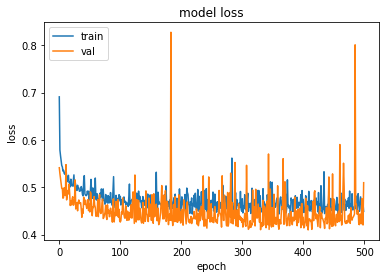

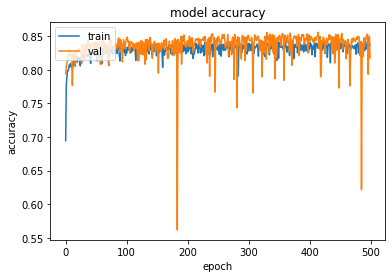

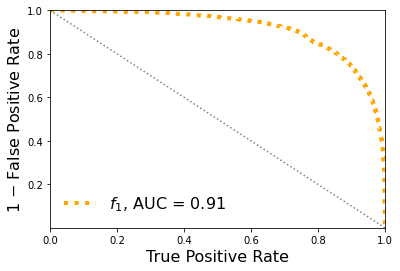

313/313 [==============================] - 2s 6ms/step - loss: 0.5138 - acc: 0.8083 - f1_m: 0.4803 - precision_m: 0.4997 - recall_m: 0.4634
Test ROC-AUC: 0.9136858000000001
Test loss: 0.513770341873169
Test accuracy: 0.8083000183105469
Test f1: 0.4802936017513275
Test precision: 0.4996804893016815
Test recall: 0.46335864067077637
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 117ms/step - loss: 1.3346 - acc: 0.5505 - f1_m: 0.5016 - precision_m: 0.5640 - recall_m: 0.4799 - val_loss: 0.6038 - val_acc: 0.7727 - val_f1_m: 0.7828 - val_precision_m: 0.7435 - val_recall_m: 0.8294
Epoch 2/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6328 - acc: 0.7360 - f1_m: 0.7321 - precision_m: 0.7417 - recall_m: 0.7318 - val_loss: 0.5486 - val_acc: 0.7907 - val_f1_m: 0.7733 - val_precision_m: 

188/188 [==============================] - 21s 114ms/step - loss: 0.4838 - acc: 0.8318 - f1_m: 0.8315 - precision_m: 0.8368 - recall_m: 0.8341 - val_loss: 0.4336 - val_acc: 0.8437 - val_f1_m: 0.8447 - val_precision_m: 0.8333 - val_recall_m: 0.8588
Epoch 62/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4477 - acc: 0.8447 - f1_m: 0.8417 - precision_m: 0.8521 - recall_m: 0.8364 - val_loss: 0.4405 - val_acc: 0.8330 - val_f1_m: 0.8262 - val_precision_m: 0.8534 - val_recall_m: 0.8037
Epoch 63/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4536 - acc: 0.8433 - f1_m: 0.8418 - precision_m: 0.8484 - recall_m: 0.8414 - val_loss: 0.4379 - val_acc: 0.8398 - val_f1_m: 0.8394 - val_precision_m: 0.8352 - val_recall_m: 0.8463
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4568 - acc: 0.8372 - f1_m: 0.8348 - precision_m: 0.8513 - recall_m: 0.8271 - val_loss: 0.4593 - val_acc: 0.8115 - val_f1_m: 0.7872 - val_precision_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4809 - acc: 0.8286 - f1_m: 0.8222 - precision_m: 0.8391 - recall_m: 0.8191 - val_loss: 0.4729 - val_acc: 0.8393 - val_f1_m: 0.8515 - val_precision_m: 0.7854 - val_recall_m: 0.9324
Epoch 124/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4454 - acc: 0.8420 - f1_m: 0.8417 - precision_m: 0.8500 - recall_m: 0.8409 - val_loss: 0.4514 - val_acc: 0.8200 - val_f1_m: 0.8014 - val_precision_m: 0.8852 - val_recall_m: 0.7353
Epoch 125/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4201 - acc: 0.8541 - f1_m: 0.8517 - precision_m: 0.8579 - recall_m: 0.8502 - val_loss: 0.4509 - val_acc: 0.8412 - val_f1_m: 0.8491 - val_precision_m: 0.8026 - val_recall_m: 0.9042
Epoch 126/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4348 - acc: 0.8476 - f1_m: 0.8459 - precision_m: 0.8477 - recall_m: 0.8503 - val_loss: 0.4144 - val_acc: 0.8503 - val_f1_m: 0.8529 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4213 - acc: 0.8542 - f1_m: 0.8544 - precision_m: 0.8537 - recall_m: 0.8599 - val_loss: 0.4168 - val_acc: 0.8385 - val_f1_m: 0.8289 - val_precision_m: 0.8727 - val_recall_m: 0.7919
Epoch 186/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4201 - acc: 0.8501 - f1_m: 0.8477 - precision_m: 0.8542 - recall_m: 0.8462 - val_loss: 0.4101 - val_acc: 0.8527 - val_f1_m: 0.8552 - val_precision_m: 0.8354 - val_recall_m: 0.8790
Epoch 187/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4214 - acc: 0.8518 - f1_m: 0.8522 - precision_m: 0.8482 - recall_m: 0.8613 - val_loss: 0.4190 - val_acc: 0.8458 - val_f1_m: 0.8474 - val_precision_m: 0.8317 - val_recall_m: 0.8662
Epoch 188/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4303 - acc: 0.8467 - f1_m: 0.8449 - precision_m: 0.8460 - recall_m: 0.8498 - val_loss: 0.4346 - val_acc: 0.8317 - val_f1_m: 0.8174 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4788 - acc: 0.8333 - f1_m: 0.8294 - precision_m: 0.8413 - recall_m: 0.8295 - val_loss: 0.4206 - val_acc: 0.8360 - val_f1_m: 0.8269 - val_precision_m: 0.8684 - val_recall_m: 0.7919
Epoch 248/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4149 - acc: 0.8549 - f1_m: 0.8546 - precision_m: 0.8563 - recall_m: 0.8567 - val_loss: 0.4115 - val_acc: 0.8550 - val_f1_m: 0.8573 - val_precision_m: 0.8387 - val_recall_m: 0.8801
Epoch 249/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4220 - acc: 0.8516 - f1_m: 0.8507 - precision_m: 0.8520 - recall_m: 0.8531 - val_loss: 0.4249 - val_acc: 0.8368 - val_f1_m: 0.8268 - val_precision_m: 0.8731 - val_recall_m: 0.7880
Epoch 250/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4293 - acc: 0.8472 - f1_m: 0.8455 - precision_m: 0.8509 - recall_m: 0.8451 - val_loss: 0.4350 - val_acc: 0.8373 - val_f1_m: 0.8267 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4239 - acc: 0.8559 - f1_m: 0.8555 - precision_m: 0.8566 - recall_m: 0.8600 - val_loss: 0.4075 - val_acc: 0.8547 - val_f1_m: 0.8550 - val_precision_m: 0.8470 - val_recall_m: 0.8659
Epoch 310/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4129 - acc: 0.8588 - f1_m: 0.8583 - precision_m: 0.8521 - recall_m: 0.8685 - val_loss: 0.4035 - val_acc: 0.8545 - val_f1_m: 0.8557 - val_precision_m: 0.8431 - val_recall_m: 0.8711
Epoch 311/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4206 - acc: 0.8507 - f1_m: 0.8501 - precision_m: 0.8479 - recall_m: 0.8583 - val_loss: 0.4364 - val_acc: 0.8498 - val_f1_m: 0.8538 - val_precision_m: 0.8264 - val_recall_m: 0.8854
Epoch 312/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4451 - acc: 0.8422 - f1_m: 0.8442 - precision_m: 0.8381 - recall_m: 0.8562 - val_loss: 0.4205 - val_acc: 0.8382 - val_f1_m: 0.8309 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4459 - acc: 0.8502 - f1_m: 0.8474 - precision_m: 0.8466 - recall_m: 0.8532 - val_loss: 0.4083 - val_acc: 0.8482 - val_f1_m: 0.8492 - val_precision_m: 0.8365 - val_recall_m: 0.8650
Epoch 372/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4209 - acc: 0.8502 - f1_m: 0.8523 - precision_m: 0.8469 - recall_m: 0.8614 - val_loss: 0.4212 - val_acc: 0.8477 - val_f1_m: 0.8521 - val_precision_m: 0.8206 - val_recall_m: 0.8885
Epoch 373/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4267 - acc: 0.8510 - f1_m: 0.8534 - precision_m: 0.8450 - recall_m: 0.8661 - val_loss: 0.4310 - val_acc: 0.8457 - val_f1_m: 0.8433 - val_precision_m: 0.8508 - val_recall_m: 0.8389
Epoch 374/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4544 - acc: 0.8455 - f1_m: 0.8423 - precision_m: 0.8441 - recall_m: 0.8476 - val_loss: 0.4065 - val_acc: 0.8550 - val_f1_m: 0.8580 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4307 - acc: 0.8487 - f1_m: 0.8481 - precision_m: 0.8519 - recall_m: 0.8512 - val_loss: 0.4392 - val_acc: 0.8333 - val_f1_m: 0.8173 - val_precision_m: 0.8924 - val_recall_m: 0.7564
Epoch 434/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4217 - acc: 0.8495 - f1_m: 0.8501 - precision_m: 0.8481 - recall_m: 0.8569 - val_loss: 0.4048 - val_acc: 0.8520 - val_f1_m: 0.8523 - val_precision_m: 0.8436 - val_recall_m: 0.8640
Epoch 435/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4135 - acc: 0.8542 - f1_m: 0.8547 - precision_m: 0.8514 - recall_m: 0.8617 - val_loss: 0.4039 - val_acc: 0.8498 - val_f1_m: 0.8466 - val_precision_m: 0.8551 - val_recall_m: 0.8408
Epoch 436/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4359 - acc: 0.8457 - f1_m: 0.8455 - precision_m: 0.8464 - recall_m: 0.8520 - val_loss: 0.4142 - val_acc: 0.8535 - val_f1_m: 0.8548 - val_precision

188/188 [==============================] - 22s 118ms/step - loss: 0.4659 - acc: 0.8347 - f1_m: 0.8307 - precision_m: 0.8304 - recall_m: 0.8460 - val_loss: 0.4134 - val_acc: 0.8513 - val_f1_m: 0.8521 - val_precision_m: 0.8410 - val_recall_m: 0.8665
Epoch 496/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4221 - acc: 0.8507 - f1_m: 0.8497 - precision_m: 0.8458 - recall_m: 0.8596 - val_loss: 0.4067 - val_acc: 0.8530 - val_f1_m: 0.8520 - val_precision_m: 0.8506 - val_recall_m: 0.8562
Epoch 497/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4148 - acc: 0.8588 - f1_m: 0.8592 - precision_m: 0.8506 - recall_m: 0.8726 - val_loss: 0.4001 - val_acc: 0.8557 - val_f1_m: 0.8583 - val_precision_m: 0.8360 - val_recall_m: 0.8847
Epoch 498/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4153 - acc: 0.8565 - f1_m: 0.8544 - precision_m: 0.8523 - recall_m: 0.8644 - val_loss: 0.4596 - val_acc: 0.8420 - val_f1_m: 0.8513 - val_precision

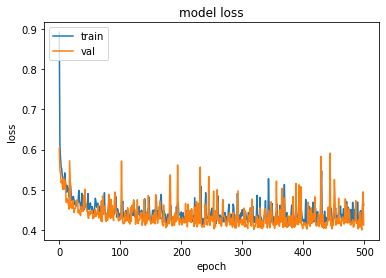

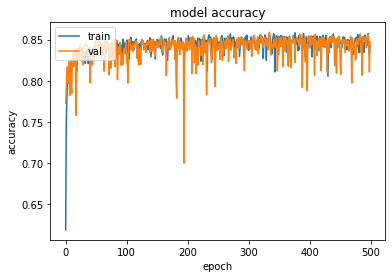

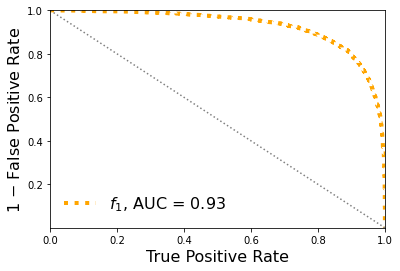

313/313 [==============================] - 2s 6ms/step - loss: 0.4226 - acc: 0.8497 - f1_m: 0.4553 - precision_m: 0.5002 - recall_m: 0.4190
Test ROC-AUC: 0.9277284800000001
Test loss: 0.4226359724998474
Test accuracy: 0.8496999740600586
Test f1: 0.4553033113479614
Test precision: 0.5001775026321411
Test recall: 0.41902956366539
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 251ms/step - loss: 1.1358 - acc: 0.5374 - f1_m: 0.5107 - precision_m: 0.5380 - recall_m: 0.5438 - val_loss: 0.6058 - val_acc: 0.7548 - val_f1_m: 0.7770 - val_precision_m: 0.7043 - val_recall_m: 0.8681
Epoch 2/500
94/94 [==============================] - 23s 241ms/step - loss: 0.6339 - acc: 0.7350 - f1_m: 0.7450 - precision_m: 0.7116 - recall_m: 0.7880 - val_loss: 0.5459 - val_acc: 0.7753 - val_f1_m: 0.8022 - val_precision_m: 0.7086

Epoch 31/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4691 - acc: 0.8361 - f1_m: 0.8365 - precision_m: 0.8350 - recall_m: 0.8476 - val_loss: 0.4599 - val_acc: 0.8408 - val_f1_m: 0.8501 - val_precision_m: 0.7938 - val_recall_m: 0.9165
Epoch 32/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4496 - acc: 0.8448 - f1_m: 0.8464 - precision_m: 0.8293 - recall_m: 0.8680 - val_loss: 0.4471 - val_acc: 0.8412 - val_f1_m: 0.8454 - val_precision_m: 0.8155 - val_recall_m: 0.8792
Epoch 33/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4389 - acc: 0.8504 - f1_m: 0.8516 - precision_m: 0.8363 - recall_m: 0.8714 - val_loss: 0.4408 - val_acc: 0.8485 - val_f1_m: 0.8495 - val_precision_m: 0.8305 - val_recall_m: 0.8710
Epoch 34/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4380 - acc: 0.8496 - f1_m: 0.8468 - precision_m: 0.8421 - recall_m: 0.8575 - val_loss: 0.4659 - val_acc: 0.8313 - val_f1_m: 0.8181 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4299 - acc: 0.8498 - f1_m: 0.8537 - precision_m: 0.8403 - recall_m: 0.8722 - val_loss: 0.4357 - val_acc: 0.8457 - val_f1_m: 0.8505 - val_precision_m: 0.8170 - val_recall_m: 0.8884
Epoch 64/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4202 - acc: 0.8590 - f1_m: 0.8615 - precision_m: 0.8465 - recall_m: 0.8808 - val_loss: 0.4374 - val_acc: 0.8487 - val_f1_m: 0.8536 - val_precision_m: 0.8157 - val_recall_m: 0.8966
Epoch 65/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4606 - acc: 0.8336 - f1_m: 0.8388 - precision_m: 0.8228 - recall_m: 0.8677 - val_loss: 0.4456 - val_acc: 0.8462 - val_f1_m: 0.8475 - val_precision_m: 0.8316 - val_recall_m: 0.8656
Epoch 66/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4394 - acc: 0.8501 - f1_m: 0.8528 - precision_m: 0.8400 - recall_m: 0.8691 - val_loss: 0.4400 - val_acc: 0.8413 - val_f1_m: 0.8493 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4030 - acc: 0.8624 - f1_m: 0.8660 - precision_m: 0.8421 - recall_m: 0.8953 - val_loss: 0.4784 - val_acc: 0.8213 - val_f1_m: 0.8410 - val_precision_m: 0.7488 - val_recall_m: 0.9602
Epoch 96/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4110 - acc: 0.8614 - f1_m: 0.8662 - precision_m: 0.8413 - recall_m: 0.8963 - val_loss: 0.4549 - val_acc: 0.8423 - val_f1_m: 0.8385 - val_precision_m: 0.8489 - val_recall_m: 0.8298
Epoch 97/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4222 - acc: 0.8588 - f1_m: 0.8612 - precision_m: 0.8407 - recall_m: 0.8871 - val_loss: 0.4440 - val_acc: 0.8465 - val_f1_m: 0.8545 - val_precision_m: 0.8059 - val_recall_m: 0.9109
Epoch 98/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4046 - acc: 0.8662 - f1_m: 0.8681 - precision_m: 0.8510 - recall_m: 0.8897 - val_loss: 0.4463 - val_acc: 0.8495 - val_f1_m: 0.8548 - val_precisi

94/94 [==============================] - 22s 239ms/step - loss: 0.5031 - acc: 0.8140 - f1_m: 0.8211 - precision_m: 0.7952 - recall_m: 0.8557 - val_loss: 0.4478 - val_acc: 0.8353 - val_f1_m: 0.8448 - val_precision_m: 0.7865 - val_recall_m: 0.9140
Epoch 158/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4907 - acc: 0.8202 - f1_m: 0.8268 - precision_m: 0.7976 - recall_m: 0.8626 - val_loss: 0.4717 - val_acc: 0.8202 - val_f1_m: 0.8348 - val_precision_m: 0.7636 - val_recall_m: 0.9223
Epoch 159/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4958 - acc: 0.8191 - f1_m: 0.8281 - precision_m: 0.7990 - recall_m: 0.8654 - val_loss: 0.4424 - val_acc: 0.8423 - val_f1_m: 0.8473 - val_precision_m: 0.8141 - val_recall_m: 0.8850
Epoch 160/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4584 - acc: 0.8342 - f1_m: 0.8393 - precision_m: 0.8191 - recall_m: 0.8644 - val_loss: 0.4420 - val_acc: 0.8395 - val_f1_m: 0.8417 - val_precision_m: 0.82

94/94 [==============================] - 22s 235ms/step - loss: 0.3936 - acc: 0.8707 - f1_m: 0.8696 - precision_m: 0.8669 - recall_m: 0.8758 - val_loss: 0.4629 - val_acc: 0.8445 - val_f1_m: 0.8520 - val_precision_m: 0.7988 - val_recall_m: 0.9142
Epoch 220/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4093 - acc: 0.8661 - f1_m: 0.8667 - precision_m: 0.8598 - recall_m: 0.8771 - val_loss: 0.4587 - val_acc: 0.8403 - val_f1_m: 0.8517 - val_precision_m: 0.7864 - val_recall_m: 0.9304
Epoch 221/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4440 - acc: 0.8499 - f1_m: 0.8525 - precision_m: 0.8353 - recall_m: 0.8762 - val_loss: 0.4398 - val_acc: 0.8442 - val_f1_m: 0.8402 - val_precision_m: 0.8507 - val_recall_m: 0.8316
Epoch 222/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4150 - acc: 0.8651 - f1_m: 0.8653 - precision_m: 0.8549 - recall_m: 0.8790 - val_loss: 0.4302 - val_acc: 0.8480 - val_f1_m: 0.8455 - val_precision_m: 0.85

94/94 [==============================] - 22s 235ms/step - loss: 0.4116 - acc: 0.8630 - f1_m: 0.8638 - precision_m: 0.8634 - recall_m: 0.8682 - val_loss: 0.4493 - val_acc: 0.8418 - val_f1_m: 0.8481 - val_precision_m: 0.8038 - val_recall_m: 0.8987
Epoch 282/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4026 - acc: 0.8728 - f1_m: 0.8745 - precision_m: 0.8687 - recall_m: 0.8827 - val_loss: 0.4450 - val_acc: 0.8387 - val_f1_m: 0.8315 - val_precision_m: 0.8562 - val_recall_m: 0.8098
Epoch 283/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4117 - acc: 0.8652 - f1_m: 0.8652 - precision_m: 0.8630 - recall_m: 0.8708 - val_loss: 0.4436 - val_acc: 0.8417 - val_f1_m: 0.8392 - val_precision_m: 0.8391 - val_recall_m: 0.8409
Epoch 284/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4029 - acc: 0.8687 - f1_m: 0.8687 - precision_m: 0.8627 - recall_m: 0.8772 - val_loss: 0.4377 - val_acc: 0.8383 - val_f1_m: 0.8314 - val_precision_m: 0.84

94/94 [==============================] - 22s 235ms/step - loss: 0.4364 - acc: 0.8527 - f1_m: 0.8541 - precision_m: 0.8465 - recall_m: 0.8669 - val_loss: 0.4849 - val_acc: 0.8227 - val_f1_m: 0.8423 - val_precision_m: 0.7525 - val_recall_m: 0.9579
Epoch 344/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4369 - acc: 0.8565 - f1_m: 0.8575 - precision_m: 0.8395 - recall_m: 0.8818 - val_loss: 0.4290 - val_acc: 0.8495 - val_f1_m: 0.8464 - val_precision_m: 0.8533 - val_recall_m: 0.8411
Epoch 345/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4061 - acc: 0.8661 - f1_m: 0.8688 - precision_m: 0.8521 - recall_m: 0.8892 - val_loss: 0.4272 - val_acc: 0.8500 - val_f1_m: 0.8472 - val_precision_m: 0.8475 - val_recall_m: 0.8485
Epoch 346/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3874 - acc: 0.8745 - f1_m: 0.8765 - precision_m: 0.8677 - recall_m: 0.8873 - val_loss: 0.4228 - val_acc: 0.8500 - val_f1_m: 0.8454 - val_precision_m: 0.85

94/94 [==============================] - 22s 236ms/step - loss: 0.4457 - acc: 0.8561 - f1_m: 0.8574 - precision_m: 0.8389 - recall_m: 0.8808 - val_loss: 0.4329 - val_acc: 0.8498 - val_f1_m: 0.8569 - val_precision_m: 0.8070 - val_recall_m: 0.9149
Epoch 406/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3997 - acc: 0.8714 - f1_m: 0.8745 - precision_m: 0.8623 - recall_m: 0.8902 - val_loss: 0.4195 - val_acc: 0.8478 - val_f1_m: 0.8457 - val_precision_m: 0.8415 - val_recall_m: 0.8512
Epoch 407/500
94/94 [==============================] - 22s 235ms/step - loss: 0.3777 - acc: 0.8798 - f1_m: 0.8808 - precision_m: 0.8763 - recall_m: 0.8864 - val_loss: 0.4232 - val_acc: 0.8425 - val_f1_m: 0.8354 - val_precision_m: 0.8583 - val_recall_m: 0.8150
Epoch 408/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3778 - acc: 0.8786 - f1_m: 0.8793 - precision_m: 0.8765 - recall_m: 0.8847 - val_loss: 0.4224 - val_acc: 0.8530 - val_f1_m: 0.8559 - val_precision_m: 0.82

94/94 [==============================] - 22s 236ms/step - loss: 0.3901 - acc: 0.8734 - f1_m: 0.8736 - precision_m: 0.8752 - recall_m: 0.8741 - val_loss: 0.4100 - val_acc: 0.8545 - val_f1_m: 0.8552 - val_precision_m: 0.8400 - val_recall_m: 0.8726
Epoch 468/500
94/94 [==============================] - 22s 235ms/step - loss: 0.3941 - acc: 0.8710 - f1_m: 0.8730 - precision_m: 0.8690 - recall_m: 0.8803 - val_loss: 1.4902 - val_acc: 0.5230 - val_f1_m: 0.0786 - val_precision_m: 0.9792 - val_recall_m: 0.0412
Epoch 469/500
94/94 [==============================] - 22s 233ms/step - loss: 0.6794 - acc: 0.7425 - f1_m: 0.7256 - precision_m: 0.7534 - recall_m: 0.7670 - val_loss: 0.4974 - val_acc: 0.8288 - val_f1_m: 0.8461 - val_precision_m: 0.7610 - val_recall_m: 0.9543
Epoch 470/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4695 - acc: 0.8466 - f1_m: 0.8516 - precision_m: 0.8228 - recall_m: 0.8871 - val_loss: 0.4326 - val_acc: 0.8512 - val_f1_m: 0.8586 - val_precision_m: 0.80

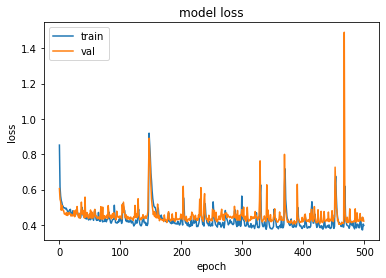

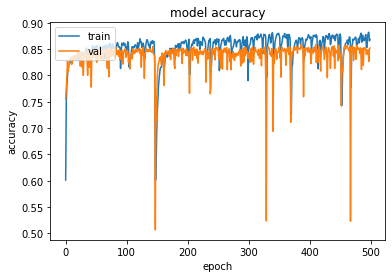

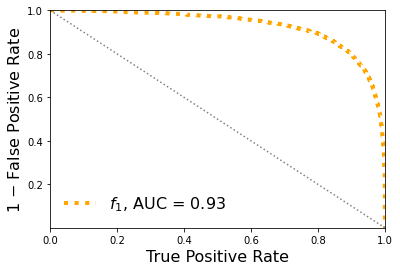

313/313 [==============================] - 2s 6ms/step - loss: 0.4285 - acc: 0.8497 - f1_m: 0.4532 - precision_m: 0.5004 - recall_m: 0.4153
Test ROC-AUC: 0.9280843199999999
Test loss: 0.42847687005996704
Test accuracy: 0.8496999740600586
Test f1: 0.45323455333709717
Test precision: 0.5003993511199951
Test recall: 0.415335476398468
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8904 - acc: 0.4994 - f1_m: 0.5853 - precision_m: 0.4898 - recall_m: 0.7732 - val_loss: 0.7355 - val_acc: 0.4972 - val_f1_m: 0.6619 - val_precision_m: 0.4972 - val_recall_m: 1.0000
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.7040 - acc: 0.5841 - f1_m: 0.6376 - precision_m: 0.5890 - recall_m: 0.7617 - val_loss: 0.5595 - val_acc: 0.7615 - val_f1_m: 0.7347 - val_precision_m: 0.

Epoch 31/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4819 - acc: 0.8167 - f1_m: 0.8176 - precision_m: 0.7944 - recall_m: 0.8507 - val_loss: 0.4562 - val_acc: 0.8298 - val_f1_m: 0.8359 - val_precision_m: 0.7977 - val_recall_m: 0.8828
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4849 - acc: 0.8146 - f1_m: 0.8209 - precision_m: 0.7950 - recall_m: 0.8574 - val_loss: 0.4441 - val_acc: 0.8208 - val_f1_m: 0.8134 - val_precision_m: 0.8355 - val_recall_m: 0.7972
Epoch 33/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4768 - acc: 0.8134 - f1_m: 0.8183 - precision_m: 0.7903 - recall_m: 0.8564 - val_loss: 0.4383 - val_acc: 0.8368 - val_f1_m: 0.8427 - val_precision_m: 0.8016 - val_recall_m: 0.8930
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4725 - acc: 0.8151 - f1_m: 0.8187 - precision_m: 0.7890 - recall_m: 0.8603 - val_loss: 0.4419 - val_acc: 0.8325 - val_f1_m: 0.8430 - val_pre

375/375 [==============================] - 22s 60ms/step - loss: 0.4756 - acc: 0.8226 - f1_m: 0.8283 - precision_m: 0.7977 - recall_m: 0.8703 - val_loss: 0.4424 - val_acc: 0.8347 - val_f1_m: 0.8283 - val_precision_m: 0.8477 - val_recall_m: 0.8148
Epoch 94/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4495 - acc: 0.8342 - f1_m: 0.8386 - precision_m: 0.8099 - recall_m: 0.8752 - val_loss: 0.4491 - val_acc: 0.8390 - val_f1_m: 0.8467 - val_precision_m: 0.7995 - val_recall_m: 0.9048
Epoch 95/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4570 - acc: 0.8298 - f1_m: 0.8358 - precision_m: 0.8066 - recall_m: 0.8740 - val_loss: 0.4478 - val_acc: 0.8272 - val_f1_m: 0.8277 - val_precision_m: 0.8137 - val_recall_m: 0.8482
Epoch 96/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4716 - acc: 0.8291 - f1_m: 0.8336 - precision_m: 0.8051 - recall_m: 0.8709 - val_loss: 0.4451 - val_acc: 0.8310 - val_f1_m: 0.8400 - val_precision_m: 0.7

375/375 [==============================] - 23s 60ms/step - loss: 0.4418 - acc: 0.8395 - f1_m: 0.8451 - precision_m: 0.8166 - recall_m: 0.8818 - val_loss: 0.4283 - val_acc: 0.8405 - val_f1_m: 0.8421 - val_precision_m: 0.8222 - val_recall_m: 0.8680
Epoch 156/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4496 - acc: 0.8327 - f1_m: 0.8370 - precision_m: 0.8072 - recall_m: 0.8748 - val_loss: 0.4212 - val_acc: 0.8457 - val_f1_m: 0.8480 - val_precision_m: 0.8235 - val_recall_m: 0.8789
Epoch 157/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4501 - acc: 0.8321 - f1_m: 0.8372 - precision_m: 0.8092 - recall_m: 0.8749 - val_loss: 0.4633 - val_acc: 0.8262 - val_f1_m: 0.8406 - val_precision_m: 0.7668 - val_recall_m: 0.9360
Epoch 158/500
375/375 [==============================] - 22s 60ms/step - loss: 0.5046 - acc: 0.8258 - f1_m: 0.8270 - precision_m: 0.7984 - recall_m: 0.8675 - val_loss: 0.4453 - val_acc: 0.8402 - val_f1_m: 0.8482 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4468 - acc: 0.8362 - f1_m: 0.8401 - precision_m: 0.8093 - recall_m: 0.8799 - val_loss: 0.4254 - val_acc: 0.8407 - val_f1_m: 0.8476 - val_precision_m: 0.8001 - val_recall_m: 0.9060
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4643 - acc: 0.8319 - f1_m: 0.8363 - precision_m: 0.8097 - recall_m: 0.8762 - val_loss: 0.4364 - val_acc: 0.8467 - val_f1_m: 0.8480 - val_precision_m: 0.8310 - val_recall_m: 0.8710
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4585 - acc: 0.8319 - f1_m: 0.8384 - precision_m: 0.8064 - recall_m: 0.8795 - val_loss: 0.4127 - val_acc: 0.8460 - val_f1_m: 0.8461 - val_precision_m: 0.8327 - val_recall_m: 0.8647
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4353 - acc: 0.8361 - f1_m: 0.8396 - precision_m: 0.8131 - recall_m: 0.8745 - val_loss: 0.4042 - val_acc: 0.8527 - val_f1_m: 0.8524 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4262 - acc: 0.8432 - f1_m: 0.8497 - precision_m: 0.8179 - recall_m: 0.8892 - val_loss: 0.4100 - val_acc: 0.8495 - val_f1_m: 0.8525 - val_precision_m: 0.8244 - val_recall_m: 0.8876
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4452 - acc: 0.8340 - f1_m: 0.8371 - precision_m: 0.8088 - recall_m: 0.8739 - val_loss: 0.4038 - val_acc: 0.8482 - val_f1_m: 0.8479 - val_precision_m: 0.8412 - val_recall_m: 0.8593
Epoch 281/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4245 - acc: 0.8415 - f1_m: 0.8471 - precision_m: 0.8207 - recall_m: 0.8810 - val_loss: 0.4497 - val_acc: 0.8298 - val_f1_m: 0.8459 - val_precision_m: 0.7651 - val_recall_m: 0.9507
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4305 - acc: 0.8415 - f1_m: 0.8479 - precision_m: 0.8172 - recall_m: 0.8874 - val_loss: 0.4163 - val_acc: 0.8512 - val_f1_m: 0.8547 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4329 - acc: 0.8395 - f1_m: 0.8441 - precision_m: 0.8161 - recall_m: 0.8805 - val_loss: 0.4182 - val_acc: 0.8480 - val_f1_m: 0.8430 - val_precision_m: 0.8595 - val_recall_m: 0.8318
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4594 - acc: 0.8319 - f1_m: 0.8379 - precision_m: 0.8102 - recall_m: 0.8771 - val_loss: 0.4403 - val_acc: 0.8438 - val_f1_m: 0.8487 - val_precision_m: 0.8142 - val_recall_m: 0.8908
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4513 - acc: 0.8342 - f1_m: 0.8398 - precision_m: 0.8081 - recall_m: 0.8806 - val_loss: 0.4037 - val_acc: 0.8497 - val_f1_m: 0.8563 - val_precision_m: 0.8126 - val_recall_m: 0.9102
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4297 - acc: 0.8398 - f1_m: 0.8437 - precision_m: 0.8139 - recall_m: 0.8825 - val_loss: 0.4158 - val_acc: 0.8428 - val_f1_m: 0.8551 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4357 - acc: 0.8341 - f1_m: 0.8404 - precision_m: 0.8116 - recall_m: 0.8781 - val_loss: 0.4026 - val_acc: 0.8465 - val_f1_m: 0.8435 - val_precision_m: 0.8493 - val_recall_m: 0.8422
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4441 - acc: 0.8398 - f1_m: 0.8404 - precision_m: 0.8193 - recall_m: 0.8732 - val_loss: 0.4180 - val_acc: 0.8508 - val_f1_m: 0.8498 - val_precision_m: 0.8465 - val_recall_m: 0.8577
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4672 - acc: 0.8244 - f1_m: 0.8278 - precision_m: 0.7991 - recall_m: 0.8663 - val_loss: 0.4393 - val_acc: 0.8510 - val_f1_m: 0.8521 - val_precision_m: 0.8336 - val_recall_m: 0.8765
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4682 - acc: 0.8290 - f1_m: 0.8358 - precision_m: 0.8019 - recall_m: 0.8805 - val_loss: 0.4035 - val_acc: 0.8522 - val_f1_m: 0.8510 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4551 - acc: 0.8310 - f1_m: 0.8370 - precision_m: 0.8049 - recall_m: 0.8808 - val_loss: 0.4422 - val_acc: 0.8448 - val_f1_m: 0.8542 - val_precision_m: 0.7945 - val_recall_m: 0.9281
Epoch 466/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4524 - acc: 0.8328 - f1_m: 0.8387 - precision_m: 0.8022 - recall_m: 0.8867 - val_loss: 0.4195 - val_acc: 0.8473 - val_f1_m: 0.8573 - val_precision_m: 0.7945 - val_recall_m: 0.9357
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4428 - acc: 0.8353 - f1_m: 0.8410 - precision_m: 0.8078 - recall_m: 0.8842 - val_loss: 0.4348 - val_acc: 0.8412 - val_f1_m: 0.8315 - val_precision_m: 0.8718 - val_recall_m: 0.7992
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4510 - acc: 0.8331 - f1_m: 0.8384 - precision_m: 0.8094 - recall_m: 0.8772 - val_loss: 0.4127 - val_acc: 0.8473 - val_f1_m: 0.8561 - val_precision_m: 

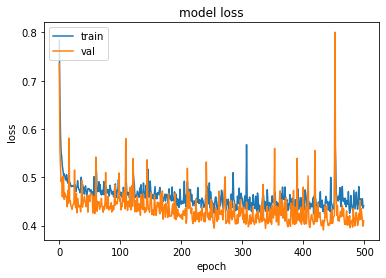

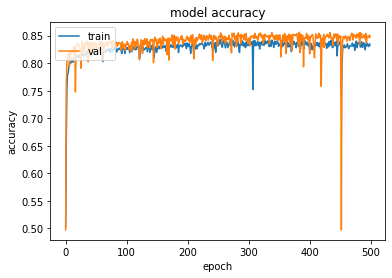

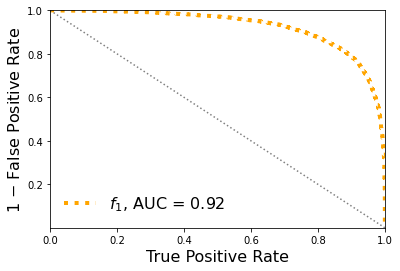

313/313 [==============================] - 2s 6ms/step - loss: 0.4190 - acc: 0.8427 - f1_m: 0.4544 - precision_m: 0.4998 - recall_m: 0.4176
Test ROC-AUC: 0.92478528
Test loss: 0.41899657249450684
Test accuracy: 0.8427000045776367
Test f1: 0.4543600380420685
Test precision: 0.4998224973678589
Test recall: 0.41763177514076233
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 24s 120ms/step - loss: 1.2373 - acc: 0.5077 - f1_m: 0.5333 - precision_m: 0.5121 - recall_m: 0.5867 - val_loss: 0.7598 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
188/188 [==============================] - 22s 114ms/step - loss: 0.7569 - acc: 0.5036 - f1_m: 0.4427 - precision_m: 0.5089 - recall_m: 0.4142 - val_loss: 0.7410 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_pre

188/188 [==============================] - 22s 114ms/step - loss: 0.4362 - acc: 0.8383 - f1_m: 0.8414 - precision_m: 0.8239 - recall_m: 0.8646 - val_loss: 0.4293 - val_acc: 0.8420 - val_f1_m: 0.8486 - val_precision_m: 0.8087 - val_recall_m: 0.8956
Epoch 62/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4230 - acc: 0.8455 - f1_m: 0.8498 - precision_m: 0.8330 - recall_m: 0.8719 - val_loss: 0.4224 - val_acc: 0.8440 - val_f1_m: 0.8413 - val_precision_m: 0.8499 - val_recall_m: 0.8357
Epoch 63/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4352 - acc: 0.8386 - f1_m: 0.8427 - precision_m: 0.8255 - recall_m: 0.8665 - val_loss: 0.4207 - val_acc: 0.8483 - val_f1_m: 0.8541 - val_precision_m: 0.8163 - val_recall_m: 0.8985
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4312 - acc: 0.8464 - f1_m: 0.8491 - precision_m: 0.8272 - recall_m: 0.8761 - val_loss: 0.4229 - val_acc: 0.8460 - val_f1_m: 0.8525 - val_precision_m:

188/188 [==============================] - 21s 114ms/step - loss: 0.4103 - acc: 0.8570 - f1_m: 0.8598 - precision_m: 0.8435 - recall_m: 0.8808 - val_loss: 0.4391 - val_acc: 0.8423 - val_f1_m: 0.8354 - val_precision_m: 0.8647 - val_recall_m: 0.8101
Epoch 124/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4200 - acc: 0.8549 - f1_m: 0.8569 - precision_m: 0.8410 - recall_m: 0.8774 - val_loss: 0.4491 - val_acc: 0.8385 - val_f1_m: 0.8419 - val_precision_m: 0.8169 - val_recall_m: 0.8708
Epoch 125/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4232 - acc: 0.8497 - f1_m: 0.8512 - precision_m: 0.8383 - recall_m: 0.8701 - val_loss: 0.4518 - val_acc: 0.8483 - val_f1_m: 0.8530 - val_precision_m: 0.8223 - val_recall_m: 0.8889
Epoch 126/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4391 - acc: 0.8557 - f1_m: 0.8577 - precision_m: 0.8451 - recall_m: 0.8747 - val_loss: 0.4234 - val_acc: 0.8470 - val_f1_m: 0.8504 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4223 - acc: 0.8513 - f1_m: 0.8528 - precision_m: 0.8454 - recall_m: 0.8656 - val_loss: 0.4166 - val_acc: 0.8498 - val_f1_m: 0.8498 - val_precision_m: 0.8445 - val_recall_m: 0.8578
Epoch 186/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4048 - acc: 0.8597 - f1_m: 0.8607 - precision_m: 0.8494 - recall_m: 0.8752 - val_loss: 0.4042 - val_acc: 0.8528 - val_f1_m: 0.8509 - val_precision_m: 0.8558 - val_recall_m: 0.8485
Epoch 187/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4179 - acc: 0.8510 - f1_m: 0.8489 - precision_m: 0.8436 - recall_m: 0.8602 - val_loss: 0.4140 - val_acc: 0.8515 - val_f1_m: 0.8531 - val_precision_m: 0.8348 - val_recall_m: 0.8745
Epoch 188/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4112 - acc: 0.8576 - f1_m: 0.8585 - precision_m: 0.8496 - recall_m: 0.8713 - val_loss: 0.4142 - val_acc: 0.8485 - val_f1_m: 0.8500 - val_precision

188/188 [==============================] - 22s 114ms/step - loss: 0.4499 - acc: 0.8395 - f1_m: 0.8409 - precision_m: 0.8350 - recall_m: 0.8522 - val_loss: 0.4364 - val_acc: 0.8447 - val_f1_m: 0.8532 - val_precision_m: 0.8015 - val_recall_m: 0.9149
Epoch 248/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4289 - acc: 0.8456 - f1_m: 0.8461 - precision_m: 0.8397 - recall_m: 0.8600 - val_loss: 0.4305 - val_acc: 0.8433 - val_f1_m: 0.8481 - val_precision_m: 0.8172 - val_recall_m: 0.8844
Epoch 249/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4209 - acc: 0.8536 - f1_m: 0.8573 - precision_m: 0.8452 - recall_m: 0.8742 - val_loss: 0.4645 - val_acc: 0.8428 - val_f1_m: 0.8367 - val_precision_m: 0.8617 - val_recall_m: 0.8160
Epoch 250/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4483 - acc: 0.8510 - f1_m: 0.8522 - precision_m: 0.8470 - recall_m: 0.8645 - val_loss: 0.4428 - val_acc: 0.8288 - val_f1_m: 0.8138 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4015 - acc: 0.8656 - f1_m: 0.8654 - precision_m: 0.8641 - recall_m: 0.8708 - val_loss: 0.4739 - val_acc: 0.8358 - val_f1_m: 0.8238 - val_precision_m: 0.8804 - val_recall_m: 0.7762
Epoch 310/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4340 - acc: 0.8601 - f1_m: 0.8612 - precision_m: 0.8561 - recall_m: 0.8707 - val_loss: 0.4338 - val_acc: 0.8455 - val_f1_m: 0.8429 - val_precision_m: 0.8489 - val_recall_m: 0.8394
Epoch 311/500
188/188 [==============================] - 22s 115ms/step - loss: 0.5800 - acc: 0.8324 - f1_m: 0.8296 - precision_m: 0.8247 - recall_m: 0.8524 - val_loss: 0.4378 - val_acc: 0.8443 - val_f1_m: 0.8430 - val_precision_m: 0.8426 - val_recall_m: 0.8456
Epoch 312/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4184 - acc: 0.8618 - f1_m: 0.8615 - precision_m: 0.8607 - recall_m: 0.8674 - val_loss: 0.4289 - val_acc: 0.8532 - val_f1_m: 0.8527 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4154 - acc: 0.8570 - f1_m: 0.8545 - precision_m: 0.8549 - recall_m: 0.8601 - val_loss: 0.4323 - val_acc: 0.8385 - val_f1_m: 0.8310 - val_precision_m: 0.8620 - val_recall_m: 0.8045
Epoch 372/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4205 - acc: 0.8579 - f1_m: 0.8565 - precision_m: 0.8606 - recall_m: 0.8570 - val_loss: 0.4245 - val_acc: 0.8540 - val_f1_m: 0.8579 - val_precision_m: 0.8289 - val_recall_m: 0.8917
Epoch 373/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4008 - acc: 0.8645 - f1_m: 0.8650 - precision_m: 0.8623 - recall_m: 0.8715 - val_loss: 0.4279 - val_acc: 0.8500 - val_f1_m: 0.8562 - val_precision_m: 0.8169 - val_recall_m: 0.9022
Epoch 374/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4239 - acc: 0.8584 - f1_m: 0.8585 - precision_m: 0.8505 - recall_m: 0.8717 - val_loss: 0.4244 - val_acc: 0.8397 - val_f1_m: 0.8282 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4150 - acc: 0.8575 - f1_m: 0.8571 - precision_m: 0.8514 - recall_m: 0.8681 - val_loss: 0.4192 - val_acc: 0.8363 - val_f1_m: 0.8241 - val_precision_m: 0.8819 - val_recall_m: 0.7758
Epoch 434/500
188/188 [==============================] - 22s 115ms/step - loss: 0.3938 - acc: 0.8642 - f1_m: 0.8644 - precision_m: 0.8688 - recall_m: 0.8649 - val_loss: 0.4110 - val_acc: 0.8427 - val_f1_m: 0.8355 - val_precision_m: 0.8686 - val_recall_m: 0.8069
Epoch 435/500
188/188 [==============================] - 22s 115ms/step - loss: 0.3959 - acc: 0.8651 - f1_m: 0.8645 - precision_m: 0.8639 - recall_m: 0.8698 - val_loss: 0.4701 - val_acc: 0.8093 - val_f1_m: 0.7816 - val_precision_m: 0.9053 - val_recall_m: 0.6905
Epoch 436/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4044 - acc: 0.8614 - f1_m: 0.8602 - precision_m: 0.8648 - recall_m: 0.8610 - val_loss: 0.4073 - val_acc: 0.8490 - val_f1_m: 0.8434 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4458 - acc: 0.8517 - f1_m: 0.8532 - precision_m: 0.8451 - recall_m: 0.8672 - val_loss: 0.4375 - val_acc: 0.8443 - val_f1_m: 0.8385 - val_precision_m: 0.8637 - val_recall_m: 0.8174
Epoch 496/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4093 - acc: 0.8658 - f1_m: 0.8649 - precision_m: 0.8615 - recall_m: 0.8723 - val_loss: 0.4473 - val_acc: 0.8488 - val_f1_m: 0.8514 - val_precision_m: 0.8310 - val_recall_m: 0.8758
Epoch 497/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4255 - acc: 0.8606 - f1_m: 0.8597 - precision_m: 0.8574 - recall_m: 0.8667 - val_loss: 0.4299 - val_acc: 0.8500 - val_f1_m: 0.8549 - val_precision_m: 0.8214 - val_recall_m: 0.8938
Epoch 498/500
188/188 [==============================] - 21s 114ms/step - loss: 0.3995 - acc: 0.8661 - f1_m: 0.8661 - precision_m: 0.8641 - recall_m: 0.8713 - val_loss: 0.4249 - val_acc: 0.8512 - val_f1_m: 0.8514 - val_precision

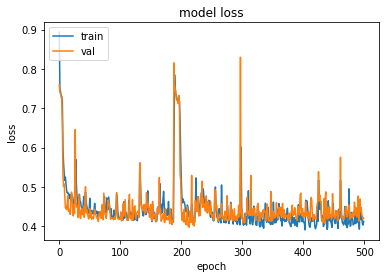

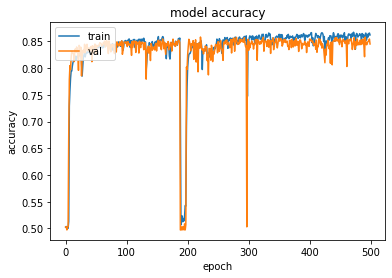

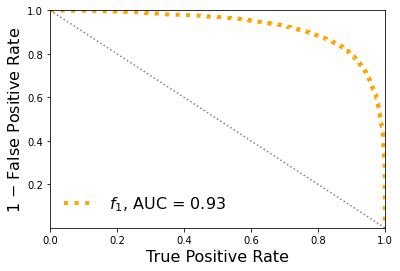

313/313 [==============================] - 2s 6ms/step - loss: 0.4290 - acc: 0.8458 - f1_m: 0.4489 - precision_m: 0.5000 - recall_m: 0.4085
Test ROC-AUC: 0.9262975600000001
Test loss: 0.4289924204349518
Test accuracy: 0.84579998254776
Test f1: 0.4489491581916809
Test precision: 0.5
Test recall: 0.4085463285446167
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 252ms/step - loss: 1.1360 - acc: 0.5004 - f1_m: 0.4520 - precision_m: 0.5018 - recall_m: 0.4625 - val_loss: 0.7825 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
94/94 [==============================] - 23s 242ms/step - loss: 0.7778 - acc: 0.5026 - f1_m: 0.5012 - precision_m: 0.5073 - recall_m: 0.5033 - val_loss: 0.7596 - val_acc: 0.6537 - val_f1_m: 0.5166 - val_precision_m: 0.8356 - 

Epoch 31/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4445 - acc: 0.8416 - f1_m: 0.8436 - precision_m: 0.8372 - recall_m: 0.8531 - val_loss: 0.4607 - val_acc: 0.8245 - val_f1_m: 0.8117 - val_precision_m: 0.8662 - val_recall_m: 0.7648
Epoch 32/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4552 - acc: 0.8412 - f1_m: 0.8410 - precision_m: 0.8366 - recall_m: 0.8506 - val_loss: 0.4351 - val_acc: 0.8412 - val_f1_m: 0.8366 - val_precision_m: 0.8460 - val_recall_m: 0.8291
Epoch 33/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4555 - acc: 0.8429 - f1_m: 0.8458 - precision_m: 0.8374 - recall_m: 0.8590 - val_loss: 0.4377 - val_acc: 0.8478 - val_f1_m: 0.8508 - val_precision_m: 0.8219 - val_recall_m: 0.8831
Epoch 34/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4602 - acc: 0.8367 - f1_m: 0.8390 - precision_m: 0.8337 - recall_m: 0.8508 - val_loss: 0.4469 - val_acc: 0.8287 - val_f1_m: 0.8160 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4140 - acc: 0.8563 - f1_m: 0.8583 - precision_m: 0.8492 - recall_m: 0.8699 - val_loss: 0.4401 - val_acc: 0.8410 - val_f1_m: 0.8357 - val_precision_m: 0.8501 - val_recall_m: 0.8237
Epoch 64/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4300 - acc: 0.8484 - f1_m: 0.8501 - precision_m: 0.8434 - recall_m: 0.8611 - val_loss: 0.4578 - val_acc: 0.8300 - val_f1_m: 0.8167 - val_precision_m: 0.8717 - val_recall_m: 0.7698
Epoch 65/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4492 - acc: 0.8440 - f1_m: 0.8460 - precision_m: 0.8312 - recall_m: 0.8663 - val_loss: 0.4510 - val_acc: 0.8380 - val_f1_m: 0.8288 - val_precision_m: 0.8661 - val_recall_m: 0.7967
Epoch 66/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4137 - acc: 0.8595 - f1_m: 0.8597 - precision_m: 0.8494 - recall_m: 0.8731 - val_loss: 0.4402 - val_acc: 0.8365 - val_f1_m: 0.8269 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4148 - acc: 0.8632 - f1_m: 0.8661 - precision_m: 0.8490 - recall_m: 0.8860 - val_loss: 0.4484 - val_acc: 0.8343 - val_f1_m: 0.8276 - val_precision_m: 0.8511 - val_recall_m: 0.8068
Epoch 96/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3899 - acc: 0.8759 - f1_m: 0.8774 - precision_m: 0.8620 - recall_m: 0.8951 - val_loss: 0.4408 - val_acc: 0.8437 - val_f1_m: 0.8519 - val_precision_m: 0.8006 - val_recall_m: 0.9121
Epoch 97/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4044 - acc: 0.8633 - f1_m: 0.8644 - precision_m: 0.8499 - recall_m: 0.8838 - val_loss: 0.4415 - val_acc: 0.8443 - val_f1_m: 0.8496 - val_precision_m: 0.8144 - val_recall_m: 0.8897
Epoch 98/500
94/94 [==============================] - 23s 241ms/step - loss: 0.3992 - acc: 0.8693 - f1_m: 0.8713 - precision_m: 0.8576 - recall_m: 0.8874 - val_loss: 0.4384 - val_acc: 0.8452 - val_f1_m: 0.8463 - val_precisi

94/94 [==============================] - 23s 240ms/step - loss: 0.3821 - acc: 0.8783 - f1_m: 0.8809 - precision_m: 0.8667 - recall_m: 0.8973 - val_loss: 0.4460 - val_acc: 0.8483 - val_f1_m: 0.8537 - val_precision_m: 0.8144 - val_recall_m: 0.8984
Epoch 158/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3915 - acc: 0.8738 - f1_m: 0.8757 - precision_m: 0.8570 - recall_m: 0.8995 - val_loss: 0.4743 - val_acc: 0.8433 - val_f1_m: 0.8414 - val_precision_m: 0.8423 - val_recall_m: 0.8416
Epoch 159/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3876 - acc: 0.8770 - f1_m: 0.8793 - precision_m: 0.8636 - recall_m: 0.8981 - val_loss: 0.4670 - val_acc: 0.8278 - val_f1_m: 0.8173 - val_precision_m: 0.8623 - val_recall_m: 0.7797
Epoch 160/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3823 - acc: 0.8806 - f1_m: 0.8827 - precision_m: 0.8678 - recall_m: 0.9010 - val_loss: 0.4581 - val_acc: 0.8368 - val_f1_m: 0.8380 - val_precision_m: 0.82

94/94 [==============================] - 23s 240ms/step - loss: 0.3565 - acc: 0.8938 - f1_m: 0.8946 - precision_m: 0.8796 - recall_m: 0.9120 - val_loss: 0.4657 - val_acc: 0.8433 - val_f1_m: 0.8489 - val_precision_m: 0.8135 - val_recall_m: 0.8892
Epoch 220/500
94/94 [==============================] - 23s 242ms/step - loss: 0.3534 - acc: 0.8976 - f1_m: 0.8992 - precision_m: 0.8802 - recall_m: 0.9204 - val_loss: 0.4767 - val_acc: 0.8387 - val_f1_m: 0.8317 - val_precision_m: 0.8554 - val_recall_m: 0.8109
Epoch 221/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3711 - acc: 0.8917 - f1_m: 0.8931 - precision_m: 0.8797 - recall_m: 0.9092 - val_loss: 0.4619 - val_acc: 0.8413 - val_f1_m: 0.8402 - val_precision_m: 0.8366 - val_recall_m: 0.8454
Epoch 222/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3683 - acc: 0.8895 - f1_m: 0.8925 - precision_m: 0.8742 - recall_m: 0.9129 - val_loss: 0.4656 - val_acc: 0.8440 - val_f1_m: 0.8431 - val_precision_m: 0.84

94/94 [==============================] - 22s 239ms/step - loss: 0.3897 - acc: 0.8830 - f1_m: 0.8847 - precision_m: 0.8765 - recall_m: 0.8945 - val_loss: 0.4452 - val_acc: 0.8477 - val_f1_m: 0.8474 - val_precision_m: 0.8355 - val_recall_m: 0.8614
Epoch 282/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3653 - acc: 0.8913 - f1_m: 0.8919 - precision_m: 0.8823 - recall_m: 0.9037 - val_loss: 0.4414 - val_acc: 0.8443 - val_f1_m: 0.8498 - val_precision_m: 0.8121 - val_recall_m: 0.8925
Epoch 283/500
94/94 [==============================] - 22s 239ms/step - loss: 0.5053 - acc: 0.8423 - f1_m: 0.8319 - precision_m: 0.8404 - recall_m: 0.8448 - val_loss: 0.5819 - val_acc: 0.7715 - val_f1_m: 0.7376 - val_precision_m: 0.8555 - val_recall_m: 0.6497
Epoch 284/500
94/94 [==============================] - 23s 240ms/step - loss: 0.6009 - acc: 0.7867 - f1_m: 0.7852 - precision_m: 0.7853 - recall_m: 0.7979 - val_loss: 0.5221 - val_acc: 0.8215 - val_f1_m: 0.8266 - val_precision_m: 0.79

94/94 [==============================] - 22s 237ms/step - loss: 0.3632 - acc: 0.8993 - f1_m: 0.9004 - precision_m: 0.8870 - recall_m: 0.9163 - val_loss: 0.4832 - val_acc: 0.8352 - val_f1_m: 0.8434 - val_precision_m: 0.7932 - val_recall_m: 0.9018
Epoch 344/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3761 - acc: 0.8921 - f1_m: 0.8931 - precision_m: 0.8800 - recall_m: 0.9110 - val_loss: 0.9467 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 345/500
94/94 [==============================] - 22s 234ms/step - loss: 1.2831 - acc: 0.5225 - f1_m: 0.1144 - precision_m: 0.3550 - recall_m: 0.1008 - val_loss: 0.9447 - val_acc: 0.7012 - val_f1_m: 0.6279 - val_precision_m: 0.8252 - val_recall_m: 0.5089
Epoch 346/500
94/94 [==============================] - 22s 235ms/step - loss: 0.8750 - acc: 0.7388 - f1_m: 0.7335 - precision_m: 0.7517 - recall_m: 0.7291 - val_loss: 0.7286 - val_acc: 0.7858 - val_f1_m: 0.7709 - val_preci

94/94 [==============================] - 22s 235ms/step - loss: 0.3913 - acc: 0.8743 - f1_m: 0.8740 - precision_m: 0.8806 - recall_m: 0.8703 - val_loss: 0.4386 - val_acc: 0.8415 - val_f1_m: 0.8428 - val_precision_m: 0.8248 - val_recall_m: 0.8634
Epoch 406/500
94/94 [==============================] - 22s 235ms/step - loss: 0.3911 - acc: 0.8693 - f1_m: 0.8686 - precision_m: 0.8738 - recall_m: 0.8655 - val_loss: 0.4462 - val_acc: 0.8345 - val_f1_m: 0.8288 - val_precision_m: 0.8469 - val_recall_m: 0.8129
Epoch 407/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3817 - acc: 0.8726 - f1_m: 0.8726 - precision_m: 0.8750 - recall_m: 0.8719 - val_loss: 0.4421 - val_acc: 0.8327 - val_f1_m: 0.8221 - val_precision_m: 0.8675 - val_recall_m: 0.7830
Epoch 408/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3724 - acc: 0.8804 - f1_m: 0.8789 - precision_m: 0.8866 - recall_m: 0.8740 - val_loss: 0.4332 - val_acc: 0.8435 - val_f1_m: 0.8424 - val_precision_m: 0.83

94/94 [==============================] - 22s 235ms/step - loss: 0.4053 - acc: 0.8795 - f1_m: 0.8790 - precision_m: 0.8832 - recall_m: 0.8768 - val_loss: 0.5484 - val_acc: 0.7975 - val_f1_m: 0.8139 - val_precision_m: 0.7427 - val_recall_m: 0.9021
Epoch 468/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4523 - acc: 0.8515 - f1_m: 0.8529 - precision_m: 0.8461 - recall_m: 0.8636 - val_loss: 0.4797 - val_acc: 0.8272 - val_f1_m: 0.8251 - val_precision_m: 0.8258 - val_recall_m: 0.8267
Epoch 469/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4003 - acc: 0.8734 - f1_m: 0.8738 - precision_m: 0.8759 - recall_m: 0.8735 - val_loss: 0.5694 - val_acc: 0.8128 - val_f1_m: 0.8327 - val_precision_m: 0.7454 - val_recall_m: 0.9447
Epoch 470/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4083 - acc: 0.8687 - f1_m: 0.8693 - precision_m: 0.8709 - recall_m: 0.8729 - val_loss: 0.4927 - val_acc: 0.8368 - val_f1_m: 0.8446 - val_precision_m: 0.79

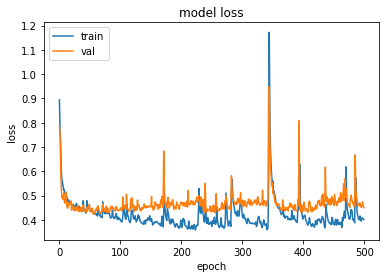

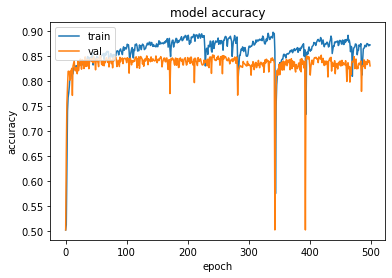

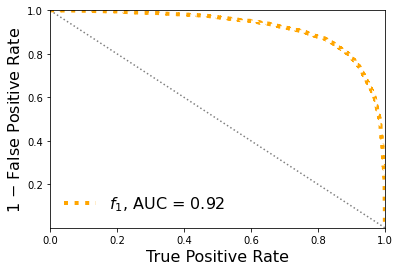

313/313 [==============================] - 2s 6ms/step - loss: 0.4606 - acc: 0.8324 - f1_m: 0.4342 - precision_m: 0.5002 - recall_m: 0.3854
Test ROC-AUC: 0.9215165600000002
Test loss: 0.46060577034950256
Test accuracy: 0.8324000239372253
Test f1: 0.4341927468776703
Test precision: 0.5001775026321411
Test recall: 0.38538339734077454
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8050 - acc: 0.6512 - f1_m: 0.6675 - precision_m: 0.6477 - recall_m: 0.7217 - val_loss: 0.5567 - val_acc: 0.7803 - val_f1_m: 0.7642 - val_precision_m: 0.8132 - val_recall_m: 0.7260
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.5824 - acc: 0.7845 - f1_m: 0.7851 - precision_m: 0.7799 - recall_m: 0.8012 - val_loss: 0.5254 - val_acc: 0.8108 - val_f1_m: 0.8064 - val_precision_m: 0.

Epoch 31/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4748 - acc: 0.8304 - f1_m: 0.8302 - precision_m: 0.8199 - recall_m: 0.8493 - val_loss: 0.4589 - val_acc: 0.8370 - val_f1_m: 0.8322 - val_precision_m: 0.8464 - val_recall_m: 0.8236
Epoch 32/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4926 - acc: 0.8237 - f1_m: 0.8220 - precision_m: 0.8181 - recall_m: 0.8372 - val_loss: 0.4560 - val_acc: 0.8270 - val_f1_m: 0.8247 - val_precision_m: 0.8223 - val_recall_m: 0.8318
Epoch 33/500
375/375 [==============================] - 23s 61ms/step - loss: 0.5063 - acc: 0.8149 - f1_m: 0.8150 - precision_m: 0.8100 - recall_m: 0.8343 - val_loss: 0.4486 - val_acc: 0.8392 - val_f1_m: 0.8408 - val_precision_m: 0.8203 - val_recall_m: 0.8676
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4778 - acc: 0.8281 - f1_m: 0.8297 - precision_m: 0.8162 - recall_m: 0.8511 - val_loss: 0.4522 - val_acc: 0.8332 - val_f1_m: 0.8281 - val_pre

375/375 [==============================] - 23s 60ms/step - loss: 0.4956 - acc: 0.8255 - f1_m: 0.8249 - precision_m: 0.8166 - recall_m: 0.8461 - val_loss: 0.4203 - val_acc: 0.8428 - val_f1_m: 0.8383 - val_precision_m: 0.8482 - val_recall_m: 0.8329
Epoch 94/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4604 - acc: 0.8315 - f1_m: 0.8320 - precision_m: 0.8214 - recall_m: 0.8524 - val_loss: 0.4254 - val_acc: 0.8410 - val_f1_m: 0.8369 - val_precision_m: 0.8462 - val_recall_m: 0.8326
Epoch 95/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4508 - acc: 0.8367 - f1_m: 0.8375 - precision_m: 0.8257 - recall_m: 0.8570 - val_loss: 0.4424 - val_acc: 0.8340 - val_f1_m: 0.8216 - val_precision_m: 0.8710 - val_recall_m: 0.7825
Epoch 96/500
375/375 [==============================] - 23s 61ms/step - loss: 0.5090 - acc: 0.8146 - f1_m: 0.8172 - precision_m: 0.8047 - recall_m: 0.8462 - val_loss: 0.4280 - val_acc: 0.8478 - val_f1_m: 0.8487 - val_precision_m: 0.8

375/375 [==============================] - 23s 60ms/step - loss: 0.4505 - acc: 0.8380 - f1_m: 0.8402 - precision_m: 0.8258 - recall_m: 0.8620 - val_loss: 0.4683 - val_acc: 0.8420 - val_f1_m: 0.8540 - val_precision_m: 0.7841 - val_recall_m: 0.9420
Epoch 156/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4579 - acc: 0.8357 - f1_m: 0.8402 - precision_m: 0.8245 - recall_m: 0.8644 - val_loss: 0.4244 - val_acc: 0.8453 - val_f1_m: 0.8402 - val_precision_m: 0.8568 - val_recall_m: 0.8296
Epoch 157/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4647 - acc: 0.8320 - f1_m: 0.8324 - precision_m: 0.8244 - recall_m: 0.8508 - val_loss: 0.4467 - val_acc: 0.8500 - val_f1_m: 0.8578 - val_precision_m: 0.8040 - val_recall_m: 0.9239
Epoch 158/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4503 - acc: 0.8414 - f1_m: 0.8418 - precision_m: 0.8270 - recall_m: 0.8655 - val_loss: 0.4920 - val_acc: 0.8143 - val_f1_m: 0.7962 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4712 - acc: 0.8317 - f1_m: 0.8336 - precision_m: 0.8260 - recall_m: 0.8519 - val_loss: 0.4243 - val_acc: 0.8500 - val_f1_m: 0.8556 - val_precision_m: 0.8121 - val_recall_m: 0.9085
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4465 - acc: 0.8366 - f1_m: 0.8405 - precision_m: 0.8203 - recall_m: 0.8695 - val_loss: 0.4580 - val_acc: 0.8252 - val_f1_m: 0.8071 - val_precision_m: 0.8821 - val_recall_m: 0.7490
Epoch 219/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4671 - acc: 0.8282 - f1_m: 0.8305 - precision_m: 0.8188 - recall_m: 0.8546 - val_loss: 0.4193 - val_acc: 0.8430 - val_f1_m: 0.8436 - val_precision_m: 0.8267 - val_recall_m: 0.8660
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4590 - acc: 0.8341 - f1_m: 0.8335 - precision_m: 0.8230 - recall_m: 0.8536 - val_loss: 0.4113 - val_acc: 0.8485 - val_f1_m: 0.8449 - val_precision_m: 

375/375 [==============================] - 23s 60ms/step - loss: 0.4404 - acc: 0.8412 - f1_m: 0.8420 - precision_m: 0.8318 - recall_m: 0.8611 - val_loss: 0.4252 - val_acc: 0.8518 - val_f1_m: 0.8566 - val_precision_m: 0.8162 - val_recall_m: 0.9058
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4703 - acc: 0.8246 - f1_m: 0.8242 - precision_m: 0.8167 - recall_m: 0.8442 - val_loss: 0.4373 - val_acc: 0.8485 - val_f1_m: 0.8470 - val_precision_m: 0.8460 - val_recall_m: 0.8534
Epoch 281/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4567 - acc: 0.8381 - f1_m: 0.8400 - precision_m: 0.8286 - recall_m: 0.8628 - val_loss: 0.4226 - val_acc: 0.8448 - val_f1_m: 0.8414 - val_precision_m: 0.8491 - val_recall_m: 0.8387
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4503 - acc: 0.8364 - f1_m: 0.8400 - precision_m: 0.8209 - recall_m: 0.8675 - val_loss: 0.4246 - val_acc: 0.8517 - val_f1_m: 0.8579 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4518 - acc: 0.8370 - f1_m: 0.8412 - precision_m: 0.8192 - recall_m: 0.8742 - val_loss: 0.4199 - val_acc: 0.8463 - val_f1_m: 0.8395 - val_precision_m: 0.8649 - val_recall_m: 0.8199
Epoch 342/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4413 - acc: 0.8423 - f1_m: 0.8452 - precision_m: 0.8303 - recall_m: 0.8671 - val_loss: 0.4280 - val_acc: 0.8498 - val_f1_m: 0.8554 - val_precision_m: 0.8112 - val_recall_m: 0.9087
Epoch 343/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4651 - acc: 0.8350 - f1_m: 0.8369 - precision_m: 0.8225 - recall_m: 0.8617 - val_loss: 0.4774 - val_acc: 0.8397 - val_f1_m: 0.8506 - val_precision_m: 0.7839 - val_recall_m: 0.9337
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4963 - acc: 0.8183 - f1_m: 0.8179 - precision_m: 0.8095 - recall_m: 0.8415 - val_loss: 0.4168 - val_acc: 0.8558 - val_f1_m: 0.8602 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4405 - acc: 0.8435 - f1_m: 0.8459 - precision_m: 0.8285 - recall_m: 0.8731 - val_loss: 0.4170 - val_acc: 0.8493 - val_f1_m: 0.8517 - val_precision_m: 0.8233 - val_recall_m: 0.8864
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4378 - acc: 0.8439 - f1_m: 0.8444 - precision_m: 0.8353 - recall_m: 0.8625 - val_loss: 0.4198 - val_acc: 0.8483 - val_f1_m: 0.8480 - val_precision_m: 0.8389 - val_recall_m: 0.8617
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4469 - acc: 0.8397 - f1_m: 0.8414 - precision_m: 0.8286 - recall_m: 0.8632 - val_loss: 0.4320 - val_acc: 0.8458 - val_f1_m: 0.8430 - val_precision_m: 0.8471 - val_recall_m: 0.8432
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4616 - acc: 0.8367 - f1_m: 0.8410 - precision_m: 0.8274 - recall_m: 0.8670 - val_loss: 0.4217 - val_acc: 0.8478 - val_f1_m: 0.8478 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4463 - acc: 0.8415 - f1_m: 0.8444 - precision_m: 0.8269 - recall_m: 0.8701 - val_loss: 0.4165 - val_acc: 0.8463 - val_f1_m: 0.8406 - val_precision_m: 0.8608 - val_recall_m: 0.8258
Epoch 466/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4366 - acc: 0.8447 - f1_m: 0.8450 - precision_m: 0.8314 - recall_m: 0.8668 - val_loss: 0.5462 - val_acc: 0.7682 - val_f1_m: 0.7126 - val_precision_m: 0.9217 - val_recall_m: 0.5858
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4724 - acc: 0.8262 - f1_m: 0.8291 - precision_m: 0.8211 - recall_m: 0.8505 - val_loss: 0.4252 - val_acc: 0.8505 - val_f1_m: 0.8512 - val_precision_m: 0.8346 - val_recall_m: 0.8727
Epoch 468/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4605 - acc: 0.8316 - f1_m: 0.8370 - precision_m: 0.8167 - recall_m: 0.8681 - val_loss: 0.4350 - val_acc: 0.8502 - val_f1_m: 0.8496 - val_precision_m: 

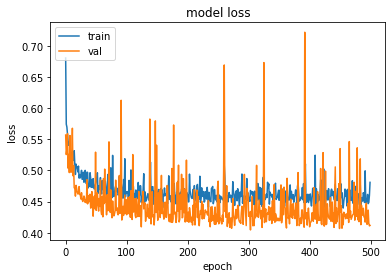

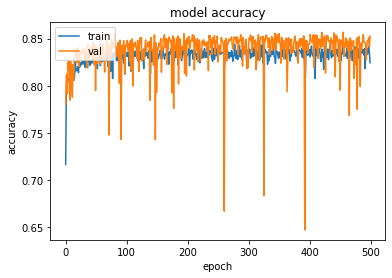

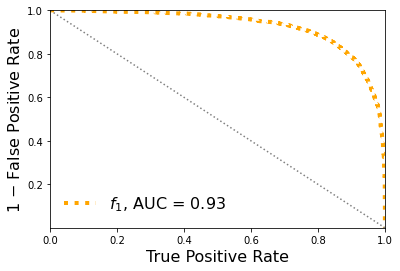

313/313 [==============================] - 2s 6ms/step - loss: 0.4199 - acc: 0.8481 - f1_m: 0.4635 - precision_m: 0.4999 - recall_m: 0.4331
Test ROC-AUC: 0.92681946
Test loss: 0.41990381479263306
Test accuracy: 0.8481000065803528
Test f1: 0.4634907841682434
Test precision: 0.49985477328300476
Test recall: 0.43310701847076416
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 116ms/step - loss: 0.8897 - acc: 0.5938 - f1_m: 0.6004 - precision_m: 0.5720 - recall_m: 0.6653 - val_loss: 0.5787 - val_acc: 0.7653 - val_f1_m: 0.7958 - val_precision_m: 0.7003 - val_recall_m: 0.9248
Epoch 2/500
188/188 [==============================] - 21s 113ms/step - loss: 0.5917 - acc: 0.7735 - f1_m: 0.7808 - precision_m: 0.7583 - recall_m: 0.8146 - val_loss: 0.5201 - val_acc: 0.8032 - val_f1_m: 0.8202 - val_precision_m: 0.7495

188/188 [==============================] - 22s 115ms/step - loss: 0.4556 - acc: 0.8411 - f1_m: 0.8423 - precision_m: 0.8350 - recall_m: 0.8572 - val_loss: 0.4344 - val_acc: 0.8483 - val_f1_m: 0.8493 - val_precision_m: 0.8363 - val_recall_m: 0.8656
Epoch 62/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4575 - acc: 0.8359 - f1_m: 0.8374 - precision_m: 0.8258 - recall_m: 0.8598 - val_loss: 0.5063 - val_acc: 0.7910 - val_f1_m: 0.8215 - val_precision_m: 0.7128 - val_recall_m: 0.9725
Epoch 63/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4557 - acc: 0.8379 - f1_m: 0.8423 - precision_m: 0.8198 - recall_m: 0.8727 - val_loss: 0.4388 - val_acc: 0.8412 - val_f1_m: 0.8482 - val_precision_m: 0.8054 - val_recall_m: 0.8984
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4541 - acc: 0.8388 - f1_m: 0.8419 - precision_m: 0.8270 - recall_m: 0.8648 - val_loss: 0.4364 - val_acc: 0.8377 - val_f1_m: 0.8324 - val_precision_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4379 - acc: 0.8420 - f1_m: 0.8458 - precision_m: 0.8304 - recall_m: 0.8674 - val_loss: 0.4964 - val_acc: 0.8080 - val_f1_m: 0.7803 - val_precision_m: 0.9013 - val_recall_m: 0.6908
Epoch 124/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4540 - acc: 0.8413 - f1_m: 0.8448 - precision_m: 0.8341 - recall_m: 0.8638 - val_loss: 0.4633 - val_acc: 0.8245 - val_f1_m: 0.8408 - val_precision_m: 0.7637 - val_recall_m: 0.9378
Epoch 125/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4309 - acc: 0.8469 - f1_m: 0.8498 - precision_m: 0.8340 - recall_m: 0.8727 - val_loss: 0.4213 - val_acc: 0.8430 - val_f1_m: 0.8395 - val_precision_m: 0.8522 - val_recall_m: 0.8301
Epoch 126/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4188 - acc: 0.8540 - f1_m: 0.8561 - precision_m: 0.8444 - recall_m: 0.8745 - val_loss: 0.4388 - val_acc: 0.8257 - val_f1_m: 0.8442 - val_precision

188/188 [==============================] - 22s 116ms/step - loss: 0.4253 - acc: 0.8492 - f1_m: 0.8502 - precision_m: 0.8357 - recall_m: 0.8717 - val_loss: 0.4085 - val_acc: 0.8523 - val_f1_m: 0.8520 - val_precision_m: 0.8471 - val_recall_m: 0.8602
Epoch 186/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4238 - acc: 0.8471 - f1_m: 0.8487 - precision_m: 0.8339 - recall_m: 0.8689 - val_loss: 0.4643 - val_acc: 0.8165 - val_f1_m: 0.8380 - val_precision_m: 0.7443 - val_recall_m: 0.9612
Epoch 187/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4568 - acc: 0.8363 - f1_m: 0.8407 - precision_m: 0.8172 - recall_m: 0.8741 - val_loss: 0.4204 - val_acc: 0.8375 - val_f1_m: 0.8516 - val_precision_m: 0.7783 - val_recall_m: 0.9430
Epoch 188/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4330 - acc: 0.8433 - f1_m: 0.8480 - precision_m: 0.8310 - recall_m: 0.8711 - val_loss: 0.4292 - val_acc: 0.8472 - val_f1_m: 0.8572 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4265 - acc: 0.8519 - f1_m: 0.8543 - precision_m: 0.8394 - recall_m: 0.8740 - val_loss: 0.4117 - val_acc: 0.8487 - val_f1_m: 0.8478 - val_precision_m: 0.8477 - val_recall_m: 0.8504
Epoch 248/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4206 - acc: 0.8498 - f1_m: 0.8529 - precision_m: 0.8351 - recall_m: 0.8764 - val_loss: 0.4091 - val_acc: 0.8475 - val_f1_m: 0.8512 - val_precision_m: 0.8253 - val_recall_m: 0.8820
Epoch 249/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4195 - acc: 0.8491 - f1_m: 0.8536 - precision_m: 0.8301 - recall_m: 0.8822 - val_loss: 0.4012 - val_acc: 0.8533 - val_f1_m: 0.8553 - val_precision_m: 0.8375 - val_recall_m: 0.8770
Epoch 250/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4136 - acc: 0.8501 - f1_m: 0.8548 - precision_m: 0.8358 - recall_m: 0.8781 - val_loss: 0.4301 - val_acc: 0.8432 - val_f1_m: 0.8361 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4150 - acc: 0.8503 - f1_m: 0.8534 - precision_m: 0.8381 - recall_m: 0.8751 - val_loss: 0.4073 - val_acc: 0.8438 - val_f1_m: 0.8543 - val_precision_m: 0.7937 - val_recall_m: 0.9271
Epoch 310/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4194 - acc: 0.8506 - f1_m: 0.8518 - precision_m: 0.8310 - recall_m: 0.8793 - val_loss: 0.4120 - val_acc: 0.8510 - val_f1_m: 0.8553 - val_precision_m: 0.8258 - val_recall_m: 0.8897
Epoch 311/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4409 - acc: 0.8429 - f1_m: 0.8466 - precision_m: 0.8257 - recall_m: 0.8742 - val_loss: 0.4112 - val_acc: 0.8438 - val_f1_m: 0.8378 - val_precision_m: 0.8620 - val_recall_m: 0.8178
Epoch 312/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4234 - acc: 0.8518 - f1_m: 0.8553 - precision_m: 0.8383 - recall_m: 0.8764 - val_loss: 0.4009 - val_acc: 0.8537 - val_f1_m: 0.8592 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4233 - acc: 0.8506 - f1_m: 0.8545 - precision_m: 0.8334 - recall_m: 0.8831 - val_loss: 0.4008 - val_acc: 0.8505 - val_f1_m: 0.8542 - val_precision_m: 0.8276 - val_recall_m: 0.8856
Epoch 372/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4198 - acc: 0.8534 - f1_m: 0.8558 - precision_m: 0.8372 - recall_m: 0.8817 - val_loss: 0.3987 - val_acc: 0.8505 - val_f1_m: 0.8562 - val_precision_m: 0.8185 - val_recall_m: 0.9004
Epoch 373/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4260 - acc: 0.8460 - f1_m: 0.8507 - precision_m: 0.8312 - recall_m: 0.8763 - val_loss: 0.4059 - val_acc: 0.8493 - val_f1_m: 0.8490 - val_precision_m: 0.8435 - val_recall_m: 0.8572
Epoch 374/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4120 - acc: 0.8552 - f1_m: 0.8569 - precision_m: 0.8352 - recall_m: 0.8839 - val_loss: 0.6197 - val_acc: 0.7707 - val_f1_m: 0.7149 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4131 - acc: 0.8495 - f1_m: 0.8519 - precision_m: 0.8287 - recall_m: 0.8823 - val_loss: 0.3998 - val_acc: 0.8538 - val_f1_m: 0.8536 - val_precision_m: 0.8478 - val_recall_m: 0.8623
Epoch 434/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4265 - acc: 0.8428 - f1_m: 0.8482 - precision_m: 0.8287 - recall_m: 0.8758 - val_loss: 0.4022 - val_acc: 0.8535 - val_f1_m: 0.8620 - val_precision_m: 0.8107 - val_recall_m: 0.9229
Epoch 435/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4227 - acc: 0.8481 - f1_m: 0.8530 - precision_m: 0.8288 - recall_m: 0.8842 - val_loss: 0.3992 - val_acc: 0.8548 - val_f1_m: 0.8586 - val_precision_m: 0.8294 - val_recall_m: 0.8929
Epoch 436/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4324 - acc: 0.8422 - f1_m: 0.8448 - precision_m: 0.8273 - recall_m: 0.8732 - val_loss: 0.4917 - val_acc: 0.7752 - val_f1_m: 0.8119 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4158 - acc: 0.8541 - f1_m: 0.8582 - precision_m: 0.8385 - recall_m: 0.8831 - val_loss: 0.4000 - val_acc: 0.8518 - val_f1_m: 0.8579 - val_precision_m: 0.8182 - val_recall_m: 0.9043
Epoch 496/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4104 - acc: 0.8511 - f1_m: 0.8534 - precision_m: 0.8291 - recall_m: 0.8827 - val_loss: 0.4166 - val_acc: 0.8438 - val_f1_m: 0.8361 - val_precision_m: 0.8712 - val_recall_m: 0.8064
Epoch 497/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4163 - acc: 0.8539 - f1_m: 0.8583 - precision_m: 0.8399 - recall_m: 0.8825 - val_loss: 0.4211 - val_acc: 0.8423 - val_f1_m: 0.8468 - val_precision_m: 0.8168 - val_recall_m: 0.8817
Epoch 498/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4351 - acc: 0.8450 - f1_m: 0.8486 - precision_m: 0.8251 - recall_m: 0.8801 - val_loss: 0.4223 - val_acc: 0.8405 - val_f1_m: 0.8534 - val_precision

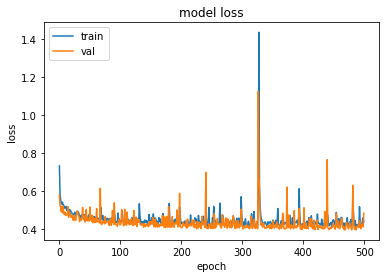

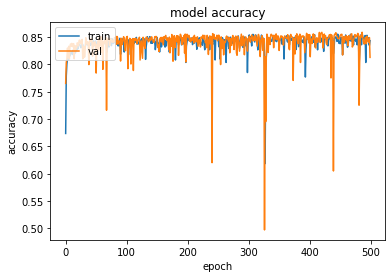

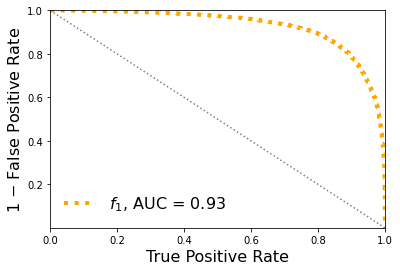

313/313 [==============================] - 2s 6ms/step - loss: 0.4874 - acc: 0.7993 - f1_m: 0.4895 - precision_m: 0.4996 - recall_m: 0.4807
Test ROC-AUC: 0.9272043999999999
Test loss: 0.48741352558135986
Test accuracy: 0.7993000149726868
Test f1: 0.4894927740097046
Test precision: 0.4996449947357178
Test recall: 0.4807308316230774
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.001
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 251ms/step - loss: 1.4423 - acc: 0.5407 - f1_m: 0.4644 - precision_m: 0.5568 - recall_m: 0.4380 - val_loss: 0.6478 - val_acc: 0.7687 - val_f1_m: 0.7658 - val_precision_m: 0.7658 - val_recall_m: 0.7675
Epoch 2/500
94/94 [==============================] - 23s 240ms/step - loss: 0.6596 - acc: 0.7232 - f1_m: 0.7139 - precision_m: 0.7477 - recall_m: 0.6897 - val_loss: 0.5953 - val_acc: 0.7772 - val_f1_m: 0.7849 - val_precision_m: 0.75

Epoch 31/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4555 - acc: 0.8447 - f1_m: 0.8401 - precision_m: 0.8602 - recall_m: 0.8260 - val_loss: 0.4565 - val_acc: 0.8495 - val_f1_m: 0.8506 - val_precision_m: 0.8318 - val_recall_m: 0.8718
Epoch 32/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4637 - acc: 0.8446 - f1_m: 0.8436 - precision_m: 0.8557 - recall_m: 0.8363 - val_loss: 0.4613 - val_acc: 0.8237 - val_f1_m: 0.8075 - val_precision_m: 0.8826 - val_recall_m: 0.7461
Epoch 33/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4668 - acc: 0.8386 - f1_m: 0.8345 - precision_m: 0.8611 - recall_m: 0.8162 - val_loss: 0.4733 - val_acc: 0.8430 - val_f1_m: 0.8479 - val_precision_m: 0.8117 - val_recall_m: 0.8888
Epoch 34/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4823 - acc: 0.8301 - f1_m: 0.8258 - precision_m: 0.8479 - recall_m: 0.8127 - val_loss: 0.4573 - val_acc: 0.8443 - val_f1_m: 0.8475 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4383 - acc: 0.8465 - f1_m: 0.8419 - precision_m: 0.8610 - recall_m: 0.8293 - val_loss: 0.4382 - val_acc: 0.8500 - val_f1_m: 0.8526 - val_precision_m: 0.8300 - val_recall_m: 0.8778
Epoch 64/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4198 - acc: 0.8595 - f1_m: 0.8587 - precision_m: 0.8641 - recall_m: 0.8558 - val_loss: 0.4363 - val_acc: 0.8358 - val_f1_m: 0.8286 - val_precision_m: 0.8623 - val_recall_m: 0.7991
Epoch 65/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4228 - acc: 0.8598 - f1_m: 0.8578 - precision_m: 0.8695 - recall_m: 0.8495 - val_loss: 0.4402 - val_acc: 0.8437 - val_f1_m: 0.8363 - val_precision_m: 0.8661 - val_recall_m: 0.8105
Epoch 66/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4311 - acc: 0.8538 - f1_m: 0.8508 - precision_m: 0.8611 - recall_m: 0.8451 - val_loss: 0.4491 - val_acc: 0.8470 - val_f1_m: 0.8445 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4139 - acc: 0.8596 - f1_m: 0.8586 - precision_m: 0.8628 - recall_m: 0.8583 - val_loss: 0.4325 - val_acc: 0.8420 - val_f1_m: 0.8346 - val_precision_m: 0.8671 - val_recall_m: 0.8061
Epoch 96/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4118 - acc: 0.8639 - f1_m: 0.8635 - precision_m: 0.8756 - recall_m: 0.8553 - val_loss: 0.4351 - val_acc: 0.8473 - val_f1_m: 0.8436 - val_precision_m: 0.8557 - val_recall_m: 0.8334
Epoch 97/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4083 - acc: 0.8629 - f1_m: 0.8607 - precision_m: 0.8727 - recall_m: 0.8534 - val_loss: 0.4286 - val_acc: 0.8483 - val_f1_m: 0.8481 - val_precision_m: 0.8413 - val_recall_m: 0.8571
Epoch 98/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4171 - acc: 0.8595 - f1_m: 0.8581 - precision_m: 0.8681 - recall_m: 0.8523 - val_loss: 0.4316 - val_acc: 0.8417 - val_f1_m: 0.8398 - val_precisi

94/94 [==============================] - 23s 247ms/step - loss: 0.4058 - acc: 0.8661 - f1_m: 0.8647 - precision_m: 0.8686 - recall_m: 0.8642 - val_loss: 0.4510 - val_acc: 0.8467 - val_f1_m: 0.8488 - val_precision_m: 0.8298 - val_recall_m: 0.8705
Epoch 158/500
94/94 [==============================] - 23s 245ms/step - loss: 0.4100 - acc: 0.8663 - f1_m: 0.8658 - precision_m: 0.8758 - recall_m: 0.8604 - val_loss: 0.4464 - val_acc: 0.8310 - val_f1_m: 0.8187 - val_precision_m: 0.8718 - val_recall_m: 0.7732
Epoch 159/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4085 - acc: 0.8634 - f1_m: 0.8621 - precision_m: 0.8745 - recall_m: 0.8538 - val_loss: 0.4436 - val_acc: 0.8372 - val_f1_m: 0.8355 - val_precision_m: 0.8310 - val_recall_m: 0.8414
Epoch 160/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4755 - acc: 0.8293 - f1_m: 0.8163 - precision_m: 0.8492 - recall_m: 0.8070 - val_loss: 0.5877 - val_acc: 0.8102 - val_f1_m: 0.8265 - val_precision_m: 0.75

94/94 [==============================] - 23s 246ms/step - loss: 0.4020 - acc: 0.8685 - f1_m: 0.8678 - precision_m: 0.8767 - recall_m: 0.8628 - val_loss: 0.4235 - val_acc: 0.8408 - val_f1_m: 0.8336 - val_precision_m: 0.8626 - val_recall_m: 0.8083
Epoch 220/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3877 - acc: 0.8730 - f1_m: 0.8711 - precision_m: 0.8863 - recall_m: 0.8587 - val_loss: 0.4228 - val_acc: 0.8392 - val_f1_m: 0.8312 - val_precision_m: 0.8607 - val_recall_m: 0.8052
Epoch 221/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3905 - acc: 0.8707 - f1_m: 0.8689 - precision_m: 0.8802 - recall_m: 0.8610 - val_loss: 0.4208 - val_acc: 0.8467 - val_f1_m: 0.8441 - val_precision_m: 0.8477 - val_recall_m: 0.8421
Epoch 222/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3979 - acc: 0.8709 - f1_m: 0.8689 - precision_m: 0.8818 - recall_m: 0.8600 - val_loss: 0.4182 - val_acc: 0.8430 - val_f1_m: 0.8372 - val_precision_m: 0.85

94/94 [==============================] - 23s 247ms/step - loss: 0.3905 - acc: 0.8692 - f1_m: 0.8681 - precision_m: 0.8784 - recall_m: 0.8617 - val_loss: 0.4114 - val_acc: 0.8473 - val_f1_m: 0.8450 - val_precision_m: 0.8472 - val_recall_m: 0.8441
Epoch 282/500
94/94 [==============================] - 23s 248ms/step - loss: 0.3907 - acc: 0.8704 - f1_m: 0.8676 - precision_m: 0.8726 - recall_m: 0.8650 - val_loss: 0.4197 - val_acc: 0.8377 - val_f1_m: 0.8286 - val_precision_m: 0.8684 - val_recall_m: 0.7935
Epoch 283/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3992 - acc: 0.8663 - f1_m: 0.8656 - precision_m: 0.8780 - recall_m: 0.8577 - val_loss: 0.4151 - val_acc: 0.8387 - val_f1_m: 0.8298 - val_precision_m: 0.8646 - val_recall_m: 0.7989
Epoch 284/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4379 - acc: 0.8442 - f1_m: 0.8386 - precision_m: 0.8661 - recall_m: 0.8227 - val_loss: 0.4641 - val_acc: 0.8258 - val_f1_m: 0.8091 - val_precision_m: 0.88

94/94 [==============================] - 23s 247ms/step - loss: 0.4054 - acc: 0.8620 - f1_m: 0.8604 - precision_m: 0.8680 - recall_m: 0.8569 - val_loss: 0.4052 - val_acc: 0.8517 - val_f1_m: 0.8495 - val_precision_m: 0.8525 - val_recall_m: 0.8479
Epoch 344/500
94/94 [==============================] - 23s 248ms/step - loss: 0.3818 - acc: 0.8720 - f1_m: 0.8701 - precision_m: 0.8796 - recall_m: 0.8634 - val_loss: 0.4115 - val_acc: 0.8512 - val_f1_m: 0.8495 - val_precision_m: 0.8478 - val_recall_m: 0.8526
Epoch 345/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3908 - acc: 0.8712 - f1_m: 0.8699 - precision_m: 0.8741 - recall_m: 0.8678 - val_loss: 0.4133 - val_acc: 0.8392 - val_f1_m: 0.8281 - val_precision_m: 0.8761 - val_recall_m: 0.7863
Epoch 346/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3926 - acc: 0.8663 - f1_m: 0.8636 - precision_m: 0.8769 - recall_m: 0.8545 - val_loss: 0.4163 - val_acc: 0.8470 - val_f1_m: 0.8462 - val_precision_m: 0.84

94/94 [==============================] - 23s 243ms/step - loss: 0.3876 - acc: 0.8668 - f1_m: 0.8642 - precision_m: 0.8828 - recall_m: 0.8501 - val_loss: 0.4179 - val_acc: 0.8482 - val_f1_m: 0.8457 - val_precision_m: 0.8505 - val_recall_m: 0.8424
Epoch 406/500
94/94 [==============================] - 23s 242ms/step - loss: 0.3788 - acc: 0.8741 - f1_m: 0.8721 - precision_m: 0.8857 - recall_m: 0.8617 - val_loss: 0.4150 - val_acc: 0.8497 - val_f1_m: 0.8481 - val_precision_m: 0.8451 - val_recall_m: 0.8524
Epoch 407/500
94/94 [==============================] - 23s 244ms/step - loss: 0.4064 - acc: 0.8606 - f1_m: 0.8578 - precision_m: 0.8701 - recall_m: 0.8519 - val_loss: 0.5323 - val_acc: 0.7443 - val_f1_m: 0.6712 - val_precision_m: 0.9314 - val_recall_m: 0.5267
Epoch 408/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4190 - acc: 0.8555 - f1_m: 0.8520 - precision_m: 0.8781 - recall_m: 0.8348 - val_loss: 0.4220 - val_acc: 0.8452 - val_f1_m: 0.8396 - val_precision_m: 0.86

94/94 [==============================] - 23s 241ms/step - loss: 0.4862 - acc: 0.8322 - f1_m: 0.8313 - precision_m: 0.8265 - recall_m: 0.8426 - val_loss: 0.4395 - val_acc: 0.8403 - val_f1_m: 0.8410 - val_precision_m: 0.8310 - val_recall_m: 0.8527
Epoch 468/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4698 - acc: 0.8329 - f1_m: 0.8299 - precision_m: 0.8400 - recall_m: 0.8281 - val_loss: 0.4505 - val_acc: 0.8257 - val_f1_m: 0.8098 - val_precision_m: 0.8804 - val_recall_m: 0.7512
Epoch 469/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4672 - acc: 0.8312 - f1_m: 0.8295 - precision_m: 0.8348 - recall_m: 0.8365 - val_loss: 0.4863 - val_acc: 0.8395 - val_f1_m: 0.8536 - val_precision_m: 0.7785 - val_recall_m: 0.9466
Epoch 470/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4536 - acc: 0.8412 - f1_m: 0.8421 - precision_m: 0.8393 - recall_m: 0.8524 - val_loss: 0.4237 - val_acc: 0.8345 - val_f1_m: 0.8230 - val_precision_m: 0.87

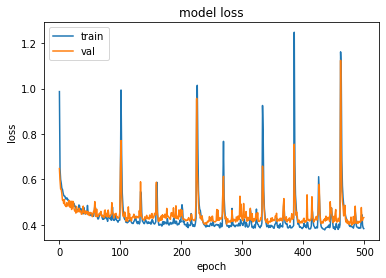

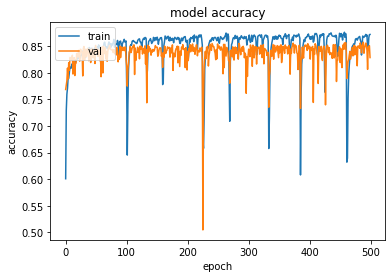

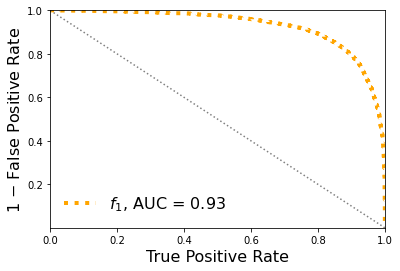

313/313 [==============================] - 2s 6ms/step - loss: 0.4381 - acc: 0.8343 - f1_m: 0.4277 - precision_m: 0.4998 - recall_m: 0.3756
Test ROC-AUC: 0.9281518800000002
Test loss: 0.4381300210952759
Test accuracy: 0.8342999815940857
Test f1: 0.4276747405529022
Test precision: 0.4997718036174774
Test recall: 0.3755990266799927
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8916 - acc: 0.5142 - f1_m: 0.4029 - precision_m: 0.5263 - recall_m: 0.3556 - val_loss: 0.5930 - val_acc: 0.7528 - val_f1_m: 0.7403 - val_precision_m: 0.7668 - val_recall_m: 0.7226
Epoch 2/500
375/375 [==============================] - 23s 61ms/step - loss: 0.6145 - acc: 0.7134 - f1_m: 0.7115 - precision_m: 0.7079 - recall_m: 0.7270 - val_loss: 0.5197 - val_acc: 0.7855 - val_f1_m: 0.7881 - val_precision_m: 0.7

Epoch 31/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4525 - acc: 0.8291 - f1_m: 0.8307 - precision_m: 0.8194 - recall_m: 0.8495 - val_loss: 0.4390 - val_acc: 0.8325 - val_f1_m: 0.8308 - val_precision_m: 0.8294 - val_recall_m: 0.8371
Epoch 32/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4551 - acc: 0.8278 - f1_m: 0.8302 - precision_m: 0.8143 - recall_m: 0.8538 - val_loss: 0.4344 - val_acc: 0.8382 - val_f1_m: 0.8429 - val_precision_m: 0.8103 - val_recall_m: 0.8836
Epoch 33/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4492 - acc: 0.8303 - f1_m: 0.8298 - precision_m: 0.8157 - recall_m: 0.8521 - val_loss: 0.4251 - val_acc: 0.8433 - val_f1_m: 0.8463 - val_precision_m: 0.8192 - val_recall_m: 0.8796
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4525 - acc: 0.8293 - f1_m: 0.8309 - precision_m: 0.8139 - recall_m: 0.8563 - val_loss: 0.4540 - val_acc: 0.8312 - val_f1_m: 0.8356 - val_pre

375/375 [==============================] - 22s 60ms/step - loss: 0.4487 - acc: 0.8386 - f1_m: 0.8424 - precision_m: 0.8188 - recall_m: 0.8732 - val_loss: 0.4324 - val_acc: 0.8375 - val_f1_m: 0.8366 - val_precision_m: 0.8318 - val_recall_m: 0.8467
Epoch 94/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4311 - acc: 0.8401 - f1_m: 0.8384 - precision_m: 0.8242 - recall_m: 0.8586 - val_loss: 0.4427 - val_acc: 0.8312 - val_f1_m: 0.8320 - val_precision_m: 0.8179 - val_recall_m: 0.8517
Epoch 95/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4358 - acc: 0.8377 - f1_m: 0.8412 - precision_m: 0.8188 - recall_m: 0.8713 - val_loss: 0.4347 - val_acc: 0.8380 - val_f1_m: 0.8406 - val_precision_m: 0.8160 - val_recall_m: 0.8714
Epoch 96/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4348 - acc: 0.8370 - f1_m: 0.8402 - precision_m: 0.8200 - recall_m: 0.8671 - val_loss: 0.4965 - val_acc: 0.8115 - val_f1_m: 0.8170 - val_precision_m: 0.7

375/375 [==============================] - 22s 60ms/step - loss: 0.4320 - acc: 0.8485 - f1_m: 0.8490 - precision_m: 0.8367 - recall_m: 0.8677 - val_loss: 0.4349 - val_acc: 0.8412 - val_f1_m: 0.8409 - val_precision_m: 0.8341 - val_recall_m: 0.8523
Epoch 156/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4361 - acc: 0.8445 - f1_m: 0.8437 - precision_m: 0.8353 - recall_m: 0.8585 - val_loss: 0.4627 - val_acc: 0.8248 - val_f1_m: 0.8203 - val_precision_m: 0.8326 - val_recall_m: 0.8123
Epoch 157/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4309 - acc: 0.8529 - f1_m: 0.8518 - precision_m: 0.8488 - recall_m: 0.8616 - val_loss: 0.4519 - val_acc: 0.8358 - val_f1_m: 0.8356 - val_precision_m: 0.8269 - val_recall_m: 0.8497
Epoch 158/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4293 - acc: 0.8490 - f1_m: 0.8476 - precision_m: 0.8442 - recall_m: 0.8582 - val_loss: 0.4593 - val_acc: 0.8290 - val_f1_m: 0.8293 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4256 - acc: 0.8529 - f1_m: 0.8533 - precision_m: 0.8487 - recall_m: 0.8627 - val_loss: 0.4613 - val_acc: 0.8248 - val_f1_m: 0.8175 - val_precision_m: 0.8442 - val_recall_m: 0.7976
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4247 - acc: 0.8533 - f1_m: 0.8542 - precision_m: 0.8481 - recall_m: 0.8659 - val_loss: 0.5523 - val_acc: 0.8093 - val_f1_m: 0.7904 - val_precision_m: 0.8619 - val_recall_m: 0.7348
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4773 - acc: 0.8427 - f1_m: 0.8429 - precision_m: 0.8414 - recall_m: 0.8518 - val_loss: 0.4916 - val_acc: 0.8395 - val_f1_m: 0.8349 - val_precision_m: 0.8471 - val_recall_m: 0.8280
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4528 - acc: 0.8540 - f1_m: 0.8551 - precision_m: 0.8434 - recall_m: 0.8731 - val_loss: 0.4483 - val_acc: 0.8405 - val_f1_m: 0.8399 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.5208 - acc: 0.8207 - f1_m: 0.8182 - precision_m: 0.8141 - recall_m: 0.8294 - val_loss: 0.4599 - val_acc: 0.8330 - val_f1_m: 0.8302 - val_precision_m: 0.8359 - val_recall_m: 0.8298
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4396 - acc: 0.8496 - f1_m: 0.8473 - precision_m: 0.8405 - recall_m: 0.8618 - val_loss: 0.4631 - val_acc: 0.8328 - val_f1_m: 0.8428 - val_precision_m: 0.7855 - val_recall_m: 0.9132
Epoch 281/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4319 - acc: 0.8518 - f1_m: 0.8523 - precision_m: 0.8449 - recall_m: 0.8665 - val_loss: 0.4939 - val_acc: 0.8275 - val_f1_m: 0.8201 - val_precision_m: 0.8475 - val_recall_m: 0.7996
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4666 - acc: 0.8484 - f1_m: 0.8473 - precision_m: 0.8444 - recall_m: 0.8552 - val_loss: 0.4500 - val_acc: 0.8298 - val_f1_m: 0.8206 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4314 - acc: 0.8509 - f1_m: 0.8497 - precision_m: 0.8421 - recall_m: 0.8642 - val_loss: 0.4620 - val_acc: 0.8335 - val_f1_m: 0.8351 - val_precision_m: 0.8116 - val_recall_m: 0.8648
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4259 - acc: 0.8512 - f1_m: 0.8524 - precision_m: 0.8450 - recall_m: 0.8656 - val_loss: 0.4475 - val_acc: 0.8360 - val_f1_m: 0.8339 - val_precision_m: 0.8353 - val_recall_m: 0.8374
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4267 - acc: 0.8537 - f1_m: 0.8540 - precision_m: 0.8467 - recall_m: 0.8678 - val_loss: 0.4655 - val_acc: 0.8133 - val_f1_m: 0.7955 - val_precision_m: 0.8654 - val_recall_m: 0.7410
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4307 - acc: 0.8497 - f1_m: 0.8508 - precision_m: 0.8470 - recall_m: 0.8610 - val_loss: 0.4582 - val_acc: 0.8242 - val_f1_m: 0.8149 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4963 - acc: 0.8255 - f1_m: 0.8226 - precision_m: 0.8226 - recall_m: 0.8306 - val_loss: 0.4694 - val_acc: 0.8267 - val_f1_m: 0.8154 - val_precision_m: 0.8604 - val_recall_m: 0.7796
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4367 - acc: 0.8493 - f1_m: 0.8490 - precision_m: 0.8438 - recall_m: 0.8611 - val_loss: 0.4595 - val_acc: 0.8400 - val_f1_m: 0.8436 - val_precision_m: 0.8135 - val_recall_m: 0.8806
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4317 - acc: 0.8523 - f1_m: 0.8504 - precision_m: 0.8450 - recall_m: 0.8614 - val_loss: 0.4493 - val_acc: 0.8378 - val_f1_m: 0.8410 - val_precision_m: 0.8123 - val_recall_m: 0.8761
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4303 - acc: 0.8466 - f1_m: 0.8487 - precision_m: 0.8388 - recall_m: 0.8647 - val_loss: 0.4988 - val_acc: 0.8257 - val_f1_m: 0.8249 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4599 - acc: 0.8501 - f1_m: 0.8497 - precision_m: 0.8503 - recall_m: 0.8545 - val_loss: 0.4648 - val_acc: 0.8338 - val_f1_m: 0.8277 - val_precision_m: 0.8489 - val_recall_m: 0.8130
Epoch 466/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4291 - acc: 0.8563 - f1_m: 0.8542 - precision_m: 0.8547 - recall_m: 0.8587 - val_loss: 0.4582 - val_acc: 0.8323 - val_f1_m: 0.8409 - val_precision_m: 0.7915 - val_recall_m: 0.9016
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4242 - acc: 0.8527 - f1_m: 0.8533 - precision_m: 0.8493 - recall_m: 0.8635 - val_loss: 0.4461 - val_acc: 0.8370 - val_f1_m: 0.8343 - val_precision_m: 0.8377 - val_recall_m: 0.8358
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4202 - acc: 0.8578 - f1_m: 0.8591 - precision_m: 0.8528 - recall_m: 0.8706 - val_loss: 0.4695 - val_acc: 0.8317 - val_f1_m: 0.8404 - val_precision_m: 

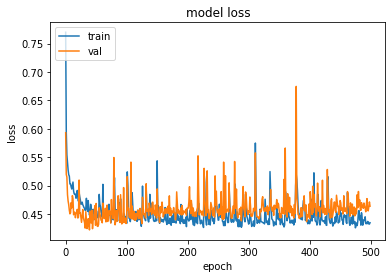

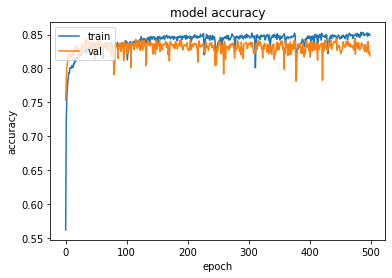

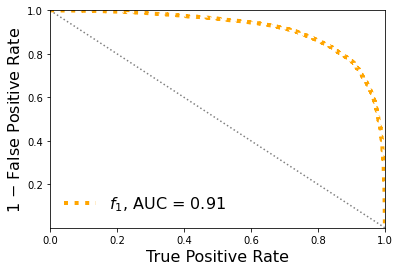

313/313 [==============================] - 2s 6ms/step - loss: 0.4630 - acc: 0.8249 - f1_m: 0.4328 - precision_m: 0.5000 - recall_m: 0.3833
Test ROC-AUC: 0.9145067600000001
Test loss: 0.46296826004981995
Test accuracy: 0.8248999714851379
Test f1: 0.43280595541000366
Test precision: 0.5
Test recall: 0.3832867443561554
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 117ms/step - loss: 0.8737 - acc: 0.5104 - f1_m: 0.2713 - precision_m: 0.5297 - recall_m: 0.2091 - val_loss: 0.7220 - val_acc: 0.7152 - val_f1_m: 0.6665 - val_precision_m: 0.7933 - val_recall_m: 0.5776
Epoch 2/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6802 - acc: 0.6237 - f1_m: 0.6106 - precision_m: 0.6302 - recall_m: 0.6101 - val_loss: 0.5734 - val_acc: 0.7605 - val_f1_m: 0.7519 - val_precision_m: 0.7731 - val_

188/188 [==============================] - 21s 114ms/step - loss: 0.4359 - acc: 0.8508 - f1_m: 0.8559 - precision_m: 0.8348 - recall_m: 0.8811 - val_loss: 0.4396 - val_acc: 0.8305 - val_f1_m: 0.8229 - val_precision_m: 0.8520 - val_recall_m: 0.7986
Epoch 62/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4299 - acc: 0.8431 - f1_m: 0.8483 - precision_m: 0.8264 - recall_m: 0.8757 - val_loss: 0.4319 - val_acc: 0.8435 - val_f1_m: 0.8521 - val_precision_m: 0.8000 - val_recall_m: 0.9141
Epoch 63/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4283 - acc: 0.8425 - f1_m: 0.8454 - precision_m: 0.8238 - recall_m: 0.8736 - val_loss: 0.4461 - val_acc: 0.8320 - val_f1_m: 0.8197 - val_precision_m: 0.8729 - val_recall_m: 0.7755
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4190 - acc: 0.8509 - f1_m: 0.8532 - precision_m: 0.8339 - recall_m: 0.8773 - val_loss: 0.4239 - val_acc: 0.8378 - val_f1_m: 0.8392 - val_precision_m:

188/188 [==============================] - 21s 114ms/step - loss: 0.4231 - acc: 0.8499 - f1_m: 0.8542 - precision_m: 0.8374 - recall_m: 0.8746 - val_loss: 0.4477 - val_acc: 0.8342 - val_f1_m: 0.8413 - val_precision_m: 0.7994 - val_recall_m: 0.8909
Epoch 124/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4284 - acc: 0.8408 - f1_m: 0.8436 - precision_m: 0.8258 - recall_m: 0.8669 - val_loss: 0.4568 - val_acc: 0.8315 - val_f1_m: 0.8269 - val_precision_m: 0.8424 - val_recall_m: 0.8153
Epoch 125/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4238 - acc: 0.8496 - f1_m: 0.8533 - precision_m: 0.8350 - recall_m: 0.8765 - val_loss: 0.4534 - val_acc: 0.8365 - val_f1_m: 0.8398 - val_precision_m: 0.8182 - val_recall_m: 0.8655
Epoch 126/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4618 - acc: 0.8473 - f1_m: 0.8489 - precision_m: 0.8353 - recall_m: 0.8713 - val_loss: 0.5085 - val_acc: 0.8270 - val_f1_m: 0.8371 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.8467 - acc: 0.5038 - f1_m: 0.6520 - precision_m: 0.5047 - recall_m: 0.9357 - val_loss: 0.8167 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 186/500
188/188 [==============================] - 21s 114ms/step - loss: 0.8101 - acc: 0.4994 - f1_m: 0.5788 - precision_m: 0.5046 - recall_m: 0.7193 - val_loss: 0.7869 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precision_m: 0.4970 - val_recall_m: 1.0000
Epoch 187/500
188/188 [==============================] - 22s 114ms/step - loss: 0.8001 - acc: 0.5063 - f1_m: 0.6434 - precision_m: 0.5060 - recall_m: 0.8991 - val_loss: 0.7388 - val_acc: 0.7618 - val_f1_m: 0.7952 - val_precision_m: 0.6931 - val_recall_m: 0.9353
Epoch 188/500
188/188 [==============================] - 21s 114ms/step - loss: 0.6632 - acc: 0.7785 - f1_m: 0.7819 - precision_m: 0.7683 - recall_m: 0.8049 - val_loss: 0.5093 - val_acc: 0.8347 - val_f1_m: 0.8379 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4286 - acc: 0.8421 - f1_m: 0.8428 - precision_m: 0.8354 - recall_m: 0.8546 - val_loss: 0.4407 - val_acc: 0.8325 - val_f1_m: 0.8337 - val_precision_m: 0.8222 - val_recall_m: 0.8486
Epoch 248/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4328 - acc: 0.8423 - f1_m: 0.8438 - precision_m: 0.8339 - recall_m: 0.8593 - val_loss: 0.5871 - val_acc: 0.8058 - val_f1_m: 0.7887 - val_precision_m: 0.8570 - val_recall_m: 0.7333
Epoch 249/500
188/188 [==============================] - 22s 115ms/step - loss: 0.5380 - acc: 0.8270 - f1_m: 0.8274 - precision_m: 0.8228 - recall_m: 0.8357 - val_loss: 0.4886 - val_acc: 0.8355 - val_f1_m: 0.8407 - val_precision_m: 0.8077 - val_recall_m: 0.8794
Epoch 250/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4694 - acc: 0.8462 - f1_m: 0.8467 - precision_m: 0.8368 - recall_m: 0.8604 - val_loss: 0.4695 - val_acc: 0.8305 - val_f1_m: 0.8236 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4343 - acc: 0.8528 - f1_m: 0.8536 - precision_m: 0.8405 - recall_m: 0.8708 - val_loss: 0.4901 - val_acc: 0.8337 - val_f1_m: 0.8330 - val_precision_m: 0.8291 - val_recall_m: 0.8403
Epoch 310/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4095 - acc: 0.8632 - f1_m: 0.8652 - precision_m: 0.8580 - recall_m: 0.8751 - val_loss: 0.4684 - val_acc: 0.8340 - val_f1_m: 0.8401 - val_precision_m: 0.8037 - val_recall_m: 0.8831
Epoch 311/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4093 - acc: 0.8623 - f1_m: 0.8631 - precision_m: 0.8529 - recall_m: 0.8766 - val_loss: 0.4708 - val_acc: 0.8273 - val_f1_m: 0.8268 - val_precision_m: 0.8220 - val_recall_m: 0.8347
Epoch 312/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4061 - acc: 0.8620 - f1_m: 0.8623 - precision_m: 0.8570 - recall_m: 0.8711 - val_loss: 0.4646 - val_acc: 0.8330 - val_f1_m: 0.8296 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4236 - acc: 0.8589 - f1_m: 0.8596 - precision_m: 0.8601 - recall_m: 0.8628 - val_loss: 0.4724 - val_acc: 0.8340 - val_f1_m: 0.8333 - val_precision_m: 0.8310 - val_recall_m: 0.8382
Epoch 372/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4236 - acc: 0.8581 - f1_m: 0.8583 - precision_m: 0.8562 - recall_m: 0.8635 - val_loss: 0.4608 - val_acc: 0.8352 - val_f1_m: 0.8303 - val_precision_m: 0.8480 - val_recall_m: 0.8170
Epoch 373/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4115 - acc: 0.8628 - f1_m: 0.8625 - precision_m: 0.8623 - recall_m: 0.8662 - val_loss: 0.4603 - val_acc: 0.8302 - val_f1_m: 0.8291 - val_precision_m: 0.8285 - val_recall_m: 0.8329
Epoch 374/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4121 - acc: 0.8614 - f1_m: 0.8618 - precision_m: 0.8607 - recall_m: 0.8661 - val_loss: 0.4696 - val_acc: 0.8220 - val_f1_m: 0.8086 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4743 - acc: 0.8489 - f1_m: 0.8496 - precision_m: 0.8355 - recall_m: 0.8672 - val_loss: 0.4825 - val_acc: 0.8308 - val_f1_m: 0.8304 - val_precision_m: 0.8254 - val_recall_m: 0.8391
Epoch 434/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4276 - acc: 0.8617 - f1_m: 0.8637 - precision_m: 0.8472 - recall_m: 0.8843 - val_loss: 0.4914 - val_acc: 0.8243 - val_f1_m: 0.8145 - val_precision_m: 0.8530 - val_recall_m: 0.7822
Epoch 435/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4224 - acc: 0.8589 - f1_m: 0.8588 - precision_m: 0.8506 - recall_m: 0.8713 - val_loss: 0.4803 - val_acc: 0.8317 - val_f1_m: 0.8363 - val_precision_m: 0.8074 - val_recall_m: 0.8701
Epoch 436/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4276 - acc: 0.8602 - f1_m: 0.8612 - precision_m: 0.8510 - recall_m: 0.8744 - val_loss: 0.4817 - val_acc: 0.8225 - val_f1_m: 0.8182 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4005 - acc: 0.8649 - f1_m: 0.8654 - precision_m: 0.8594 - recall_m: 0.8746 - val_loss: 0.4655 - val_acc: 0.8273 - val_f1_m: 0.8233 - val_precision_m: 0.8373 - val_recall_m: 0.8128
Epoch 496/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4115 - acc: 0.8610 - f1_m: 0.8630 - precision_m: 0.8555 - recall_m: 0.8757 - val_loss: 0.4651 - val_acc: 0.8353 - val_f1_m: 0.8370 - val_precision_m: 0.8228 - val_recall_m: 0.8547
Epoch 497/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4088 - acc: 0.8606 - f1_m: 0.8613 - precision_m: 0.8522 - recall_m: 0.8731 - val_loss: 0.4866 - val_acc: 0.8210 - val_f1_m: 0.8084 - val_precision_m: 0.8596 - val_recall_m: 0.7653
Epoch 498/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4024 - acc: 0.8632 - f1_m: 0.8641 - precision_m: 0.8589 - recall_m: 0.8734 - val_loss: 0.4702 - val_acc: 0.8327 - val_f1_m: 0.8336 - val_precision

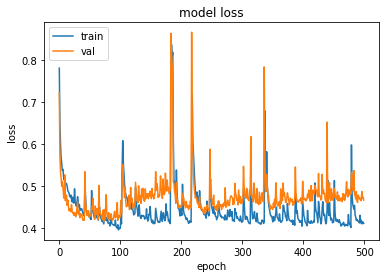

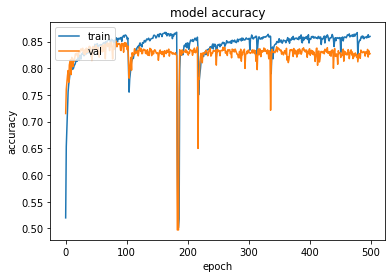

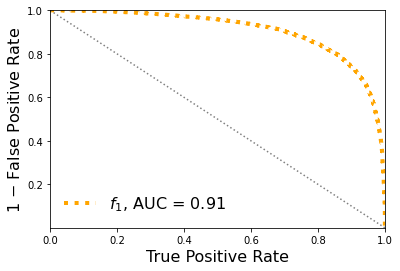

313/313 [==============================] - 2s 6ms/step - loss: 0.4687 - acc: 0.8253 - f1_m: 0.4537 - precision_m: 0.5001 - recall_m: 0.4165
Test ROC-AUC: 0.90651652
Test loss: 0.4686833918094635
Test accuracy: 0.8252999782562256
Test f1: 0.4536893665790558
Test precision: 0.5001451969146729
Test recall: 0.41653355956077576
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 253ms/step - loss: 1.0330 - acc: 0.5070 - f1_m: 0.2791 - precision_m: 0.5177 - recall_m: 0.2314 - val_loss: 0.7525 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
94/94 [==============================] - 23s 243ms/step - loss: 0.6905 - acc: 0.6239 - f1_m: 0.5461 - precision_m: 0.6633 - recall_m: 0.5647 - val_loss: 0.5554 - val_acc: 0.7803 - val_f1_m: 0.7892 - val_precision_m:

Epoch 31/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4312 - acc: 0.8502 - f1_m: 0.8524 - precision_m: 0.8411 - recall_m: 0.8664 - val_loss: 0.4195 - val_acc: 0.8458 - val_f1_m: 0.8472 - val_precision_m: 0.8280 - val_recall_m: 0.8690
Epoch 32/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4330 - acc: 0.8445 - f1_m: 0.8467 - precision_m: 0.8326 - recall_m: 0.8652 - val_loss: 0.4220 - val_acc: 0.8448 - val_f1_m: 0.8482 - val_precision_m: 0.8199 - val_recall_m: 0.8802
Epoch 33/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4330 - acc: 0.8477 - f1_m: 0.8509 - precision_m: 0.8341 - recall_m: 0.8712 - val_loss: 0.4272 - val_acc: 0.8377 - val_f1_m: 0.8296 - val_precision_m: 0.8593 - val_recall_m: 0.8035
Epoch 34/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4391 - acc: 0.8431 - f1_m: 0.8461 - precision_m: 0.8337 - recall_m: 0.8632 - val_loss: 0.4167 - val_acc: 0.8477 - val_f1_m: 0.8501 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4395 - acc: 0.8490 - f1_m: 0.8522 - precision_m: 0.8355 - recall_m: 0.8724 - val_loss: 0.4423 - val_acc: 0.8377 - val_f1_m: 0.8357 - val_precision_m: 0.8364 - val_recall_m: 0.8367
Epoch 64/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4339 - acc: 0.8520 - f1_m: 0.8521 - precision_m: 0.8384 - recall_m: 0.8681 - val_loss: 0.4386 - val_acc: 0.8372 - val_f1_m: 0.8378 - val_precision_m: 0.8240 - val_recall_m: 0.8534
Epoch 65/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4304 - acc: 0.8532 - f1_m: 0.8558 - precision_m: 0.8436 - recall_m: 0.8707 - val_loss: 0.4376 - val_acc: 0.8430 - val_f1_m: 0.8474 - val_precision_m: 0.8126 - val_recall_m: 0.8871
Epoch 66/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4280 - acc: 0.8537 - f1_m: 0.8572 - precision_m: 0.8381 - recall_m: 0.8794 - val_loss: 0.4379 - val_acc: 0.8378 - val_f1_m: 0.8357 - val_precisi

Epoch 95/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3878 - acc: 0.8698 - f1_m: 0.8735 - precision_m: 0.8584 - recall_m: 0.8911 - val_loss: 0.4443 - val_acc: 0.8400 - val_f1_m: 0.8450 - val_precision_m: 0.8102 - val_recall_m: 0.8845
Epoch 96/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3954 - acc: 0.8712 - f1_m: 0.8742 - precision_m: 0.8583 - recall_m: 0.8925 - val_loss: 0.4542 - val_acc: 0.8363 - val_f1_m: 0.8433 - val_precision_m: 0.7986 - val_recall_m: 0.8950
Epoch 97/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3896 - acc: 0.8708 - f1_m: 0.8737 - precision_m: 0.8566 - recall_m: 0.8940 - val_loss: 0.4463 - val_acc: 0.8412 - val_f1_m: 0.8431 - val_precision_m: 0.8236 - val_recall_m: 0.8652
Epoch 98/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3908 - acc: 0.8695 - f1_m: 0.8707 - precision_m: 0.8555 - recall_m: 0.8881 - val_loss: 0.4477 - val_acc: 0.8367 - val_f1_m: 0.8358 - val_precisi

94/94 [==============================] - 22s 237ms/step - loss: 0.3771 - acc: 0.8768 - f1_m: 0.8790 - precision_m: 0.8630 - recall_m: 0.8971 - val_loss: 0.4771 - val_acc: 0.8275 - val_f1_m: 0.8301 - val_precision_m: 0.8063 - val_recall_m: 0.8568
Epoch 158/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3691 - acc: 0.8785 - f1_m: 0.8804 - precision_m: 0.8673 - recall_m: 0.8955 - val_loss: 0.4831 - val_acc: 0.8302 - val_f1_m: 0.8287 - val_precision_m: 0.8269 - val_recall_m: 0.8325
Epoch 159/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4164 - acc: 0.8641 - f1_m: 0.8669 - precision_m: 0.8530 - recall_m: 0.8837 - val_loss: 0.5178 - val_acc: 0.8212 - val_f1_m: 0.8150 - val_precision_m: 0.8274 - val_recall_m: 0.8043
Epoch 160/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4027 - acc: 0.8700 - f1_m: 0.8705 - precision_m: 0.8603 - recall_m: 0.8830 - val_loss: 0.5128 - val_acc: 0.8080 - val_f1_m: 0.8119 - val_precision_m: 0.78

94/94 [==============================] - 22s 237ms/step - loss: 0.3785 - acc: 0.8773 - f1_m: 0.8791 - precision_m: 0.8632 - recall_m: 0.8970 - val_loss: 0.4760 - val_acc: 0.8278 - val_f1_m: 0.8255 - val_precision_m: 0.8312 - val_recall_m: 0.8217
Epoch 220/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3804 - acc: 0.8779 - f1_m: 0.8789 - precision_m: 0.8584 - recall_m: 0.9021 - val_loss: 0.5059 - val_acc: 0.8297 - val_f1_m: 0.8306 - val_precision_m: 0.8212 - val_recall_m: 0.8419
Epoch 221/500
94/94 [==============================] - 22s 238ms/step - loss: 0.3736 - acc: 0.8789 - f1_m: 0.8799 - precision_m: 0.8645 - recall_m: 0.8976 - val_loss: 0.4938 - val_acc: 0.8252 - val_f1_m: 0.8262 - val_precision_m: 0.8130 - val_recall_m: 0.8412
Epoch 222/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3909 - acc: 0.8691 - f1_m: 0.8708 - precision_m: 0.8580 - recall_m: 0.8860 - val_loss: 0.4918 - val_acc: 0.8290 - val_f1_m: 0.8326 - val_precision_m: 0.80

94/94 [==============================] - 22s 238ms/step - loss: 0.3670 - acc: 0.8839 - f1_m: 0.8854 - precision_m: 0.8718 - recall_m: 0.9011 - val_loss: 0.4918 - val_acc: 0.8223 - val_f1_m: 0.8153 - val_precision_m: 0.8369 - val_recall_m: 0.7965
Epoch 282/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3706 - acc: 0.8816 - f1_m: 0.8837 - precision_m: 0.8665 - recall_m: 0.9032 - val_loss: 0.4930 - val_acc: 0.8302 - val_f1_m: 0.8305 - val_precision_m: 0.8182 - val_recall_m: 0.8448
Epoch 283/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3769 - acc: 0.8797 - f1_m: 0.8814 - precision_m: 0.8653 - recall_m: 0.9003 - val_loss: 0.5179 - val_acc: 0.8163 - val_f1_m: 0.8222 - val_precision_m: 0.7880 - val_recall_m: 0.8610
Epoch 284/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4336 - acc: 0.8543 - f1_m: 0.8572 - precision_m: 0.8387 - recall_m: 0.8786 - val_loss: 0.4991 - val_acc: 0.8315 - val_f1_m: 0.8334 - val_precision_m: 0.81

94/94 [==============================] - 22s 236ms/step - loss: 0.4136 - acc: 0.8594 - f1_m: 0.8611 - precision_m: 0.8551 - recall_m: 0.8698 - val_loss: 0.4969 - val_acc: 0.8200 - val_f1_m: 0.8288 - val_precision_m: 0.7821 - val_recall_m: 0.8832
Epoch 344/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4111 - acc: 0.8608 - f1_m: 0.8614 - precision_m: 0.8486 - recall_m: 0.8778 - val_loss: 0.4865 - val_acc: 0.8255 - val_f1_m: 0.8240 - val_precision_m: 0.8222 - val_recall_m: 0.8276
Epoch 345/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4007 - acc: 0.8601 - f1_m: 0.8610 - precision_m: 0.8527 - recall_m: 0.8708 - val_loss: 0.4998 - val_acc: 0.8183 - val_f1_m: 0.8048 - val_precision_m: 0.8562 - val_recall_m: 0.7613
Epoch 346/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4290 - acc: 0.8574 - f1_m: 0.8570 - precision_m: 0.8510 - recall_m: 0.8680 - val_loss: 0.5286 - val_acc: 0.8207 - val_f1_m: 0.8292 - val_precision_m: 0.78

94/94 [==============================] - 22s 236ms/step - loss: 0.3946 - acc: 0.8549 - f1_m: 0.8575 - precision_m: 0.8415 - recall_m: 0.8770 - val_loss: 0.4313 - val_acc: 0.8360 - val_f1_m: 0.8352 - val_precision_m: 0.8279 - val_recall_m: 0.8444
Epoch 406/500
94/94 [==============================] - 22s 236ms/step - loss: 0.3947 - acc: 0.8576 - f1_m: 0.8624 - precision_m: 0.8396 - recall_m: 0.8892 - val_loss: 0.4305 - val_acc: 0.8385 - val_f1_m: 0.8451 - val_precision_m: 0.8061 - val_recall_m: 0.8894
Epoch 407/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4016 - acc: 0.8513 - f1_m: 0.8582 - precision_m: 0.8281 - recall_m: 0.8937 - val_loss: 0.4364 - val_acc: 0.8402 - val_f1_m: 0.8470 - val_precision_m: 0.8044 - val_recall_m: 0.8957
Epoch 408/500
94/94 [==============================] - 22s 235ms/step - loss: 0.4061 - acc: 0.8514 - f1_m: 0.8557 - precision_m: 0.8352 - recall_m: 0.8827 - val_loss: 0.4378 - val_acc: 0.8388 - val_f1_m: 0.8399 - val_precision_m: 0.82

94/94 [==============================] - 22s 233ms/step - loss: 0.3826 - acc: 0.8660 - f1_m: 0.8614 - precision_m: 0.8845 - recall_m: 0.8421 - val_loss: 0.7282 - val_acc: 0.6062 - val_f1_m: 0.3524 - val_precision_m: 0.9640 - val_recall_m: 0.2174
Epoch 468/500
94/94 [==============================] - 22s 233ms/step - loss: 0.5683 - acc: 0.7646 - f1_m: 0.7368 - precision_m: 0.8140 - recall_m: 0.7171 - val_loss: 0.5317 - val_acc: 0.8093 - val_f1_m: 0.8085 - val_precision_m: 0.8017 - val_recall_m: 0.8167
Epoch 469/500
94/94 [==============================] - 22s 233ms/step - loss: 0.4737 - acc: 0.8236 - f1_m: 0.8318 - precision_m: 0.8095 - recall_m: 0.8580 - val_loss: 0.4897 - val_acc: 0.8180 - val_f1_m: 0.8094 - val_precision_m: 0.8403 - val_recall_m: 0.7825
Epoch 470/500
94/94 [==============================] - 22s 234ms/step - loss: 0.4359 - acc: 0.8465 - f1_m: 0.8433 - precision_m: 0.8625 - recall_m: 0.8281 - val_loss: 0.4803 - val_acc: 0.8323 - val_f1_m: 0.8353 - val_precision_m: 0.81

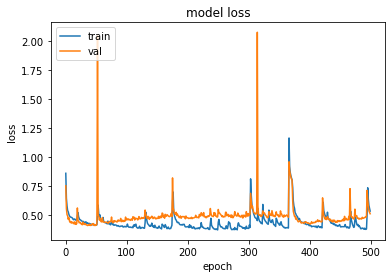

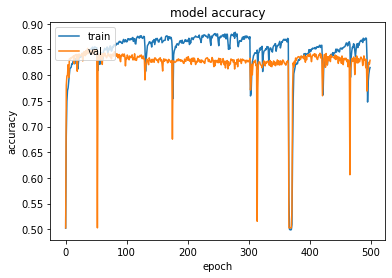

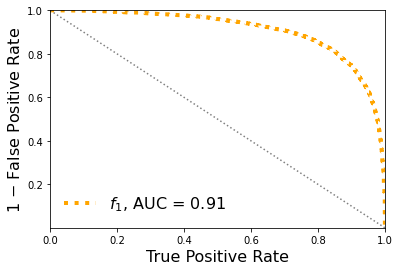

313/313 [==============================] - 2s 6ms/step - loss: 0.5182 - acc: 0.8250 - f1_m: 0.4682 - precision_m: 0.4997 - recall_m: 0.4415
Test ROC-AUC: 0.9081830999999999
Test loss: 0.5181558132171631
Test accuracy: 0.824999988079071
Test f1: 0.46824923157691956
Test precision: 0.4997337758541107
Test recall: 0.44149360060691833
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 1.2962 - acc: 0.5888 - f1_m: 0.6098 - precision_m: 0.5770 - recall_m: 0.6762 - val_loss: 0.6270 - val_acc: 0.7448 - val_f1_m: 0.7799 - val_precision_m: 0.6783 - val_recall_m: 0.9232
Epoch 2/500
375/375 [==============================] - 23s 61ms/step - loss: 0.6488 - acc: 0.7338 - f1_m: 0.7545 - precision_m: 0.7066 - recall_m: 0.8196 - val_loss: 0.5994 - val_acc: 0.7568 - val_f1_m: 0.7906 - val_precision_m: 0.6

Epoch 31/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4827 - acc: 0.8230 - f1_m: 0.8264 - precision_m: 0.8125 - recall_m: 0.8507 - val_loss: 0.5007 - val_acc: 0.8165 - val_f1_m: 0.8054 - val_precision_m: 0.8447 - val_recall_m: 0.7750
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.5026 - acc: 0.8172 - f1_m: 0.8189 - precision_m: 0.8078 - recall_m: 0.8414 - val_loss: 0.4471 - val_acc: 0.8337 - val_f1_m: 0.8424 - val_precision_m: 0.7902 - val_recall_m: 0.9073
Epoch 33/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4817 - acc: 0.8218 - f1_m: 0.8270 - precision_m: 0.7973 - recall_m: 0.8667 - val_loss: 0.4820 - val_acc: 0.8267 - val_f1_m: 0.8300 - val_precision_m: 0.8056 - val_recall_m: 0.8618
Epoch 34/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4850 - acc: 0.8247 - f1_m: 0.8298 - precision_m: 0.8109 - recall_m: 0.8589 - val_loss: 0.4564 - val_acc: 0.8315 - val_f1_m: 0.8261 - val_pre

375/375 [==============================] - 23s 60ms/step - loss: 0.4736 - acc: 0.8285 - f1_m: 0.8316 - precision_m: 0.8117 - recall_m: 0.8616 - val_loss: 0.4949 - val_acc: 0.7973 - val_f1_m: 0.8244 - val_precision_m: 0.7187 - val_recall_m: 0.9725
Epoch 94/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4743 - acc: 0.8242 - f1_m: 0.8280 - precision_m: 0.8098 - recall_m: 0.8570 - val_loss: 0.4331 - val_acc: 0.8420 - val_f1_m: 0.8409 - val_precision_m: 0.8365 - val_recall_m: 0.8498
Epoch 95/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4815 - acc: 0.8209 - f1_m: 0.8255 - precision_m: 0.8052 - recall_m: 0.8592 - val_loss: 0.4827 - val_acc: 0.8163 - val_f1_m: 0.8358 - val_precision_m: 0.7471 - val_recall_m: 0.9544
Epoch 96/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4789 - acc: 0.8299 - f1_m: 0.8323 - precision_m: 0.8179 - recall_m: 0.8582 - val_loss: 0.4426 - val_acc: 0.8463 - val_f1_m: 0.8512 - val_precision_m: 0.8

375/375 [==============================] - 22s 60ms/step - loss: 0.4843 - acc: 0.8246 - f1_m: 0.8262 - precision_m: 0.8063 - recall_m: 0.8592 - val_loss: 0.4358 - val_acc: 0.8432 - val_f1_m: 0.8510 - val_precision_m: 0.7997 - val_recall_m: 0.9139
Epoch 156/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4625 - acc: 0.8295 - f1_m: 0.8336 - precision_m: 0.8133 - recall_m: 0.8637 - val_loss: 0.4521 - val_acc: 0.8332 - val_f1_m: 0.8265 - val_precision_m: 0.8500 - val_recall_m: 0.8086
Epoch 157/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4673 - acc: 0.8372 - f1_m: 0.8391 - precision_m: 0.8236 - recall_m: 0.8638 - val_loss: 0.4904 - val_acc: 0.8085 - val_f1_m: 0.8303 - val_precision_m: 0.7365 - val_recall_m: 0.9567
Epoch 158/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4632 - acc: 0.8340 - f1_m: 0.8370 - precision_m: 0.8187 - recall_m: 0.8644 - val_loss: 0.4361 - val_acc: 0.8390 - val_f1_m: 0.8342 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4633 - acc: 0.8355 - f1_m: 0.8375 - precision_m: 0.8181 - recall_m: 0.8669 - val_loss: 0.4180 - val_acc: 0.8492 - val_f1_m: 0.8544 - val_precision_m: 0.8147 - val_recall_m: 0.9031
Epoch 218/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4708 - acc: 0.8293 - f1_m: 0.8328 - precision_m: 0.8145 - recall_m: 0.8627 - val_loss: 0.4799 - val_acc: 0.8303 - val_f1_m: 0.8428 - val_precision_m: 0.7751 - val_recall_m: 0.9281
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4657 - acc: 0.8301 - f1_m: 0.8347 - precision_m: 0.8112 - recall_m: 0.8680 - val_loss: 0.4193 - val_acc: 0.8500 - val_f1_m: 0.8533 - val_precision_m: 0.8246 - val_recall_m: 0.8884
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4500 - acc: 0.8385 - f1_m: 0.8420 - precision_m: 0.8223 - recall_m: 0.8708 - val_loss: 0.4183 - val_acc: 0.8458 - val_f1_m: 0.8466 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4735 - acc: 0.8269 - f1_m: 0.8312 - precision_m: 0.8178 - recall_m: 0.8570 - val_loss: 0.4236 - val_acc: 0.8473 - val_f1_m: 0.8491 - val_precision_m: 0.8290 - val_recall_m: 0.8746
Epoch 280/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4670 - acc: 0.8352 - f1_m: 0.8365 - precision_m: 0.8182 - recall_m: 0.8638 - val_loss: 0.4302 - val_acc: 0.8457 - val_f1_m: 0.8462 - val_precision_m: 0.8311 - val_recall_m: 0.8663
Epoch 281/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4720 - acc: 0.8276 - f1_m: 0.8307 - precision_m: 0.8117 - recall_m: 0.8598 - val_loss: 0.4674 - val_acc: 0.8320 - val_f1_m: 0.8314 - val_precision_m: 0.8215 - val_recall_m: 0.8457
Epoch 282/500
375/375 [==============================] - 23s 60ms/step - loss: 0.5097 - acc: 0.8166 - f1_m: 0.8202 - precision_m: 0.8053 - recall_m: 0.8516 - val_loss: 0.4211 - val_acc: 0.8497 - val_f1_m: 0.8566 - val_precision_m: 

375/375 [==============================] - 23s 60ms/step - loss: 0.4782 - acc: 0.8314 - f1_m: 0.8329 - precision_m: 0.8183 - recall_m: 0.8574 - val_loss: 0.4393 - val_acc: 0.8475 - val_f1_m: 0.8517 - val_precision_m: 0.8196 - val_recall_m: 0.8909
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4827 - acc: 0.8262 - f1_m: 0.8301 - precision_m: 0.8145 - recall_m: 0.8606 - val_loss: 0.4587 - val_acc: 0.8393 - val_f1_m: 0.8389 - val_precision_m: 0.8288 - val_recall_m: 0.8536
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4430 - acc: 0.8415 - f1_m: 0.8430 - precision_m: 0.8282 - recall_m: 0.8664 - val_loss: 0.4397 - val_acc: 0.8438 - val_f1_m: 0.8515 - val_precision_m: 0.8024 - val_recall_m: 0.9110
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4492 - acc: 0.8415 - f1_m: 0.8430 - precision_m: 0.8251 - recall_m: 0.8702 - val_loss: 0.4245 - val_acc: 0.8520 - val_f1_m: 0.8565 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4739 - acc: 0.8302 - f1_m: 0.8336 - precision_m: 0.8177 - recall_m: 0.8592 - val_loss: 0.4233 - val_acc: 0.8507 - val_f1_m: 0.8516 - val_precision_m: 0.8347 - val_recall_m: 0.8739
Epoch 404/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4540 - acc: 0.8401 - f1_m: 0.8439 - precision_m: 0.8295 - recall_m: 0.8666 - val_loss: 0.4395 - val_acc: 0.8488 - val_f1_m: 0.8528 - val_precision_m: 0.8172 - val_recall_m: 0.8957
Epoch 405/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4550 - acc: 0.8384 - f1_m: 0.8413 - precision_m: 0.8259 - recall_m: 0.8643 - val_loss: 0.4361 - val_acc: 0.8508 - val_f1_m: 0.8526 - val_precision_m: 0.8298 - val_recall_m: 0.8814
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.5560 - acc: 0.8004 - f1_m: 0.8042 - precision_m: 0.8003 - recall_m: 0.8349 - val_loss: 0.4183 - val_acc: 0.8478 - val_f1_m: 0.8498 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4712 - acc: 0.8351 - f1_m: 0.8377 - precision_m: 0.8160 - recall_m: 0.8678 - val_loss: 0.4847 - val_acc: 0.8027 - val_f1_m: 0.8276 - val_precision_m: 0.7252 - val_recall_m: 0.9694
Epoch 466/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4806 - acc: 0.8276 - f1_m: 0.8326 - precision_m: 0.8113 - recall_m: 0.8669 - val_loss: 0.4500 - val_acc: 0.8307 - val_f1_m: 0.8446 - val_precision_m: 0.7697 - val_recall_m: 0.9407
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4639 - acc: 0.8361 - f1_m: 0.8380 - precision_m: 0.8224 - recall_m: 0.8625 - val_loss: 0.4139 - val_acc: 0.8503 - val_f1_m: 0.8515 - val_precision_m: 0.8346 - val_recall_m: 0.8736
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4387 - acc: 0.8424 - f1_m: 0.8428 - precision_m: 0.8314 - recall_m: 0.8616 - val_loss: 0.4330 - val_acc: 0.8380 - val_f1_m: 0.8515 - val_precision_m: 

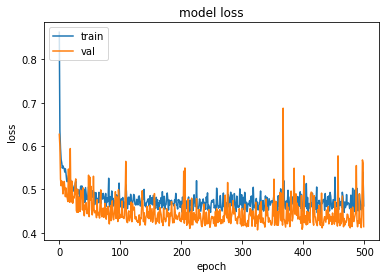

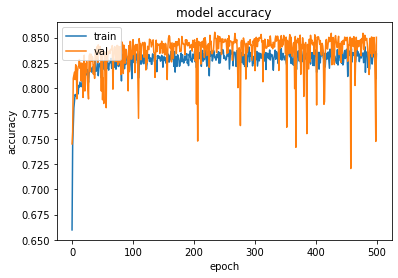

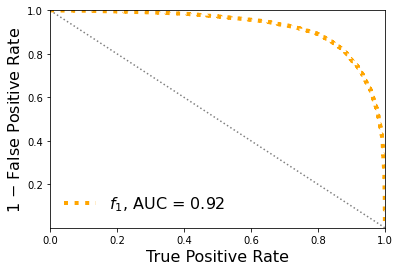

313/313 [==============================] - 2s 6ms/step - loss: 0.4280 - acc: 0.8429 - f1_m: 0.4703 - precision_m: 0.5001 - recall_m: 0.4451
Test ROC-AUC: 0.92407956
Test loss: 0.4279736876487732
Test accuracy: 0.8428999781608582
Test f1: 0.470336377620697
Test precision: 0.5001229047775269
Test recall: 0.44508785009384155
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 119ms/step - loss: 1.1457 - acc: 0.5101 - f1_m: 0.4454 - precision_m: 0.5119 - recall_m: 0.4351 - val_loss: 0.6977 - val_acc: 0.7438 - val_f1_m: 0.7712 - val_precision_m: 0.6925 - val_recall_m: 0.8730
Epoch 2/500
188/188 [==============================] - 22s 115ms/step - loss: 0.6833 - acc: 0.6865 - f1_m: 0.6796 - precision_m: 0.7012 - recall_m: 0.6732 - val_loss: 0.5760 - val_acc: 0.7715 - val_f1_m: 0.7861 - val_precision_m: 0.7329 - 

188/188 [==============================] - 22s 115ms/step - loss: 0.4559 - acc: 0.8374 - f1_m: 0.8357 - precision_m: 0.8283 - recall_m: 0.8488 - val_loss: 0.4240 - val_acc: 0.8502 - val_f1_m: 0.8507 - val_precision_m: 0.8393 - val_recall_m: 0.8655
Epoch 62/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4471 - acc: 0.8416 - f1_m: 0.8446 - precision_m: 0.8379 - recall_m: 0.8563 - val_loss: 0.4270 - val_acc: 0.8503 - val_f1_m: 0.8491 - val_precision_m: 0.8482 - val_recall_m: 0.8527
Epoch 63/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4616 - acc: 0.8370 - f1_m: 0.8360 - precision_m: 0.8315 - recall_m: 0.8497 - val_loss: 0.4809 - val_acc: 0.8257 - val_f1_m: 0.8380 - val_precision_m: 0.7774 - val_recall_m: 0.9119
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4708 - acc: 0.8316 - f1_m: 0.8353 - precision_m: 0.8221 - recall_m: 0.8561 - val_loss: 0.4518 - val_acc: 0.8330 - val_f1_m: 0.8207 - val_precision_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4272 - acc: 0.8499 - f1_m: 0.8481 - precision_m: 0.8487 - recall_m: 0.8520 - val_loss: 0.4416 - val_acc: 0.8392 - val_f1_m: 0.8335 - val_precision_m: 0.8571 - val_recall_m: 0.8141
Epoch 124/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4595 - acc: 0.8373 - f1_m: 0.8336 - precision_m: 0.8401 - recall_m: 0.8359 - val_loss: 0.4400 - val_acc: 0.8533 - val_f1_m: 0.8545 - val_precision_m: 0.8408 - val_recall_m: 0.8714
Epoch 125/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4450 - acc: 0.8502 - f1_m: 0.8488 - precision_m: 0.8531 - recall_m: 0.8507 - val_loss: 0.4274 - val_acc: 0.8337 - val_f1_m: 0.8220 - val_precision_m: 0.8761 - val_recall_m: 0.7774
Epoch 126/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4260 - acc: 0.8540 - f1_m: 0.8535 - precision_m: 0.8523 - recall_m: 0.8588 - val_loss: 0.4338 - val_acc: 0.8497 - val_f1_m: 0.8563 - val_precision

188/188 [==============================] - 22s 116ms/step - loss: 0.4566 - acc: 0.8384 - f1_m: 0.8368 - precision_m: 0.8467 - recall_m: 0.8340 - val_loss: 0.4221 - val_acc: 0.8522 - val_f1_m: 0.8564 - val_precision_m: 0.8258 - val_recall_m: 0.8920
Epoch 186/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4370 - acc: 0.8490 - f1_m: 0.8481 - precision_m: 0.8493 - recall_m: 0.8519 - val_loss: 0.4008 - val_acc: 0.8528 - val_f1_m: 0.8496 - val_precision_m: 0.8588 - val_recall_m: 0.8432
Epoch 187/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4156 - acc: 0.8562 - f1_m: 0.8569 - precision_m: 0.8540 - recall_m: 0.8640 - val_loss: 0.4081 - val_acc: 0.8537 - val_f1_m: 0.8574 - val_precision_m: 0.8291 - val_recall_m: 0.8907
Epoch 188/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4143 - acc: 0.8578 - f1_m: 0.8565 - precision_m: 0.8561 - recall_m: 0.8605 - val_loss: 0.4094 - val_acc: 0.8437 - val_f1_m: 0.8369 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4736 - acc: 0.8314 - f1_m: 0.8262 - precision_m: 0.8403 - recall_m: 0.8267 - val_loss: 0.4108 - val_acc: 0.8498 - val_f1_m: 0.8456 - val_precision_m: 0.8636 - val_recall_m: 0.8310
Epoch 248/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4222 - acc: 0.8561 - f1_m: 0.8553 - precision_m: 0.8537 - recall_m: 0.8610 - val_loss: 0.4477 - val_acc: 0.8368 - val_f1_m: 0.8260 - val_precision_m: 0.8761 - val_recall_m: 0.7844
Epoch 249/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4351 - acc: 0.8491 - f1_m: 0.8467 - precision_m: 0.8472 - recall_m: 0.8519 - val_loss: 0.4339 - val_acc: 0.8508 - val_f1_m: 0.8554 - val_precision_m: 0.8231 - val_recall_m: 0.8929
Epoch 250/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4320 - acc: 0.8490 - f1_m: 0.8471 - precision_m: 0.8500 - recall_m: 0.8494 - val_loss: 0.4153 - val_acc: 0.8453 - val_f1_m: 0.8388 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4242 - acc: 0.8476 - f1_m: 0.8458 - precision_m: 0.8504 - recall_m: 0.8461 - val_loss: 0.4013 - val_acc: 0.8505 - val_f1_m: 0.8470 - val_precision_m: 0.8591 - val_recall_m: 0.8378
Epoch 310/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4140 - acc: 0.8550 - f1_m: 0.8556 - precision_m: 0.8547 - recall_m: 0.8616 - val_loss: 0.4856 - val_acc: 0.8237 - val_f1_m: 0.8045 - val_precision_m: 0.8925 - val_recall_m: 0.7348
Epoch 311/500
188/188 [==============================] - 21s 114ms/step - loss: 0.5210 - acc: 0.8179 - f1_m: 0.8102 - precision_m: 0.8268 - recall_m: 0.8089 - val_loss: 0.4508 - val_acc: 0.8477 - val_f1_m: 0.8469 - val_precision_m: 0.8443 - val_recall_m: 0.8523
Epoch 312/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4614 - acc: 0.8401 - f1_m: 0.8412 - precision_m: 0.8317 - recall_m: 0.8581 - val_loss: 0.4129 - val_acc: 0.8568 - val_f1_m: 0.8596 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4444 - acc: 0.8410 - f1_m: 0.8373 - precision_m: 0.8424 - recall_m: 0.8420 - val_loss: 0.4494 - val_acc: 0.8383 - val_f1_m: 0.8297 - val_precision_m: 0.8667 - val_recall_m: 0.7978
Epoch 372/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4742 - acc: 0.8324 - f1_m: 0.8319 - precision_m: 0.8356 - recall_m: 0.8410 - val_loss: 0.4187 - val_acc: 0.8480 - val_f1_m: 0.8444 - val_precision_m: 0.8583 - val_recall_m: 0.8339
Epoch 373/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4280 - acc: 0.8525 - f1_m: 0.8535 - precision_m: 0.8448 - recall_m: 0.8669 - val_loss: 0.4195 - val_acc: 0.8500 - val_f1_m: 0.8499 - val_precision_m: 0.8447 - val_recall_m: 0.8580
Epoch 374/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4153 - acc: 0.8534 - f1_m: 0.8543 - precision_m: 0.8454 - recall_m: 0.8674 - val_loss: 0.4070 - val_acc: 0.8540 - val_f1_m: 0.8554 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4233 - acc: 0.8496 - f1_m: 0.8488 - precision_m: 0.8442 - recall_m: 0.8603 - val_loss: 0.4206 - val_acc: 0.8477 - val_f1_m: 0.8453 - val_precision_m: 0.8498 - val_recall_m: 0.8434
Epoch 434/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4566 - acc: 0.8406 - f1_m: 0.8417 - precision_m: 0.8317 - recall_m: 0.8592 - val_loss: 0.4381 - val_acc: 0.8537 - val_f1_m: 0.8541 - val_precision_m: 0.8451 - val_recall_m: 0.8661
Epoch 435/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4574 - acc: 0.8452 - f1_m: 0.8446 - precision_m: 0.8362 - recall_m: 0.8630 - val_loss: 0.4289 - val_acc: 0.8330 - val_f1_m: 0.8173 - val_precision_m: 0.8942 - val_recall_m: 0.7553
Epoch 436/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4270 - acc: 0.8512 - f1_m: 0.8512 - precision_m: 0.8433 - recall_m: 0.8648 - val_loss: 0.4231 - val_acc: 0.8398 - val_f1_m: 0.8297 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4377 - acc: 0.8448 - f1_m: 0.8462 - precision_m: 0.8441 - recall_m: 0.8560 - val_loss: 0.4529 - val_acc: 0.8293 - val_f1_m: 0.8120 - val_precision_m: 0.8931 - val_recall_m: 0.7469
Epoch 496/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4407 - acc: 0.8442 - f1_m: 0.8437 - precision_m: 0.8456 - recall_m: 0.8498 - val_loss: 0.4025 - val_acc: 0.8483 - val_f1_m: 0.8443 - val_precision_m: 0.8612 - val_recall_m: 0.8308
Epoch 497/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4186 - acc: 0.8482 - f1_m: 0.8474 - precision_m: 0.8430 - recall_m: 0.8565 - val_loss: 0.4021 - val_acc: 0.8555 - val_f1_m: 0.8579 - val_precision_m: 0.8376 - val_recall_m: 0.8819
Epoch 498/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4221 - acc: 0.8518 - f1_m: 0.8531 - precision_m: 0.8479 - recall_m: 0.8634 - val_loss: 0.4321 - val_acc: 0.8502 - val_f1_m: 0.8521 - val_precision

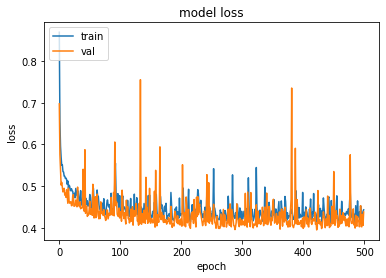

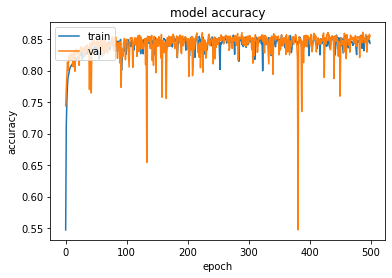

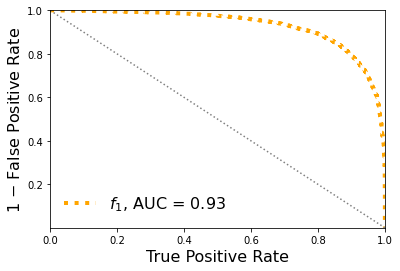

313/313 [==============================] - 2s 6ms/step - loss: 0.4399 - acc: 0.8442 - f1_m: 0.4760 - precision_m: 0.4999 - recall_m: 0.4555
Test ROC-AUC: 0.9297486
Test loss: 0.4399062395095825
Test accuracy: 0.8442000150680542
Test f1: 0.4759733974933624
Test precision: 0.4998934864997864
Test recall: 0.4554712474346161
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 253ms/step - loss: 1.3113 - acc: 0.5163 - f1_m: 0.5774 - precision_m: 0.5226 - recall_m: 0.7076 - val_loss: 0.7632 - val_acc: 0.6352 - val_f1_m: 0.7265 - val_precision_m: 0.5770 - val_recall_m: 0.9831
Epoch 2/500
94/94 [==============================] - 23s 240ms/step - loss: 0.7223 - acc: 0.6545 - f1_m: 0.6818 - precision_m: 0.6321 - recall_m: 0.7463 - val_loss: 0.6147 - val_acc: 0.7567 - val_f1_m: 0.7732 - val_precision_m: 0.7156 - val_r

Epoch 31/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4485 - acc: 0.8418 - f1_m: 0.8452 - precision_m: 0.8290 - recall_m: 0.8669 - val_loss: 0.4364 - val_acc: 0.8477 - val_f1_m: 0.8486 - val_precision_m: 0.8303 - val_recall_m: 0.8695
Epoch 32/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4453 - acc: 0.8482 - f1_m: 0.8518 - precision_m: 0.8357 - recall_m: 0.8725 - val_loss: 0.4491 - val_acc: 0.8483 - val_f1_m: 0.8515 - val_precision_m: 0.8232 - val_recall_m: 0.8839
Epoch 33/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4505 - acc: 0.8466 - f1_m: 0.8499 - precision_m: 0.8358 - recall_m: 0.8689 - val_loss: 0.4905 - val_acc: 0.8172 - val_f1_m: 0.8355 - val_precision_m: 0.7509 - val_recall_m: 0.9434
Epoch 34/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4619 - acc: 0.8370 - f1_m: 0.8407 - precision_m: 0.8222 - recall_m: 0.8673 - val_loss: 0.4438 - val_acc: 0.8440 - val_f1_m: 0.8426 - val_precisi

Epoch 63/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4346 - acc: 0.8504 - f1_m: 0.8519 - precision_m: 0.8344 - recall_m: 0.8738 - val_loss: 0.4342 - val_acc: 0.8515 - val_f1_m: 0.8550 - val_precision_m: 0.8224 - val_recall_m: 0.8920
Epoch 64/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4205 - acc: 0.8556 - f1_m: 0.8616 - precision_m: 0.8344 - recall_m: 0.8925 - val_loss: 0.4534 - val_acc: 0.8300 - val_f1_m: 0.8183 - val_precision_m: 0.8686 - val_recall_m: 0.7759
Epoch 65/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4168 - acc: 0.8585 - f1_m: 0.8612 - precision_m: 0.8497 - recall_m: 0.8766 - val_loss: 0.4468 - val_acc: 0.8427 - val_f1_m: 0.8505 - val_precision_m: 0.7997 - val_recall_m: 0.9096
Epoch 66/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4360 - acc: 0.8517 - f1_m: 0.8556 - precision_m: 0.8390 - recall_m: 0.8787 - val_loss: 0.5063 - val_acc: 0.8027 - val_f1_m: 0.7761 - val_precisi

Epoch 95/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4452 - acc: 0.8418 - f1_m: 0.8446 - precision_m: 0.8317 - recall_m: 0.8653 - val_loss: 0.4384 - val_acc: 0.8420 - val_f1_m: 0.8429 - val_precision_m: 0.8278 - val_recall_m: 0.8603
Epoch 96/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4401 - acc: 0.8431 - f1_m: 0.8487 - precision_m: 0.8275 - recall_m: 0.8742 - val_loss: 0.4298 - val_acc: 0.8470 - val_f1_m: 0.8479 - val_precision_m: 0.8311 - val_recall_m: 0.8669
Epoch 97/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4120 - acc: 0.8584 - f1_m: 0.8619 - precision_m: 0.8448 - recall_m: 0.8820 - val_loss: 0.4515 - val_acc: 0.8290 - val_f1_m: 0.8170 - val_precision_m: 0.8684 - val_recall_m: 0.7732
Epoch 98/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4298 - acc: 0.8477 - f1_m: 0.8497 - precision_m: 0.8342 - recall_m: 0.8702 - val_loss: 0.4272 - val_acc: 0.8500 - val_f1_m: 0.8538 - val_precisi

94/94 [==============================] - 22s 238ms/step - loss: 0.4004 - acc: 0.8661 - f1_m: 0.8689 - precision_m: 0.8491 - recall_m: 0.8919 - val_loss: 0.4521 - val_acc: 0.8372 - val_f1_m: 0.8269 - val_precision_m: 0.8723 - val_recall_m: 0.7876
Epoch 158/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4072 - acc: 0.8619 - f1_m: 0.8627 - precision_m: 0.8542 - recall_m: 0.8765 - val_loss: 0.4337 - val_acc: 0.8430 - val_f1_m: 0.8406 - val_precision_m: 0.8396 - val_recall_m: 0.8434
Epoch 159/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4161 - acc: 0.8539 - f1_m: 0.8573 - precision_m: 0.8418 - recall_m: 0.8782 - val_loss: 0.4849 - val_acc: 0.8210 - val_f1_m: 0.7996 - val_precision_m: 0.8920 - val_recall_m: 0.7264
Epoch 160/500
94/94 [==============================] - 22s 237ms/step - loss: 0.4049 - acc: 0.8630 - f1_m: 0.8642 - precision_m: 0.8516 - recall_m: 0.8803 - val_loss: 0.4313 - val_acc: 0.8467 - val_f1_m: 0.8423 - val_precision_m: 0.85

94/94 [==============================] - 23s 246ms/step - loss: 0.3928 - acc: 0.8657 - f1_m: 0.8678 - precision_m: 0.8614 - recall_m: 0.8780 - val_loss: 0.4241 - val_acc: 0.8487 - val_f1_m: 0.8446 - val_precision_m: 0.8545 - val_recall_m: 0.8367
Epoch 220/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3953 - acc: 0.8689 - f1_m: 0.8693 - precision_m: 0.8612 - recall_m: 0.8808 - val_loss: 0.4426 - val_acc: 0.8527 - val_f1_m: 0.8526 - val_precision_m: 0.8410 - val_recall_m: 0.8661
Epoch 221/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4361 - acc: 0.8530 - f1_m: 0.8553 - precision_m: 0.8437 - recall_m: 0.8724 - val_loss: 0.4297 - val_acc: 0.8443 - val_f1_m: 0.8371 - val_precision_m: 0.8666 - val_recall_m: 0.8116
Epoch 222/500
94/94 [==============================] - 23s 248ms/step - loss: 0.4048 - acc: 0.8658 - f1_m: 0.8666 - precision_m: 0.8650 - recall_m: 0.8714 - val_loss: 0.4343 - val_acc: 0.8455 - val_f1_m: 0.8426 - val_precision_m: 0.84

94/94 [==============================] - 23s 246ms/step - loss: 0.3941 - acc: 0.8692 - f1_m: 0.8676 - precision_m: 0.8655 - recall_m: 0.8735 - val_loss: 0.4345 - val_acc: 0.8450 - val_f1_m: 0.8401 - val_precision_m: 0.8562 - val_recall_m: 0.8261
Epoch 282/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3818 - acc: 0.8736 - f1_m: 0.8754 - precision_m: 0.8672 - recall_m: 0.8857 - val_loss: 0.4257 - val_acc: 0.8412 - val_f1_m: 0.8336 - val_precision_m: 0.8613 - val_recall_m: 0.8094
Epoch 283/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3810 - acc: 0.8733 - f1_m: 0.8726 - precision_m: 0.8716 - recall_m: 0.8767 - val_loss: 0.4270 - val_acc: 0.8562 - val_f1_m: 0.8574 - val_precision_m: 0.8377 - val_recall_m: 0.8798
Epoch 284/500
94/94 [==============================] - 23s 246ms/step - loss: 0.3830 - acc: 0.8720 - f1_m: 0.8720 - precision_m: 0.8689 - recall_m: 0.8771 - val_loss: 0.4496 - val_acc: 0.8358 - val_f1_m: 0.8332 - val_precision_m: 0.83

94/94 [==============================] - 23s 247ms/step - loss: 0.4418 - acc: 0.8523 - f1_m: 0.8544 - precision_m: 0.8357 - recall_m: 0.8768 - val_loss: 0.4490 - val_acc: 0.8288 - val_f1_m: 0.8144 - val_precision_m: 0.8824 - val_recall_m: 0.7577
Epoch 344/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4166 - acc: 0.8579 - f1_m: 0.8593 - precision_m: 0.8486 - recall_m: 0.8746 - val_loss: 0.4170 - val_acc: 0.8505 - val_f1_m: 0.8549 - val_precision_m: 0.8181 - val_recall_m: 0.8969
Epoch 345/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3937 - acc: 0.8668 - f1_m: 0.8692 - precision_m: 0.8615 - recall_m: 0.8797 - val_loss: 0.4374 - val_acc: 0.8340 - val_f1_m: 0.8210 - val_precision_m: 0.8769 - val_recall_m: 0.7735
Epoch 346/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4295 - acc: 0.8569 - f1_m: 0.8595 - precision_m: 0.8513 - recall_m: 0.8746 - val_loss: 0.4451 - val_acc: 0.8408 - val_f1_m: 0.8528 - val_precision_m: 0.78

94/94 [==============================] - 23s 246ms/step - loss: 0.4043 - acc: 0.8690 - f1_m: 0.8699 - precision_m: 0.8622 - recall_m: 0.8810 - val_loss: 0.4463 - val_acc: 0.8380 - val_f1_m: 0.8284 - val_precision_m: 0.8722 - val_recall_m: 0.7901
Epoch 406/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4056 - acc: 0.8733 - f1_m: 0.8757 - precision_m: 0.8645 - recall_m: 0.8894 - val_loss: 0.4615 - val_acc: 0.8202 - val_f1_m: 0.8007 - val_precision_m: 0.8901 - val_recall_m: 0.7288
Epoch 407/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3911 - acc: 0.8673 - f1_m: 0.8652 - precision_m: 0.8682 - recall_m: 0.8668 - val_loss: 0.4286 - val_acc: 0.8525 - val_f1_m: 0.8535 - val_precision_m: 0.8353 - val_recall_m: 0.8738
Epoch 408/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3900 - acc: 0.8751 - f1_m: 0.8771 - precision_m: 0.8703 - recall_m: 0.8879 - val_loss: 0.4403 - val_acc: 0.8483 - val_f1_m: 0.8456 - val_precision_m: 0.85

94/94 [==============================] - 23s 249ms/step - loss: 0.3801 - acc: 0.8774 - f1_m: 0.8779 - precision_m: 0.8760 - recall_m: 0.8823 - val_loss: 0.4445 - val_acc: 0.8352 - val_f1_m: 0.8217 - val_precision_m: 0.8810 - val_recall_m: 0.7711
Epoch 468/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3814 - acc: 0.8758 - f1_m: 0.8770 - precision_m: 0.8765 - recall_m: 0.8806 - val_loss: 0.4568 - val_acc: 0.8307 - val_f1_m: 0.8144 - val_precision_m: 0.8891 - val_recall_m: 0.7529
Epoch 469/500
94/94 [==============================] - 23s 247ms/step - loss: 0.3864 - acc: 0.8760 - f1_m: 0.8755 - precision_m: 0.8743 - recall_m: 0.8800 - val_loss: 0.4717 - val_acc: 0.8410 - val_f1_m: 0.8525 - val_precision_m: 0.7840 - val_recall_m: 0.9355
Epoch 470/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4385 - acc: 0.8529 - f1_m: 0.8531 - precision_m: 0.8457 - recall_m: 0.8701 - val_loss: 0.4399 - val_acc: 0.8430 - val_f1_m: 0.8362 - val_precision_m: 0.85

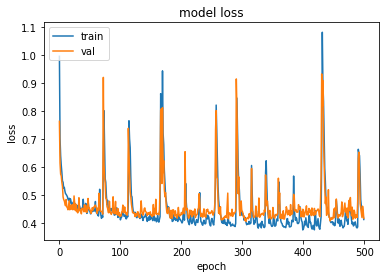

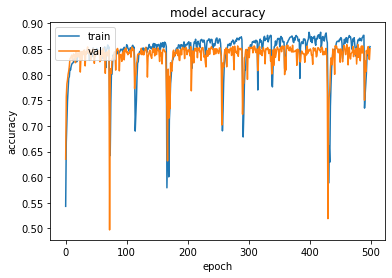

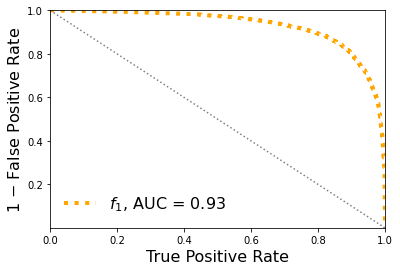

313/313 [==============================] - 2s 6ms/step - loss: 0.4291 - acc: 0.8530 - f1_m: 0.4514 - precision_m: 0.5005 - recall_m: 0.4124
Test ROC-AUC: 0.9292124399999999
Test loss: 0.42905136942863464
Test accuracy: 0.8529999852180481
Test f1: 0.4514407813549042
Test precision: 0.5005325078964233
Test recall: 0.41244009137153625
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8845 - acc: 0.6012 - f1_m: 0.5412 - precision_m: 0.6439 - recall_m: 0.5022 - val_loss: 0.5945 - val_acc: 0.7885 - val_f1_m: 0.7884 - val_precision_m: 0.7763 - val_recall_m: 0.8060
Epoch 2/500
375/375 [==============================] - 23s 60ms/step - loss: 0.6299 - acc: 0.7134 - f1_m: 0.6866 - precision_m: 0.7626 - recall_m: 0.6408 - val_loss: 0.5203 - val_acc: 0.7950 - val_f1_m: 0.8110 - val_precision_m: 0.

Epoch 31/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4656 - acc: 0.8283 - f1_m: 0.8294 - precision_m: 0.8179 - recall_m: 0.8497 - val_loss: 0.4408 - val_acc: 0.8390 - val_f1_m: 0.8428 - val_precision_m: 0.8132 - val_recall_m: 0.8796
Epoch 32/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4649 - acc: 0.8265 - f1_m: 0.8307 - precision_m: 0.8116 - recall_m: 0.8594 - val_loss: 0.4317 - val_acc: 0.8393 - val_f1_m: 0.8319 - val_precision_m: 0.8593 - val_recall_m: 0.8109
Epoch 33/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4504 - acc: 0.8344 - f1_m: 0.8324 - precision_m: 0.8211 - recall_m: 0.8513 - val_loss: 0.4262 - val_acc: 0.8422 - val_f1_m: 0.8433 - val_precision_m: 0.8261 - val_recall_m: 0.8661
Epoch 34/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4616 - acc: 0.8329 - f1_m: 0.8347 - precision_m: 0.8222 - recall_m: 0.8563 - val_loss: 0.4430 - val_acc: 0.8362 - val_f1_m: 0.8325 - val_pre

375/375 [==============================] - 23s 60ms/step - loss: 0.4405 - acc: 0.8400 - f1_m: 0.8434 - precision_m: 0.8246 - recall_m: 0.8712 - val_loss: 0.4133 - val_acc: 0.8472 - val_f1_m: 0.8461 - val_precision_m: 0.8370 - val_recall_m: 0.8597
Epoch 94/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4508 - acc: 0.8380 - f1_m: 0.8374 - precision_m: 0.8276 - recall_m: 0.8568 - val_loss: 0.4389 - val_acc: 0.8450 - val_f1_m: 0.8421 - val_precision_m: 0.8480 - val_recall_m: 0.8413
Epoch 95/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4565 - acc: 0.8348 - f1_m: 0.8359 - precision_m: 0.8231 - recall_m: 0.8572 - val_loss: 0.4291 - val_acc: 0.8463 - val_f1_m: 0.8433 - val_precision_m: 0.8482 - val_recall_m: 0.8427
Epoch 96/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4330 - acc: 0.8460 - f1_m: 0.8449 - precision_m: 0.8368 - recall_m: 0.8599 - val_loss: 0.4136 - val_acc: 0.8463 - val_f1_m: 0.8486 - val_precision_m: 0.8

375/375 [==============================] - 23s 60ms/step - loss: 0.4424 - acc: 0.8440 - f1_m: 0.8453 - precision_m: 0.8365 - recall_m: 0.8626 - val_loss: 0.4042 - val_acc: 0.8560 - val_f1_m: 0.8550 - val_precision_m: 0.8536 - val_recall_m: 0.8609
Epoch 156/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4310 - acc: 0.8457 - f1_m: 0.8460 - precision_m: 0.8402 - recall_m: 0.8597 - val_loss: 0.4704 - val_acc: 0.8290 - val_f1_m: 0.8441 - val_precision_m: 0.7656 - val_recall_m: 0.9457
Epoch 157/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4318 - acc: 0.8487 - f1_m: 0.8488 - precision_m: 0.8395 - recall_m: 0.8655 - val_loss: 0.4113 - val_acc: 0.8500 - val_f1_m: 0.8481 - val_precision_m: 0.8513 - val_recall_m: 0.8498
Epoch 158/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4552 - acc: 0.8347 - f1_m: 0.8343 - precision_m: 0.8235 - recall_m: 0.8526 - val_loss: 0.4194 - val_acc: 0.8462 - val_f1_m: 0.8506 - val_precision_m: 

375/375 [==============================] - 23s 60ms/step - loss: 0.4856 - acc: 0.8339 - f1_m: 0.8294 - precision_m: 0.8268 - recall_m: 0.8501 - val_loss: 0.4886 - val_acc: 0.8207 - val_f1_m: 0.8004 - val_precision_m: 0.8861 - val_recall_m: 0.7356
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4646 - acc: 0.8404 - f1_m: 0.8382 - precision_m: 0.8327 - recall_m: 0.8498 - val_loss: 0.4150 - val_acc: 0.8442 - val_f1_m: 0.8380 - val_precision_m: 0.8605 - val_recall_m: 0.8214
Epoch 219/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4368 - acc: 0.8432 - f1_m: 0.8414 - precision_m: 0.8423 - recall_m: 0.8473 - val_loss: 0.4380 - val_acc: 0.8377 - val_f1_m: 0.8315 - val_precision_m: 0.8544 - val_recall_m: 0.8143
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4790 - acc: 0.8298 - f1_m: 0.8275 - precision_m: 0.8242 - recall_m: 0.8420 - val_loss: 0.4293 - val_acc: 0.8432 - val_f1_m: 0.8382 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4184 - acc: 0.8537 - f1_m: 0.8548 - precision_m: 0.8535 - recall_m: 0.8614 - val_loss: 0.4103 - val_acc: 0.8500 - val_f1_m: 0.8461 - val_precision_m: 0.8588 - val_recall_m: 0.8381
Epoch 280/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4600 - acc: 0.8313 - f1_m: 0.8318 - precision_m: 0.8272 - recall_m: 0.8474 - val_loss: 0.4219 - val_acc: 0.8515 - val_f1_m: 0.8509 - val_precision_m: 0.8422 - val_recall_m: 0.8640
Epoch 281/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4348 - acc: 0.8399 - f1_m: 0.8406 - precision_m: 0.8277 - recall_m: 0.8610 - val_loss: 0.4344 - val_acc: 0.8445 - val_f1_m: 0.8381 - val_precision_m: 0.8618 - val_recall_m: 0.8201
Epoch 282/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4372 - acc: 0.8464 - f1_m: 0.8473 - precision_m: 0.8357 - recall_m: 0.8662 - val_loss: 0.4173 - val_acc: 0.8488 - val_f1_m: 0.8428 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4682 - acc: 0.8319 - f1_m: 0.8327 - precision_m: 0.8249 - recall_m: 0.8539 - val_loss: 0.4255 - val_acc: 0.8465 - val_f1_m: 0.8385 - val_precision_m: 0.8712 - val_recall_m: 0.8132
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4401 - acc: 0.8463 - f1_m: 0.8465 - precision_m: 0.8370 - recall_m: 0.8621 - val_loss: 0.4353 - val_acc: 0.8392 - val_f1_m: 0.8279 - val_precision_m: 0.8774 - val_recall_m: 0.7877
Epoch 343/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4501 - acc: 0.8379 - f1_m: 0.8399 - precision_m: 0.8283 - recall_m: 0.8607 - val_loss: 0.4162 - val_acc: 0.8482 - val_f1_m: 0.8455 - val_precision_m: 0.8492 - val_recall_m: 0.8461
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4390 - acc: 0.8412 - f1_m: 0.8450 - precision_m: 0.8322 - recall_m: 0.8649 - val_loss: 0.4326 - val_acc: 0.8402 - val_f1_m: 0.8280 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4235 - acc: 0.8516 - f1_m: 0.8503 - precision_m: 0.8471 - recall_m: 0.8599 - val_loss: 0.4180 - val_acc: 0.8430 - val_f1_m: 0.8411 - val_precision_m: 0.8419 - val_recall_m: 0.8454
Epoch 404/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4372 - acc: 0.8467 - f1_m: 0.8468 - precision_m: 0.8410 - recall_m: 0.8594 - val_loss: 0.4465 - val_acc: 0.8270 - val_f1_m: 0.8077 - val_precision_m: 0.8980 - val_recall_m: 0.7389
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4656 - acc: 0.8357 - f1_m: 0.8350 - precision_m: 0.8307 - recall_m: 0.8511 - val_loss: 0.4317 - val_acc: 0.8517 - val_f1_m: 0.8589 - val_precision_m: 0.8091 - val_recall_m: 0.9201
Epoch 406/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4539 - acc: 0.8370 - f1_m: 0.8369 - precision_m: 0.8241 - recall_m: 0.8592 - val_loss: 0.4397 - val_acc: 0.8398 - val_f1_m: 0.8290 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4278 - acc: 0.8493 - f1_m: 0.8472 - precision_m: 0.8444 - recall_m: 0.8566 - val_loss: 0.4193 - val_acc: 0.8467 - val_f1_m: 0.8526 - val_precision_m: 0.8123 - val_recall_m: 0.9030
Epoch 466/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4340 - acc: 0.8465 - f1_m: 0.8447 - precision_m: 0.8377 - recall_m: 0.8595 - val_loss: 0.4132 - val_acc: 0.8490 - val_f1_m: 0.8460 - val_precision_m: 0.8509 - val_recall_m: 0.8455
Epoch 467/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4500 - acc: 0.8389 - f1_m: 0.8384 - precision_m: 0.8316 - recall_m: 0.8560 - val_loss: 0.4425 - val_acc: 0.8338 - val_f1_m: 0.8224 - val_precision_m: 0.8721 - val_recall_m: 0.7825
Epoch 468/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4828 - acc: 0.8368 - f1_m: 0.8388 - precision_m: 0.8251 - recall_m: 0.8639 - val_loss: 0.4538 - val_acc: 0.8368 - val_f1_m: 0.8284 - val_precision_m: 

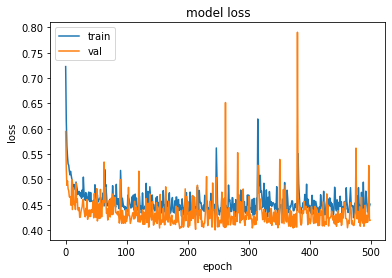

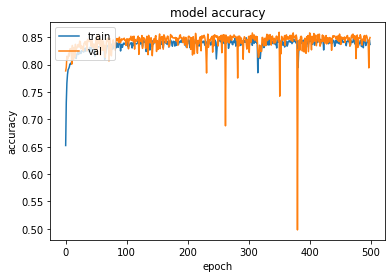

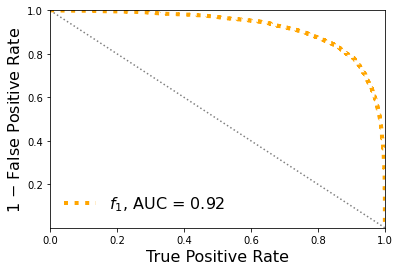

313/313 [==============================] - 2s 6ms/step - loss: 0.4291 - acc: 0.8456 - f1_m: 0.4631 - precision_m: 0.4999 - recall_m: 0.4325
Test ROC-AUC: 0.9228261400000001
Test loss: 0.42913007736206055
Test accuracy: 0.8456000089645386
Test f1: 0.4631015658378601
Test precision: 0.49985477328300476
Test recall: 0.4325079917907715
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 117ms/step - loss: 1.5743 - acc: 0.4971 - f1_m: 0.4364 - precision_m: 0.5001 - recall_m: 0.4271 - val_loss: 0.7529 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
188/188 [==============================] - 21s 114ms/step - loss: 0.7412 - acc: 0.5939 - f1_m: 0.4923 - precision_m: 0.6338 - recall_m: 0.4339 - val_loss: 0.5828 - val_acc: 0.7600 - val_f1_m: 0.7292 - val_

188/188 [==============================] - 22s 115ms/step - loss: 0.4536 - acc: 0.8385 - f1_m: 0.8401 - precision_m: 0.8296 - recall_m: 0.8570 - val_loss: 0.4430 - val_acc: 0.8470 - val_f1_m: 0.8462 - val_precision_m: 0.8440 - val_recall_m: 0.8509
Epoch 62/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4585 - acc: 0.8471 - f1_m: 0.8474 - precision_m: 0.8374 - recall_m: 0.8625 - val_loss: 0.4672 - val_acc: 0.8247 - val_f1_m: 0.8070 - val_precision_m: 0.8839 - val_recall_m: 0.7448
Epoch 63/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4652 - acc: 0.8368 - f1_m: 0.8386 - precision_m: 0.8326 - recall_m: 0.8516 - val_loss: 0.4226 - val_acc: 0.8468 - val_f1_m: 0.8539 - val_precision_m: 0.8117 - val_recall_m: 0.9032
Epoch 64/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4290 - acc: 0.8480 - f1_m: 0.8495 - precision_m: 0.8373 - recall_m: 0.8672 - val_loss: 0.4234 - val_acc: 0.8485 - val_f1_m: 0.8521 - val_precision_m:

188/188 [==============================] - 22s 116ms/step - loss: 0.4395 - acc: 0.8442 - f1_m: 0.8389 - precision_m: 0.8508 - recall_m: 0.8379 - val_loss: 0.4438 - val_acc: 0.8250 - val_f1_m: 0.8076 - val_precision_m: 0.8862 - val_recall_m: 0.7448
Epoch 124/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4245 - acc: 0.8580 - f1_m: 0.8583 - precision_m: 0.8588 - recall_m: 0.8624 - val_loss: 0.4264 - val_acc: 0.8432 - val_f1_m: 0.8349 - val_precision_m: 0.8716 - val_recall_m: 0.8035
Epoch 125/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4375 - acc: 0.8488 - f1_m: 0.8494 - precision_m: 0.8469 - recall_m: 0.8577 - val_loss: 0.4499 - val_acc: 0.8422 - val_f1_m: 0.8445 - val_precision_m: 0.8254 - val_recall_m: 0.8664
Epoch 126/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4361 - acc: 0.8453 - f1_m: 0.8438 - precision_m: 0.8448 - recall_m: 0.8499 - val_loss: 0.4233 - val_acc: 0.8398 - val_f1_m: 0.8314 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4423 - acc: 0.8388 - f1_m: 0.8371 - precision_m: 0.8382 - recall_m: 0.8395 - val_loss: 0.4349 - val_acc: 0.8355 - val_f1_m: 0.8328 - val_precision_m: 0.8385 - val_recall_m: 0.8303
Epoch 186/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4334 - acc: 0.8433 - f1_m: 0.8424 - precision_m: 0.8434 - recall_m: 0.8452 - val_loss: 0.4404 - val_acc: 0.8388 - val_f1_m: 0.8386 - val_precision_m: 0.8339 - val_recall_m: 0.8466
Epoch 187/500
188/188 [==============================] - 22s 114ms/step - loss: 0.4415 - acc: 0.8439 - f1_m: 0.8431 - precision_m: 0.8466 - recall_m: 0.8448 - val_loss: 0.4441 - val_acc: 0.8413 - val_f1_m: 0.8423 - val_precision_m: 0.8300 - val_recall_m: 0.8587
Epoch 188/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4360 - acc: 0.8485 - f1_m: 0.8477 - precision_m: 0.8452 - recall_m: 0.8552 - val_loss: 0.4367 - val_acc: 0.8380 - val_f1_m: 0.8354 - val_precision

188/188 [==============================] - 22s 116ms/step - loss: 0.4366 - acc: 0.8488 - f1_m: 0.8478 - precision_m: 0.8442 - recall_m: 0.8562 - val_loss: 0.4211 - val_acc: 0.8452 - val_f1_m: 0.8433 - val_precision_m: 0.8474 - val_recall_m: 0.8420
Epoch 248/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4053 - acc: 0.8654 - f1_m: 0.8656 - precision_m: 0.8641 - recall_m: 0.8712 - val_loss: 0.4301 - val_acc: 0.8458 - val_f1_m: 0.8548 - val_precision_m: 0.8009 - val_recall_m: 0.9194
Epoch 249/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4079 - acc: 0.8618 - f1_m: 0.8601 - precision_m: 0.8615 - recall_m: 0.8635 - val_loss: 0.4259 - val_acc: 0.8400 - val_f1_m: 0.8328 - val_precision_m: 0.8642 - val_recall_m: 0.8071
Epoch 250/500
188/188 [==============================] - 22s 117ms/step - loss: 0.4172 - acc: 0.8560 - f1_m: 0.8553 - precision_m: 0.8563 - recall_m: 0.8592 - val_loss: 0.4154 - val_acc: 0.8535 - val_f1_m: 0.8531 - val_precision

188/188 [==============================] - 22s 114ms/step - loss: 0.4151 - acc: 0.8630 - f1_m: 0.8618 - precision_m: 0.8691 - recall_m: 0.8580 - val_loss: 0.4155 - val_acc: 0.8495 - val_f1_m: 0.8497 - val_precision_m: 0.8400 - val_recall_m: 0.8629
Epoch 310/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4176 - acc: 0.8573 - f1_m: 0.8567 - precision_m: 0.8652 - recall_m: 0.8533 - val_loss: 0.4285 - val_acc: 0.8373 - val_f1_m: 0.8288 - val_precision_m: 0.8672 - val_recall_m: 0.7963
Epoch 311/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4203 - acc: 0.8558 - f1_m: 0.8534 - precision_m: 0.8612 - recall_m: 0.8495 - val_loss: 0.4622 - val_acc: 0.8347 - val_f1_m: 0.8245 - val_precision_m: 0.8686 - val_recall_m: 0.7880
Epoch 312/500
188/188 [==============================] - 22s 115ms/step - loss: 0.5690 - acc: 0.8252 - f1_m: 0.8148 - precision_m: 0.8264 - recall_m: 0.8090 - val_loss: 0.4516 - val_acc: 0.8423 - val_f1_m: 0.8352 - val_precision

188/188 [==============================] - 21s 114ms/step - loss: 0.4220 - acc: 0.8589 - f1_m: 0.8570 - precision_m: 0.8660 - recall_m: 0.8528 - val_loss: 0.4455 - val_acc: 0.8517 - val_f1_m: 0.8575 - val_precision_m: 0.8180 - val_recall_m: 0.9040
Epoch 372/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4540 - acc: 0.8435 - f1_m: 0.8389 - precision_m: 0.8546 - recall_m: 0.8303 - val_loss: 0.4355 - val_acc: 0.8450 - val_f1_m: 0.8436 - val_precision_m: 0.8453 - val_recall_m: 0.8451
Epoch 373/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4226 - acc: 0.8601 - f1_m: 0.8583 - precision_m: 0.8700 - recall_m: 0.8517 - val_loss: 0.4312 - val_acc: 0.8385 - val_f1_m: 0.8277 - val_precision_m: 0.8791 - val_recall_m: 0.7849
Epoch 374/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4064 - acc: 0.8596 - f1_m: 0.8565 - precision_m: 0.8700 - recall_m: 0.8477 - val_loss: 0.4145 - val_acc: 0.8513 - val_f1_m: 0.8503 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4145 - acc: 0.8577 - f1_m: 0.8538 - precision_m: 0.8659 - recall_m: 0.8465 - val_loss: 0.4184 - val_acc: 0.8555 - val_f1_m: 0.8567 - val_precision_m: 0.8424 - val_recall_m: 0.8745
Epoch 434/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4241 - acc: 0.8575 - f1_m: 0.8544 - precision_m: 0.8656 - recall_m: 0.8484 - val_loss: 0.4325 - val_acc: 0.8253 - val_f1_m: 0.8074 - val_precision_m: 0.8918 - val_recall_m: 0.7400
Epoch 435/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4541 - acc: 0.8401 - f1_m: 0.8284 - precision_m: 0.8602 - recall_m: 0.8125 - val_loss: 0.4219 - val_acc: 0.8518 - val_f1_m: 0.8489 - val_precision_m: 0.8590 - val_recall_m: 0.8418
Epoch 436/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4293 - acc: 0.8509 - f1_m: 0.8490 - precision_m: 0.8580 - recall_m: 0.8469 - val_loss: 0.4162 - val_acc: 0.8583 - val_f1_m: 0.8628 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4310 - acc: 0.8602 - f1_m: 0.8551 - precision_m: 0.8736 - recall_m: 0.8458 - val_loss: 0.4325 - val_acc: 0.8495 - val_f1_m: 0.8490 - val_precision_m: 0.8456 - val_recall_m: 0.8553
Epoch 496/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4161 - acc: 0.8638 - f1_m: 0.8628 - precision_m: 0.8722 - recall_m: 0.8579 - val_loss: 0.4153 - val_acc: 0.8550 - val_f1_m: 0.8577 - val_precision_m: 0.8354 - val_recall_m: 0.8837
Epoch 497/500
188/188 [==============================] - 21s 114ms/step - loss: 0.4067 - acc: 0.8655 - f1_m: 0.8642 - precision_m: 0.8752 - recall_m: 0.8604 - val_loss: 0.4223 - val_acc: 0.8515 - val_f1_m: 0.8473 - val_precision_m: 0.8655 - val_recall_m: 0.8323
Epoch 498/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4121 - acc: 0.8657 - f1_m: 0.8642 - precision_m: 0.8761 - recall_m: 0.8566 - val_loss: 0.4210 - val_acc: 0.8445 - val_f1_m: 0.8395 - val_precision

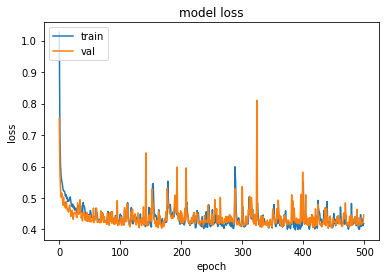

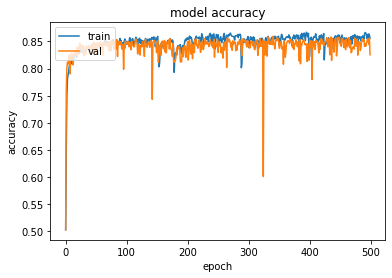

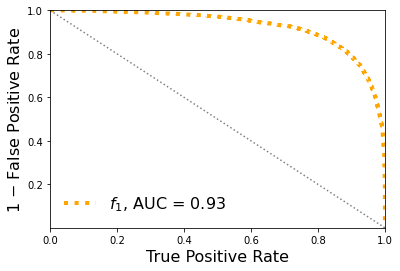

313/313 [==============================] - 2s 6ms/step - loss: 0.4570 - acc: 0.8276 - f1_m: 0.4235 - precision_m: 0.5000 - recall_m: 0.3692
Test ROC-AUC: 0.9259750400000001
Test loss: 0.4569510817527771
Test accuracy: 0.8276000022888184
Test f1: 0.4235024154186249
Test precision: 0.5
Test recall: 0.36920925974845886
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 253ms/step - loss: 0.9555 - acc: 0.5027 - f1_m: 0.5464 - precision_m: 0.4980 - recall_m: 0.6313 - val_loss: 0.7523 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 2/500
94/94 [==============================] - 23s 247ms/step - loss: 0.7477 - acc: 0.5077 - f1_m: 0.5880 - precision_m: 0.5082 - recall_m: 0.7004 - val_loss: 0.7352 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall

Epoch 31/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4453 - acc: 0.8366 - f1_m: 0.8389 - precision_m: 0.8252 - recall_m: 0.8567 - val_loss: 0.4243 - val_acc: 0.8378 - val_f1_m: 0.8433 - val_precision_m: 0.8047 - val_recall_m: 0.8871
Epoch 32/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4356 - acc: 0.8401 - f1_m: 0.8416 - precision_m: 0.8302 - recall_m: 0.8564 - val_loss: 0.4389 - val_acc: 0.8297 - val_f1_m: 0.8397 - val_precision_m: 0.7786 - val_recall_m: 0.9131
Epoch 33/500
94/94 [==============================] - 23s 246ms/step - loss: 0.5144 - acc: 0.8030 - f1_m: 0.8084 - precision_m: 0.7917 - recall_m: 0.8441 - val_loss: 0.4755 - val_acc: 0.8160 - val_f1_m: 0.7963 - val_precision_m: 0.8823 - val_recall_m: 0.7276
Epoch 34/500
94/94 [==============================] - 23s 245ms/step - loss: 0.4811 - acc: 0.8196 - f1_m: 0.8241 - precision_m: 0.8015 - recall_m: 0.8543 - val_loss: 0.4356 - val_acc: 0.8388 - val_f1_m: 0.8426 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4156 - acc: 0.8496 - f1_m: 0.8533 - precision_m: 0.8336 - recall_m: 0.8771 - val_loss: 0.4236 - val_acc: 0.8393 - val_f1_m: 0.8330 - val_precision_m: 0.8497 - val_recall_m: 0.8186
Epoch 64/500
94/94 [==============================] - 23s 245ms/step - loss: 0.4292 - acc: 0.8403 - f1_m: 0.8437 - precision_m: 0.8241 - recall_m: 0.8687 - val_loss: 0.4288 - val_acc: 0.8348 - val_f1_m: 0.8266 - val_precision_m: 0.8555 - val_recall_m: 0.8015
Epoch 65/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4102 - acc: 0.8496 - f1_m: 0.8527 - precision_m: 0.8338 - recall_m: 0.8765 - val_loss: 0.4392 - val_acc: 0.8333 - val_f1_m: 0.8327 - val_precision_m: 0.8218 - val_recall_m: 0.8453
Epoch 66/500
94/94 [==============================] - 23s 244ms/step - loss: 0.4328 - acc: 0.8474 - f1_m: 0.8514 - precision_m: 0.8329 - recall_m: 0.8743 - val_loss: 0.4449 - val_acc: 0.8338 - val_f1_m: 0.8276 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 244ms/step - loss: 0.4135 - acc: 0.8528 - f1_m: 0.8553 - precision_m: 0.8286 - recall_m: 0.8867 - val_loss: 0.4084 - val_acc: 0.8473 - val_f1_m: 0.8491 - val_precision_m: 0.8247 - val_recall_m: 0.8764
Epoch 96/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4053 - acc: 0.8551 - f1_m: 0.8588 - precision_m: 0.8309 - recall_m: 0.8914 - val_loss: 0.4097 - val_acc: 0.8488 - val_f1_m: 0.8487 - val_precision_m: 0.8379 - val_recall_m: 0.8615
Epoch 97/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4057 - acc: 0.8573 - f1_m: 0.8606 - precision_m: 0.8312 - recall_m: 0.8944 - val_loss: 0.4174 - val_acc: 0.8453 - val_f1_m: 0.8505 - val_precision_m: 0.8108 - val_recall_m: 0.8959
Epoch 98/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4203 - acc: 0.8479 - f1_m: 0.8539 - precision_m: 0.8286 - recall_m: 0.8844 - val_loss: 0.4226 - val_acc: 0.8445 - val_f1_m: 0.8385 - val_precisi

94/94 [==============================] - 23s 240ms/step - loss: 0.4459 - acc: 0.8569 - f1_m: 0.8581 - precision_m: 0.8433 - recall_m: 0.8787 - val_loss: 0.4387 - val_acc: 0.8518 - val_f1_m: 0.8595 - val_precision_m: 0.8122 - val_recall_m: 0.9141
Epoch 158/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4073 - acc: 0.8716 - f1_m: 0.8743 - precision_m: 0.8537 - recall_m: 0.8978 - val_loss: 0.4484 - val_acc: 0.8453 - val_f1_m: 0.8394 - val_precision_m: 0.8561 - val_recall_m: 0.8252
Epoch 159/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4186 - acc: 0.8632 - f1_m: 0.8653 - precision_m: 0.8462 - recall_m: 0.8890 - val_loss: 0.4454 - val_acc: 0.8508 - val_f1_m: 0.8576 - val_precision_m: 0.8104 - val_recall_m: 0.9121
Epoch 160/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4090 - acc: 0.8650 - f1_m: 0.8691 - precision_m: 0.8482 - recall_m: 0.8945 - val_loss: 0.4205 - val_acc: 0.8473 - val_f1_m: 0.8491 - val_precision_m: 0.82

94/94 [==============================] - 23s 239ms/step - loss: 0.4330 - acc: 0.8424 - f1_m: 0.8465 - precision_m: 0.8283 - recall_m: 0.8705 - val_loss: 0.4476 - val_acc: 0.8322 - val_f1_m: 0.8375 - val_precision_m: 0.8055 - val_recall_m: 0.8738
Epoch 220/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4115 - acc: 0.8547 - f1_m: 0.8580 - precision_m: 0.8373 - recall_m: 0.8808 - val_loss: 0.4527 - val_acc: 0.8213 - val_f1_m: 0.8117 - val_precision_m: 0.8465 - val_recall_m: 0.7818
Epoch 221/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4217 - acc: 0.8467 - f1_m: 0.8502 - precision_m: 0.8363 - recall_m: 0.8677 - val_loss: 0.4363 - val_acc: 0.8310 - val_f1_m: 0.8273 - val_precision_m: 0.8353 - val_recall_m: 0.8216
Epoch 222/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4061 - acc: 0.8551 - f1_m: 0.8578 - precision_m: 0.8382 - recall_m: 0.8808 - val_loss: 0.4411 - val_acc: 0.8352 - val_f1_m: 0.8321 - val_precision_m: 0.83

94/94 [==============================] - 22s 239ms/step - loss: 0.4524 - acc: 0.8452 - f1_m: 0.8449 - precision_m: 0.8367 - recall_m: 0.8572 - val_loss: 0.4610 - val_acc: 0.8402 - val_f1_m: 0.8398 - val_precision_m: 0.8332 - val_recall_m: 0.8484
Epoch 282/500
94/94 [==============================] - 23s 240ms/step - loss: 0.4469 - acc: 0.8483 - f1_m: 0.8521 - precision_m: 0.8362 - recall_m: 0.8701 - val_loss: 0.4513 - val_acc: 0.8318 - val_f1_m: 0.8372 - val_precision_m: 0.8028 - val_recall_m: 0.8766
Epoch 283/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4124 - acc: 0.8580 - f1_m: 0.8619 - precision_m: 0.8482 - recall_m: 0.8787 - val_loss: 0.4442 - val_acc: 0.8343 - val_f1_m: 0.8343 - val_precision_m: 0.8274 - val_recall_m: 0.8428
Epoch 284/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4139 - acc: 0.8592 - f1_m: 0.8607 - precision_m: 0.8472 - recall_m: 0.8762 - val_loss: 0.4513 - val_acc: 0.8355 - val_f1_m: 0.8424 - val_precision_m: 0.80

94/94 [==============================] - 22s 238ms/step - loss: 0.5671 - acc: 0.7930 - f1_m: 0.8036 - precision_m: 0.7896 - recall_m: 0.8463 - val_loss: 0.7583 - val_acc: 0.7710 - val_f1_m: 0.7983 - val_precision_m: 0.7057 - val_recall_m: 0.9206
Epoch 344/500
94/94 [==============================] - 22s 237ms/step - loss: 0.7730 - acc: 0.7227 - f1_m: 0.7402 - precision_m: 0.7027 - recall_m: 0.8034 - val_loss: 0.7012 - val_acc: 0.7610 - val_f1_m: 0.7638 - val_precision_m: 0.7480 - val_recall_m: 0.7818
Epoch 345/500
94/94 [==============================] - 22s 237ms/step - loss: 0.7225 - acc: 0.7338 - f1_m: 0.7549 - precision_m: 0.7082 - recall_m: 0.8214 - val_loss: 0.6212 - val_acc: 0.7910 - val_f1_m: 0.7968 - val_precision_m: 0.7667 - val_recall_m: 0.8309
Epoch 346/500
94/94 [==============================] - 22s 238ms/step - loss: 0.6422 - acc: 0.7646 - f1_m: 0.7804 - precision_m: 0.7409 - recall_m: 0.8291 - val_loss: 0.5604 - val_acc: 0.7990 - val_f1_m: 0.7908 - val_precision_m: 0.81

94/94 [==============================] - 22s 237ms/step - loss: 0.4260 - acc: 0.8509 - f1_m: 0.8545 - precision_m: 0.8435 - recall_m: 0.8689 - val_loss: 0.4931 - val_acc: 0.8152 - val_f1_m: 0.8333 - val_precision_m: 0.7480 - val_recall_m: 0.9425
Epoch 406/500
94/94 [==============================] - 22s 238ms/step - loss: 0.4483 - acc: 0.8450 - f1_m: 0.8471 - precision_m: 0.8345 - recall_m: 0.8682 - val_loss: 0.4262 - val_acc: 0.8438 - val_f1_m: 0.8393 - val_precision_m: 0.8580 - val_recall_m: 0.8227
Epoch 407/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4489 - acc: 0.8421 - f1_m: 0.8433 - precision_m: 0.8418 - recall_m: 0.8525 - val_loss: 0.4729 - val_acc: 0.8230 - val_f1_m: 0.8058 - val_precision_m: 0.8864 - val_recall_m: 0.7407
Epoch 408/500
94/94 [==============================] - 22s 236ms/step - loss: 0.4606 - acc: 0.8410 - f1_m: 0.8424 - precision_m: 0.8405 - recall_m: 0.8522 - val_loss: 0.4268 - val_acc: 0.8440 - val_f1_m: 0.8387 - val_precision_m: 0.85

94/94 [==============================] - 22s 236ms/step - loss: 0.4401 - acc: 0.8521 - f1_m: 0.8535 - precision_m: 0.8495 - recall_m: 0.8672 - val_loss: 0.4451 - val_acc: 0.8370 - val_f1_m: 0.8400 - val_precision_m: 0.8163 - val_recall_m: 0.8664
Epoch 468/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3758 - acc: 0.8815 - f1_m: 0.8830 - precision_m: 0.8723 - recall_m: 0.8959 - val_loss: 0.4371 - val_acc: 0.8445 - val_f1_m: 0.8423 - val_precision_m: 0.8444 - val_recall_m: 0.8414
Epoch 469/500
94/94 [==============================] - 22s 237ms/step - loss: 0.3693 - acc: 0.8791 - f1_m: 0.8801 - precision_m: 0.8785 - recall_m: 0.8835 - val_loss: 0.4379 - val_acc: 0.8445 - val_f1_m: 0.8391 - val_precision_m: 0.8579 - val_recall_m: 0.8228
Epoch 470/500
94/94 [==============================] - 22s 238ms/step - loss: 0.3657 - acc: 0.8844 - f1_m: 0.8854 - precision_m: 0.8774 - recall_m: 0.8953 - val_loss: 0.4523 - val_acc: 0.8402 - val_f1_m: 0.8315 - val_precision_m: 0.86

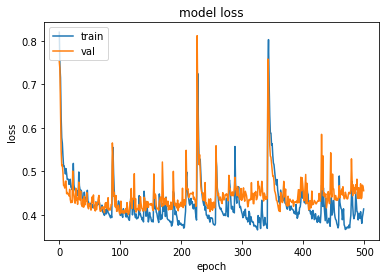

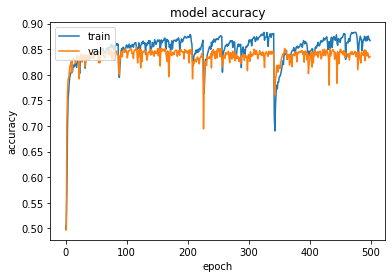

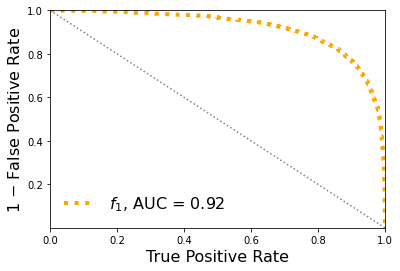

313/313 [==============================] - 2s 6ms/step - loss: 0.4740 - acc: 0.8323 - f1_m: 0.4394 - precision_m: 0.5004 - recall_m: 0.3929
Test ROC-AUC: 0.9183843199999999
Test loss: 0.47397729754447937
Test accuracy: 0.8323000073432922
Test f1: 0.43936702609062195
Test precision: 0.5003993511199951
Test recall: 0.3928714096546173
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 24s 62ms/step - loss: 0.8663 - acc: 0.6148 - f1_m: 0.6056 - precision_m: 0.6139 - recall_m: 0.6307 - val_loss: 0.5476 - val_acc: 0.8000 - val_f1_m: 0.8037 - val_precision_m: 0.7794 - val_recall_m: 0.8354
Epoch 2/500
375/375 [==============================] - 23s 61ms/step - loss: 0.6033 - acc: 0.7702 - f1_m: 0.7710 - precision_m: 0.7596 - recall_m: 0.7961 - val_loss: 0.5409 - val_acc: 0.8068 - val_f1_m: 0.8054 - val_precision_m: 0.8

Epoch 31/500
375/375 [==============================] - 23s 61ms/step - loss: 0.5018 - acc: 0.8175 - f1_m: 0.8174 - precision_m: 0.8143 - recall_m: 0.8326 - val_loss: 0.4534 - val_acc: 0.8235 - val_f1_m: 0.8117 - val_precision_m: 0.8552 - val_recall_m: 0.7768
Epoch 32/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4646 - acc: 0.8322 - f1_m: 0.8318 - precision_m: 0.8289 - recall_m: 0.8432 - val_loss: 0.4600 - val_acc: 0.8223 - val_f1_m: 0.8100 - val_precision_m: 0.8596 - val_recall_m: 0.7710
Epoch 33/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4839 - acc: 0.8282 - f1_m: 0.8271 - precision_m: 0.8231 - recall_m: 0.8394 - val_loss: 0.6460 - val_acc: 0.7878 - val_f1_m: 0.8163 - val_precision_m: 0.7117 - val_recall_m: 0.9630
Epoch 34/500
375/375 [==============================] - 23s 61ms/step - loss: 0.5343 - acc: 0.8081 - f1_m: 0.8062 - precision_m: 0.8087 - recall_m: 0.8188 - val_loss: 0.4456 - val_acc: 0.8273 - val_f1_m: 0.8126 - val_pre

375/375 [==============================] - 23s 61ms/step - loss: 0.4602 - acc: 0.8293 - f1_m: 0.8281 - precision_m: 0.8231 - recall_m: 0.8423 - val_loss: 0.4287 - val_acc: 0.8478 - val_f1_m: 0.8493 - val_precision_m: 0.8293 - val_recall_m: 0.8746
Epoch 94/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4484 - acc: 0.8366 - f1_m: 0.8381 - precision_m: 0.8241 - recall_m: 0.8601 - val_loss: 0.4147 - val_acc: 0.8527 - val_f1_m: 0.8536 - val_precision_m: 0.8381 - val_recall_m: 0.8750
Epoch 95/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4634 - acc: 0.8296 - f1_m: 0.8276 - precision_m: 0.8215 - recall_m: 0.8466 - val_loss: 0.4667 - val_acc: 0.8110 - val_f1_m: 0.7885 - val_precision_m: 0.8805 - val_recall_m: 0.7193
Epoch 96/500
375/375 [==============================] - 23s 61ms/step - loss: 0.4648 - acc: 0.8304 - f1_m: 0.8312 - precision_m: 0.8222 - recall_m: 0.8511 - val_loss: 0.4354 - val_acc: 0.8302 - val_f1_m: 0.8176 - val_precision_m: 0.8

375/375 [==============================] - 23s 60ms/step - loss: 0.4549 - acc: 0.8385 - f1_m: 0.8370 - precision_m: 0.8282 - recall_m: 0.8575 - val_loss: 0.4510 - val_acc: 0.8235 - val_f1_m: 0.8047 - val_precision_m: 0.8864 - val_recall_m: 0.7410
Epoch 156/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4539 - acc: 0.8356 - f1_m: 0.8357 - precision_m: 0.8287 - recall_m: 0.8517 - val_loss: 0.4527 - val_acc: 0.8325 - val_f1_m: 0.8208 - val_precision_m: 0.8681 - val_recall_m: 0.7830
Epoch 157/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4592 - acc: 0.8346 - f1_m: 0.8363 - precision_m: 0.8240 - recall_m: 0.8568 - val_loss: 0.4523 - val_acc: 0.8062 - val_f1_m: 0.7782 - val_precision_m: 0.8981 - val_recall_m: 0.6924
Epoch 158/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4668 - acc: 0.8295 - f1_m: 0.8314 - precision_m: 0.8205 - recall_m: 0.8531 - val_loss: 0.4264 - val_acc: 0.8447 - val_f1_m: 0.8415 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4437 - acc: 0.8409 - f1_m: 0.8428 - precision_m: 0.8342 - recall_m: 0.8611 - val_loss: 0.4355 - val_acc: 0.8373 - val_f1_m: 0.8244 - val_precision_m: 0.8805 - val_recall_m: 0.7800
Epoch 218/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4582 - acc: 0.8397 - f1_m: 0.8383 - precision_m: 0.8366 - recall_m: 0.8510 - val_loss: 0.4409 - val_acc: 0.8403 - val_f1_m: 0.8353 - val_precision_m: 0.8518 - val_recall_m: 0.8242
Epoch 219/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4691 - acc: 0.8332 - f1_m: 0.8331 - precision_m: 0.8239 - recall_m: 0.8561 - val_loss: 0.4410 - val_acc: 0.8448 - val_f1_m: 0.8421 - val_precision_m: 0.8479 - val_recall_m: 0.8417
Epoch 220/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4447 - acc: 0.8412 - f1_m: 0.8420 - precision_m: 0.8291 - recall_m: 0.8609 - val_loss: 0.4148 - val_acc: 0.8468 - val_f1_m: 0.8436 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4746 - acc: 0.8306 - f1_m: 0.8264 - precision_m: 0.8302 - recall_m: 0.8410 - val_loss: 0.4253 - val_acc: 0.8478 - val_f1_m: 0.8448 - val_precision_m: 0.8498 - val_recall_m: 0.8443
Epoch 280/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4439 - acc: 0.8420 - f1_m: 0.8421 - precision_m: 0.8348 - recall_m: 0.8573 - val_loss: 0.4193 - val_acc: 0.8480 - val_f1_m: 0.8476 - val_precision_m: 0.8371 - val_recall_m: 0.8632
Epoch 281/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4495 - acc: 0.8385 - f1_m: 0.8382 - precision_m: 0.8330 - recall_m: 0.8535 - val_loss: 0.4246 - val_acc: 0.8478 - val_f1_m: 0.8511 - val_precision_m: 0.8224 - val_recall_m: 0.8865
Epoch 282/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4600 - acc: 0.8352 - f1_m: 0.8348 - precision_m: 0.8277 - recall_m: 0.8542 - val_loss: 0.4206 - val_acc: 0.8443 - val_f1_m: 0.8381 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4499 - acc: 0.8391 - f1_m: 0.8406 - precision_m: 0.8265 - recall_m: 0.8639 - val_loss: 0.4282 - val_acc: 0.8420 - val_f1_m: 0.8333 - val_precision_m: 0.8692 - val_recall_m: 0.8054
Epoch 342/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4407 - acc: 0.8429 - f1_m: 0.8424 - precision_m: 0.8360 - recall_m: 0.8561 - val_loss: 0.4282 - val_acc: 0.8490 - val_f1_m: 0.8451 - val_precision_m: 0.8543 - val_recall_m: 0.8409
Epoch 343/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4392 - acc: 0.8444 - f1_m: 0.8443 - precision_m: 0.8334 - recall_m: 0.8642 - val_loss: 0.4340 - val_acc: 0.8470 - val_f1_m: 0.8553 - val_precision_m: 0.7997 - val_recall_m: 0.9240
Epoch 344/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4935 - acc: 0.8200 - f1_m: 0.8221 - precision_m: 0.8111 - recall_m: 0.8467 - val_loss: 0.4401 - val_acc: 0.8452 - val_f1_m: 0.8533 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4604 - acc: 0.8359 - f1_m: 0.8373 - precision_m: 0.8272 - recall_m: 0.8570 - val_loss: 0.4626 - val_acc: 0.8417 - val_f1_m: 0.8519 - val_precision_m: 0.7894 - val_recall_m: 0.9300
Epoch 404/500
375/375 [==============================] - 23s 60ms/step - loss: 0.4570 - acc: 0.8391 - f1_m: 0.8399 - precision_m: 0.8267 - recall_m: 0.8621 - val_loss: 0.4348 - val_acc: 0.8478 - val_f1_m: 0.8566 - val_precision_m: 0.7984 - val_recall_m: 0.9281
Epoch 405/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4522 - acc: 0.8416 - f1_m: 0.8453 - precision_m: 0.8324 - recall_m: 0.8666 - val_loss: 0.4425 - val_acc: 0.8273 - val_f1_m: 0.8115 - val_precision_m: 0.8803 - val_recall_m: 0.7580
Epoch 406/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4542 - acc: 0.8375 - f1_m: 0.8380 - precision_m: 0.8326 - recall_m: 0.8536 - val_loss: 0.4331 - val_acc: 0.8487 - val_f1_m: 0.8509 - val_precision_m: 

375/375 [==============================] - 22s 60ms/step - loss: 0.4577 - acc: 0.8329 - f1_m: 0.8317 - precision_m: 0.8230 - recall_m: 0.8525 - val_loss: 0.4289 - val_acc: 0.8450 - val_f1_m: 0.8427 - val_precision_m: 0.8420 - val_recall_m: 0.8478
Epoch 466/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4453 - acc: 0.8434 - f1_m: 0.8452 - precision_m: 0.8358 - recall_m: 0.8639 - val_loss: 0.4224 - val_acc: 0.8450 - val_f1_m: 0.8367 - val_precision_m: 0.8726 - val_recall_m: 0.8076
Epoch 467/500
375/375 [==============================] - 22s 60ms/step - loss: 0.4370 - acc: 0.8453 - f1_m: 0.8440 - precision_m: 0.8406 - recall_m: 0.8561 - val_loss: 0.4208 - val_acc: 0.8452 - val_f1_m: 0.8390 - val_precision_m: 0.8629 - val_recall_m: 0.8207
Epoch 468/500
375/375 [==============================] - 23s 60ms/step - loss: 0.5117 - acc: 0.8141 - f1_m: 0.8109 - precision_m: 0.8084 - recall_m: 0.8317 - val_loss: 0.4678 - val_acc: 0.8153 - val_f1_m: 0.7917 - val_precision_m: 

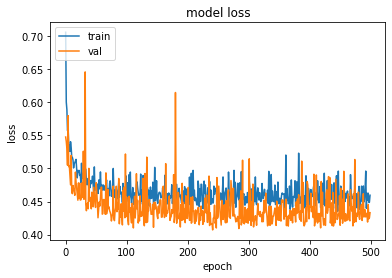

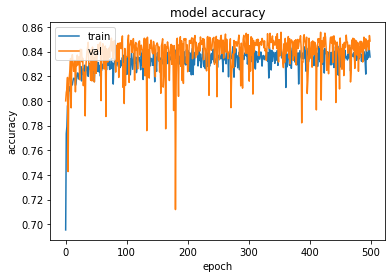

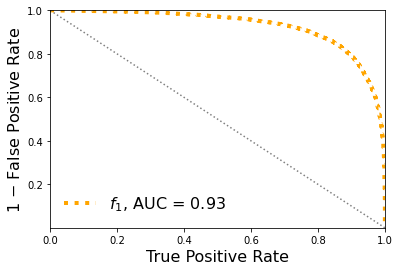

313/313 [==============================] - 2s 6ms/step - loss: 0.4393 - acc: 0.8479 - f1_m: 0.4520 - precision_m: 0.5002 - recall_m: 0.4135
Test ROC-AUC: 0.9267946
Test loss: 0.4393402338027954
Test accuracy: 0.8478999733924866
Test f1: 0.45198574662208557
Test precision: 0.5001775026321411
Test recall: 0.4135383367538452
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 23s 118ms/step - loss: 0.8931 - acc: 0.6243 - f1_m: 0.6209 - precision_m: 0.6228 - recall_m: 0.6479 - val_loss: 0.5642 - val_acc: 0.7898 - val_f1_m: 0.7987 - val_precision_m: 0.7610 - val_recall_m: 0.8439
Epoch 2/500
188/188 [==============================] - 21s 113ms/step - loss: 0.5838 - acc: 0.7768 - f1_m: 0.7764 - precision_m: 0.7687 - recall_m: 0.7919 - val_loss: 0.5099 - val_acc: 0.8160 - val_f1_m: 0.8141 - val_precision_m: 0.8145 - v

188/188 [==============================] - 22s 116ms/step - loss: 0.4433 - acc: 0.8442 - f1_m: 0.8425 - precision_m: 0.8452 - recall_m: 0.8446 - val_loss: 0.4328 - val_acc: 0.8362 - val_f1_m: 0.8283 - val_precision_m: 0.8602 - val_recall_m: 0.8019
Epoch 62/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4374 - acc: 0.8471 - f1_m: 0.8464 - precision_m: 0.8496 - recall_m: 0.8482 - val_loss: 0.4442 - val_acc: 0.8422 - val_f1_m: 0.8507 - val_precision_m: 0.8017 - val_recall_m: 0.9092
Epoch 63/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4417 - acc: 0.8460 - f1_m: 0.8460 - precision_m: 0.8370 - recall_m: 0.8596 - val_loss: 0.4348 - val_acc: 0.8400 - val_f1_m: 0.8347 - val_precision_m: 0.8549 - val_recall_m: 0.8189
Epoch 64/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4460 - acc: 0.8439 - f1_m: 0.8449 - precision_m: 0.8408 - recall_m: 0.8540 - val_loss: 0.4473 - val_acc: 0.8420 - val_f1_m: 0.8432 - val_precision_m:

188/188 [==============================] - 22s 115ms/step - loss: 0.4530 - acc: 0.8405 - f1_m: 0.8380 - precision_m: 0.8392 - recall_m: 0.8443 - val_loss: 0.4348 - val_acc: 0.8363 - val_f1_m: 0.8278 - val_precision_m: 0.8642 - val_recall_m: 0.7968
Epoch 124/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4333 - acc: 0.8490 - f1_m: 0.8499 - precision_m: 0.8436 - recall_m: 0.8609 - val_loss: 0.4188 - val_acc: 0.8455 - val_f1_m: 0.8405 - val_precision_m: 0.8613 - val_recall_m: 0.8231
Epoch 125/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4239 - acc: 0.8514 - f1_m: 0.8513 - precision_m: 0.8462 - recall_m: 0.8606 - val_loss: 0.4285 - val_acc: 0.8445 - val_f1_m: 0.8392 - val_precision_m: 0.8597 - val_recall_m: 0.8221
Epoch 126/500
188/188 [==============================] - 22s 115ms/step - loss: 0.5237 - acc: 0.8040 - f1_m: 0.7980 - precision_m: 0.8167 - recall_m: 0.8023 - val_loss: 0.4332 - val_acc: 0.8425 - val_f1_m: 0.8371 - val_precision

188/188 [==============================] - 22s 115ms/step - loss: 0.4576 - acc: 0.8451 - f1_m: 0.8474 - precision_m: 0.8299 - recall_m: 0.8705 - val_loss: 0.4527 - val_acc: 0.8298 - val_f1_m: 0.8159 - val_precision_m: 0.8782 - val_recall_m: 0.7647
Epoch 186/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4592 - acc: 0.8352 - f1_m: 0.8355 - precision_m: 0.8311 - recall_m: 0.8474 - val_loss: 0.4152 - val_acc: 0.8528 - val_f1_m: 0.8545 - val_precision_m: 0.8393 - val_recall_m: 0.8731
Epoch 187/500
188/188 [==============================] - 22s 115ms/step - loss: 0.4256 - acc: 0.8511 - f1_m: 0.8523 - precision_m: 0.8383 - recall_m: 0.8713 - val_loss: 0.4082 - val_acc: 0.8478 - val_f1_m: 0.8440 - val_precision_m: 0.8567 - val_recall_m: 0.8339
Epoch 188/500
188/188 [==============================] - 22s 116ms/step - loss: 0.4370 - acc: 0.8449 - f1_m: 0.8452 - precision_m: 0.8355 - recall_m: 0.8621 - val_loss: 0.4175 - val_acc: 0.8418 - val_f1_m: 0.8357 - val_precision

188/188 [==============================] - 23s 120ms/step - loss: 0.4285 - acc: 0.8491 - f1_m: 0.8472 - precision_m: 0.8469 - recall_m: 0.8547 - val_loss: 0.4517 - val_acc: 0.8495 - val_f1_m: 0.8526 - val_precision_m: 0.8300 - val_recall_m: 0.8793
Epoch 248/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4472 - acc: 0.8423 - f1_m: 0.8429 - precision_m: 0.8344 - recall_m: 0.8573 - val_loss: 0.4076 - val_acc: 0.8550 - val_f1_m: 0.8566 - val_precision_m: 0.8407 - val_recall_m: 0.8758
Epoch 249/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4186 - acc: 0.8490 - f1_m: 0.8508 - precision_m: 0.8414 - recall_m: 0.8645 - val_loss: 0.4274 - val_acc: 0.8333 - val_f1_m: 0.8204 - val_precision_m: 0.8815 - val_recall_m: 0.7694
Epoch 250/500
188/188 [==============================] - 23s 120ms/step - loss: 0.4182 - acc: 0.8524 - f1_m: 0.8512 - precision_m: 0.8513 - recall_m: 0.8566 - val_loss: 0.4371 - val_acc: 0.8493 - val_f1_m: 0.8600 - val_precision

188/188 [==============================] - 22s 120ms/step - loss: 0.4422 - acc: 0.8431 - f1_m: 0.8465 - precision_m: 0.8323 - recall_m: 0.8669 - val_loss: 0.4170 - val_acc: 0.8442 - val_f1_m: 0.8346 - val_precision_m: 0.8792 - val_recall_m: 0.7964
Epoch 310/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4347 - acc: 0.8426 - f1_m: 0.8403 - precision_m: 0.8389 - recall_m: 0.8496 - val_loss: 0.4083 - val_acc: 0.8530 - val_f1_m: 0.8557 - val_precision_m: 0.8340 - val_recall_m: 0.8812
Epoch 311/500
188/188 [==============================] - 23s 120ms/step - loss: 0.4086 - acc: 0.8589 - f1_m: 0.8596 - precision_m: 0.8473 - recall_m: 0.8751 - val_loss: 0.4034 - val_acc: 0.8530 - val_f1_m: 0.8510 - val_precision_m: 0.8570 - val_recall_m: 0.8482
Epoch 312/500
188/188 [==============================] - 23s 120ms/step - loss: 0.4232 - acc: 0.8461 - f1_m: 0.8461 - precision_m: 0.8435 - recall_m: 0.8535 - val_loss: 0.4694 - val_acc: 0.7957 - val_f1_m: 0.7609 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4477 - acc: 0.8355 - f1_m: 0.8345 - precision_m: 0.8291 - recall_m: 0.8498 - val_loss: 0.4922 - val_acc: 0.8413 - val_f1_m: 0.8368 - val_precision_m: 0.8534 - val_recall_m: 0.8233
Epoch 372/500
188/188 [==============================] - 22s 118ms/step - loss: 0.5013 - acc: 0.8252 - f1_m: 0.8313 - precision_m: 0.8093 - recall_m: 0.8666 - val_loss: 0.4173 - val_acc: 0.8462 - val_f1_m: 0.8431 - val_precision_m: 0.8510 - val_recall_m: 0.8380
Epoch 373/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4403 - acc: 0.8459 - f1_m: 0.8503 - precision_m: 0.8323 - recall_m: 0.8750 - val_loss: 0.4634 - val_acc: 0.8447 - val_f1_m: 0.8536 - val_precision_m: 0.8027 - val_recall_m: 0.9144
Epoch 374/500
188/188 [==============================] - 22s 119ms/step - loss: 0.5056 - acc: 0.8206 - f1_m: 0.8211 - precision_m: 0.8125 - recall_m: 0.8438 - val_loss: 0.4250 - val_acc: 0.8463 - val_f1_m: 0.8561 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4164 - acc: 0.8553 - f1_m: 0.8571 - precision_m: 0.8423 - recall_m: 0.8767 - val_loss: 0.4181 - val_acc: 0.8495 - val_f1_m: 0.8437 - val_precision_m: 0.8675 - val_recall_m: 0.8234
Epoch 434/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4106 - acc: 0.8579 - f1_m: 0.8587 - precision_m: 0.8478 - recall_m: 0.8740 - val_loss: 0.3988 - val_acc: 0.8515 - val_f1_m: 0.8496 - val_precision_m: 0.8531 - val_recall_m: 0.8488
Epoch 435/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4172 - acc: 0.8515 - f1_m: 0.8519 - precision_m: 0.8429 - recall_m: 0.8650 - val_loss: 0.4055 - val_acc: 0.8455 - val_f1_m: 0.8412 - val_precision_m: 0.8575 - val_recall_m: 0.8283
Epoch 436/500
188/188 [==============================] - 22s 118ms/step - loss: 0.4058 - acc: 0.8580 - f1_m: 0.8580 - precision_m: 0.8539 - recall_m: 0.8672 - val_loss: 0.4098 - val_acc: 0.8478 - val_f1_m: 0.8439 - val_precision

188/188 [==============================] - 22s 119ms/step - loss: 0.4207 - acc: 0.8515 - f1_m: 0.8526 - precision_m: 0.8456 - recall_m: 0.8652 - val_loss: 0.3993 - val_acc: 0.8552 - val_f1_m: 0.8554 - val_precision_m: 0.8451 - val_recall_m: 0.8687
Epoch 496/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4237 - acc: 0.8478 - f1_m: 0.8485 - precision_m: 0.8404 - recall_m: 0.8626 - val_loss: 0.4202 - val_acc: 0.8450 - val_f1_m: 0.8370 - val_precision_m: 0.8732 - val_recall_m: 0.8062
Epoch 497/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4097 - acc: 0.8535 - f1_m: 0.8568 - precision_m: 0.8410 - recall_m: 0.8768 - val_loss: 0.4145 - val_acc: 0.8488 - val_f1_m: 0.8459 - val_precision_m: 0.8542 - val_recall_m: 0.8403
Epoch 498/500
188/188 [==============================] - 22s 119ms/step - loss: 0.4291 - acc: 0.8450 - f1_m: 0.8453 - precision_m: 0.8407 - recall_m: 0.8584 - val_loss: 0.4206 - val_acc: 0.8480 - val_f1_m: 0.8578 - val_precision

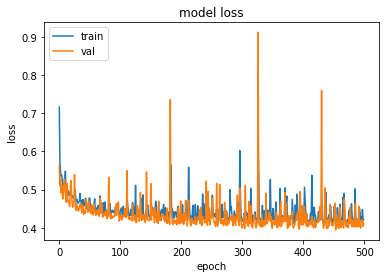

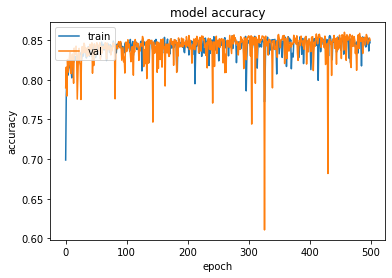

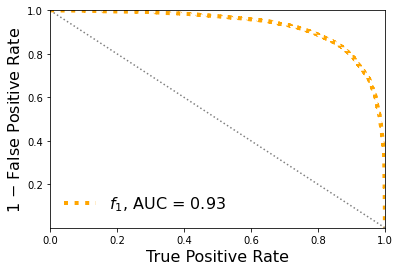

313/313 [==============================] - 2s 6ms/step - loss: 0.4268 - acc: 0.8473 - f1_m: 0.4507 - precision_m: 0.5000 - recall_m: 0.4116
Test ROC-AUC: 0.9279759000000001
Test loss: 0.42681050300598145
Test accuracy: 0.8472999930381775
Test f1: 0.45074737071990967
Test precision: 0.5
Test recall: 0.41164135932922363
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  16
learning_rate :  0.01
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 25s 252ms/step - loss: 2.2513 - acc: 0.5619 - f1_m: 0.4938 - precision_m: 0.5815 - recall_m: 0.4765 - val_loss: 0.6428 - val_acc: 0.7587 - val_f1_m: 0.7600 - val_precision_m: 0.7472 - val_recall_m: 0.7751
Epoch 2/500
94/94 [==============================] - 23s 248ms/step - loss: 0.6595 - acc: 0.7378 - f1_m: 0.7457 - precision_m: 0.7280 - recall_m: 0.7690 - val_loss: 0.5787 - val_acc: 0.7780 - val_f1_m: 0.7790 - val_precision_m: 0.7683 - val_recal

Epoch 31/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4496 - acc: 0.8487 - f1_m: 0.8486 - precision_m: 0.8451 - recall_m: 0.8557 - val_loss: 0.4563 - val_acc: 0.8427 - val_f1_m: 0.8492 - val_precision_m: 0.8056 - val_recall_m: 0.8993
Epoch 32/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4637 - acc: 0.8407 - f1_m: 0.8402 - precision_m: 0.8370 - recall_m: 0.8489 - val_loss: 0.4562 - val_acc: 0.8465 - val_f1_m: 0.8535 - val_precision_m: 0.8054 - val_recall_m: 0.9091
Epoch 33/500
94/94 [==============================] - 23s 248ms/step - loss: 0.4650 - acc: 0.8373 - f1_m: 0.8397 - precision_m: 0.8346 - recall_m: 0.8502 - val_loss: 0.4768 - val_acc: 0.8338 - val_f1_m: 0.8463 - val_precision_m: 0.7806 - val_recall_m: 0.9256
Epoch 34/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4569 - acc: 0.8459 - f1_m: 0.8486 - precision_m: 0.8375 - recall_m: 0.8635 - val_loss: 0.4505 - val_acc: 0.8358 - val_f1_m: 0.8270 - val_precisi

Epoch 63/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4374 - acc: 0.8467 - f1_m: 0.8488 - precision_m: 0.8426 - recall_m: 0.8601 - val_loss: 0.4278 - val_acc: 0.8465 - val_f1_m: 0.8432 - val_precision_m: 0.8503 - val_recall_m: 0.8377
Epoch 64/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4234 - acc: 0.8494 - f1_m: 0.8511 - precision_m: 0.8439 - recall_m: 0.8626 - val_loss: 0.4268 - val_acc: 0.8450 - val_f1_m: 0.8411 - val_precision_m: 0.8514 - val_recall_m: 0.8328
Epoch 65/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4354 - acc: 0.8514 - f1_m: 0.8517 - precision_m: 0.8412 - recall_m: 0.8676 - val_loss: 0.4303 - val_acc: 0.8447 - val_f1_m: 0.8420 - val_precision_m: 0.8447 - val_recall_m: 0.8409
Epoch 66/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4413 - acc: 0.8448 - f1_m: 0.8493 - precision_m: 0.8367 - recall_m: 0.8690 - val_loss: 0.4263 - val_acc: 0.8493 - val_f1_m: 0.8529 - val_precisi

Epoch 95/500
94/94 [==============================] - 23s 246ms/step - loss: 0.4067 - acc: 0.8646 - f1_m: 0.8651 - precision_m: 0.8530 - recall_m: 0.8814 - val_loss: 0.4432 - val_acc: 0.8340 - val_f1_m: 0.8227 - val_precision_m: 0.8764 - val_recall_m: 0.7766
Epoch 96/500
94/94 [==============================] - 23s 247ms/step - loss: 0.4097 - acc: 0.8567 - f1_m: 0.8591 - precision_m: 0.8480 - recall_m: 0.8759 - val_loss: 0.4240 - val_acc: 0.8497 - val_f1_m: 0.8473 - val_precision_m: 0.8526 - val_recall_m: 0.8435
Epoch 97/500
94/94 [==============================] - 23s 245ms/step - loss: 0.4137 - acc: 0.8583 - f1_m: 0.8593 - precision_m: 0.8502 - recall_m: 0.8718 - val_loss: 0.4323 - val_acc: 0.8385 - val_f1_m: 0.8301 - val_precision_m: 0.8656 - val_recall_m: 0.7990
Epoch 98/500
94/94 [==============================] - 23s 245ms/step - loss: 0.4180 - acc: 0.8570 - f1_m: 0.8592 - precision_m: 0.8487 - recall_m: 0.8738 - val_loss: 0.4279 - val_acc: 0.8450 - val_f1_m: 0.8406 - val_precisi

94/94 [==============================] - 23s 244ms/step - loss: 0.4031 - acc: 0.8593 - f1_m: 0.8614 - precision_m: 0.8529 - recall_m: 0.8754 - val_loss: 0.4316 - val_acc: 0.8440 - val_f1_m: 0.8557 - val_precision_m: 0.7878 - val_recall_m: 0.9380
Epoch 158/500
94/94 [==============================] - 23s 243ms/step - loss: 0.4117 - acc: 0.8537 - f1_m: 0.8547 - precision_m: 0.8470 - recall_m: 0.8671 - val_loss: 0.4137 - val_acc: 0.8477 - val_f1_m: 0.8506 - val_precision_m: 0.8249 - val_recall_m: 0.8793
Epoch 159/500
94/94 [==============================] - 23s 245ms/step - loss: 0.4071 - acc: 0.8612 - f1_m: 0.8650 - precision_m: 0.8485 - recall_m: 0.8855 - val_loss: 0.4118 - val_acc: 0.8487 - val_f1_m: 0.8527 - val_precision_m: 0.8193 - val_recall_m: 0.8903
Epoch 160/500
94/94 [==============================] - 23s 242ms/step - loss: 0.4088 - acc: 0.8585 - f1_m: 0.8607 - precision_m: 0.8451 - recall_m: 0.8802 - val_loss: 0.4200 - val_acc: 0.8508 - val_f1_m: 0.8532 - val_precision_m: 0.83

94/94 [==============================] - 23s 241ms/step - loss: 0.5239 - acc: 0.8018 - f1_m: 0.7999 - precision_m: 0.8043 - recall_m: 0.8207 - val_loss: 0.7555 - val_acc: 0.5093 - val_f1_m: 0.0250 - val_precision_m: 0.7917 - val_recall_m: 0.0128
Epoch 220/500
94/94 [==============================] - 23s 241ms/step - loss: 0.7896 - acc: 0.6594 - f1_m: 0.6266 - precision_m: 0.7036 - recall_m: 0.6151 - val_loss: 0.5095 - val_acc: 0.8225 - val_f1_m: 0.8254 - val_precision_m: 0.8063 - val_recall_m: 0.8477
Epoch 221/500
94/94 [==============================] - 23s 241ms/step - loss: 0.5734 - acc: 0.7861 - f1_m: 0.7877 - precision_m: 0.7948 - recall_m: 0.8000 - val_loss: 0.5904 - val_acc: 0.8123 - val_f1_m: 0.7961 - val_precision_m: 0.8644 - val_recall_m: 0.7399
Epoch 222/500
94/94 [==============================] - 23s 243ms/step - loss: 0.5638 - acc: 0.7941 - f1_m: 0.7887 - precision_m: 0.8093 - recall_m: 0.7757 - val_loss: 0.4452 - val_acc: 0.8428 - val_f1_m: 0.8440 - val_precision_m: 0.82

94/94 [==============================] - 23s 242ms/step - loss: 0.3925 - acc: 0.8606 - f1_m: 0.8624 - precision_m: 0.8543 - recall_m: 0.8731 - val_loss: 0.4234 - val_acc: 0.8457 - val_f1_m: 0.8419 - val_precision_m: 0.8529 - val_recall_m: 0.8323
Epoch 282/500
94/94 [==============================] - 23s 241ms/step - loss: 0.4011 - acc: 0.8613 - f1_m: 0.8638 - precision_m: 0.8497 - recall_m: 0.8815 - val_loss: 0.4301 - val_acc: 0.8358 - val_f1_m: 0.8295 - val_precision_m: 0.8532 - val_recall_m: 0.8082
Epoch 283/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3965 - acc: 0.8651 - f1_m: 0.8674 - precision_m: 0.8558 - recall_m: 0.8819 - val_loss: 0.4129 - val_acc: 0.8487 - val_f1_m: 0.8457 - val_precision_m: 0.8525 - val_recall_m: 0.8403
Epoch 284/500
94/94 [==============================] - 23s 241ms/step - loss: 0.3969 - acc: 0.8603 - f1_m: 0.8625 - precision_m: 0.8486 - recall_m: 0.8800 - val_loss: 0.4186 - val_acc: 0.8492 - val_f1_m: 0.8487 - val_precision_m: 0.84

94/94 [==============================] - 23s 240ms/step - loss: 0.3874 - acc: 0.8686 - f1_m: 0.8700 - precision_m: 0.8580 - recall_m: 0.8843 - val_loss: 0.4195 - val_acc: 0.8460 - val_f1_m: 0.8380 - val_precision_m: 0.8695 - val_recall_m: 0.8103
Epoch 344/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3930 - acc: 0.8626 - f1_m: 0.8647 - precision_m: 0.8549 - recall_m: 0.8779 - val_loss: 0.4290 - val_acc: 0.8538 - val_f1_m: 0.8566 - val_precision_m: 0.8339 - val_recall_m: 0.8819
Epoch 345/500
94/94 [==============================] - 23s 241ms/step - loss: 0.3872 - acc: 0.8664 - f1_m: 0.8679 - precision_m: 0.8553 - recall_m: 0.8831 - val_loss: 0.4307 - val_acc: 0.8452 - val_f1_m: 0.8535 - val_precision_m: 0.7997 - val_recall_m: 0.9165
Epoch 346/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3820 - acc: 0.8670 - f1_m: 0.8678 - precision_m: 0.8566 - recall_m: 0.8812 - val_loss: 0.4367 - val_acc: 0.8430 - val_f1_m: 0.8453 - val_precision_m: 0.82

94/94 [==============================] - 22s 239ms/step - loss: 0.4086 - acc: 0.8577 - f1_m: 0.8584 - precision_m: 0.8541 - recall_m: 0.8675 - val_loss: 0.4608 - val_acc: 0.8237 - val_f1_m: 0.8044 - val_precision_m: 0.8920 - val_recall_m: 0.7338
Epoch 406/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4143 - acc: 0.8524 - f1_m: 0.8523 - precision_m: 0.8502 - recall_m: 0.8595 - val_loss: 0.4089 - val_acc: 0.8538 - val_f1_m: 0.8556 - val_precision_m: 0.8377 - val_recall_m: 0.8758
Epoch 407/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3941 - acc: 0.8666 - f1_m: 0.8683 - precision_m: 0.8544 - recall_m: 0.8853 - val_loss: 0.4059 - val_acc: 0.8522 - val_f1_m: 0.8488 - val_precision_m: 0.8555 - val_recall_m: 0.8437
Epoch 408/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3874 - acc: 0.8649 - f1_m: 0.8663 - precision_m: 0.8542 - recall_m: 0.8827 - val_loss: 0.4176 - val_acc: 0.8508 - val_f1_m: 0.8484 - val_precision_m: 0.84

94/94 [==============================] - 22s 239ms/step - loss: 0.3942 - acc: 0.8657 - f1_m: 0.8663 - precision_m: 0.8613 - recall_m: 0.8733 - val_loss: 0.4090 - val_acc: 0.8480 - val_f1_m: 0.8475 - val_precision_m: 0.8393 - val_recall_m: 0.8574
Epoch 468/500
94/94 [==============================] - 23s 240ms/step - loss: 0.3839 - acc: 0.8679 - f1_m: 0.8700 - precision_m: 0.8585 - recall_m: 0.8836 - val_loss: 0.4213 - val_acc: 0.8512 - val_f1_m: 0.8562 - val_precision_m: 0.8132 - val_recall_m: 0.9056
Epoch 469/500
94/94 [==============================] - 22s 239ms/step - loss: 0.3938 - acc: 0.8670 - f1_m: 0.8675 - precision_m: 0.8583 - recall_m: 0.8812 - val_loss: 0.4234 - val_acc: 0.8488 - val_f1_m: 0.8483 - val_precision_m: 0.8384 - val_recall_m: 0.8596
Epoch 470/500
94/94 [==============================] - 22s 239ms/step - loss: 0.4387 - acc: 0.8415 - f1_m: 0.8406 - precision_m: 0.8496 - recall_m: 0.8399 - val_loss: 0.4378 - val_acc: 0.8445 - val_f1_m: 0.8559 - val_precision_m: 0.78

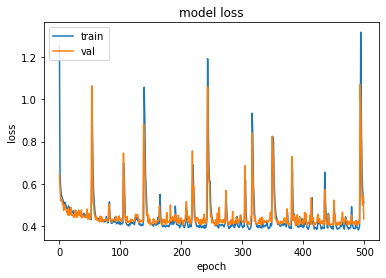

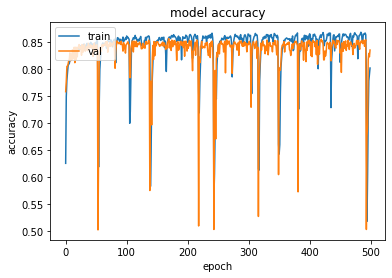

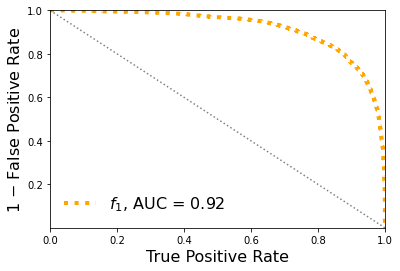

313/313 [==============================] - 2s 6ms/step - loss: 0.4461 - acc: 0.8354 - f1_m: 0.4503 - precision_m: 0.4999 - recall_m: 0.4110
Test ROC-AUC: 0.9193351599999999
Test loss: 0.4460905194282532
Test accuracy: 0.8353999853134155
Test f1: 0.4503130316734314
Test precision: 0.49985477328300476
Test recall: 0.41104233264923096
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 34s 89ms/step - loss: 0.9588 - acc: 0.5528 - f1_m: 0.4878 - precision_m: 0.5744 - recall_m: 0.4839 - val_loss: 0.5803 - val_acc: 0.7588 - val_f1_m: 0.7508 - val_precision_m: 0.7660 - val_recall_m: 0.7423
Epoch 2/500
375/375 [==============================] - 33s 87ms/step - loss: 0.6224 - acc: 0.6665 - f1_m: 0.6045 - precision_m: 0.7160 - recall_m: 0.5459 - val_loss: 0.5479 - val_acc: 0.7798 - val_f1_m: 0.7663 - val_precision_m: 

Epoch 31/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4565 - acc: 0.8313 - f1_m: 0.8327 - precision_m: 0.8153 - recall_m: 0.8571 - val_loss: 0.4272 - val_acc: 0.8400 - val_f1_m: 0.8439 - val_precision_m: 0.8138 - val_recall_m: 0.8817
Epoch 32/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4453 - acc: 0.8286 - f1_m: 0.8310 - precision_m: 0.8116 - recall_m: 0.8590 - val_loss: 0.4415 - val_acc: 0.8345 - val_f1_m: 0.8468 - val_precision_m: 0.7791 - val_recall_m: 0.9329
Epoch 33/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4414 - acc: 0.8331 - f1_m: 0.8369 - precision_m: 0.8156 - recall_m: 0.8676 - val_loss: 0.4584 - val_acc: 0.8233 - val_f1_m: 0.8363 - val_precision_m: 0.7694 - val_recall_m: 0.9206
Epoch 34/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4578 - acc: 0.8341 - f1_m: 0.8385 - precision_m: 0.8166 - recall_m: 0.8680 - val_loss: 0.4233 - val_acc: 0.8443 - val_f1_m: 0.8493 - val_pre

375/375 [==============================] - 32s 86ms/step - loss: 0.4730 - acc: 0.8329 - f1_m: 0.8339 - precision_m: 0.8222 - recall_m: 0.8519 - val_loss: 0.4577 - val_acc: 0.8315 - val_f1_m: 0.8419 - val_precision_m: 0.7808 - val_recall_m: 0.9185
Epoch 94/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4783 - acc: 0.8289 - f1_m: 0.8306 - precision_m: 0.8136 - recall_m: 0.8568 - val_loss: 0.4474 - val_acc: 0.8313 - val_f1_m: 0.8305 - val_precision_m: 0.8209 - val_recall_m: 0.8455
Epoch 95/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4546 - acc: 0.8321 - f1_m: 0.8350 - precision_m: 0.8206 - recall_m: 0.8567 - val_loss: 0.4375 - val_acc: 0.8360 - val_f1_m: 0.8388 - val_precision_m: 0.8132 - val_recall_m: 0.8716
Epoch 96/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4372 - acc: 0.8365 - f1_m: 0.8394 - precision_m: 0.8239 - recall_m: 0.8611 - val_loss: 0.4304 - val_acc: 0.8378 - val_f1_m: 0.8385 - val_precision_m: 0.8

375/375 [==============================] - 32s 86ms/step - loss: 0.4514 - acc: 0.8392 - f1_m: 0.8421 - precision_m: 0.8239 - recall_m: 0.8679 - val_loss: 0.4981 - val_acc: 0.8103 - val_f1_m: 0.8277 - val_precision_m: 0.7474 - val_recall_m: 0.9326
Epoch 156/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4347 - acc: 0.8408 - f1_m: 0.8406 - precision_m: 0.8252 - recall_m: 0.8642 - val_loss: 0.4569 - val_acc: 0.8247 - val_f1_m: 0.8369 - val_precision_m: 0.7746 - val_recall_m: 0.9157
Epoch 157/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4411 - acc: 0.8396 - f1_m: 0.8422 - precision_m: 0.8225 - recall_m: 0.8704 - val_loss: 0.4658 - val_acc: 0.8338 - val_f1_m: 0.8307 - val_precision_m: 0.8371 - val_recall_m: 0.8292
Epoch 158/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4464 - acc: 0.8415 - f1_m: 0.8433 - precision_m: 0.8253 - recall_m: 0.8684 - val_loss: 0.4417 - val_acc: 0.8342 - val_f1_m: 0.8322 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4322 - acc: 0.8452 - f1_m: 0.8440 - precision_m: 0.8301 - recall_m: 0.8635 - val_loss: 0.4445 - val_acc: 0.8372 - val_f1_m: 0.8369 - val_precision_m: 0.8285 - val_recall_m: 0.8503
Epoch 218/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4329 - acc: 0.8448 - f1_m: 0.8460 - precision_m: 0.8313 - recall_m: 0.8678 - val_loss: 0.7358 - val_acc: 0.8143 - val_f1_m: 0.8174 - val_precision_m: 0.7927 - val_recall_m: 0.8487
Epoch 219/500
375/375 [==============================] - 32s 86ms/step - loss: 0.6315 - acc: 0.8194 - f1_m: 0.8214 - precision_m: 0.8066 - recall_m: 0.8436 - val_loss: 0.5103 - val_acc: 0.8303 - val_f1_m: 0.8295 - val_precision_m: 0.8232 - val_recall_m: 0.8407
Epoch 220/500
375/375 [==============================] - 32s 86ms/step - loss: 0.5040 - acc: 0.8293 - f1_m: 0.8302 - precision_m: 0.8200 - recall_m: 0.8477 - val_loss: 0.4639 - val_acc: 0.8403 - val_f1_m: 0.8373 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.7148 - acc: 0.5099 - f1_m: 0.6389 - precision_m: 0.5078 - recall_m: 0.8878 - val_loss: 0.7113 - val_acc: 0.4972 - val_f1_m: 0.6619 - val_precision_m: 0.4972 - val_recall_m: 1.0000
Epoch 280/500
375/375 [==============================] - 32s 86ms/step - loss: 0.7112 - acc: 0.5027 - f1_m: 0.5500 - precision_m: 0.5043 - recall_m: 0.6913 - val_loss: 0.7074 - val_acc: 0.4972 - val_f1_m: 0.6619 - val_precision_m: 0.4972 - val_recall_m: 1.0000
Epoch 281/500
375/375 [==============================] - 32s 86ms/step - loss: 0.7107 - acc: 0.5069 - f1_m: 0.6021 - precision_m: 0.5043 - recall_m: 0.8733 - val_loss: 0.7157 - val_acc: 0.4972 - val_f1_m: 0.6619 - val_precision_m: 0.4972 - val_recall_m: 1.0000
Epoch 282/500
375/375 [==============================] - 32s 86ms/step - loss: 0.7184 - acc: 0.5574 - f1_m: 0.3383 - precision_m: 0.4626 - recall_m: 0.3541 - val_loss: 0.6405 - val_acc: 0.8013 - val_f1_m: 0.7894 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4416 - acc: 0.8405 - f1_m: 0.8405 - precision_m: 0.8366 - recall_m: 0.8524 - val_loss: 0.4600 - val_acc: 0.8170 - val_f1_m: 0.8001 - val_precision_m: 0.8668 - val_recall_m: 0.7488
Epoch 342/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4576 - acc: 0.8399 - f1_m: 0.8391 - precision_m: 0.8348 - recall_m: 0.8508 - val_loss: 0.4749 - val_acc: 0.8287 - val_f1_m: 0.8213 - val_precision_m: 0.8447 - val_recall_m: 0.8036
Epoch 343/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4682 - acc: 0.8354 - f1_m: 0.8371 - precision_m: 0.8294 - recall_m: 0.8521 - val_loss: 0.4441 - val_acc: 0.8405 - val_f1_m: 0.8425 - val_precision_m: 0.8208 - val_recall_m: 0.8696
Epoch 344/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4356 - acc: 0.8454 - f1_m: 0.8457 - precision_m: 0.8363 - recall_m: 0.8621 - val_loss: 0.4533 - val_acc: 0.8245 - val_f1_m: 0.8128 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4268 - acc: 0.8510 - f1_m: 0.8503 - precision_m: 0.8380 - recall_m: 0.8691 - val_loss: 0.4961 - val_acc: 0.8385 - val_f1_m: 0.8367 - val_precision_m: 0.8371 - val_recall_m: 0.8419
Epoch 404/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4637 - acc: 0.8441 - f1_m: 0.8447 - precision_m: 0.8337 - recall_m: 0.8624 - val_loss: 0.4673 - val_acc: 0.8397 - val_f1_m: 0.8431 - val_precision_m: 0.8119 - val_recall_m: 0.8823
Epoch 405/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4315 - acc: 0.8535 - f1_m: 0.8549 - precision_m: 0.8434 - recall_m: 0.8724 - val_loss: 0.4458 - val_acc: 0.8432 - val_f1_m: 0.8434 - val_precision_m: 0.8301 - val_recall_m: 0.8626
Epoch 406/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4223 - acc: 0.8508 - f1_m: 0.8493 - precision_m: 0.8470 - recall_m: 0.8582 - val_loss: 0.4474 - val_acc: 0.8268 - val_f1_m: 0.8176 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4533 - acc: 0.8483 - f1_m: 0.8478 - precision_m: 0.8407 - recall_m: 0.8608 - val_loss: 0.4700 - val_acc: 0.8365 - val_f1_m: 0.8384 - val_precision_m: 0.8198 - val_recall_m: 0.8629
Epoch 466/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4411 - acc: 0.8504 - f1_m: 0.8496 - precision_m: 0.8436 - recall_m: 0.8615 - val_loss: 0.4516 - val_acc: 0.8272 - val_f1_m: 0.8199 - val_precision_m: 0.8428 - val_recall_m: 0.8029
Epoch 467/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4552 - acc: 0.8448 - f1_m: 0.8461 - precision_m: 0.8331 - recall_m: 0.8670 - val_loss: 0.5224 - val_acc: 0.8220 - val_f1_m: 0.8199 - val_precision_m: 0.8207 - val_recall_m: 0.8244
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4869 - acc: 0.8351 - f1_m: 0.8337 - precision_m: 0.8274 - recall_m: 0.8475 - val_loss: 0.4652 - val_acc: 0.8322 - val_f1_m: 0.8288 - val_precision_m: 

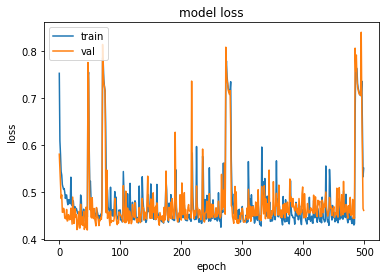

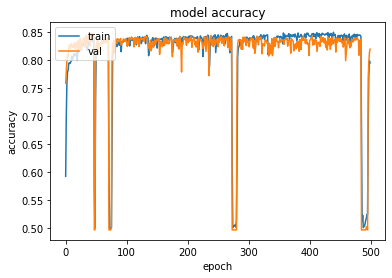

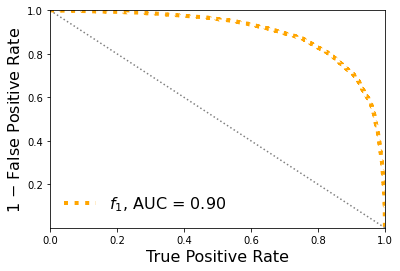

313/313 [==============================] - 3s 9ms/step - loss: 0.4704 - acc: 0.8168 - f1_m: 0.4504 - precision_m: 0.5002 - recall_m: 0.4110
Test ROC-AUC: 0.89892494
Test loss: 0.47042855620384216
Test accuracy: 0.8167999982833862
Test f1: 0.4503649175167084
Test precision: 0.5001775026321411
Test recall: 0.41104233264923096
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 176ms/step - loss: 0.8257 - acc: 0.5051 - f1_m: 0.1914 - precision_m: 0.5009 - recall_m: 0.2232 - val_loss: 0.7516 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
188/188 [==============================] - 32s 169ms/step - loss: 0.7359 - acc: 0.5199 - f1_m: 0.6305 - precision_m: 0.5199 - recall_m: 0.8524 - val_loss: 0.5796 - val_acc: 0.7570 - val_f1_m: 0.7559 - val_precis

188/188 [==============================] - 32s 168ms/step - loss: 0.4263 - acc: 0.8509 - f1_m: 0.8510 - precision_m: 0.8401 - recall_m: 0.8670 - val_loss: 0.4249 - val_acc: 0.8417 - val_f1_m: 0.8428 - val_precision_m: 0.8305 - val_recall_m: 0.8579
Epoch 62/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4206 - acc: 0.8498 - f1_m: 0.8506 - precision_m: 0.8386 - recall_m: 0.8668 - val_loss: 0.4219 - val_acc: 0.8477 - val_f1_m: 0.8501 - val_precision_m: 0.8295 - val_recall_m: 0.8752
Epoch 63/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4278 - acc: 0.8475 - f1_m: 0.8493 - precision_m: 0.8353 - recall_m: 0.8682 - val_loss: 0.4460 - val_acc: 0.8458 - val_f1_m: 0.8498 - val_precision_m: 0.8223 - val_recall_m: 0.8822
Epoch 64/500
188/188 [==============================] - 32s 168ms/step - loss: 0.5594 - acc: 0.8214 - f1_m: 0.8165 - precision_m: 0.8174 - recall_m: 0.8338 - val_loss: 0.4796 - val_acc: 0.8460 - val_f1_m: 0.8450 - val_precision_m:

188/188 [==============================] - 32s 168ms/step - loss: 0.4155 - acc: 0.8568 - f1_m: 0.8572 - precision_m: 0.8453 - recall_m: 0.8736 - val_loss: 0.6131 - val_acc: 0.7853 - val_f1_m: 0.7953 - val_precision_m: 0.7539 - val_recall_m: 0.8449
Epoch 124/500
188/188 [==============================] - 32s 168ms/step - loss: 0.6505 - acc: 0.7791 - f1_m: 0.7682 - precision_m: 0.7783 - recall_m: 0.7816 - val_loss: 0.5026 - val_acc: 0.8305 - val_f1_m: 0.8354 - val_precision_m: 0.8058 - val_recall_m: 0.8705
Epoch 125/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4859 - acc: 0.8477 - f1_m: 0.8507 - precision_m: 0.8376 - recall_m: 0.8684 - val_loss: 0.4903 - val_acc: 0.8285 - val_f1_m: 0.8267 - val_precision_m: 0.8296 - val_recall_m: 0.8270
Epoch 126/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4605 - acc: 0.8526 - f1_m: 0.8542 - precision_m: 0.8478 - recall_m: 0.8642 - val_loss: 0.4824 - val_acc: 0.8302 - val_f1_m: 0.8295 - val_precision

188/188 [==============================] - 31s 168ms/step - loss: 0.4765 - acc: 0.8501 - f1_m: 0.8523 - precision_m: 0.8502 - recall_m: 0.8584 - val_loss: 0.4705 - val_acc: 0.8337 - val_f1_m: 0.8410 - val_precision_m: 0.8007 - val_recall_m: 0.8891
Epoch 186/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4779 - acc: 0.8437 - f1_m: 0.8406 - precision_m: 0.8359 - recall_m: 0.8502 - val_loss: 0.4684 - val_acc: 0.8332 - val_f1_m: 0.8296 - val_precision_m: 0.8388 - val_recall_m: 0.8232
Epoch 187/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4506 - acc: 0.8487 - f1_m: 0.8471 - precision_m: 0.8487 - recall_m: 0.8496 - val_loss: 0.4688 - val_acc: 0.8295 - val_f1_m: 0.8321 - val_precision_m: 0.8144 - val_recall_m: 0.8541
Epoch 188/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4332 - acc: 0.8515 - f1_m: 0.8517 - precision_m: 0.8447 - recall_m: 0.8625 - val_loss: 0.4908 - val_acc: 0.8058 - val_f1_m: 0.7839 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4460 - acc: 0.8528 - f1_m: 0.8514 - precision_m: 0.8517 - recall_m: 0.8558 - val_loss: 0.6655 - val_acc: 0.7672 - val_f1_m: 0.7615 - val_precision_m: 0.7746 - val_recall_m: 0.7520
Epoch 248/500
188/188 [==============================] - 32s 168ms/step - loss: 0.5913 - acc: 0.8026 - f1_m: 0.7996 - precision_m: 0.8078 - recall_m: 0.7998 - val_loss: 0.4878 - val_acc: 0.8333 - val_f1_m: 0.8355 - val_precision_m: 0.8185 - val_recall_m: 0.8564
Epoch 249/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4655 - acc: 0.8499 - f1_m: 0.8527 - precision_m: 0.8427 - recall_m: 0.8677 - val_loss: 0.4752 - val_acc: 0.8378 - val_f1_m: 0.8443 - val_precision_m: 0.8053 - val_recall_m: 0.8904
Epoch 250/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4491 - acc: 0.8535 - f1_m: 0.8548 - precision_m: 0.8509 - recall_m: 0.8624 - val_loss: 0.4492 - val_acc: 0.8398 - val_f1_m: 0.8401 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4160 - acc: 0.8638 - f1_m: 0.8627 - precision_m: 0.8620 - recall_m: 0.8669 - val_loss: 0.4497 - val_acc: 0.8407 - val_f1_m: 0.8380 - val_precision_m: 0.8455 - val_recall_m: 0.8335
Epoch 310/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4124 - acc: 0.8635 - f1_m: 0.8613 - precision_m: 0.8615 - recall_m: 0.8652 - val_loss: 0.4543 - val_acc: 0.8367 - val_f1_m: 0.8315 - val_precision_m: 0.8501 - val_recall_m: 0.8163
Epoch 311/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4142 - acc: 0.8642 - f1_m: 0.8635 - precision_m: 0.8610 - recall_m: 0.8696 - val_loss: 0.4576 - val_acc: 0.8402 - val_f1_m: 0.8380 - val_precision_m: 0.8422 - val_recall_m: 0.8367
Epoch 312/500
188/188 [==============================] - 31s 168ms/step - loss: 0.4070 - acc: 0.8629 - f1_m: 0.8627 - precision_m: 0.8636 - recall_m: 0.8658 - val_loss: 0.4512 - val_acc: 0.8355 - val_f1_m: 0.8338 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4063 - acc: 0.8664 - f1_m: 0.8669 - precision_m: 0.8637 - recall_m: 0.8737 - val_loss: 0.4494 - val_acc: 0.8408 - val_f1_m: 0.8398 - val_precision_m: 0.8372 - val_recall_m: 0.8458
Epoch 372/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4049 - acc: 0.8665 - f1_m: 0.8655 - precision_m: 0.8695 - recall_m: 0.8657 - val_loss: 0.4457 - val_acc: 0.8345 - val_f1_m: 0.8247 - val_precision_m: 0.8678 - val_recall_m: 0.7884
Epoch 373/500
188/188 [==============================] - 31s 167ms/step - loss: 0.3992 - acc: 0.8666 - f1_m: 0.8671 - precision_m: 0.8690 - recall_m: 0.8690 - val_loss: 0.4951 - val_acc: 0.7998 - val_f1_m: 0.7681 - val_precision_m: 0.9031 - val_recall_m: 0.6712
Epoch 374/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4715 - acc: 0.8495 - f1_m: 0.8452 - precision_m: 0.8636 - recall_m: 0.8382 - val_loss: 0.4620 - val_acc: 0.8463 - val_f1_m: 0.8502 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4434 - acc: 0.8558 - f1_m: 0.8501 - precision_m: 0.8605 - recall_m: 0.8505 - val_loss: 0.5221 - val_acc: 0.8327 - val_f1_m: 0.8328 - val_precision_m: 0.8224 - val_recall_m: 0.8459
Epoch 434/500
188/188 [==============================] - 31s 167ms/step - loss: 0.5096 - acc: 0.8317 - f1_m: 0.8285 - precision_m: 0.8351 - recall_m: 0.8258 - val_loss: 0.4806 - val_acc: 0.8315 - val_f1_m: 0.8241 - val_precision_m: 0.8532 - val_recall_m: 0.7998
Epoch 435/500
188/188 [==============================] - 31s 167ms/step - loss: 0.5354 - acc: 0.8177 - f1_m: 0.8141 - precision_m: 0.8264 - recall_m: 0.8113 - val_loss: 0.4755 - val_acc: 0.8392 - val_f1_m: 0.8377 - val_precision_m: 0.8364 - val_recall_m: 0.8417
Epoch 436/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4829 - acc: 0.8355 - f1_m: 0.8318 - precision_m: 0.8434 - recall_m: 0.8284 - val_loss: 0.4577 - val_acc: 0.8463 - val_f1_m: 0.8504 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4138 - acc: 0.8680 - f1_m: 0.8678 - precision_m: 0.8705 - recall_m: 0.8689 - val_loss: 0.4758 - val_acc: 0.8292 - val_f1_m: 0.8243 - val_precision_m: 0.8398 - val_recall_m: 0.8124
Epoch 496/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4070 - acc: 0.8710 - f1_m: 0.8697 - precision_m: 0.8730 - recall_m: 0.8702 - val_loss: 0.4811 - val_acc: 0.8300 - val_f1_m: 0.8275 - val_precision_m: 0.8343 - val_recall_m: 0.8241
Epoch 497/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4096 - acc: 0.8723 - f1_m: 0.8705 - precision_m: 0.8708 - recall_m: 0.8736 - val_loss: 0.4922 - val_acc: 0.8308 - val_f1_m: 0.8380 - val_precision_m: 0.7991 - val_recall_m: 0.8838
Epoch 498/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4136 - acc: 0.8681 - f1_m: 0.8682 - precision_m: 0.8729 - recall_m: 0.8666 - val_loss: 0.4747 - val_acc: 0.8262 - val_f1_m: 0.8274 - val_precision

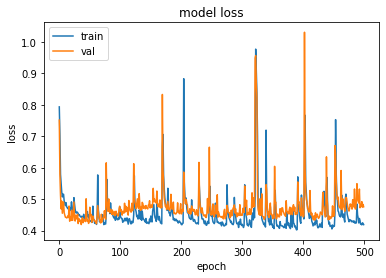

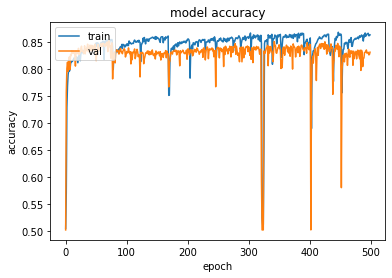

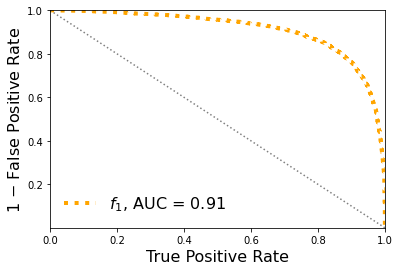

313/313 [==============================] - 3s 9ms/step - loss: 0.4833 - acc: 0.8366 - f1_m: 0.4554 - precision_m: 0.5005 - recall_m: 0.4189
Test ROC-AUC: 0.91046776
Test loss: 0.4832681119441986
Test accuracy: 0.8366000056266785
Test f1: 0.455443799495697
Test precision: 0.5005325078964233
Test recall: 0.41892972588539124
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 358ms/step - loss: 1.4282 - acc: 0.5038 - f1_m: 0.4457 - precision_m: 0.5015 - recall_m: 0.4275 - val_loss: 0.7729 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 2/500
94/94 [==============================] - 32s 344ms/step - loss: 0.7510 - acc: 0.5442 - f1_m: 0.5796 - precision_m: 0.5363 - recall_m: 0.6406 - val_loss: 0.6021 - val_acc: 0.7557 - val_f1_m: 0.7763 - val_precision_m: 0.7093 - va

Epoch 31/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4565 - acc: 0.8403 - f1_m: 0.8420 - precision_m: 0.8296 - recall_m: 0.8575 - val_loss: 0.4305 - val_acc: 0.8365 - val_f1_m: 0.8324 - val_precision_m: 0.8420 - val_recall_m: 0.8249
Epoch 32/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4430 - acc: 0.8398 - f1_m: 0.8418 - precision_m: 0.8290 - recall_m: 0.8580 - val_loss: 0.4260 - val_acc: 0.8420 - val_f1_m: 0.8390 - val_precision_m: 0.8416 - val_recall_m: 0.8383
Epoch 33/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4371 - acc: 0.8393 - f1_m: 0.8424 - precision_m: 0.8301 - recall_m: 0.8582 - val_loss: 0.4350 - val_acc: 0.8307 - val_f1_m: 0.8228 - val_precision_m: 0.8534 - val_recall_m: 0.7957
Epoch 34/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4390 - acc: 0.8445 - f1_m: 0.8471 - precision_m: 0.8353 - recall_m: 0.8629 - val_loss: 0.4313 - val_acc: 0.8418 - val_f1_m: 0.8378 - val_precisi

Epoch 63/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4262 - acc: 0.8506 - f1_m: 0.8546 - precision_m: 0.8382 - recall_m: 0.8767 - val_loss: 0.4267 - val_acc: 0.8482 - val_f1_m: 0.8507 - val_precision_m: 0.8252 - val_recall_m: 0.8795
Epoch 64/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4102 - acc: 0.8591 - f1_m: 0.8612 - precision_m: 0.8461 - recall_m: 0.8792 - val_loss: 0.4281 - val_acc: 0.8435 - val_f1_m: 0.8428 - val_precision_m: 0.8388 - val_recall_m: 0.8482
Epoch 65/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4043 - acc: 0.8630 - f1_m: 0.8663 - precision_m: 0.8496 - recall_m: 0.8866 - val_loss: 0.4254 - val_acc: 0.8470 - val_f1_m: 0.8452 - val_precision_m: 0.8444 - val_recall_m: 0.8477
Epoch 66/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4010 - acc: 0.8623 - f1_m: 0.8641 - precision_m: 0.8502 - recall_m: 0.8806 - val_loss: 0.4310 - val_acc: 0.8437 - val_f1_m: 0.8460 - val_precisi

Epoch 95/500
94/94 [==============================] - 32s 342ms/step - loss: 0.7257 - acc: 0.5044 - f1_m: 0.5465 - precision_m: 0.5028 - recall_m: 0.6194 - val_loss: 0.7218 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 96/500
94/94 [==============================] - 32s 342ms/step - loss: 0.7213 - acc: 0.5079 - f1_m: 0.6605 - precision_m: 0.5059 - recall_m: 0.9568 - val_loss: 0.7199 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 97/500
94/94 [==============================] - 32s 343ms/step - loss: 0.7194 - acc: 0.4985 - f1_m: 0.3785 - precision_m: 0.4977 - recall_m: 0.3217 - val_loss: 0.7170 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 98/500
94/94 [==============================] - 32s 344ms/step - loss: 0.7184 - acc: 0.4939 - f1_m: 0.5271 - precision_m: 0.4959 - recall_m: 0.6487 - val_loss: 0.7156 - val_acc: 0.4972 - val_f1_m: 0.6624 -

Epoch 126/500
94/94 [==============================] - 32s 340ms/step - loss: 0.7019 - acc: 0.5043 - f1_m: 0.6625 - precision_m: 0.5043 - recall_m: 0.9764 - val_loss: 0.7016 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 127/500
94/94 [==============================] - 32s 340ms/step - loss: 0.7019 - acc: 0.5064 - f1_m: 0.5473 - precision_m: 0.5047 - recall_m: 0.7071 - val_loss: 0.7012 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 128/500
94/94 [==============================] - 32s 339ms/step - loss: 0.7025 - acc: 0.5061 - f1_m: 0.6296 - precision_m: 0.5049 - recall_m: 0.8902 - val_loss: 0.7039 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 129/500
94/94 [==============================] - 32s 339ms/step - loss: 0.6987 - acc: 0.5173 - f1_m: 0.6683 - precision_m: 0.5150 - recall_m: 0.9670 - val_loss: 0.7363 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val

94/94 [==============================] - 32s 337ms/step - loss: 0.4258 - acc: 0.8448 - f1_m: 0.8449 - precision_m: 0.8367 - recall_m: 0.8548 - val_loss: 0.4336 - val_acc: 0.8378 - val_f1_m: 0.8408 - val_precision_m: 0.8138 - val_recall_m: 0.8715
Epoch 189/500
94/94 [==============================] - 32s 336ms/step - loss: 0.4154 - acc: 0.8486 - f1_m: 0.8500 - precision_m: 0.8403 - recall_m: 0.8621 - val_loss: 0.4346 - val_acc: 0.8278 - val_f1_m: 0.8232 - val_precision_m: 0.8323 - val_recall_m: 0.8164
Epoch 190/500
94/94 [==============================] - 32s 336ms/step - loss: 0.4191 - acc: 0.8444 - f1_m: 0.8473 - precision_m: 0.8342 - recall_m: 0.8628 - val_loss: 0.4251 - val_acc: 0.8392 - val_f1_m: 0.8406 - val_precision_m: 0.8181 - val_recall_m: 0.8661
Epoch 191/500
94/94 [==============================] - 32s 337ms/step - loss: 0.4369 - acc: 0.8409 - f1_m: 0.8419 - precision_m: 0.8321 - recall_m: 0.8554 - val_loss: 0.5481 - val_acc: 0.8083 - val_f1_m: 0.7936 - val_precision_m: 0.84

94/94 [==============================] - 33s 348ms/step - loss: 0.4244 - acc: 0.8533 - f1_m: 0.8564 - precision_m: 0.8489 - recall_m: 0.8665 - val_loss: 0.4588 - val_acc: 0.8380 - val_f1_m: 0.8442 - val_precision_m: 0.7965 - val_recall_m: 0.8990
Epoch 251/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4577 - acc: 0.8435 - f1_m: 0.8465 - precision_m: 0.8353 - recall_m: 0.8663 - val_loss: 0.4635 - val_acc: 0.8348 - val_f1_m: 0.8321 - val_precision_m: 0.8340 - val_recall_m: 0.8320
Epoch 252/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4289 - acc: 0.8541 - f1_m: 0.8540 - precision_m: 0.8498 - recall_m: 0.8601 - val_loss: 0.4362 - val_acc: 0.8382 - val_f1_m: 0.8415 - val_precision_m: 0.8076 - val_recall_m: 0.8799
Epoch 253/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4127 - acc: 0.8532 - f1_m: 0.8541 - precision_m: 0.8432 - recall_m: 0.8681 - val_loss: 0.4339 - val_acc: 0.8387 - val_f1_m: 0.8411 - val_precision_m: 0.81

94/94 [==============================] - 33s 349ms/step - loss: 0.7090 - acc: 0.5022 - f1_m: 0.5226 - precision_m: 0.5044 - recall_m: 0.5882 - val_loss: 0.7075 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 313/500
94/94 [==============================] - 33s 350ms/step - loss: 0.7080 - acc: 0.5038 - f1_m: 0.3476 - precision_m: 0.5096 - recall_m: 0.2967 - val_loss: 0.7074 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 314/500
94/94 [==============================] - 33s 349ms/step - loss: 0.7068 - acc: 0.5174 - f1_m: 0.5426 - precision_m: 0.5132 - recall_m: 0.6044 - val_loss: 0.7058 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 315/500
94/94 [==============================] - 33s 349ms/step - loss: 0.7055 - acc: 0.5018 - f1_m: 0.6003 - precision_m: 0.5014 - recall_m: 0.7620 - val_loss: 0.7048 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

94/94 [==============================] - 33s 349ms/step - loss: 0.4140 - acc: 0.8468 - f1_m: 0.8470 - precision_m: 0.8502 - recall_m: 0.8463 - val_loss: 0.4382 - val_acc: 0.8253 - val_f1_m: 0.8129 - val_precision_m: 0.8661 - val_recall_m: 0.7674
Epoch 375/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4173 - acc: 0.8518 - f1_m: 0.8497 - precision_m: 0.8543 - recall_m: 0.8476 - val_loss: 0.4134 - val_acc: 0.8462 - val_f1_m: 0.8488 - val_precision_m: 0.8244 - val_recall_m: 0.8765
Epoch 376/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4127 - acc: 0.8492 - f1_m: 0.8484 - precision_m: 0.8506 - recall_m: 0.8493 - val_loss: 0.4200 - val_acc: 0.8392 - val_f1_m: 0.8352 - val_precision_m: 0.8447 - val_recall_m: 0.8278
Epoch 377/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4138 - acc: 0.8505 - f1_m: 0.8490 - precision_m: 0.8527 - recall_m: 0.8472 - val_loss: 0.4190 - val_acc: 0.8373 - val_f1_m: 0.8352 - val_precision_m: 0.83

94/94 [==============================] - 33s 346ms/step - loss: 0.4065 - acc: 0.8543 - f1_m: 0.8563 - precision_m: 0.8489 - recall_m: 0.8661 - val_loss: 0.4333 - val_acc: 0.8347 - val_f1_m: 0.8300 - val_precision_m: 0.8378 - val_recall_m: 0.8240
Epoch 437/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4020 - acc: 0.8603 - f1_m: 0.8616 - precision_m: 0.8549 - recall_m: 0.8708 - val_loss: 0.4323 - val_acc: 0.8365 - val_f1_m: 0.8424 - val_precision_m: 0.8019 - val_recall_m: 0.8887
Epoch 438/500
94/94 [==============================] - 33s 346ms/step - loss: 0.3930 - acc: 0.8604 - f1_m: 0.8610 - precision_m: 0.8515 - recall_m: 0.8730 - val_loss: 0.4319 - val_acc: 0.8352 - val_f1_m: 0.8302 - val_precision_m: 0.8434 - val_recall_m: 0.8190
Epoch 439/500
94/94 [==============================] - 33s 347ms/step - loss: 0.3973 - acc: 0.8568 - f1_m: 0.8578 - precision_m: 0.8524 - recall_m: 0.8657 - val_loss: 0.4403 - val_acc: 0.8365 - val_f1_m: 0.8439 - val_precision_m: 0.79

94/94 [==============================] - 32s 344ms/step - loss: 0.4398 - acc: 0.8336 - f1_m: 0.8375 - precision_m: 0.8184 - recall_m: 0.8608 - val_loss: 0.4384 - val_acc: 0.8248 - val_f1_m: 0.8166 - val_precision_m: 0.8449 - val_recall_m: 0.7920
Epoch 499/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4296 - acc: 0.8352 - f1_m: 0.8373 - precision_m: 0.8291 - recall_m: 0.8495 - val_loss: 0.4363 - val_acc: 0.8295 - val_f1_m: 0.8325 - val_precision_m: 0.8089 - val_recall_m: 0.8595
Epoch 500/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4278 - acc: 0.8414 - f1_m: 0.8453 - precision_m: 0.8319 - recall_m: 0.8633 - val_loss: 0.4298 - val_acc: 0.8325 - val_f1_m: 0.8342 - val_precision_m: 0.8130 - val_recall_m: 0.8580


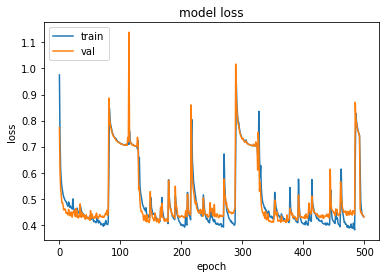

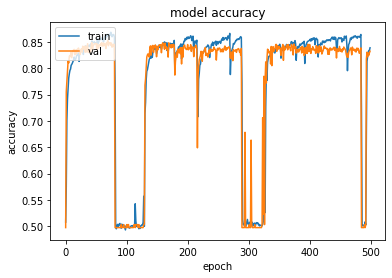

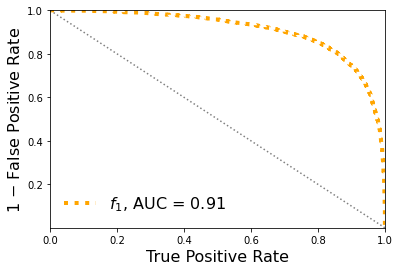

313/313 [==============================] - 3s 9ms/step - loss: 0.4353 - acc: 0.8305 - f1_m: 0.4601 - precision_m: 0.5000 - recall_m: 0.4274
Test ROC-AUC: 0.9076512000000001
Test loss: 0.4353073239326477
Test accuracy: 0.8305000066757202
Test f1: 0.4600701928138733
Test precision: 0.5
Test recall: 0.4274161458015442
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 35s 90ms/step - loss: 0.8355 - acc: 0.6450 - f1_m: 0.6639 - precision_m: 0.6358 - recall_m: 0.7173 - val_loss: 0.5540 - val_acc: 0.7932 - val_f1_m: 0.8006 - val_precision_m: 0.7626 - val_recall_m: 0.8481
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6144 - acc: 0.7623 - f1_m: 0.7741 - precision_m: 0.7391 - recall_m: 0.8260 - val_loss: 0.5321 - val_acc: 0.8077 - val_f1_m: 0.8061 - val_precision_m: 0.8014 - val_recal

Epoch 31/500
375/375 [==============================] - 33s 88ms/step - loss: 0.5201 - acc: 0.8029 - f1_m: 0.8079 - precision_m: 0.7875 - recall_m: 0.8443 - val_loss: 0.5310 - val_acc: 0.8188 - val_f1_m: 0.8347 - val_precision_m: 0.7558 - val_recall_m: 0.9376
Epoch 32/500
375/375 [==============================] - 33s 88ms/step - loss: 0.5050 - acc: 0.8094 - f1_m: 0.8114 - precision_m: 0.7915 - recall_m: 0.8430 - val_loss: 0.4535 - val_acc: 0.8335 - val_f1_m: 0.8251 - val_precision_m: 0.8525 - val_recall_m: 0.8038
Epoch 33/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4827 - acc: 0.8189 - f1_m: 0.8229 - precision_m: 0.8024 - recall_m: 0.8522 - val_loss: 0.4576 - val_acc: 0.8322 - val_f1_m: 0.8376 - val_precision_m: 0.7998 - val_recall_m: 0.8843
Epoch 34/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4770 - acc: 0.8249 - f1_m: 0.8300 - precision_m: 0.8057 - recall_m: 0.8629 - val_loss: 0.4611 - val_acc: 0.8278 - val_f1_m: 0.8191 - val_pre

375/375 [==============================] - 33s 87ms/step - loss: 0.4850 - acc: 0.8262 - f1_m: 0.8297 - precision_m: 0.8075 - recall_m: 0.8631 - val_loss: 0.4434 - val_acc: 0.8363 - val_f1_m: 0.8321 - val_precision_m: 0.8440 - val_recall_m: 0.8248
Epoch 94/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4682 - acc: 0.8288 - f1_m: 0.8317 - precision_m: 0.8184 - recall_m: 0.8542 - val_loss: 0.4585 - val_acc: 0.8447 - val_f1_m: 0.8505 - val_precision_m: 0.8084 - val_recall_m: 0.9020
Epoch 95/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4827 - acc: 0.8227 - f1_m: 0.8271 - precision_m: 0.8080 - recall_m: 0.8577 - val_loss: 0.4762 - val_acc: 0.8310 - val_f1_m: 0.8443 - val_precision_m: 0.7736 - val_recall_m: 0.9349
Epoch 96/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4872 - acc: 0.8277 - f1_m: 0.8281 - precision_m: 0.8138 - recall_m: 0.8533 - val_loss: 0.4666 - val_acc: 0.8335 - val_f1_m: 0.8209 - val_precision_m: 0.8

375/375 [==============================] - 33s 87ms/step - loss: 0.4695 - acc: 0.8294 - f1_m: 0.8327 - precision_m: 0.8136 - recall_m: 0.8619 - val_loss: 0.4612 - val_acc: 0.8250 - val_f1_m: 0.8145 - val_precision_m: 0.8505 - val_recall_m: 0.7857
Epoch 156/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4838 - acc: 0.8273 - f1_m: 0.8325 - precision_m: 0.8122 - recall_m: 0.8646 - val_loss: 0.4446 - val_acc: 0.8442 - val_f1_m: 0.8434 - val_precision_m: 0.8357 - val_recall_m: 0.8557
Epoch 157/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4645 - acc: 0.8306 - f1_m: 0.8319 - precision_m: 0.8114 - recall_m: 0.8626 - val_loss: 0.4193 - val_acc: 0.8452 - val_f1_m: 0.8429 - val_precision_m: 0.8436 - val_recall_m: 0.8466
Epoch 158/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4710 - acc: 0.8292 - f1_m: 0.8296 - precision_m: 0.8138 - recall_m: 0.8557 - val_loss: 0.4417 - val_acc: 0.8493 - val_f1_m: 0.8529 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4580 - acc: 0.8351 - f1_m: 0.8375 - precision_m: 0.8225 - recall_m: 0.8614 - val_loss: 0.4286 - val_acc: 0.8483 - val_f1_m: 0.8497 - val_precision_m: 0.8304 - val_recall_m: 0.8746
Epoch 218/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4817 - acc: 0.8239 - f1_m: 0.8276 - precision_m: 0.8088 - recall_m: 0.8583 - val_loss: 0.4272 - val_acc: 0.8477 - val_f1_m: 0.8530 - val_precision_m: 0.8125 - val_recall_m: 0.9027
Epoch 219/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4584 - acc: 0.8315 - f1_m: 0.8342 - precision_m: 0.8167 - recall_m: 0.8606 - val_loss: 0.4452 - val_acc: 0.8343 - val_f1_m: 0.8483 - val_precision_m: 0.7723 - val_recall_m: 0.9454
Epoch 220/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4746 - acc: 0.8282 - f1_m: 0.8327 - precision_m: 0.8067 - recall_m: 0.8706 - val_loss: 0.4533 - val_acc: 0.8492 - val_f1_m: 0.8496 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4827 - acc: 0.8290 - f1_m: 0.8321 - precision_m: 0.8128 - recall_m: 0.8664 - val_loss: 0.4493 - val_acc: 0.8393 - val_f1_m: 0.8499 - val_precision_m: 0.7879 - val_recall_m: 0.9278
Epoch 280/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4629 - acc: 0.8306 - f1_m: 0.8335 - precision_m: 0.8191 - recall_m: 0.8581 - val_loss: 0.4495 - val_acc: 0.8450 - val_f1_m: 0.8404 - val_precision_m: 0.8542 - val_recall_m: 0.8317
Epoch 281/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4663 - acc: 0.8332 - f1_m: 0.8374 - precision_m: 0.8132 - recall_m: 0.8704 - val_loss: 0.4349 - val_acc: 0.8488 - val_f1_m: 0.8509 - val_precision_m: 0.8277 - val_recall_m: 0.8797
Epoch 282/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4715 - acc: 0.8326 - f1_m: 0.8357 - precision_m: 0.8161 - recall_m: 0.8678 - val_loss: 0.4311 - val_acc: 0.8423 - val_f1_m: 0.8468 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4738 - acc: 0.8340 - f1_m: 0.8384 - precision_m: 0.8162 - recall_m: 0.8717 - val_loss: 0.4316 - val_acc: 0.8423 - val_f1_m: 0.8484 - val_precision_m: 0.8051 - val_recall_m: 0.9018
Epoch 342/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4682 - acc: 0.8311 - f1_m: 0.8373 - precision_m: 0.8160 - recall_m: 0.8687 - val_loss: 1.0966 - val_acc: 0.6097 - val_f1_m: 0.3555 - val_precision_m: 0.9730 - val_recall_m: 0.2211
Epoch 343/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4897 - acc: 0.8218 - f1_m: 0.8210 - precision_m: 0.8110 - recall_m: 0.8516 - val_loss: 0.4799 - val_acc: 0.8248 - val_f1_m: 0.8081 - val_precision_m: 0.8793 - val_recall_m: 0.7527
Epoch 344/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4557 - acc: 0.8358 - f1_m: 0.8354 - precision_m: 0.8189 - recall_m: 0.8606 - val_loss: 0.4392 - val_acc: 0.8432 - val_f1_m: 0.8516 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4945 - acc: 0.8216 - f1_m: 0.8253 - precision_m: 0.8103 - recall_m: 0.8557 - val_loss: 0.4202 - val_acc: 0.8415 - val_f1_m: 0.8345 - val_precision_m: 0.8605 - val_recall_m: 0.8139
Epoch 404/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4585 - acc: 0.8323 - f1_m: 0.8337 - precision_m: 0.8139 - recall_m: 0.8629 - val_loss: 0.4393 - val_acc: 0.8485 - val_f1_m: 0.8507 - val_precision_m: 0.8300 - val_recall_m: 0.8771
Epoch 405/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4751 - acc: 0.8316 - f1_m: 0.8363 - precision_m: 0.8154 - recall_m: 0.8699 - val_loss: 0.4219 - val_acc: 0.8487 - val_f1_m: 0.8487 - val_precision_m: 0.8370 - val_recall_m: 0.8646
Epoch 406/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4592 - acc: 0.8369 - f1_m: 0.8383 - precision_m: 0.8181 - recall_m: 0.8680 - val_loss: 0.5284 - val_acc: 0.8402 - val_f1_m: 0.8451 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4573 - acc: 0.8396 - f1_m: 0.8437 - precision_m: 0.8244 - recall_m: 0.8715 - val_loss: 0.4370 - val_acc: 0.8415 - val_f1_m: 0.8365 - val_precision_m: 0.8497 - val_recall_m: 0.8281
Epoch 466/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4752 - acc: 0.8278 - f1_m: 0.8329 - precision_m: 0.8072 - recall_m: 0.8706 - val_loss: 0.4552 - val_acc: 0.8382 - val_f1_m: 0.8503 - val_precision_m: 0.7818 - val_recall_m: 0.9366
Epoch 467/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4596 - acc: 0.8331 - f1_m: 0.8373 - precision_m: 0.8149 - recall_m: 0.8689 - val_loss: 0.4155 - val_acc: 0.8472 - val_f1_m: 0.8561 - val_precision_m: 0.7978 - val_recall_m: 0.9285
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4679 - acc: 0.8306 - f1_m: 0.8298 - precision_m: 0.8158 - recall_m: 0.8534 - val_loss: 0.4344 - val_acc: 0.8482 - val_f1_m: 0.8545 - val_precision_m: 

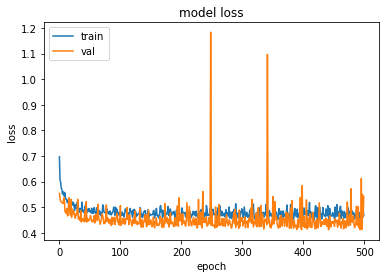

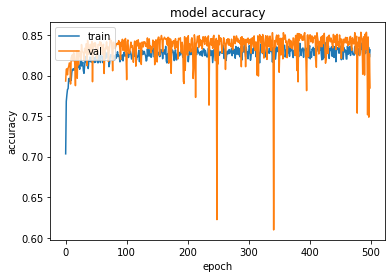

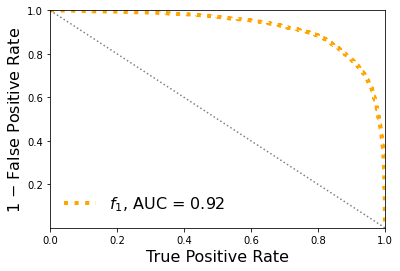

313/313 [==============================] - 3s 9ms/step - loss: 0.5439 - acc: 0.7751 - f1_m: 0.4928 - precision_m: 0.4997 - recall_m: 0.4868
Test ROC-AUC: 0.92240574
Test loss: 0.5438936948776245
Test accuracy: 0.7750999927520752
Test f1: 0.4927881360054016
Test precision: 0.4997180700302124
Test recall: 0.48682108521461487
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 33s 170ms/step - loss: 1.0500 - acc: 0.5593 - f1_m: 0.6197 - precision_m: 0.5591 - recall_m: 0.7606 - val_loss: 0.6374 - val_acc: 0.7537 - val_f1_m: 0.7662 - val_precision_m: 0.7231 - val_recall_m: 0.8172
Epoch 2/500
188/188 [==============================] - 31s 166ms/step - loss: 0.6604 - acc: 0.7213 - f1_m: 0.7430 - precision_m: 0.6883 - recall_m: 0.8161 - val_loss: 0.5749 - val_acc: 0.7808 - val_f1_m: 0.7956 - val_precision_m: 0.7390 

188/188 [==============================] - 32s 169ms/step - loss: 0.4443 - acc: 0.8391 - f1_m: 0.8421 - precision_m: 0.8216 - recall_m: 0.8683 - val_loss: 0.4613 - val_acc: 0.8363 - val_f1_m: 0.8470 - val_precision_m: 0.7885 - val_recall_m: 0.9176
Epoch 62/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4670 - acc: 0.8317 - f1_m: 0.8357 - precision_m: 0.8129 - recall_m: 0.8650 - val_loss: 0.4446 - val_acc: 0.8340 - val_f1_m: 0.8267 - val_precision_m: 0.8547 - val_recall_m: 0.8036
Epoch 63/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4360 - acc: 0.8425 - f1_m: 0.8484 - precision_m: 0.8241 - recall_m: 0.8795 - val_loss: 0.4749 - val_acc: 0.8355 - val_f1_m: 0.8304 - val_precision_m: 0.8472 - val_recall_m: 0.8166
Epoch 64/500
188/188 [==============================] - 32s 168ms/step - loss: 0.5154 - acc: 0.8127 - f1_m: 0.8171 - precision_m: 0.7990 - recall_m: 0.8466 - val_loss: 0.4576 - val_acc: 0.8388 - val_f1_m: 0.8472 - val_precision_m:

188/188 [==============================] - 32s 170ms/step - loss: 0.4321 - acc: 0.8463 - f1_m: 0.8504 - precision_m: 0.8259 - recall_m: 0.8816 - val_loss: 0.4474 - val_acc: 0.8460 - val_f1_m: 0.8452 - val_precision_m: 0.8422 - val_recall_m: 0.8509
Epoch 124/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4708 - acc: 0.8319 - f1_m: 0.8356 - precision_m: 0.8126 - recall_m: 0.8679 - val_loss: 0.4454 - val_acc: 0.8382 - val_f1_m: 0.8490 - val_precision_m: 0.7896 - val_recall_m: 0.9209
Epoch 125/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4361 - acc: 0.8455 - f1_m: 0.8504 - precision_m: 0.8213 - recall_m: 0.8863 - val_loss: 0.4244 - val_acc: 0.8478 - val_f1_m: 0.8481 - val_precision_m: 0.8385 - val_recall_m: 0.8604
Epoch 126/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4288 - acc: 0.8467 - f1_m: 0.8503 - precision_m: 0.8303 - recall_m: 0.8775 - val_loss: 0.4228 - val_acc: 0.8470 - val_f1_m: 0.8501 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4277 - acc: 0.8455 - f1_m: 0.8512 - precision_m: 0.8284 - recall_m: 0.8792 - val_loss: 0.4347 - val_acc: 0.8450 - val_f1_m: 0.8534 - val_precision_m: 0.8041 - val_recall_m: 0.9119
Epoch 186/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5356 - acc: 0.8149 - f1_m: 0.8230 - precision_m: 0.7965 - recall_m: 0.8653 - val_loss: 0.4407 - val_acc: 0.8427 - val_f1_m: 0.8376 - val_precision_m: 0.8578 - val_recall_m: 0.8210
Epoch 187/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4362 - acc: 0.8436 - f1_m: 0.8487 - precision_m: 0.8218 - recall_m: 0.8810 - val_loss: 0.4308 - val_acc: 0.8427 - val_f1_m: 0.8488 - val_precision_m: 0.8101 - val_recall_m: 0.8938
Epoch 188/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4424 - acc: 0.8405 - f1_m: 0.8448 - precision_m: 0.8209 - recall_m: 0.8762 - val_loss: 0.4359 - val_acc: 0.8490 - val_f1_m: 0.8518 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4766 - acc: 0.8243 - f1_m: 0.8315 - precision_m: 0.8070 - recall_m: 0.8671 - val_loss: 0.4255 - val_acc: 0.8497 - val_f1_m: 0.8498 - val_precision_m: 0.8416 - val_recall_m: 0.8609
Epoch 248/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4257 - acc: 0.8470 - f1_m: 0.8503 - precision_m: 0.8220 - recall_m: 0.8842 - val_loss: 0.4102 - val_acc: 0.8472 - val_f1_m: 0.8462 - val_precision_m: 0.8450 - val_recall_m: 0.8505
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4459 - acc: 0.8399 - f1_m: 0.8435 - precision_m: 0.8222 - recall_m: 0.8732 - val_loss: 0.4217 - val_acc: 0.8413 - val_f1_m: 0.8424 - val_precision_m: 0.8310 - val_recall_m: 0.8573
Epoch 250/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4297 - acc: 0.8456 - f1_m: 0.8478 - precision_m: 0.8268 - recall_m: 0.8752 - val_loss: 0.4252 - val_acc: 0.8480 - val_f1_m: 0.8542 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4154 - acc: 0.8502 - f1_m: 0.8543 - precision_m: 0.8295 - recall_m: 0.8848 - val_loss: 0.4940 - val_acc: 0.8352 - val_f1_m: 0.8250 - val_precision_m: 0.8706 - val_recall_m: 0.7863
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5063 - acc: 0.8164 - f1_m: 0.8223 - precision_m: 0.7990 - recall_m: 0.8590 - val_loss: 0.4289 - val_acc: 0.8483 - val_f1_m: 0.8539 - val_precision_m: 0.8180 - val_recall_m: 0.8959
Epoch 311/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4517 - acc: 0.8432 - f1_m: 0.8486 - precision_m: 0.8246 - recall_m: 0.8795 - val_loss: 0.4158 - val_acc: 0.8482 - val_f1_m: 0.8447 - val_precision_m: 0.8560 - val_recall_m: 0.8367
Epoch 312/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4237 - acc: 0.8539 - f1_m: 0.8557 - precision_m: 0.8384 - recall_m: 0.8795 - val_loss: 0.4150 - val_acc: 0.8507 - val_f1_m: 0.8580 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.5128 - acc: 0.8174 - f1_m: 0.8238 - precision_m: 0.8047 - recall_m: 0.8586 - val_loss: 0.4288 - val_acc: 0.8487 - val_f1_m: 0.8475 - val_precision_m: 0.8475 - val_recall_m: 0.8501
Epoch 372/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4389 - acc: 0.8478 - f1_m: 0.8502 - precision_m: 0.8344 - recall_m: 0.8730 - val_loss: 0.4559 - val_acc: 0.8283 - val_f1_m: 0.8130 - val_precision_m: 0.8842 - val_recall_m: 0.7546
Epoch 373/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4210 - acc: 0.8507 - f1_m: 0.8553 - precision_m: 0.8388 - recall_m: 0.8782 - val_loss: 0.4353 - val_acc: 0.8370 - val_f1_m: 0.8269 - val_precision_m: 0.8750 - val_recall_m: 0.7865
Epoch 374/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4309 - acc: 0.8430 - f1_m: 0.8460 - precision_m: 0.8243 - recall_m: 0.8762 - val_loss: 0.4553 - val_acc: 0.8327 - val_f1_m: 0.8228 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.5944 - acc: 0.7913 - f1_m: 0.7968 - precision_m: 0.7862 - recall_m: 0.8362 - val_loss: 0.4514 - val_acc: 0.8385 - val_f1_m: 0.8505 - val_precision_m: 0.7856 - val_recall_m: 0.9302
Epoch 434/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4473 - acc: 0.8413 - f1_m: 0.8447 - precision_m: 0.8167 - recall_m: 0.8808 - val_loss: 0.4116 - val_acc: 0.8527 - val_f1_m: 0.8556 - val_precision_m: 0.8319 - val_recall_m: 0.8832
Epoch 435/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4219 - acc: 0.8504 - f1_m: 0.8553 - precision_m: 0.8338 - recall_m: 0.8820 - val_loss: 0.4298 - val_acc: 0.8528 - val_f1_m: 0.8565 - val_precision_m: 0.8298 - val_recall_m: 0.8877
Epoch 436/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4402 - acc: 0.8423 - f1_m: 0.8478 - precision_m: 0.8244 - recall_m: 0.8770 - val_loss: 0.4160 - val_acc: 0.8512 - val_f1_m: 0.8519 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4298 - acc: 0.8490 - f1_m: 0.8533 - precision_m: 0.8371 - recall_m: 0.8742 - val_loss: 0.4189 - val_acc: 0.8463 - val_f1_m: 0.8407 - val_precision_m: 0.8650 - val_recall_m: 0.8205
Epoch 496/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4314 - acc: 0.8473 - f1_m: 0.8506 - precision_m: 0.8327 - recall_m: 0.8762 - val_loss: 0.4035 - val_acc: 0.8513 - val_f1_m: 0.8553 - val_precision_m: 0.8270 - val_recall_m: 0.8881
Epoch 497/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4465 - acc: 0.8383 - f1_m: 0.8419 - precision_m: 0.8203 - recall_m: 0.8726 - val_loss: 0.4343 - val_acc: 0.8390 - val_f1_m: 0.8518 - val_precision_m: 0.7838 - val_recall_m: 0.9352
Epoch 498/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4203 - acc: 0.8516 - f1_m: 0.8556 - precision_m: 0.8357 - recall_m: 0.8817 - val_loss: 0.4052 - val_acc: 0.8495 - val_f1_m: 0.8505 - val_precision

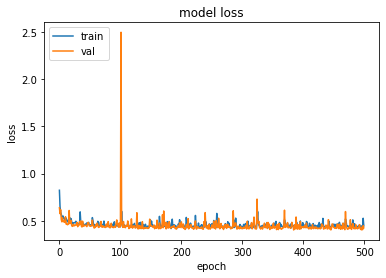

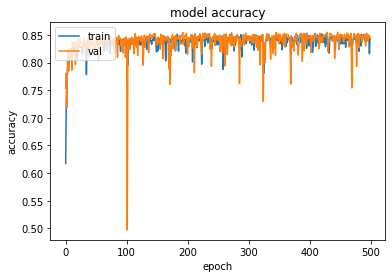

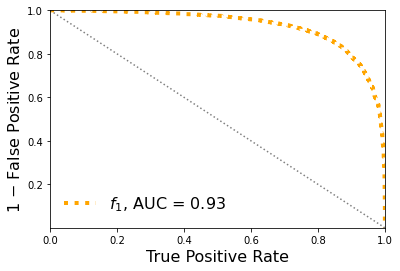

313/313 [==============================] - 3s 9ms/step - loss: 0.4349 - acc: 0.8461 - f1_m: 0.4464 - precision_m: 0.5000 - recall_m: 0.4047
Test ROC-AUC: 0.9281969199999999
Test loss: 0.4349066913127899
Test accuracy: 0.8460999727249146
Test f1: 0.4464271366596222
Test precision: 0.5
Test recall: 0.40465256571769714
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 359ms/step - loss: 2.3790 - acc: 0.4986 - f1_m: 0.5370 - precision_m: 0.4757 - recall_m: 0.6340 - val_loss: 0.8068 - val_acc: 0.6685 - val_f1_m: 0.7426 - val_precision_m: 0.6024 - val_recall_m: 0.9702
Epoch 2/500
94/94 [==============================] - 33s 351ms/step - loss: 0.7779 - acc: 0.6166 - f1_m: 0.6176 - precision_m: 0.6241 - recall_m: 0.6262 - val_loss: 0.6535 - val_acc: 0.7555 - val_f1_m: 0.7752 - val_precision_m: 0.7098 - val_recal

Epoch 31/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4513 - acc: 0.8516 - f1_m: 0.8541 - precision_m: 0.8434 - recall_m: 0.8689 - val_loss: 0.4522 - val_acc: 0.8405 - val_f1_m: 0.8440 - val_precision_m: 0.8135 - val_recall_m: 0.8782
Epoch 32/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4540 - acc: 0.8499 - f1_m: 0.8526 - precision_m: 0.8420 - recall_m: 0.8666 - val_loss: 0.4671 - val_acc: 0.8403 - val_f1_m: 0.8480 - val_precision_m: 0.8006 - val_recall_m: 0.9035
Epoch 33/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4701 - acc: 0.8423 - f1_m: 0.8438 - precision_m: 0.8368 - recall_m: 0.8563 - val_loss: 0.4588 - val_acc: 0.8385 - val_f1_m: 0.8429 - val_precision_m: 0.8106 - val_recall_m: 0.8797
Epoch 34/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4481 - acc: 0.8493 - f1_m: 0.8518 - precision_m: 0.8379 - recall_m: 0.8693 - val_loss: 0.4588 - val_acc: 0.8423 - val_f1_m: 0.8490 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4412 - acc: 0.8452 - f1_m: 0.8478 - precision_m: 0.8330 - recall_m: 0.8674 - val_loss: 0.4372 - val_acc: 0.8402 - val_f1_m: 0.8336 - val_precision_m: 0.8551 - val_recall_m: 0.8150
Epoch 64/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4469 - acc: 0.8390 - f1_m: 0.8431 - precision_m: 0.8262 - recall_m: 0.8650 - val_loss: 0.4360 - val_acc: 0.8392 - val_f1_m: 0.8318 - val_precision_m: 0.8573 - val_recall_m: 0.8095
Epoch 65/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4440 - acc: 0.8431 - f1_m: 0.8474 - precision_m: 0.8318 - recall_m: 0.8673 - val_loss: 0.4328 - val_acc: 0.8458 - val_f1_m: 0.8515 - val_precision_m: 0.8118 - val_recall_m: 0.8968
Epoch 66/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4297 - acc: 0.8495 - f1_m: 0.8511 - precision_m: 0.8345 - recall_m: 0.8721 - val_loss: 0.4398 - val_acc: 0.8382 - val_f1_m: 0.8318 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 348ms/step - loss: 0.6625 - acc: 0.7359 - f1_m: 0.7473 - precision_m: 0.7261 - recall_m: 0.8084 - val_loss: 0.4670 - val_acc: 0.8442 - val_f1_m: 0.8469 - val_precision_m: 0.8198 - val_recall_m: 0.8776
Epoch 96/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4809 - acc: 0.8352 - f1_m: 0.8384 - precision_m: 0.8148 - recall_m: 0.8691 - val_loss: 0.4748 - val_acc: 0.8405 - val_f1_m: 0.8426 - val_precision_m: 0.8194 - val_recall_m: 0.8685
Epoch 97/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4835 - acc: 0.8327 - f1_m: 0.8379 - precision_m: 0.8168 - recall_m: 0.8649 - val_loss: 0.4443 - val_acc: 0.8437 - val_f1_m: 0.8494 - val_precision_m: 0.8068 - val_recall_m: 0.8978
Epoch 98/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4407 - acc: 0.8506 - f1_m: 0.8521 - precision_m: 0.8378 - recall_m: 0.8704 - val_loss: 0.4358 - val_acc: 0.8467 - val_f1_m: 0.8504 - val_precisi

94/94 [==============================] - 33s 347ms/step - loss: 0.4210 - acc: 0.8518 - f1_m: 0.8549 - precision_m: 0.8343 - recall_m: 0.8805 - val_loss: 0.4685 - val_acc: 0.8107 - val_f1_m: 0.7957 - val_precision_m: 0.8589 - val_recall_m: 0.7427
Epoch 158/500
94/94 [==============================] - 33s 347ms/step - loss: 0.5333 - acc: 0.8043 - f1_m: 0.8119 - precision_m: 0.7895 - recall_m: 0.8472 - val_loss: 0.4889 - val_acc: 0.8263 - val_f1_m: 0.8438 - val_precision_m: 0.7599 - val_recall_m: 0.9497
Epoch 159/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4615 - acc: 0.8406 - f1_m: 0.8469 - precision_m: 0.8141 - recall_m: 0.8866 - val_loss: 0.4370 - val_acc: 0.8522 - val_f1_m: 0.8577 - val_precision_m: 0.8164 - val_recall_m: 0.9048
Epoch 160/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4292 - acc: 0.8517 - f1_m: 0.8567 - precision_m: 0.8271 - recall_m: 0.8915 - val_loss: 0.4221 - val_acc: 0.8518 - val_f1_m: 0.8501 - val_precision_m: 0.84

94/94 [==============================] - 32s 345ms/step - loss: 0.6566 - acc: 0.7502 - f1_m: 0.7735 - precision_m: 0.7147 - recall_m: 0.8541 - val_loss: 0.6121 - val_acc: 0.7773 - val_f1_m: 0.7487 - val_precision_m: 0.8504 - val_recall_m: 0.6706
Epoch 220/500
94/94 [==============================] - 32s 345ms/step - loss: 0.5909 - acc: 0.7842 - f1_m: 0.7945 - precision_m: 0.7569 - recall_m: 0.8452 - val_loss: 0.4797 - val_acc: 0.8183 - val_f1_m: 0.8343 - val_precision_m: 0.7621 - val_recall_m: 0.9236
Epoch 221/500
94/94 [==============================] - 33s 347ms/step - loss: 0.5041 - acc: 0.8120 - f1_m: 0.8194 - precision_m: 0.7865 - recall_m: 0.8636 - val_loss: 0.4629 - val_acc: 0.8452 - val_f1_m: 0.8544 - val_precision_m: 0.7969 - val_recall_m: 0.9227
Epoch 222/500
94/94 [==============================] - 32s 345ms/step - loss: 0.4724 - acc: 0.8317 - f1_m: 0.8355 - precision_m: 0.8185 - recall_m: 0.8600 - val_loss: 0.4286 - val_acc: 0.8473 - val_f1_m: 0.8422 - val_precision_m: 0.85

94/94 [==============================] - 32s 345ms/step - loss: 0.4384 - acc: 0.8445 - f1_m: 0.8455 - precision_m: 0.8332 - recall_m: 0.8655 - val_loss: 0.4532 - val_acc: 0.8472 - val_f1_m: 0.8426 - val_precision_m: 0.8535 - val_recall_m: 0.8330
Epoch 282/500
94/94 [==============================] - 32s 343ms/step - loss: 0.5138 - acc: 0.8149 - f1_m: 0.8224 - precision_m: 0.7977 - recall_m: 0.8601 - val_loss: 0.4549 - val_acc: 0.8398 - val_f1_m: 0.8520 - val_precision_m: 0.7836 - val_recall_m: 0.9351
Epoch 283/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4611 - acc: 0.8362 - f1_m: 0.8421 - precision_m: 0.8124 - recall_m: 0.8790 - val_loss: 0.4236 - val_acc: 0.8515 - val_f1_m: 0.8574 - val_precision_m: 0.8138 - val_recall_m: 0.9072
Epoch 284/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4409 - acc: 0.8437 - f1_m: 0.8482 - precision_m: 0.8286 - recall_m: 0.8729 - val_loss: 0.4368 - val_acc: 0.8367 - val_f1_m: 0.8405 - val_precision_m: 0.81

94/94 [==============================] - 33s 355ms/step - loss: 0.4060 - acc: 0.8578 - f1_m: 0.8607 - precision_m: 0.8422 - recall_m: 0.8821 - val_loss: 0.4084 - val_acc: 0.8558 - val_f1_m: 0.8597 - val_precision_m: 0.8242 - val_recall_m: 0.8998
Epoch 344/500
94/94 [==============================] - 33s 353ms/step - loss: 0.3920 - acc: 0.8613 - f1_m: 0.8634 - precision_m: 0.8501 - recall_m: 0.8805 - val_loss: 0.4060 - val_acc: 0.8532 - val_f1_m: 0.8526 - val_precision_m: 0.8411 - val_recall_m: 0.8659
Epoch 345/500
94/94 [==============================] - 33s 354ms/step - loss: 0.3861 - acc: 0.8679 - f1_m: 0.8706 - precision_m: 0.8569 - recall_m: 0.8873 - val_loss: 0.4473 - val_acc: 0.8333 - val_f1_m: 0.8181 - val_precision_m: 0.8884 - val_recall_m: 0.7602
Epoch 346/500
94/94 [==============================] - 33s 355ms/step - loss: 0.3889 - acc: 0.8676 - f1_m: 0.8700 - precision_m: 0.8577 - recall_m: 0.8853 - val_loss: 0.4109 - val_acc: 0.8475 - val_f1_m: 0.8436 - val_precision_m: 0.85

94/94 [==============================] - 33s 352ms/step - loss: 0.4075 - acc: 0.8572 - f1_m: 0.8621 - precision_m: 0.8394 - recall_m: 0.8895 - val_loss: 0.4033 - val_acc: 0.8543 - val_f1_m: 0.8580 - val_precision_m: 0.8230 - val_recall_m: 0.8975
Epoch 406/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4447 - acc: 0.8446 - f1_m: 0.8472 - precision_m: 0.8351 - recall_m: 0.8692 - val_loss: 0.4484 - val_acc: 0.8382 - val_f1_m: 0.8518 - val_precision_m: 0.7755 - val_recall_m: 0.9460
Epoch 407/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4330 - acc: 0.8522 - f1_m: 0.8583 - precision_m: 0.8297 - recall_m: 0.8915 - val_loss: 0.4247 - val_acc: 0.8455 - val_f1_m: 0.8377 - val_precision_m: 0.8713 - val_recall_m: 0.8079
Epoch 408/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4184 - acc: 0.8569 - f1_m: 0.8607 - precision_m: 0.8447 - recall_m: 0.8818 - val_loss: 0.5379 - val_acc: 0.7897 - val_f1_m: 0.8214 - val_precision_m: 0.70

94/94 [==============================] - 33s 353ms/step - loss: 0.4045 - acc: 0.8612 - f1_m: 0.8639 - precision_m: 0.8419 - recall_m: 0.8906 - val_loss: 0.4320 - val_acc: 0.8507 - val_f1_m: 0.8492 - val_precision_m: 0.8494 - val_recall_m: 0.8508
Epoch 468/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4553 - acc: 0.8408 - f1_m: 0.8436 - precision_m: 0.8210 - recall_m: 0.8721 - val_loss: 0.4354 - val_acc: 0.8458 - val_f1_m: 0.8571 - val_precision_m: 0.7893 - val_recall_m: 0.9392
Epoch 469/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4251 - acc: 0.8526 - f1_m: 0.8571 - precision_m: 0.8341 - recall_m: 0.8865 - val_loss: 0.4244 - val_acc: 0.8502 - val_f1_m: 0.8487 - val_precision_m: 0.8476 - val_recall_m: 0.8517
Epoch 470/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4642 - acc: 0.8358 - f1_m: 0.8392 - precision_m: 0.8243 - recall_m: 0.8683 - val_loss: 0.4232 - val_acc: 0.8522 - val_f1_m: 0.8600 - val_precision_m: 0.80

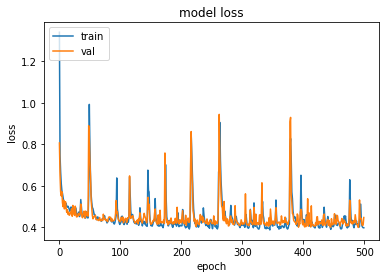

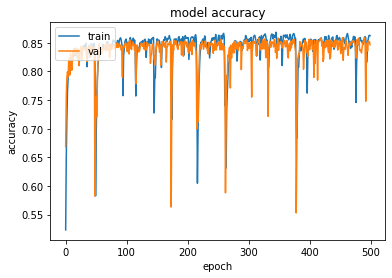

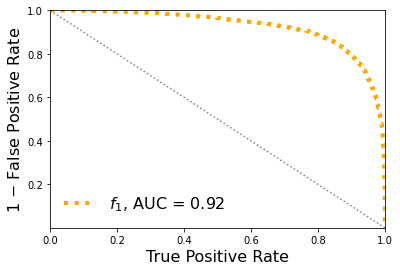

313/313 [==============================] - 3s 9ms/step - loss: 0.4504 - acc: 0.8397 - f1_m: 0.4805 - precision_m: 0.5001 - recall_m: 0.4633
Test ROC-AUC: 0.92458482
Test loss: 0.450376957654953
Test accuracy: 0.8396999835968018
Test f1: 0.4805399775505066
Test precision: 0.5001229047775269
Test recall: 0.4632587730884552
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 35s 89ms/step - loss: 1.0845 - acc: 0.5533 - f1_m: 0.4642 - precision_m: 0.5640 - recall_m: 0.4499 - val_loss: 0.6048 - val_acc: 0.7590 - val_f1_m: 0.7344 - val_precision_m: 0.8034 - val_recall_m: 0.6822
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6584 - acc: 0.6604 - f1_m: 0.6300 - precision_m: 0.6931 - recall_m: 0.5879 - val_loss: 0.5732 - val_acc: 0.7883 - val_f1_m: 0.7946 - val_precision_m: 0.7616 - val

Epoch 31/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4707 - acc: 0.8229 - f1_m: 0.8215 - precision_m: 0.8188 - recall_m: 0.8357 - val_loss: 0.4576 - val_acc: 0.8058 - val_f1_m: 0.7817 - val_precision_m: 0.8778 - val_recall_m: 0.7098
Epoch 32/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4779 - acc: 0.8217 - f1_m: 0.8217 - precision_m: 0.8120 - recall_m: 0.8409 - val_loss: 0.5009 - val_acc: 0.8123 - val_f1_m: 0.7911 - val_precision_m: 0.8783 - val_recall_m: 0.7250
Epoch 33/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4938 - acc: 0.8214 - f1_m: 0.8238 - precision_m: 0.8112 - recall_m: 0.8481 - val_loss: 0.4773 - val_acc: 0.7918 - val_f1_m: 0.7573 - val_precision_m: 0.8874 - val_recall_m: 0.6654
Epoch 34/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4859 - acc: 0.8156 - f1_m: 0.8118 - precision_m: 0.8107 - recall_m: 0.8241 - val_loss: 0.4286 - val_acc: 0.8407 - val_f1_m: 0.8448 - val_pre

375/375 [==============================] - 32s 86ms/step - loss: 0.4807 - acc: 0.8314 - f1_m: 0.8252 - precision_m: 0.8341 - recall_m: 0.8289 - val_loss: 0.4415 - val_acc: 0.8387 - val_f1_m: 0.8282 - val_precision_m: 0.8741 - val_recall_m: 0.7920
Epoch 94/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4615 - acc: 0.8392 - f1_m: 0.8355 - precision_m: 0.8411 - recall_m: 0.8410 - val_loss: 0.4290 - val_acc: 0.8380 - val_f1_m: 0.8315 - val_precision_m: 0.8557 - val_recall_m: 0.8138
Epoch 95/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4655 - acc: 0.8362 - f1_m: 0.8342 - precision_m: 0.8366 - recall_m: 0.8411 - val_loss: 0.4135 - val_acc: 0.8453 - val_f1_m: 0.8420 - val_precision_m: 0.8511 - val_recall_m: 0.8376
Epoch 96/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4404 - acc: 0.8445 - f1_m: 0.8431 - precision_m: 0.8475 - recall_m: 0.8457 - val_loss: 0.4293 - val_acc: 0.8453 - val_f1_m: 0.8493 - val_precision_m: 0.8

375/375 [==============================] - 32s 86ms/step - loss: 0.4593 - acc: 0.8402 - f1_m: 0.8387 - precision_m: 0.8420 - recall_m: 0.8443 - val_loss: 0.4233 - val_acc: 0.8492 - val_f1_m: 0.8466 - val_precision_m: 0.8487 - val_recall_m: 0.8491
Epoch 156/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4498 - acc: 0.8400 - f1_m: 0.8406 - precision_m: 0.8409 - recall_m: 0.8478 - val_loss: 0.4955 - val_acc: 0.8102 - val_f1_m: 0.8330 - val_precision_m: 0.7357 - val_recall_m: 0.9655
Epoch 157/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4609 - acc: 0.8363 - f1_m: 0.8340 - precision_m: 0.8342 - recall_m: 0.8434 - val_loss: 0.4422 - val_acc: 0.8228 - val_f1_m: 0.8029 - val_precision_m: 0.8899 - val_recall_m: 0.7369
Epoch 158/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4505 - acc: 0.8430 - f1_m: 0.8410 - precision_m: 0.8435 - recall_m: 0.8458 - val_loss: 0.4213 - val_acc: 0.8385 - val_f1_m: 0.8279 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4761 - acc: 0.8358 - f1_m: 0.8297 - precision_m: 0.8469 - recall_m: 0.8252 - val_loss: 0.4306 - val_acc: 0.8522 - val_f1_m: 0.8536 - val_precision_m: 0.8361 - val_recall_m: 0.8768
Epoch 218/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4665 - acc: 0.8429 - f1_m: 0.8416 - precision_m: 0.8419 - recall_m: 0.8513 - val_loss: 0.4293 - val_acc: 0.8467 - val_f1_m: 0.8544 - val_precision_m: 0.8041 - val_recall_m: 0.9160
Epoch 219/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4327 - acc: 0.8460 - f1_m: 0.8469 - precision_m: 0.8427 - recall_m: 0.8585 - val_loss: 0.5217 - val_acc: 0.7960 - val_f1_m: 0.7591 - val_precision_m: 0.9150 - val_recall_m: 0.6541
Epoch 220/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4872 - acc: 0.8318 - f1_m: 0.8253 - precision_m: 0.8408 - recall_m: 0.8212 - val_loss: 0.5139 - val_acc: 0.8150 - val_f1_m: 0.7952 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4298 - acc: 0.8503 - f1_m: 0.8488 - precision_m: 0.8485 - recall_m: 0.8546 - val_loss: 0.4706 - val_acc: 0.8353 - val_f1_m: 0.8493 - val_precision_m: 0.7731 - val_recall_m: 0.9463
Epoch 280/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4597 - acc: 0.8417 - f1_m: 0.8376 - precision_m: 0.8558 - recall_m: 0.8326 - val_loss: 0.4372 - val_acc: 0.8485 - val_f1_m: 0.8505 - val_precision_m: 0.8276 - val_recall_m: 0.8796
Epoch 281/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4476 - acc: 0.8396 - f1_m: 0.8360 - precision_m: 0.8444 - recall_m: 0.8361 - val_loss: 0.4761 - val_acc: 0.8528 - val_f1_m: 0.8522 - val_precision_m: 0.8455 - val_recall_m: 0.8640
Epoch 282/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4793 - acc: 0.8377 - f1_m: 0.8338 - precision_m: 0.8471 - recall_m: 0.8291 - val_loss: 0.4426 - val_acc: 0.8497 - val_f1_m: 0.8567 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4482 - acc: 0.8407 - f1_m: 0.8386 - precision_m: 0.8505 - recall_m: 0.8361 - val_loss: 0.4250 - val_acc: 0.8407 - val_f1_m: 0.8327 - val_precision_m: 0.8662 - val_recall_m: 0.8067
Epoch 342/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4551 - acc: 0.8384 - f1_m: 0.8348 - precision_m: 0.8438 - recall_m: 0.8356 - val_loss: 0.4982 - val_acc: 0.8332 - val_f1_m: 0.8205 - val_precision_m: 0.8734 - val_recall_m: 0.7781
Epoch 343/500
375/375 [==============================] - 32s 86ms/step - loss: 0.5032 - acc: 0.8257 - f1_m: 0.8191 - precision_m: 0.8396 - recall_m: 0.8149 - val_loss: 0.4136 - val_acc: 0.8543 - val_f1_m: 0.8550 - val_precision_m: 0.8410 - val_recall_m: 0.8739
Epoch 344/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4311 - acc: 0.8464 - f1_m: 0.8466 - precision_m: 0.8434 - recall_m: 0.8568 - val_loss: 0.4133 - val_acc: 0.8528 - val_f1_m: 0.8538 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4880 - acc: 0.8319 - f1_m: 0.8305 - precision_m: 0.8341 - recall_m: 0.8386 - val_loss: 0.4373 - val_acc: 0.8335 - val_f1_m: 0.8205 - val_precision_m: 0.8741 - val_recall_m: 0.7780
Epoch 404/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4444 - acc: 0.8449 - f1_m: 0.8441 - precision_m: 0.8430 - recall_m: 0.8521 - val_loss: 0.4451 - val_acc: 0.8437 - val_f1_m: 0.8531 - val_precision_m: 0.7949 - val_recall_m: 0.9247
Epoch 405/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4373 - acc: 0.8456 - f1_m: 0.8449 - precision_m: 0.8443 - recall_m: 0.8523 - val_loss: 0.4216 - val_acc: 0.8530 - val_f1_m: 0.8573 - val_precision_m: 0.8245 - val_recall_m: 0.8974
Epoch 406/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4560 - acc: 0.8373 - f1_m: 0.8351 - precision_m: 0.8359 - recall_m: 0.8446 - val_loss: 0.4558 - val_acc: 0.8318 - val_f1_m: 0.8197 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4728 - acc: 0.8348 - f1_m: 0.8335 - precision_m: 0.8348 - recall_m: 0.8410 - val_loss: 0.4387 - val_acc: 0.8522 - val_f1_m: 0.8549 - val_precision_m: 0.8312 - val_recall_m: 0.8840
Epoch 466/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4696 - acc: 0.8342 - f1_m: 0.8308 - precision_m: 0.8369 - recall_m: 0.8371 - val_loss: 0.4976 - val_acc: 0.8177 - val_f1_m: 0.8382 - val_precision_m: 0.7441 - val_recall_m: 0.9649
Epoch 467/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4419 - acc: 0.8418 - f1_m: 0.8417 - precision_m: 0.8390 - recall_m: 0.8539 - val_loss: 0.4179 - val_acc: 0.8457 - val_f1_m: 0.8399 - val_precision_m: 0.8608 - val_recall_m: 0.8236
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4357 - acc: 0.8457 - f1_m: 0.8436 - precision_m: 0.8424 - recall_m: 0.8515 - val_loss: 0.4214 - val_acc: 0.8565 - val_f1_m: 0.8605 - val_precision_m: 

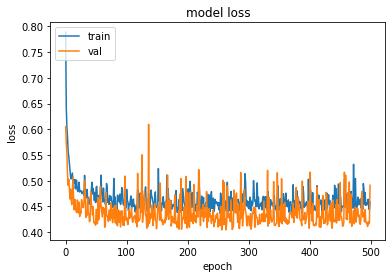

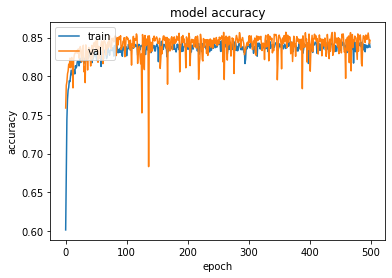

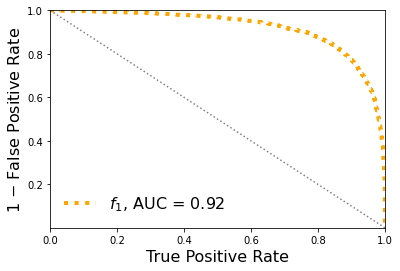

313/313 [==============================] - 3s 9ms/step - loss: 0.4969 - acc: 0.8425 - f1_m: 0.4640 - precision_m: 0.5003 - recall_m: 0.4340
Test ROC-AUC: 0.91954534
Test loss: 0.4968651235103607
Test accuracy: 0.8424999713897705
Test f1: 0.4640304148197174
Test precision: 0.5002662539482117
Test recall: 0.43400558829307556
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 175ms/step - loss: 0.8231 - acc: 0.5828 - f1_m: 0.5065 - precision_m: 0.5879 - recall_m: 0.5196 - val_loss: 0.5991 - val_acc: 0.7630 - val_f1_m: 0.7866 - val_precision_m: 0.7101 - val_recall_m: 0.8843
Epoch 2/500
188/188 [==============================] - 31s 167ms/step - loss: 0.6333 - acc: 0.7303 - f1_m: 0.7433 - precision_m: 0.7121 - recall_m: 0.7896 - val_loss: 0.5436 - val_acc: 0.7845 - val_f1_m: 0.7850 - val_precision_m: 0.7754 

188/188 [==============================] - 32s 169ms/step - loss: 0.4410 - acc: 0.8390 - f1_m: 0.8381 - precision_m: 0.8360 - recall_m: 0.8453 - val_loss: 0.4266 - val_acc: 0.8488 - val_f1_m: 0.8490 - val_precision_m: 0.8377 - val_recall_m: 0.8630
Epoch 62/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4517 - acc: 0.8349 - f1_m: 0.8337 - precision_m: 0.8366 - recall_m: 0.8361 - val_loss: 0.4520 - val_acc: 0.8115 - val_f1_m: 0.7860 - val_precision_m: 0.8957 - val_recall_m: 0.7030
Epoch 63/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4425 - acc: 0.8357 - f1_m: 0.8351 - precision_m: 0.8392 - recall_m: 0.8372 - val_loss: 0.4270 - val_acc: 0.8413 - val_f1_m: 0.8396 - val_precision_m: 0.8408 - val_recall_m: 0.8407
Epoch 64/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4416 - acc: 0.8406 - f1_m: 0.8398 - precision_m: 0.8415 - recall_m: 0.8425 - val_loss: 0.4512 - val_acc: 0.8228 - val_f1_m: 0.8071 - val_precision_m:

188/188 [==============================] - 32s 169ms/step - loss: 0.4509 - acc: 0.8427 - f1_m: 0.8384 - precision_m: 0.8506 - recall_m: 0.8328 - val_loss: 0.4257 - val_acc: 0.8485 - val_f1_m: 0.8462 - val_precision_m: 0.8509 - val_recall_m: 0.8440
Epoch 124/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4368 - acc: 0.8452 - f1_m: 0.8424 - precision_m: 0.8524 - recall_m: 0.8385 - val_loss: 0.5467 - val_acc: 0.8128 - val_f1_m: 0.8349 - val_precision_m: 0.7423 - val_recall_m: 0.9570
Epoch 125/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4888 - acc: 0.8466 - f1_m: 0.8474 - precision_m: 0.8443 - recall_m: 0.8555 - val_loss: 0.4686 - val_acc: 0.8138 - val_f1_m: 0.7921 - val_precision_m: 0.8887 - val_recall_m: 0.7177
Epoch 126/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4444 - acc: 0.8516 - f1_m: 0.8467 - precision_m: 0.8680 - recall_m: 0.8348 - val_loss: 0.4446 - val_acc: 0.8425 - val_f1_m: 0.8350 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4326 - acc: 0.8486 - f1_m: 0.8443 - precision_m: 0.8563 - recall_m: 0.8378 - val_loss: 0.4163 - val_acc: 0.8467 - val_f1_m: 0.8417 - val_precision_m: 0.8625 - val_recall_m: 0.8241
Epoch 186/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4367 - acc: 0.8432 - f1_m: 0.8421 - precision_m: 0.8539 - recall_m: 0.8391 - val_loss: 0.4102 - val_acc: 0.8515 - val_f1_m: 0.8494 - val_precision_m: 0.8550 - val_recall_m: 0.8465
Epoch 187/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4146 - acc: 0.8558 - f1_m: 0.8544 - precision_m: 0.8641 - recall_m: 0.8485 - val_loss: 0.4583 - val_acc: 0.8187 - val_f1_m: 0.7954 - val_precision_m: 0.9011 - val_recall_m: 0.7147
Epoch 188/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4401 - acc: 0.8411 - f1_m: 0.8363 - precision_m: 0.8530 - recall_m: 0.8269 - val_loss: 0.4270 - val_acc: 0.8552 - val_f1_m: 0.8595 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4226 - acc: 0.8524 - f1_m: 0.8495 - precision_m: 0.8588 - recall_m: 0.8444 - val_loss: 0.4191 - val_acc: 0.8482 - val_f1_m: 0.8435 - val_precision_m: 0.8601 - val_recall_m: 0.8298
Epoch 248/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4168 - acc: 0.8517 - f1_m: 0.8515 - precision_m: 0.8607 - recall_m: 0.8474 - val_loss: 0.4282 - val_acc: 0.8357 - val_f1_m: 0.8249 - val_precision_m: 0.8747 - val_recall_m: 0.7828
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4216 - acc: 0.8519 - f1_m: 0.8501 - precision_m: 0.8626 - recall_m: 0.8413 - val_loss: 0.4144 - val_acc: 0.8537 - val_f1_m: 0.8523 - val_precision_m: 0.8521 - val_recall_m: 0.8550
Epoch 250/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4192 - acc: 0.8547 - f1_m: 0.8520 - precision_m: 0.8607 - recall_m: 0.8471 - val_loss: 0.4254 - val_acc: 0.8528 - val_f1_m: 0.8499 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4286 - acc: 0.8527 - f1_m: 0.8483 - precision_m: 0.8652 - recall_m: 0.8374 - val_loss: 0.4250 - val_acc: 0.8540 - val_f1_m: 0.8532 - val_precision_m: 0.8500 - val_recall_m: 0.8588
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4559 - acc: 0.8426 - f1_m: 0.8379 - precision_m: 0.8507 - recall_m: 0.8353 - val_loss: 0.4368 - val_acc: 0.8570 - val_f1_m: 0.8581 - val_precision_m: 0.8441 - val_recall_m: 0.8756
Epoch 311/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4400 - acc: 0.8536 - f1_m: 0.8500 - precision_m: 0.8640 - recall_m: 0.8413 - val_loss: 0.4302 - val_acc: 0.8503 - val_f1_m: 0.8550 - val_precision_m: 0.8219 - val_recall_m: 0.8938
Epoch 312/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4247 - acc: 0.8582 - f1_m: 0.8558 - precision_m: 0.8639 - recall_m: 0.8524 - val_loss: 0.4467 - val_acc: 0.8420 - val_f1_m: 0.8324 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4450 - acc: 0.8461 - f1_m: 0.8416 - precision_m: 0.8617 - recall_m: 0.8275 - val_loss: 0.4283 - val_acc: 0.8382 - val_f1_m: 0.8286 - val_precision_m: 0.8742 - val_recall_m: 0.7901
Epoch 372/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4410 - acc: 0.8503 - f1_m: 0.8427 - precision_m: 0.8633 - recall_m: 0.8320 - val_loss: 0.4570 - val_acc: 0.8358 - val_f1_m: 0.8235 - val_precision_m: 0.8805 - val_recall_m: 0.7757
Epoch 373/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4345 - acc: 0.8531 - f1_m: 0.8524 - precision_m: 0.8637 - recall_m: 0.8460 - val_loss: 0.4156 - val_acc: 0.8545 - val_f1_m: 0.8536 - val_precision_m: 0.8510 - val_recall_m: 0.8593
Epoch 374/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4202 - acc: 0.8537 - f1_m: 0.8506 - precision_m: 0.8617 - recall_m: 0.8428 - val_loss: 0.6331 - val_acc: 0.7143 - val_f1_m: 0.6101 - val_precision

188/188 [==============================] - 33s 176ms/step - loss: 0.4160 - acc: 0.8591 - f1_m: 0.8584 - precision_m: 0.8690 - recall_m: 0.8511 - val_loss: 0.4059 - val_acc: 0.8560 - val_f1_m: 0.8540 - val_precision_m: 0.8599 - val_recall_m: 0.8512
Epoch 434/500
188/188 [==============================] - 32s 173ms/step - loss: 0.4235 - acc: 0.8555 - f1_m: 0.8520 - precision_m: 0.8681 - recall_m: 0.8418 - val_loss: 0.4728 - val_acc: 0.8502 - val_f1_m: 0.8571 - val_precision_m: 0.8117 - val_recall_m: 0.9107
Epoch 435/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4437 - acc: 0.8519 - f1_m: 0.8492 - precision_m: 0.8625 - recall_m: 0.8411 - val_loss: 0.4264 - val_acc: 0.8397 - val_f1_m: 0.8313 - val_precision_m: 0.8685 - val_recall_m: 0.7993
Epoch 436/500
188/188 [==============================] - 33s 173ms/step - loss: 0.4521 - acc: 0.8455 - f1_m: 0.8406 - precision_m: 0.8596 - recall_m: 0.8294 - val_loss: 0.4370 - val_acc: 0.8503 - val_f1_m: 0.8497 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4335 - acc: 0.8520 - f1_m: 0.8481 - precision_m: 0.8599 - recall_m: 0.8408 - val_loss: 0.4164 - val_acc: 0.8568 - val_f1_m: 0.8615 - val_precision_m: 0.8279 - val_recall_m: 0.9007
Epoch 496/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4232 - acc: 0.8549 - f1_m: 0.8526 - precision_m: 0.8590 - recall_m: 0.8499 - val_loss: 0.4235 - val_acc: 0.8562 - val_f1_m: 0.8594 - val_precision_m: 0.8341 - val_recall_m: 0.8890
Epoch 497/500
188/188 [==============================] - 32s 173ms/step - loss: 0.4243 - acc: 0.8536 - f1_m: 0.8514 - precision_m: 0.8523 - recall_m: 0.8545 - val_loss: 0.4144 - val_acc: 0.8505 - val_f1_m: 0.8461 - val_precision_m: 0.8644 - val_recall_m: 0.8316
Epoch 498/500
188/188 [==============================] - 33s 175ms/step - loss: 0.4163 - acc: 0.8546 - f1_m: 0.8501 - precision_m: 0.8620 - recall_m: 0.8427 - val_loss: 0.4230 - val_acc: 0.8573 - val_f1_m: 0.8619 - val_precision

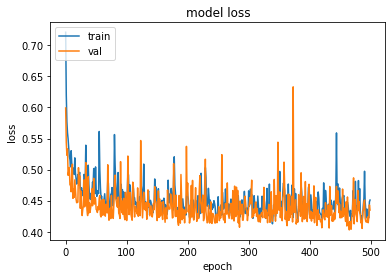

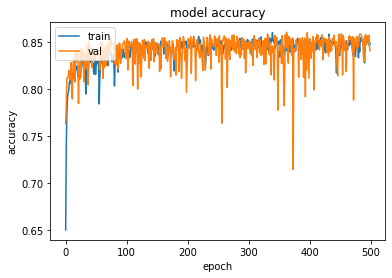

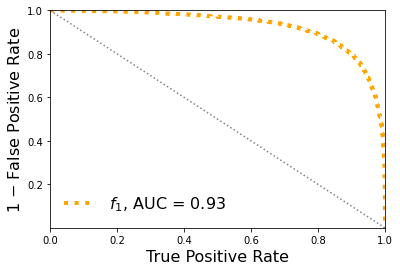

313/313 [==============================] - 3s 9ms/step - loss: 0.4428 - acc: 0.8427 - f1_m: 0.4397 - precision_m: 0.5002 - recall_m: 0.3938
Test ROC-AUC: 0.9282994400000001
Test loss: 0.4427703022956848
Test accuracy: 0.8427000045776367
Test f1: 0.4396682679653168
Test precision: 0.5001775026321411
Test recall: 0.3937699794769287
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 36s 370ms/step - loss: 1.0696 - acc: 0.5560 - f1_m: 0.5641 - precision_m: 0.5594 - recall_m: 0.6468 - val_loss: 0.5885 - val_acc: 0.7687 - val_f1_m: 0.7830 - val_precision_m: 0.7288 - val_recall_m: 0.8476
Epoch 2/500
94/94 [==============================] - 34s 358ms/step - loss: 0.6233 - acc: 0.7444 - f1_m: 0.7555 - precision_m: 0.7258 - recall_m: 0.7942 - val_loss: 0.5448 - val_acc: 0.7885 - val_f1_m: 0.7847 - val_precision_m: 0.78

Epoch 31/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4492 - acc: 0.8471 - f1_m: 0.8501 - precision_m: 0.8343 - recall_m: 0.8684 - val_loss: 0.4689 - val_acc: 0.8265 - val_f1_m: 0.8423 - val_precision_m: 0.7621 - val_recall_m: 0.9429
Epoch 32/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4456 - acc: 0.8488 - f1_m: 0.8532 - precision_m: 0.8314 - recall_m: 0.8809 - val_loss: 0.4548 - val_acc: 0.8417 - val_f1_m: 0.8518 - val_precision_m: 0.7945 - val_recall_m: 0.9196
Epoch 33/500
94/94 [==============================] - 34s 358ms/step - loss: 0.4479 - acc: 0.8508 - f1_m: 0.8552 - precision_m: 0.8367 - recall_m: 0.8785 - val_loss: 0.4372 - val_acc: 0.8480 - val_f1_m: 0.8515 - val_precision_m: 0.8198 - val_recall_m: 0.8877
Epoch 34/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4409 - acc: 0.8519 - f1_m: 0.8545 - precision_m: 0.8375 - recall_m: 0.8752 - val_loss: 0.4853 - val_acc: 0.8192 - val_f1_m: 0.8006 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4288 - acc: 0.8552 - f1_m: 0.8587 - precision_m: 0.8378 - recall_m: 0.8842 - val_loss: 0.4417 - val_acc: 0.8475 - val_f1_m: 0.8552 - val_precision_m: 0.8003 - val_recall_m: 0.9199
Epoch 64/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4223 - acc: 0.8536 - f1_m: 0.8581 - precision_m: 0.8358 - recall_m: 0.8867 - val_loss: 0.4305 - val_acc: 0.8488 - val_f1_m: 0.8544 - val_precision_m: 0.8128 - val_recall_m: 0.9020
Epoch 65/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4256 - acc: 0.8557 - f1_m: 0.8604 - precision_m: 0.8348 - recall_m: 0.8908 - val_loss: 0.4484 - val_acc: 0.8405 - val_f1_m: 0.8503 - val_precision_m: 0.7918 - val_recall_m: 0.9193
Epoch 66/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4244 - acc: 0.8551 - f1_m: 0.8590 - precision_m: 0.8389 - recall_m: 0.8832 - val_loss: 0.4312 - val_acc: 0.8467 - val_f1_m: 0.8442 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4055 - acc: 0.8603 - f1_m: 0.8643 - precision_m: 0.8377 - recall_m: 0.8951 - val_loss: 0.4329 - val_acc: 0.8448 - val_f1_m: 0.8496 - val_precision_m: 0.8073 - val_recall_m: 0.8978
Epoch 96/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4329 - acc: 0.8528 - f1_m: 0.8572 - precision_m: 0.8340 - recall_m: 0.8884 - val_loss: 0.4755 - val_acc: 0.8265 - val_f1_m: 0.8116 - val_precision_m: 0.8750 - val_recall_m: 0.7585
Epoch 97/500
94/94 [==============================] - 33s 349ms/step - loss: 0.5946 - acc: 0.8097 - f1_m: 0.8136 - precision_m: 0.7948 - recall_m: 0.8601 - val_loss: 1.0757 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 98/500
94/94 [==============================] - 33s 354ms/step - loss: 0.9849 - acc: 0.5803 - f1_m: 0.6367 - precision_m: 0.5649 - recall_m: 0.7546 - val_loss: 0.7647 - val_acc: 0.7242 - val_f1_m: 0.7732 - val_precisi

94/94 [==============================] - 33s 347ms/step - loss: 0.4255 - acc: 0.8536 - f1_m: 0.8586 - precision_m: 0.8397 - recall_m: 0.8825 - val_loss: 0.4558 - val_acc: 0.8303 - val_f1_m: 0.8154 - val_precision_m: 0.8805 - val_recall_m: 0.7607
Epoch 158/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4222 - acc: 0.8557 - f1_m: 0.8597 - precision_m: 0.8411 - recall_m: 0.8844 - val_loss: 0.4134 - val_acc: 0.8503 - val_f1_m: 0.8495 - val_precision_m: 0.8453 - val_recall_m: 0.8552
Epoch 159/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4043 - acc: 0.8593 - f1_m: 0.8632 - precision_m: 0.8437 - recall_m: 0.8863 - val_loss: 0.4176 - val_acc: 0.8492 - val_f1_m: 0.8494 - val_precision_m: 0.8349 - val_recall_m: 0.8659
Epoch 160/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4001 - acc: 0.8630 - f1_m: 0.8665 - precision_m: 0.8500 - recall_m: 0.8866 - val_loss: 0.4342 - val_acc: 0.8408 - val_f1_m: 0.8360 - val_precision_m: 0.84

94/94 [==============================] - 33s 353ms/step - loss: 0.4167 - acc: 0.8616 - f1_m: 0.8640 - precision_m: 0.8446 - recall_m: 0.8873 - val_loss: 0.4418 - val_acc: 0.8413 - val_f1_m: 0.8378 - val_precision_m: 0.8451 - val_recall_m: 0.8323
Epoch 220/500
94/94 [==============================] - 33s 354ms/step - loss: 0.5962 - acc: 0.7844 - f1_m: 0.7767 - precision_m: 0.7781 - recall_m: 0.8104 - val_loss: 0.5353 - val_acc: 0.8102 - val_f1_m: 0.7940 - val_precision_m: 0.8584 - val_recall_m: 0.7404
Epoch 221/500
94/94 [==============================] - 33s 353ms/step - loss: 0.5169 - acc: 0.8180 - f1_m: 0.8229 - precision_m: 0.7986 - recall_m: 0.8540 - val_loss: 0.4658 - val_acc: 0.8355 - val_f1_m: 0.8305 - val_precision_m: 0.8457 - val_recall_m: 0.8173
Epoch 222/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4544 - acc: 0.8477 - f1_m: 0.8536 - precision_m: 0.8280 - recall_m: 0.8826 - val_loss: 0.4416 - val_acc: 0.8472 - val_f1_m: 0.8466 - val_precision_m: 0.83

94/94 [==============================] - 33s 352ms/step - loss: 0.4997 - acc: 0.8329 - f1_m: 0.8338 - precision_m: 0.8175 - recall_m: 0.8600 - val_loss: 0.4778 - val_acc: 0.8440 - val_f1_m: 0.8448 - val_precision_m: 0.8271 - val_recall_m: 0.8649
Epoch 282/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4815 - acc: 0.8367 - f1_m: 0.8411 - precision_m: 0.8141 - recall_m: 0.8725 - val_loss: 0.4885 - val_acc: 0.8303 - val_f1_m: 0.8201 - val_precision_m: 0.8581 - val_recall_m: 0.7868
Epoch 283/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4695 - acc: 0.8385 - f1_m: 0.8423 - precision_m: 0.8255 - recall_m: 0.8659 - val_loss: 0.4476 - val_acc: 0.8467 - val_f1_m: 0.8475 - val_precision_m: 0.8293 - val_recall_m: 0.8681
Epoch 284/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4332 - acc: 0.8577 - f1_m: 0.8622 - precision_m: 0.8445 - recall_m: 0.8835 - val_loss: 0.4697 - val_acc: 0.8317 - val_f1_m: 0.8475 - val_precision_m: 0.76

94/94 [==============================] - 34s 357ms/step - loss: 0.4328 - acc: 0.8507 - f1_m: 0.8548 - precision_m: 0.8341 - recall_m: 0.8798 - val_loss: 0.4273 - val_acc: 0.8510 - val_f1_m: 0.8496 - val_precision_m: 0.8516 - val_recall_m: 0.8490
Epoch 344/500
94/94 [==============================] - 33s 356ms/step - loss: 0.4650 - acc: 0.8393 - f1_m: 0.8431 - precision_m: 0.8253 - recall_m: 0.8715 - val_loss: 0.4282 - val_acc: 0.8550 - val_f1_m: 0.8570 - val_precision_m: 0.8318 - val_recall_m: 0.8851
Epoch 345/500
94/94 [==============================] - 34s 357ms/step - loss: 0.4078 - acc: 0.8599 - f1_m: 0.8627 - precision_m: 0.8382 - recall_m: 0.8924 - val_loss: 0.4341 - val_acc: 0.8465 - val_f1_m: 0.8529 - val_precision_m: 0.8078 - val_recall_m: 0.9045
Epoch 346/500
94/94 [==============================] - 34s 359ms/step - loss: 0.3988 - acc: 0.8654 - f1_m: 0.8695 - precision_m: 0.8498 - recall_m: 0.8921 - val_loss: 0.4215 - val_acc: 0.8528 - val_f1_m: 0.8528 - val_precision_m: 0.83

94/94 [==============================] - 33s 357ms/step - loss: 0.4573 - acc: 0.8341 - f1_m: 0.8386 - precision_m: 0.8170 - recall_m: 0.8655 - val_loss: 0.4175 - val_acc: 0.8507 - val_f1_m: 0.8546 - val_precision_m: 0.8257 - val_recall_m: 0.8872
Epoch 406/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4663 - acc: 0.8261 - f1_m: 0.8293 - precision_m: 0.8131 - recall_m: 0.8528 - val_loss: 0.4456 - val_acc: 0.8415 - val_f1_m: 0.8538 - val_precision_m: 0.7818 - val_recall_m: 0.9420
Epoch 407/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4621 - acc: 0.8349 - f1_m: 0.8395 - precision_m: 0.8196 - recall_m: 0.8655 - val_loss: 0.4112 - val_acc: 0.8390 - val_f1_m: 0.8315 - val_precision_m: 0.8608 - val_recall_m: 0.8054
Epoch 408/500
94/94 [==============================] - 34s 357ms/step - loss: 0.4469 - acc: 0.8379 - f1_m: 0.8422 - precision_m: 0.8317 - recall_m: 0.8580 - val_loss: 0.4041 - val_acc: 0.8525 - val_f1_m: 0.8537 - val_precision_m: 0.83

94/94 [==============================] - 33s 354ms/step - loss: 0.4246 - acc: 0.8510 - f1_m: 0.8520 - precision_m: 0.8424 - recall_m: 0.8671 - val_loss: 0.4061 - val_acc: 0.8525 - val_f1_m: 0.8562 - val_precision_m: 0.8277 - val_recall_m: 0.8882
Epoch 468/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4129 - acc: 0.8547 - f1_m: 0.8585 - precision_m: 0.8384 - recall_m: 0.8828 - val_loss: 0.4021 - val_acc: 0.8577 - val_f1_m: 0.8602 - val_precision_m: 0.8374 - val_recall_m: 0.8860
Epoch 469/500
94/94 [==============================] - 34s 360ms/step - loss: 0.4072 - acc: 0.8565 - f1_m: 0.8592 - precision_m: 0.8463 - recall_m: 0.8767 - val_loss: 0.4000 - val_acc: 0.8557 - val_f1_m: 0.8569 - val_precision_m: 0.8439 - val_recall_m: 0.8717
Epoch 470/500
94/94 [==============================] - 34s 362ms/step - loss: 0.4105 - acc: 0.8530 - f1_m: 0.8570 - precision_m: 0.8421 - recall_m: 0.8769 - val_loss: 0.4137 - val_acc: 0.8453 - val_f1_m: 0.8409 - val_precision_m: 0.85

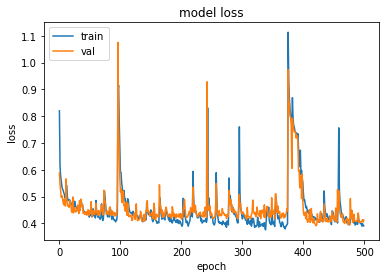

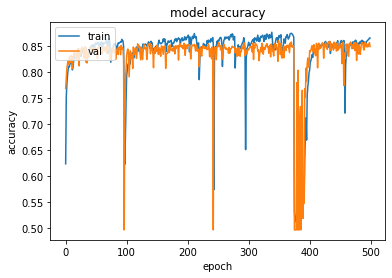

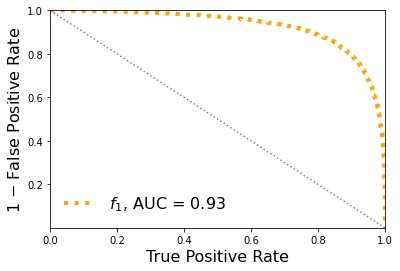

313/313 [==============================] - 3s 9ms/step - loss: 0.4210 - acc: 0.8519 - f1_m: 0.4588 - precision_m: 0.5005 - recall_m: 0.4246
Test ROC-AUC: 0.9264947400000002
Test loss: 0.42104920744895935
Test accuracy: 0.8518999814987183
Test f1: 0.45881155133247375
Test precision: 0.5005325078964233
Test recall: 0.4246205985546112
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 36s 94ms/step - loss: 1.0567 - acc: 0.5872 - f1_m: 0.6118 - precision_m: 0.5790 - recall_m: 0.6710 - val_loss: 0.6470 - val_acc: 0.7713 - val_f1_m: 0.7513 - val_precision_m: 0.8102 - val_recall_m: 0.7070
Epoch 2/500
375/375 [==============================] - 36s 95ms/step - loss: 0.6425 - acc: 0.7496 - f1_m: 0.7574 - precision_m: 0.7411 - recall_m: 0.7880 - val_loss: 0.5428 - val_acc: 0.8102 - val_f1_m: 0.8144 - val_precision_m: 0.

Epoch 31/500
375/375 [==============================] - 35s 92ms/step - loss: 0.4973 - acc: 0.8198 - f1_m: 0.8232 - precision_m: 0.8066 - recall_m: 0.8511 - val_loss: 0.4475 - val_acc: 0.8382 - val_f1_m: 0.8428 - val_precision_m: 0.8060 - val_recall_m: 0.8878
Epoch 32/500
375/375 [==============================] - 35s 93ms/step - loss: 0.4946 - acc: 0.8193 - f1_m: 0.8223 - precision_m: 0.8061 - recall_m: 0.8485 - val_loss: 0.4533 - val_acc: 0.8353 - val_f1_m: 0.8362 - val_precision_m: 0.8189 - val_recall_m: 0.8591
Epoch 33/500
375/375 [==============================] - 35s 94ms/step - loss: 0.4766 - acc: 0.8271 - f1_m: 0.8280 - precision_m: 0.8193 - recall_m: 0.8464 - val_loss: 0.4496 - val_acc: 0.8358 - val_f1_m: 0.8401 - val_precision_m: 0.8078 - val_recall_m: 0.8807
Epoch 34/500
375/375 [==============================] - 34s 91ms/step - loss: 0.4998 - acc: 0.8156 - f1_m: 0.8201 - precision_m: 0.8045 - recall_m: 0.8477 - val_loss: 0.4429 - val_acc: 0.8387 - val_f1_m: 0.8396 - val_pre

375/375 [==============================] - 33s 88ms/step - loss: 0.4644 - acc: 0.8290 - f1_m: 0.8311 - precision_m: 0.8192 - recall_m: 0.8529 - val_loss: 0.4292 - val_acc: 0.8418 - val_f1_m: 0.8438 - val_precision_m: 0.8202 - val_recall_m: 0.8734
Epoch 94/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4658 - acc: 0.8296 - f1_m: 0.8319 - precision_m: 0.8233 - recall_m: 0.8514 - val_loss: 0.4308 - val_acc: 0.8450 - val_f1_m: 0.8452 - val_precision_m: 0.8304 - val_recall_m: 0.8653
Epoch 95/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4769 - acc: 0.8247 - f1_m: 0.8292 - precision_m: 0.8105 - recall_m: 0.8588 - val_loss: 0.4565 - val_acc: 0.8370 - val_f1_m: 0.8299 - val_precision_m: 0.8540 - val_recall_m: 0.8118
Epoch 96/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4652 - acc: 0.8287 - f1_m: 0.8316 - precision_m: 0.8148 - recall_m: 0.8586 - val_loss: 0.4580 - val_acc: 0.8312 - val_f1_m: 0.8203 - val_precision_m: 0.8

375/375 [==============================] - 33s 88ms/step - loss: 0.4628 - acc: 0.8318 - f1_m: 0.8355 - precision_m: 0.8142 - recall_m: 0.8671 - val_loss: 0.4513 - val_acc: 0.8298 - val_f1_m: 0.8170 - val_precision_m: 0.8706 - val_recall_m: 0.7749
Epoch 156/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4640 - acc: 0.8308 - f1_m: 0.8330 - precision_m: 0.8231 - recall_m: 0.8541 - val_loss: 0.4511 - val_acc: 0.8385 - val_f1_m: 0.8384 - val_precision_m: 0.8272 - val_recall_m: 0.8544
Epoch 157/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4585 - acc: 0.8336 - f1_m: 0.8331 - precision_m: 0.8169 - recall_m: 0.8571 - val_loss: 0.4230 - val_acc: 0.8438 - val_f1_m: 0.8459 - val_precision_m: 0.8193 - val_recall_m: 0.8787
Epoch 158/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4747 - acc: 0.8268 - f1_m: 0.8313 - precision_m: 0.8133 - recall_m: 0.8620 - val_loss: 0.4452 - val_acc: 0.8383 - val_f1_m: 0.8338 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4648 - acc: 0.8337 - f1_m: 0.8362 - precision_m: 0.8205 - recall_m: 0.8620 - val_loss: 0.4468 - val_acc: 0.8240 - val_f1_m: 0.8404 - val_precision_m: 0.7586 - val_recall_m: 0.9468
Epoch 218/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4659 - acc: 0.8299 - f1_m: 0.8365 - precision_m: 0.8118 - recall_m: 0.8714 - val_loss: 0.4379 - val_acc: 0.8435 - val_f1_m: 0.8407 - val_precision_m: 0.8437 - val_recall_m: 0.8427
Epoch 219/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4726 - acc: 0.8260 - f1_m: 0.8296 - precision_m: 0.8105 - recall_m: 0.8629 - val_loss: 0.4275 - val_acc: 0.8425 - val_f1_m: 0.8495 - val_precision_m: 0.8015 - val_recall_m: 0.9082
Epoch 220/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4647 - acc: 0.8298 - f1_m: 0.8330 - precision_m: 0.8186 - recall_m: 0.8600 - val_loss: 0.4183 - val_acc: 0.8460 - val_f1_m: 0.8433 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4540 - acc: 0.8358 - f1_m: 0.8367 - precision_m: 0.8264 - recall_m: 0.8548 - val_loss: 0.4324 - val_acc: 0.8375 - val_f1_m: 0.8301 - val_precision_m: 0.8579 - val_recall_m: 0.8080
Epoch 280/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4572 - acc: 0.8355 - f1_m: 0.8376 - precision_m: 0.8204 - recall_m: 0.8652 - val_loss: 0.4249 - val_acc: 0.8483 - val_f1_m: 0.8502 - val_precision_m: 0.8281 - val_recall_m: 0.8784
Epoch 281/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4699 - acc: 0.8301 - f1_m: 0.8335 - precision_m: 0.8186 - recall_m: 0.8600 - val_loss: 0.4272 - val_acc: 0.8385 - val_f1_m: 0.8496 - val_precision_m: 0.7835 - val_recall_m: 0.9330
Epoch 282/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4666 - acc: 0.8295 - f1_m: 0.8324 - precision_m: 0.8188 - recall_m: 0.8574 - val_loss: 0.4353 - val_acc: 0.8435 - val_f1_m: 0.8529 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4752 - acc: 0.8268 - f1_m: 0.8306 - precision_m: 0.8148 - recall_m: 0.8606 - val_loss: 0.4256 - val_acc: 0.8482 - val_f1_m: 0.8535 - val_precision_m: 0.8121 - val_recall_m: 0.9046
Epoch 342/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4479 - acc: 0.8384 - f1_m: 0.8428 - precision_m: 0.8232 - recall_m: 0.8707 - val_loss: 0.5026 - val_acc: 0.7903 - val_f1_m: 0.8200 - val_precision_m: 0.7100 - val_recall_m: 0.9766
Epoch 343/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4619 - acc: 0.8348 - f1_m: 0.8386 - precision_m: 0.8209 - recall_m: 0.8655 - val_loss: 0.4297 - val_acc: 0.8438 - val_f1_m: 0.8435 - val_precision_m: 0.8346 - val_recall_m: 0.8569
Epoch 344/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4592 - acc: 0.8350 - f1_m: 0.8397 - precision_m: 0.8174 - recall_m: 0.8697 - val_loss: 0.4206 - val_acc: 0.8525 - val_f1_m: 0.8541 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4653 - acc: 0.8281 - f1_m: 0.8297 - precision_m: 0.8145 - recall_m: 0.8587 - val_loss: 0.4309 - val_acc: 0.8443 - val_f1_m: 0.8418 - val_precision_m: 0.8428 - val_recall_m: 0.8454
Epoch 404/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4389 - acc: 0.8440 - f1_m: 0.8456 - precision_m: 0.8277 - recall_m: 0.8720 - val_loss: 0.4164 - val_acc: 0.8468 - val_f1_m: 0.8470 - val_precision_m: 0.8347 - val_recall_m: 0.8639
Epoch 405/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4536 - acc: 0.8323 - f1_m: 0.8371 - precision_m: 0.8176 - recall_m: 0.8669 - val_loss: 0.4476 - val_acc: 0.8247 - val_f1_m: 0.8420 - val_precision_m: 0.7551 - val_recall_m: 0.9570
Epoch 406/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4378 - acc: 0.8461 - f1_m: 0.8499 - precision_m: 0.8271 - recall_m: 0.8814 - val_loss: 0.4228 - val_acc: 0.8497 - val_f1_m: 0.8473 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4643 - acc: 0.8344 - f1_m: 0.8367 - precision_m: 0.8247 - recall_m: 0.8603 - val_loss: 0.4169 - val_acc: 0.8505 - val_f1_m: 0.8505 - val_precision_m: 0.8393 - val_recall_m: 0.8668
Epoch 466/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4637 - acc: 0.8310 - f1_m: 0.8321 - precision_m: 0.8174 - recall_m: 0.8582 - val_loss: 0.4978 - val_acc: 0.7932 - val_f1_m: 0.8216 - val_precision_m: 0.7139 - val_recall_m: 0.9732
Epoch 467/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4687 - acc: 0.8319 - f1_m: 0.8353 - precision_m: 0.8153 - recall_m: 0.8672 - val_loss: 0.4206 - val_acc: 0.8495 - val_f1_m: 0.8478 - val_precision_m: 0.8467 - val_recall_m: 0.8540
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4567 - acc: 0.8371 - f1_m: 0.8395 - precision_m: 0.8229 - recall_m: 0.8690 - val_loss: 0.4517 - val_acc: 0.8225 - val_f1_m: 0.8401 - val_precision_m: 

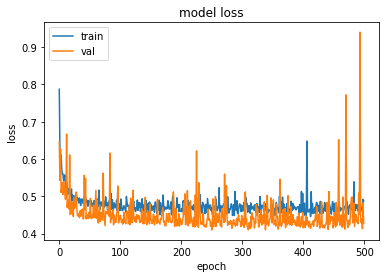

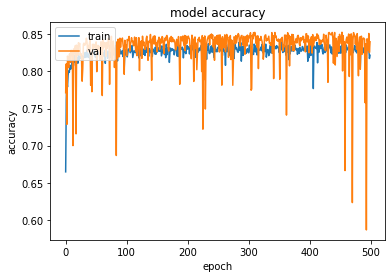

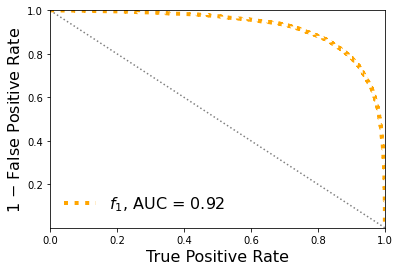

313/313 [==============================] - 3s 9ms/step - loss: 0.4377 - acc: 0.8304 - f1_m: 0.4816 - precision_m: 0.4999 - recall_m: 0.4656
Test ROC-AUC: 0.9248668999999999
Test loss: 0.43766698241233826
Test accuracy: 0.8303999900817871
Test f1: 0.4815590977668762
Test precision: 0.4998934864997864
Test recall: 0.4655551016330719
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 33s 173ms/step - loss: 1.8838 - acc: 0.5136 - f1_m: 0.4765 - precision_m: 0.5100 - recall_m: 0.4757 - val_loss: 0.7755 - val_acc: 0.5510 - val_f1_m: 0.1929 - val_precision_m: 0.8989 - val_recall_m: 0.1092
Epoch 2/500
188/188 [==============================] - 32s 170ms/step - loss: 0.6869 - acc: 0.7037 - f1_m: 0.6826 - precision_m: 0.7184 - recall_m: 0.6675 - val_loss: 0.5741 - val_acc: 0.7942 - val_f1_m: 0.7881 - val_precision_m: 

188/188 [==============================] - 32s 170ms/step - loss: 0.4783 - acc: 0.8297 - f1_m: 0.8300 - precision_m: 0.8292 - recall_m: 0.8416 - val_loss: 0.5234 - val_acc: 0.7832 - val_f1_m: 0.7392 - val_precision_m: 0.9141 - val_recall_m: 0.6231
Epoch 62/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4953 - acc: 0.8227 - f1_m: 0.8218 - precision_m: 0.8228 - recall_m: 0.8349 - val_loss: 0.4908 - val_acc: 0.8132 - val_f1_m: 0.7923 - val_precision_m: 0.8801 - val_recall_m: 0.7229
Epoch 63/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4935 - acc: 0.8247 - f1_m: 0.8243 - precision_m: 0.8238 - recall_m: 0.8348 - val_loss: 0.4486 - val_acc: 0.8473 - val_f1_m: 0.8515 - val_precision_m: 0.8217 - val_recall_m: 0.8863
Epoch 64/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4492 - acc: 0.8454 - f1_m: 0.8466 - precision_m: 0.8386 - recall_m: 0.8601 - val_loss: 0.4502 - val_acc: 0.8280 - val_f1_m: 0.8152 - val_precision_m:

188/188 [==============================] - 32s 171ms/step - loss: 0.4443 - acc: 0.8399 - f1_m: 0.8397 - precision_m: 0.8403 - recall_m: 0.8445 - val_loss: 0.4282 - val_acc: 0.8323 - val_f1_m: 0.8221 - val_precision_m: 0.8670 - val_recall_m: 0.7847
Epoch 124/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4393 - acc: 0.8445 - f1_m: 0.8444 - precision_m: 0.8385 - recall_m: 0.8566 - val_loss: 0.4483 - val_acc: 0.8182 - val_f1_m: 0.7977 - val_precision_m: 0.8897 - val_recall_m: 0.7260
Epoch 125/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4364 - acc: 0.8442 - f1_m: 0.8417 - precision_m: 0.8456 - recall_m: 0.8455 - val_loss: 0.4239 - val_acc: 0.8482 - val_f1_m: 0.8494 - val_precision_m: 0.8353 - val_recall_m: 0.8665
Epoch 126/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4367 - acc: 0.8410 - f1_m: 0.8427 - precision_m: 0.8363 - recall_m: 0.8550 - val_loss: 0.4808 - val_acc: 0.7908 - val_f1_m: 0.7539 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4295 - acc: 0.8467 - f1_m: 0.8476 - precision_m: 0.8433 - recall_m: 0.8574 - val_loss: 0.4407 - val_acc: 0.8403 - val_f1_m: 0.8471 - val_precision_m: 0.8054 - val_recall_m: 0.8958
Epoch 186/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4427 - acc: 0.8419 - f1_m: 0.8425 - precision_m: 0.8358 - recall_m: 0.8579 - val_loss: 0.4877 - val_acc: 0.8285 - val_f1_m: 0.8160 - val_precision_m: 0.8716 - val_recall_m: 0.7701
Epoch 187/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4743 - acc: 0.8360 - f1_m: 0.8362 - precision_m: 0.8295 - recall_m: 0.8504 - val_loss: 0.4361 - val_acc: 0.8367 - val_f1_m: 0.8267 - val_precision_m: 0.8715 - val_recall_m: 0.7894
Epoch 188/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4447 - acc: 0.8433 - f1_m: 0.8417 - precision_m: 0.8405 - recall_m: 0.8524 - val_loss: 0.7759 - val_acc: 0.5987 - val_f1_m: 0.3265 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4764 - acc: 0.8245 - f1_m: 0.8253 - precision_m: 0.8137 - recall_m: 0.8487 - val_loss: 0.4141 - val_acc: 0.8507 - val_f1_m: 0.8549 - val_precision_m: 0.8253 - val_recall_m: 0.8893
Epoch 248/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4259 - acc: 0.8473 - f1_m: 0.8490 - precision_m: 0.8406 - recall_m: 0.8620 - val_loss: 0.4062 - val_acc: 0.8503 - val_f1_m: 0.8507 - val_precision_m: 0.8404 - val_recall_m: 0.8637
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4483 - acc: 0.8366 - f1_m: 0.8373 - precision_m: 0.8291 - recall_m: 0.8533 - val_loss: 0.4304 - val_acc: 0.8483 - val_f1_m: 0.8561 - val_precision_m: 0.8064 - val_recall_m: 0.9149
Epoch 250/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4293 - acc: 0.8466 - f1_m: 0.8486 - precision_m: 0.8416 - recall_m: 0.8633 - val_loss: 0.4146 - val_acc: 0.8418 - val_f1_m: 0.8387 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4290 - acc: 0.8467 - f1_m: 0.8464 - precision_m: 0.8394 - recall_m: 0.8597 - val_loss: 0.4366 - val_acc: 0.8210 - val_f1_m: 0.7990 - val_precision_m: 0.9019 - val_recall_m: 0.7198
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4403 - acc: 0.8416 - f1_m: 0.8432 - precision_m: 0.8343 - recall_m: 0.8589 - val_loss: 0.4093 - val_acc: 0.8483 - val_f1_m: 0.8468 - val_precision_m: 0.8473 - val_recall_m: 0.8489
Epoch 311/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4573 - acc: 0.8337 - f1_m: 0.8340 - precision_m: 0.8306 - recall_m: 0.8504 - val_loss: 0.4628 - val_acc: 0.8138 - val_f1_m: 0.7896 - val_precision_m: 0.8976 - val_recall_m: 0.7074
Epoch 312/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4500 - acc: 0.8404 - f1_m: 0.8430 - precision_m: 0.8287 - recall_m: 0.8645 - val_loss: 0.4083 - val_acc: 0.8532 - val_f1_m: 0.8590 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4618 - acc: 0.8266 - f1_m: 0.8269 - precision_m: 0.8253 - recall_m: 0.8406 - val_loss: 0.4146 - val_acc: 0.8435 - val_f1_m: 0.8365 - val_precision_m: 0.8690 - val_recall_m: 0.8089
Epoch 372/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4180 - acc: 0.8499 - f1_m: 0.8515 - precision_m: 0.8409 - recall_m: 0.8678 - val_loss: 0.4102 - val_acc: 0.8558 - val_f1_m: 0.8575 - val_precision_m: 0.8406 - val_recall_m: 0.8776
Epoch 373/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4094 - acc: 0.8554 - f1_m: 0.8562 - precision_m: 0.8438 - recall_m: 0.8735 - val_loss: 0.4144 - val_acc: 0.8365 - val_f1_m: 0.8252 - val_precision_m: 0.8774 - val_recall_m: 0.7812
Epoch 374/500
188/188 [==============================] - 31s 168ms/step - loss: 0.4200 - acc: 0.8498 - f1_m: 0.8476 - precision_m: 0.8451 - recall_m: 0.8593 - val_loss: 0.6527 - val_acc: 0.6878 - val_f1_m: 0.5558 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4166 - acc: 0.8498 - f1_m: 0.8513 - precision_m: 0.8420 - recall_m: 0.8668 - val_loss: 0.4091 - val_acc: 0.8553 - val_f1_m: 0.8607 - val_precision_m: 0.8234 - val_recall_m: 0.9043
Epoch 434/500
188/188 [==============================] - 32s 168ms/step - loss: 0.5271 - acc: 0.8067 - f1_m: 0.7978 - precision_m: 0.8055 - recall_m: 0.8146 - val_loss: 0.4956 - val_acc: 0.8327 - val_f1_m: 0.8474 - val_precision_m: 0.7740 - val_recall_m: 0.9391
Epoch 435/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4858 - acc: 0.8288 - f1_m: 0.8330 - precision_m: 0.8089 - recall_m: 0.8669 - val_loss: 0.4142 - val_acc: 0.8403 - val_f1_m: 0.8332 - val_precision_m: 0.8631 - val_recall_m: 0.8077
Epoch 436/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4264 - acc: 0.8505 - f1_m: 0.8524 - precision_m: 0.8389 - recall_m: 0.8719 - val_loss: 0.3968 - val_acc: 0.8498 - val_f1_m: 0.8472 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4214 - acc: 0.8508 - f1_m: 0.8518 - precision_m: 0.8457 - recall_m: 0.8641 - val_loss: 0.4228 - val_acc: 0.8353 - val_f1_m: 0.8220 - val_precision_m: 0.8869 - val_recall_m: 0.7687
Epoch 496/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4343 - acc: 0.8446 - f1_m: 0.8446 - precision_m: 0.8410 - recall_m: 0.8575 - val_loss: 0.4022 - val_acc: 0.8538 - val_f1_m: 0.8536 - val_precision_m: 0.8482 - val_recall_m: 0.8613
Epoch 497/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4158 - acc: 0.8520 - f1_m: 0.8534 - precision_m: 0.8436 - recall_m: 0.8683 - val_loss: 0.4232 - val_acc: 0.8338 - val_f1_m: 0.8215 - val_precision_m: 0.8774 - val_recall_m: 0.7752
Epoch 498/500
188/188 [==============================] - 31s 166ms/step - loss: 0.4433 - acc: 0.8423 - f1_m: 0.8430 - precision_m: 0.8375 - recall_m: 0.8586 - val_loss: 0.4503 - val_acc: 0.8518 - val_f1_m: 0.8571 - val_precision

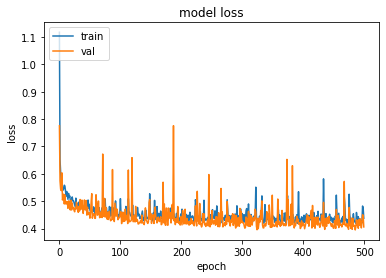

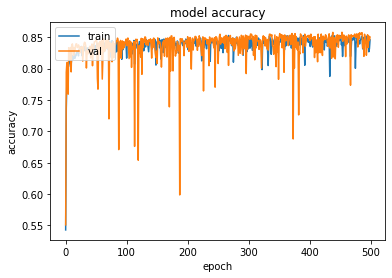

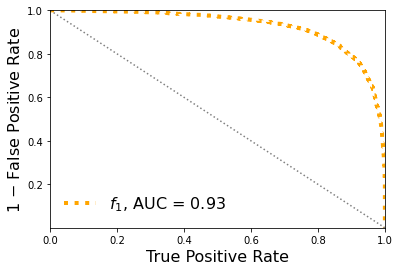

313/313 [==============================] - 3s 9ms/step - loss: 0.4200 - acc: 0.8481 - f1_m: 0.4523 - precision_m: 0.5000 - recall_m: 0.4141
Test ROC-AUC: 0.92741688
Test loss: 0.4199890196323395
Test accuracy: 0.8481000065803528
Test f1: 0.4522673487663269
Test precision: 0.5
Test recall: 0.4141373932361603
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.005
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 360ms/step - loss: 1.7266 - acc: 0.5322 - f1_m: 0.4193 - precision_m: 0.5326 - recall_m: 0.4082 - val_loss: 0.6854 - val_acc: 0.7353 - val_f1_m: 0.7023 - val_precision_m: 0.7931 - val_recall_m: 0.6322
Epoch 2/500
94/94 [==============================] - 33s 351ms/step - loss: 0.6899 - acc: 0.7178 - f1_m: 0.6982 - precision_m: 0.7475 - recall_m: 0.6705 - val_loss: 0.6264 - val_acc: 0.7600 - val_f1_m: 0.7478 - val_precision_m: 0.7797 - val_recall_m: 0.720

Epoch 31/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4980 - acc: 0.8277 - f1_m: 0.8265 - precision_m: 0.8322 - recall_m: 0.8352 - val_loss: 0.4536 - val_acc: 0.8405 - val_f1_m: 0.8368 - val_precision_m: 0.8461 - val_recall_m: 0.8294
Epoch 32/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4687 - acc: 0.8430 - f1_m: 0.8410 - precision_m: 0.8437 - recall_m: 0.8458 - val_loss: 0.4567 - val_acc: 0.8388 - val_f1_m: 0.8394 - val_precision_m: 0.8249 - val_recall_m: 0.8558
Epoch 33/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4727 - acc: 0.8330 - f1_m: 0.8375 - precision_m: 0.8283 - recall_m: 0.8562 - val_loss: 0.4569 - val_acc: 0.8412 - val_f1_m: 0.8444 - val_precision_m: 0.8137 - val_recall_m: 0.8788
Epoch 34/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4747 - acc: 0.8384 - f1_m: 0.8391 - precision_m: 0.8366 - recall_m: 0.8499 - val_loss: 0.4547 - val_acc: 0.8392 - val_f1_m: 0.8402 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4768 - acc: 0.8290 - f1_m: 0.8296 - precision_m: 0.8307 - recall_m: 0.8379 - val_loss: 0.4601 - val_acc: 0.8378 - val_f1_m: 0.8437 - val_precision_m: 0.8041 - val_recall_m: 0.8886
Epoch 64/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4676 - acc: 0.8307 - f1_m: 0.8341 - precision_m: 0.8263 - recall_m: 0.8466 - val_loss: 0.4455 - val_acc: 0.8447 - val_f1_m: 0.8501 - val_precision_m: 0.8118 - val_recall_m: 0.8936
Epoch 65/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4424 - acc: 0.8425 - f1_m: 0.8442 - precision_m: 0.8352 - recall_m: 0.8570 - val_loss: 0.4355 - val_acc: 0.8425 - val_f1_m: 0.8368 - val_precision_m: 0.8570 - val_recall_m: 0.8192
Epoch 66/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4375 - acc: 0.8465 - f1_m: 0.8475 - precision_m: 0.8382 - recall_m: 0.8601 - val_loss: 0.4374 - val_acc: 0.8388 - val_f1_m: 0.8307 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4329 - acc: 0.8500 - f1_m: 0.8539 - precision_m: 0.8381 - recall_m: 0.8731 - val_loss: 0.4332 - val_acc: 0.8420 - val_f1_m: 0.8383 - val_precision_m: 0.8515 - val_recall_m: 0.8273
Epoch 96/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4242 - acc: 0.8539 - f1_m: 0.8549 - precision_m: 0.8409 - recall_m: 0.8718 - val_loss: 0.4254 - val_acc: 0.8472 - val_f1_m: 0.8460 - val_precision_m: 0.8416 - val_recall_m: 0.8519
Epoch 97/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4125 - acc: 0.8637 - f1_m: 0.8668 - precision_m: 0.8562 - recall_m: 0.8797 - val_loss: 0.4233 - val_acc: 0.8500 - val_f1_m: 0.8506 - val_precision_m: 0.8341 - val_recall_m: 0.8692
Epoch 98/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4371 - acc: 0.8480 - f1_m: 0.8512 - precision_m: 0.8362 - recall_m: 0.8740 - val_loss: 0.6380 - val_acc: 0.8198 - val_f1_m: 0.8213 - val_precisi

94/94 [==============================] - 33s 346ms/step - loss: 0.4121 - acc: 0.8571 - f1_m: 0.8587 - precision_m: 0.8490 - recall_m: 0.8724 - val_loss: 0.4196 - val_acc: 0.8473 - val_f1_m: 0.8509 - val_precision_m: 0.8191 - val_recall_m: 0.8869
Epoch 158/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4043 - acc: 0.8604 - f1_m: 0.8617 - precision_m: 0.8503 - recall_m: 0.8763 - val_loss: 0.4355 - val_acc: 0.8453 - val_f1_m: 0.8540 - val_precision_m: 0.7987 - val_recall_m: 0.9191
Epoch 159/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4221 - acc: 0.8517 - f1_m: 0.8532 - precision_m: 0.8398 - recall_m: 0.8722 - val_loss: 0.4233 - val_acc: 0.8448 - val_f1_m: 0.8426 - val_precision_m: 0.8445 - val_recall_m: 0.8421
Epoch 160/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4074 - acc: 0.8572 - f1_m: 0.8584 - precision_m: 0.8490 - recall_m: 0.8722 - val_loss: 0.4250 - val_acc: 0.8453 - val_f1_m: 0.8466 - val_precision_m: 0.82

94/94 [==============================] - 32s 344ms/step - loss: 0.6501 - acc: 0.7499 - f1_m: 0.7519 - precision_m: 0.7507 - recall_m: 0.7862 - val_loss: 0.5811 - val_acc: 0.8177 - val_f1_m: 0.8334 - val_precision_m: 0.7606 - val_recall_m: 0.9234
Epoch 220/500
94/94 [==============================] - 32s 345ms/step - loss: 0.5239 - acc: 0.8116 - f1_m: 0.8209 - precision_m: 0.7821 - recall_m: 0.8697 - val_loss: 0.4561 - val_acc: 0.8380 - val_f1_m: 0.8485 - val_precision_m: 0.7885 - val_recall_m: 0.9203
Epoch 221/500
94/94 [==============================] - 32s 345ms/step - loss: 0.4420 - acc: 0.8425 - f1_m: 0.8469 - precision_m: 0.8224 - recall_m: 0.8769 - val_loss: 0.4351 - val_acc: 0.8355 - val_f1_m: 0.8265 - val_precision_m: 0.8657 - val_recall_m: 0.7925
Epoch 222/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4265 - acc: 0.8472 - f1_m: 0.8479 - precision_m: 0.8364 - recall_m: 0.8653 - val_loss: 0.4144 - val_acc: 0.8497 - val_f1_m: 0.8498 - val_precision_m: 0.83

94/94 [==============================] - 33s 354ms/step - loss: 0.4047 - acc: 0.8524 - f1_m: 0.8548 - precision_m: 0.8349 - recall_m: 0.8791 - val_loss: 0.4203 - val_acc: 0.8500 - val_f1_m: 0.8578 - val_precision_m: 0.8041 - val_recall_m: 0.9204
Epoch 282/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4023 - acc: 0.8531 - f1_m: 0.8542 - precision_m: 0.8371 - recall_m: 0.8762 - val_loss: 0.4162 - val_acc: 0.8487 - val_f1_m: 0.8556 - val_precision_m: 0.8065 - val_recall_m: 0.9123
Epoch 283/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4086 - acc: 0.8536 - f1_m: 0.8564 - precision_m: 0.8402 - recall_m: 0.8759 - val_loss: 0.4157 - val_acc: 0.8468 - val_f1_m: 0.8549 - val_precision_m: 0.8046 - val_recall_m: 0.9133
Epoch 284/500
94/94 [==============================] - 33s 356ms/step - loss: 0.4020 - acc: 0.8610 - f1_m: 0.8658 - precision_m: 0.8467 - recall_m: 0.8878 - val_loss: 0.4418 - val_acc: 0.8218 - val_f1_m: 0.8044 - val_precision_m: 0.88

94/94 [==============================] - 33s 354ms/step - loss: 0.4161 - acc: 0.8517 - f1_m: 0.8543 - precision_m: 0.8374 - recall_m: 0.8759 - val_loss: 0.4206 - val_acc: 0.8487 - val_f1_m: 0.8563 - val_precision_m: 0.8065 - val_recall_m: 0.9143
Epoch 344/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4047 - acc: 0.8530 - f1_m: 0.8548 - precision_m: 0.8384 - recall_m: 0.8750 - val_loss: 0.4201 - val_acc: 0.8492 - val_f1_m: 0.8551 - val_precision_m: 0.8126 - val_recall_m: 0.9036
Epoch 345/500
94/94 [==============================] - 33s 354ms/step - loss: 0.3951 - acc: 0.8627 - f1_m: 0.8643 - precision_m: 0.8501 - recall_m: 0.8824 - val_loss: 0.4135 - val_acc: 0.8503 - val_f1_m: 0.8555 - val_precision_m: 0.8183 - val_recall_m: 0.8977
Epoch 346/500
94/94 [==============================] - 33s 355ms/step - loss: 0.3862 - acc: 0.8646 - f1_m: 0.8656 - precision_m: 0.8561 - recall_m: 0.8781 - val_loss: 0.4174 - val_acc: 0.8502 - val_f1_m: 0.8542 - val_precision_m: 0.82

94/94 [==============================] - 33s 351ms/step - loss: 0.3979 - acc: 0.8550 - f1_m: 0.8579 - precision_m: 0.8408 - recall_m: 0.8796 - val_loss: 0.4126 - val_acc: 0.8468 - val_f1_m: 0.8499 - val_precision_m: 0.8219 - val_recall_m: 0.8816
Epoch 406/500
94/94 [==============================] - 33s 351ms/step - loss: 0.3977 - acc: 0.8627 - f1_m: 0.8650 - precision_m: 0.8460 - recall_m: 0.8872 - val_loss: 0.4372 - val_acc: 0.8388 - val_f1_m: 0.8439 - val_precision_m: 0.8112 - val_recall_m: 0.8811
Epoch 407/500
94/94 [==============================] - 33s 352ms/step - loss: 0.6175 - acc: 0.7384 - f1_m: 0.7356 - precision_m: 0.7547 - recall_m: 0.7637 - val_loss: 0.5346 - val_acc: 0.8067 - val_f1_m: 0.8270 - val_precision_m: 0.7400 - val_recall_m: 0.9393
Epoch 408/500
94/94 [==============================] - 33s 350ms/step - loss: 0.5323 - acc: 0.8059 - f1_m: 0.8131 - precision_m: 0.7834 - recall_m: 0.8534 - val_loss: 0.4442 - val_acc: 0.8408 - val_f1_m: 0.8515 - val_precision_m: 0.78

94/94 [==============================] - 33s 347ms/step - loss: 0.5096 - acc: 0.8092 - f1_m: 0.8216 - precision_m: 0.7835 - recall_m: 0.8723 - val_loss: 0.4346 - val_acc: 0.8442 - val_f1_m: 0.8511 - val_precision_m: 0.8061 - val_recall_m: 0.9032
Epoch 468/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4894 - acc: 0.8248 - f1_m: 0.8340 - precision_m: 0.7970 - recall_m: 0.8791 - val_loss: 0.4305 - val_acc: 0.8435 - val_f1_m: 0.8437 - val_precision_m: 0.8335 - val_recall_m: 0.8558
Epoch 469/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4630 - acc: 0.8253 - f1_m: 0.8340 - precision_m: 0.8018 - recall_m: 0.8727 - val_loss: 0.4527 - val_acc: 0.8202 - val_f1_m: 0.8022 - val_precision_m: 0.8823 - val_recall_m: 0.7370
Epoch 470/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4524 - acc: 0.8342 - f1_m: 0.8389 - precision_m: 0.8145 - recall_m: 0.8689 - val_loss: 0.4450 - val_acc: 0.8342 - val_f1_m: 0.8270 - val_precision_m: 0.85

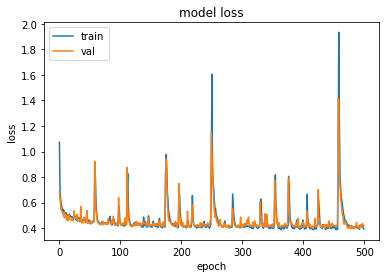

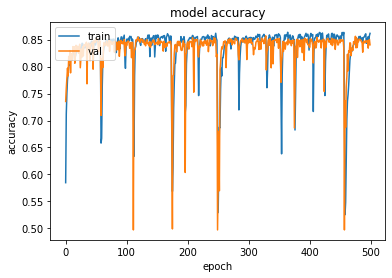

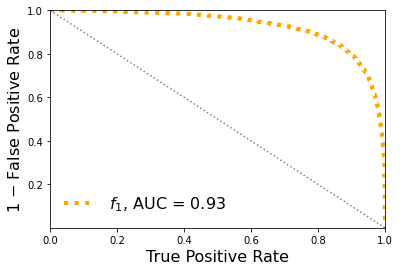

313/313 [==============================] - 3s 9ms/step - loss: 0.4250 - acc: 0.8356 - f1_m: 0.4817 - precision_m: 0.5000 - recall_m: 0.4656
Test ROC-AUC: 0.92688484
Test loss: 0.425000935792923
Test accuracy: 0.8356000185012817
Test f1: 0.4816525876522064
Test precision: 0.5
Test recall: 0.4655551016330719
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 35s 90ms/step - loss: 0.8829 - acc: 0.5535 - f1_m: 0.4510 - precision_m: 0.5595 - recall_m: 0.4293 - val_loss: 0.5945 - val_acc: 0.7558 - val_f1_m: 0.7748 - val_precision_m: 0.7097 - val_recall_m: 0.8576
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6200 - acc: 0.6839 - f1_m: 0.7240 - precision_m: 0.6415 - recall_m: 0.8400 - val_loss: 0.5436 - val_acc: 0.7792 - val_f1_m: 0.7997 - val_precision_m: 0.7232 - val_recall_m: 0.9

Epoch 31/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4656 - acc: 0.8222 - f1_m: 0.8256 - precision_m: 0.8132 - recall_m: 0.8459 - val_loss: 0.4442 - val_acc: 0.8210 - val_f1_m: 0.8075 - val_precision_m: 0.8595 - val_recall_m: 0.7660
Epoch 32/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4614 - acc: 0.8143 - f1_m: 0.8144 - precision_m: 0.8047 - recall_m: 0.8327 - val_loss: 0.4341 - val_acc: 0.8293 - val_f1_m: 0.8346 - val_precision_m: 0.7995 - val_recall_m: 0.8777
Epoch 33/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4611 - acc: 0.8208 - f1_m: 0.8210 - precision_m: 0.8080 - recall_m: 0.8416 - val_loss: 0.4290 - val_acc: 0.8358 - val_f1_m: 0.8377 - val_precision_m: 0.8183 - val_recall_m: 0.8626
Epoch 34/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4599 - acc: 0.8176 - f1_m: 0.8192 - precision_m: 0.8080 - recall_m: 0.8377 - val_loss: 0.4346 - val_acc: 0.8303 - val_f1_m: 0.8391 - val_pre

375/375 [==============================] - 32s 86ms/step - loss: 0.4344 - acc: 0.8423 - f1_m: 0.8421 - precision_m: 0.8361 - recall_m: 0.8552 - val_loss: 0.4233 - val_acc: 0.8398 - val_f1_m: 0.8405 - val_precision_m: 0.8286 - val_recall_m: 0.8579
Epoch 94/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4395 - acc: 0.8371 - f1_m: 0.8350 - precision_m: 0.8354 - recall_m: 0.8417 - val_loss: 0.5976 - val_acc: 0.7957 - val_f1_m: 0.8174 - val_precision_m: 0.7319 - val_recall_m: 0.9315
Epoch 95/500
375/375 [==============================] - 32s 87ms/step - loss: 0.5524 - acc: 0.8096 - f1_m: 0.8114 - precision_m: 0.8089 - recall_m: 0.8217 - val_loss: 0.4363 - val_acc: 0.8447 - val_f1_m: 0.8486 - val_precision_m: 0.8189 - val_recall_m: 0.8855
Epoch 96/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4511 - acc: 0.8392 - f1_m: 0.8373 - precision_m: 0.8338 - recall_m: 0.8509 - val_loss: 0.4379 - val_acc: 0.8403 - val_f1_m: 0.8359 - val_precision_m: 0.8

375/375 [==============================] - 32s 86ms/step - loss: 0.4606 - acc: 0.8296 - f1_m: 0.8285 - precision_m: 0.8318 - recall_m: 0.8326 - val_loss: 0.5735 - val_acc: 0.7683 - val_f1_m: 0.7172 - val_precision_m: 0.9017 - val_recall_m: 0.6013
Epoch 156/500
375/375 [==============================] - 32s 86ms/step - loss: 0.5151 - acc: 0.8237 - f1_m: 0.8212 - precision_m: 0.8269 - recall_m: 0.8279 - val_loss: 0.4565 - val_acc: 0.8298 - val_f1_m: 0.8311 - val_precision_m: 0.8158 - val_recall_m: 0.8534
Epoch 157/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4545 - acc: 0.8390 - f1_m: 0.8394 - precision_m: 0.8393 - recall_m: 0.8463 - val_loss: 0.4885 - val_acc: 0.8213 - val_f1_m: 0.8282 - val_precision_m: 0.7858 - val_recall_m: 0.8813
Epoch 158/500
375/375 [==============================] - 32s 86ms/step - loss: 0.5454 - acc: 0.7928 - f1_m: 0.7859 - precision_m: 0.7945 - recall_m: 0.7923 - val_loss: 0.4610 - val_acc: 0.8240 - val_f1_m: 0.8138 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4701 - acc: 0.8375 - f1_m: 0.8355 - precision_m: 0.8460 - recall_m: 0.8345 - val_loss: 0.4690 - val_acc: 0.8178 - val_f1_m: 0.8029 - val_precision_m: 0.8606 - val_recall_m: 0.7575
Epoch 218/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4354 - acc: 0.8473 - f1_m: 0.8442 - precision_m: 0.8509 - recall_m: 0.8437 - val_loss: 0.4551 - val_acc: 0.8320 - val_f1_m: 0.8294 - val_precision_m: 0.8306 - val_recall_m: 0.8339
Epoch 219/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4409 - acc: 0.8472 - f1_m: 0.8451 - precision_m: 0.8495 - recall_m: 0.8466 - val_loss: 0.4571 - val_acc: 0.8335 - val_f1_m: 0.8351 - val_precision_m: 0.8176 - val_recall_m: 0.8585
Epoch 220/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4407 - acc: 0.8390 - f1_m: 0.8371 - precision_m: 0.8390 - recall_m: 0.8416 - val_loss: 0.4870 - val_acc: 0.8247 - val_f1_m: 0.8360 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.5406 - acc: 0.8266 - f1_m: 0.8138 - precision_m: 0.8395 - recall_m: 0.8028 - val_loss: 0.4806 - val_acc: 0.8150 - val_f1_m: 0.8013 - val_precision_m: 0.8532 - val_recall_m: 0.7605
Epoch 280/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4726 - acc: 0.8331 - f1_m: 0.8281 - precision_m: 0.8379 - recall_m: 0.8257 - val_loss: 0.4909 - val_acc: 0.8170 - val_f1_m: 0.8020 - val_precision_m: 0.8607 - val_recall_m: 0.7554
Epoch 281/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4772 - acc: 0.8337 - f1_m: 0.8291 - precision_m: 0.8392 - recall_m: 0.8264 - val_loss: 0.4524 - val_acc: 0.8357 - val_f1_m: 0.8318 - val_precision_m: 0.8408 - val_recall_m: 0.8282
Epoch 282/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4949 - acc: 0.8239 - f1_m: 0.8156 - precision_m: 0.8347 - recall_m: 0.8087 - val_loss: 0.4817 - val_acc: 0.8230 - val_f1_m: 0.8089 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4400 - acc: 0.8397 - f1_m: 0.8390 - precision_m: 0.8430 - recall_m: 0.8409 - val_loss: 0.4516 - val_acc: 0.8247 - val_f1_m: 0.8166 - val_precision_m: 0.8437 - val_recall_m: 0.7955
Epoch 342/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4867 - acc: 0.8280 - f1_m: 0.8221 - precision_m: 0.8358 - recall_m: 0.8162 - val_loss: 0.4689 - val_acc: 0.8195 - val_f1_m: 0.8097 - val_precision_m: 0.8443 - val_recall_m: 0.7825
Epoch 343/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4483 - acc: 0.8374 - f1_m: 0.8343 - precision_m: 0.8428 - recall_m: 0.8318 - val_loss: 0.4497 - val_acc: 0.8272 - val_f1_m: 0.8214 - val_precision_m: 0.8376 - val_recall_m: 0.8102
Epoch 344/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4392 - acc: 0.8398 - f1_m: 0.8352 - precision_m: 0.8470 - recall_m: 0.8296 - val_loss: 0.4561 - val_acc: 0.8317 - val_f1_m: 0.8363 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4526 - acc: 0.8345 - f1_m: 0.8301 - precision_m: 0.8343 - recall_m: 0.8335 - val_loss: 0.4527 - val_acc: 0.8247 - val_f1_m: 0.8162 - val_precision_m: 0.8445 - val_recall_m: 0.7940
Epoch 404/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4411 - acc: 0.8393 - f1_m: 0.8332 - precision_m: 0.8465 - recall_m: 0.8287 - val_loss: 0.4632 - val_acc: 0.8217 - val_f1_m: 0.8117 - val_precision_m: 0.8468 - val_recall_m: 0.7842
Epoch 405/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4459 - acc: 0.8408 - f1_m: 0.8373 - precision_m: 0.8475 - recall_m: 0.8329 - val_loss: 0.4516 - val_acc: 0.8265 - val_f1_m: 0.8218 - val_precision_m: 0.8329 - val_recall_m: 0.8155
Epoch 406/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4329 - acc: 0.8420 - f1_m: 0.8403 - precision_m: 0.8419 - recall_m: 0.8445 - val_loss: 0.4535 - val_acc: 0.8288 - val_f1_m: 0.8257 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4700 - acc: 0.8404 - f1_m: 0.8361 - precision_m: 0.8483 - recall_m: 0.8299 - val_loss: 0.4821 - val_acc: 0.8257 - val_f1_m: 0.8342 - val_precision_m: 0.7848 - val_recall_m: 0.8960
Epoch 466/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4587 - acc: 0.8419 - f1_m: 0.8391 - precision_m: 0.8454 - recall_m: 0.8393 - val_loss: 0.4723 - val_acc: 0.8253 - val_f1_m: 0.8214 - val_precision_m: 0.8269 - val_recall_m: 0.8204
Epoch 467/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4438 - acc: 0.8434 - f1_m: 0.8416 - precision_m: 0.8501 - recall_m: 0.8397 - val_loss: 0.4544 - val_acc: 0.8297 - val_f1_m: 0.8210 - val_precision_m: 0.8515 - val_recall_m: 0.7976
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4408 - acc: 0.8438 - f1_m: 0.8375 - precision_m: 0.8532 - recall_m: 0.8292 - val_loss: 0.4636 - val_acc: 0.8167 - val_f1_m: 0.8023 - val_precision_m: 

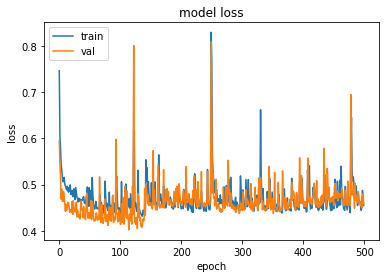

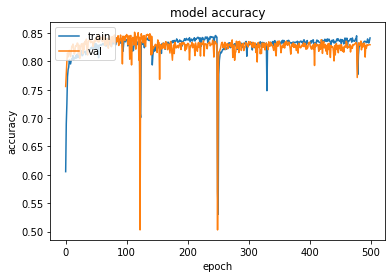

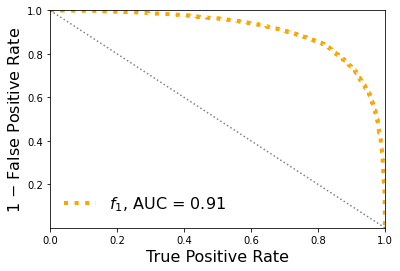

313/313 [==============================] - 3s 9ms/step - loss: 0.4608 - acc: 0.8272 - f1_m: 0.4432 - precision_m: 0.5000 - recall_m: 0.3994
Test ROC-AUC: 0.9084541
Test loss: 0.4607648551464081
Test accuracy: 0.8271999955177307
Test f1: 0.4432283937931061
Test precision: 0.5
Test recall: 0.3993610143661499
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 175ms/step - loss: 1.0172 - acc: 0.5855 - f1_m: 0.5854 - precision_m: 0.5768 - recall_m: 0.6362 - val_loss: 0.5917 - val_acc: 0.7702 - val_f1_m: 0.7554 - val_precision_m: 0.7983 - val_recall_m: 0.7205
Epoch 2/500
188/188 [==============================] - 32s 169ms/step - loss: 0.6082 - acc: 0.7543 - f1_m: 0.7603 - precision_m: 0.7470 - recall_m: 0.7817 - val_loss: 0.5391 - val_acc: 0.7828 - val_f1_m: 0.7595 - val_precision_m: 0.8406 - val_recall_m: 

188/188 [==============================] - 32s 169ms/step - loss: 0.4395 - acc: 0.8457 - f1_m: 0.8460 - precision_m: 0.8363 - recall_m: 0.8655 - val_loss: 0.4467 - val_acc: 0.8337 - val_f1_m: 0.8253 - val_precision_m: 0.8626 - val_recall_m: 0.7945
Epoch 62/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4270 - acc: 0.8471 - f1_m: 0.8489 - precision_m: 0.8302 - recall_m: 0.8722 - val_loss: 0.4225 - val_acc: 0.8428 - val_f1_m: 0.8440 - val_precision_m: 0.8325 - val_recall_m: 0.8585
Epoch 63/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4187 - acc: 0.8539 - f1_m: 0.8566 - precision_m: 0.8364 - recall_m: 0.8807 - val_loss: 0.4231 - val_acc: 0.8467 - val_f1_m: 0.8426 - val_precision_m: 0.8582 - val_recall_m: 0.8301
Epoch 64/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4220 - acc: 0.8519 - f1_m: 0.8539 - precision_m: 0.8371 - recall_m: 0.8767 - val_loss: 0.4423 - val_acc: 0.8367 - val_f1_m: 0.8288 - val_precision_m:

188/188 [==============================] - 32s 172ms/step - loss: 0.4387 - acc: 0.8536 - f1_m: 0.8565 - precision_m: 0.8383 - recall_m: 0.8785 - val_loss: 0.4695 - val_acc: 0.8272 - val_f1_m: 0.8338 - val_precision_m: 0.7960 - val_recall_m: 0.8779
Epoch 124/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4141 - acc: 0.8574 - f1_m: 0.8607 - precision_m: 0.8430 - recall_m: 0.8825 - val_loss: 0.4728 - val_acc: 0.8243 - val_f1_m: 0.8156 - val_precision_m: 0.8491 - val_recall_m: 0.7877
Epoch 125/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4260 - acc: 0.8527 - f1_m: 0.8557 - precision_m: 0.8406 - recall_m: 0.8745 - val_loss: 0.4617 - val_acc: 0.8288 - val_f1_m: 0.8291 - val_precision_m: 0.8204 - val_recall_m: 0.8408
Epoch 126/500
188/188 [==============================] - 32s 173ms/step - loss: 0.4186 - acc: 0.8519 - f1_m: 0.8548 - precision_m: 0.8415 - recall_m: 0.8718 - val_loss: 0.4577 - val_acc: 0.8285 - val_f1_m: 0.8359 - val_precision

188/188 [==============================] - 32s 172ms/step - loss: 0.4430 - acc: 0.8371 - f1_m: 0.8398 - precision_m: 0.8303 - recall_m: 0.8545 - val_loss: 0.4350 - val_acc: 0.8293 - val_f1_m: 0.8229 - val_precision_m: 0.8457 - val_recall_m: 0.8036
Epoch 186/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4419 - acc: 0.8330 - f1_m: 0.8349 - precision_m: 0.8294 - recall_m: 0.8439 - val_loss: 0.4433 - val_acc: 0.8235 - val_f1_m: 0.8173 - val_precision_m: 0.8390 - val_recall_m: 0.7992
Epoch 187/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4582 - acc: 0.8326 - f1_m: 0.8302 - precision_m: 0.8286 - recall_m: 0.8386 - val_loss: 0.4436 - val_acc: 0.8247 - val_f1_m: 0.8174 - val_precision_m: 0.8434 - val_recall_m: 0.7954
Epoch 188/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4370 - acc: 0.8357 - f1_m: 0.8364 - precision_m: 0.8278 - recall_m: 0.8484 - val_loss: 0.4340 - val_acc: 0.8362 - val_f1_m: 0.8391 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4185 - acc: 0.8460 - f1_m: 0.8448 - precision_m: 0.8446 - recall_m: 0.8493 - val_loss: 0.4399 - val_acc: 0.8342 - val_f1_m: 0.8351 - val_precision_m: 0.8245 - val_recall_m: 0.8491
Epoch 248/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4161 - acc: 0.8477 - f1_m: 0.8488 - precision_m: 0.8442 - recall_m: 0.8569 - val_loss: 0.4446 - val_acc: 0.8288 - val_f1_m: 0.8293 - val_precision_m: 0.8206 - val_recall_m: 0.8414
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4389 - acc: 0.8508 - f1_m: 0.8501 - precision_m: 0.8521 - recall_m: 0.8558 - val_loss: 0.5171 - val_acc: 0.8278 - val_f1_m: 0.8359 - val_precision_m: 0.7927 - val_recall_m: 0.8867
Epoch 250/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4672 - acc: 0.8508 - f1_m: 0.8511 - precision_m: 0.8485 - recall_m: 0.8579 - val_loss: 0.4648 - val_acc: 0.8355 - val_f1_m: 0.8373 - val_precision

188/188 [==============================] - 33s 174ms/step - loss: 0.5022 - acc: 0.8406 - f1_m: 0.8398 - precision_m: 0.8360 - recall_m: 0.8478 - val_loss: 0.4914 - val_acc: 0.8312 - val_f1_m: 0.8317 - val_precision_m: 0.8226 - val_recall_m: 0.8444
Epoch 310/500
188/188 [==============================] - 33s 175ms/step - loss: 0.4540 - acc: 0.8465 - f1_m: 0.8482 - precision_m: 0.8462 - recall_m: 0.8536 - val_loss: 0.4637 - val_acc: 0.8275 - val_f1_m: 0.8204 - val_precision_m: 0.8478 - val_recall_m: 0.7975
Epoch 311/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4331 - acc: 0.8511 - f1_m: 0.8483 - precision_m: 0.8563 - recall_m: 0.8442 - val_loss: 0.4651 - val_acc: 0.8242 - val_f1_m: 0.8154 - val_precision_m: 0.8520 - val_recall_m: 0.7845
Epoch 312/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4290 - acc: 0.8511 - f1_m: 0.8491 - precision_m: 0.8522 - recall_m: 0.8496 - val_loss: 0.4517 - val_acc: 0.8313 - val_f1_m: 0.8284 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4215 - acc: 0.8486 - f1_m: 0.8460 - precision_m: 0.8498 - recall_m: 0.8459 - val_loss: 0.4473 - val_acc: 0.8253 - val_f1_m: 0.8217 - val_precision_m: 0.8331 - val_recall_m: 0.8137
Epoch 372/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4185 - acc: 0.8467 - f1_m: 0.8484 - precision_m: 0.8465 - recall_m: 0.8552 - val_loss: 0.4415 - val_acc: 0.8285 - val_f1_m: 0.8248 - val_precision_m: 0.8365 - val_recall_m: 0.8167
Epoch 373/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4092 - acc: 0.8516 - f1_m: 0.8506 - precision_m: 0.8476 - recall_m: 0.8572 - val_loss: 0.4487 - val_acc: 0.8245 - val_f1_m: 0.8175 - val_precision_m: 0.8432 - val_recall_m: 0.7967
Epoch 374/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4117 - acc: 0.8528 - f1_m: 0.8511 - precision_m: 0.8502 - recall_m: 0.8565 - val_loss: 0.4611 - val_acc: 0.8138 - val_f1_m: 0.8026 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4438 - acc: 0.8484 - f1_m: 0.8482 - precision_m: 0.8496 - recall_m: 0.8530 - val_loss: 0.5435 - val_acc: 0.8183 - val_f1_m: 0.8120 - val_precision_m: 0.8358 - val_recall_m: 0.7929
Epoch 434/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5005 - acc: 0.8387 - f1_m: 0.8371 - precision_m: 0.8382 - recall_m: 0.8389 - val_loss: 0.4892 - val_acc: 0.8247 - val_f1_m: 0.8204 - val_precision_m: 0.8353 - val_recall_m: 0.8091
Epoch 435/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4453 - acc: 0.8495 - f1_m: 0.8475 - precision_m: 0.8537 - recall_m: 0.8445 - val_loss: 0.4778 - val_acc: 0.8278 - val_f1_m: 0.8255 - val_precision_m: 0.8298 - val_recall_m: 0.8239
Epoch 436/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4417 - acc: 0.8475 - f1_m: 0.8464 - precision_m: 0.8523 - recall_m: 0.8454 - val_loss: 0.4805 - val_acc: 0.8243 - val_f1_m: 0.8174 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4468 - acc: 0.8433 - f1_m: 0.8420 - precision_m: 0.8437 - recall_m: 0.8450 - val_loss: 0.4951 - val_acc: 0.8298 - val_f1_m: 0.8328 - val_precision_m: 0.8110 - val_recall_m: 0.8584
Epoch 496/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4360 - acc: 0.8545 - f1_m: 0.8544 - precision_m: 0.8500 - recall_m: 0.8616 - val_loss: 0.4716 - val_acc: 0.8268 - val_f1_m: 0.8345 - val_precision_m: 0.7927 - val_recall_m: 0.8836
Epoch 497/500
188/188 [==============================] - 31s 166ms/step - loss: 0.4763 - acc: 0.8346 - f1_m: 0.8340 - precision_m: 0.8342 - recall_m: 0.8477 - val_loss: 0.4777 - val_acc: 0.8323 - val_f1_m: 0.8308 - val_precision_m: 0.8311 - val_recall_m: 0.8332
Epoch 498/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4467 - acc: 0.8493 - f1_m: 0.8491 - precision_m: 0.8480 - recall_m: 0.8539 - val_loss: 0.4594 - val_acc: 0.8305 - val_f1_m: 0.8275 - val_precision

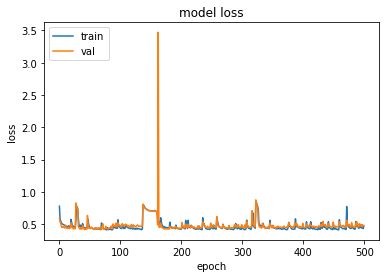

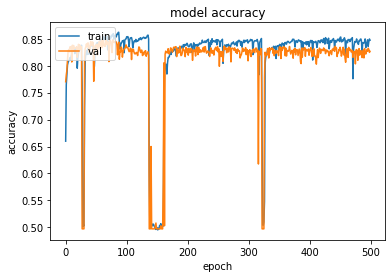

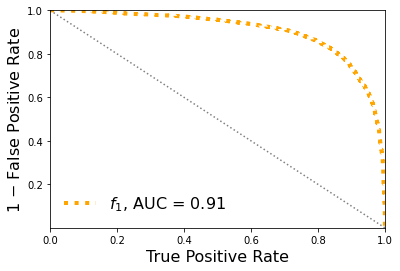

313/313 [==============================] - 3s 9ms/step - loss: 0.4854 - acc: 0.8298 - f1_m: 0.4494 - precision_m: 0.5001 - recall_m: 0.4095
Test ROC-AUC: 0.9055693199999999
Test loss: 0.4853726029396057
Test accuracy: 0.829800009727478
Test f1: 0.449396014213562
Test precision: 0.5001451969146729
Test recall: 0.4095447361469269
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 363ms/step - loss: 1.4290 - acc: 0.5195 - f1_m: 0.5598 - precision_m: 0.5158 - recall_m: 0.6366 - val_loss: 0.7110 - val_acc: 0.7317 - val_f1_m: 0.7713 - val_precision_m: 0.6658 - val_recall_m: 0.9189
Epoch 2/500
94/94 [==============================] - 32s 344ms/step - loss: 0.7037 - acc: 0.6393 - f1_m: 0.6235 - precision_m: 0.6512 - recall_m: 0.6019 - val_loss: 0.6875 - val_acc: 0.6940 - val_f1_m: 0.7568 - val_precision_m: 0.623

Epoch 31/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4440 - acc: 0.8391 - f1_m: 0.8429 - precision_m: 0.8240 - recall_m: 0.8663 - val_loss: 0.4316 - val_acc: 0.8420 - val_f1_m: 0.8485 - val_precision_m: 0.8032 - val_recall_m: 0.9007
Epoch 32/500
94/94 [==============================] - 32s 340ms/step - loss: 0.4359 - acc: 0.8415 - f1_m: 0.8453 - precision_m: 0.8280 - recall_m: 0.8675 - val_loss: 0.4227 - val_acc: 0.8410 - val_f1_m: 0.8344 - val_precision_m: 0.8543 - val_recall_m: 0.8169
Epoch 33/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4405 - acc: 0.8381 - f1_m: 0.8402 - precision_m: 0.8222 - recall_m: 0.8633 - val_loss: 0.4970 - val_acc: 0.8303 - val_f1_m: 0.8355 - val_precision_m: 0.8019 - val_recall_m: 0.8736
Epoch 34/500
94/94 [==============================] - 32s 341ms/step - loss: 0.5043 - acc: 0.8169 - f1_m: 0.8254 - precision_m: 0.7994 - recall_m: 0.8570 - val_loss: 0.4616 - val_acc: 0.8350 - val_f1_m: 0.8411 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4138 - acc: 0.8529 - f1_m: 0.8585 - precision_m: 0.8353 - recall_m: 0.8854 - val_loss: 0.4219 - val_acc: 0.8468 - val_f1_m: 0.8454 - val_precision_m: 0.8376 - val_recall_m: 0.8552
Epoch 64/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4121 - acc: 0.8539 - f1_m: 0.8590 - precision_m: 0.8361 - recall_m: 0.8862 - val_loss: 0.4236 - val_acc: 0.8432 - val_f1_m: 0.8473 - val_precision_m: 0.8173 - val_recall_m: 0.8808
Epoch 65/500
94/94 [==============================] - 34s 357ms/step - loss: 0.4097 - acc: 0.8558 - f1_m: 0.8602 - precision_m: 0.8376 - recall_m: 0.8863 - val_loss: 0.4294 - val_acc: 0.8425 - val_f1_m: 0.8510 - val_precision_m: 0.7993 - val_recall_m: 0.9116
Epoch 66/500
94/94 [==============================] - 34s 362ms/step - loss: 0.4125 - acc: 0.8555 - f1_m: 0.8604 - precision_m: 0.8358 - recall_m: 0.8886 - val_loss: 0.4240 - val_acc: 0.8413 - val_f1_m: 0.8383 - val_precisi

Epoch 95/500
94/94 [==============================] - 32s 337ms/step - loss: 0.5154 - acc: 0.8267 - f1_m: 0.8261 - precision_m: 0.8136 - recall_m: 0.8602 - val_loss: 0.5312 - val_acc: 0.8248 - val_f1_m: 0.8178 - val_precision_m: 0.8399 - val_recall_m: 0.7986
Epoch 96/500
94/94 [==============================] - 32s 337ms/step - loss: 0.5402 - acc: 0.8223 - f1_m: 0.8254 - precision_m: 0.8087 - recall_m: 0.8463 - val_loss: 0.5123 - val_acc: 0.8085 - val_f1_m: 0.7864 - val_precision_m: 0.8825 - val_recall_m: 0.7116
Epoch 97/500
94/94 [==============================] - 32s 338ms/step - loss: 0.5061 - acc: 0.8306 - f1_m: 0.8286 - precision_m: 0.8324 - recall_m: 0.8309 - val_loss: 0.4807 - val_acc: 0.8403 - val_f1_m: 0.8433 - val_precision_m: 0.8129 - val_recall_m: 0.8779
Epoch 98/500
94/94 [==============================] - 32s 337ms/step - loss: 0.4806 - acc: 0.8371 - f1_m: 0.8382 - precision_m: 0.8255 - recall_m: 0.8540 - val_loss: 0.4764 - val_acc: 0.8367 - val_f1_m: 0.8373 - val_precisi

94/94 [==============================] - 34s 365ms/step - loss: 0.4101 - acc: 0.8551 - f1_m: 0.8589 - precision_m: 0.8384 - recall_m: 0.8832 - val_loss: 0.4564 - val_acc: 0.8327 - val_f1_m: 0.8421 - val_precision_m: 0.7864 - val_recall_m: 0.9081
Epoch 158/500
94/94 [==============================] - 34s 358ms/step - loss: 0.4002 - acc: 0.8586 - f1_m: 0.8634 - precision_m: 0.8390 - recall_m: 0.8907 - val_loss: 0.4517 - val_acc: 0.8363 - val_f1_m: 0.8351 - val_precision_m: 0.8342 - val_recall_m: 0.8377
Epoch 159/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4042 - acc: 0.8580 - f1_m: 0.8596 - precision_m: 0.8404 - recall_m: 0.8816 - val_loss: 0.4513 - val_acc: 0.8375 - val_f1_m: 0.8345 - val_precision_m: 0.8385 - val_recall_m: 0.8324
Epoch 160/500
94/94 [==============================] - 33s 354ms/step - loss: 0.3978 - acc: 0.8588 - f1_m: 0.8611 - precision_m: 0.8451 - recall_m: 0.8805 - val_loss: 0.4549 - val_acc: 0.8352 - val_f1_m: 0.8322 - val_precision_m: 0.83

94/94 [==============================] - 34s 357ms/step - loss: 0.7190 - acc: 0.5059 - f1_m: 0.6389 - precision_m: 0.5026 - recall_m: 0.8822 - val_loss: 0.7175 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 220/500
94/94 [==============================] - 34s 362ms/step - loss: 0.7171 - acc: 0.5060 - f1_m: 0.6573 - precision_m: 0.5060 - recall_m: 0.9529 - val_loss: 0.7159 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 221/500
94/94 [==============================] - 34s 361ms/step - loss: 0.7176 - acc: 0.4967 - f1_m: 0.5768 - precision_m: 0.4997 - recall_m: 0.7116 - val_loss: 0.7426 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 222/500
94/94 [==============================] - 34s 358ms/step - loss: 0.7373 - acc: 0.5109 - f1_m: 0.2722 - precision_m: 0.5190 - recall_m: 0.1949 - val_loss: 0.7253 - val_acc: 0.5393 - val_f1_m: 0.1656 - val_preci

94/94 [==============================] - 33s 352ms/step - loss: 0.7206 - acc: 0.5022 - f1_m: 0.4829 - precision_m: 0.5037 - recall_m: 0.4682 - val_loss: 0.7168 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 282/500
94/94 [==============================] - 33s 351ms/step - loss: 0.7159 - acc: 0.5033 - f1_m: 0.5125 - precision_m: 0.5037 - recall_m: 0.5259 - val_loss: 0.7137 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 283/500
94/94 [==============================] - 33s 353ms/step - loss: 0.7135 - acc: 0.5027 - f1_m: 0.6449 - precision_m: 0.5017 - recall_m: 0.9081 - val_loss: 0.7110 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 284/500
94/94 [==============================] - 33s 354ms/step - loss: 0.7103 - acc: 0.5068 - f1_m: 0.6370 - precision_m: 0.5050 - recall_m: 0.8683 - val_loss: 0.7084 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_preci

94/94 [==============================] - 32s 345ms/step - loss: 0.6951 - acc: 0.4944 - f1_m: 0.4288 - precision_m: 0.3435 - recall_m: 0.6291 - val_loss: 0.6950 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 344/500
94/94 [==============================] - 32s 343ms/step - loss: 0.6950 - acc: 0.4938 - f1_m: 0.2262 - precision_m: 0.1703 - recall_m: 0.3401 - val_loss: 0.6950 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 345/500
94/94 [==============================] - 32s 345ms/step - loss: 0.6950 - acc: 0.4997 - f1_m: 0.6611 - precision_m: 0.5003 - recall_m: 0.9849 - val_loss: 0.6949 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 346/500
94/94 [==============================] - 33s 348ms/step - loss: 0.6949 - acc: 0.5044 - f1_m: 0.6699 - precision_m: 0.5044 - recall_m: 1.0000 - val_loss: 0.6948 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

94/94 [==============================] - 32s 340ms/step - loss: 0.6932 - acc: 0.5035 - f1_m: 0.6691 - precision_m: 0.5035 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 406/500
94/94 [==============================] - 32s 342ms/step - loss: 0.6932 - acc: 0.4975 - f1_m: 0.2052 - precision_m: 0.1699 - recall_m: 0.2915 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 407/500
94/94 [==============================] - 32s 340ms/step - loss: 0.6932 - acc: 0.5033 - f1_m: 0.6685 - precision_m: 0.5038 - recall_m: 0.9989 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 408/500
94/94 [==============================] - 32s 340ms/step - loss: 0.6932 - acc: 0.4955 - f1_m: 0.1960 - precision_m: 0.1463 - recall_m: 0.2979 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_preci

94/94 [==============================] - 33s 347ms/step - loss: 0.6932 - acc: 0.4990 - f1_m: 0.6582 - precision_m: 0.5005 - recall_m: 0.9825 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 468/500
94/94 [==============================] - 33s 347ms/step - loss: 0.6931 - acc: 0.5063 - f1_m: 0.6717 - precision_m: 0.5063 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 469/500
94/94 [==============================] - 33s 347ms/step - loss: 0.6932 - acc: 0.4948 - f1_m: 0.4015 - precision_m: 0.3082 - recall_m: 0.6028 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 470/500
94/94 [==============================] - 33s 349ms/step - loss: 0.6931 - acc: 0.5020 - f1_m: 0.6679 - precision_m: 0.5020 - recall_m: 1.0000 - val_loss: 0.6932 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.49

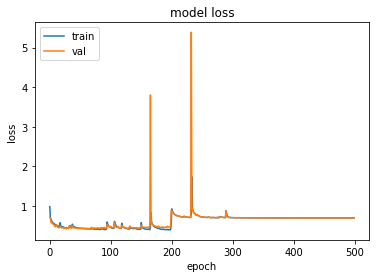

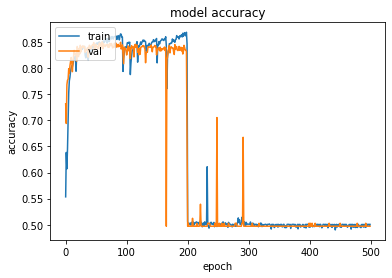

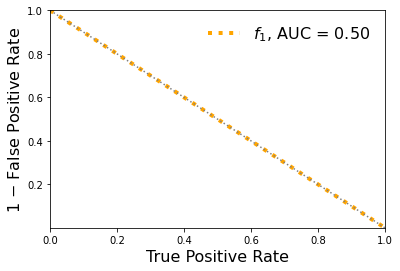

313/313 [==============================] - 3s 9ms/step - loss: 0.6931 - acc: 0.5000 - f1_m: 0.4997 - precision_m: 0.4992 - recall_m: 0.5016
Test ROC-AUC: 0.5
Test loss: 0.6931499242782593
Test accuracy: 0.5
Test f1: 0.4996804893016815
Test precision: 0.4992012679576874
Test recall: 0.5015974640846252
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 34s 89ms/step - loss: 1.0318 - acc: 0.6198 - f1_m: 0.6200 - precision_m: 0.6085 - recall_m: 0.6775 - val_loss: 0.5876 - val_acc: 0.7760 - val_f1_m: 0.7596 - val_precision_m: 0.8072 - val_recall_m: 0.7241
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6202 - acc: 0.7520 - f1_m: 0.7539 - precision_m: 0.7446 - recall_m: 0.7805 - val_loss: 0.5333 - val_acc: 0.8003 - val_f1_m: 0.8111 - val_precision_m: 0.7596 - val_recall_m: 0.8760
Epo

Epoch 31/500
375/375 [==============================] - 33s 88ms/step - loss: 0.5049 - acc: 0.8136 - f1_m: 0.8170 - precision_m: 0.7972 - recall_m: 0.8493 - val_loss: 0.4365 - val_acc: 0.8347 - val_f1_m: 0.8351 - val_precision_m: 0.8196 - val_recall_m: 0.8564
Epoch 32/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4713 - acc: 0.8227 - f1_m: 0.8279 - precision_m: 0.8063 - recall_m: 0.8589 - val_loss: 0.5249 - val_acc: 0.8112 - val_f1_m: 0.7914 - val_precision_m: 0.8665 - val_recall_m: 0.7332
Epoch 33/500
375/375 [==============================] - 33s 88ms/step - loss: 0.5102 - acc: 0.8055 - f1_m: 0.8092 - precision_m: 0.7895 - recall_m: 0.8399 - val_loss: 0.4551 - val_acc: 0.8353 - val_f1_m: 0.8406 - val_precision_m: 0.8054 - val_recall_m: 0.8844
Epoch 34/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4811 - acc: 0.8197 - f1_m: 0.8242 - precision_m: 0.8007 - recall_m: 0.8560 - val_loss: 0.4901 - val_acc: 0.8262 - val_f1_m: 0.8363 - val_pre

375/375 [==============================] - 33s 87ms/step - loss: 0.4804 - acc: 0.8192 - f1_m: 0.8211 - precision_m: 0.8053 - recall_m: 0.8465 - val_loss: 0.4308 - val_acc: 0.8435 - val_f1_m: 0.8430 - val_precision_m: 0.8319 - val_recall_m: 0.8589
Epoch 94/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4682 - acc: 0.8268 - f1_m: 0.8295 - precision_m: 0.8083 - recall_m: 0.8608 - val_loss: 0.4495 - val_acc: 0.8382 - val_f1_m: 0.8423 - val_precision_m: 0.8085 - val_recall_m: 0.8838
Epoch 95/500
375/375 [==============================] - 32s 87ms/step - loss: 0.5209 - acc: 0.8131 - f1_m: 0.8163 - precision_m: 0.7953 - recall_m: 0.8528 - val_loss: 0.4568 - val_acc: 0.8380 - val_f1_m: 0.8361 - val_precision_m: 0.8339 - val_recall_m: 0.8423
Epoch 96/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4749 - acc: 0.8298 - f1_m: 0.8327 - precision_m: 0.8107 - recall_m: 0.8648 - val_loss: 0.4352 - val_acc: 0.8405 - val_f1_m: 0.8450 - val_precision_m: 0.8

375/375 [==============================] - 32s 86ms/step - loss: 0.4876 - acc: 0.8262 - f1_m: 0.8317 - precision_m: 0.8054 - recall_m: 0.8673 - val_loss: 0.4292 - val_acc: 0.8422 - val_f1_m: 0.8378 - val_precision_m: 0.8491 - val_recall_m: 0.8308
Epoch 156/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4769 - acc: 0.8259 - f1_m: 0.8302 - precision_m: 0.8079 - recall_m: 0.8633 - val_loss: 0.4561 - val_acc: 0.8407 - val_f1_m: 0.8477 - val_precision_m: 0.8002 - val_recall_m: 0.9057
Epoch 157/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4781 - acc: 0.8274 - f1_m: 0.8321 - precision_m: 0.8086 - recall_m: 0.8649 - val_loss: 0.4282 - val_acc: 0.8398 - val_f1_m: 0.8378 - val_precision_m: 0.8347 - val_recall_m: 0.8450
Epoch 158/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4943 - acc: 0.8207 - f1_m: 0.8233 - precision_m: 0.8062 - recall_m: 0.8552 - val_loss: 0.4146 - val_acc: 0.8475 - val_f1_m: 0.8504 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4645 - acc: 0.8342 - f1_m: 0.8386 - precision_m: 0.8163 - recall_m: 0.8708 - val_loss: 0.4121 - val_acc: 0.8497 - val_f1_m: 0.8510 - val_precision_m: 0.8316 - val_recall_m: 0.8763
Epoch 218/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4622 - acc: 0.8322 - f1_m: 0.8353 - precision_m: 0.8143 - recall_m: 0.8655 - val_loss: 0.4483 - val_acc: 0.8348 - val_f1_m: 0.8489 - val_precision_m: 0.7719 - val_recall_m: 0.9479
Epoch 219/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4635 - acc: 0.8327 - f1_m: 0.8365 - precision_m: 0.8139 - recall_m: 0.8680 - val_loss: 0.4321 - val_acc: 0.8442 - val_f1_m: 0.8474 - val_precision_m: 0.8209 - val_recall_m: 0.8805
Epoch 220/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4727 - acc: 0.8279 - f1_m: 0.8315 - precision_m: 0.8113 - recall_m: 0.8631 - val_loss: 0.4368 - val_acc: 0.8420 - val_f1_m: 0.8454 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4616 - acc: 0.8296 - f1_m: 0.8337 - precision_m: 0.8140 - recall_m: 0.8644 - val_loss: 0.4920 - val_acc: 0.8257 - val_f1_m: 0.8085 - val_precision_m: 0.8831 - val_recall_m: 0.7504
Epoch 280/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4823 - acc: 0.8284 - f1_m: 0.8327 - precision_m: 0.8086 - recall_m: 0.8658 - val_loss: 0.4373 - val_acc: 0.8433 - val_f1_m: 0.8522 - val_precision_m: 0.7948 - val_recall_m: 0.9231
Epoch 281/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4778 - acc: 0.8243 - f1_m: 0.8254 - precision_m: 0.8104 - recall_m: 0.8550 - val_loss: 0.4388 - val_acc: 0.8492 - val_f1_m: 0.8547 - val_precision_m: 0.8125 - val_recall_m: 0.9058
Epoch 282/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4663 - acc: 0.8332 - f1_m: 0.8347 - precision_m: 0.8182 - recall_m: 0.8612 - val_loss: 0.4225 - val_acc: 0.8498 - val_f1_m: 0.8533 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.5127 - acc: 0.8116 - f1_m: 0.8146 - precision_m: 0.7991 - recall_m: 0.8474 - val_loss: 0.4416 - val_acc: 0.8338 - val_f1_m: 0.8235 - val_precision_m: 0.8647 - val_recall_m: 0.7910
Epoch 342/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4705 - acc: 0.8304 - f1_m: 0.8314 - precision_m: 0.8149 - recall_m: 0.8592 - val_loss: 0.4330 - val_acc: 0.8413 - val_f1_m: 0.8358 - val_precision_m: 0.8557 - val_recall_m: 0.8212
Epoch 343/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4538 - acc: 0.8346 - f1_m: 0.8347 - precision_m: 0.8214 - recall_m: 0.8570 - val_loss: 0.4992 - val_acc: 0.8277 - val_f1_m: 0.8231 - val_precision_m: 0.8334 - val_recall_m: 0.8175
Epoch 344/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4886 - acc: 0.8278 - f1_m: 0.8334 - precision_m: 0.8138 - recall_m: 0.8646 - val_loss: 0.4846 - val_acc: 0.8242 - val_f1_m: 0.8109 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4631 - acc: 0.8341 - f1_m: 0.8356 - precision_m: 0.8214 - recall_m: 0.8606 - val_loss: 0.4350 - val_acc: 0.8323 - val_f1_m: 0.8230 - val_precision_m: 0.8584 - val_recall_m: 0.7949
Epoch 404/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4770 - acc: 0.8307 - f1_m: 0.8351 - precision_m: 0.8177 - recall_m: 0.8672 - val_loss: 0.4212 - val_acc: 0.8483 - val_f1_m: 0.8514 - val_precision_m: 0.8267 - val_recall_m: 0.8825
Epoch 405/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4659 - acc: 0.8355 - f1_m: 0.8398 - precision_m: 0.8185 - recall_m: 0.8697 - val_loss: 0.4372 - val_acc: 0.8465 - val_f1_m: 0.8479 - val_precision_m: 0.8312 - val_recall_m: 0.8696
Epoch 406/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4643 - acc: 0.8330 - f1_m: 0.8366 - precision_m: 0.8157 - recall_m: 0.8666 - val_loss: 0.4657 - val_acc: 0.8192 - val_f1_m: 0.8321 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4729 - acc: 0.8296 - f1_m: 0.8323 - precision_m: 0.8105 - recall_m: 0.8642 - val_loss: 0.4305 - val_acc: 0.8490 - val_f1_m: 0.8497 - val_precision_m: 0.8347 - val_recall_m: 0.8695
Epoch 466/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4620 - acc: 0.8351 - f1_m: 0.8353 - precision_m: 0.8231 - recall_m: 0.8580 - val_loss: 0.4253 - val_acc: 0.8470 - val_f1_m: 0.8533 - val_precision_m: 0.8089 - val_recall_m: 0.9074
Epoch 467/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4752 - acc: 0.8294 - f1_m: 0.8315 - precision_m: 0.8141 - recall_m: 0.8600 - val_loss: 0.4303 - val_acc: 0.8348 - val_f1_m: 0.8229 - val_precision_m: 0.8739 - val_recall_m: 0.7822
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4777 - acc: 0.8280 - f1_m: 0.8297 - precision_m: 0.8185 - recall_m: 0.8552 - val_loss: 0.4343 - val_acc: 0.8382 - val_f1_m: 0.8329 - val_precision_m: 

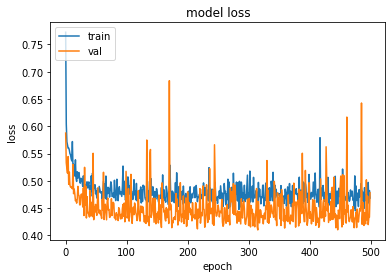

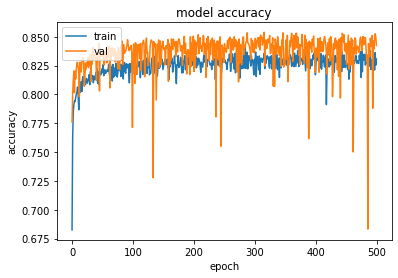

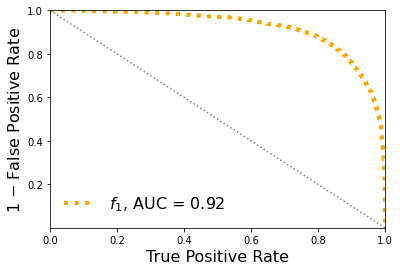

313/313 [==============================] - 3s 9ms/step - loss: 0.5006 - acc: 0.8409 - f1_m: 0.4580 - precision_m: 0.4997 - recall_m: 0.4241
Test ROC-AUC: 0.9201370200000001
Test loss: 0.500572144985199
Test accuracy: 0.8409000039100647
Test f1: 0.4580325186252594
Test precision: 0.4997337758541107
Test recall: 0.4241214096546173
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 33s 172ms/step - loss: 1.8102 - acc: 0.5299 - f1_m: 0.5651 - precision_m: 0.5253 - recall_m: 0.6419 - val_loss: 0.6788 - val_acc: 0.7277 - val_f1_m: 0.7682 - val_precision_m: 0.6653 - val_recall_m: 0.9121
Epoch 2/500
188/188 [==============================] - 31s 167ms/step - loss: 0.6607 - acc: 0.7288 - f1_m: 0.7568 - precision_m: 0.6867 - recall_m: 0.8490 - val_loss: 0.5731 - val_acc: 0.7723 - val_f1_m: 0.7938 - val_precision_m: 0

188/188 [==============================] - 32s 170ms/step - loss: 0.5327 - acc: 0.8070 - f1_m: 0.8147 - precision_m: 0.7828 - recall_m: 0.8572 - val_loss: 0.4487 - val_acc: 0.8398 - val_f1_m: 0.8491 - val_precision_m: 0.7961 - val_recall_m: 0.9126
Epoch 62/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4564 - acc: 0.8314 - f1_m: 0.8376 - precision_m: 0.8096 - recall_m: 0.8729 - val_loss: 0.4208 - val_acc: 0.8468 - val_f1_m: 0.8539 - val_precision_m: 0.8090 - val_recall_m: 0.9066
Epoch 63/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4403 - acc: 0.8362 - f1_m: 0.8412 - precision_m: 0.8108 - recall_m: 0.8789 - val_loss: 0.4357 - val_acc: 0.8397 - val_f1_m: 0.8509 - val_precision_m: 0.7887 - val_recall_m: 0.9264
Epoch 64/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4500 - acc: 0.8352 - f1_m: 0.8392 - precision_m: 0.8129 - recall_m: 0.8729 - val_loss: 0.4305 - val_acc: 0.8383 - val_f1_m: 0.8324 - val_precision_m:

188/188 [==============================] - 32s 170ms/step - loss: 0.4491 - acc: 0.8374 - f1_m: 0.8413 - precision_m: 0.8159 - recall_m: 0.8744 - val_loss: 0.4276 - val_acc: 0.8470 - val_f1_m: 0.8498 - val_precision_m: 0.8271 - val_recall_m: 0.8764
Epoch 124/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4500 - acc: 0.8320 - f1_m: 0.8395 - precision_m: 0.8086 - recall_m: 0.8791 - val_loss: 0.4209 - val_acc: 0.8473 - val_f1_m: 0.8454 - val_precision_m: 0.8489 - val_recall_m: 0.8446
Epoch 125/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4376 - acc: 0.8356 - f1_m: 0.8410 - precision_m: 0.8168 - recall_m: 0.8724 - val_loss: 0.4253 - val_acc: 0.8457 - val_f1_m: 0.8546 - val_precision_m: 0.8008 - val_recall_m: 0.9188
Epoch 126/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4297 - acc: 0.8431 - f1_m: 0.8486 - precision_m: 0.8199 - recall_m: 0.8854 - val_loss: 0.4365 - val_acc: 0.8452 - val_f1_m: 0.8499 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4667 - acc: 0.8305 - f1_m: 0.8346 - precision_m: 0.8143 - recall_m: 0.8619 - val_loss: 0.4327 - val_acc: 0.8387 - val_f1_m: 0.8352 - val_precision_m: 0.8473 - val_recall_m: 0.8265
Epoch 186/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4276 - acc: 0.8470 - f1_m: 0.8518 - precision_m: 0.8289 - recall_m: 0.8801 - val_loss: 0.4131 - val_acc: 0.8432 - val_f1_m: 0.8406 - val_precision_m: 0.8464 - val_recall_m: 0.8379
Epoch 187/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4191 - acc: 0.8435 - f1_m: 0.8481 - precision_m: 0.8224 - recall_m: 0.8785 - val_loss: 0.4140 - val_acc: 0.8413 - val_f1_m: 0.8482 - val_precision_m: 0.8053 - val_recall_m: 0.8986
Epoch 188/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4300 - acc: 0.8482 - f1_m: 0.8501 - precision_m: 0.8279 - recall_m: 0.8795 - val_loss: 0.4518 - val_acc: 0.8207 - val_f1_m: 0.8408 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4447 - acc: 0.8384 - f1_m: 0.8441 - precision_m: 0.8131 - recall_m: 0.8816 - val_loss: 0.4868 - val_acc: 0.8085 - val_f1_m: 0.7828 - val_precision_m: 0.8939 - val_recall_m: 0.6992
Epoch 248/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4851 - acc: 0.8253 - f1_m: 0.8299 - precision_m: 0.8166 - recall_m: 0.8545 - val_loss: 0.4535 - val_acc: 0.8402 - val_f1_m: 0.8407 - val_precision_m: 0.8294 - val_recall_m: 0.8548
Epoch 249/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4657 - acc: 0.8317 - f1_m: 0.8369 - precision_m: 0.8129 - recall_m: 0.8693 - val_loss: 0.4233 - val_acc: 0.8423 - val_f1_m: 0.8527 - val_precision_m: 0.7936 - val_recall_m: 0.9243
Epoch 250/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4240 - acc: 0.8491 - f1_m: 0.8547 - precision_m: 0.8324 - recall_m: 0.8819 - val_loss: 0.4178 - val_acc: 0.8442 - val_f1_m: 0.8396 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4238 - acc: 0.8459 - f1_m: 0.8507 - precision_m: 0.8301 - recall_m: 0.8761 - val_loss: 0.4174 - val_acc: 0.8462 - val_f1_m: 0.8406 - val_precision_m: 0.8635 - val_recall_m: 0.8218
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4382 - acc: 0.8416 - f1_m: 0.8457 - precision_m: 0.8319 - recall_m: 0.8670 - val_loss: 0.4342 - val_acc: 0.8463 - val_f1_m: 0.8579 - val_precision_m: 0.7924 - val_recall_m: 0.9378
Epoch 311/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4445 - acc: 0.8413 - f1_m: 0.8457 - precision_m: 0.8262 - recall_m: 0.8750 - val_loss: 0.4373 - val_acc: 0.8363 - val_f1_m: 0.8502 - val_precision_m: 0.7778 - val_recall_m: 0.9402
Epoch 312/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4336 - acc: 0.8427 - f1_m: 0.8473 - precision_m: 0.8216 - recall_m: 0.8811 - val_loss: 0.4464 - val_acc: 0.8295 - val_f1_m: 0.8468 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4253 - acc: 0.8480 - f1_m: 0.8520 - precision_m: 0.8287 - recall_m: 0.8810 - val_loss: 0.4133 - val_acc: 0.8472 - val_f1_m: 0.8530 - val_precision_m: 0.8134 - val_recall_m: 0.8989
Epoch 372/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4385 - acc: 0.8457 - f1_m: 0.8475 - precision_m: 0.8256 - recall_m: 0.8768 - val_loss: 0.4221 - val_acc: 0.8470 - val_f1_m: 0.8512 - val_precision_m: 0.8217 - val_recall_m: 0.8854
Epoch 373/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4358 - acc: 0.8434 - f1_m: 0.8464 - precision_m: 0.8266 - recall_m: 0.8723 - val_loss: 0.4184 - val_acc: 0.8528 - val_f1_m: 0.8534 - val_precision_m: 0.8430 - val_recall_m: 0.8668
Epoch 374/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4306 - acc: 0.8451 - f1_m: 0.8470 - precision_m: 0.8255 - recall_m: 0.8733 - val_loss: 0.4448 - val_acc: 0.8395 - val_f1_m: 0.8349 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4266 - acc: 0.8493 - f1_m: 0.8513 - precision_m: 0.8316 - recall_m: 0.8757 - val_loss: 0.4189 - val_acc: 0.8432 - val_f1_m: 0.8382 - val_precision_m: 0.8567 - val_recall_m: 0.8234
Epoch 434/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4320 - acc: 0.8415 - f1_m: 0.8452 - precision_m: 0.8252 - recall_m: 0.8726 - val_loss: 0.4179 - val_acc: 0.8448 - val_f1_m: 0.8397 - val_precision_m: 0.8615 - val_recall_m: 0.8217
Epoch 435/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4333 - acc: 0.8449 - f1_m: 0.8480 - precision_m: 0.8226 - recall_m: 0.8818 - val_loss: 0.4434 - val_acc: 0.8418 - val_f1_m: 0.8354 - val_precision_m: 0.8632 - val_recall_m: 0.8121
Epoch 436/500
188/188 [==============================] - 31s 168ms/step - loss: 0.4425 - acc: 0.8432 - f1_m: 0.8477 - precision_m: 0.8285 - recall_m: 0.8737 - val_loss: 0.4124 - val_acc: 0.8512 - val_f1_m: 0.8581 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4207 - acc: 0.8491 - f1_m: 0.8531 - precision_m: 0.8323 - recall_m: 0.8799 - val_loss: 0.5910 - val_acc: 0.8235 - val_f1_m: 0.8073 - val_precision_m: 0.8794 - val_recall_m: 0.7490
Epoch 496/500
188/188 [==============================] - 32s 168ms/step - loss: 0.5378 - acc: 0.8175 - f1_m: 0.8224 - precision_m: 0.7991 - recall_m: 0.8559 - val_loss: 0.4466 - val_acc: 0.8350 - val_f1_m: 0.8252 - val_precision_m: 0.8676 - val_recall_m: 0.7896
Epoch 497/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4726 - acc: 0.8299 - f1_m: 0.8326 - precision_m: 0.8137 - recall_m: 0.8634 - val_loss: 0.4147 - val_acc: 0.8542 - val_f1_m: 0.8583 - val_precision_m: 0.8304 - val_recall_m: 0.8911
Epoch 498/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4364 - acc: 0.8459 - f1_m: 0.8477 - precision_m: 0.8309 - recall_m: 0.8720 - val_loss: 0.4707 - val_acc: 0.8317 - val_f1_m: 0.8489 - val_precision

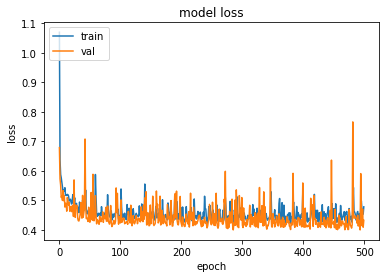

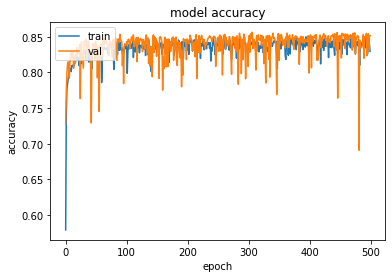

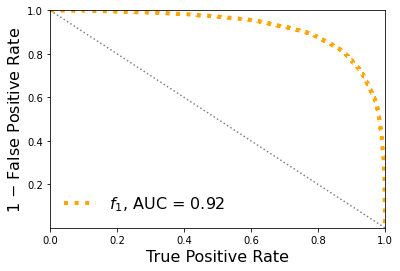

313/313 [==============================] - 3s 9ms/step - loss: 0.4504 - acc: 0.8410 - f1_m: 0.4548 - precision_m: 0.5000 - recall_m: 0.4183
Test ROC-AUC: 0.9213399999999999
Test loss: 0.45037978887557983
Test accuracy: 0.8410000205039978
Test f1: 0.4547833204269409
Test precision: 0.5
Test recall: 0.41833066940307617
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 360ms/step - loss: 2.2396 - acc: 0.5055 - f1_m: 0.4886 - precision_m: 0.4980 - recall_m: 0.5293 - val_loss: 0.7516 - val_acc: 0.7000 - val_f1_m: 0.7550 - val_precision_m: 0.6326 - val_recall_m: 0.9382
Epoch 2/500
94/94 [==============================] - 33s 356ms/step - loss: 0.7588 - acc: 0.6222 - f1_m: 0.6405 - precision_m: 0.6094 - recall_m: 0.6831 - val_loss: 0.6280 - val_acc: 0.7613 - val_f1_m: 0.7683 - val_precision_m: 0.7380 - val_reca

Epoch 31/500
94/94 [==============================] - 33s 356ms/step - loss: 0.4691 - acc: 0.8391 - f1_m: 0.8410 - precision_m: 0.8261 - recall_m: 0.8603 - val_loss: 0.4553 - val_acc: 0.8343 - val_f1_m: 0.8249 - val_precision_m: 0.8609 - val_recall_m: 0.7935
Epoch 32/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4674 - acc: 0.8334 - f1_m: 0.8348 - precision_m: 0.8250 - recall_m: 0.8503 - val_loss: 0.4618 - val_acc: 0.8410 - val_f1_m: 0.8482 - val_precision_m: 0.8006 - val_recall_m: 0.9034
Epoch 33/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4730 - acc: 0.8350 - f1_m: 0.8398 - precision_m: 0.8204 - recall_m: 0.8635 - val_loss: 0.4490 - val_acc: 0.8343 - val_f1_m: 0.8283 - val_precision_m: 0.8445 - val_recall_m: 0.8146
Epoch 34/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4730 - acc: 0.8351 - f1_m: 0.8352 - precision_m: 0.8246 - recall_m: 0.8521 - val_loss: 0.4595 - val_acc: 0.8410 - val_f1_m: 0.8409 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4350 - acc: 0.8500 - f1_m: 0.8510 - precision_m: 0.8407 - recall_m: 0.8650 - val_loss: 0.4420 - val_acc: 0.8357 - val_f1_m: 0.8270 - val_precision_m: 0.8595 - val_recall_m: 0.7984
Epoch 64/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4407 - acc: 0.8411 - f1_m: 0.8446 - precision_m: 0.8316 - recall_m: 0.8645 - val_loss: 0.4755 - val_acc: 0.8147 - val_f1_m: 0.7921 - val_precision_m: 0.8879 - val_recall_m: 0.7169
Epoch 65/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4419 - acc: 0.8435 - f1_m: 0.8453 - precision_m: 0.8318 - recall_m: 0.8639 - val_loss: 0.4443 - val_acc: 0.8428 - val_f1_m: 0.8519 - val_precision_m: 0.7961 - val_recall_m: 0.9179
Epoch 66/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4353 - acc: 0.8511 - f1_m: 0.8539 - precision_m: 0.8374 - recall_m: 0.8763 - val_loss: 0.4715 - val_acc: 0.8337 - val_f1_m: 0.8466 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 351ms/step - loss: 0.8491 - acc: 0.6478 - f1_m: 0.6805 - precision_m: 0.6322 - recall_m: 0.7889 - val_loss: 0.6937 - val_acc: 0.7648 - val_f1_m: 0.7853 - val_precision_m: 0.7135 - val_recall_m: 0.8748
Epoch 96/500
94/94 [==============================] - 33s 352ms/step - loss: 0.6880 - acc: 0.7419 - f1_m: 0.7626 - precision_m: 0.7136 - recall_m: 0.8304 - val_loss: 0.5929 - val_acc: 0.7617 - val_f1_m: 0.7962 - val_precision_m: 0.6880 - val_recall_m: 0.9469
Epoch 97/500
94/94 [==============================] - 33s 351ms/step - loss: 0.5772 - acc: 0.7805 - f1_m: 0.7906 - precision_m: 0.7604 - recall_m: 0.8347 - val_loss: 0.4961 - val_acc: 0.8323 - val_f1_m: 0.8335 - val_precision_m: 0.8174 - val_recall_m: 0.8523
Epoch 98/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4980 - acc: 0.8153 - f1_m: 0.8231 - precision_m: 0.7882 - recall_m: 0.8678 - val_loss: 0.4542 - val_acc: 0.8327 - val_f1_m: 0.8440 - val_precisi

94/94 [==============================] - 33s 349ms/step - loss: 0.4728 - acc: 0.8262 - f1_m: 0.8300 - precision_m: 0.8211 - recall_m: 0.8495 - val_loss: 0.4765 - val_acc: 0.8308 - val_f1_m: 0.8201 - val_precision_m: 0.8677 - val_recall_m: 0.7791
Epoch 158/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4527 - acc: 0.8377 - f1_m: 0.8410 - precision_m: 0.8247 - recall_m: 0.8637 - val_loss: 0.4321 - val_acc: 0.8402 - val_f1_m: 0.8359 - val_precision_m: 0.8428 - val_recall_m: 0.8305
Epoch 159/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4215 - acc: 0.8508 - f1_m: 0.8534 - precision_m: 0.8360 - recall_m: 0.8743 - val_loss: 0.4200 - val_acc: 0.8498 - val_f1_m: 0.8475 - val_precision_m: 0.8480 - val_recall_m: 0.8487
Epoch 160/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4024 - acc: 0.8599 - f1_m: 0.8608 - precision_m: 0.8432 - recall_m: 0.8817 - val_loss: 0.4165 - val_acc: 0.8507 - val_f1_m: 0.8535 - val_precision_m: 0.82

94/94 [==============================] - 33s 346ms/step - loss: 0.4407 - acc: 0.8391 - f1_m: 0.8454 - precision_m: 0.8247 - recall_m: 0.8753 - val_loss: 0.4217 - val_acc: 0.8497 - val_f1_m: 0.8516 - val_precision_m: 0.8267 - val_recall_m: 0.8795
Epoch 220/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4103 - acc: 0.8599 - f1_m: 0.8624 - precision_m: 0.8390 - recall_m: 0.8893 - val_loss: 0.4500 - val_acc: 0.8347 - val_f1_m: 0.8253 - val_precision_m: 0.8635 - val_recall_m: 0.7919
Epoch 221/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4210 - acc: 0.8493 - f1_m: 0.8515 - precision_m: 0.8334 - recall_m: 0.8750 - val_loss: 0.4703 - val_acc: 0.8432 - val_f1_m: 0.8545 - val_precision_m: 0.7871 - val_recall_m: 0.9361
Epoch 222/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4725 - acc: 0.8308 - f1_m: 0.8346 - precision_m: 0.8175 - recall_m: 0.8626 - val_loss: 0.4652 - val_acc: 0.8455 - val_f1_m: 0.8406 - val_precision_m: 0.85

94/94 [==============================] - 33s 347ms/step - loss: 0.4865 - acc: 0.8217 - f1_m: 0.8272 - precision_m: 0.8061 - recall_m: 0.8635 - val_loss: 0.4854 - val_acc: 0.8295 - val_f1_m: 0.8383 - val_precision_m: 0.7855 - val_recall_m: 0.9004
Epoch 282/500
94/94 [==============================] - 32s 346ms/step - loss: 0.5160 - acc: 0.8124 - f1_m: 0.8188 - precision_m: 0.7895 - recall_m: 0.8574 - val_loss: 0.4440 - val_acc: 0.8432 - val_f1_m: 0.8403 - val_precision_m: 0.8476 - val_recall_m: 0.8345
Epoch 283/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4396 - acc: 0.8443 - f1_m: 0.8501 - precision_m: 0.8269 - recall_m: 0.8834 - val_loss: 0.4277 - val_acc: 0.8408 - val_f1_m: 0.8397 - val_precision_m: 0.8373 - val_recall_m: 0.8439
Epoch 284/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4174 - acc: 0.8484 - f1_m: 0.8530 - precision_m: 0.8286 - recall_m: 0.8831 - val_loss: 0.4249 - val_acc: 0.8402 - val_f1_m: 0.8373 - val_precision_m: 0.84

94/94 [==============================] - 32s 346ms/step - loss: 0.4052 - acc: 0.8580 - f1_m: 0.8624 - precision_m: 0.8409 - recall_m: 0.8878 - val_loss: 0.4225 - val_acc: 0.8470 - val_f1_m: 0.8523 - val_precision_m: 0.8172 - val_recall_m: 0.8917
Epoch 344/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4053 - acc: 0.8576 - f1_m: 0.8624 - precision_m: 0.8392 - recall_m: 0.8897 - val_loss: 0.4207 - val_acc: 0.8410 - val_f1_m: 0.8349 - val_precision_m: 0.8572 - val_recall_m: 0.8150
Epoch 345/500
94/94 [==============================] - 32s 345ms/step - loss: 0.3852 - acc: 0.8626 - f1_m: 0.8663 - precision_m: 0.8488 - recall_m: 0.8871 - val_loss: 0.4127 - val_acc: 0.8498 - val_f1_m: 0.8521 - val_precision_m: 0.8291 - val_recall_m: 0.8777
Epoch 346/500
94/94 [==============================] - 32s 346ms/step - loss: 0.3818 - acc: 0.8668 - f1_m: 0.8695 - precision_m: 0.8471 - recall_m: 0.8953 - val_loss: 0.4275 - val_acc: 0.8340 - val_f1_m: 0.8253 - val_precision_m: 0.85

94/94 [==============================] - 32s 341ms/step - loss: 0.5068 - acc: 0.8160 - f1_m: 0.8275 - precision_m: 0.7907 - recall_m: 0.8778 - val_loss: 0.4242 - val_acc: 0.8550 - val_f1_m: 0.8536 - val_precision_m: 0.8540 - val_recall_m: 0.8545
Epoch 406/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4111 - acc: 0.8541 - f1_m: 0.8594 - precision_m: 0.8307 - recall_m: 0.8940 - val_loss: 0.4207 - val_acc: 0.8522 - val_f1_m: 0.8508 - val_precision_m: 0.8500 - val_recall_m: 0.8533
Epoch 407/500
94/94 [==============================] - 32s 343ms/step - loss: 0.3938 - acc: 0.8628 - f1_m: 0.8683 - precision_m: 0.8448 - recall_m: 0.8978 - val_loss: 0.4208 - val_acc: 0.8458 - val_f1_m: 0.8404 - val_precision_m: 0.8604 - val_recall_m: 0.8222
Epoch 408/500
94/94 [==============================] - 32s 341ms/step - loss: 0.3712 - acc: 0.8754 - f1_m: 0.8773 - precision_m: 0.8631 - recall_m: 0.8944 - val_loss: 0.4119 - val_acc: 0.8460 - val_f1_m: 0.8412 - val_precision_m: 0.84

94/94 [==============================] - 32s 340ms/step - loss: 0.6566 - acc: 0.7562 - f1_m: 0.7724 - precision_m: 0.7372 - recall_m: 0.8238 - val_loss: 0.5047 - val_acc: 0.8283 - val_f1_m: 0.8360 - val_precision_m: 0.7913 - val_recall_m: 0.8875
Epoch 468/500
94/94 [==============================] - 32s 338ms/step - loss: 0.5409 - acc: 0.7983 - f1_m: 0.8078 - precision_m: 0.7663 - recall_m: 0.8625 - val_loss: 0.4686 - val_acc: 0.8343 - val_f1_m: 0.8443 - val_precision_m: 0.7870 - val_recall_m: 0.9127
Epoch 469/500
94/94 [==============================] - 32s 338ms/step - loss: 0.4862 - acc: 0.8249 - f1_m: 0.8306 - precision_m: 0.7978 - recall_m: 0.8688 - val_loss: 0.4533 - val_acc: 0.8383 - val_f1_m: 0.8421 - val_precision_m: 0.8132 - val_recall_m: 0.8747
Epoch 470/500
94/94 [==============================] - 32s 338ms/step - loss: 0.4705 - acc: 0.8263 - f1_m: 0.8341 - precision_m: 0.7988 - recall_m: 0.8766 - val_loss: 0.4457 - val_acc: 0.8350 - val_f1_m: 0.8319 - val_precision_m: 0.83

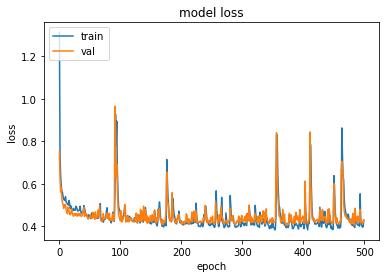

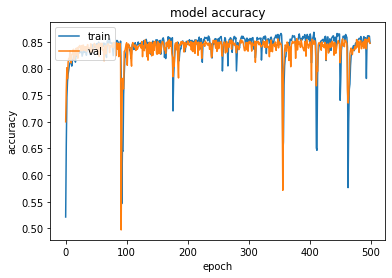

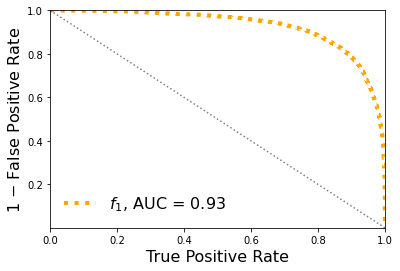

313/313 [==============================] - 3s 9ms/step - loss: 0.4352 - acc: 0.8468 - f1_m: 0.4597 - precision_m: 0.5003 - recall_m: 0.4266
Test ROC-AUC: 0.92557622
Test loss: 0.43518632650375366
Test accuracy: 0.8468000292778015
Test f1: 0.4597432613372803
Test precision: 0.5002662539482117
Test recall: 0.42661741375923157
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 35s 90ms/step - loss: 1.0436 - acc: 0.5036 - f1_m: 0.5864 - precision_m: 0.5099 - recall_m: 0.7266 - val_loss: 0.7412 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
375/375 [==============================] - 33s 87ms/step - loss: 0.7263 - acc: 0.5304 - f1_m: 0.5165 - precision_m: 0.5347 - recall_m: 0.5480 - val_loss: 0.5645 - val_acc: 0.7698 - val_f1_m: 0.7702 - val_precision_

375/375 [==============================] - 32s 87ms/step - loss: 0.4568 - acc: 0.8372 - f1_m: 0.8361 - precision_m: 0.8286 - recall_m: 0.8513 - val_loss: 0.4252 - val_acc: 0.8372 - val_f1_m: 0.8312 - val_precision_m: 0.8541 - val_recall_m: 0.8150
Epoch 62/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4570 - acc: 0.8362 - f1_m: 0.8356 - precision_m: 0.8324 - recall_m: 0.8493 - val_loss: 0.4425 - val_acc: 0.8385 - val_f1_m: 0.8288 - val_precision_m: 0.8694 - val_recall_m: 0.7963
Epoch 63/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4673 - acc: 0.8378 - f1_m: 0.8379 - precision_m: 0.8309 - recall_m: 0.8543 - val_loss: 0.4361 - val_acc: 0.8405 - val_f1_m: 0.8441 - val_precision_m: 0.8130 - val_recall_m: 0.8825
Epoch 64/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4574 - acc: 0.8334 - f1_m: 0.8342 - precision_m: 0.8255 - recall_m: 0.8512 - val_loss: 0.4560 - val_acc: 0.8290 - val_f1_m: 0.8153 - val_precision_m: 0.8

375/375 [==============================] - 35s 92ms/step - loss: 0.4458 - acc: 0.8441 - f1_m: 0.8446 - precision_m: 0.8312 - recall_m: 0.8652 - val_loss: 0.4545 - val_acc: 0.8348 - val_f1_m: 0.8221 - val_precision_m: 0.8764 - val_recall_m: 0.7789
Epoch 124/500
375/375 [==============================] - 34s 92ms/step - loss: 0.4566 - acc: 0.8413 - f1_m: 0.8427 - precision_m: 0.8358 - recall_m: 0.8576 - val_loss: 0.4373 - val_acc: 0.8472 - val_f1_m: 0.8572 - val_precision_m: 0.7936 - val_recall_m: 0.9365
Epoch 125/500
375/375 [==============================] - 34s 92ms/step - loss: 0.4356 - acc: 0.8460 - f1_m: 0.8460 - precision_m: 0.8361 - recall_m: 0.8634 - val_loss: 0.4293 - val_acc: 0.8413 - val_f1_m: 0.8341 - val_precision_m: 0.8629 - val_recall_m: 0.8116
Epoch 126/500
375/375 [==============================] - 34s 90ms/step - loss: 0.4517 - acc: 0.8440 - f1_m: 0.8426 - precision_m: 0.8413 - recall_m: 0.8527 - val_loss: 0.4198 - val_acc: 0.8487 - val_f1_m: 0.8442 - val_precision_m: 

375/375 [==============================] - 33s 89ms/step - loss: 0.4372 - acc: 0.8445 - f1_m: 0.8445 - precision_m: 0.8369 - recall_m: 0.8591 - val_loss: 0.4285 - val_acc: 0.8493 - val_f1_m: 0.8578 - val_precision_m: 0.8042 - val_recall_m: 0.9237
Epoch 186/500
375/375 [==============================] - 33s 89ms/step - loss: 0.4385 - acc: 0.8421 - f1_m: 0.8406 - precision_m: 0.8370 - recall_m: 0.8520 - val_loss: 0.4148 - val_acc: 0.8555 - val_f1_m: 0.8573 - val_precision_m: 0.8364 - val_recall_m: 0.8842
Epoch 187/500
375/375 [==============================] - 33s 89ms/step - loss: 0.4475 - acc: 0.8442 - f1_m: 0.8435 - precision_m: 0.8370 - recall_m: 0.8587 - val_loss: 0.4094 - val_acc: 0.8478 - val_f1_m: 0.8447 - val_precision_m: 0.8506 - val_recall_m: 0.8443
Epoch 188/500
375/375 [==============================] - 33s 89ms/step - loss: 0.4716 - acc: 0.8297 - f1_m: 0.8305 - precision_m: 0.8229 - recall_m: 0.8497 - val_loss: 0.4248 - val_acc: 0.8502 - val_f1_m: 0.8465 - val_precision_m: 

375/375 [==============================] - 33s 88ms/step - loss: 0.4608 - acc: 0.8442 - f1_m: 0.8436 - precision_m: 0.8383 - recall_m: 0.8573 - val_loss: 0.4207 - val_acc: 0.8568 - val_f1_m: 0.8567 - val_precision_m: 0.8453 - val_recall_m: 0.8730
Epoch 248/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4358 - acc: 0.8457 - f1_m: 0.8438 - precision_m: 0.8334 - recall_m: 0.8615 - val_loss: 0.4274 - val_acc: 0.8575 - val_f1_m: 0.8619 - val_precision_m: 0.8251 - val_recall_m: 0.9062
Epoch 249/500
375/375 [==============================] - 33s 89ms/step - loss: 0.4448 - acc: 0.8440 - f1_m: 0.8432 - precision_m: 0.8351 - recall_m: 0.8598 - val_loss: 0.4238 - val_acc: 0.8502 - val_f1_m: 0.8546 - val_precision_m: 0.8216 - val_recall_m: 0.8950
Epoch 250/500
375/375 [==============================] - 33s 89ms/step - loss: 0.4395 - acc: 0.8458 - f1_m: 0.8451 - precision_m: 0.8344 - recall_m: 0.8631 - val_loss: 0.4339 - val_acc: 0.8498 - val_f1_m: 0.8581 - val_precision_m: 

375/375 [==============================] - 33s 88ms/step - loss: 0.4492 - acc: 0.8447 - f1_m: 0.8444 - precision_m: 0.8397 - recall_m: 0.8578 - val_loss: 0.4417 - val_acc: 0.8343 - val_f1_m: 0.8231 - val_precision_m: 0.8708 - val_recall_m: 0.7851
Epoch 310/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4498 - acc: 0.8433 - f1_m: 0.8413 - precision_m: 0.8395 - recall_m: 0.8504 - val_loss: 0.4144 - val_acc: 0.8545 - val_f1_m: 0.8582 - val_precision_m: 0.8246 - val_recall_m: 0.8993
Epoch 311/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4532 - acc: 0.8429 - f1_m: 0.8443 - precision_m: 0.8375 - recall_m: 0.8599 - val_loss: 0.4294 - val_acc: 0.8463 - val_f1_m: 0.8406 - val_precision_m: 0.8622 - val_recall_m: 0.8247
Epoch 312/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4698 - acc: 0.8406 - f1_m: 0.8386 - precision_m: 0.8386 - recall_m: 0.8506 - val_loss: 0.4344 - val_acc: 0.8523 - val_f1_m: 0.8513 - val_precision_m: 

375/375 [==============================] - 33s 88ms/step - loss: 0.5443 - acc: 0.8090 - f1_m: 0.8140 - precision_m: 0.7910 - recall_m: 0.8495 - val_loss: 0.4408 - val_acc: 0.8473 - val_f1_m: 0.8566 - val_precision_m: 0.7978 - val_recall_m: 0.9292
Epoch 372/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4527 - acc: 0.8495 - f1_m: 0.8509 - precision_m: 0.8461 - recall_m: 0.8642 - val_loss: 0.4258 - val_acc: 0.8530 - val_f1_m: 0.8527 - val_precision_m: 0.8436 - val_recall_m: 0.8668
Epoch 373/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4371 - acc: 0.8493 - f1_m: 0.8485 - precision_m: 0.8412 - recall_m: 0.8625 - val_loss: 0.4233 - val_acc: 0.8458 - val_f1_m: 0.8389 - val_precision_m: 0.8656 - val_recall_m: 0.8183
Epoch 374/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4431 - acc: 0.8425 - f1_m: 0.8453 - precision_m: 0.8332 - recall_m: 0.8661 - val_loss: 0.4909 - val_acc: 0.8372 - val_f1_m: 0.8277 - val_precision_m: 

375/375 [==============================] - 33s 88ms/step - loss: 0.4406 - acc: 0.8442 - f1_m: 0.8450 - precision_m: 0.8333 - recall_m: 0.8632 - val_loss: 0.4427 - val_acc: 0.8172 - val_f1_m: 0.7974 - val_precision_m: 0.8833 - val_recall_m: 0.7321
Epoch 434/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4694 - acc: 0.8367 - f1_m: 0.8338 - precision_m: 0.8297 - recall_m: 0.8508 - val_loss: 0.4716 - val_acc: 0.8193 - val_f1_m: 0.7975 - val_precision_m: 0.8922 - val_recall_m: 0.7256
Epoch 435/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4764 - acc: 0.8348 - f1_m: 0.8327 - precision_m: 0.8304 - recall_m: 0.8488 - val_loss: 0.4217 - val_acc: 0.8453 - val_f1_m: 0.8382 - val_precision_m: 0.8668 - val_recall_m: 0.8162
Epoch 436/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4276 - acc: 0.8482 - f1_m: 0.8475 - precision_m: 0.8427 - recall_m: 0.8593 - val_loss: 0.4094 - val_acc: 0.8527 - val_f1_m: 0.8518 - val_precision_m: 

375/375 [==============================] - 33s 88ms/step - loss: 0.5413 - acc: 0.8269 - f1_m: 0.8226 - precision_m: 0.8082 - recall_m: 0.8477 - val_loss: 0.4535 - val_acc: 0.8433 - val_f1_m: 0.8454 - val_precision_m: 0.8232 - val_recall_m: 0.8735
Epoch 496/500
375/375 [==============================] - 34s 90ms/step - loss: 0.4963 - acc: 0.8273 - f1_m: 0.8305 - precision_m: 0.8171 - recall_m: 0.8542 - val_loss: 0.4193 - val_acc: 0.8512 - val_f1_m: 0.8470 - val_precision_m: 0.8579 - val_recall_m: 0.8408
Epoch 497/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4419 - acc: 0.8501 - f1_m: 0.8482 - precision_m: 0.8385 - recall_m: 0.8658 - val_loss: 0.4185 - val_acc: 0.8490 - val_f1_m: 0.8446 - val_precision_m: 0.8594 - val_recall_m: 0.8349
Epoch 498/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4527 - acc: 0.8442 - f1_m: 0.8441 - precision_m: 0.8378 - recall_m: 0.8604 - val_loss: 0.4424 - val_acc: 0.8398 - val_f1_m: 0.8265 - val_precision_m: 

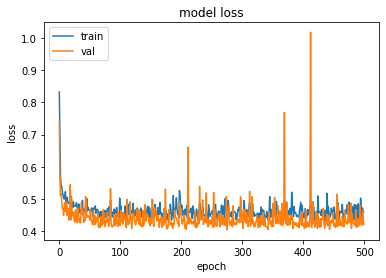

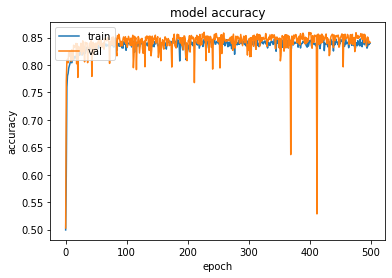

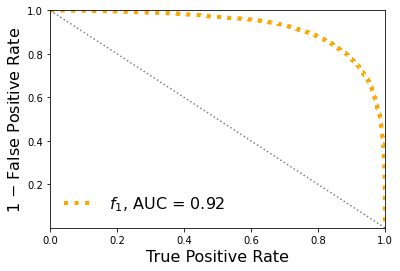

313/313 [==============================] - 3s 9ms/step - loss: 0.4346 - acc: 0.8413 - f1_m: 0.4451 - precision_m: 0.4998 - recall_m: 0.4027
Test ROC-AUC: 0.92412116
Test loss: 0.4346422255039215
Test accuracy: 0.8413000106811523
Test f1: 0.44514551758766174
Test precision: 0.4998224973678589
Test recall: 0.4026557505130768
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 177ms/step - loss: 1.1457 - acc: 0.5051 - f1_m: 0.4603 - precision_m: 0.5072 - recall_m: 0.4637 - val_loss: 0.7585 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
188/188 [==============================] - 32s 173ms/step - loss: 0.7515 - acc: 0.5158 - f1_m: 0.3208 - precision_m: 0.5300 - recall_m: 0.2653 - val_loss: 0.6143 - val_acc: 0.7417 - val_f1_m: 0.7155 - val_precisio

188/188 [==============================] - 32s 169ms/step - loss: 0.4603 - acc: 0.8382 - f1_m: 0.8378 - precision_m: 0.8353 - recall_m: 0.8506 - val_loss: 0.4790 - val_acc: 0.8273 - val_f1_m: 0.8415 - val_precision_m: 0.7732 - val_recall_m: 0.9257
Epoch 62/500
188/188 [==============================] - 32s 170ms/step - loss: 0.5178 - acc: 0.8248 - f1_m: 0.8275 - precision_m: 0.8141 - recall_m: 0.8502 - val_loss: 0.5032 - val_acc: 0.8313 - val_f1_m: 0.8463 - val_precision_m: 0.7722 - val_recall_m: 0.9392
Epoch 63/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4810 - acc: 0.8319 - f1_m: 0.8343 - precision_m: 0.8229 - recall_m: 0.8523 - val_loss: 0.4412 - val_acc: 0.8405 - val_f1_m: 0.8413 - val_precision_m: 0.8320 - val_recall_m: 0.8538
Epoch 64/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4645 - acc: 0.8355 - f1_m: 0.8364 - precision_m: 0.8290 - recall_m: 0.8489 - val_loss: 0.4238 - val_acc: 0.8462 - val_f1_m: 0.8509 - val_precision_m:

188/188 [==============================] - 32s 170ms/step - loss: 0.4628 - acc: 0.8407 - f1_m: 0.8330 - precision_m: 0.8496 - recall_m: 0.8364 - val_loss: 0.4235 - val_acc: 0.8412 - val_f1_m: 0.8343 - val_precision_m: 0.8648 - val_recall_m: 0.8086
Epoch 124/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4287 - acc: 0.8518 - f1_m: 0.8485 - precision_m: 0.8509 - recall_m: 0.8514 - val_loss: 0.4285 - val_acc: 0.8457 - val_f1_m: 0.8462 - val_precision_m: 0.8362 - val_recall_m: 0.8591
Epoch 125/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4526 - acc: 0.8378 - f1_m: 0.8366 - precision_m: 0.8395 - recall_m: 0.8428 - val_loss: 0.4254 - val_acc: 0.8447 - val_f1_m: 0.8405 - val_precision_m: 0.8564 - val_recall_m: 0.8283
Epoch 126/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4286 - acc: 0.8520 - f1_m: 0.8527 - precision_m: 0.8488 - recall_m: 0.8624 - val_loss: 0.4207 - val_acc: 0.8523 - val_f1_m: 0.8551 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4389 - acc: 0.8511 - f1_m: 0.8493 - precision_m: 0.8485 - recall_m: 0.8548 - val_loss: 0.4181 - val_acc: 0.8475 - val_f1_m: 0.8471 - val_precision_m: 0.8435 - val_recall_m: 0.8538
Epoch 186/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4326 - acc: 0.8505 - f1_m: 0.8483 - precision_m: 0.8591 - recall_m: 0.8437 - val_loss: 0.4248 - val_acc: 0.8492 - val_f1_m: 0.8464 - val_precision_m: 0.8551 - val_recall_m: 0.8408
Epoch 187/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4350 - acc: 0.8495 - f1_m: 0.8461 - precision_m: 0.8605 - recall_m: 0.8381 - val_loss: 0.4208 - val_acc: 0.8475 - val_f1_m: 0.8436 - val_precision_m: 0.8579 - val_recall_m: 0.8326
Epoch 188/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4566 - acc: 0.8444 - f1_m: 0.8439 - precision_m: 0.8519 - recall_m: 0.8433 - val_loss: 0.4227 - val_acc: 0.8335 - val_f1_m: 0.8210 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4250 - acc: 0.8533 - f1_m: 0.8527 - precision_m: 0.8591 - recall_m: 0.8526 - val_loss: 0.4067 - val_acc: 0.8478 - val_f1_m: 0.8445 - val_precision_m: 0.8555 - val_recall_m: 0.8364
Epoch 248/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4168 - acc: 0.8553 - f1_m: 0.8518 - precision_m: 0.8618 - recall_m: 0.8479 - val_loss: 0.4075 - val_acc: 0.8518 - val_f1_m: 0.8493 - val_precision_m: 0.8556 - val_recall_m: 0.8456
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4505 - acc: 0.8457 - f1_m: 0.8429 - precision_m: 0.8601 - recall_m: 0.8353 - val_loss: 0.4124 - val_acc: 0.8413 - val_f1_m: 0.8316 - val_precision_m: 0.8778 - val_recall_m: 0.7926
Epoch 250/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4147 - acc: 0.8563 - f1_m: 0.8533 - precision_m: 0.8682 - recall_m: 0.8446 - val_loss: 0.4215 - val_acc: 0.8490 - val_f1_m: 0.8426 - val_precision

188/188 [==============================] - 32s 171ms/step - loss: 0.4288 - acc: 0.8571 - f1_m: 0.8543 - precision_m: 0.8602 - recall_m: 0.8563 - val_loss: 0.5358 - val_acc: 0.8292 - val_f1_m: 0.8264 - val_precision_m: 0.8334 - val_recall_m: 0.8224
Epoch 310/500
188/188 [==============================] - 32s 171ms/step - loss: 0.5273 - acc: 0.8311 - f1_m: 0.8309 - precision_m: 0.8339 - recall_m: 0.8328 - val_loss: 0.4610 - val_acc: 0.8305 - val_f1_m: 0.8185 - val_precision_m: 0.8728 - val_recall_m: 0.7731
Epoch 311/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4590 - acc: 0.8464 - f1_m: 0.8407 - precision_m: 0.8567 - recall_m: 0.8306 - val_loss: 0.4488 - val_acc: 0.8455 - val_f1_m: 0.8556 - val_precision_m: 0.7976 - val_recall_m: 0.9255
Epoch 312/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4539 - acc: 0.8436 - f1_m: 0.8396 - precision_m: 0.8494 - recall_m: 0.8379 - val_loss: 0.4397 - val_acc: 0.8490 - val_f1_m: 0.8429 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4322 - acc: 0.8531 - f1_m: 0.8518 - precision_m: 0.8570 - recall_m: 0.8546 - val_loss: 0.4215 - val_acc: 0.8425 - val_f1_m: 0.8344 - val_precision_m: 0.8724 - val_recall_m: 0.8019
Epoch 372/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4231 - acc: 0.8532 - f1_m: 0.8509 - precision_m: 0.8598 - recall_m: 0.8494 - val_loss: 0.4095 - val_acc: 0.8563 - val_f1_m: 0.8551 - val_precision_m: 0.8545 - val_recall_m: 0.8584
Epoch 373/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4111 - acc: 0.8573 - f1_m: 0.8581 - precision_m: 0.8594 - recall_m: 0.8607 - val_loss: 0.4048 - val_acc: 0.8500 - val_f1_m: 0.8466 - val_precision_m: 0.8583 - val_recall_m: 0.8375
Epoch 374/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4111 - acc: 0.8561 - f1_m: 0.8531 - precision_m: 0.8608 - recall_m: 0.8508 - val_loss: 0.4347 - val_acc: 0.8493 - val_f1_m: 0.8482 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4317 - acc: 0.8506 - f1_m: 0.8473 - precision_m: 0.8562 - recall_m: 0.8431 - val_loss: 0.4063 - val_acc: 0.8490 - val_f1_m: 0.8435 - val_precision_m: 0.8661 - val_recall_m: 0.8244
Epoch 434/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4160 - acc: 0.8548 - f1_m: 0.8525 - precision_m: 0.8577 - recall_m: 0.8519 - val_loss: 0.4072 - val_acc: 0.8560 - val_f1_m: 0.8568 - val_precision_m: 0.8450 - val_recall_m: 0.8716
Epoch 435/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4101 - acc: 0.8538 - f1_m: 0.8530 - precision_m: 0.8586 - recall_m: 0.8518 - val_loss: 0.3943 - val_acc: 0.8553 - val_f1_m: 0.8555 - val_precision_m: 0.8476 - val_recall_m: 0.8662
Epoch 436/500
188/188 [==============================] - 32s 169ms/step - loss: 0.3959 - acc: 0.8636 - f1_m: 0.8626 - precision_m: 0.8671 - recall_m: 0.8606 - val_loss: 0.4000 - val_acc: 0.8597 - val_f1_m: 0.8615 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4289 - acc: 0.8543 - f1_m: 0.8512 - precision_m: 0.8644 - recall_m: 0.8442 - val_loss: 0.4171 - val_acc: 0.8565 - val_f1_m: 0.8586 - val_precision_m: 0.8389 - val_recall_m: 0.8820
Epoch 496/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4282 - acc: 0.8517 - f1_m: 0.8515 - precision_m: 0.8556 - recall_m: 0.8525 - val_loss: 0.4098 - val_acc: 0.8437 - val_f1_m: 0.8354 - val_precision_m: 0.8739 - val_recall_m: 0.8024
Epoch 497/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4299 - acc: 0.8543 - f1_m: 0.8506 - precision_m: 0.8575 - recall_m: 0.8496 - val_loss: 0.4173 - val_acc: 0.8490 - val_f1_m: 0.8448 - val_precision_m: 0.8603 - val_recall_m: 0.8324
Epoch 498/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4415 - acc: 0.8456 - f1_m: 0.8420 - precision_m: 0.8485 - recall_m: 0.8415 - val_loss: 0.4127 - val_acc: 0.8568 - val_f1_m: 0.8588 - val_precision

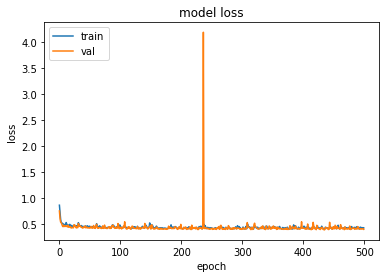

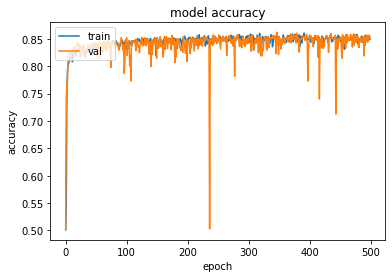

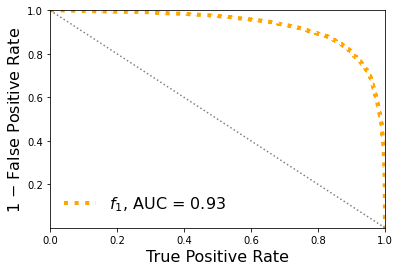

313/313 [==============================] - 3s 9ms/step - loss: 0.4143 - acc: 0.8524 - f1_m: 0.4509 - precision_m: 0.5004 - recall_m: 0.4116
Test ROC-AUC: 0.9306460599999999
Test loss: 0.4142760634422302
Test accuracy: 0.852400004863739
Test f1: 0.4508916139602661
Test precision: 0.5003993511199951
Test recall: 0.41164135932922363
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 360ms/step - loss: 1.4112 - acc: 0.5063 - f1_m: 0.4420 - precision_m: 0.5180 - recall_m: 0.4300 - val_loss: 0.7638 - val_acc: 0.7470 - val_f1_m: 0.7683 - val_precision_m: 0.7004 - val_recall_m: 0.8523
Epoch 2/500
94/94 [==============================] - 33s 355ms/step - loss: 0.7598 - acc: 0.6132 - f1_m: 0.6079 - precision_m: 0.6184 - recall_m: 0.6073 - val_loss: 0.6657 - val_acc: 0.7560 - val_f1_m: 0.7767 - val_precision_m: 0.70

Epoch 31/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4624 - acc: 0.8363 - f1_m: 0.8407 - precision_m: 0.8150 - recall_m: 0.8709 - val_loss: 0.4376 - val_acc: 0.8412 - val_f1_m: 0.8389 - val_precision_m: 0.8369 - val_recall_m: 0.8424
Epoch 32/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4546 - acc: 0.8397 - f1_m: 0.8437 - precision_m: 0.8177 - recall_m: 0.8750 - val_loss: 0.4456 - val_acc: 0.8375 - val_f1_m: 0.8431 - val_precision_m: 0.8037 - val_recall_m: 0.8881
Epoch 33/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4548 - acc: 0.8355 - f1_m: 0.8419 - precision_m: 0.8152 - recall_m: 0.8744 - val_loss: 0.4328 - val_acc: 0.8405 - val_f1_m: 0.8383 - val_precision_m: 0.8365 - val_recall_m: 0.8418
Epoch 34/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4556 - acc: 0.8320 - f1_m: 0.8374 - precision_m: 0.8159 - recall_m: 0.8669 - val_loss: 0.4297 - val_acc: 0.8440 - val_f1_m: 0.8473 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4296 - acc: 0.8563 - f1_m: 0.8599 - precision_m: 0.8390 - recall_m: 0.8867 - val_loss: 0.4566 - val_acc: 0.8305 - val_f1_m: 0.8179 - val_precision_m: 0.8668 - val_recall_m: 0.7759
Epoch 64/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4235 - acc: 0.8497 - f1_m: 0.8526 - precision_m: 0.8369 - recall_m: 0.8729 - val_loss: 0.4215 - val_acc: 0.8457 - val_f1_m: 0.8422 - val_precision_m: 0.8428 - val_recall_m: 0.8433
Epoch 65/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4167 - acc: 0.8566 - f1_m: 0.8589 - precision_m: 0.8405 - recall_m: 0.8805 - val_loss: 0.4208 - val_acc: 0.8423 - val_f1_m: 0.8410 - val_precision_m: 0.8345 - val_recall_m: 0.8491
Epoch 66/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4178 - acc: 0.8561 - f1_m: 0.8600 - precision_m: 0.8413 - recall_m: 0.8828 - val_loss: 0.4280 - val_acc: 0.8397 - val_f1_m: 0.8351 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4220 - acc: 0.8601 - f1_m: 0.8640 - precision_m: 0.8376 - recall_m: 0.8959 - val_loss: 0.4355 - val_acc: 0.8445 - val_f1_m: 0.8433 - val_precision_m: 0.8342 - val_recall_m: 0.8546
Epoch 96/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4236 - acc: 0.8539 - f1_m: 0.8569 - precision_m: 0.8384 - recall_m: 0.8818 - val_loss: 0.4510 - val_acc: 0.8417 - val_f1_m: 0.8411 - val_precision_m: 0.8314 - val_recall_m: 0.8525
Epoch 97/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4458 - acc: 0.8440 - f1_m: 0.8499 - precision_m: 0.8281 - recall_m: 0.8784 - val_loss: 0.4399 - val_acc: 0.8455 - val_f1_m: 0.8433 - val_precision_m: 0.8385 - val_recall_m: 0.8498
Epoch 98/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4346 - acc: 0.8522 - f1_m: 0.8578 - precision_m: 0.8341 - recall_m: 0.8874 - val_loss: 0.4393 - val_acc: 0.8487 - val_f1_m: 0.8522 - val_precisi

94/94 [==============================] - 33s 346ms/step - loss: 0.4355 - acc: 0.8541 - f1_m: 0.8587 - precision_m: 0.8391 - recall_m: 0.8830 - val_loss: 0.4378 - val_acc: 0.8353 - val_f1_m: 0.8318 - val_precision_m: 0.8369 - val_recall_m: 0.8286
Epoch 158/500
94/94 [==============================] - 32s 345ms/step - loss: 0.4285 - acc: 0.8473 - f1_m: 0.8520 - precision_m: 0.8324 - recall_m: 0.8756 - val_loss: 0.4916 - val_acc: 0.8210 - val_f1_m: 0.8048 - val_precision_m: 0.8737 - val_recall_m: 0.7480
Epoch 159/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4544 - acc: 0.8425 - f1_m: 0.8457 - precision_m: 0.8312 - recall_m: 0.8661 - val_loss: 0.4491 - val_acc: 0.8322 - val_f1_m: 0.8256 - val_precision_m: 0.8484 - val_recall_m: 0.8057
Epoch 160/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4399 - acc: 0.8446 - f1_m: 0.8470 - precision_m: 0.8297 - recall_m: 0.8686 - val_loss: 0.4476 - val_acc: 0.8265 - val_f1_m: 0.8145 - val_precision_m: 0.86

94/94 [==============================] - 32s 345ms/step - loss: 0.3952 - acc: 0.8706 - f1_m: 0.8745 - precision_m: 0.8581 - recall_m: 0.8939 - val_loss: 0.4542 - val_acc: 0.8402 - val_f1_m: 0.8340 - val_precision_m: 0.8529 - val_recall_m: 0.8172
Epoch 220/500
94/94 [==============================] - 33s 347ms/step - loss: 0.3922 - acc: 0.8733 - f1_m: 0.8750 - precision_m: 0.8577 - recall_m: 0.8951 - val_loss: 0.4533 - val_acc: 0.8440 - val_f1_m: 0.8468 - val_precision_m: 0.8222 - val_recall_m: 0.8746
Epoch 221/500
94/94 [==============================] - 32s 346ms/step - loss: 0.3904 - acc: 0.8735 - f1_m: 0.8746 - precision_m: 0.8565 - recall_m: 0.8958 - val_loss: 0.4494 - val_acc: 0.8412 - val_f1_m: 0.8425 - val_precision_m: 0.8216 - val_recall_m: 0.8658
Epoch 222/500
94/94 [==============================] - 32s 345ms/step - loss: 0.4018 - acc: 0.8706 - f1_m: 0.8724 - precision_m: 0.8550 - recall_m: 0.8926 - val_loss: 0.4589 - val_acc: 0.8372 - val_f1_m: 0.8320 - val_precision_m: 0.84

94/94 [==============================] - 32s 344ms/step - loss: 0.3999 - acc: 0.8710 - f1_m: 0.8723 - precision_m: 0.8596 - recall_m: 0.8885 - val_loss: 0.4982 - val_acc: 0.8223 - val_f1_m: 0.8079 - val_precision_m: 0.8713 - val_recall_m: 0.7544
Epoch 282/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4173 - acc: 0.8713 - f1_m: 0.8717 - precision_m: 0.8673 - recall_m: 0.8809 - val_loss: 0.4518 - val_acc: 0.8393 - val_f1_m: 0.8338 - val_precision_m: 0.8526 - val_recall_m: 0.8170
Epoch 283/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4031 - acc: 0.8723 - f1_m: 0.8733 - precision_m: 0.8603 - recall_m: 0.8910 - val_loss: 0.4431 - val_acc: 0.8485 - val_f1_m: 0.8444 - val_precision_m: 0.8523 - val_recall_m: 0.8380
Epoch 284/500
94/94 [==============================] - 32s 344ms/step - loss: 0.3847 - acc: 0.8838 - f1_m: 0.8860 - precision_m: 0.8765 - recall_m: 0.8985 - val_loss: 0.4381 - val_acc: 0.8478 - val_f1_m: 0.8473 - val_precision_m: 0.83

94/94 [==============================] - 32s 346ms/step - loss: 0.3987 - acc: 0.8700 - f1_m: 0.8700 - precision_m: 0.8659 - recall_m: 0.8772 - val_loss: 0.5148 - val_acc: 0.8242 - val_f1_m: 0.8319 - val_precision_m: 0.7863 - val_recall_m: 0.8850
Epoch 344/500
94/94 [==============================] - 32s 344ms/step - loss: 0.5120 - acc: 0.8410 - f1_m: 0.8437 - precision_m: 0.8302 - recall_m: 0.8619 - val_loss: 0.4814 - val_acc: 0.8380 - val_f1_m: 0.8382 - val_precision_m: 0.8235 - val_recall_m: 0.8557
Epoch 345/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4732 - acc: 0.8441 - f1_m: 0.8455 - precision_m: 0.8389 - recall_m: 0.8559 - val_loss: 0.4756 - val_acc: 0.8412 - val_f1_m: 0.8440 - val_precision_m: 0.8213 - val_recall_m: 0.8696
Epoch 346/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4216 - acc: 0.8669 - f1_m: 0.8694 - precision_m: 0.8583 - recall_m: 0.8833 - val_loss: 0.4604 - val_acc: 0.8343 - val_f1_m: 0.8297 - val_precision_m: 0.84

94/94 [==============================] - 32s 343ms/step - loss: 0.4286 - acc: 0.8582 - f1_m: 0.8580 - precision_m: 0.8574 - recall_m: 0.8608 - val_loss: 0.4555 - val_acc: 0.8392 - val_f1_m: 0.8363 - val_precision_m: 0.8392 - val_recall_m: 0.8352
Epoch 406/500
94/94 [==============================] - 32s 345ms/step - loss: 0.4229 - acc: 0.8620 - f1_m: 0.8585 - precision_m: 0.8678 - recall_m: 0.8551 - val_loss: 0.5075 - val_acc: 0.8365 - val_f1_m: 0.8436 - val_precision_m: 0.7985 - val_recall_m: 0.8960
Epoch 407/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4523 - acc: 0.8609 - f1_m: 0.8618 - precision_m: 0.8667 - recall_m: 0.8605 - val_loss: 0.4666 - val_acc: 0.8452 - val_f1_m: 0.8475 - val_precision_m: 0.8220 - val_recall_m: 0.8765
Epoch 408/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4138 - acc: 0.8694 - f1_m: 0.8710 - precision_m: 0.8683 - recall_m: 0.8765 - val_loss: 0.4586 - val_acc: 0.8403 - val_f1_m: 0.8339 - val_precision_m: 0.85

94/94 [==============================] - 32s 341ms/step - loss: 0.3852 - acc: 0.8810 - f1_m: 0.8808 - precision_m: 0.8813 - recall_m: 0.8825 - val_loss: 0.4739 - val_acc: 0.8448 - val_f1_m: 0.8516 - val_precision_m: 0.8093 - val_recall_m: 0.8997
Epoch 468/500
94/94 [==============================] - 32s 341ms/step - loss: 0.3847 - acc: 0.8830 - f1_m: 0.8829 - precision_m: 0.8808 - recall_m: 0.8869 - val_loss: 0.5555 - val_acc: 0.7762 - val_f1_m: 0.7305 - val_precision_m: 0.9113 - val_recall_m: 0.6113
Epoch 469/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4522 - acc: 0.8582 - f1_m: 0.8551 - precision_m: 0.8725 - recall_m: 0.8446 - val_loss: 0.4676 - val_acc: 0.8353 - val_f1_m: 0.8289 - val_precision_m: 0.8497 - val_recall_m: 0.8105
Epoch 470/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4046 - acc: 0.8765 - f1_m: 0.8728 - precision_m: 0.8785 - recall_m: 0.8697 - val_loss: 0.4562 - val_acc: 0.8352 - val_f1_m: 0.8312 - val_precision_m: 0.84

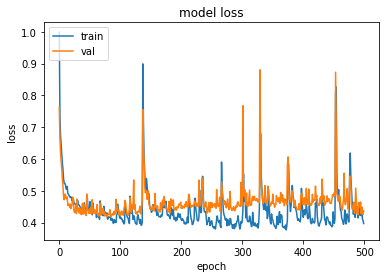

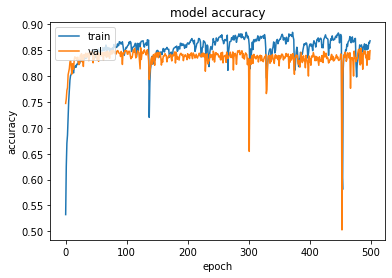

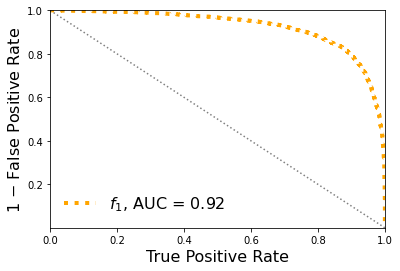

313/313 [==============================] - 3s 9ms/step - loss: 0.4378 - acc: 0.8467 - f1_m: 0.4741 - precision_m: 0.5000 - recall_m: 0.4517
Test ROC-AUC: 0.92331864
Test loss: 0.437777578830719
Test accuracy: 0.8467000126838684
Test f1: 0.47411227226257324
Test precision: 0.5
Test recall: 0.4516773223876953
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 34s 89ms/step - loss: 1.0963 - acc: 0.5752 - f1_m: 0.5300 - precision_m: 0.5721 - recall_m: 0.5219 - val_loss: 0.6115 - val_acc: 0.7445 - val_f1_m: 0.6943 - val_precision_m: 0.8487 - val_recall_m: 0.5933
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6210 - acc: 0.7638 - f1_m: 0.7613 - precision_m: 0.7756 - recall_m: 0.7639 - val_loss: 0.5644 - val_acc: 0.7977 - val_f1_m: 0.8076 - val_precision_m: 0.7578 - val_recall_m: 0.86

Epoch 31/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4844 - acc: 0.8251 - f1_m: 0.8276 - precision_m: 0.8098 - recall_m: 0.8555 - val_loss: 0.4506 - val_acc: 0.8362 - val_f1_m: 0.8397 - val_precision_m: 0.8098 - val_recall_m: 0.8765
Epoch 32/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4925 - acc: 0.8168 - f1_m: 0.8195 - precision_m: 0.8083 - recall_m: 0.8420 - val_loss: 0.4493 - val_acc: 0.8328 - val_f1_m: 0.8346 - val_precision_m: 0.8136 - val_recall_m: 0.8617
Epoch 33/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4850 - acc: 0.8214 - f1_m: 0.8222 - precision_m: 0.8136 - recall_m: 0.8426 - val_loss: 0.4661 - val_acc: 0.8332 - val_f1_m: 0.8422 - val_precision_m: 0.7896 - val_recall_m: 0.9083
Epoch 34/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4826 - acc: 0.8255 - f1_m: 0.8280 - precision_m: 0.8149 - recall_m: 0.8504 - val_loss: 0.6337 - val_acc: 0.7185 - val_f1_m: 0.6168 - val_pre

375/375 [==============================] - 33s 87ms/step - loss: 0.4676 - acc: 0.8302 - f1_m: 0.8316 - precision_m: 0.8146 - recall_m: 0.8573 - val_loss: 0.4308 - val_acc: 0.8267 - val_f1_m: 0.8120 - val_precision_m: 0.8749 - val_recall_m: 0.7628
Epoch 94/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4556 - acc: 0.8306 - f1_m: 0.8337 - precision_m: 0.8203 - recall_m: 0.8579 - val_loss: 0.4416 - val_acc: 0.8447 - val_f1_m: 0.8531 - val_precision_m: 0.7989 - val_recall_m: 0.9198
Epoch 95/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4740 - acc: 0.8287 - f1_m: 0.8304 - precision_m: 0.8114 - recall_m: 0.8621 - val_loss: 0.4318 - val_acc: 0.8448 - val_f1_m: 0.8424 - val_precision_m: 0.8444 - val_recall_m: 0.8454
Epoch 96/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4737 - acc: 0.8290 - f1_m: 0.8285 - precision_m: 0.8232 - recall_m: 0.8461 - val_loss: 0.4302 - val_acc: 0.8435 - val_f1_m: 0.8405 - val_precision_m: 0.8

375/375 [==============================] - 32s 87ms/step - loss: 0.4656 - acc: 0.8279 - f1_m: 0.8287 - precision_m: 0.8147 - recall_m: 0.8522 - val_loss: 0.4272 - val_acc: 0.8512 - val_f1_m: 0.8535 - val_precision_m: 0.8267 - val_recall_m: 0.8864
Epoch 156/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4544 - acc: 0.8383 - f1_m: 0.8396 - precision_m: 0.8248 - recall_m: 0.8627 - val_loss: 0.4280 - val_acc: 0.8462 - val_f1_m: 0.8431 - val_precision_m: 0.8493 - val_recall_m: 0.8417
Epoch 157/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4976 - acc: 0.8140 - f1_m: 0.8147 - precision_m: 0.8108 - recall_m: 0.8363 - val_loss: 0.4238 - val_acc: 0.8468 - val_f1_m: 0.8481 - val_precision_m: 0.8299 - val_recall_m: 0.8717
Epoch 158/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4574 - acc: 0.8358 - f1_m: 0.8373 - precision_m: 0.8203 - recall_m: 0.8643 - val_loss: 0.4646 - val_acc: 0.8175 - val_f1_m: 0.7963 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4628 - acc: 0.8342 - f1_m: 0.8357 - precision_m: 0.8285 - recall_m: 0.8532 - val_loss: 0.4858 - val_acc: 0.8348 - val_f1_m: 0.8433 - val_precision_m: 0.7916 - val_recall_m: 0.9072
Epoch 218/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4884 - acc: 0.8296 - f1_m: 0.8330 - precision_m: 0.8093 - recall_m: 0.8674 - val_loss: 0.4299 - val_acc: 0.8480 - val_f1_m: 0.8561 - val_precision_m: 0.8043 - val_recall_m: 0.9202
Epoch 219/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4530 - acc: 0.8343 - f1_m: 0.8371 - precision_m: 0.8228 - recall_m: 0.8620 - val_loss: 0.4535 - val_acc: 0.8343 - val_f1_m: 0.8412 - val_precision_m: 0.7958 - val_recall_m: 0.8966
Epoch 220/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4518 - acc: 0.8390 - f1_m: 0.8409 - precision_m: 0.8291 - recall_m: 0.8620 - val_loss: 0.4118 - val_acc: 0.8565 - val_f1_m: 0.8586 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4662 - acc: 0.8323 - f1_m: 0.8319 - precision_m: 0.8191 - recall_m: 0.8578 - val_loss: 0.4437 - val_acc: 0.8478 - val_f1_m: 0.8514 - val_precision_m: 0.8211 - val_recall_m: 0.8888
Epoch 280/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4549 - acc: 0.8378 - f1_m: 0.8378 - precision_m: 0.8224 - recall_m: 0.8619 - val_loss: 0.4678 - val_acc: 0.8383 - val_f1_m: 0.8313 - val_precision_m: 0.8549 - val_recall_m: 0.8136
Epoch 281/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4811 - acc: 0.8220 - f1_m: 0.8208 - precision_m: 0.8138 - recall_m: 0.8422 - val_loss: 0.4231 - val_acc: 0.8460 - val_f1_m: 0.8441 - val_precision_m: 0.8413 - val_recall_m: 0.8509
Epoch 282/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4548 - acc: 0.8342 - f1_m: 0.8364 - precision_m: 0.8202 - recall_m: 0.8613 - val_loss: 0.4229 - val_acc: 0.8437 - val_f1_m: 0.8437 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4690 - acc: 0.8294 - f1_m: 0.8317 - precision_m: 0.8171 - recall_m: 0.8594 - val_loss: 0.4291 - val_acc: 0.8450 - val_f1_m: 0.8520 - val_precision_m: 0.8051 - val_recall_m: 0.9096
Epoch 342/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4576 - acc: 0.8322 - f1_m: 0.8352 - precision_m: 0.8220 - recall_m: 0.8606 - val_loss: 0.4197 - val_acc: 0.8475 - val_f1_m: 0.8518 - val_precision_m: 0.8168 - val_recall_m: 0.8941
Epoch 343/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4467 - acc: 0.8381 - f1_m: 0.8389 - precision_m: 0.8190 - recall_m: 0.8668 - val_loss: 0.4196 - val_acc: 0.8435 - val_f1_m: 0.8470 - val_precision_m: 0.8154 - val_recall_m: 0.8852
Epoch 344/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4683 - acc: 0.8323 - f1_m: 0.8331 - precision_m: 0.8201 - recall_m: 0.8567 - val_loss: 0.4230 - val_acc: 0.8482 - val_f1_m: 0.8519 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4814 - acc: 0.8247 - f1_m: 0.8232 - precision_m: 0.8138 - recall_m: 0.8500 - val_loss: 0.4195 - val_acc: 0.8505 - val_f1_m: 0.8564 - val_precision_m: 0.8105 - val_recall_m: 0.9123
Epoch 404/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4578 - acc: 0.8364 - f1_m: 0.8384 - precision_m: 0.8191 - recall_m: 0.8690 - val_loss: 0.4432 - val_acc: 0.8452 - val_f1_m: 0.8464 - val_precision_m: 0.8275 - val_recall_m: 0.8702
Epoch 405/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4813 - acc: 0.8260 - f1_m: 0.8276 - precision_m: 0.8134 - recall_m: 0.8546 - val_loss: 0.4379 - val_acc: 0.8358 - val_f1_m: 0.8262 - val_precision_m: 0.8669 - val_recall_m: 0.7944
Epoch 406/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4578 - acc: 0.8360 - f1_m: 0.8384 - precision_m: 0.8204 - recall_m: 0.8655 - val_loss: 0.4320 - val_acc: 0.8397 - val_f1_m: 0.8527 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4468 - acc: 0.8363 - f1_m: 0.8373 - precision_m: 0.8262 - recall_m: 0.8575 - val_loss: 0.4173 - val_acc: 0.8545 - val_f1_m: 0.8572 - val_precision_m: 0.8304 - val_recall_m: 0.8905
Epoch 466/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4708 - acc: 0.8280 - f1_m: 0.8262 - precision_m: 0.8169 - recall_m: 0.8480 - val_loss: 0.4145 - val_acc: 0.8540 - val_f1_m: 0.8541 - val_precision_m: 0.8415 - val_recall_m: 0.8713
Epoch 467/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4613 - acc: 0.8356 - f1_m: 0.8362 - precision_m: 0.8266 - recall_m: 0.8571 - val_loss: 0.4817 - val_acc: 0.8218 - val_f1_m: 0.8413 - val_precision_m: 0.7481 - val_recall_m: 0.9662
Epoch 468/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4703 - acc: 0.8303 - f1_m: 0.8333 - precision_m: 0.8212 - recall_m: 0.8596 - val_loss: 0.4422 - val_acc: 0.8410 - val_f1_m: 0.8536 - val_precision_m: 

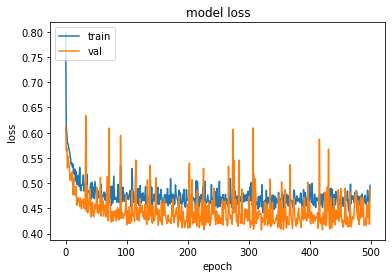

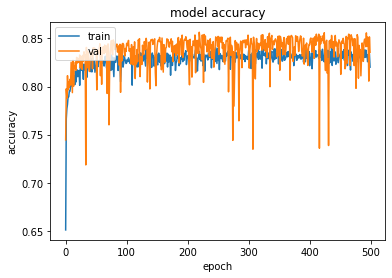

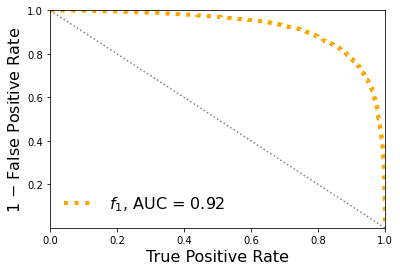

313/313 [==============================] - 3s 9ms/step - loss: 0.4972 - acc: 0.8224 - f1_m: 0.4841 - precision_m: 0.4998 - recall_m: 0.4704
Test ROC-AUC: 0.9228239399999998
Test loss: 0.4972209334373474
Test accuracy: 0.8223999738693237
Test f1: 0.4841389060020447
Test precision: 0.49980032444000244
Test recall: 0.47044727206230164
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 176ms/step - loss: 1.4036 - acc: 0.5911 - f1_m: 0.5902 - precision_m: 0.5869 - recall_m: 0.6214 - val_loss: 0.5910 - val_acc: 0.7707 - val_f1_m: 0.7786 - val_precision_m: 0.7463 - val_recall_m: 0.8165
Epoch 2/500
188/188 [==============================] - 32s 171ms/step - loss: 0.6219 - acc: 0.7537 - f1_m: 0.7642 - precision_m: 0.7300 - recall_m: 0.8085 - val_loss: 0.5724 - val_acc: 0.7647 - val_f1_m: 0.7979 - val_precision_m:

188/188 [==============================] - 32s 170ms/step - loss: 0.4683 - acc: 0.8319 - f1_m: 0.8298 - precision_m: 0.8226 - recall_m: 0.8451 - val_loss: 0.4396 - val_acc: 0.8415 - val_f1_m: 0.8508 - val_precision_m: 0.7958 - val_recall_m: 0.9161
Epoch 62/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4585 - acc: 0.8386 - f1_m: 0.8407 - precision_m: 0.8264 - recall_m: 0.8643 - val_loss: 0.4563 - val_acc: 0.8357 - val_f1_m: 0.8487 - val_precision_m: 0.7798 - val_recall_m: 0.9340
Epoch 63/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4448 - acc: 0.8409 - f1_m: 0.8439 - precision_m: 0.8267 - recall_m: 0.8673 - val_loss: 0.4451 - val_acc: 0.8362 - val_f1_m: 0.8282 - val_precision_m: 0.8604 - val_recall_m: 0.8010
Epoch 64/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4630 - acc: 0.8361 - f1_m: 0.8381 - precision_m: 0.8290 - recall_m: 0.8549 - val_loss: 0.4320 - val_acc: 0.8467 - val_f1_m: 0.8522 - val_precision_m:

188/188 [==============================] - 33s 177ms/step - loss: 0.4485 - acc: 0.8426 - f1_m: 0.8439 - precision_m: 0.8365 - recall_m: 0.8600 - val_loss: 0.4202 - val_acc: 0.8465 - val_f1_m: 0.8438 - val_precision_m: 0.8500 - val_recall_m: 0.8402
Epoch 124/500
188/188 [==============================] - 34s 178ms/step - loss: 0.4168 - acc: 0.8513 - f1_m: 0.8523 - precision_m: 0.8421 - recall_m: 0.8664 - val_loss: 0.4118 - val_acc: 0.8432 - val_f1_m: 0.8406 - val_precision_m: 0.8467 - val_recall_m: 0.8375
Epoch 125/500
188/188 [==============================] - 33s 178ms/step - loss: 0.4188 - acc: 0.8494 - f1_m: 0.8527 - precision_m: 0.8321 - recall_m: 0.8786 - val_loss: 0.4641 - val_acc: 0.8030 - val_f1_m: 0.7744 - val_precision_m: 0.8985 - val_recall_m: 0.6841
Epoch 126/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4779 - acc: 0.8233 - f1_m: 0.8273 - precision_m: 0.8171 - recall_m: 0.8508 - val_loss: 0.4332 - val_acc: 0.8370 - val_f1_m: 0.8276 - val_precision

188/188 [==============================] - 33s 178ms/step - loss: 0.4150 - acc: 0.8531 - f1_m: 0.8544 - precision_m: 0.8366 - recall_m: 0.8769 - val_loss: 0.4159 - val_acc: 0.8455 - val_f1_m: 0.8408 - val_precision_m: 0.8589 - val_recall_m: 0.8260
Epoch 186/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4335 - acc: 0.8446 - f1_m: 0.8468 - precision_m: 0.8300 - recall_m: 0.8705 - val_loss: 0.4287 - val_acc: 0.8520 - val_f1_m: 0.8592 - val_precision_m: 0.8138 - val_recall_m: 0.9124
Epoch 187/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4311 - acc: 0.8442 - f1_m: 0.8459 - precision_m: 0.8248 - recall_m: 0.8731 - val_loss: 0.4101 - val_acc: 0.8490 - val_f1_m: 0.8475 - val_precision_m: 0.8488 - val_recall_m: 0.8491
Epoch 188/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4223 - acc: 0.8492 - f1_m: 0.8517 - precision_m: 0.8370 - recall_m: 0.8715 - val_loss: 0.6535 - val_acc: 0.7805 - val_f1_m: 0.7358 - val_precision

188/188 [==============================] - 33s 177ms/step - loss: 0.4312 - acc: 0.8461 - f1_m: 0.8479 - precision_m: 0.8312 - recall_m: 0.8726 - val_loss: 0.4338 - val_acc: 0.8415 - val_f1_m: 0.8320 - val_precision_m: 0.8779 - val_recall_m: 0.7932
Epoch 248/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4667 - acc: 0.8285 - f1_m: 0.8288 - precision_m: 0.8191 - recall_m: 0.8491 - val_loss: 0.4435 - val_acc: 0.8353 - val_f1_m: 0.8482 - val_precision_m: 0.7805 - val_recall_m: 0.9316
Epoch 249/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4347 - acc: 0.8425 - f1_m: 0.8461 - precision_m: 0.8293 - recall_m: 0.8702 - val_loss: 0.4126 - val_acc: 0.8483 - val_f1_m: 0.8508 - val_precision_m: 0.8321 - val_recall_m: 0.8736
Epoch 250/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4219 - acc: 0.8511 - f1_m: 0.8530 - precision_m: 0.8310 - recall_m: 0.8809 - val_loss: 0.4160 - val_acc: 0.8468 - val_f1_m: 0.8545 - val_precision

188/188 [==============================] - 33s 177ms/step - loss: 0.4302 - acc: 0.8462 - f1_m: 0.8465 - precision_m: 0.8371 - recall_m: 0.8640 - val_loss: 0.4111 - val_acc: 0.8557 - val_f1_m: 0.8545 - val_precision_m: 0.8552 - val_recall_m: 0.8570
Epoch 310/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4132 - acc: 0.8522 - f1_m: 0.8567 - precision_m: 0.8380 - recall_m: 0.8805 - val_loss: 0.4099 - val_acc: 0.8493 - val_f1_m: 0.8459 - val_precision_m: 0.8582 - val_recall_m: 0.8373
Epoch 311/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4300 - acc: 0.8441 - f1_m: 0.8459 - precision_m: 0.8296 - recall_m: 0.8686 - val_loss: 0.4946 - val_acc: 0.8252 - val_f1_m: 0.8447 - val_precision_m: 0.7545 - val_recall_m: 0.9621
Epoch 312/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4312 - acc: 0.8480 - f1_m: 0.8478 - precision_m: 0.8394 - recall_m: 0.8630 - val_loss: 0.4087 - val_acc: 0.8495 - val_f1_m: 0.8472 - val_precision

188/188 [==============================] - 33s 174ms/step - loss: 0.4170 - acc: 0.8465 - f1_m: 0.8504 - precision_m: 0.8323 - recall_m: 0.8743 - val_loss: 0.4101 - val_acc: 0.8522 - val_f1_m: 0.8543 - val_precision_m: 0.8363 - val_recall_m: 0.8759
Epoch 372/500
188/188 [==============================] - 33s 175ms/step - loss: 0.4364 - acc: 0.8437 - f1_m: 0.8479 - precision_m: 0.8307 - recall_m: 0.8729 - val_loss: 0.5343 - val_acc: 0.7978 - val_f1_m: 0.7625 - val_precision_m: 0.9116 - val_recall_m: 0.6584
Epoch 373/500
188/188 [==============================] - 33s 175ms/step - loss: 0.4860 - acc: 0.8278 - f1_m: 0.8276 - precision_m: 0.8228 - recall_m: 0.8477 - val_loss: 0.4539 - val_acc: 0.8480 - val_f1_m: 0.8544 - val_precision_m: 0.8149 - val_recall_m: 0.9008
Epoch 374/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4334 - acc: 0.8520 - f1_m: 0.8536 - precision_m: 0.8407 - recall_m: 0.8710 - val_loss: 0.4236 - val_acc: 0.8443 - val_f1_m: 0.8562 - val_precision

188/188 [==============================] - 32s 172ms/step - loss: 0.4399 - acc: 0.8459 - f1_m: 0.8494 - precision_m: 0.8357 - recall_m: 0.8683 - val_loss: 0.4194 - val_acc: 0.8482 - val_f1_m: 0.8436 - val_precision_m: 0.8616 - val_recall_m: 0.8291
Epoch 434/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4155 - acc: 0.8521 - f1_m: 0.8541 - precision_m: 0.8464 - recall_m: 0.8684 - val_loss: 0.4715 - val_acc: 0.8305 - val_f1_m: 0.8158 - val_precision_m: 0.8850 - val_recall_m: 0.7589
Epoch 435/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4515 - acc: 0.8409 - f1_m: 0.8421 - precision_m: 0.8274 - recall_m: 0.8642 - val_loss: 0.4132 - val_acc: 0.8492 - val_f1_m: 0.8444 - val_precision_m: 0.8635 - val_recall_m: 0.8289
Epoch 436/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4127 - acc: 0.8569 - f1_m: 0.8596 - precision_m: 0.8397 - recall_m: 0.8853 - val_loss: 0.4449 - val_acc: 0.8480 - val_f1_m: 0.8488 - val_precision

188/188 [==============================] - 32s 171ms/step - loss: 0.4289 - acc: 0.8478 - f1_m: 0.8512 - precision_m: 0.8391 - recall_m: 0.8693 - val_loss: 0.4135 - val_acc: 0.8520 - val_f1_m: 0.8499 - val_precision_m: 0.8544 - val_recall_m: 0.8485
Epoch 496/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4304 - acc: 0.8478 - f1_m: 0.8495 - precision_m: 0.8357 - recall_m: 0.8699 - val_loss: 0.4733 - val_acc: 0.8292 - val_f1_m: 0.8451 - val_precision_m: 0.7669 - val_recall_m: 0.9438
Epoch 497/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4460 - acc: 0.8414 - f1_m: 0.8438 - precision_m: 0.8297 - recall_m: 0.8653 - val_loss: 0.4129 - val_acc: 0.8465 - val_f1_m: 0.8412 - val_precision_m: 0.8632 - val_recall_m: 0.8233
Epoch 498/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4120 - acc: 0.8540 - f1_m: 0.8560 - precision_m: 0.8408 - recall_m: 0.8754 - val_loss: 0.4001 - val_acc: 0.8537 - val_f1_m: 0.8532 - val_precision

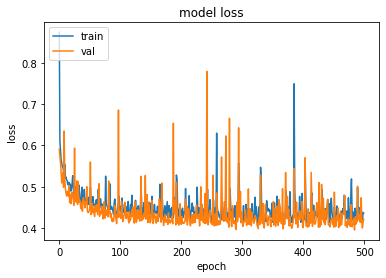

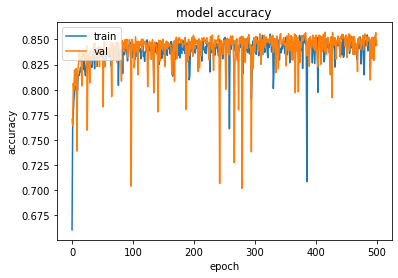

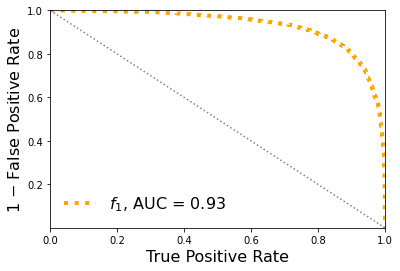

313/313 [==============================] - 3s 9ms/step - loss: 0.4263 - acc: 0.8487 - f1_m: 0.4475 - precision_m: 0.5006 - recall_m: 0.4060
Test ROC-AUC: 0.9299162400000001
Test loss: 0.42630186676979065
Test accuracy: 0.8486999869346619
Test f1: 0.4475019574165344
Test precision: 0.5006389617919922
Test recall: 0.40595048666000366
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.001
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 359ms/step - loss: 2.0373 - acc: 0.5570 - f1_m: 0.5543 - precision_m: 0.5668 - recall_m: 0.5717 - val_loss: 0.6415 - val_acc: 0.7523 - val_f1_m: 0.7721 - val_precision_m: 0.7073 - val_recall_m: 0.8516
Epoch 2/500
94/94 [==============================] - 33s 353ms/step - loss: 0.6521 - acc: 0.7437 - f1_m: 0.7548 - precision_m: 0.7249 - recall_m: 0.7948 - val_loss: 0.5600 - val_acc: 0.7855 - val_f1_m: 0.7910 - val_precision_m: 0.7

Epoch 31/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4582 - acc: 0.8502 - f1_m: 0.8521 - precision_m: 0.8326 - recall_m: 0.8765 - val_loss: 0.4485 - val_acc: 0.8455 - val_f1_m: 0.8453 - val_precision_m: 0.8351 - val_recall_m: 0.8575
Epoch 32/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4617 - acc: 0.8463 - f1_m: 0.8474 - precision_m: 0.8377 - recall_m: 0.8638 - val_loss: 0.4696 - val_acc: 0.8403 - val_f1_m: 0.8517 - val_precision_m: 0.7847 - val_recall_m: 0.9330
Epoch 33/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4620 - acc: 0.8469 - f1_m: 0.8489 - precision_m: 0.8356 - recall_m: 0.8671 - val_loss: 0.4686 - val_acc: 0.8315 - val_f1_m: 0.8225 - val_precision_m: 0.8564 - val_recall_m: 0.7926
Epoch 34/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4791 - acc: 0.8394 - f1_m: 0.8399 - precision_m: 0.8376 - recall_m: 0.8512 - val_loss: 0.4638 - val_acc: 0.8422 - val_f1_m: 0.8456 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4411 - acc: 0.8510 - f1_m: 0.8534 - precision_m: 0.8425 - recall_m: 0.8682 - val_loss: 0.4328 - val_acc: 0.8483 - val_f1_m: 0.8519 - val_precision_m: 0.8199 - val_recall_m: 0.8878
Epoch 64/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4336 - acc: 0.8546 - f1_m: 0.8565 - precision_m: 0.8412 - recall_m: 0.8776 - val_loss: 0.4438 - val_acc: 0.8502 - val_f1_m: 0.8554 - val_precision_m: 0.8140 - val_recall_m: 0.9024
Epoch 65/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4397 - acc: 0.8537 - f1_m: 0.8576 - precision_m: 0.8415 - recall_m: 0.8787 - val_loss: 0.4557 - val_acc: 0.8307 - val_f1_m: 0.8183 - val_precision_m: 0.8713 - val_recall_m: 0.7731
Epoch 66/500
94/94 [==============================] - 33s 351ms/step - loss: 0.5173 - acc: 0.8173 - f1_m: 0.8152 - precision_m: 0.8187 - recall_m: 0.8341 - val_loss: 0.5023 - val_acc: 0.8380 - val_f1_m: 0.8392 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4344 - acc: 0.8463 - f1_m: 0.8492 - precision_m: 0.8384 - recall_m: 0.8656 - val_loss: 0.4945 - val_acc: 0.8013 - val_f1_m: 0.7717 - val_precision_m: 0.9002 - val_recall_m: 0.6778
Epoch 96/500
94/94 [==============================] - 33s 348ms/step - loss: 0.5034 - acc: 0.8194 - f1_m: 0.8117 - precision_m: 0.8241 - recall_m: 0.8201 - val_loss: 0.9007 - val_acc: 0.6643 - val_f1_m: 0.7436 - val_precision_m: 0.5974 - val_recall_m: 0.9863
Epoch 97/500
94/94 [==============================] - 33s 347ms/step - loss: 1.2669 - acc: 0.5498 - f1_m: 0.5211 - precision_m: 0.5758 - recall_m: 0.5301 - val_loss: 0.8974 - val_acc: 0.7703 - val_f1_m: 0.7906 - val_precision_m: 0.7168 - val_recall_m: 0.8836
Epoch 98/500
94/94 [==============================] - 33s 346ms/step - loss: 1.0199 - acc: 0.5817 - f1_m: 0.5189 - precision_m: 0.6098 - recall_m: 0.5037 - val_loss: 0.7599 - val_acc: 0.6445 - val_f1_m: 0.4679 - val_precisi

94/94 [==============================] - 32s 346ms/step - loss: 0.4330 - acc: 0.8443 - f1_m: 0.8452 - precision_m: 0.8379 - recall_m: 0.8570 - val_loss: 0.4211 - val_acc: 0.8422 - val_f1_m: 0.8344 - val_precision_m: 0.8652 - val_recall_m: 0.8070
Epoch 158/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4160 - acc: 0.8523 - f1_m: 0.8550 - precision_m: 0.8431 - recall_m: 0.8711 - val_loss: 0.4359 - val_acc: 0.8313 - val_f1_m: 0.8181 - val_precision_m: 0.8814 - val_recall_m: 0.7649
Epoch 159/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4299 - acc: 0.8479 - f1_m: 0.8490 - precision_m: 0.8396 - recall_m: 0.8637 - val_loss: 0.4226 - val_acc: 0.8437 - val_f1_m: 0.8407 - val_precision_m: 0.8443 - val_recall_m: 0.8383
Epoch 160/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4317 - acc: 0.8465 - f1_m: 0.8458 - precision_m: 0.8412 - recall_m: 0.8550 - val_loss: 0.4278 - val_acc: 0.8445 - val_f1_m: 0.8439 - val_precision_m: 0.83

94/94 [==============================] - 32s 346ms/step - loss: 0.5158 - acc: 0.8135 - f1_m: 0.8180 - precision_m: 0.8064 - recall_m: 0.8430 - val_loss: 0.4410 - val_acc: 0.8438 - val_f1_m: 0.8409 - val_precision_m: 0.8482 - val_recall_m: 0.8351
Epoch 220/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4275 - acc: 0.8561 - f1_m: 0.8584 - precision_m: 0.8471 - recall_m: 0.8729 - val_loss: 0.4145 - val_acc: 0.8455 - val_f1_m: 0.8397 - val_precision_m: 0.8575 - val_recall_m: 0.8242
Epoch 221/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4118 - acc: 0.8588 - f1_m: 0.8622 - precision_m: 0.8475 - recall_m: 0.8796 - val_loss: 0.4587 - val_acc: 0.8088 - val_f1_m: 0.7810 - val_precision_m: 0.9047 - val_recall_m: 0.6884
Epoch 222/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4267 - acc: 0.8503 - f1_m: 0.8529 - precision_m: 0.8464 - recall_m: 0.8654 - val_loss: 0.4199 - val_acc: 0.8407 - val_f1_m: 0.8306 - val_precision_m: 0.87

94/94 [==============================] - 33s 348ms/step - loss: 0.4324 - acc: 0.8418 - f1_m: 0.8430 - precision_m: 0.8429 - recall_m: 0.8537 - val_loss: 0.4609 - val_acc: 0.8117 - val_f1_m: 0.7860 - val_precision_m: 0.8947 - val_recall_m: 0.7024
Epoch 282/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4115 - acc: 0.8571 - f1_m: 0.8548 - precision_m: 0.8591 - recall_m: 0.8565 - val_loss: 0.4099 - val_acc: 0.8505 - val_f1_m: 0.8519 - val_precision_m: 0.8346 - val_recall_m: 0.8715
Epoch 283/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4058 - acc: 0.8558 - f1_m: 0.8589 - precision_m: 0.8447 - recall_m: 0.8778 - val_loss: 0.4108 - val_acc: 0.8463 - val_f1_m: 0.8437 - val_precision_m: 0.8462 - val_recall_m: 0.8425
Epoch 284/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4106 - acc: 0.8553 - f1_m: 0.8547 - precision_m: 0.8477 - recall_m: 0.8670 - val_loss: 0.4826 - val_acc: 0.7880 - val_f1_m: 0.7473 - val_precision_m: 0.90

94/94 [==============================] - 32s 340ms/step - loss: 0.7571 - acc: 0.7183 - f1_m: 0.7162 - precision_m: 0.7263 - recall_m: 0.7502 - val_loss: 0.4869 - val_acc: 0.8390 - val_f1_m: 0.8496 - val_precision_m: 0.7902 - val_recall_m: 0.9201
Epoch 344/500
94/94 [==============================] - 32s 342ms/step - loss: 0.5061 - acc: 0.8181 - f1_m: 0.8245 - precision_m: 0.7966 - recall_m: 0.8621 - val_loss: 0.4365 - val_acc: 0.8473 - val_f1_m: 0.8551 - val_precision_m: 0.8042 - val_recall_m: 0.9148
Epoch 345/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4431 - acc: 0.8367 - f1_m: 0.8409 - precision_m: 0.8192 - recall_m: 0.8683 - val_loss: 0.4204 - val_acc: 0.8503 - val_f1_m: 0.8504 - val_precision_m: 0.8384 - val_recall_m: 0.8640
Epoch 346/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4535 - acc: 0.8361 - f1_m: 0.8393 - precision_m: 0.8238 - recall_m: 0.8622 - val_loss: 0.4134 - val_acc: 0.8510 - val_f1_m: 0.8575 - val_precision_m: 0.81

94/94 [==============================] - 32s 343ms/step - loss: 0.4151 - acc: 0.8548 - f1_m: 0.8550 - precision_m: 0.8527 - recall_m: 0.8604 - val_loss: 0.8558 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 406/500
94/94 [==============================] - 32s 341ms/step - loss: 0.7736 - acc: 0.6931 - f1_m: 0.6398 - precision_m: 0.7496 - recall_m: 0.6438 - val_loss: 0.5550 - val_acc: 0.8263 - val_f1_m: 0.8210 - val_precision_m: 0.8413 - val_recall_m: 0.8036
Epoch 407/500
94/94 [==============================] - 32s 342ms/step - loss: 0.5490 - acc: 0.8055 - f1_m: 0.8018 - precision_m: 0.8086 - recall_m: 0.8085 - val_loss: 0.4619 - val_acc: 0.8408 - val_f1_m: 0.8481 - val_precision_m: 0.8018 - val_recall_m: 0.9019
Epoch 408/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4709 - acc: 0.8276 - f1_m: 0.8334 - precision_m: 0.8071 - recall_m: 0.8667 - val_loss: 0.4252 - val_acc: 0.8372 - val_f1_m: 0.8266 - val_preci

94/94 [==============================] - 32s 342ms/step - loss: 0.3805 - acc: 0.8639 - f1_m: 0.8650 - precision_m: 0.8563 - recall_m: 0.8753 - val_loss: 0.4023 - val_acc: 0.8547 - val_f1_m: 0.8566 - val_precision_m: 0.8371 - val_recall_m: 0.8784
Epoch 468/500
94/94 [==============================] - 32s 343ms/step - loss: 0.3957 - acc: 0.8598 - f1_m: 0.8614 - precision_m: 0.8557 - recall_m: 0.8714 - val_loss: 0.4019 - val_acc: 0.8515 - val_f1_m: 0.8503 - val_precision_m: 0.8440 - val_recall_m: 0.8582
Epoch 469/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4100 - acc: 0.8546 - f1_m: 0.8551 - precision_m: 0.8489 - recall_m: 0.8688 - val_loss: 0.6455 - val_acc: 0.7255 - val_f1_m: 0.6337 - val_precision_m: 0.9447 - val_recall_m: 0.4789
Epoch 470/500
94/94 [==============================] - 32s 340ms/step - loss: 0.5567 - acc: 0.7913 - f1_m: 0.7914 - precision_m: 0.7940 - recall_m: 0.8156 - val_loss: 0.4530 - val_acc: 0.8512 - val_f1_m: 0.8529 - val_precision_m: 0.83

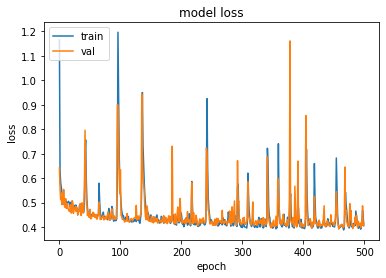

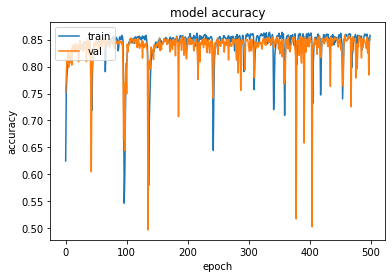

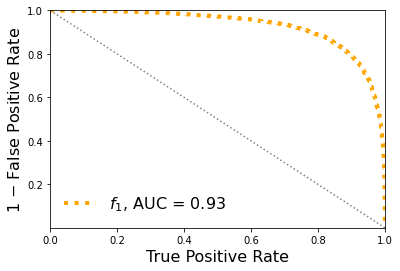

313/313 [==============================] - 3s 9ms/step - loss: 0.4165 - acc: 0.8498 - f1_m: 0.4668 - precision_m: 0.5004 - recall_m: 0.4386
Test ROC-AUC: 0.9271129
Test loss: 0.41646090149879456
Test accuracy: 0.8497999906539917
Test f1: 0.46677571535110474
Test precision: 0.5004356503486633
Test recall: 0.43859824538230896
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 35s 90ms/step - loss: 0.9062 - acc: 0.4971 - f1_m: 0.4901 - precision_m: 0.4907 - recall_m: 0.5557 - val_loss: 0.7234 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.7147 - acc: 0.5199 - f1_m: 0.4563 - precision_m: 0.5115 - recall_m: 0.5357 - val_loss: 0.5964 - val_acc: 0.7458 - val_f1_m: 0.7444 - val_precision_

375/375 [==============================] - 33s 87ms/step - loss: 0.4278 - acc: 0.8419 - f1_m: 0.8435 - precision_m: 0.8264 - recall_m: 0.8678 - val_loss: 0.4616 - val_acc: 0.8293 - val_f1_m: 0.8242 - val_precision_m: 0.8358 - val_recall_m: 0.8177
Epoch 62/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4362 - acc: 0.8391 - f1_m: 0.8410 - precision_m: 0.8231 - recall_m: 0.8672 - val_loss: 0.4664 - val_acc: 0.8355 - val_f1_m: 0.8440 - val_precision_m: 0.7899 - val_recall_m: 0.9117
Epoch 63/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4660 - acc: 0.8326 - f1_m: 0.8340 - precision_m: 0.8174 - recall_m: 0.8618 - val_loss: 0.4387 - val_acc: 0.8495 - val_f1_m: 0.8528 - val_precision_m: 0.8244 - val_recall_m: 0.8882
Epoch 64/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4410 - acc: 0.8408 - f1_m: 0.8434 - precision_m: 0.8224 - recall_m: 0.8720 - val_loss: 0.4346 - val_acc: 0.8427 - val_f1_m: 0.8383 - val_precision_m: 0.8

375/375 [==============================] - 32s 86ms/step - loss: 0.5338 - acc: 0.8264 - f1_m: 0.8306 - precision_m: 0.8118 - recall_m: 0.8634 - val_loss: 0.4592 - val_acc: 0.8425 - val_f1_m: 0.8397 - val_precision_m: 0.8434 - val_recall_m: 0.8412
Epoch 124/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4468 - acc: 0.8464 - f1_m: 0.8481 - precision_m: 0.8318 - recall_m: 0.8723 - val_loss: 0.4340 - val_acc: 0.8445 - val_f1_m: 0.8488 - val_precision_m: 0.8174 - val_recall_m: 0.8877
Epoch 125/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4324 - acc: 0.8491 - f1_m: 0.8521 - precision_m: 0.8348 - recall_m: 0.8763 - val_loss: 0.4445 - val_acc: 0.8503 - val_f1_m: 0.8508 - val_precision_m: 0.8376 - val_recall_m: 0.8699
Epoch 126/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4434 - acc: 0.8454 - f1_m: 0.8482 - precision_m: 0.8325 - recall_m: 0.8712 - val_loss: 0.4205 - val_acc: 0.8492 - val_f1_m: 0.8507 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4675 - acc: 0.8324 - f1_m: 0.8311 - precision_m: 0.8264 - recall_m: 0.8429 - val_loss: 0.4736 - val_acc: 0.8330 - val_f1_m: 0.8240 - val_precision_m: 0.8610 - val_recall_m: 0.7949
Epoch 186/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4815 - acc: 0.8310 - f1_m: 0.8285 - precision_m: 0.8279 - recall_m: 0.8355 - val_loss: 0.4199 - val_acc: 0.8445 - val_f1_m: 0.8410 - val_precision_m: 0.8536 - val_recall_m: 0.8338
Epoch 187/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4628 - acc: 0.8306 - f1_m: 0.8295 - precision_m: 0.8307 - recall_m: 0.8382 - val_loss: 0.4120 - val_acc: 0.8447 - val_f1_m: 0.8441 - val_precision_m: 0.8381 - val_recall_m: 0.8550
Epoch 188/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4412 - acc: 0.8303 - f1_m: 0.8301 - precision_m: 0.8234 - recall_m: 0.8440 - val_loss: 0.4085 - val_acc: 0.8413 - val_f1_m: 0.8435 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4335 - acc: 0.8407 - f1_m: 0.8416 - precision_m: 0.8329 - recall_m: 0.8581 - val_loss: 0.4828 - val_acc: 0.8193 - val_f1_m: 0.7989 - val_precision_m: 0.8898 - val_recall_m: 0.7291
Epoch 248/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4496 - acc: 0.8469 - f1_m: 0.8451 - precision_m: 0.8369 - recall_m: 0.8588 - val_loss: 0.4201 - val_acc: 0.8475 - val_f1_m: 0.8433 - val_precision_m: 0.8557 - val_recall_m: 0.8363
Epoch 249/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4408 - acc: 0.8489 - f1_m: 0.8494 - precision_m: 0.8447 - recall_m: 0.8625 - val_loss: 0.4272 - val_acc: 0.8463 - val_f1_m: 0.8441 - val_precision_m: 0.8458 - val_recall_m: 0.8469
Epoch 250/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4313 - acc: 0.8423 - f1_m: 0.8418 - precision_m: 0.8362 - recall_m: 0.8552 - val_loss: 0.4335 - val_acc: 0.8410 - val_f1_m: 0.8511 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4524 - acc: 0.8275 - f1_m: 0.8255 - precision_m: 0.8184 - recall_m: 0.8396 - val_loss: 0.4483 - val_acc: 0.8320 - val_f1_m: 0.8336 - val_precision_m: 0.8152 - val_recall_m: 0.8577
Epoch 310/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4405 - acc: 0.8340 - f1_m: 0.8316 - precision_m: 0.8283 - recall_m: 0.8397 - val_loss: 0.4508 - val_acc: 0.8312 - val_f1_m: 0.8282 - val_precision_m: 0.8322 - val_recall_m: 0.8289
Epoch 311/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4378 - acc: 0.8356 - f1_m: 0.8327 - precision_m: 0.8311 - recall_m: 0.8400 - val_loss: 0.4402 - val_acc: 0.8257 - val_f1_m: 0.8178 - val_precision_m: 0.8417 - val_recall_m: 0.7999
Epoch 312/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4385 - acc: 0.8331 - f1_m: 0.8338 - precision_m: 0.8301 - recall_m: 0.8430 - val_loss: 0.4391 - val_acc: 0.8297 - val_f1_m: 0.8294 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4374 - acc: 0.8362 - f1_m: 0.8312 - precision_m: 0.8318 - recall_m: 0.8374 - val_loss: 0.4935 - val_acc: 0.8247 - val_f1_m: 0.8184 - val_precision_m: 0.8376 - val_recall_m: 0.8040
Epoch 372/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4742 - acc: 0.8297 - f1_m: 0.8293 - precision_m: 0.8226 - recall_m: 0.8421 - val_loss: 0.4585 - val_acc: 0.8205 - val_f1_m: 0.8105 - val_precision_m: 0.8487 - val_recall_m: 0.7805
Epoch 373/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4619 - acc: 0.8295 - f1_m: 0.8268 - precision_m: 0.8264 - recall_m: 0.8338 - val_loss: 0.4545 - val_acc: 0.8243 - val_f1_m: 0.8211 - val_precision_m: 0.8215 - val_recall_m: 0.8248
Epoch 374/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4366 - acc: 0.8393 - f1_m: 0.8386 - precision_m: 0.8358 - recall_m: 0.8475 - val_loss: 0.4460 - val_acc: 0.8250 - val_f1_m: 0.8190 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4436 - acc: 0.8366 - f1_m: 0.8381 - precision_m: 0.8321 - recall_m: 0.8501 - val_loss: 0.4830 - val_acc: 0.8237 - val_f1_m: 0.8173 - val_precision_m: 0.8385 - val_recall_m: 0.8016
Epoch 434/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4669 - acc: 0.8319 - f1_m: 0.8301 - precision_m: 0.8247 - recall_m: 0.8413 - val_loss: 0.4879 - val_acc: 0.8265 - val_f1_m: 0.8213 - val_precision_m: 0.8353 - val_recall_m: 0.8122
Epoch 435/500
375/375 [==============================] - 32s 86ms/step - loss: 0.5219 - acc: 0.8272 - f1_m: 0.8279 - precision_m: 0.8299 - recall_m: 0.8378 - val_loss: 0.4807 - val_acc: 0.8228 - val_f1_m: 0.8186 - val_precision_m: 0.8287 - val_recall_m: 0.8141
Epoch 436/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4673 - acc: 0.8333 - f1_m: 0.8299 - precision_m: 0.8303 - recall_m: 0.8345 - val_loss: 0.4746 - val_acc: 0.8123 - val_f1_m: 0.8012 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4550 - acc: 0.8403 - f1_m: 0.8385 - precision_m: 0.8339 - recall_m: 0.8492 - val_loss: 0.4530 - val_acc: 0.8310 - val_f1_m: 0.8318 - val_precision_m: 0.8157 - val_recall_m: 0.8528
Epoch 496/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4443 - acc: 0.8341 - f1_m: 0.8328 - precision_m: 0.8250 - recall_m: 0.8472 - val_loss: 0.4691 - val_acc: 0.8182 - val_f1_m: 0.8209 - val_precision_m: 0.7982 - val_recall_m: 0.8505
Epoch 497/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4385 - acc: 0.8341 - f1_m: 0.8344 - precision_m: 0.8273 - recall_m: 0.8472 - val_loss: 0.4418 - val_acc: 0.8338 - val_f1_m: 0.8332 - val_precision_m: 0.8207 - val_recall_m: 0.8505
Epoch 498/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4330 - acc: 0.8419 - f1_m: 0.8415 - precision_m: 0.8312 - recall_m: 0.8579 - val_loss: 0.4458 - val_acc: 0.8265 - val_f1_m: 0.8192 - val_precision_m: 

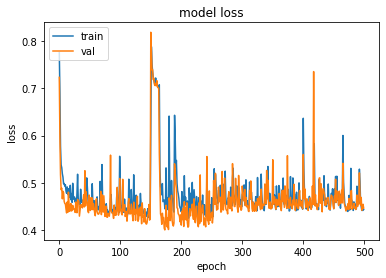

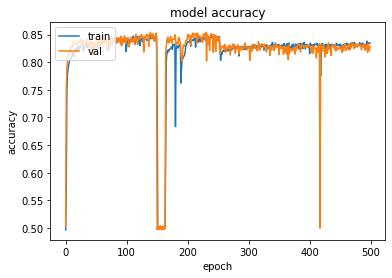

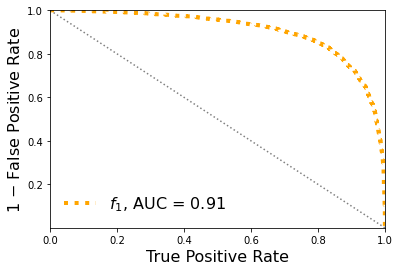

313/313 [==============================] - 3s 9ms/step - loss: 0.4511 - acc: 0.8300 - f1_m: 0.4532 - precision_m: 0.4999 - recall_m: 0.4158
Test ROC-AUC: 0.90544726
Test loss: 0.4511130750179291
Test accuracy: 0.8299999833106995
Test f1: 0.45321235060691833
Test precision: 0.49985477328300476
Test recall: 0.4158346652984619
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 177ms/step - loss: 0.9944 - acc: 0.5056 - f1_m: 0.3132 - precision_m: 0.4853 - recall_m: 0.3302 - val_loss: 0.7442 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
188/188 [==============================] - 31s 167ms/step - loss: 0.7378 - acc: 0.5059 - f1_m: 0.0037 - precision_m: 0.0028 - recall_m: 0.0055 - val_loss: 0.7238 - val_acc: 0.4972 - val_f1_m: 0.6630 - val_precisi

188/188 [==============================] - 32s 168ms/step - loss: 0.4870 - acc: 0.8324 - f1_m: 0.8335 - precision_m: 0.8239 - recall_m: 0.8488 - val_loss: 0.4456 - val_acc: 0.8420 - val_f1_m: 0.8506 - val_precision_m: 0.8010 - val_recall_m: 0.9095
Epoch 62/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5636 - acc: 0.8127 - f1_m: 0.8027 - precision_m: 0.8069 - recall_m: 0.8271 - val_loss: 0.4409 - val_acc: 0.8398 - val_f1_m: 0.8368 - val_precision_m: 0.8451 - val_recall_m: 0.8313
Epoch 63/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4613 - acc: 0.8416 - f1_m: 0.8437 - precision_m: 0.8371 - recall_m: 0.8551 - val_loss: 0.4344 - val_acc: 0.8317 - val_f1_m: 0.8193 - val_precision_m: 0.8743 - val_recall_m: 0.7735
Epoch 64/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4493 - acc: 0.8373 - f1_m: 0.8357 - precision_m: 0.8327 - recall_m: 0.8439 - val_loss: 0.4151 - val_acc: 0.8473 - val_f1_m: 0.8459 - val_precision_m:

188/188 [==============================] - 32s 169ms/step - loss: 0.4073 - acc: 0.8543 - f1_m: 0.8532 - precision_m: 0.8491 - recall_m: 0.8625 - val_loss: 0.4199 - val_acc: 0.8455 - val_f1_m: 0.8427 - val_precision_m: 0.8486 - val_recall_m: 0.8394
Epoch 124/500
188/188 [==============================] - 32s 168ms/step - loss: 0.6593 - acc: 0.7493 - f1_m: 0.7477 - precision_m: 0.7548 - recall_m: 0.7780 - val_loss: 0.5717 - val_acc: 0.7845 - val_f1_m: 0.7678 - val_precision_m: 0.8245 - val_recall_m: 0.7223
Epoch 125/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5521 - acc: 0.7994 - f1_m: 0.8036 - precision_m: 0.7994 - recall_m: 0.8166 - val_loss: 0.4878 - val_acc: 0.8203 - val_f1_m: 0.8150 - val_precision_m: 0.8306 - val_recall_m: 0.8031
Epoch 126/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4814 - acc: 0.8276 - f1_m: 0.8275 - precision_m: 0.8257 - recall_m: 0.8342 - val_loss: 0.4715 - val_acc: 0.8273 - val_f1_m: 0.8269 - val_precision

188/188 [==============================] - 31s 168ms/step - loss: 0.4327 - acc: 0.8611 - f1_m: 0.8624 - precision_m: 0.8584 - recall_m: 0.8696 - val_loss: 0.4683 - val_acc: 0.8315 - val_f1_m: 0.8388 - val_precision_m: 0.8007 - val_recall_m: 0.8839
Epoch 186/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4501 - acc: 0.8547 - f1_m: 0.8534 - precision_m: 0.8480 - recall_m: 0.8642 - val_loss: 0.5034 - val_acc: 0.8333 - val_f1_m: 0.8319 - val_precision_m: 0.8331 - val_recall_m: 0.8339
Epoch 187/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4423 - acc: 0.8640 - f1_m: 0.8624 - precision_m: 0.8608 - recall_m: 0.8674 - val_loss: 0.4753 - val_acc: 0.8365 - val_f1_m: 0.8379 - val_precision_m: 0.8239 - val_recall_m: 0.8562
Epoch 188/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4349 - acc: 0.8566 - f1_m: 0.8551 - precision_m: 0.8562 - recall_m: 0.8578 - val_loss: 0.4739 - val_acc: 0.8258 - val_f1_m: 0.8255 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4210 - acc: 0.8626 - f1_m: 0.8603 - precision_m: 0.8658 - recall_m: 0.8583 - val_loss: 0.4712 - val_acc: 0.8367 - val_f1_m: 0.8404 - val_precision_m: 0.8161 - val_recall_m: 0.8696
Epoch 248/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4265 - acc: 0.8616 - f1_m: 0.8602 - precision_m: 0.8651 - recall_m: 0.8600 - val_loss: 0.4715 - val_acc: 0.8223 - val_f1_m: 0.8103 - val_precision_m: 0.8616 - val_recall_m: 0.7681
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4192 - acc: 0.8618 - f1_m: 0.8588 - precision_m: 0.8678 - recall_m: 0.8537 - val_loss: 0.5449 - val_acc: 0.8152 - val_f1_m: 0.7997 - val_precision_m: 0.8667 - val_recall_m: 0.7447
Epoch 250/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4711 - acc: 0.8581 - f1_m: 0.8566 - precision_m: 0.8643 - recall_m: 0.8522 - val_loss: 0.4786 - val_acc: 0.8327 - val_f1_m: 0.8302 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4247 - acc: 0.8778 - f1_m: 0.8762 - precision_m: 0.8851 - recall_m: 0.8705 - val_loss: 0.5212 - val_acc: 0.8295 - val_f1_m: 0.8273 - val_precision_m: 0.8322 - val_recall_m: 0.8250
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4156 - acc: 0.8808 - f1_m: 0.8787 - precision_m: 0.8906 - recall_m: 0.8704 - val_loss: 0.5138 - val_acc: 0.8262 - val_f1_m: 0.8188 - val_precision_m: 0.8465 - val_recall_m: 0.7950
Epoch 311/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4152 - acc: 0.8762 - f1_m: 0.8763 - precision_m: 0.8838 - recall_m: 0.8724 - val_loss: 0.4992 - val_acc: 0.8248 - val_f1_m: 0.8174 - val_precision_m: 0.8469 - val_recall_m: 0.7924
Epoch 312/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4117 - acc: 0.8751 - f1_m: 0.8733 - precision_m: 0.8821 - recall_m: 0.8685 - val_loss: 0.4862 - val_acc: 0.8323 - val_f1_m: 0.8321 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4112 - acc: 0.8757 - f1_m: 0.8744 - precision_m: 0.8832 - recall_m: 0.8694 - val_loss: 0.5016 - val_acc: 0.8333 - val_f1_m: 0.8356 - val_precision_m: 0.8194 - val_recall_m: 0.8557
Epoch 372/500
188/188 [==============================] - 32s 168ms/step - loss: 0.5768 - acc: 0.8542 - f1_m: 0.8463 - precision_m: 0.8681 - recall_m: 0.8371 - val_loss: 0.6683 - val_acc: 0.8013 - val_f1_m: 0.7813 - val_precision_m: 0.8593 - val_recall_m: 0.7190
Epoch 373/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5971 - acc: 0.8382 - f1_m: 0.8340 - precision_m: 0.8503 - recall_m: 0.8249 - val_loss: 0.5738 - val_acc: 0.8195 - val_f1_m: 0.8070 - val_precision_m: 0.8585 - val_recall_m: 0.7645
Epoch 374/500
188/188 [==============================] - 32s 170ms/step - loss: 0.5127 - acc: 0.8562 - f1_m: 0.8516 - precision_m: 0.8651 - recall_m: 0.8426 - val_loss: 0.5459 - val_acc: 0.8257 - val_f1_m: 0.8227 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4534 - acc: 0.8613 - f1_m: 0.8576 - precision_m: 0.8712 - recall_m: 0.8487 - val_loss: 0.4805 - val_acc: 0.8310 - val_f1_m: 0.8262 - val_precision_m: 0.8452 - val_recall_m: 0.8112
Epoch 434/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4211 - acc: 0.8701 - f1_m: 0.8667 - precision_m: 0.8816 - recall_m: 0.8556 - val_loss: 0.4985 - val_acc: 0.8347 - val_f1_m: 0.8369 - val_precision_m: 0.8181 - val_recall_m: 0.8599
Epoch 435/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4226 - acc: 0.8664 - f1_m: 0.8640 - precision_m: 0.8791 - recall_m: 0.8525 - val_loss: 0.4811 - val_acc: 0.8413 - val_f1_m: 0.8464 - val_precision_m: 0.8146 - val_recall_m: 0.8836
Epoch 436/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4564 - acc: 0.8642 - f1_m: 0.8618 - precision_m: 0.8759 - recall_m: 0.8535 - val_loss: 0.4801 - val_acc: 0.8315 - val_f1_m: 0.8278 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4075 - acc: 0.8826 - f1_m: 0.8816 - precision_m: 0.8884 - recall_m: 0.8778 - val_loss: 0.5184 - val_acc: 0.8253 - val_f1_m: 0.8197 - val_precision_m: 0.8398 - val_recall_m: 0.8030
Epoch 496/500
188/188 [==============================] - 32s 170ms/step - loss: 0.3995 - acc: 0.8912 - f1_m: 0.8899 - precision_m: 0.8987 - recall_m: 0.8834 - val_loss: 0.5102 - val_acc: 0.8298 - val_f1_m: 0.8268 - val_precision_m: 0.8350 - val_recall_m: 0.8223
Epoch 497/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4140 - acc: 0.8817 - f1_m: 0.8799 - precision_m: 0.8887 - recall_m: 0.8739 - val_loss: 0.5122 - val_acc: 0.8340 - val_f1_m: 0.8377 - val_precision_m: 0.8126 - val_recall_m: 0.8673
Epoch 498/500
188/188 [==============================] - 32s 169ms/step - loss: 0.3935 - acc: 0.8899 - f1_m: 0.8894 - precision_m: 0.8932 - recall_m: 0.8881 - val_loss: 0.5386 - val_acc: 0.8297 - val_f1_m: 0.8324 - val_precision

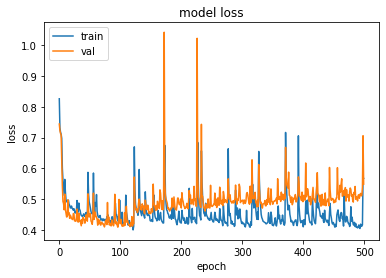

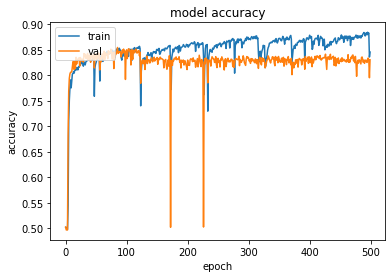

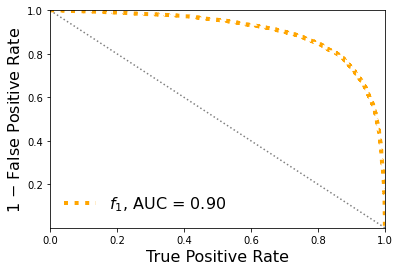

313/313 [==============================] - 3s 9ms/step - loss: 0.5577 - acc: 0.8267 - f1_m: 0.4546 - precision_m: 0.4999 - recall_m: 0.4181
Test ROC-AUC: 0.9036211599999999
Test loss: 0.5577132105827332
Test accuracy: 0.82669997215271
Test f1: 0.4545680582523346
Test precision: 0.49985477328300476
Test recall: 0.4181309938430786
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.001
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 36s 363ms/step - loss: 2.3828 - acc: 0.5005 - f1_m: 0.3971 - precision_m: 0.4035 - recall_m: 0.4559 - val_loss: 0.7896 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 2/500
94/94 [==============================] - 33s 347ms/step - loss: 0.7823 - acc: 0.4974 - f1_m: 0.0072 - precision_m: 0.0150 - recall_m: 0.0066 - val_loss: 0.7670 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_pr

Epoch 31/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4484 - acc: 0.8322 - f1_m: 0.8350 - precision_m: 0.8249 - recall_m: 0.8497 - val_loss: 0.4200 - val_acc: 0.8455 - val_f1_m: 0.8441 - val_precision_m: 0.8420 - val_recall_m: 0.8476
Epoch 32/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4420 - acc: 0.8403 - f1_m: 0.8417 - precision_m: 0.8296 - recall_m: 0.8573 - val_loss: 0.4280 - val_acc: 0.8398 - val_f1_m: 0.8357 - val_precision_m: 0.8449 - val_recall_m: 0.8285
Epoch 33/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4409 - acc: 0.8391 - f1_m: 0.8432 - precision_m: 0.8292 - recall_m: 0.8606 - val_loss: 0.4347 - val_acc: 0.8372 - val_f1_m: 0.8468 - val_precision_m: 0.7926 - val_recall_m: 0.9109
Epoch 34/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4384 - acc: 0.8384 - f1_m: 0.8439 - precision_m: 0.8258 - recall_m: 0.8666 - val_loss: 0.4189 - val_acc: 0.8467 - val_f1_m: 0.8440 - val_precisi

Epoch 63/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4263 - acc: 0.8559 - f1_m: 0.8610 - precision_m: 0.8294 - recall_m: 0.8976 - val_loss: 0.4297 - val_acc: 0.8470 - val_f1_m: 0.8472 - val_precision_m: 0.8329 - val_recall_m: 0.8633
Epoch 64/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4199 - acc: 0.8546 - f1_m: 0.8604 - precision_m: 0.8315 - recall_m: 0.8937 - val_loss: 0.4276 - val_acc: 0.8473 - val_f1_m: 0.8475 - val_precision_m: 0.8376 - val_recall_m: 0.8590
Epoch 65/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4113 - acc: 0.8583 - f1_m: 0.8626 - precision_m: 0.8380 - recall_m: 0.8914 - val_loss: 0.4283 - val_acc: 0.8428 - val_f1_m: 0.8475 - val_precision_m: 0.8126 - val_recall_m: 0.8869
Epoch 66/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4195 - acc: 0.8561 - f1_m: 0.8612 - precision_m: 0.8336 - recall_m: 0.8938 - val_loss: 0.4197 - val_acc: 0.8525 - val_f1_m: 0.8504 - val_precisi

Epoch 95/500
94/94 [==============================] - 32s 339ms/step - loss: 0.4119 - acc: 0.8550 - f1_m: 0.8601 - precision_m: 0.8352 - recall_m: 0.8888 - val_loss: 0.4259 - val_acc: 0.8438 - val_f1_m: 0.8377 - val_precision_m: 0.8572 - val_recall_m: 0.8211
Epoch 96/500
94/94 [==============================] - 32s 340ms/step - loss: 0.4194 - acc: 0.8525 - f1_m: 0.8557 - precision_m: 0.8403 - recall_m: 0.8772 - val_loss: 0.4264 - val_acc: 0.8427 - val_f1_m: 0.8485 - val_precision_m: 0.8076 - val_recall_m: 0.8953
Epoch 97/500
94/94 [==============================] - 32s 339ms/step - loss: 0.4099 - acc: 0.8544 - f1_m: 0.8597 - precision_m: 0.8346 - recall_m: 0.8888 - val_loss: 0.4274 - val_acc: 0.8458 - val_f1_m: 0.8405 - val_precision_m: 0.8559 - val_recall_m: 0.8273
Epoch 98/500
94/94 [==============================] - 32s 339ms/step - loss: 0.4100 - acc: 0.8568 - f1_m: 0.8601 - precision_m: 0.8397 - recall_m: 0.8850 - val_loss: 0.4165 - val_acc: 0.8480 - val_f1_m: 0.8512 - val_precisi

94/94 [==============================] - 32s 336ms/step - loss: 0.4327 - acc: 0.8378 - f1_m: 0.8426 - precision_m: 0.8256 - recall_m: 0.8636 - val_loss: 0.4483 - val_acc: 0.8248 - val_f1_m: 0.8195 - val_precision_m: 0.8346 - val_recall_m: 0.8067
Epoch 158/500
94/94 [==============================] - 32s 335ms/step - loss: 0.4468 - acc: 0.8300 - f1_m: 0.8327 - precision_m: 0.8193 - recall_m: 0.8497 - val_loss: 0.4533 - val_acc: 0.8315 - val_f1_m: 0.8309 - val_precision_m: 0.8280 - val_recall_m: 0.8355
Epoch 159/500
94/94 [==============================] - 31s 335ms/step - loss: 0.4297 - acc: 0.8429 - f1_m: 0.8464 - precision_m: 0.8290 - recall_m: 0.8668 - val_loss: 0.4419 - val_acc: 0.8320 - val_f1_m: 0.8364 - val_precision_m: 0.8080 - val_recall_m: 0.8684
Epoch 160/500
94/94 [==============================] - 32s 335ms/step - loss: 0.4254 - acc: 0.8413 - f1_m: 0.8452 - precision_m: 0.8281 - recall_m: 0.8652 - val_loss: 0.4448 - val_acc: 0.8272 - val_f1_m: 0.8215 - val_precision_m: 0.84

94/94 [==============================] - 31s 333ms/step - loss: 0.3999 - acc: 0.8582 - f1_m: 0.8552 - precision_m: 0.8748 - recall_m: 0.8386 - val_loss: 0.4704 - val_acc: 0.8348 - val_f1_m: 0.8342 - val_precision_m: 0.8216 - val_recall_m: 0.8488
Epoch 220/500
94/94 [==============================] - 31s 334ms/step - loss: 0.4059 - acc: 0.8557 - f1_m: 0.8530 - precision_m: 0.8645 - recall_m: 0.8435 - val_loss: 0.4613 - val_acc: 0.8358 - val_f1_m: 0.8370 - val_precision_m: 0.8182 - val_recall_m: 0.8583
Epoch 221/500
94/94 [==============================] - 31s 334ms/step - loss: 0.3967 - acc: 0.8578 - f1_m: 0.8562 - precision_m: 0.8682 - recall_m: 0.8469 - val_loss: 0.4584 - val_acc: 0.8272 - val_f1_m: 0.8180 - val_precision_m: 0.8528 - val_recall_m: 0.7881
Epoch 222/500
94/94 [==============================] - 32s 336ms/step - loss: 0.3897 - acc: 0.8632 - f1_m: 0.8596 - precision_m: 0.8704 - recall_m: 0.8505 - val_loss: 0.4577 - val_acc: 0.8318 - val_f1_m: 0.8299 - val_precision_m: 0.82

94/94 [==============================] - 31s 334ms/step - loss: 0.4749 - acc: 0.8358 - f1_m: 0.8381 - precision_m: 0.8273 - recall_m: 0.8538 - val_loss: 0.4808 - val_acc: 0.8287 - val_f1_m: 0.8290 - val_precision_m: 0.8192 - val_recall_m: 0.8405
Epoch 282/500
94/94 [==============================] - 31s 333ms/step - loss: 0.4621 - acc: 0.8394 - f1_m: 0.8437 - precision_m: 0.8261 - recall_m: 0.8641 - val_loss: 0.4769 - val_acc: 0.8205 - val_f1_m: 0.8057 - val_precision_m: 0.8631 - val_recall_m: 0.7572
Epoch 283/500
94/94 [==============================] - 32s 336ms/step - loss: 0.4579 - acc: 0.8406 - f1_m: 0.8439 - precision_m: 0.8310 - recall_m: 0.8612 - val_loss: 0.4769 - val_acc: 0.8363 - val_f1_m: 0.8449 - val_precision_m: 0.7914 - val_recall_m: 0.9076
Epoch 284/500
94/94 [==============================] - 31s 333ms/step - loss: 0.4381 - acc: 0.8486 - f1_m: 0.8533 - precision_m: 0.8376 - recall_m: 0.8730 - val_loss: 0.4734 - val_acc: 0.8320 - val_f1_m: 0.8277 - val_precision_m: 0.84

94/94 [==============================] - 31s 334ms/step - loss: 0.4085 - acc: 0.8638 - f1_m: 0.8638 - precision_m: 0.8543 - recall_m: 0.8780 - val_loss: 0.4762 - val_acc: 0.8315 - val_f1_m: 0.8379 - val_precision_m: 0.8027 - val_recall_m: 0.8778
Epoch 344/500
94/94 [==============================] - 31s 334ms/step - loss: 0.4075 - acc: 0.8702 - f1_m: 0.8729 - precision_m: 0.8565 - recall_m: 0.8917 - val_loss: 0.4459 - val_acc: 0.8390 - val_f1_m: 0.8414 - val_precision_m: 0.8232 - val_recall_m: 0.8618
Epoch 345/500
94/94 [==============================] - 32s 336ms/step - loss: 0.3944 - acc: 0.8682 - f1_m: 0.8703 - precision_m: 0.8564 - recall_m: 0.8871 - val_loss: 0.4519 - val_acc: 0.8338 - val_f1_m: 0.8346 - val_precision_m: 0.8253 - val_recall_m: 0.8457
Epoch 346/500
94/94 [==============================] - 31s 334ms/step - loss: 0.4002 - acc: 0.8651 - f1_m: 0.8658 - precision_m: 0.8578 - recall_m: 0.8760 - val_loss: 0.4572 - val_acc: 0.8337 - val_f1_m: 0.8371 - val_precision_m: 0.81

94/94 [==============================] - 32s 336ms/step - loss: 0.3936 - acc: 0.8719 - f1_m: 0.8732 - precision_m: 0.8612 - recall_m: 0.8875 - val_loss: 0.4832 - val_acc: 0.8250 - val_f1_m: 0.8200 - val_precision_m: 0.8384 - val_recall_m: 0.8041
Epoch 406/500
94/94 [==============================] - 32s 336ms/step - loss: 0.4007 - acc: 0.8657 - f1_m: 0.8687 - precision_m: 0.8492 - recall_m: 0.8918 - val_loss: 0.4638 - val_acc: 0.8363 - val_f1_m: 0.8381 - val_precision_m: 0.8242 - val_recall_m: 0.8543
Epoch 407/500
94/94 [==============================] - 31s 331ms/step - loss: 0.3895 - acc: 0.8689 - f1_m: 0.8694 - precision_m: 0.8500 - recall_m: 0.8919 - val_loss: 0.4689 - val_acc: 0.8310 - val_f1_m: 0.8328 - val_precision_m: 0.8195 - val_recall_m: 0.8479
Epoch 408/500
94/94 [==============================] - 31s 331ms/step - loss: 0.3964 - acc: 0.8701 - f1_m: 0.8722 - precision_m: 0.8580 - recall_m: 0.8887 - val_loss: 0.4709 - val_acc: 0.8275 - val_f1_m: 0.8297 - val_precision_m: 0.81

94/94 [==============================] - 31s 334ms/step - loss: 0.7103 - acc: 0.4978 - f1_m: 0.5837 - precision_m: 0.5031 - recall_m: 0.7192 - val_loss: 0.7117 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 468/500
94/94 [==============================] - 32s 335ms/step - loss: 0.7104 - acc: 0.4960 - f1_m: 0.4544 - precision_m: 0.4969 - recall_m: 0.4666 - val_loss: 0.7080 - val_acc: 0.5028 - val_f1_m: 0.0000e+00 - val_precision_m: 0.0000e+00 - val_recall_m: 0.0000e+00
Epoch 469/500
94/94 [==============================] - 31s 333ms/step - loss: 0.7076 - acc: 0.4980 - f1_m: 0.5384 - precision_m: 0.4960 - recall_m: 0.6337 - val_loss: 0.7068 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 470/500
94/94 [==============================] - 31s 333ms/step - loss: 0.7066 - acc: 0.4905 - f1_m: 0.4343 - precision_m: 0.4228 - recall_m: 0.6054 - val_loss: 0.7059 - val_acc: 0.4972 - val_f1_m: 0.6624

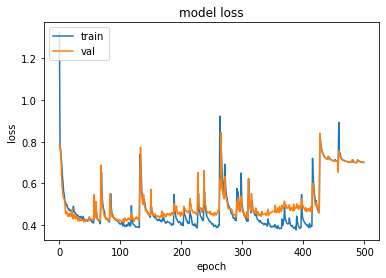

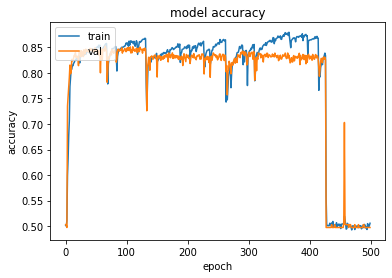

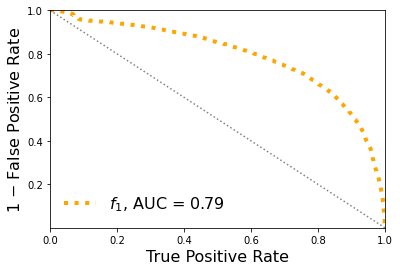

313/313 [==============================] - 3s 9ms/step - loss: 0.6996 - acc: 0.5000 - f1_m: 0.4997 - precision_m: 0.4992 - recall_m: 0.5016
Test ROC-AUC: 0.79228644
Test loss: 0.699617326259613
Test accuracy: 0.5
Test f1: 0.4996804893016815
Test precision: 0.4992012679576874
Test recall: 0.5015974640846252
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.05
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 34s 89ms/step - loss: 1.2611 - acc: 0.5127 - f1_m: 0.5039 - precision_m: 0.5090 - recall_m: 0.5410 - val_loss: 0.7597 - val_acc: 0.5092 - val_f1_m: 0.6671 - val_precision_m: 0.5032 - val_recall_m: 0.9997
Epoch 2/500
375/375 [==============================] - 33s 87ms/step - loss: 0.7095 - acc: 0.6371 - f1_m: 0.6564 - precision_m: 0.6418 - recall_m: 0.6993 - val_loss: 0.6537 - val_acc: 0.7028 - val_f1_m: 0.6063 - val_precision_m: 0.8735 - val_recall_m: 0.469

Epoch 31/500
375/375 [==============================] - 33s 88ms/step - loss: 0.5033 - acc: 0.8139 - f1_m: 0.8135 - precision_m: 0.8040 - recall_m: 0.8362 - val_loss: 0.4482 - val_acc: 0.8320 - val_f1_m: 0.8353 - val_precision_m: 0.8080 - val_recall_m: 0.8696
Epoch 32/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4867 - acc: 0.8218 - f1_m: 0.8251 - precision_m: 0.8137 - recall_m: 0.8462 - val_loss: 0.4896 - val_acc: 0.8233 - val_f1_m: 0.8352 - val_precision_m: 0.7739 - val_recall_m: 0.9124
Epoch 33/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4817 - acc: 0.8239 - f1_m: 0.8249 - precision_m: 0.8154 - recall_m: 0.8438 - val_loss: 0.4514 - val_acc: 0.8398 - val_f1_m: 0.8478 - val_precision_m: 0.7947 - val_recall_m: 0.9134
Epoch 34/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4860 - acc: 0.8223 - f1_m: 0.8247 - precision_m: 0.8126 - recall_m: 0.8472 - val_loss: 0.4749 - val_acc: 0.8270 - val_f1_m: 0.8393 - val_pre

375/375 [==============================] - 33s 88ms/step - loss: 0.4745 - acc: 0.8296 - f1_m: 0.8303 - precision_m: 0.8191 - recall_m: 0.8507 - val_loss: 0.4520 - val_acc: 0.8345 - val_f1_m: 0.8257 - val_precision_m: 0.8589 - val_recall_m: 0.7995
Epoch 94/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4714 - acc: 0.8275 - f1_m: 0.8272 - precision_m: 0.8177 - recall_m: 0.8462 - val_loss: 0.4590 - val_acc: 0.8427 - val_f1_m: 0.8458 - val_precision_m: 0.8190 - val_recall_m: 0.8791
Epoch 95/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4804 - acc: 0.8277 - f1_m: 0.8282 - precision_m: 0.8201 - recall_m: 0.8463 - val_loss: 0.4395 - val_acc: 0.8457 - val_f1_m: 0.8492 - val_precision_m: 0.8165 - val_recall_m: 0.8890
Epoch 96/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4944 - acc: 0.8185 - f1_m: 0.8204 - precision_m: 0.8084 - recall_m: 0.8456 - val_loss: 0.4429 - val_acc: 0.8298 - val_f1_m: 0.8222 - val_precision_m: 0.8

375/375 [==============================] - 33s 87ms/step - loss: 0.5223 - acc: 0.8168 - f1_m: 0.8196 - precision_m: 0.7990 - recall_m: 0.8554 - val_loss: 0.4211 - val_acc: 0.8427 - val_f1_m: 0.8445 - val_precision_m: 0.8246 - val_recall_m: 0.8704
Epoch 156/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4617 - acc: 0.8293 - f1_m: 0.8325 - precision_m: 0.8174 - recall_m: 0.8583 - val_loss: 0.4454 - val_acc: 0.8338 - val_f1_m: 0.8240 - val_precision_m: 0.8616 - val_recall_m: 0.7940
Epoch 157/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4637 - acc: 0.8305 - f1_m: 0.8331 - precision_m: 0.8144 - recall_m: 0.8614 - val_loss: 0.4513 - val_acc: 0.8357 - val_f1_m: 0.8284 - val_precision_m: 0.8573 - val_recall_m: 0.8067
Epoch 158/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4584 - acc: 0.8341 - f1_m: 0.8357 - precision_m: 0.8201 - recall_m: 0.8599 - val_loss: 0.4469 - val_acc: 0.8353 - val_f1_m: 0.8437 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4724 - acc: 0.8287 - f1_m: 0.8318 - precision_m: 0.8080 - recall_m: 0.8673 - val_loss: 0.4153 - val_acc: 0.8467 - val_f1_m: 0.8445 - val_precision_m: 0.8484 - val_recall_m: 0.8459
Epoch 218/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4621 - acc: 0.8335 - f1_m: 0.8367 - precision_m: 0.8174 - recall_m: 0.8636 - val_loss: 0.4321 - val_acc: 0.8363 - val_f1_m: 0.8308 - val_precision_m: 0.8489 - val_recall_m: 0.8180
Epoch 219/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4555 - acc: 0.8346 - f1_m: 0.8366 - precision_m: 0.8143 - recall_m: 0.8677 - val_loss: 0.4258 - val_acc: 0.8480 - val_f1_m: 0.8558 - val_precision_m: 0.8035 - val_recall_m: 0.9200
Epoch 220/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4666 - acc: 0.8288 - f1_m: 0.8307 - precision_m: 0.8124 - recall_m: 0.8584 - val_loss: 0.4375 - val_acc: 0.8472 - val_f1_m: 0.8525 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4937 - acc: 0.8193 - f1_m: 0.8224 - precision_m: 0.8059 - recall_m: 0.8539 - val_loss: 0.4339 - val_acc: 0.8447 - val_f1_m: 0.8488 - val_precision_m: 0.8148 - val_recall_m: 0.8910
Epoch 280/500
375/375 [==============================] - 33s 87ms/step - loss: 0.5037 - acc: 0.8151 - f1_m: 0.8175 - precision_m: 0.7976 - recall_m: 0.8502 - val_loss: 0.4312 - val_acc: 0.8412 - val_f1_m: 0.8343 - val_precision_m: 0.8631 - val_recall_m: 0.8124
Epoch 281/500
375/375 [==============================] - 33s 87ms/step - loss: 0.5005 - acc: 0.8124 - f1_m: 0.8132 - precision_m: 0.8050 - recall_m: 0.8378 - val_loss: 0.4372 - val_acc: 0.8402 - val_f1_m: 0.8363 - val_precision_m: 0.8453 - val_recall_m: 0.8325
Epoch 282/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4707 - acc: 0.8315 - f1_m: 0.8332 - precision_m: 0.8156 - recall_m: 0.8603 - val_loss: 0.4384 - val_acc: 0.8432 - val_f1_m: 0.8424 - val_precision_m: 

375/375 [==============================] - 33s 88ms/step - loss: 0.4674 - acc: 0.8300 - f1_m: 0.8348 - precision_m: 0.8110 - recall_m: 0.8719 - val_loss: 0.4235 - val_acc: 0.8500 - val_f1_m: 0.8524 - val_precision_m: 0.8280 - val_recall_m: 0.8833
Epoch 342/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4867 - acc: 0.8214 - f1_m: 0.8229 - precision_m: 0.8007 - recall_m: 0.8573 - val_loss: 0.4287 - val_acc: 0.8445 - val_f1_m: 0.8418 - val_precision_m: 0.8433 - val_recall_m: 0.8455
Epoch 343/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4540 - acc: 0.8375 - f1_m: 0.8392 - precision_m: 0.8250 - recall_m: 0.8611 - val_loss: 0.4494 - val_acc: 0.8397 - val_f1_m: 0.8485 - val_precision_m: 0.7950 - val_recall_m: 0.9148
Epoch 344/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4613 - acc: 0.8313 - f1_m: 0.8338 - precision_m: 0.8135 - recall_m: 0.8629 - val_loss: 0.4213 - val_acc: 0.8438 - val_f1_m: 0.8407 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4721 - acc: 0.8285 - f1_m: 0.8317 - precision_m: 0.8116 - recall_m: 0.8627 - val_loss: 0.4173 - val_acc: 0.8502 - val_f1_m: 0.8492 - val_precision_m: 0.8444 - val_recall_m: 0.8590
Epoch 404/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4538 - acc: 0.8347 - f1_m: 0.8360 - precision_m: 0.8189 - recall_m: 0.8618 - val_loss: 0.4142 - val_acc: 0.8495 - val_f1_m: 0.8496 - val_precision_m: 0.8388 - val_recall_m: 0.8654
Epoch 405/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4633 - acc: 0.8313 - f1_m: 0.8320 - precision_m: 0.8223 - recall_m: 0.8518 - val_loss: 0.4562 - val_acc: 0.8440 - val_f1_m: 0.8404 - val_precision_m: 0.8463 - val_recall_m: 0.8395
Epoch 406/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4779 - acc: 0.8327 - f1_m: 0.8341 - precision_m: 0.8197 - recall_m: 0.8611 - val_loss: 0.4286 - val_acc: 0.8458 - val_f1_m: 0.8485 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4456 - acc: 0.8423 - f1_m: 0.8457 - precision_m: 0.8201 - recall_m: 0.8795 - val_loss: 0.4534 - val_acc: 0.8373 - val_f1_m: 0.8269 - val_precision_m: 0.8722 - val_recall_m: 0.7906
Epoch 466/500
375/375 [==============================] - 33s 87ms/step - loss: 0.5232 - acc: 0.8157 - f1_m: 0.8150 - precision_m: 0.8032 - recall_m: 0.8461 - val_loss: 0.4389 - val_acc: 0.8317 - val_f1_m: 0.8187 - val_precision_m: 0.8740 - val_recall_m: 0.7748
Epoch 467/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4880 - acc: 0.8245 - f1_m: 0.8235 - precision_m: 0.8101 - recall_m: 0.8494 - val_loss: 0.4293 - val_acc: 0.8470 - val_f1_m: 0.8497 - val_precision_m: 0.8231 - val_recall_m: 0.8825
Epoch 468/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4634 - acc: 0.8313 - f1_m: 0.8340 - precision_m: 0.8140 - recall_m: 0.8662 - val_loss: 0.4285 - val_acc: 0.8423 - val_f1_m: 0.8357 - val_precision_m: 

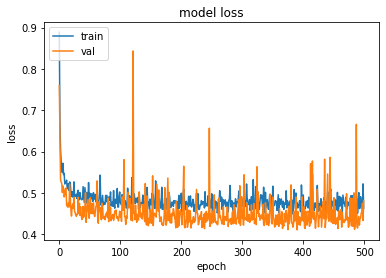

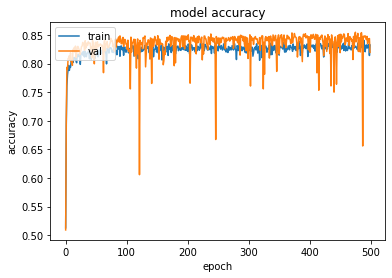

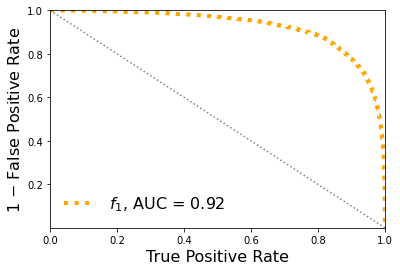

313/313 [==============================] - 3s 9ms/step - loss: 0.4898 - acc: 0.8123 - f1_m: 0.4875 - precision_m: 0.4997 - recall_m: 0.4767
Test ROC-AUC: 0.9235700199999999
Test loss: 0.4898005425930023
Test accuracy: 0.8123000264167786
Test f1: 0.4874889552593231
Test precision: 0.4997180700302124
Test recall: 0.47673723101615906
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.05
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 175ms/step - loss: 1.0292 - acc: 0.5929 - f1_m: 0.6300 - precision_m: 0.5670 - recall_m: 0.7402 - val_loss: 0.5756 - val_acc: 0.7755 - val_f1_m: 0.7754 - val_precision_m: 0.7681 - val_recall_m: 0.7860
Epoch 2/500
188/188 [==============================] - 32s 170ms/step - loss: 0.6080 - acc: 0.7608 - f1_m: 0.7722 - precision_m: 0.7428 - recall_m: 0.8129 - val_loss: 0.5420 - val_acc: 0.7990 - val_f1_m: 0.7836 - val_precision_m: 

188/188 [==============================] - 32s 170ms/step - loss: 0.4421 - acc: 0.8407 - f1_m: 0.8427 - precision_m: 0.8247 - recall_m: 0.8659 - val_loss: 0.4630 - val_acc: 0.8263 - val_f1_m: 0.8429 - val_precision_m: 0.7634 - val_recall_m: 0.9436
Epoch 62/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4510 - acc: 0.8375 - f1_m: 0.8412 - precision_m: 0.8169 - recall_m: 0.8729 - val_loss: 0.4492 - val_acc: 0.8292 - val_f1_m: 0.8201 - val_precision_m: 0.8586 - val_recall_m: 0.7878
Epoch 63/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4491 - acc: 0.8420 - f1_m: 0.8457 - precision_m: 0.8273 - recall_m: 0.8689 - val_loss: 0.4247 - val_acc: 0.8517 - val_f1_m: 0.8572 - val_precision_m: 0.8190 - val_recall_m: 0.9020
Epoch 64/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4557 - acc: 0.8345 - f1_m: 0.8377 - precision_m: 0.8174 - recall_m: 0.8674 - val_loss: 0.4549 - val_acc: 0.8367 - val_f1_m: 0.8318 - val_precision_m:

188/188 [==============================] - 32s 172ms/step - loss: 0.4351 - acc: 0.8441 - f1_m: 0.8477 - precision_m: 0.8287 - recall_m: 0.8725 - val_loss: 0.4284 - val_acc: 0.8457 - val_f1_m: 0.8520 - val_precision_m: 0.8134 - val_recall_m: 0.8974
Epoch 124/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4265 - acc: 0.8462 - f1_m: 0.8504 - precision_m: 0.8309 - recall_m: 0.8759 - val_loss: 0.4482 - val_acc: 0.8487 - val_f1_m: 0.8539 - val_precision_m: 0.8193 - val_recall_m: 0.8946
Epoch 125/500
188/188 [==============================] - 32s 170ms/step - loss: 0.5429 - acc: 0.7957 - f1_m: 0.8019 - precision_m: 0.7844 - recall_m: 0.8379 - val_loss: 0.4619 - val_acc: 0.8265 - val_f1_m: 0.8112 - val_precision_m: 0.8818 - val_recall_m: 0.7537
Epoch 126/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4530 - acc: 0.8398 - f1_m: 0.8422 - precision_m: 0.8258 - recall_m: 0.8651 - val_loss: 0.4389 - val_acc: 0.8457 - val_f1_m: 0.8475 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4291 - acc: 0.8455 - f1_m: 0.8503 - precision_m: 0.8276 - recall_m: 0.8796 - val_loss: 0.5076 - val_acc: 0.8018 - val_f1_m: 0.8279 - val_precision_m: 0.7259 - val_recall_m: 0.9656
Epoch 186/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4531 - acc: 0.8364 - f1_m: 0.8403 - precision_m: 0.8175 - recall_m: 0.8725 - val_loss: 0.4773 - val_acc: 0.8235 - val_f1_m: 0.8422 - val_precision_m: 0.7563 - val_recall_m: 0.9531
Epoch 187/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4861 - acc: 0.8283 - f1_m: 0.8325 - precision_m: 0.8063 - recall_m: 0.8724 - val_loss: 0.4266 - val_acc: 0.8447 - val_f1_m: 0.8412 - val_precision_m: 0.8532 - val_recall_m: 0.8322
Epoch 188/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4306 - acc: 0.8470 - f1_m: 0.8508 - precision_m: 0.8320 - recall_m: 0.8758 - val_loss: 0.4101 - val_acc: 0.8495 - val_f1_m: 0.8478 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4219 - acc: 0.8512 - f1_m: 0.8542 - precision_m: 0.8386 - recall_m: 0.8748 - val_loss: 0.4143 - val_acc: 0.8507 - val_f1_m: 0.8457 - val_precision_m: 0.8652 - val_recall_m: 0.8290
Epoch 248/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4187 - acc: 0.8477 - f1_m: 0.8506 - precision_m: 0.8340 - recall_m: 0.8727 - val_loss: 0.4159 - val_acc: 0.8473 - val_f1_m: 0.8444 - val_precision_m: 0.8519 - val_recall_m: 0.8394
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4352 - acc: 0.8424 - f1_m: 0.8462 - precision_m: 0.8206 - recall_m: 0.8794 - val_loss: 0.4121 - val_acc: 0.8510 - val_f1_m: 0.8476 - val_precision_m: 0.8587 - val_recall_m: 0.8396
Epoch 250/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4275 - acc: 0.8430 - f1_m: 0.8452 - precision_m: 0.8305 - recall_m: 0.8664 - val_loss: 0.4249 - val_acc: 0.8517 - val_f1_m: 0.8504 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4464 - acc: 0.8404 - f1_m: 0.8447 - precision_m: 0.8281 - recall_m: 0.8711 - val_loss: 0.4240 - val_acc: 0.8390 - val_f1_m: 0.8323 - val_precision_m: 0.8609 - val_recall_m: 0.8082
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4313 - acc: 0.8459 - f1_m: 0.8488 - precision_m: 0.8322 - recall_m: 0.8721 - val_loss: 0.4071 - val_acc: 0.8497 - val_f1_m: 0.8499 - val_precision_m: 0.8388 - val_recall_m: 0.8643
Epoch 311/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4207 - acc: 0.8494 - f1_m: 0.8514 - precision_m: 0.8378 - recall_m: 0.8701 - val_loss: 0.5781 - val_acc: 0.7923 - val_f1_m: 0.8216 - val_precision_m: 0.7145 - val_recall_m: 0.9691
Epoch 312/500
188/188 [==============================] - 32s 171ms/step - loss: 0.5525 - acc: 0.7995 - f1_m: 0.8095 - precision_m: 0.7807 - recall_m: 0.8555 - val_loss: 0.4294 - val_acc: 0.8522 - val_f1_m: 0.8608 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4386 - acc: 0.8467 - f1_m: 0.8519 - precision_m: 0.8226 - recall_m: 0.8884 - val_loss: 0.4145 - val_acc: 0.8522 - val_f1_m: 0.8582 - val_precision_m: 0.8180 - val_recall_m: 0.9054
Epoch 372/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4182 - acc: 0.8506 - f1_m: 0.8541 - precision_m: 0.8290 - recall_m: 0.8844 - val_loss: 0.4046 - val_acc: 0.8495 - val_f1_m: 0.8495 - val_precision_m: 0.8413 - val_recall_m: 0.8605
Epoch 373/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4217 - acc: 0.8480 - f1_m: 0.8512 - precision_m: 0.8304 - recall_m: 0.8777 - val_loss: 0.4208 - val_acc: 0.8507 - val_f1_m: 0.8553 - val_precision_m: 0.8239 - val_recall_m: 0.8919
Epoch 374/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4382 - acc: 0.8423 - f1_m: 0.8461 - precision_m: 0.8245 - recall_m: 0.8747 - val_loss: 0.4248 - val_acc: 0.8468 - val_f1_m: 0.8564 - val_precision

188/188 [==============================] - 32s 168ms/step - loss: 0.4297 - acc: 0.8490 - f1_m: 0.8513 - precision_m: 0.8345 - recall_m: 0.8736 - val_loss: 0.4255 - val_acc: 0.8403 - val_f1_m: 0.8324 - val_precision_m: 0.8664 - val_recall_m: 0.8038
Epoch 434/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4273 - acc: 0.8468 - f1_m: 0.8498 - precision_m: 0.8285 - recall_m: 0.8777 - val_loss: 0.4128 - val_acc: 0.8492 - val_f1_m: 0.8450 - val_precision_m: 0.8613 - val_recall_m: 0.8320
Epoch 435/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4372 - acc: 0.8396 - f1_m: 0.8436 - precision_m: 0.8256 - recall_m: 0.8682 - val_loss: 0.4060 - val_acc: 0.8510 - val_f1_m: 0.8466 - val_precision_m: 0.8653 - val_recall_m: 0.8312
Epoch 436/500
188/188 [==============================] - 32s 168ms/step - loss: 0.4414 - acc: 0.8400 - f1_m: 0.8426 - precision_m: 0.8262 - recall_m: 0.8650 - val_loss: 0.4180 - val_acc: 0.8502 - val_f1_m: 0.8569 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4424 - acc: 0.8411 - f1_m: 0.8457 - precision_m: 0.8291 - recall_m: 0.8695 - val_loss: 0.4059 - val_acc: 0.8507 - val_f1_m: 0.8499 - val_precision_m: 0.8456 - val_recall_m: 0.8566
Epoch 496/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4330 - acc: 0.8444 - f1_m: 0.8481 - precision_m: 0.8335 - recall_m: 0.8701 - val_loss: 0.4604 - val_acc: 0.8290 - val_f1_m: 0.8464 - val_precision_m: 0.7624 - val_recall_m: 0.9537
Epoch 497/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4491 - acc: 0.8384 - f1_m: 0.8400 - precision_m: 0.8168 - recall_m: 0.8728 - val_loss: 0.4317 - val_acc: 0.8507 - val_f1_m: 0.8570 - val_precision_m: 0.8151 - val_recall_m: 0.9060
Epoch 498/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4341 - acc: 0.8510 - f1_m: 0.8536 - precision_m: 0.8366 - recall_m: 0.8757 - val_loss: 0.4062 - val_acc: 0.8548 - val_f1_m: 0.8607 - val_precision

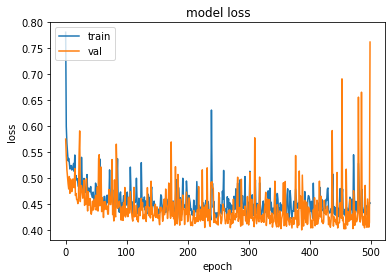

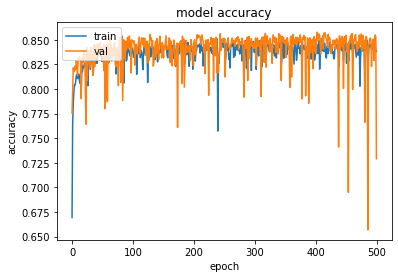

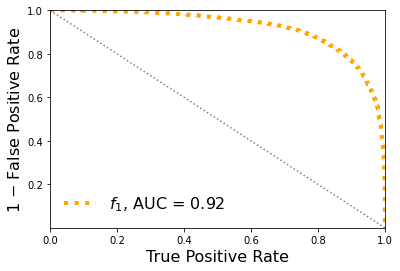

313/313 [==============================] - 3s 9ms/step - loss: 0.7760 - acc: 0.7274 - f1_m: 0.3256 - precision_m: 0.5003 - recall_m: 0.2435
Test ROC-AUC: 0.9203669
Test loss: 0.7760124802589417
Test accuracy: 0.727400004863739
Test f1: 0.32560715079307556
Test precision: 0.5003194808959961
Test recall: 0.2435103803873062
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.05
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 362ms/step - loss: 2.1231 - acc: 0.5030 - f1_m: 0.5545 - precision_m: 0.5064 - recall_m: 0.6617 - val_loss: 0.7826 - val_acc: 0.7297 - val_f1_m: 0.7152 - val_precision_m: 0.7467 - val_recall_m: 0.6884
Epoch 2/500
94/94 [==============================] - 33s 352ms/step - loss: 0.7533 - acc: 0.6460 - f1_m: 0.6539 - precision_m: 0.6453 - recall_m: 0.6758 - val_loss: 0.6357 - val_acc: 0.7627 - val_f1_m: 0.7613 - val_precision_m: 0.7583 - val_r

Epoch 31/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4656 - acc: 0.8344 - f1_m: 0.8355 - precision_m: 0.8209 - recall_m: 0.8568 - val_loss: 0.4376 - val_acc: 0.8413 - val_f1_m: 0.8357 - val_precision_m: 0.8548 - val_recall_m: 0.8194
Epoch 32/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4517 - acc: 0.8436 - f1_m: 0.8471 - precision_m: 0.8331 - recall_m: 0.8646 - val_loss: 0.4461 - val_acc: 0.8405 - val_f1_m: 0.8475 - val_precision_m: 0.8026 - val_recall_m: 0.8995
Epoch 33/500
94/94 [==============================] - 33s 347ms/step - loss: 0.4577 - acc: 0.8428 - f1_m: 0.8458 - precision_m: 0.8316 - recall_m: 0.8664 - val_loss: 0.4472 - val_acc: 0.8368 - val_f1_m: 0.8328 - val_precision_m: 0.8441 - val_recall_m: 0.8234
Epoch 34/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4591 - acc: 0.8344 - f1_m: 0.8385 - precision_m: 0.8254 - recall_m: 0.8582 - val_loss: 0.4439 - val_acc: 0.8412 - val_f1_m: 0.8433 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4153 - acc: 0.8614 - f1_m: 0.8640 - precision_m: 0.8496 - recall_m: 0.8821 - val_loss: 0.4432 - val_acc: 0.8310 - val_f1_m: 0.8159 - val_precision_m: 0.8830 - val_recall_m: 0.7594
Epoch 64/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4183 - acc: 0.8559 - f1_m: 0.8565 - precision_m: 0.8454 - recall_m: 0.8712 - val_loss: 0.4352 - val_acc: 0.8442 - val_f1_m: 0.8434 - val_precision_m: 0.8360 - val_recall_m: 0.8523
Epoch 65/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4504 - acc: 0.8381 - f1_m: 0.8416 - precision_m: 0.8204 - recall_m: 0.8685 - val_loss: 0.4518 - val_acc: 0.8267 - val_f1_m: 0.8151 - val_precision_m: 0.8646 - val_recall_m: 0.7726
Epoch 66/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4465 - acc: 0.8450 - f1_m: 0.8466 - precision_m: 0.8355 - recall_m: 0.8657 - val_loss: 0.4427 - val_acc: 0.8397 - val_f1_m: 0.8302 - val_precisi

Epoch 95/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4095 - acc: 0.8600 - f1_m: 0.8631 - precision_m: 0.8466 - recall_m: 0.8833 - val_loss: 0.4360 - val_acc: 0.8422 - val_f1_m: 0.8355 - val_precision_m: 0.8650 - val_recall_m: 0.8102
Epoch 96/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4094 - acc: 0.8588 - f1_m: 0.8602 - precision_m: 0.8488 - recall_m: 0.8754 - val_loss: 0.4531 - val_acc: 0.8305 - val_f1_m: 0.8166 - val_precision_m: 0.8821 - val_recall_m: 0.7619
Epoch 97/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4063 - acc: 0.8593 - f1_m: 0.8609 - precision_m: 0.8486 - recall_m: 0.8768 - val_loss: 0.4333 - val_acc: 0.8428 - val_f1_m: 0.8367 - val_precision_m: 0.8592 - val_recall_m: 0.8167
Epoch 98/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4098 - acc: 0.8595 - f1_m: 0.8610 - precision_m: 0.8454 - recall_m: 0.8800 - val_loss: 0.4396 - val_acc: 0.8453 - val_f1_m: 0.8560 - val_precisi

94/94 [==============================] - 33s 348ms/step - loss: 0.4513 - acc: 0.8446 - f1_m: 0.8484 - precision_m: 0.8251 - recall_m: 0.8791 - val_loss: 0.4265 - val_acc: 0.8542 - val_f1_m: 0.8568 - val_precision_m: 0.8294 - val_recall_m: 0.8873
Epoch 158/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4222 - acc: 0.8549 - f1_m: 0.8569 - precision_m: 0.8456 - recall_m: 0.8726 - val_loss: 0.4299 - val_acc: 0.8478 - val_f1_m: 0.8426 - val_precision_m: 0.8584 - val_recall_m: 0.8288
Epoch 159/500
94/94 [==============================] - 32s 346ms/step - loss: 0.4152 - acc: 0.8570 - f1_m: 0.8591 - precision_m: 0.8487 - recall_m: 0.8726 - val_loss: 0.4406 - val_acc: 0.8292 - val_f1_m: 0.8165 - val_precision_m: 0.8772 - val_recall_m: 0.7651
Epoch 160/500
94/94 [==============================] - 32s 345ms/step - loss: 0.4168 - acc: 0.8588 - f1_m: 0.8619 - precision_m: 0.8493 - recall_m: 0.8798 - val_loss: 0.4251 - val_acc: 0.8458 - val_f1_m: 0.8423 - val_precision_m: 0.85

94/94 [==============================] - 32s 346ms/step - loss: 0.4230 - acc: 0.8520 - f1_m: 0.8509 - precision_m: 0.8444 - recall_m: 0.8648 - val_loss: 0.4399 - val_acc: 0.8340 - val_f1_m: 0.8215 - val_precision_m: 0.8757 - val_recall_m: 0.7755
Epoch 220/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4137 - acc: 0.8574 - f1_m: 0.8597 - precision_m: 0.8454 - recall_m: 0.8768 - val_loss: 0.4189 - val_acc: 0.8495 - val_f1_m: 0.8502 - val_precision_m: 0.8396 - val_recall_m: 0.8626
Epoch 221/500
94/94 [==============================] - 33s 346ms/step - loss: 0.3993 - acc: 0.8659 - f1_m: 0.8669 - precision_m: 0.8584 - recall_m: 0.8796 - val_loss: 0.4202 - val_acc: 0.8478 - val_f1_m: 0.8471 - val_precision_m: 0.8379 - val_recall_m: 0.8579
Epoch 222/500
94/94 [==============================] - 33s 346ms/step - loss: 0.3930 - acc: 0.8662 - f1_m: 0.8675 - precision_m: 0.8555 - recall_m: 0.8814 - val_loss: 0.4122 - val_acc: 0.8493 - val_f1_m: 0.8465 - val_precision_m: 0.85

94/94 [==============================] - 32s 344ms/step - loss: 0.3934 - acc: 0.8651 - f1_m: 0.8668 - precision_m: 0.8583 - recall_m: 0.8778 - val_loss: 0.4376 - val_acc: 0.8375 - val_f1_m: 0.8306 - val_precision_m: 0.8562 - val_recall_m: 0.8079
Epoch 282/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4057 - acc: 0.8603 - f1_m: 0.8621 - precision_m: 0.8542 - recall_m: 0.8731 - val_loss: 0.4470 - val_acc: 0.8208 - val_f1_m: 0.8006 - val_precision_m: 0.8954 - val_recall_m: 0.7257
Epoch 283/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4203 - acc: 0.8560 - f1_m: 0.8563 - precision_m: 0.8562 - recall_m: 0.8645 - val_loss: 0.4302 - val_acc: 0.8370 - val_f1_m: 0.8302 - val_precision_m: 0.8564 - val_recall_m: 0.8070
Epoch 284/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4130 - acc: 0.8595 - f1_m: 0.8597 - precision_m: 0.8500 - recall_m: 0.8722 - val_loss: 0.4356 - val_acc: 0.8313 - val_f1_m: 0.8156 - val_precision_m: 0.88

94/94 [==============================] - 32s 345ms/step - loss: 0.4200 - acc: 0.8537 - f1_m: 0.8554 - precision_m: 0.8442 - recall_m: 0.8712 - val_loss: 0.4389 - val_acc: 0.8482 - val_f1_m: 0.8560 - val_precision_m: 0.8002 - val_recall_m: 0.9214
Epoch 344/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4131 - acc: 0.8579 - f1_m: 0.8581 - precision_m: 0.8484 - recall_m: 0.8761 - val_loss: 0.4168 - val_acc: 0.8497 - val_f1_m: 0.8456 - val_precision_m: 0.8569 - val_recall_m: 0.8359
Epoch 345/500
94/94 [==============================] - 32s 343ms/step - loss: 0.3928 - acc: 0.8666 - f1_m: 0.8679 - precision_m: 0.8599 - recall_m: 0.8781 - val_loss: 0.4054 - val_acc: 0.8542 - val_f1_m: 0.8556 - val_precision_m: 0.8345 - val_recall_m: 0.8792
Epoch 346/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4011 - acc: 0.8607 - f1_m: 0.8609 - precision_m: 0.8527 - recall_m: 0.8733 - val_loss: 0.4257 - val_acc: 0.8508 - val_f1_m: 0.8506 - val_precision_m: 0.83

94/94 [==============================] - 32s 339ms/step - loss: 0.4559 - acc: 0.8445 - f1_m: 0.8524 - precision_m: 0.8249 - recall_m: 0.8851 - val_loss: 0.4440 - val_acc: 0.8417 - val_f1_m: 0.8529 - val_precision_m: 0.7868 - val_recall_m: 0.9326
Epoch 406/500
94/94 [==============================] - 32s 339ms/step - loss: 0.4325 - acc: 0.8481 - f1_m: 0.8544 - precision_m: 0.8272 - recall_m: 0.8881 - val_loss: 0.4180 - val_acc: 0.8453 - val_f1_m: 0.8436 - val_precision_m: 0.8417 - val_recall_m: 0.8468
Epoch 407/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4377 - acc: 0.8470 - f1_m: 0.8513 - precision_m: 0.8381 - recall_m: 0.8710 - val_loss: 0.4176 - val_acc: 0.8497 - val_f1_m: 0.8576 - val_precision_m: 0.8027 - val_recall_m: 0.9219
Epoch 408/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4062 - acc: 0.8579 - f1_m: 0.8625 - precision_m: 0.8413 - recall_m: 0.8866 - val_loss: 0.4324 - val_acc: 0.8420 - val_f1_m: 0.8317 - val_precision_m: 0.87

94/94 [==============================] - 32s 342ms/step - loss: 0.4312 - acc: 0.8486 - f1_m: 0.8506 - precision_m: 0.8347 - recall_m: 0.8714 - val_loss: 0.4099 - val_acc: 0.8525 - val_f1_m: 0.8593 - val_precision_m: 0.8089 - val_recall_m: 0.9176
Epoch 468/500
94/94 [==============================] - 32s 340ms/step - loss: 0.4111 - acc: 0.8582 - f1_m: 0.8621 - precision_m: 0.8400 - recall_m: 0.8902 - val_loss: 0.4178 - val_acc: 0.8483 - val_f1_m: 0.8584 - val_precision_m: 0.7968 - val_recall_m: 0.9317
Epoch 469/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4007 - acc: 0.8657 - f1_m: 0.8688 - precision_m: 0.8513 - recall_m: 0.8908 - val_loss: 0.4045 - val_acc: 0.8560 - val_f1_m: 0.8593 - val_precision_m: 0.8335 - val_recall_m: 0.8882
Epoch 470/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4219 - acc: 0.8528 - f1_m: 0.8550 - precision_m: 0.8370 - recall_m: 0.8796 - val_loss: 0.4242 - val_acc: 0.8425 - val_f1_m: 0.8336 - val_precision_m: 0.87

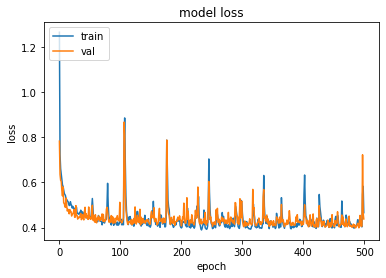

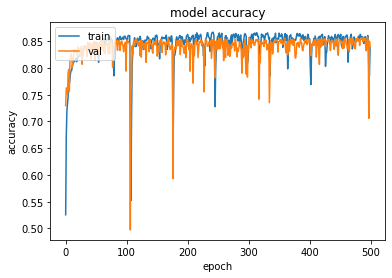

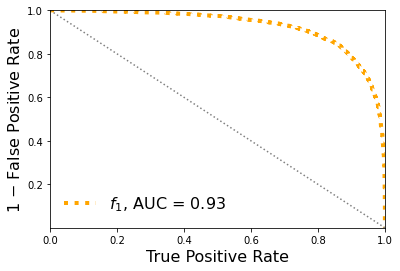

313/313 [==============================] - 3s 9ms/step - loss: 0.4552 - acc: 0.8411 - f1_m: 0.4408 - precision_m: 0.5004 - recall_m: 0.3953
Test ROC-AUC: 0.92692904
Test loss: 0.45515039563179016
Test accuracy: 0.8410999774932861
Test f1: 0.44075334072113037
Test precision: 0.5003993511199951
Test recall: 0.3952675759792328
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.01
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 34s 89ms/step - loss: 0.8725 - acc: 0.5702 - f1_m: 0.5070 - precision_m: 0.5688 - recall_m: 0.5034 - val_loss: 0.6165 - val_acc: 0.7582 - val_f1_m: 0.7388 - val_precision_m: 0.7887 - val_recall_m: 0.7013
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6551 - acc: 0.7085 - f1_m: 0.7010 - precision_m: 0.7196 - recall_m: 0.6992 - val_loss: 0.5652 - val_acc: 0.7742 - val_f1_m: 0.7447 - val_precision_m: 0.8386 - v

Epoch 31/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4738 - acc: 0.8200 - f1_m: 0.8134 - precision_m: 0.8304 - recall_m: 0.8076 - val_loss: 0.4631 - val_acc: 0.8375 - val_f1_m: 0.8452 - val_precision_m: 0.7966 - val_recall_m: 0.9052
Epoch 32/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4792 - acc: 0.8204 - f1_m: 0.8176 - precision_m: 0.8296 - recall_m: 0.8140 - val_loss: 0.4430 - val_acc: 0.8367 - val_f1_m: 0.8416 - val_precision_m: 0.8033 - val_recall_m: 0.8885
Epoch 33/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4673 - acc: 0.8230 - f1_m: 0.8172 - precision_m: 0.8334 - recall_m: 0.8093 - val_loss: 0.4272 - val_acc: 0.8400 - val_f1_m: 0.8392 - val_precision_m: 0.8312 - val_recall_m: 0.8526
Epoch 34/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4752 - acc: 0.8163 - f1_m: 0.8122 - precision_m: 0.8305 - recall_m: 0.8042 - val_loss: 0.4776 - val_acc: 0.8077 - val_f1_m: 0.7834 - val_pre

375/375 [==============================] - 32s 87ms/step - loss: 0.4615 - acc: 0.8279 - f1_m: 0.8231 - precision_m: 0.8341 - recall_m: 0.8218 - val_loss: 0.4225 - val_acc: 0.8442 - val_f1_m: 0.8420 - val_precision_m: 0.8425 - val_recall_m: 0.8461
Epoch 94/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4627 - acc: 0.8246 - f1_m: 0.8207 - precision_m: 0.8344 - recall_m: 0.8191 - val_loss: 0.4540 - val_acc: 0.8350 - val_f1_m: 0.8377 - val_precision_m: 0.8118 - val_recall_m: 0.8703
Epoch 95/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4550 - acc: 0.8310 - f1_m: 0.8272 - precision_m: 0.8356 - recall_m: 0.8264 - val_loss: 0.4494 - val_acc: 0.8423 - val_f1_m: 0.8484 - val_precision_m: 0.8074 - val_recall_m: 0.8989
Epoch 96/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4625 - acc: 0.8292 - f1_m: 0.8246 - precision_m: 0.8337 - recall_m: 0.8249 - val_loss: 0.4372 - val_acc: 0.8330 - val_f1_m: 0.8225 - val_precision_m: 0.8

375/375 [==============================] - 32s 87ms/step - loss: 0.4408 - acc: 0.8404 - f1_m: 0.8378 - precision_m: 0.8489 - recall_m: 0.8343 - val_loss: 0.4572 - val_acc: 0.8317 - val_f1_m: 0.8194 - val_precision_m: 0.8717 - val_recall_m: 0.7772
Epoch 156/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4861 - acc: 0.8297 - f1_m: 0.8246 - precision_m: 0.8384 - recall_m: 0.8241 - val_loss: 0.4302 - val_acc: 0.8498 - val_f1_m: 0.8531 - val_precision_m: 0.8234 - val_recall_m: 0.8899
Epoch 157/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4686 - acc: 0.8298 - f1_m: 0.8273 - precision_m: 0.8366 - recall_m: 0.8295 - val_loss: 0.4202 - val_acc: 0.8498 - val_f1_m: 0.8498 - val_precision_m: 0.8385 - val_recall_m: 0.8659
Epoch 158/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4786 - acc: 0.8294 - f1_m: 0.8226 - precision_m: 0.8461 - recall_m: 0.8165 - val_loss: 0.4298 - val_acc: 0.8418 - val_f1_m: 0.8368 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4957 - acc: 0.8251 - f1_m: 0.8149 - precision_m: 0.8400 - recall_m: 0.8061 - val_loss: 0.4380 - val_acc: 0.8448 - val_f1_m: 0.8417 - val_precision_m: 0.8498 - val_recall_m: 0.8386
Epoch 218/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4690 - acc: 0.8285 - f1_m: 0.8240 - precision_m: 0.8412 - recall_m: 0.8180 - val_loss: 0.4491 - val_acc: 0.8300 - val_f1_m: 0.8171 - val_precision_m: 0.8738 - val_recall_m: 0.7729
Epoch 219/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4599 - acc: 0.8363 - f1_m: 0.8330 - precision_m: 0.8406 - recall_m: 0.8330 - val_loss: 0.4154 - val_acc: 0.8445 - val_f1_m: 0.8398 - val_precision_m: 0.8556 - val_recall_m: 0.8294
Epoch 220/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4574 - acc: 0.8324 - f1_m: 0.8287 - precision_m: 0.8383 - recall_m: 0.8272 - val_loss: 0.4291 - val_acc: 0.8350 - val_f1_m: 0.8251 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4672 - acc: 0.8345 - f1_m: 0.8306 - precision_m: 0.8443 - recall_m: 0.8262 - val_loss: 0.4436 - val_acc: 0.8463 - val_f1_m: 0.8533 - val_precision_m: 0.8045 - val_recall_m: 0.9134
Epoch 280/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4575 - acc: 0.8357 - f1_m: 0.8318 - precision_m: 0.8468 - recall_m: 0.8256 - val_loss: 0.4262 - val_acc: 0.8360 - val_f1_m: 0.8239 - val_precision_m: 0.8797 - val_recall_m: 0.7794
Epoch 281/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4458 - acc: 0.8379 - f1_m: 0.8344 - precision_m: 0.8492 - recall_m: 0.8277 - val_loss: 0.4562 - val_acc: 0.8473 - val_f1_m: 0.8480 - val_precision_m: 0.8331 - val_recall_m: 0.8686
Epoch 282/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4858 - acc: 0.8237 - f1_m: 0.8161 - precision_m: 0.8377 - recall_m: 0.8093 - val_loss: 0.4518 - val_acc: 0.8152 - val_f1_m: 0.7936 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4620 - acc: 0.8411 - f1_m: 0.8365 - precision_m: 0.8457 - recall_m: 0.8355 - val_loss: 0.4593 - val_acc: 0.8157 - val_f1_m: 0.7929 - val_precision_m: 0.8940 - val_recall_m: 0.7178
Epoch 342/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4700 - acc: 0.8329 - f1_m: 0.8276 - precision_m: 0.8390 - recall_m: 0.8253 - val_loss: 0.4311 - val_acc: 0.8523 - val_f1_m: 0.8584 - val_precision_m: 0.8144 - val_recall_m: 0.9118
Epoch 343/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4950 - acc: 0.8254 - f1_m: 0.8223 - precision_m: 0.8273 - recall_m: 0.8287 - val_loss: 0.4898 - val_acc: 0.8340 - val_f1_m: 0.8452 - val_precision_m: 0.7793 - val_recall_m: 0.9282
Epoch 344/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4746 - acc: 0.8302 - f1_m: 0.8278 - precision_m: 0.8336 - recall_m: 0.8302 - val_loss: 0.4114 - val_acc: 0.8445 - val_f1_m: 0.8400 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4777 - acc: 0.8255 - f1_m: 0.8201 - precision_m: 0.8321 - recall_m: 0.8177 - val_loss: 0.4743 - val_acc: 0.8358 - val_f1_m: 0.8336 - val_precision_m: 0.8348 - val_recall_m: 0.8369
Epoch 404/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4813 - acc: 0.8284 - f1_m: 0.8234 - precision_m: 0.8370 - recall_m: 0.8217 - val_loss: 0.4303 - val_acc: 0.8438 - val_f1_m: 0.8403 - val_precision_m: 0.8492 - val_recall_m: 0.8366
Epoch 405/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4540 - acc: 0.8372 - f1_m: 0.8324 - precision_m: 0.8440 - recall_m: 0.8296 - val_loss: 0.4263 - val_acc: 0.8412 - val_f1_m: 0.8339 - val_precision_m: 0.8630 - val_recall_m: 0.8112
Epoch 406/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4469 - acc: 0.8345 - f1_m: 0.8308 - precision_m: 0.8451 - recall_m: 0.8264 - val_loss: 0.4645 - val_acc: 0.8190 - val_f1_m: 0.7992 - val_precision_m: 

375/375 [==============================] - 32s 86ms/step - loss: 0.4749 - acc: 0.8339 - f1_m: 0.8308 - precision_m: 0.8381 - recall_m: 0.8300 - val_loss: 0.4380 - val_acc: 0.8507 - val_f1_m: 0.8527 - val_precision_m: 0.8287 - val_recall_m: 0.8819
Epoch 466/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4796 - acc: 0.8302 - f1_m: 0.8225 - precision_m: 0.8396 - recall_m: 0.8190 - val_loss: 0.4280 - val_acc: 0.8503 - val_f1_m: 0.8496 - val_precision_m: 0.8402 - val_recall_m: 0.8637
Epoch 467/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4555 - acc: 0.8374 - f1_m: 0.8352 - precision_m: 0.8433 - recall_m: 0.8352 - val_loss: 0.4398 - val_acc: 0.8458 - val_f1_m: 0.8430 - val_precision_m: 0.8483 - val_recall_m: 0.8424
Epoch 468/500
375/375 [==============================] - 32s 86ms/step - loss: 0.4718 - acc: 0.8321 - f1_m: 0.8309 - precision_m: 0.8421 - recall_m: 0.8305 - val_loss: 0.4318 - val_acc: 0.8495 - val_f1_m: 0.8535 - val_precision_m: 

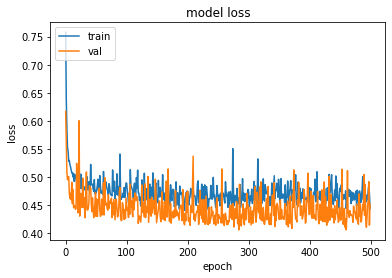

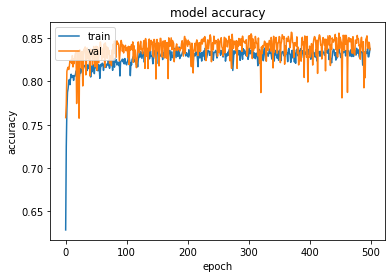

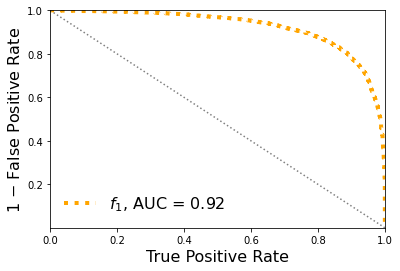

313/313 [==============================] - 3s 9ms/step - loss: 0.4592 - acc: 0.8362 - f1_m: 0.4410 - precision_m: 0.5004 - recall_m: 0.3957
Test ROC-AUC: 0.9227960799999999
Test loss: 0.45915693044662476
Test accuracy: 0.8361999988555908
Test f1: 0.44099941849708557
Test precision: 0.5003993511199951
Test recall: 0.3956669270992279
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.01
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 177ms/step - loss: 0.9564 - acc: 0.5987 - f1_m: 0.5874 - precision_m: 0.6027 - recall_m: 0.6036 - val_loss: 0.5651 - val_acc: 0.7820 - val_f1_m: 0.7964 - val_precision_m: 0.7418 - val_recall_m: 0.8624
Epoch 2/500
188/188 [==============================] - 32s 172ms/step - loss: 0.5995 - acc: 0.7595 - f1_m: 0.7659 - precision_m: 0.7458 - recall_m: 0.7938 - val_loss: 0.5460 - val_acc: 0.7832 - val_f1_m: 0.7581 - val_precision_m:

188/188 [==============================] - 32s 171ms/step - loss: 0.4306 - acc: 0.8434 - f1_m: 0.8435 - precision_m: 0.8329 - recall_m: 0.8595 - val_loss: 0.4208 - val_acc: 0.8472 - val_f1_m: 0.8528 - val_precision_m: 0.8158 - val_recall_m: 0.8964
Epoch 62/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4461 - acc: 0.8441 - f1_m: 0.8465 - precision_m: 0.8347 - recall_m: 0.8667 - val_loss: 0.4273 - val_acc: 0.8438 - val_f1_m: 0.8424 - val_precision_m: 0.8438 - val_recall_m: 0.8438
Epoch 63/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4296 - acc: 0.8483 - f1_m: 0.8470 - precision_m: 0.8347 - recall_m: 0.8641 - val_loss: 0.4300 - val_acc: 0.8352 - val_f1_m: 0.8259 - val_precision_m: 0.8672 - val_recall_m: 0.7909
Epoch 64/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4414 - acc: 0.8475 - f1_m: 0.8478 - precision_m: 0.8345 - recall_m: 0.8669 - val_loss: 0.4409 - val_acc: 0.8370 - val_f1_m: 0.8290 - val_precision_m:

188/188 [==============================] - 32s 170ms/step - loss: 0.6734 - acc: 0.7857 - f1_m: 0.7848 - precision_m: 0.7792 - recall_m: 0.8210 - val_loss: 0.4538 - val_acc: 0.8393 - val_f1_m: 0.8338 - val_precision_m: 0.8545 - val_recall_m: 0.8166
Epoch 124/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4542 - acc: 0.8490 - f1_m: 0.8488 - precision_m: 0.8436 - recall_m: 0.8598 - val_loss: 0.4253 - val_acc: 0.8482 - val_f1_m: 0.8426 - val_precision_m: 0.8648 - val_recall_m: 0.8234
Epoch 125/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4268 - acc: 0.8538 - f1_m: 0.8543 - precision_m: 0.8470 - recall_m: 0.8655 - val_loss: 0.4207 - val_acc: 0.8500 - val_f1_m: 0.8504 - val_precision_m: 0.8405 - val_recall_m: 0.8634
Epoch 126/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4232 - acc: 0.8535 - f1_m: 0.8524 - precision_m: 0.8517 - recall_m: 0.8569 - val_loss: 0.4192 - val_acc: 0.8390 - val_f1_m: 0.8284 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4221 - acc: 0.8558 - f1_m: 0.8570 - precision_m: 0.8493 - recall_m: 0.8699 - val_loss: 0.4093 - val_acc: 0.8520 - val_f1_m: 0.8518 - val_precision_m: 0.8464 - val_recall_m: 0.8601
Epoch 186/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4072 - acc: 0.8591 - f1_m: 0.8585 - precision_m: 0.8553 - recall_m: 0.8655 - val_loss: 0.4167 - val_acc: 0.8500 - val_f1_m: 0.8526 - val_precision_m: 0.8321 - val_recall_m: 0.8774
Epoch 187/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4204 - acc: 0.8520 - f1_m: 0.8526 - precision_m: 0.8461 - recall_m: 0.8654 - val_loss: 0.4044 - val_acc: 0.8495 - val_f1_m: 0.8478 - val_precision_m: 0.8507 - val_recall_m: 0.8481
Epoch 188/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4028 - acc: 0.8606 - f1_m: 0.8618 - precision_m: 0.8532 - recall_m: 0.8740 - val_loss: 0.4075 - val_acc: 0.8482 - val_f1_m: 0.8435 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4455 - acc: 0.8486 - f1_m: 0.8496 - precision_m: 0.8422 - recall_m: 0.8629 - val_loss: 0.4119 - val_acc: 0.8495 - val_f1_m: 0.8488 - val_precision_m: 0.8459 - val_recall_m: 0.8549
Epoch 248/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4092 - acc: 0.8581 - f1_m: 0.8590 - precision_m: 0.8538 - recall_m: 0.8680 - val_loss: 0.4244 - val_acc: 0.8355 - val_f1_m: 0.8222 - val_precision_m: 0.8849 - val_recall_m: 0.7703
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4091 - acc: 0.8574 - f1_m: 0.8586 - precision_m: 0.8548 - recall_m: 0.8679 - val_loss: 0.4107 - val_acc: 0.8493 - val_f1_m: 0.8458 - val_precision_m: 0.8597 - val_recall_m: 0.8352
Epoch 250/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4077 - acc: 0.8592 - f1_m: 0.8592 - precision_m: 0.8551 - recall_m: 0.8672 - val_loss: 0.4148 - val_acc: 0.8357 - val_f1_m: 0.8265 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4261 - acc: 0.8518 - f1_m: 0.8509 - precision_m: 0.8480 - recall_m: 0.8613 - val_loss: 0.4202 - val_acc: 0.8485 - val_f1_m: 0.8486 - val_precision_m: 0.8406 - val_recall_m: 0.8598
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4345 - acc: 0.8546 - f1_m: 0.8543 - precision_m: 0.8532 - recall_m: 0.8637 - val_loss: 0.4638 - val_acc: 0.8245 - val_f1_m: 0.8069 - val_precision_m: 0.8866 - val_recall_m: 0.7433
Epoch 311/500
188/188 [==============================] - 32s 170ms/step - loss: 0.6609 - acc: 0.7505 - f1_m: 0.7517 - precision_m: 0.7472 - recall_m: 0.7871 - val_loss: 0.5994 - val_acc: 0.7920 - val_f1_m: 0.8171 - val_precision_m: 0.7248 - val_recall_m: 0.9396
Epoch 312/500
188/188 [==============================] - 32s 170ms/step - loss: 0.5652 - acc: 0.8005 - f1_m: 0.8060 - precision_m: 0.7863 - recall_m: 0.8406 - val_loss: 0.4923 - val_acc: 0.8317 - val_f1_m: 0.8440 - val_precision

188/188 [==============================] - 33s 175ms/step - loss: 0.4313 - acc: 0.8539 - f1_m: 0.8537 - precision_m: 0.8521 - recall_m: 0.8605 - val_loss: 0.4141 - val_acc: 0.8537 - val_f1_m: 0.8523 - val_precision_m: 0.8532 - val_recall_m: 0.8548
Epoch 372/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4033 - acc: 0.8638 - f1_m: 0.8623 - precision_m: 0.8610 - recall_m: 0.8665 - val_loss: 0.4117 - val_acc: 0.8547 - val_f1_m: 0.8569 - val_precision_m: 0.8378 - val_recall_m: 0.8803
Epoch 373/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4029 - acc: 0.8601 - f1_m: 0.8576 - precision_m: 0.8569 - recall_m: 0.8621 - val_loss: 0.4233 - val_acc: 0.8348 - val_f1_m: 0.8261 - val_precision_m: 0.8658 - val_recall_m: 0.7939
Epoch 374/500
188/188 [==============================] - 33s 176ms/step - loss: 0.3963 - acc: 0.8647 - f1_m: 0.8638 - precision_m: 0.8635 - recall_m: 0.8675 - val_loss: 0.4284 - val_acc: 0.8445 - val_f1_m: 0.8376 - val_precision

188/188 [==============================] - 33s 176ms/step - loss: 0.4415 - acc: 0.8478 - f1_m: 0.8496 - precision_m: 0.8511 - recall_m: 0.8565 - val_loss: 0.4216 - val_acc: 0.8467 - val_f1_m: 0.8386 - val_precision_m: 0.8771 - val_recall_m: 0.8062
Epoch 434/500
188/188 [==============================] - 33s 177ms/step - loss: 0.4242 - acc: 0.8594 - f1_m: 0.8597 - precision_m: 0.8573 - recall_m: 0.8672 - val_loss: 0.4116 - val_acc: 0.8552 - val_f1_m: 0.8538 - val_precision_m: 0.8557 - val_recall_m: 0.8547
Epoch 435/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4060 - acc: 0.8565 - f1_m: 0.8562 - precision_m: 0.8495 - recall_m: 0.8675 - val_loss: 0.4291 - val_acc: 0.8492 - val_f1_m: 0.8557 - val_precision_m: 0.8132 - val_recall_m: 0.9063
Epoch 436/500
188/188 [==============================] - 33s 176ms/step - loss: 0.4235 - acc: 0.8560 - f1_m: 0.8577 - precision_m: 0.8527 - recall_m: 0.8675 - val_loss: 0.4487 - val_acc: 0.8495 - val_f1_m: 0.8491 - val_precision

188/188 [==============================] - 33s 174ms/step - loss: 0.4104 - acc: 0.8555 - f1_m: 0.8564 - precision_m: 0.8499 - recall_m: 0.8668 - val_loss: 0.4293 - val_acc: 0.8333 - val_f1_m: 0.8203 - val_precision_m: 0.8821 - val_recall_m: 0.7692
Epoch 496/500
188/188 [==============================] - 33s 175ms/step - loss: 0.4191 - acc: 0.8561 - f1_m: 0.8566 - precision_m: 0.8555 - recall_m: 0.8624 - val_loss: 0.4272 - val_acc: 0.8468 - val_f1_m: 0.8419 - val_precision_m: 0.8648 - val_recall_m: 0.8237
Epoch 497/500
188/188 [==============================] - 33s 174ms/step - loss: 0.4225 - acc: 0.8574 - f1_m: 0.8581 - precision_m: 0.8540 - recall_m: 0.8673 - val_loss: 0.4282 - val_acc: 0.8583 - val_f1_m: 0.8619 - val_precision_m: 0.8346 - val_recall_m: 0.8939
Epoch 498/500
188/188 [==============================] - 33s 174ms/step - loss: 0.4507 - acc: 0.8484 - f1_m: 0.8487 - precision_m: 0.8463 - recall_m: 0.8584 - val_loss: 0.4221 - val_acc: 0.8452 - val_f1_m: 0.8385 - val_precision

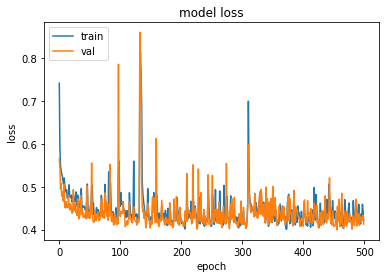

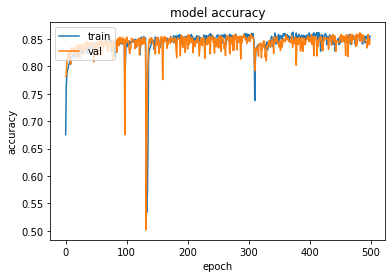

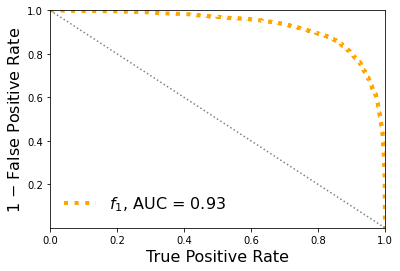

313/313 [==============================] - 3s 9ms/step - loss: 0.4209 - acc: 0.8524 - f1_m: 0.4510 - precision_m: 0.5005 - recall_m: 0.4116
Test ROC-AUC: 0.9294454400000001
Test loss: 0.4208510220050812
Test accuracy: 0.852400004863739
Test f1: 0.45102497935295105
Test precision: 0.5005325078964233
Test recall: 0.41164135932922363
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.01
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 359ms/step - loss: 0.8889 - acc: 0.5147 - f1_m: 0.5045 - precision_m: 0.5019 - recall_m: 0.5852 - val_loss: 0.7565 - val_acc: 0.6193 - val_f1_m: 0.4178 - val_precision_m: 0.8609 - val_recall_m: 0.2773
Epoch 2/500
94/94 [==============================] - 33s 354ms/step - loss: 0.7490 - acc: 0.5765 - f1_m: 0.5741 - precision_m: 0.5783 - recall_m: 0.5840 - val_loss: 0.7005 - val_acc: 0.7260 - val_f1_m: 0.7600 - val_precision_m: 0.66

Epoch 31/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4463 - acc: 0.8387 - f1_m: 0.8408 - precision_m: 0.8282 - recall_m: 0.8583 - val_loss: 0.4259 - val_acc: 0.8432 - val_f1_m: 0.8476 - val_precision_m: 0.8138 - val_recall_m: 0.8858
Epoch 32/500
94/94 [==============================] - 33s 356ms/step - loss: 0.4343 - acc: 0.8458 - f1_m: 0.8500 - precision_m: 0.8348 - recall_m: 0.8685 - val_loss: 0.4253 - val_acc: 0.8382 - val_f1_m: 0.8300 - val_precision_m: 0.8654 - val_recall_m: 0.7989
Epoch 33/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4530 - acc: 0.8320 - f1_m: 0.8349 - precision_m: 0.8220 - recall_m: 0.8554 - val_loss: 0.4251 - val_acc: 0.8357 - val_f1_m: 0.8270 - val_precision_m: 0.8676 - val_recall_m: 0.7919
Epoch 34/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4306 - acc: 0.8450 - f1_m: 0.8488 - precision_m: 0.8351 - recall_m: 0.8669 - val_loss: 0.4573 - val_acc: 0.8187 - val_f1_m: 0.8372 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 353ms/step - loss: 0.5075 - acc: 0.8115 - f1_m: 0.8129 - precision_m: 0.7913 - recall_m: 0.8544 - val_loss: 0.4671 - val_acc: 0.8398 - val_f1_m: 0.8388 - val_precision_m: 0.8359 - val_recall_m: 0.8438
Epoch 64/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4924 - acc: 0.8213 - f1_m: 0.8232 - precision_m: 0.8093 - recall_m: 0.8454 - val_loss: 0.4662 - val_acc: 0.8333 - val_f1_m: 0.8470 - val_precision_m: 0.7779 - val_recall_m: 0.9311
Epoch 65/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4612 - acc: 0.8336 - f1_m: 0.8365 - precision_m: 0.8244 - recall_m: 0.8548 - val_loss: 0.4312 - val_acc: 0.8442 - val_f1_m: 0.8396 - val_precision_m: 0.8507 - val_recall_m: 0.8310
Epoch 66/500
94/94 [==============================] - 33s 353ms/step - loss: 0.4511 - acc: 0.8324 - f1_m: 0.8358 - precision_m: 0.8275 - recall_m: 0.8488 - val_loss: 0.4235 - val_acc: 0.8473 - val_f1_m: 0.8523 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4541 - acc: 0.8457 - f1_m: 0.8492 - precision_m: 0.8313 - recall_m: 0.8750 - val_loss: 0.4562 - val_acc: 0.8425 - val_f1_m: 0.8547 - val_precision_m: 0.7866 - val_recall_m: 0.9370
Epoch 96/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4401 - acc: 0.8506 - f1_m: 0.8539 - precision_m: 0.8343 - recall_m: 0.8772 - val_loss: 0.4474 - val_acc: 0.8363 - val_f1_m: 0.8493 - val_precision_m: 0.7791 - val_recall_m: 0.9348
Epoch 97/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4323 - acc: 0.8470 - f1_m: 0.8474 - precision_m: 0.8269 - recall_m: 0.8744 - val_loss: 0.4162 - val_acc: 0.8522 - val_f1_m: 0.8559 - val_precision_m: 0.8228 - val_recall_m: 0.8934
Epoch 98/500
94/94 [==============================] - 33s 349ms/step - loss: 0.4336 - acc: 0.8478 - f1_m: 0.8504 - precision_m: 0.8306 - recall_m: 0.8763 - val_loss: 0.5012 - val_acc: 0.7977 - val_f1_m: 0.7648 - val_precisi

94/94 [==============================] - 33s 347ms/step - loss: 0.3839 - acc: 0.8671 - f1_m: 0.8695 - precision_m: 0.8523 - recall_m: 0.8898 - val_loss: 0.4041 - val_acc: 0.8525 - val_f1_m: 0.8481 - val_precision_m: 0.8608 - val_recall_m: 0.8377
Epoch 158/500
94/94 [==============================] - 33s 346ms/step - loss: 0.3936 - acc: 0.8592 - f1_m: 0.8623 - precision_m: 0.8506 - recall_m: 0.8785 - val_loss: 0.4048 - val_acc: 0.8558 - val_f1_m: 0.8559 - val_precision_m: 0.8451 - val_recall_m: 0.8689
Epoch 159/500
94/94 [==============================] - 33s 347ms/step - loss: 0.3780 - acc: 0.8724 - f1_m: 0.8739 - precision_m: 0.8599 - recall_m: 0.8906 - val_loss: 0.4086 - val_acc: 0.8552 - val_f1_m: 0.8554 - val_precision_m: 0.8435 - val_recall_m: 0.8694
Epoch 160/500
94/94 [==============================] - 33s 348ms/step - loss: 0.3894 - acc: 0.8710 - f1_m: 0.8745 - precision_m: 0.8592 - recall_m: 0.8931 - val_loss: 0.4566 - val_acc: 0.8367 - val_f1_m: 0.8272 - val_precision_m: 0.86

94/94 [==============================] - 33s 346ms/step - loss: 0.3868 - acc: 0.8689 - f1_m: 0.8708 - precision_m: 0.8604 - recall_m: 0.8838 - val_loss: 0.4154 - val_acc: 0.8492 - val_f1_m: 0.8467 - val_precision_m: 0.8516 - val_recall_m: 0.8433
Epoch 220/500
94/94 [==============================] - 32s 344ms/step - loss: 0.3805 - acc: 0.8721 - f1_m: 0.8731 - precision_m: 0.8602 - recall_m: 0.8888 - val_loss: 0.4225 - val_acc: 0.8497 - val_f1_m: 0.8443 - val_precision_m: 0.8624 - val_recall_m: 0.8287
Epoch 221/500
94/94 [==============================] - 32s 344ms/step - loss: 0.3880 - acc: 0.8712 - f1_m: 0.8738 - precision_m: 0.8595 - recall_m: 0.8920 - val_loss: 0.4148 - val_acc: 0.8465 - val_f1_m: 0.8416 - val_precision_m: 0.8630 - val_recall_m: 0.8230
Epoch 222/500
94/94 [==============================] - 32s 344ms/step - loss: 0.3976 - acc: 0.8684 - f1_m: 0.8703 - precision_m: 0.8589 - recall_m: 0.8866 - val_loss: 0.4609 - val_acc: 0.8442 - val_f1_m: 0.8520 - val_precision_m: 0.80

94/94 [==============================] - 32s 343ms/step - loss: 0.4010 - acc: 0.8703 - f1_m: 0.8712 - precision_m: 0.8631 - recall_m: 0.8828 - val_loss: 0.4279 - val_acc: 0.8527 - val_f1_m: 0.8484 - val_precision_m: 0.8635 - val_recall_m: 0.8355
Epoch 282/500
94/94 [==============================] - 32s 343ms/step - loss: 0.3749 - acc: 0.8805 - f1_m: 0.8821 - precision_m: 0.8773 - recall_m: 0.8889 - val_loss: 0.4216 - val_acc: 0.8528 - val_f1_m: 0.8499 - val_precision_m: 0.8569 - val_recall_m: 0.8445
Epoch 283/500
94/94 [==============================] - 32s 345ms/step - loss: 0.3835 - acc: 0.8768 - f1_m: 0.8767 - precision_m: 0.8760 - recall_m: 0.8803 - val_loss: 0.4292 - val_acc: 0.8513 - val_f1_m: 0.8507 - val_precision_m: 0.8427 - val_recall_m: 0.8603
Epoch 284/500
94/94 [==============================] - 32s 343ms/step - loss: 0.3849 - acc: 0.8737 - f1_m: 0.8743 - precision_m: 0.8693 - recall_m: 0.8817 - val_loss: 0.4172 - val_acc: 0.8570 - val_f1_m: 0.8575 - val_precision_m: 0.84

94/94 [==============================] - 32s 342ms/step - loss: 0.6603 - acc: 0.7777 - f1_m: 0.7854 - precision_m: 0.7639 - recall_m: 0.8212 - val_loss: 0.5205 - val_acc: 0.8345 - val_f1_m: 0.8344 - val_precision_m: 0.8243 - val_recall_m: 0.8463
Epoch 344/500
94/94 [==============================] - 32s 342ms/step - loss: 0.5246 - acc: 0.8284 - f1_m: 0.8333 - precision_m: 0.8124 - recall_m: 0.8605 - val_loss: 0.4545 - val_acc: 0.8490 - val_f1_m: 0.8493 - val_precision_m: 0.8392 - val_recall_m: 0.8613
Epoch 345/500
94/94 [==============================] - 32s 342ms/step - loss: 0.4809 - acc: 0.8355 - f1_m: 0.8374 - precision_m: 0.8259 - recall_m: 0.8533 - val_loss: 0.4331 - val_acc: 0.8488 - val_f1_m: 0.8440 - val_precision_m: 0.8576 - val_recall_m: 0.8325
Epoch 346/500
94/94 [==============================] - 32s 344ms/step - loss: 0.4427 - acc: 0.8527 - f1_m: 0.8549 - precision_m: 0.8433 - recall_m: 0.8703 - val_loss: 0.4285 - val_acc: 0.8572 - val_f1_m: 0.8621 - val_precision_m: 0.81

94/94 [==============================] - 32s 342ms/step - loss: 0.3928 - acc: 0.8689 - f1_m: 0.8705 - precision_m: 0.8644 - recall_m: 0.8799 - val_loss: 0.4107 - val_acc: 0.8507 - val_f1_m: 0.8453 - val_precision_m: 0.8551 - val_recall_m: 0.8376
Epoch 406/500
94/94 [==============================] - 32s 344ms/step - loss: 0.3953 - acc: 0.8660 - f1_m: 0.8654 - precision_m: 0.8648 - recall_m: 0.8692 - val_loss: 0.4154 - val_acc: 0.8563 - val_f1_m: 0.8580 - val_precision_m: 0.8312 - val_recall_m: 0.8880
Epoch 407/500
94/94 [==============================] - 32s 341ms/step - loss: 0.3784 - acc: 0.8731 - f1_m: 0.8735 - precision_m: 0.8639 - recall_m: 0.8863 - val_loss: 0.4169 - val_acc: 0.8463 - val_f1_m: 0.8404 - val_precision_m: 0.8623 - val_recall_m: 0.8209
Epoch 408/500
94/94 [==============================] - 32s 342ms/step - loss: 0.3791 - acc: 0.8744 - f1_m: 0.8744 - precision_m: 0.8743 - recall_m: 0.8764 - val_loss: 0.4505 - val_acc: 0.8305 - val_f1_m: 0.8139 - val_precision_m: 0.89

94/94 [==============================] - 32s 340ms/step - loss: 0.3788 - acc: 0.8761 - f1_m: 0.8768 - precision_m: 0.8730 - recall_m: 0.8831 - val_loss: 0.4279 - val_acc: 0.8488 - val_f1_m: 0.8423 - val_precision_m: 0.8673 - val_recall_m: 0.8205
Epoch 468/500
94/94 [==============================] - 32s 340ms/step - loss: 0.3704 - acc: 0.8801 - f1_m: 0.8789 - precision_m: 0.8826 - recall_m: 0.8779 - val_loss: 0.5749 - val_acc: 0.7693 - val_f1_m: 0.7179 - val_precision_m: 0.9111 - val_recall_m: 0.5937
Epoch 469/500
94/94 [==============================] - 32s 341ms/step - loss: 0.4865 - acc: 0.8392 - f1_m: 0.8378 - precision_m: 0.8339 - recall_m: 0.8529 - val_loss: 0.4717 - val_acc: 0.8303 - val_f1_m: 0.8148 - val_precision_m: 0.8848 - val_recall_m: 0.7567
Epoch 470/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4258 - acc: 0.8592 - f1_m: 0.8595 - precision_m: 0.8577 - recall_m: 0.8651 - val_loss: 0.4313 - val_acc: 0.8423 - val_f1_m: 0.8343 - val_precision_m: 0.86

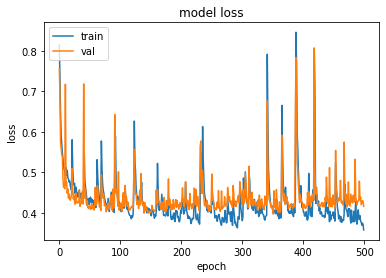

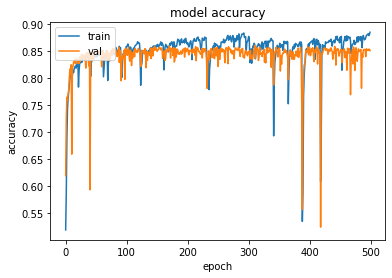

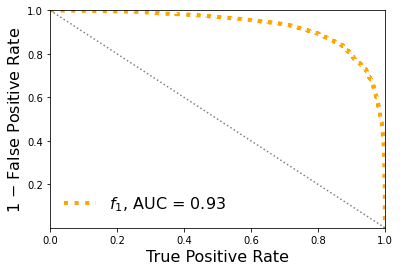

313/313 [==============================] - 3s 9ms/step - loss: 0.4200 - acc: 0.8515 - f1_m: 0.4571 - precision_m: 0.5003 - recall_m: 0.4222
Test ROC-AUC: 0.92915812
Test loss: 0.42004525661468506
Test accuracy: 0.8514999747276306
Test f1: 0.4571097791194916
Test precision: 0.5002662539482117
Test recall: 0.4222244322299957
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.1
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 34s 89ms/step - loss: 1.2396 - acc: 0.6127 - f1_m: 0.6004 - precision_m: 0.6136 - recall_m: 0.6308 - val_loss: 0.5956 - val_acc: 0.7830 - val_f1_m: 0.7864 - val_precision_m: 0.7616 - val_recall_m: 0.8185
Epoch 2/500
375/375 [==============================] - 33s 88ms/step - loss: 0.6246 - acc: 0.7613 - f1_m: 0.7590 - precision_m: 0.7681 - recall_m: 0.7665 - val_loss: 0.5705 - val_acc: 0.7890 - val_f1_m: 0.8104 - val_precision_m: 0.7278 - val

Epoch 31/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4900 - acc: 0.8199 - f1_m: 0.8182 - precision_m: 0.8183 - recall_m: 0.8284 - val_loss: 0.4595 - val_acc: 0.8335 - val_f1_m: 0.8283 - val_precision_m: 0.8439 - val_recall_m: 0.8173
Epoch 32/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4923 - acc: 0.8197 - f1_m: 0.8171 - precision_m: 0.8205 - recall_m: 0.8247 - val_loss: 0.4980 - val_acc: 0.7863 - val_f1_m: 0.7511 - val_precision_m: 0.8852 - val_recall_m: 0.6567
Epoch 33/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4889 - acc: 0.8237 - f1_m: 0.8231 - precision_m: 0.8232 - recall_m: 0.8338 - val_loss: 0.4776 - val_acc: 0.8352 - val_f1_m: 0.8366 - val_precision_m: 0.8165 - val_recall_m: 0.8625
Epoch 34/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4957 - acc: 0.8154 - f1_m: 0.8102 - precision_m: 0.8138 - recall_m: 0.8200 - val_loss: 0.4433 - val_acc: 0.8392 - val_f1_m: 0.8433 - val_pre

375/375 [==============================] - 33s 87ms/step - loss: 0.4844 - acc: 0.8247 - f1_m: 0.8255 - precision_m: 0.8170 - recall_m: 0.8447 - val_loss: 0.4564 - val_acc: 0.8355 - val_f1_m: 0.8470 - val_precision_m: 0.7804 - val_recall_m: 0.9311
Epoch 94/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4931 - acc: 0.8187 - f1_m: 0.8158 - precision_m: 0.8155 - recall_m: 0.8325 - val_loss: 0.4504 - val_acc: 0.8410 - val_f1_m: 0.8396 - val_precision_m: 0.8364 - val_recall_m: 0.8475
Epoch 95/500
375/375 [==============================] - 33s 88ms/step - loss: 0.4682 - acc: 0.8309 - f1_m: 0.8337 - precision_m: 0.8198 - recall_m: 0.8570 - val_loss: 0.4343 - val_acc: 0.8470 - val_f1_m: 0.8494 - val_precision_m: 0.8246 - val_recall_m: 0.8805
Epoch 96/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4655 - acc: 0.8305 - f1_m: 0.8271 - precision_m: 0.8249 - recall_m: 0.8380 - val_loss: 0.4376 - val_acc: 0.8425 - val_f1_m: 0.8432 - val_precision_m: 0.8

375/375 [==============================] - 33s 87ms/step - loss: 0.4797 - acc: 0.8220 - f1_m: 0.8237 - precision_m: 0.8162 - recall_m: 0.8441 - val_loss: 0.4283 - val_acc: 0.8463 - val_f1_m: 0.8500 - val_precision_m: 0.8163 - val_recall_m: 0.8911
Epoch 156/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4547 - acc: 0.8379 - f1_m: 0.8386 - precision_m: 0.8289 - recall_m: 0.8562 - val_loss: 0.4480 - val_acc: 0.8378 - val_f1_m: 0.8475 - val_precision_m: 0.7889 - val_recall_m: 0.9205
Epoch 157/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4829 - acc: 0.8205 - f1_m: 0.8214 - precision_m: 0.8084 - recall_m: 0.8477 - val_loss: 0.4281 - val_acc: 0.8442 - val_f1_m: 0.8421 - val_precision_m: 0.8421 - val_recall_m: 0.8469
Epoch 158/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4668 - acc: 0.8284 - f1_m: 0.8285 - precision_m: 0.8195 - recall_m: 0.8484 - val_loss: 0.4391 - val_acc: 0.8438 - val_f1_m: 0.8478 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4634 - acc: 0.8352 - f1_m: 0.8359 - precision_m: 0.8214 - recall_m: 0.8601 - val_loss: 0.4449 - val_acc: 0.8147 - val_f1_m: 0.7909 - val_precision_m: 0.8896 - val_recall_m: 0.7177
Epoch 218/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4563 - acc: 0.8343 - f1_m: 0.8354 - precision_m: 0.8266 - recall_m: 0.8522 - val_loss: 0.4192 - val_acc: 0.8523 - val_f1_m: 0.8520 - val_precision_m: 0.8394 - val_recall_m: 0.8689
Epoch 219/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4730 - acc: 0.8299 - f1_m: 0.8310 - precision_m: 0.8231 - recall_m: 0.8524 - val_loss: 0.4108 - val_acc: 0.8500 - val_f1_m: 0.8475 - val_precision_m: 0.8527 - val_recall_m: 0.8473
Epoch 220/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4419 - acc: 0.8413 - f1_m: 0.8410 - precision_m: 0.8292 - recall_m: 0.8600 - val_loss: 0.4638 - val_acc: 0.8210 - val_f1_m: 0.8014 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4698 - acc: 0.8271 - f1_m: 0.8242 - precision_m: 0.8276 - recall_m: 0.8344 - val_loss: 0.4231 - val_acc: 0.8398 - val_f1_m: 0.8320 - val_precision_m: 0.8609 - val_recall_m: 0.8095
Epoch 280/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4674 - acc: 0.8294 - f1_m: 0.8303 - precision_m: 0.8222 - recall_m: 0.8490 - val_loss: 0.4227 - val_acc: 0.8447 - val_f1_m: 0.8408 - val_precision_m: 0.8490 - val_recall_m: 0.8373
Epoch 281/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4647 - acc: 0.8305 - f1_m: 0.8328 - precision_m: 0.8259 - recall_m: 0.8503 - val_loss: 0.4290 - val_acc: 0.8487 - val_f1_m: 0.8500 - val_precision_m: 0.8304 - val_recall_m: 0.8749
Epoch 282/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4620 - acc: 0.8331 - f1_m: 0.8320 - precision_m: 0.8238 - recall_m: 0.8512 - val_loss: 0.4596 - val_acc: 0.8098 - val_f1_m: 0.7862 - val_precision_m: 

375/375 [==============================] - 32s 87ms/step - loss: 0.4627 - acc: 0.8337 - f1_m: 0.8341 - precision_m: 0.8267 - recall_m: 0.8514 - val_loss: 0.4377 - val_acc: 0.8457 - val_f1_m: 0.8529 - val_precision_m: 0.8043 - val_recall_m: 0.9128
Epoch 342/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4619 - acc: 0.8313 - f1_m: 0.8310 - precision_m: 0.8256 - recall_m: 0.8470 - val_loss: 0.4402 - val_acc: 0.8392 - val_f1_m: 0.8314 - val_precision_m: 0.8589 - val_recall_m: 0.8099
Epoch 343/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4755 - acc: 0.8307 - f1_m: 0.8321 - precision_m: 0.8180 - recall_m: 0.8577 - val_loss: 0.4262 - val_acc: 0.8400 - val_f1_m: 0.8325 - val_precision_m: 0.8592 - val_recall_m: 0.8121
Epoch 344/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4586 - acc: 0.8359 - f1_m: 0.8368 - precision_m: 0.8261 - recall_m: 0.8568 - val_loss: 0.4242 - val_acc: 0.8452 - val_f1_m: 0.8426 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4853 - acc: 0.8272 - f1_m: 0.8263 - precision_m: 0.8201 - recall_m: 0.8493 - val_loss: 0.4343 - val_acc: 0.8502 - val_f1_m: 0.8549 - val_precision_m: 0.8144 - val_recall_m: 0.9042
Epoch 404/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4578 - acc: 0.8374 - f1_m: 0.8390 - precision_m: 0.8191 - recall_m: 0.8680 - val_loss: 0.5694 - val_acc: 0.7897 - val_f1_m: 0.8198 - val_precision_m: 0.7092 - val_recall_m: 0.9780
Epoch 405/500
375/375 [==============================] - 32s 87ms/step - loss: 0.4618 - acc: 0.8379 - f1_m: 0.8412 - precision_m: 0.8281 - recall_m: 0.8656 - val_loss: 0.4195 - val_acc: 0.8487 - val_f1_m: 0.8532 - val_precision_m: 0.8136 - val_recall_m: 0.9012
Epoch 406/500
375/375 [==============================] - 33s 87ms/step - loss: 0.5121 - acc: 0.8128 - f1_m: 0.8080 - precision_m: 0.8061 - recall_m: 0.8279 - val_loss: 0.4440 - val_acc: 0.8422 - val_f1_m: 0.8393 - val_precision_m: 

375/375 [==============================] - 33s 87ms/step - loss: 0.4752 - acc: 0.8270 - f1_m: 0.8280 - precision_m: 0.8168 - recall_m: 0.8528 - val_loss: 0.4484 - val_acc: 0.8268 - val_f1_m: 0.8088 - val_precision_m: 0.8854 - val_recall_m: 0.7496
Epoch 466/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4449 - acc: 0.8413 - f1_m: 0.8426 - precision_m: 0.8317 - recall_m: 0.8620 - val_loss: 0.4272 - val_acc: 0.8512 - val_f1_m: 0.8533 - val_precision_m: 0.8309 - val_recall_m: 0.8820
Epoch 467/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4572 - acc: 0.8348 - f1_m: 0.8328 - precision_m: 0.8310 - recall_m: 0.8468 - val_loss: 0.4263 - val_acc: 0.8500 - val_f1_m: 0.8499 - val_precision_m: 0.8356 - val_recall_m: 0.8688
Epoch 468/500
375/375 [==============================] - 33s 87ms/step - loss: 0.4640 - acc: 0.8327 - f1_m: 0.8325 - precision_m: 0.8245 - recall_m: 0.8523 - val_loss: 0.4236 - val_acc: 0.8485 - val_f1_m: 0.8500 - val_precision_m: 

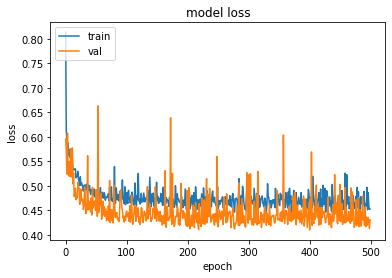

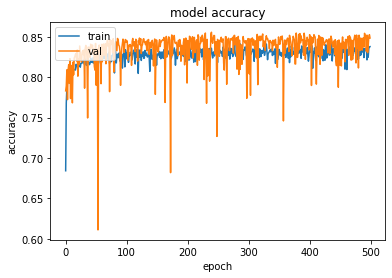

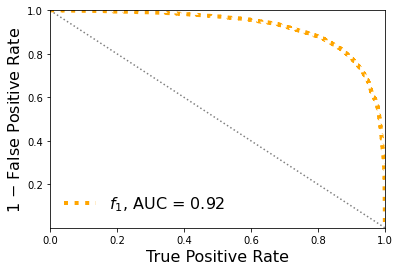

313/313 [==============================] - 3s 9ms/step - loss: 0.4372 - acc: 0.8447 - f1_m: 0.4663 - precision_m: 0.5000 - recall_m: 0.4380
Test ROC-AUC: 0.9233800799999999
Test loss: 0.43721798062324524
Test accuracy: 0.8446999788284302
Test f1: 0.46627962589263916
Test precision: 0.5
Test recall: 0.4379991888999939
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.1
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 34s 178ms/step - loss: 1.5633 - acc: 0.5391 - f1_m: 0.5501 - precision_m: 0.5343 - recall_m: 0.5995 - val_loss: 0.6143 - val_acc: 0.7565 - val_f1_m: 0.7612 - val_precision_m: 0.7392 - val_recall_m: 0.7873
Epoch 2/500
188/188 [==============================] - 32s 171ms/step - loss: 0.6399 - acc: 0.7438 - f1_m: 0.7488 - precision_m: 0.7343 - recall_m: 0.7732 - val_loss: 0.5776 - val_acc: 0.7735 - val_f1_m: 0.8023 - val_precision_m: 0.7071 - val_re

188/188 [==============================] - 32s 172ms/step - loss: 0.4432 - acc: 0.8409 - f1_m: 0.8443 - precision_m: 0.8270 - recall_m: 0.8681 - val_loss: 0.4904 - val_acc: 0.8268 - val_f1_m: 0.8447 - val_precision_m: 0.7591 - val_recall_m: 0.9548
Epoch 62/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4668 - acc: 0.8285 - f1_m: 0.8313 - precision_m: 0.8124 - recall_m: 0.8603 - val_loss: 0.4785 - val_acc: 0.8225 - val_f1_m: 0.8403 - val_precision_m: 0.7578 - val_recall_m: 0.9462
Epoch 63/500
188/188 [==============================] - 32s 171ms/step - loss: 0.5693 - acc: 0.7975 - f1_m: 0.8046 - precision_m: 0.7906 - recall_m: 0.8425 - val_loss: 0.4423 - val_acc: 0.8428 - val_f1_m: 0.8444 - val_precision_m: 0.8293 - val_recall_m: 0.8629
Epoch 64/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4593 - acc: 0.8419 - f1_m: 0.8458 - precision_m: 0.8263 - recall_m: 0.8723 - val_loss: 0.4394 - val_acc: 0.8453 - val_f1_m: 0.8441 - val_precision_m:

188/188 [==============================] - 32s 169ms/step - loss: 0.4369 - acc: 0.8456 - f1_m: 0.8493 - precision_m: 0.8289 - recall_m: 0.8754 - val_loss: 0.4192 - val_acc: 0.8498 - val_f1_m: 0.8538 - val_precision_m: 0.8245 - val_recall_m: 0.8879
Epoch 124/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4458 - acc: 0.8366 - f1_m: 0.8428 - precision_m: 0.8270 - recall_m: 0.8660 - val_loss: 0.4292 - val_acc: 0.8327 - val_f1_m: 0.8201 - val_precision_m: 0.8801 - val_recall_m: 0.7706
Epoch 125/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4146 - acc: 0.8514 - f1_m: 0.8535 - precision_m: 0.8358 - recall_m: 0.8765 - val_loss: 0.4128 - val_acc: 0.8475 - val_f1_m: 0.8457 - val_precision_m: 0.8485 - val_recall_m: 0.8456
Epoch 126/500
188/188 [==============================] - 32s 171ms/step - loss: 0.4302 - acc: 0.8413 - f1_m: 0.8446 - precision_m: 0.8296 - recall_m: 0.8643 - val_loss: 0.4218 - val_acc: 0.8460 - val_f1_m: 0.8539 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4513 - acc: 0.8382 - f1_m: 0.8413 - precision_m: 0.8285 - recall_m: 0.8626 - val_loss: 0.4169 - val_acc: 0.8427 - val_f1_m: 0.8340 - val_precision_m: 0.8728 - val_recall_m: 0.8012
Epoch 186/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4267 - acc: 0.8491 - f1_m: 0.8495 - precision_m: 0.8370 - recall_m: 0.8672 - val_loss: 0.4220 - val_acc: 0.8478 - val_f1_m: 0.8492 - val_precision_m: 0.8350 - val_recall_m: 0.8664
Epoch 187/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4343 - acc: 0.8405 - f1_m: 0.8443 - precision_m: 0.8292 - recall_m: 0.8662 - val_loss: 0.4189 - val_acc: 0.8438 - val_f1_m: 0.8526 - val_precision_m: 0.7998 - val_recall_m: 0.9153
Epoch 188/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4270 - acc: 0.8440 - f1_m: 0.8486 - precision_m: 0.8250 - recall_m: 0.8796 - val_loss: 0.4147 - val_acc: 0.8447 - val_f1_m: 0.8399 - val_precision

188/188 [==============================] - 32s 170ms/step - loss: 0.4335 - acc: 0.8400 - f1_m: 0.8447 - precision_m: 0.8251 - recall_m: 0.8713 - val_loss: 0.4264 - val_acc: 0.8458 - val_f1_m: 0.8407 - val_precision_m: 0.8617 - val_recall_m: 0.8235
Epoch 248/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4445 - acc: 0.8377 - f1_m: 0.8407 - precision_m: 0.8201 - recall_m: 0.8699 - val_loss: 0.4072 - val_acc: 0.8520 - val_f1_m: 0.8541 - val_precision_m: 0.8361 - val_recall_m: 0.8757
Epoch 249/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4256 - acc: 0.8458 - f1_m: 0.8479 - precision_m: 0.8286 - recall_m: 0.8734 - val_loss: 0.4161 - val_acc: 0.8395 - val_f1_m: 0.8326 - val_precision_m: 0.8628 - val_recall_m: 0.8073
Epoch 250/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4332 - acc: 0.8395 - f1_m: 0.8409 - precision_m: 0.8288 - recall_m: 0.8610 - val_loss: 0.4380 - val_acc: 0.8292 - val_f1_m: 0.8120 - val_precision

188/188 [==============================] - 31s 167ms/step - loss: 0.4911 - acc: 0.8179 - f1_m: 0.8285 - precision_m: 0.7977 - recall_m: 0.8740 - val_loss: 0.4058 - val_acc: 0.8507 - val_f1_m: 0.8562 - val_precision_m: 0.8200 - val_recall_m: 0.8985
Epoch 310/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4174 - acc: 0.8510 - f1_m: 0.8536 - precision_m: 0.8314 - recall_m: 0.8800 - val_loss: 0.4051 - val_acc: 0.8523 - val_f1_m: 0.8544 - val_precision_m: 0.8366 - val_recall_m: 0.8760
Epoch 311/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4331 - acc: 0.8459 - f1_m: 0.8498 - precision_m: 0.8301 - recall_m: 0.8803 - val_loss: 0.4340 - val_acc: 0.8363 - val_f1_m: 0.8502 - val_precision_m: 0.7768 - val_recall_m: 0.9415
Epoch 312/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4411 - acc: 0.8425 - f1_m: 0.8445 - precision_m: 0.8267 - recall_m: 0.8718 - val_loss: 0.4240 - val_acc: 0.8373 - val_f1_m: 0.8530 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4143 - acc: 0.8528 - f1_m: 0.8555 - precision_m: 0.8351 - recall_m: 0.8802 - val_loss: 0.4066 - val_acc: 0.8462 - val_f1_m: 0.8566 - val_precision_m: 0.7961 - val_recall_m: 0.9299
Epoch 372/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4150 - acc: 0.8494 - f1_m: 0.8532 - precision_m: 0.8327 - recall_m: 0.8789 - val_loss: 0.4168 - val_acc: 0.8390 - val_f1_m: 0.8267 - val_precision_m: 0.8870 - val_recall_m: 0.7767
Epoch 373/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4161 - acc: 0.8483 - f1_m: 0.8515 - precision_m: 0.8391 - recall_m: 0.8697 - val_loss: 0.5652 - val_acc: 0.7347 - val_f1_m: 0.7871 - val_precision_m: 0.6541 - val_recall_m: 0.9915
Epoch 374/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4613 - acc: 0.8293 - f1_m: 0.8330 - precision_m: 0.8195 - recall_m: 0.8615 - val_loss: 0.4075 - val_acc: 0.8503 - val_f1_m: 0.8489 - val_precision

188/188 [==============================] - 32s 169ms/step - loss: 0.4452 - acc: 0.8384 - f1_m: 0.8397 - precision_m: 0.8258 - recall_m: 0.8631 - val_loss: 0.4149 - val_acc: 0.8522 - val_f1_m: 0.8512 - val_precision_m: 0.8507 - val_recall_m: 0.8546
Epoch 434/500
188/188 [==============================] - 31s 167ms/step - loss: 0.4240 - acc: 0.8482 - f1_m: 0.8514 - precision_m: 0.8283 - recall_m: 0.8800 - val_loss: 0.3938 - val_acc: 0.8588 - val_f1_m: 0.8630 - val_precision_m: 0.8312 - val_recall_m: 0.8998
Epoch 435/500
188/188 [==============================] - 32s 169ms/step - loss: 0.5214 - acc: 0.8018 - f1_m: 0.8084 - precision_m: 0.7939 - recall_m: 0.8459 - val_loss: 0.4321 - val_acc: 0.8445 - val_f1_m: 0.8526 - val_precision_m: 0.8046 - val_recall_m: 0.9094
Epoch 436/500
188/188 [==============================] - 32s 169ms/step - loss: 0.4517 - acc: 0.8388 - f1_m: 0.8416 - precision_m: 0.8197 - recall_m: 0.8713 - val_loss: 0.4071 - val_acc: 0.8540 - val_f1_m: 0.8524 - val_precision

188/188 [==============================] - 32s 171ms/step - loss: 0.4418 - acc: 0.8386 - f1_m: 0.8437 - precision_m: 0.8226 - recall_m: 0.8729 - val_loss: 0.4157 - val_acc: 0.8475 - val_f1_m: 0.8426 - val_precision_m: 0.8623 - val_recall_m: 0.8264
Epoch 496/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4284 - acc: 0.8448 - f1_m: 0.8481 - precision_m: 0.8298 - recall_m: 0.8728 - val_loss: 0.3981 - val_acc: 0.8543 - val_f1_m: 0.8554 - val_precision_m: 0.8426 - val_recall_m: 0.8715
Epoch 497/500
188/188 [==============================] - 32s 172ms/step - loss: 0.4186 - acc: 0.8501 - f1_m: 0.8548 - precision_m: 0.8334 - recall_m: 0.8821 - val_loss: 0.4090 - val_acc: 0.8530 - val_f1_m: 0.8577 - val_precision_m: 0.8246 - val_recall_m: 0.8965
Epoch 498/500
188/188 [==============================] - 32s 170ms/step - loss: 0.4123 - acc: 0.8513 - f1_m: 0.8521 - precision_m: 0.8390 - recall_m: 0.8719 - val_loss: 0.4036 - val_acc: 0.8502 - val_f1_m: 0.8554 - val_precision

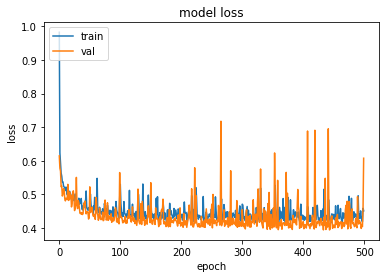

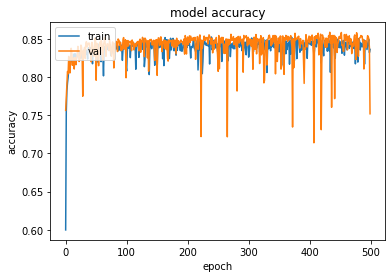

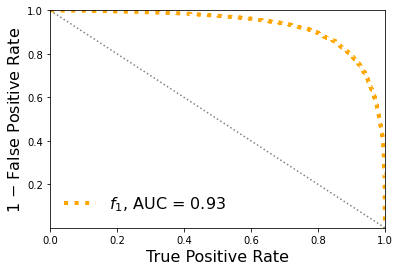

313/313 [==============================] - 3s 9ms/step - loss: 0.6103 - acc: 0.7421 - f1_m: 0.4959 - precision_m: 0.4997 - recall_m: 0.4932
Test ROC-AUC: 0.9290267
Test loss: 0.6103042364120483
Test accuracy: 0.7421000003814697
Test f1: 0.4959203004837036
Test precision: 0.4996804893016815
Test recall: 0.4932108521461487
 
############################### 

###############################
 TESTING: 
conv_layers :  1
conv_filters :  24
learning_rate :  0.01
alpha_value :  0.1
batch_size :  256
 
Epoch 1/500
94/94 [==============================] - 35s 362ms/step - loss: 1.8160 - acc: 0.5055 - f1_m: 0.5484 - precision_m: 0.5089 - recall_m: 0.6390 - val_loss: 0.8241 - val_acc: 0.4972 - val_f1_m: 0.6624 - val_precision_m: 0.4960 - val_recall_m: 1.0000
Epoch 2/500
94/94 [==============================] - 33s 353ms/step - loss: 0.8278 - acc: 0.5417 - f1_m: 0.5745 - precision_m: 0.5360 - recall_m: 0.6226 - val_loss: 0.6721 - val_acc: 0.7177 - val_f1_m: 0.7534 - val_precision_m: 0.6622 - val_re

Epoch 31/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4753 - acc: 0.8392 - f1_m: 0.8429 - precision_m: 0.8272 - recall_m: 0.8638 - val_loss: 0.4833 - val_acc: 0.8248 - val_f1_m: 0.8399 - val_precision_m: 0.7644 - val_recall_m: 0.9339
Epoch 32/500
94/94 [==============================] - 33s 352ms/step - loss: 0.4691 - acc: 0.8398 - f1_m: 0.8418 - precision_m: 0.8200 - recall_m: 0.8692 - val_loss: 0.4616 - val_acc: 0.8367 - val_f1_m: 0.8383 - val_precision_m: 0.8218 - val_recall_m: 0.8574
Epoch 33/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4658 - acc: 0.8395 - f1_m: 0.8436 - precision_m: 0.8180 - recall_m: 0.8743 - val_loss: 0.4641 - val_acc: 0.8407 - val_f1_m: 0.8434 - val_precision_m: 0.8206 - val_recall_m: 0.8689
Epoch 34/500
94/94 [==============================] - 33s 351ms/step - loss: 0.4653 - acc: 0.8451 - f1_m: 0.8479 - precision_m: 0.8306 - recall_m: 0.8701 - val_loss: 0.4566 - val_acc: 0.8448 - val_f1_m: 0.8444 - val_precisi

Epoch 63/500
94/94 [==============================] - 33s 350ms/step - loss: 0.4387 - acc: 0.8490 - f1_m: 0.8528 - precision_m: 0.8305 - recall_m: 0.8801 - val_loss: 0.5006 - val_acc: 0.8128 - val_f1_m: 0.8345 - val_precision_m: 0.7382 - val_recall_m: 0.9614
Epoch 64/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4700 - acc: 0.8297 - f1_m: 0.8366 - precision_m: 0.8148 - recall_m: 0.8700 - val_loss: 0.4618 - val_acc: 0.8437 - val_f1_m: 0.8450 - val_precision_m: 0.8316 - val_recall_m: 0.8605
Epoch 65/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4598 - acc: 0.8416 - f1_m: 0.8466 - precision_m: 0.8272 - recall_m: 0.8727 - val_loss: 0.5195 - val_acc: 0.8058 - val_f1_m: 0.7847 - val_precision_m: 0.8670 - val_recall_m: 0.7183
Epoch 66/500
94/94 [==============================] - 33s 349ms/step - loss: 0.5253 - acc: 0.8106 - f1_m: 0.8158 - precision_m: 0.8067 - recall_m: 0.8391 - val_loss: 0.4459 - val_acc: 0.8458 - val_f1_m: 0.8514 - val_precisi

Epoch 95/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4239 - acc: 0.8545 - f1_m: 0.8589 - precision_m: 0.8338 - recall_m: 0.8885 - val_loss: 0.4375 - val_acc: 0.8397 - val_f1_m: 0.8333 - val_precision_m: 0.8563 - val_recall_m: 0.8127
Epoch 96/500
94/94 [==============================] - 33s 348ms/step - loss: 0.4285 - acc: 0.8532 - f1_m: 0.8573 - precision_m: 0.8391 - recall_m: 0.8789 - val_loss: 0.4285 - val_acc: 0.8465 - val_f1_m: 0.8522 - val_precision_m: 0.8103 - val_recall_m: 0.9002
Epoch 97/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4339 - acc: 0.8474 - f1_m: 0.8523 - precision_m: 0.8350 - recall_m: 0.8764 - val_loss: 0.4919 - val_acc: 0.8167 - val_f1_m: 0.7995 - val_precision_m: 0.8729 - val_recall_m: 0.7395
Epoch 98/500
94/94 [==============================] - 33s 346ms/step - loss: 0.4696 - acc: 0.8313 - f1_m: 0.8334 - precision_m: 0.8187 - recall_m: 0.8563 - val_loss: 0.4397 - val_acc: 0.8342 - val_f1_m: 0.8288 - val_precisi

94/94 [==============================] - 32s 343ms/step - loss: 0.4044 - acc: 0.8585 - f1_m: 0.8599 - precision_m: 0.8450 - recall_m: 0.8776 - val_loss: 0.4324 - val_acc: 0.8357 - val_f1_m: 0.8310 - val_precision_m: 0.8442 - val_recall_m: 0.8199
Epoch 158/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4009 - acc: 0.8589 - f1_m: 0.8631 - precision_m: 0.8441 - recall_m: 0.8862 - val_loss: 0.4171 - val_acc: 0.8510 - val_f1_m: 0.8526 - val_precision_m: 0.8327 - val_recall_m: 0.8750
Epoch 159/500
94/94 [==============================] - 32s 345ms/step - loss: 0.3951 - acc: 0.8617 - f1_m: 0.8650 - precision_m: 0.8457 - recall_m: 0.8886 - val_loss: 0.4337 - val_acc: 0.8452 - val_f1_m: 0.8458 - val_precision_m: 0.8311 - val_recall_m: 0.8626
Epoch 160/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4677 - acc: 0.8314 - f1_m: 0.8343 - precision_m: 0.8200 - recall_m: 0.8600 - val_loss: 0.4240 - val_acc: 0.8475 - val_f1_m: 0.8532 - val_precision_m: 0.81

94/94 [==============================] - 32s 346ms/step - loss: 0.4069 - acc: 0.8550 - f1_m: 0.8583 - precision_m: 0.8367 - recall_m: 0.8843 - val_loss: 0.4187 - val_acc: 0.8468 - val_f1_m: 0.8535 - val_precision_m: 0.8066 - val_recall_m: 0.9079
Epoch 220/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4468 - acc: 0.8359 - f1_m: 0.8398 - precision_m: 0.8197 - recall_m: 0.8727 - val_loss: 0.7070 - val_acc: 0.6798 - val_f1_m: 0.5460 - val_precision_m: 0.9263 - val_recall_m: 0.3888
Epoch 221/500
94/94 [==============================] - 32s 343ms/step - loss: 0.6529 - acc: 0.7366 - f1_m: 0.7549 - precision_m: 0.7206 - recall_m: 0.8223 - val_loss: 0.5253 - val_acc: 0.7940 - val_f1_m: 0.8203 - val_precision_m: 0.7207 - val_recall_m: 0.9545
Epoch 222/500
94/94 [==============================] - 32s 343ms/step - loss: 0.5183 - acc: 0.8101 - f1_m: 0.8184 - precision_m: 0.7893 - recall_m: 0.8576 - val_loss: 0.4348 - val_acc: 0.8475 - val_f1_m: 0.8517 - val_precision_m: 0.81

94/94 [==============================] - 32s 341ms/step - loss: 0.4849 - acc: 0.8230 - f1_m: 0.8303 - precision_m: 0.8001 - recall_m: 0.8762 - val_loss: 0.4463 - val_acc: 0.8385 - val_f1_m: 0.8509 - val_precision_m: 0.7780 - val_recall_m: 0.9408
Epoch 282/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4304 - acc: 0.8457 - f1_m: 0.8493 - precision_m: 0.8275 - recall_m: 0.8789 - val_loss: 0.4064 - val_acc: 0.8508 - val_f1_m: 0.8525 - val_precision_m: 0.8329 - val_recall_m: 0.8745
Epoch 283/500
94/94 [==============================] - 32s 343ms/step - loss: 0.4022 - acc: 0.8597 - f1_m: 0.8624 - precision_m: 0.8445 - recall_m: 0.8836 - val_loss: 0.4134 - val_acc: 0.8490 - val_f1_m: 0.8573 - val_precision_m: 0.8040 - val_recall_m: 0.9197
Epoch 284/500
94/94 [==============================] - 32s 341ms/step - loss: 0.3968 - acc: 0.8595 - f1_m: 0.8638 - precision_m: 0.8419 - recall_m: 0.8896 - val_loss: 0.4161 - val_acc: 0.8445 - val_f1_m: 0.8371 - val_precision_m: 0.86

94/94 [==============================] - 33s 348ms/step - loss: 0.3966 - acc: 0.8589 - f1_m: 0.8626 - precision_m: 0.8444 - recall_m: 0.8855 - val_loss: 0.4102 - val_acc: 0.8475 - val_f1_m: 0.8570 - val_precision_m: 0.7975 - val_recall_m: 0.9280
Epoch 344/500
94/94 [==============================] - 36s 385ms/step - loss: 0.3858 - acc: 0.8621 - f1_m: 0.8653 - precision_m: 0.8468 - recall_m: 0.8884 - val_loss: 0.4006 - val_acc: 0.8527 - val_f1_m: 0.8575 - val_precision_m: 0.8195 - val_recall_m: 0.9011
Epoch 345/500
94/94 [==============================] - 33s 356ms/step - loss: 0.4019 - acc: 0.8539 - f1_m: 0.8566 - precision_m: 0.8311 - recall_m: 0.8867 - val_loss: 0.4502 - val_acc: 0.8228 - val_f1_m: 0.8408 - val_precision_m: 0.7553 - val_recall_m: 0.9499
Epoch 346/500
94/94 [==============================] - 34s 357ms/step - loss: 0.4014 - acc: 0.8569 - f1_m: 0.8603 - precision_m: 0.8407 - recall_m: 0.8840 - val_loss: 0.4076 - val_acc: 0.8507 - val_f1_m: 0.8555 - val_precision_m: 0.82

94/94 [==============================] - 33s 354ms/step - loss: 0.4012 - acc: 0.8568 - f1_m: 0.8596 - precision_m: 0.8454 - recall_m: 0.8783 - val_loss: 0.4091 - val_acc: 0.8522 - val_f1_m: 0.8545 - val_precision_m: 0.8341 - val_recall_m: 0.8777
Epoch 406/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4306 - acc: 0.8467 - f1_m: 0.8499 - precision_m: 0.8369 - recall_m: 0.8689 - val_loss: 0.4072 - val_acc: 0.8497 - val_f1_m: 0.8497 - val_precision_m: 0.8376 - val_recall_m: 0.8637
Epoch 407/500
94/94 [==============================] - 33s 356ms/step - loss: 0.4051 - acc: 0.8602 - f1_m: 0.8627 - precision_m: 0.8473 - recall_m: 0.8817 - val_loss: 0.4253 - val_acc: 0.8355 - val_f1_m: 0.8212 - val_precision_m: 0.8829 - val_recall_m: 0.7690
Epoch 408/500
94/94 [==============================] - 33s 355ms/step - loss: 0.4022 - acc: 0.8572 - f1_m: 0.8585 - precision_m: 0.8491 - recall_m: 0.8714 - val_loss: 0.4068 - val_acc: 0.8485 - val_f1_m: 0.8450 - val_precision_m: 0.85

94/94 [==============================] - 33s 354ms/step - loss: 0.4074 - acc: 0.8554 - f1_m: 0.8608 - precision_m: 0.8388 - recall_m: 0.8871 - val_loss: 0.4106 - val_acc: 0.8528 - val_f1_m: 0.8512 - val_precision_m: 0.8471 - val_recall_m: 0.8569
Epoch 468/500
94/94 [==============================] - 33s 353ms/step - loss: 0.3950 - acc: 0.8596 - f1_m: 0.8628 - precision_m: 0.8447 - recall_m: 0.8853 - val_loss: 0.4009 - val_acc: 0.8520 - val_f1_m: 0.8464 - val_precision_m: 0.8647 - val_recall_m: 0.8307
Epoch 469/500
94/94 [==============================] - 33s 355ms/step - loss: 0.3929 - acc: 0.8613 - f1_m: 0.8620 - precision_m: 0.8435 - recall_m: 0.8843 - val_loss: 0.4241 - val_acc: 0.8435 - val_f1_m: 0.8527 - val_precision_m: 0.7923 - val_recall_m: 0.9250
Epoch 470/500
94/94 [==============================] - 33s 354ms/step - loss: 0.4059 - acc: 0.8532 - f1_m: 0.8586 - precision_m: 0.8358 - recall_m: 0.8871 - val_loss: 0.4035 - val_acc: 0.8497 - val_f1_m: 0.8499 - val_precision_m: 0.83

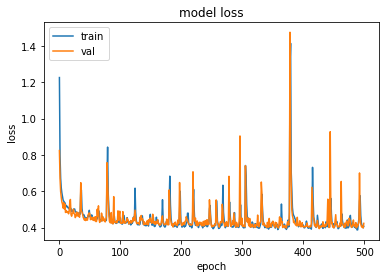

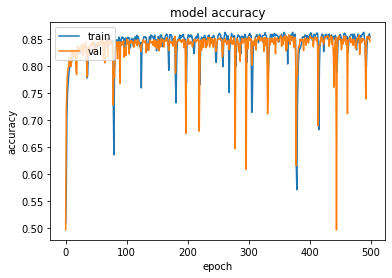

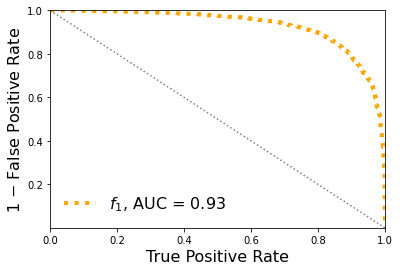

313/313 [==============================] - 3s 9ms/step - loss: 0.4372 - acc: 0.8489 - f1_m: 0.4440 - precision_m: 0.5004 - recall_m: 0.4004
Test ROC-AUC: 0.92917498
Test loss: 0.4371873438358307
Test accuracy: 0.8489000201225281
Test f1: 0.44400468468666077
Test precision: 0.5003993511199951
Test recall: 0.4003594219684601
 
############################### 

###############################
 TESTING: 
conv_layers :  2
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.001
batch_size :  64
 
Epoch 1/500
375/375 [==============================] - 22s 55ms/step - loss: 0.6897 - acc: 0.6540 - f1_m: 0.5669 - precision_m: 0.6407 - recall_m: 0.5679 - val_loss: 0.5050 - val_acc: 0.7865 - val_f1_m: 0.7851 - val_precision_m: 0.7796 - val_recall_m: 0.7962
Epoch 2/500
375/375 [==============================] - 20s 53ms/step - loss: 0.5504 - acc: 0.7621 - f1_m: 0.7671 - precision_m: 0.7463 - recall_m: 0.8012 - val_loss: 0.4878 - val_acc: 0.7962 - val_f1_m: 0.8094 - val_precision_m: 0.7509 - v

Epoch 31/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4323 - acc: 0.8413 - f1_m: 0.8440 - precision_m: 0.8323 - recall_m: 0.8628 - val_loss: 0.4246 - val_acc: 0.8407 - val_f1_m: 0.8393 - val_precision_m: 0.8348 - val_recall_m: 0.8483
Epoch 32/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4391 - acc: 0.8383 - f1_m: 0.8417 - precision_m: 0.8261 - recall_m: 0.8645 - val_loss: 0.4270 - val_acc: 0.8372 - val_f1_m: 0.8422 - val_precision_m: 0.8066 - val_recall_m: 0.8854
Epoch 33/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4411 - acc: 0.8356 - f1_m: 0.8396 - precision_m: 0.8167 - recall_m: 0.8702 - val_loss: 0.4357 - val_acc: 0.8312 - val_f1_m: 0.8426 - val_precision_m: 0.7789 - val_recall_m: 0.9228
Epoch 34/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4379 - acc: 0.8380 - f1_m: 0.8407 - precision_m: 0.8199 - recall_m: 0.8706 - val_loss: 0.4302 - val_acc: 0.8412 - val_f1_m: 0.8436 - val_pre

375/375 [==============================] - 20s 53ms/step - loss: 0.4235 - acc: 0.8471 - f1_m: 0.8459 - precision_m: 0.8317 - recall_m: 0.8681 - val_loss: 0.4250 - val_acc: 0.8412 - val_f1_m: 0.8442 - val_precision_m: 0.8200 - val_recall_m: 0.8743
Epoch 94/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4123 - acc: 0.8560 - f1_m: 0.8582 - precision_m: 0.8364 - recall_m: 0.8857 - val_loss: 0.4180 - val_acc: 0.8467 - val_f1_m: 0.8448 - val_precision_m: 0.8454 - val_recall_m: 0.8487
Epoch 95/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4179 - acc: 0.8521 - f1_m: 0.8523 - precision_m: 0.8363 - recall_m: 0.8754 - val_loss: 0.4277 - val_acc: 0.8425 - val_f1_m: 0.8441 - val_precision_m: 0.8259 - val_recall_m: 0.8674
Epoch 96/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4159 - acc: 0.8522 - f1_m: 0.8529 - precision_m: 0.8397 - recall_m: 0.8722 - val_loss: 0.4268 - val_acc: 0.8430 - val_f1_m: 0.8467 - val_precision_m: 0.8

375/375 [==============================] - 20s 53ms/step - loss: 0.4175 - acc: 0.8534 - f1_m: 0.8560 - precision_m: 0.8393 - recall_m: 0.8787 - val_loss: 0.4352 - val_acc: 0.8392 - val_f1_m: 0.8435 - val_precision_m: 0.8107 - val_recall_m: 0.8835
Epoch 156/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4122 - acc: 0.8565 - f1_m: 0.8565 - precision_m: 0.8395 - recall_m: 0.8797 - val_loss: 0.4337 - val_acc: 0.8347 - val_f1_m: 0.8346 - val_precision_m: 0.8247 - val_recall_m: 0.8494
Epoch 157/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4217 - acc: 0.8505 - f1_m: 0.8533 - precision_m: 0.8358 - recall_m: 0.8765 - val_loss: 0.4267 - val_acc: 0.8403 - val_f1_m: 0.8361 - val_precision_m: 0.8492 - val_recall_m: 0.8284
Epoch 158/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4082 - acc: 0.8560 - f1_m: 0.8580 - precision_m: 0.8433 - recall_m: 0.8787 - val_loss: 0.4353 - val_acc: 0.8360 - val_f1_m: 0.8409 - val_precision_m: 

375/375 [==============================] - 20s 53ms/step - loss: 0.4066 - acc: 0.8538 - f1_m: 0.8543 - precision_m: 0.8366 - recall_m: 0.8776 - val_loss: 0.4361 - val_acc: 0.8372 - val_f1_m: 0.8320 - val_precision_m: 0.8473 - val_recall_m: 0.8218
Epoch 218/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4122 - acc: 0.8539 - f1_m: 0.8571 - precision_m: 0.8398 - recall_m: 0.8808 - val_loss: 0.4284 - val_acc: 0.8410 - val_f1_m: 0.8388 - val_precision_m: 0.8407 - val_recall_m: 0.8413
Epoch 219/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4043 - acc: 0.8568 - f1_m: 0.8610 - precision_m: 0.8427 - recall_m: 0.8850 - val_loss: 0.4302 - val_acc: 0.8357 - val_f1_m: 0.8412 - val_precision_m: 0.8026 - val_recall_m: 0.8882
Epoch 220/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4129 - acc: 0.8527 - f1_m: 0.8561 - precision_m: 0.8359 - recall_m: 0.8833 - val_loss: 0.4374 - val_acc: 0.8290 - val_f1_m: 0.8209 - val_precision_m: 

375/375 [==============================] - 20s 53ms/step - loss: 0.4099 - acc: 0.8542 - f1_m: 0.8540 - precision_m: 0.8372 - recall_m: 0.8773 - val_loss: 0.4312 - val_acc: 0.8407 - val_f1_m: 0.8427 - val_precision_m: 0.8242 - val_recall_m: 0.8671
Epoch 280/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4129 - acc: 0.8521 - f1_m: 0.8520 - precision_m: 0.8361 - recall_m: 0.8748 - val_loss: 0.4271 - val_acc: 0.8395 - val_f1_m: 0.8402 - val_precision_m: 0.8262 - val_recall_m: 0.8596
Epoch 281/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4112 - acc: 0.8511 - f1_m: 0.8522 - precision_m: 0.8349 - recall_m: 0.8768 - val_loss: 0.4448 - val_acc: 0.8283 - val_f1_m: 0.8215 - val_precision_m: 0.8447 - val_recall_m: 0.8042
Epoch 282/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4102 - acc: 0.8541 - f1_m: 0.8556 - precision_m: 0.8389 - recall_m: 0.8780 - val_loss: 0.4338 - val_acc: 0.8332 - val_f1_m: 0.8257 - val_precision_m: 

375/375 [==============================] - 20s 53ms/step - loss: 0.4058 - acc: 0.8555 - f1_m: 0.8560 - precision_m: 0.8383 - recall_m: 0.8790 - val_loss: 0.4495 - val_acc: 0.8275 - val_f1_m: 0.8143 - val_precision_m: 0.8715 - val_recall_m: 0.7682
Epoch 342/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4110 - acc: 0.8553 - f1_m: 0.8567 - precision_m: 0.8402 - recall_m: 0.8796 - val_loss: 0.4368 - val_acc: 0.8383 - val_f1_m: 0.8372 - val_precision_m: 0.8311 - val_recall_m: 0.8480
Epoch 343/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4067 - acc: 0.8562 - f1_m: 0.8583 - precision_m: 0.8449 - recall_m: 0.8780 - val_loss: 0.4315 - val_acc: 0.8403 - val_f1_m: 0.8382 - val_precision_m: 0.8387 - val_recall_m: 0.8426
Epoch 344/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4083 - acc: 0.8539 - f1_m: 0.8547 - precision_m: 0.8438 - recall_m: 0.8725 - val_loss: 0.4258 - val_acc: 0.8408 - val_f1_m: 0.8392 - val_precision_m: 

375/375 [==============================] - 20s 53ms/step - loss: 0.4120 - acc: 0.8522 - f1_m: 0.8562 - precision_m: 0.8370 - recall_m: 0.8822 - val_loss: 0.4306 - val_acc: 0.8438 - val_f1_m: 0.8433 - val_precision_m: 0.8381 - val_recall_m: 0.8534
Epoch 404/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4046 - acc: 0.8554 - f1_m: 0.8559 - precision_m: 0.8382 - recall_m: 0.8786 - val_loss: 0.4245 - val_acc: 0.8412 - val_f1_m: 0.8398 - val_precision_m: 0.8374 - val_recall_m: 0.8469
Epoch 405/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4026 - acc: 0.8562 - f1_m: 0.8565 - precision_m: 0.8429 - recall_m: 0.8753 - val_loss: 0.4307 - val_acc: 0.8383 - val_f1_m: 0.8355 - val_precision_m: 0.8414 - val_recall_m: 0.8340
Epoch 406/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4124 - acc: 0.8544 - f1_m: 0.8536 - precision_m: 0.8469 - recall_m: 0.8671 - val_loss: 0.4317 - val_acc: 0.8365 - val_f1_m: 0.8358 - val_precision_m: 

375/375 [==============================] - 20s 53ms/step - loss: 0.4070 - acc: 0.8577 - f1_m: 0.8583 - precision_m: 0.8494 - recall_m: 0.8734 - val_loss: 0.4312 - val_acc: 0.8417 - val_f1_m: 0.8409 - val_precision_m: 0.8335 - val_recall_m: 0.8532
Epoch 466/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4065 - acc: 0.8568 - f1_m: 0.8582 - precision_m: 0.8433 - recall_m: 0.8790 - val_loss: 0.4341 - val_acc: 0.8390 - val_f1_m: 0.8407 - val_precision_m: 0.8206 - val_recall_m: 0.8664
Epoch 467/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4083 - acc: 0.8547 - f1_m: 0.8545 - precision_m: 0.8453 - recall_m: 0.8701 - val_loss: 0.4380 - val_acc: 0.8355 - val_f1_m: 0.8374 - val_precision_m: 0.8181 - val_recall_m: 0.8625
Epoch 468/500
375/375 [==============================] - 20s 53ms/step - loss: 0.4018 - acc: 0.8566 - f1_m: 0.8571 - precision_m: 0.8444 - recall_m: 0.8756 - val_loss: 0.4335 - val_acc: 0.8403 - val_f1_m: 0.8377 - val_precision_m: 

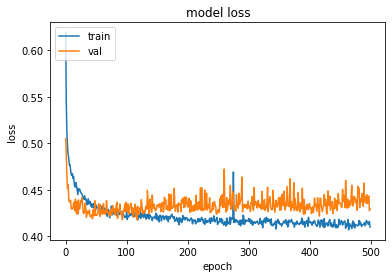

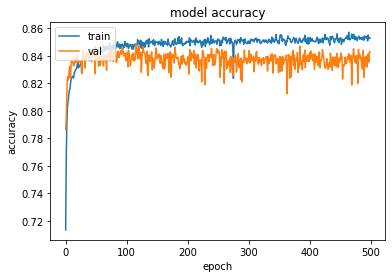

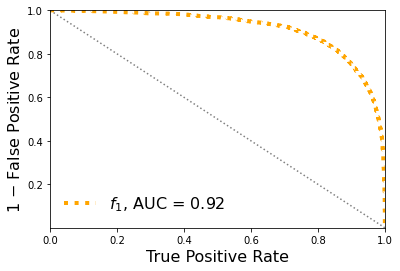

313/313 [==============================] - 2s 6ms/step - loss: 0.4364 - acc: 0.8367 - f1_m: 0.4647 - precision_m: 0.5000 - recall_m: 0.4351
Test ROC-AUC: 0.9165555199999998
Test loss: 0.4364285171031952
Test accuracy: 0.8367000222206116
Test f1: 0.46465104818344116
Test precision: 0.5
Test recall: 0.4351038336753845
 
############################### 

###############################
 TESTING: 
conv_layers :  2
conv_filters :  8
learning_rate :  0.005
alpha_value :  0.001
batch_size :  128
 
Epoch 1/500
188/188 [==============================] - 21s 109ms/step - loss: 0.7868 - acc: 0.5019 - f1_m: 0.4374 - precision_m: 0.5091 - recall_m: 0.4649 - val_loss: 0.6927 - val_acc: 0.7083 - val_f1_m: 0.6689 - val_precision_m: 0.7636 - val_recall_m: 0.5986
Epoch 2/500
188/188 [==============================] - 20s 105ms/step - loss: 0.6463 - acc: 0.6529 - f1_m: 0.6179 - precision_m: 0.6823 - recall_m: 0.5709 - val_loss: 0.5621 - val_acc: 0.7473 - val_f1_m: 0.7737 - val_precision_m: 0.6964 - val_r

188/188 [==============================] - 20s 106ms/step - loss: 0.4260 - acc: 0.8437 - f1_m: 0.8456 - precision_m: 0.8389 - recall_m: 0.8590 - val_loss: 0.4253 - val_acc: 0.8302 - val_f1_m: 0.8184 - val_precision_m: 0.8678 - val_recall_m: 0.7762
Epoch 62/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4190 - acc: 0.8435 - f1_m: 0.8439 - precision_m: 0.8381 - recall_m: 0.8540 - val_loss: 0.4084 - val_acc: 0.8487 - val_f1_m: 0.8500 - val_precision_m: 0.8339 - val_recall_m: 0.8687
Epoch 63/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4228 - acc: 0.8425 - f1_m: 0.8439 - precision_m: 0.8360 - recall_m: 0.8563 - val_loss: 0.4223 - val_acc: 0.8400 - val_f1_m: 0.8423 - val_precision_m: 0.8234 - val_recall_m: 0.8646
Epoch 64/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4140 - acc: 0.8485 - f1_m: 0.8492 - precision_m: 0.8413 - recall_m: 0.8600 - val_loss: 0.4147 - val_acc: 0.8445 - val_f1_m: 0.8528 - val_precision_m:

188/188 [==============================] - 20s 105ms/step - loss: 0.3892 - acc: 0.8642 - f1_m: 0.8660 - precision_m: 0.8499 - recall_m: 0.8862 - val_loss: 0.4046 - val_acc: 0.8525 - val_f1_m: 0.8560 - val_precision_m: 0.8303 - val_recall_m: 0.8857
Epoch 124/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4278 - acc: 0.8484 - f1_m: 0.8485 - precision_m: 0.8364 - recall_m: 0.8722 - val_loss: 0.4337 - val_acc: 0.8412 - val_f1_m: 0.8348 - val_precision_m: 0.8642 - val_recall_m: 0.8103
Epoch 125/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3981 - acc: 0.8622 - f1_m: 0.8653 - precision_m: 0.8462 - recall_m: 0.8879 - val_loss: 0.4084 - val_acc: 0.8532 - val_f1_m: 0.8567 - val_precision_m: 0.8315 - val_recall_m: 0.8856
Epoch 126/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3930 - acc: 0.8641 - f1_m: 0.8650 - precision_m: 0.8501 - recall_m: 0.8838 - val_loss: 0.4106 - val_acc: 0.8453 - val_f1_m: 0.8510 - val_precision

188/188 [==============================] - 20s 105ms/step - loss: 0.3838 - acc: 0.8682 - f1_m: 0.8690 - precision_m: 0.8545 - recall_m: 0.8870 - val_loss: 0.4022 - val_acc: 0.8563 - val_f1_m: 0.8583 - val_precision_m: 0.8402 - val_recall_m: 0.8792
Epoch 186/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3867 - acc: 0.8672 - f1_m: 0.8689 - precision_m: 0.8513 - recall_m: 0.8897 - val_loss: 0.4060 - val_acc: 0.8520 - val_f1_m: 0.8503 - val_precision_m: 0.8520 - val_recall_m: 0.8508
Epoch 187/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3780 - acc: 0.8696 - f1_m: 0.8734 - precision_m: 0.8541 - recall_m: 0.8960 - val_loss: 0.4118 - val_acc: 0.8557 - val_f1_m: 0.8587 - val_precision_m: 0.8351 - val_recall_m: 0.8863
Epoch 188/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4195 - acc: 0.8496 - f1_m: 0.8533 - precision_m: 0.8369 - recall_m: 0.8749 - val_loss: 0.4381 - val_acc: 0.8377 - val_f1_m: 0.8272 - val_precision

188/188 [==============================] - 20s 105ms/step - loss: 0.3743 - acc: 0.8745 - f1_m: 0.8768 - precision_m: 0.8576 - recall_m: 0.8997 - val_loss: 0.4329 - val_acc: 0.8497 - val_f1_m: 0.8568 - val_precision_m: 0.8128 - val_recall_m: 0.9080
Epoch 248/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3826 - acc: 0.8693 - f1_m: 0.8716 - precision_m: 0.8535 - recall_m: 0.8941 - val_loss: 0.4231 - val_acc: 0.8422 - val_f1_m: 0.8486 - val_precision_m: 0.8079 - val_recall_m: 0.8957
Epoch 249/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3680 - acc: 0.8759 - f1_m: 0.8768 - precision_m: 0.8559 - recall_m: 0.9017 - val_loss: 0.4144 - val_acc: 0.8482 - val_f1_m: 0.8482 - val_precision_m: 0.8412 - val_recall_m: 0.8572
Epoch 250/500
188/188 [==============================] - 20s 106ms/step - loss: 0.3692 - acc: 0.8750 - f1_m: 0.8787 - precision_m: 0.8623 - recall_m: 0.8991 - val_loss: 0.4237 - val_acc: 0.8515 - val_f1_m: 0.8522 - val_precision

188/188 [==============================] - 20s 105ms/step - loss: 0.4680 - acc: 0.8191 - f1_m: 0.8232 - precision_m: 0.8057 - recall_m: 0.8449 - val_loss: 0.4367 - val_acc: 0.8262 - val_f1_m: 0.8303 - val_precision_m: 0.8038 - val_recall_m: 0.8615
Epoch 310/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4717 - acc: 0.8121 - f1_m: 0.8162 - precision_m: 0.8002 - recall_m: 0.8371 - val_loss: 0.4551 - val_acc: 0.8217 - val_f1_m: 0.8207 - val_precision_m: 0.8189 - val_recall_m: 0.8256
Epoch 311/500
188/188 [==============================] - 20s 106ms/step - loss: 0.4593 - acc: 0.8210 - f1_m: 0.8237 - precision_m: 0.8082 - recall_m: 0.8449 - val_loss: 0.4509 - val_acc: 0.8215 - val_f1_m: 0.8303 - val_precision_m: 0.7854 - val_recall_m: 0.8836
Epoch 312/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4614 - acc: 0.8186 - f1_m: 0.8217 - precision_m: 0.8038 - recall_m: 0.8446 - val_loss: 0.4466 - val_acc: 0.8218 - val_f1_m: 0.8124 - val_precision

188/188 [==============================] - 20s 105ms/step - loss: 0.3687 - acc: 0.8782 - f1_m: 0.8788 - precision_m: 0.8686 - recall_m: 0.8924 - val_loss: 0.4229 - val_acc: 0.8523 - val_f1_m: 0.8572 - val_precision_m: 0.8232 - val_recall_m: 0.8968
Epoch 372/500
188/188 [==============================] - 20s 106ms/step - loss: 0.3787 - acc: 0.8771 - f1_m: 0.8782 - precision_m: 0.8646 - recall_m: 0.8947 - val_loss: 0.4113 - val_acc: 0.8488 - val_f1_m: 0.8496 - val_precision_m: 0.8383 - val_recall_m: 0.8638
Epoch 373/500
188/188 [==============================] - 20s 105ms/step - loss: 0.4029 - acc: 0.8612 - f1_m: 0.8609 - precision_m: 0.8499 - recall_m: 0.8781 - val_loss: 0.4077 - val_acc: 0.8530 - val_f1_m: 0.8554 - val_precision_m: 0.8365 - val_recall_m: 0.8778
Epoch 374/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3651 - acc: 0.8807 - f1_m: 0.8824 - precision_m: 0.8742 - recall_m: 0.8932 - val_loss: 0.4138 - val_acc: 0.8500 - val_f1_m: 0.8556 - val_precision

188/188 [==============================] - 20s 106ms/step - loss: 0.3684 - acc: 0.8789 - f1_m: 0.8811 - precision_m: 0.8673 - recall_m: 0.8980 - val_loss: 0.4282 - val_acc: 0.8470 - val_f1_m: 0.8425 - val_precision_m: 0.8607 - val_recall_m: 0.8274
Epoch 434/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3673 - acc: 0.8807 - f1_m: 0.8817 - precision_m: 0.8688 - recall_m: 0.8980 - val_loss: 0.4439 - val_acc: 0.8480 - val_f1_m: 0.8462 - val_precision_m: 0.8495 - val_recall_m: 0.8458
Epoch 435/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3671 - acc: 0.8800 - f1_m: 0.8802 - precision_m: 0.8749 - recall_m: 0.8887 - val_loss: 0.4298 - val_acc: 0.8442 - val_f1_m: 0.8397 - val_precision_m: 0.8587 - val_recall_m: 0.8242
Epoch 436/500
188/188 [==============================] - 20s 105ms/step - loss: 0.3724 - acc: 0.8797 - f1_m: 0.8813 - precision_m: 0.8741 - recall_m: 0.8917 - val_loss: 0.4240 - val_acc: 0.8523 - val_f1_m: 0.8507 - val_precision

KeyboardInterrupt: 

In [30]:
ev_count = 1

for i in range(len(conv_layers)):
    for j in range(len(conv_filters)):
        for k in range(len(learning_rate)):
            for l in range(len(alpha_value)):
                for m in range(len(batch_size)):

                    ev_count +=1

                    if ev_count > -1:

                        print('###############################')
                        print(' TESTING: ')
                        print('conv_layers : ', conv_layers[i])
                        print('conv_filters : ', conv_filters[j])
                        print('learning_rate : ', learning_rate[k])
                        print('alpha_value : ', alpha_value[l])
                        print('batch_size : ', batch_size[m])
                        print(' ')




                        roc_auc_model, score = run_model(conv_layers[i], 
                                                          conv_filters[j], 
                                                          learning_rate[k], 
                                                          alpha_value[l], 
                                                          batch_size[m], 
                                                          tot_epochs)
                        
                        with open('04-grid-scaled75x75.dat', 'a') as file:
                            file.write( "%0.4f %d %d %0.3f %0.3f %d %0.4f %0.4f %0.4f %0.4f %0.4f\n" % (roc_auc_model, 
                                                                       conv_layers[i], 
                                                                       conv_filters[j],
                                                                       learning_rate[k], 
                                                                       alpha_value[l], 
                                                                       batch_size[m], 
                                                                          score[0], 
                                                                          score[1], 
                                                                          score[2], 
                                                                          score[3], 
                                                                          score[4]) )


                        print(' ')
                        print('############################### \n')

### LOAD and PLOT

In [13]:
data_grid = np.loadtxt('04-grid-scaled75x75.dat', delimiter=' ')
print('# classifiers: ', len(data_grid))


index_max = -99
max_roc_auc_grid = -99

for i in range(len(data_grid)):
    if data_grid[i][0] > max_roc_auc_grid:
        index_max = i
        max_roc_auc_grid = data_grid[i][0]
        
print('\nParameters with max ROC-AUC')
print('ROC-AUC: ', data_grid[index_max][0])

print('\nconv_layers: ', data_grid[index_max][1])
print('conv_filters: ', data_grid[index_max][2])
print('learning_rate: ', data_grid[index_max][3])
print('alpha_value: ', data_grid[index_max][4])
print('batch_size: ', data_grid[index_max][5])

print('\nTest loss: ', data_grid[index_max][6])
print('Test accuracy: ', data_grid[index_max][7])
print('Test f1: ', data_grid[index_max][8])
print('Test precision: ', data_grid[index_max][9])
print('Test recall: ', data_grid[index_max][10])

# classifiers:  108

Parameters with max ROC-AUC
ROC-AUC:  0.9322

conv_layers:  1.0
conv_filters:  8.0
learning_rate:  0.01
alpha_value:  0.05
batch_size:  128.0

Test loss:  0.4141
Test accuracy:  0.8495
Test f1:  0.4782
Test precision:  0.5003
Test recall:  0.459


# model with max ROC-AUC:  1.0


<ipython-input-14-b08fdbf18de8>:5: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "." (-> marker='.'). The keyword argument will take precedence.
  plt.plot(plotus, '.', lw=5, color='blue', marker='x', label="ROC-AUC")


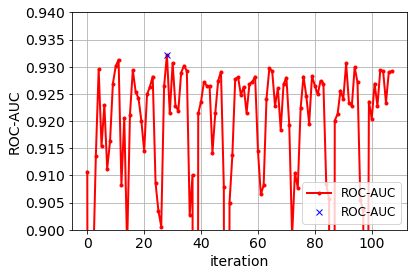

In [14]:
plotus = [i if i == data_grid[index_max][0] else 0 for i in data_grid[:,0]]
print('# model with max ROC-AUC: ', (sum(plotus)/data_grid[index_max][0]))

plt.plot(data_grid[:,0], '.-', lw=2, color='r', label="ROC-AUC")
plt.plot(plotus, '.', lw=5, color='blue', marker='x', label="ROC-AUC")

plt.grid()
#plt.title(title,fontsize=14)
plt.xlabel("iteration",fontsize=14)
plt.ylabel("ROC-AUC",fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
#plt.xscale('log')
#plt.yscale('log')
plt.ylim([0.9,0.94])
plt.legend(loc='lower right',fontsize=12)
plt.show()

### 2nd GRID, using grid 1

In [15]:
def create_model(conv_layers, conv_filters, learning_rate, alpha_value, size_filters, dropout_value, Max_or_Av_pooling):
    shape = (image_size[0], image_size[1], image_size[2])
    model = Sequential()
    
    # conv layer
    model.add(Conv2D(conv_filters, (size_filters,size_filters), strides = (1,1), input_shape=shape,kernel_regularizer=l2(0.005)))
    model.add(keras.layers.LeakyReLU(alpha=alpha_value))
    if Max_or_Av_pooling == 0:
        model.add(MaxPooling2D(pool_size=(2, 2), strides = (1,1)))
    elif Max_or_Av_pooling == 1:
        model.add(AveragePooling2D(pool_size=(2, 2), strides = (1,1)))


    for i in range(1,conv_layers):
        # conv layers
        model.add(Conv2D(conv_filters,(size_filters,size_filters),kernel_regularizer=l2(0.005)))
        model.add(keras.layers.LeakyReLU(alpha=alpha_value))
        if Max_or_Av_pooling == 0:
            model.add(MaxPooling2D(pool_size=(2, 2), strides = (1,1)))
        elif Max_or_Av_pooling == 1:
            model.add(AveragePooling2D(pool_size=(2, 2), strides = (1,1)))

    
    model.add(Dropout(dropout_value)) 
    model.add(Flatten())

    model.add(Dense(32, bias_regularizer=regularizers.l2(0.001),kernel_regularizer=regularizers.l2(0.001)))
    model.add(keras.layers.LeakyReLU(alpha=alpha_value))    
    model.add(Dropout(dropout_value)) 
    
    model.add(Dense(8, bias_regularizer=regularizers.l2(0.001),kernel_regularizer=regularizers.l2(0.001)))
    model.add(keras.layers.LeakyReLU(alpha=alpha_value))    
    model.add(Dropout(dropout_value)) 

    # Output layer
    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    # Compile the model
    model.compile(loss='binary_crossentropy',
                    optimizer=Adam(learning_rate=learning_rate),
                    metrics=['acc', f1_m, precision_m, recall_m])
    return model


def run_model(conv_layers, conv_filters, learning_rate, alpha_value, batch_size, tot_epochs, size_filters, dropout_value, Max_or_Av_pooling):
    
    model = create_model(conv_layers, conv_filters, learning_rate, alpha_value, size_filters, dropout_value, Max_or_Av_pooling)
    
    history = model.fit(x_train, y_train, 
                          epochs=tot_epochs, 
                          batch_size=batch_size, 
                          verbose=0, 
                          validation_data=(x_val, y_val), 
                          shuffle = True)
    #model.save(model_name)
    #model.save_weights('final_weights.h5')

    
#     # Plot de la cost function para la train y validation data
#     plt.plot(history.history['loss'])
#     plt.plot(history.history['val_loss'])
#     plt.title('model loss')
#     plt.legend(['train', 'val'], loc='upper left')
#     plt.ylabel('loss')
#     plt.xlabel('epoch')
#     plt.show()

#     # Plot de la accuracy function para la train y validation data
#     plt.figure()
#     plt.plot(history.history['acc'])
#     plt.plot(history.history['val_acc'])
#     plt.title('model accuracy')
#     plt.ylabel('accuracy')
#     plt.xlabel('epoch')
#     plt.legend(['train', 'val'], loc='upper left')
#     plt.show()




    #model.save(root_dir + 'CNN-histo-mix-v2/saved-models/' + 'conv-' + nameMIX_linear +'.h5') # Guardar el modelo.  # Predicción de la red entrenada
    y_pred = model.predict(x_test)

    # Compute ROC curve and ROC area for each class
    fpr_model = dict()
    tpr_model = dict()
    roc_auc_model = dict()
    fpr_model, tpr_model, _ = roc_curve(y_test, y_pred)
    roc_auc_model = auc(fpr_model, tpr_model)


#     plt.figure()
#     plt.plot(tpr_model,1-fpr_model,label="$f_{1}$, AUC = %0.2f" % roc_auc_model,color="orange",ls=":",lw=4)
#     plt.plot([1,0],[0,1],ls=":",color="grey")
#     plt.xlabel("True Positive Rate",fontsize=16)
#     plt.ylabel("1 $-$ False Positive Rate",fontsize=16)
#     plt.legend()
#     plt.xlim([0,1])
#     plt.ylim([0,1])
#     plt.yticks([0.2,0.4,0.6,0.8,1.])
#     plt.legend(frameon=False,fontsize=16)
#     plt.show()
                                
                                
    score = model.evaluate(x_test, y_test, verbose=1)
    
    print('Test ROC-AUC:', roc_auc_model)
    print('Test loss:', score[0])
    print('Test accuracy:', score[1])
    print('Test f1:', score[2])
    print('Test precision:', score[3])
    print('Test recall:', score[4])
    
    return roc_auc_model, score

In [19]:
conv_layers = [1,2,3]

learning_rate = [0.0005,0.001,0.01]

size_filters = [2,3,5]
dropout_value = [0.1,0.25,0.5]

Max_or_Av_pooling = [0,1]



tot_epochs = 500
patience_epochs = 50

# to stop the training if validation loss does not improve after patience number of epochs
stop_training = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=patience_epochs, restore_best_weights=True)

num_its = len(conv_layers)*len(learning_rate)*len(size_filters)*len(dropout_value)*len(Max_or_Av_pooling)
print('# classifiers: ', num_its)

# classifiers:  162


In [ ]:
ev_count = 0

for i in range(len(conv_layers)):
    for j in range(len(learning_rate)):
        for k in range(len(size_filters)):
            for l in range(len(dropout_value)):
                for m in range(len(Max_or_Av_pooling)):

                    ev_count +=1

                    if ev_count > 67:

                        print('###############################')
                        print(' TESTING: ')
                        print('conv_layers : ', conv_layers[i])
                        print('learning_rate : ', learning_rate[j])
                        print('size_filters : ', size_filters[k])
                        print('dropout_value : ', dropout_value[l])
                        print('Max_or_Av_pooling : ', Max_or_Av_pooling[m])
                        print(' ')




                        roc_auc_model, score = run_model(conv_layers[i], 
                                                          int(data_grid[index_max][2]), 
                                                          learning_rate[j], 
                                                          data_grid[index_max][4], 
                                                          int(data_grid[index_max][5]), 
                                                          tot_epochs,
                                                        size_filters[k],
                                                        dropout_value[l],
                                                        Max_or_Av_pooling[m])
                        
                        with open('04-grid-scaled75x75-2ndstep.dat', 'a') as file:
                            file.write( "%0.4f %d %0.3f %d %0.2f %d %0.4f %0.4f %0.4f %0.4f %0.4f\n" % (roc_auc_model, 
                                                                       conv_layers[i], 
                                                                       learning_rate[j],
                                                                       size_filters[k], 
                                                                       dropout_value[l], 
                                                                       Max_or_Av_pooling[m], 
                                                                          score[0], 
                                                                          score[1], 
                                                                          score[2], 
                                                                          score[3], 
                                                                          score[4]) )


                        print(' ')
                        print('############################### \n')

###############################
 TESTING: 
conv_layers :  2
learning_rate :  0.0005
size_filters :  5
dropout_value :  0.1
Max_or_Av_pooling :  1
 
313/313 [==============================] - 3s 9ms/step - loss: 0.6469 - acc: 0.8307 - f1_m: 0.4340 - precision_m: 0.5000 - recall_m: 0.3850
Test ROC-AUC: 0.9193357799999999
Test loss: 0.6469386219978333
Test accuracy: 0.8306999802589417
Test f1: 0.4340443015098572
Test precision: 0.5
Test recall: 0.38498401641845703
 
############################### 

###############################
 TESTING: 
conv_layers :  2
learning_rate :  0.0005
size_filters :  5
dropout_value :  0.25
Max_or_Av_pooling :  0
 
313/313 [==============================] - 2s 8ms/step - loss: 0.6418 - acc: 0.8374 - f1_m: 0.4534 - precision_m: 0.5001 - recall_m: 0.4159
Test ROC-AUC: 0.91794486
Test loss: 0.6418197154998779
Test accuracy: 0.8374000191688538
Test f1: 0.4533684551715851
Test precision: 0.5001451969146729
Test recall: 0.4159345030784607
 
#######################

313/313 [==============================] - 3s 8ms/step - loss: 0.5062 - acc: 0.8157 - f1_m: 0.4591 - precision_m: 0.4996 - recall_m: 0.4260
Test ROC-AUC: 0.8972011999999999
Test loss: 0.5061521530151367
Test accuracy: 0.8156999945640564
Test f1: 0.459053099155426
Test precision: 0.4996313452720642
Test recall: 0.4260183572769165
 
############################### 

###############################
 TESTING: 
conv_layers :  2
learning_rate :  0.001
size_filters :  5
dropout_value :  0.1
Max_or_Av_pooling :  0
 
313/313 [==============================] - 2s 8ms/step - loss: 0.4647 - acc: 0.8302 - f1_m: 0.4591 - precision_m: 0.4996 - recall_m: 0.4260
Test ROC-AUC: 0.90894224
Test loss: 0.464674711227417
Test accuracy: 0.8302000164985657
Test f1: 0.45905882120132446
Test precision: 0.4995643198490143
Test recall: 0.4260183572769165
 
############################### 

###############################
 TESTING: 
conv_layers :  2
learning_rate :  0.001
size_filters :  5
dropout_value :  0.1
Max_

### LOAD AND PLOT

In [16]:
data_grid_2ndstep = np.loadtxt('04-grid-scaled75x75-2ndstep.dat', delimiter=' ')
print('# classifiers: ', len(data_grid_2ndstep))


index_max_2 = -99
max_roc_auc_grid_2 = -99

for i in range(len(data_grid_2ndstep)):
    if data_grid_2ndstep[i][0] > max_roc_auc_grid_2:
        index_max_2 = i
        max_roc_auc_grid_2 = data_grid_2ndstep[i][0]
        
print('\nParameters with max ROC-AUC')
print('ROC-AUC: ', data_grid_2ndstep[index_max_2][0])

print('\nconv_layers: ', data_grid_2ndstep[index_max_2][1])

print('conv_filters: ', data_grid[index_max][2])
print('alpha_value: ', data_grid[index_max][4])
print('batch_size: ', data_grid[index_max][5])

print('learning_rate: ', data_grid_2ndstep[index_max_2][2])
print('size_filters: ', data_grid_2ndstep[index_max_2][3])
print('dropout_value: ', data_grid_2ndstep[index_max_2][4])
print('Max_or_Av_pooling: ', data_grid_2ndstep[index_max_2][5], '    (0: MaxPooling, 1: AveragePooling)')

print('\nTest loss: ', data_grid_2ndstep[index_max_2][6])
print('Test accuracy: ', data_grid_2ndstep[index_max_2][7])
print('Test f1: ', data_grid_2ndstep[index_max_2][8])
print('Test precision: ', data_grid_2ndstep[index_max_2][9])
print('Test recall: ', data_grid_2ndstep[index_max_2][10])

# classifiers:  108

Parameters with max ROC-AUC
ROC-AUC:  0.9358

conv_layers:  2.0
conv_filters:  8.0
alpha_value:  0.05
batch_size:  128.0
learning_rate:  0.001
size_filters:  3.0
dropout_value:  0.5
Max_or_Av_pooling:  1.0     (0: MaxPooling, 1: AveragePooling)

Test loss:  0.42
Test accuracy:  0.8587
Test f1:  0.4614
Test precision:  0.5004
Test recall:  0.4291


# model with max ROC-AUC:  1.0


<ipython-input-17-2e0cbee9eb2f>:5: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "." (-> marker='.'). The keyword argument will take precedence.
  plt.plot(plotus, '.', lw=5, color='blue', marker='x', label="ROC-AUC")


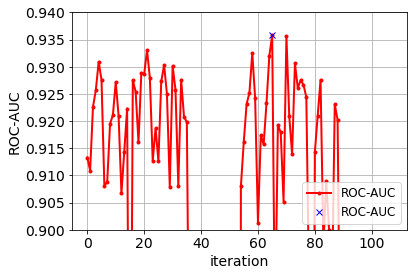

In [17]:
plotus = [i if i == data_grid_2ndstep[index_max_2][0] else 0 for i in data_grid_2ndstep[:,0]]
print('# model with max ROC-AUC: ', (sum(plotus)/data_grid_2ndstep[index_max_2][0]))

plt.plot(data_grid_2ndstep[:,0], '.-', lw=2, color='r', label="ROC-AUC")
plt.plot(plotus, '.', lw=5, color='blue', marker='x', label="ROC-AUC")

plt.grid()
#plt.title(title,fontsize=14)
plt.xlabel("iteration",fontsize=14)
plt.ylabel("ROC-AUC",fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
#plt.xscale('log')
#plt.yscale('log')
plt.ylim([0.9,0.94])
plt.legend(loc='lower right',fontsize=12)
plt.show()

### 3rd GRID, using grid 1 and 2

In [28]:
conv_layers = [1,2,3,4,5,6]

tot_epochs = 500
patience_epochs = 50

# to stop the training if validation loss does not improve after patience number of epochs
stop_training = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=patience_epochs, restore_best_weights=True)

num_its = len(conv_layers)
print('# classifiers: ', num_its)

# classifiers:  6


In [29]:
ev_count = 0

for i in range(len(conv_layers)):

    ev_count +=1

    if ev_count > 3:

        print('###############################')
        print(' TESTING: ')
        print('conv_layers : ', conv_layers[i])
        print(' ')




        roc_auc_model, score = run_model(conv_layers[i], 
                                            int(data_grid[index_max][2]), 
                                            data_grid_2ndstep[index_max_2][2], 
                                            data_grid[index_max][4], 
                                            int(data_grid[index_max][5]), 
                                            tot_epochs,
                                        int(data_grid_2ndstep[index_max_2][3]),
                                        data_grid_2ndstep[index_max_2][4],
                                        int(data_grid_2ndstep[index_max_2][5]))

        with open('04-grid-scaled75x75-3rdstep.dat', 'a') as file:
            file.write( "%0.4f %d %0.4f %0.4f %0.4f %0.4f %0.4f\n" % (roc_auc_model, 
                                                        conv_layers[i],
                                                            score[0], 
                                                            score[1], 
                                                            score[2], 
                                                            score[3], 
                                                            score[4]) )


        print(' ')
        print('############################### \n')

###############################
 TESTING: 
conv_layers :  4
 
313/313 [==============================] - 4s 13ms/step - loss: 0.4414 - acc: 0.8357 - f1_m: 0.4744 - precision_m: 0.4998 - recall_m: 0.4525
Test ROC-AUC: 0.9214348000000001
Test loss: 0.44140103459358215
Test accuracy: 0.8356999754905701
Test f1: 0.4743576645851135
Test precision: 0.4997718036174774
Test recall: 0.45247602462768555
 
############################### 

###############################
 TESTING: 
conv_layers :  5
 
313/313 [==============================] - 5s 15ms/step - loss: 0.6932 - acc: 0.5000 - f1_m: 0.0000e+00 - precision_m: 0.0000e+00 - recall_m: 0.0000e+00
Test ROC-AUC: 0.5
Test loss: 0.6931506395339966
Test accuracy: 0.5
Test f1: 0.0
Test precision: 0.0
Test recall: 0.0
 
############################### 

###############################
 TESTING: 
conv_layers :  6
 
313/313 [==============================] - 5s 17ms/step - loss: 0.6931 - acc: 0.5000 - f1_m: 0.4997 - precision_m: 0.4992 - recall_m: 0.5

### LOAD AND PLOT 

In [18]:
data_grid_3rdstep = np.loadtxt('04-grid-scaled75x75-3rdstep.dat', delimiter=' ')
print('# classifiers: ', len(data_grid_2ndstep))


index_max_3 = -99
max_roc_auc_grid_3 = -99

for i in range(len(data_grid_3rdstep)):
    if data_grid_3rdstep[i][0] > max_roc_auc_grid_3:
        index_max_3 = i
        max_roc_auc_grid_3 = data_grid_3rdstep[i][0]
        
print('\nParameters with max ROC-AUC')
print('ROC-AUC: ', data_grid_3rdstep[index_max_3][0])

print('\nconv_layers: ', data_grid_3rdstep[index_max_3][1])

print('conv_filters: ', data_grid[index_max][2])
print('alpha_value: ', data_grid[index_max][4])
print('batch_size: ', data_grid[index_max][5])

print('learning_rate: ', data_grid_2ndstep[index_max_2][2])
print('size_filters: ', data_grid_2ndstep[index_max_2][3])
print('dropout_value: ', data_grid_2ndstep[index_max_2][4])
print('Max_or_Av_pooling: ', data_grid_2ndstep[index_max_2][5], '    (0: MaxPooling, 1: AveragePooling)')

print('\nTest loss: ', data_grid_3rdstep[index_max_3][2])
print('Test accuracy: ', data_grid_3rdstep[index_max_3][3])
print('Test f1: ', data_grid_3rdstep[index_max_3][4])
print('Test precision: ', data_grid_3rdstep[index_max_3][5])
print('Test recall: ', data_grid_3rdstep[index_max_3][6])

# classifiers:  108

Parameters with max ROC-AUC
ROC-AUC:  0.9273

conv_layers:  2.0
conv_filters:  8.0
alpha_value:  0.05
batch_size:  128.0
learning_rate:  0.001
size_filters:  3.0
dropout_value:  0.5
Max_or_Av_pooling:  1.0     (0: MaxPooling, 1: AveragePooling)

Test loss:  0.4678
Test accuracy:  0.835
Test f1:  0.4839
Test precision:  0.5
Test recall:  0.4696


# model with max ROC-AUC:  1.0


<ipython-input-19-d789043de54a>:5: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "." (-> marker='.'). The keyword argument will take precedence.
  plt.plot(plotus, '.', lw=5, color='blue', marker='x', label="ROC-AUC")


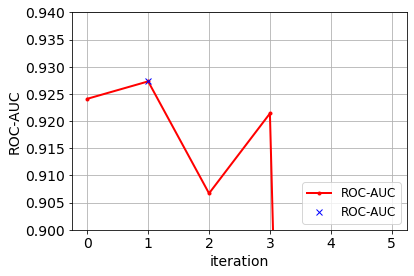

In [19]:
plotus = [i if i == data_grid_3rdstep[index_max_3][0] else 0 for i in data_grid_3rdstep[:,0]]
print('# model with max ROC-AUC: ', (sum(plotus)/data_grid_3rdstep[index_max_3][0]))

plt.plot(data_grid_3rdstep[:,0], '.-', lw=2, color='r', label="ROC-AUC")
plt.plot(plotus, '.', lw=5, color='blue', marker='x', label="ROC-AUC")

plt.grid()
#plt.title(title,fontsize=14)
plt.xlabel("iteration",fontsize=14)
plt.ylabel("ROC-AUC",fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
#plt.xscale('log')
#plt.yscale('log')
plt.ylim([0.9,0.94])
plt.legend(loc='lower right',fontsize=12)
plt.show()

### BEST PARAMETERS, different image sizes

### 75x75

In [20]:
tot_epochs = 1000
patience_epochs = 50

# to stop the training if validation loss does not improve after patience number of epochs
stop_training = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=patience_epochs, restore_best_weights=True)


roc_auc_model, score = run_model(int(data_grid_3rdstep[index_max_3][1]), 
                                            int(data_grid[index_max][2]), 
                                            data_grid_2ndstep[index_max_2][2], 
                                            data_grid[index_max][4], 
                                            int(data_grid[index_max][5]), 
                                            tot_epochs,
                                        int(data_grid_2ndstep[index_max_2][3]),
                                        data_grid_2ndstep[index_max_2][4],
                                        int(data_grid_2ndstep[index_max_2][5]))

313/313 [==============================] - 3s 8ms/step - loss: 0.4390 - acc: 0.8428 - f1_m: 0.4751 - precision_m: 0.4998 - recall_m: 0.4539
Test ROC-AUC: 0.9274325
Test loss: 0.43901264667510986
Test accuracy: 0.8428000211715698
Test f1: 0.4751165807247162
Test precision: 0.4997718036174774
Test recall: 0.45387381315231323


### 128x128

### Load images

In [21]:
filefolder = '../../data2024/processed/00-images/'

###################
# BACKGROUND FILE #
###################

filename_B = filefolder + 'ER-img/out-img128/'


###############
# SIGNAL FILE #
###############

# select the DM mass
mDM = 500

filename_S = filefolder + 'mDM' + str(mDM) + 'GeV-img/out-img128/'

In [22]:
from keras import backend as K
np.random.seed(0)

# Define recall, precision and f1 functions
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

##### TEST-VAL SET

In [23]:
# test
from PIL import Image

for i in range(2):
    img = Image.open( filename_S+'WP' + str(i) + '.png' )
    data = np.asarray( img, dtype="int32" )
    print(data.shape)
    
for i in range(2):
    img = Image.open( filename_B+'ER' + str(i) + '.png' )
    data = np.asarray( img, dtype="int32" )
    print(data.shape)

(128, 128, 4)
(128, 128, 4)
(128, 128, 4)
(128, 128, 4)


In [24]:
##########
# SIGNAL #
##########
num_signal = 5000

file_pathsWP = glob.glob(path.join(filename_S, 'WP*.png'))

# Load the images into a single variable and convert to a numpy array
imagesWP = [imageio.imread(file_pathsWP[jj]) for jj in range(num_signal)]
imagesWP = np.asarray(imagesWP)

labelsWP = np.ones(num_signal)


##############
# BACKGROUND #
##############
num_back = 5000

file_pathsER = glob.glob(path.join(filename_B, 'ER*.png'))

# Load the images into a single variable and convert to a numpy array
imagesER = [imageio.imread(file_pathsER[jj]) for jj in range(num_back)]
imagesER = np.asarray(imagesER)

labelsER = np.zeros(num_back)



images = np.concatenate([imagesWP,imagesER])
del imagesWP
del imagesER

labels = np.concatenate([labelsWP,labelsER])
del labelsWP
del labelsER



print('images.shape: ', images.shape)
print('labels.shape: ', labels.shape)

# Get image size
image_size = np.asarray([images.shape[1], images.shape[2], images.shape[3]])
print(image_size)

# Scale images so values are between 0 and 1
images = images / 255

n_images = images.shape[0]

images.shape:  (10000, 128, 128, 4)
labels.shape:  (10000,)
[128 128   4]


In [25]:
labels.shape

(10000,)

In [26]:
# Split into test and training sets

TRAIN_TEST_SPLIT = 0.8            

# Split at the given index
split_index = int(TRAIN_TEST_SPLIT * n_images)
shuffled_indices = np.random.permutation(n_images)
train_indices = shuffled_indices[0:split_index]
test_indices = shuffled_indices[split_index:]

# Split the images and the labels
x_train = images[train_indices, :, :, :]
y_train = labels[train_indices]
x_val = images[test_indices, :, :, :]
y_val = labels[test_indices]

#x_train = images
#y_train = labels

print(x_train.shape)
print(y_train.shape)
print(x_val.shape)

(8000, 128, 128, 4)
(8000,)
(2000, 128, 128, 4)


In [27]:
del images
del labels

##### TESTSET

In [28]:
##########
# SIGNAL #
##########
num_signal_test = 2000

file_pathsWP = glob.glob(path.join(filename_S, 'WP*.png'))

# Load the images into a single variable and convert to a numpy array
imagesWP = [imageio.imread(file_pathsWP[jj]) for jj in range(num_signal,num_signal+num_signal_test)]
imagesWP = np.asarray(imagesWP)

labelsWP = np.ones(num_signal_test)


##############
# BACKGROUND #
##############
num_back_test = 2000

file_pathsER = glob.glob(path.join(filename_B, 'ER*.png'))

# Load the images into a single variable and convert to a numpy array
imagesER = [imageio.imread(file_pathsER[jj]) for jj in range(num_back,num_back+num_back_test)]
imagesER = np.asarray(imagesER)

labelsER = np.zeros(num_back_test)



images_test = np.concatenate([imagesWP,imagesER])
del imagesWP
del imagesER

labels_test = np.concatenate([labelsWP,labelsER])
del labelsWP
del labelsER


print('images_test.shape: ', images_test.shape)
print('labels_test.shape: ', labels_test.shape)

# Get image size
image_size_test = np.asarray([images_test.shape[1], images_test.shape[2], images_test.shape[3]])
print(image_size_test)

# Scale images so values are between 0 and 1
images_test = images_test / 255

n_images_test = images_test.shape[0]



x_test = images_test
del images_test

y_test = labels_test
del labels_test

images_test.shape:  (4000, 128, 128, 4)
labels_test.shape:  (4000,)
[128 128   4]


In [29]:
tot_epochs = 1000
patience_epochs = 50

# to stop the training if validation loss does not improve after patience number of epochs
stop_training = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=patience_epochs, restore_best_weights=True)


roc_auc_model, score = run_model(int(data_grid_3rdstep[index_max_3][1]), 
                                            int(data_grid[index_max][2]), 
                                            data_grid_2ndstep[index_max_2][2], 
                                            data_grid[index_max][4], 
                                            int(data_grid[index_max][5]), 
                                            tot_epochs,
                                        int(data_grid_2ndstep[index_max_2][3]),
                                        data_grid_2ndstep[index_max_2][4],
                                        int(data_grid_2ndstep[index_max_2][5]))

125/125 [==============================] - 3s 24ms/step - loss: 0.5190 - acc: 0.8547 - f1_m: 0.4674 - precision_m: 0.5040 - recall_m: 0.4367
Test ROC-AUC: 0.9284623750000001
Test loss: 0.5189634561538696
Test accuracy: 0.8547499775886536
Test f1: 0.4673826992511749
Test precision: 0.5040000081062317
Test recall: 0.43674999475479126


### 256x256

### Load images

In [32]:
filefolder = '../../data2024/processed/00-images/'

###################
# BACKGROUND FILE #
###################

filename_B = filefolder + 'ER-img/out-img256/'


###############
# SIGNAL FILE #
###############

# select the DM mass
mDM = 500

filename_S = filefolder + 'mDM' + str(mDM) + 'GeV-img/out-img256/'

In [33]:
from keras import backend as K
np.random.seed(0)

# Define recall, precision and f1 functions
def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

##### TEST-VAL SET

In [34]:
# test
from PIL import Image

for i in range(2):
    img = Image.open( filename_S+'WP' + str(i) + '.png' )
    data = np.asarray( img, dtype="int32" )
    print(data.shape)
    
for i in range(2):
    img = Image.open( filename_B+'ER' + str(i) + '.png' )
    data = np.asarray( img, dtype="int32" )
    print(data.shape)

(256, 256, 4)
(256, 256, 4)
(256, 256, 4)
(256, 256, 4)


In [35]:
##########
# SIGNAL #
##########
num_signal = 5000

file_pathsWP = glob.glob(path.join(filename_S, 'WP*.png'))

# Load the images into a single variable and convert to a numpy array
imagesWP = [imageio.imread(file_pathsWP[jj]) for jj in range(num_signal)]
imagesWP = np.asarray(imagesWP)

labelsWP = np.ones(num_signal)


##############
# BACKGROUND #
##############
num_back = 5000

file_pathsER = glob.glob(path.join(filename_B, 'ER*.png'))

# Load the images into a single variable and convert to a numpy array
imagesER = [imageio.imread(file_pathsER[jj]) for jj in range(num_back)]
imagesER = np.asarray(imagesER)

labelsER = np.zeros(num_back)



images = np.concatenate([imagesWP,imagesER])
del imagesWP
del imagesER

labels = np.concatenate([labelsWP,labelsER])
del labelsWP
del labelsER



print('images.shape: ', images.shape)
print('labels.shape: ', labels.shape)

# Get image size
image_size = np.asarray([images.shape[1], images.shape[2], images.shape[3]])
print(image_size)

# Scale images so values are between 0 and 1
images = images / 255

n_images = images.shape[0]

images.shape:  (10000, 256, 256, 4)
labels.shape:  (10000,)
[256 256   4]


In [36]:
labels.shape

(10000,)

In [37]:
# Split into test and training sets

TRAIN_TEST_SPLIT = 0.8            

# Split at the given index
split_index = int(TRAIN_TEST_SPLIT * n_images)
shuffled_indices = np.random.permutation(n_images)
train_indices = shuffled_indices[0:split_index]
test_indices = shuffled_indices[split_index:]

# Split the images and the labels
x_train = images[train_indices, :, :, :]
y_train = labels[train_indices]
x_val = images[test_indices, :, :, :]
y_val = labels[test_indices]

#x_train = images
#y_train = labels

print(x_train.shape)
print(y_train.shape)
print(x_val.shape)

(8000, 256, 256, 4)
(8000,)
(2000, 256, 256, 4)


In [38]:
del images
del labels

##### TESTSET

In [39]:
##########
# SIGNAL #
##########
num_signal_test = 2000

file_pathsWP = glob.glob(path.join(filename_S, 'WP*.png'))

# Load the images into a single variable and convert to a numpy array
imagesWP = [imageio.imread(file_pathsWP[jj]) for jj in range(num_signal,num_signal+num_signal_test)]
imagesWP = np.asarray(imagesWP)

labelsWP = np.ones(num_signal_test)


##############
# BACKGROUND #
##############
num_back_test = 2000

file_pathsER = glob.glob(path.join(filename_B, 'ER*.png'))

# Load the images into a single variable and convert to a numpy array
imagesER = [imageio.imread(file_pathsER[jj]) for jj in range(num_back,num_back+num_back_test)]
imagesER = np.asarray(imagesER)

labelsER = np.zeros(num_back_test)



images_test = np.concatenate([imagesWP,imagesER])
del imagesWP
del imagesER

labels_test = np.concatenate([labelsWP,labelsER])
del labelsWP
del labelsER


print('images_test.shape: ', images_test.shape)
print('labels_test.shape: ', labels_test.shape)

# Get image size
image_size_test = np.asarray([images_test.shape[1], images_test.shape[2], images_test.shape[3]])
print(image_size_test)

# Scale images so values are between 0 and 1
images_test = images_test / 255

n_images_test = images_test.shape[0]



x_test = images_test
del images_test

y_test = labels_test
del labels_test

images_test.shape:  (4000, 256, 256, 4)
labels_test.shape:  (4000,)
[256 256   4]


In [40]:
tot_epochs = 1000
patience_epochs = 50

# to stop the training if validation loss does not improve after patience number of epochs
stop_training = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=patience_epochs, restore_best_weights=True)


roc_auc_model, score = run_model(int(data_grid_3rdstep[index_max_3][1]), 
                                            int(data_grid[index_max][2]), 
                                            data_grid_2ndstep[index_max_2][2], 
                                            data_grid[index_max][4], 
                                            int(data_grid[index_max][5]), 
                                            tot_epochs,
                                        int(data_grid_2ndstep[index_max_2][3]),
                                        data_grid_2ndstep[index_max_2][4],
                                        int(data_grid_2ndstep[index_max_2][5]))

125/125 [==============================] - 14s 106ms/step - loss: 0.6012 - acc: 0.8332 - f1_m: 0.4550 - precision_m: 0.5029 - recall_m: 0.4162
Test ROC-AUC: 0.91521575
Test loss: 0.6011813879013062
Test accuracy: 0.8332499861717224
Test f1: 0.45500603318214417
Test precision: 0.5028571486473083
Test recall: 0.41624999046325684
